#### CSCE 670 :: Information Storage and Retrieval :: Texas A&M University :: Spring 2018


# Homework 1:  Basic Machine Learning + Learning to Rank 

### 100 points [5% of your final grade]

### Due: Monday, February 12 by 11:59pm

*Goals of this homework:* In this homework you will get hands-on experience with (i) the basics of machine learning (e.g. train/test data, cross-validation, different classifiers) and interpreting results; and (ii) learning to rank.

*Submission Instructions:* To submit your homework, rename this notebook as UIN_hw#.ipynb. For example, this homework submission would be: YourUIN_hw1.ipynb. Submit this notebook via ecampus. Your notebook should be completely self-contained, with the results visible in the notebook. 

*Late submission policy:* For this homework, you may use up to three of your late days, meaning that no submissions will be accepted after Thursday, February 15 at 11:59pm.

*Collaboration policy:* You are expected to complete each homework independently. Your solution should be written by you without the direct aid or help of anyone else. However, we believe that collaboration and team work are important for facilitating learning, so we encourage you to discuss problems and general problem approaches (but not actual solutions) with your classmates. You may post on Piazza, search StackOverflow, etc. But if you do get help in this way, you must inform us by **filling out the Collaboration Declarations at the bottom of this notebook**. 

*Example: I found helpful code on stackoverflow at https://stackoverflow.com/questions/11764539/writing-fizzbuzz that helped me solve Problem 2.*

The basic rule is that no student should explicitly share a solution with another student (and thereby circumvent the basic learning process), but it is okay to share general approaches, directions, and so on. If you feel like you have an issue that needs clarification, feel free to contact either me or the TA.

# Part 1: Basics of ML (70 points)

For this part, we're going to get familiar with scikit-learn (a great ML toolkit that is very popular) and the major issues in training a model, testing it, and interpreting the results. Our goal in this assignment is to build a classifier to determine if a Yelp review is "food-relevant" or not.

## Dataset: Yelp review data

First, you will need to download the training_data.json file from the Resources tab on Piazza, a collection of 40,000 json-encoded Yelp reviews we sampled from the [Yelp Dataset Challenge](https://www.yelp.com/dataset_challenge).

You'll see that each line corresponds to a review on a particular business. The label (class) information of each review is in the "label" field. It is **either "Food-relevant" or "Food-irrelevant"**.

## Part 1.1: Parsing Yelp (15 points)

For this first part, we will build a parser for extracting tokens from the **review text** only. First, you should tokenize each review using **whitespaces and punctuations as delimiters**. Do not remove stopwords. You should apply casefolding (lower case everything) and use the [nltk Porter stemmer](http://www.nltk.org/api/nltk.stem.html#module-nltk.stem.porter) ... you may need to install nltk if you don't have it already. 

In [1]:
# Parse the data, including tokenizing, stemming, casefolding.
# Form a dictionary for every  40,000 review -- store it in a list
# Store all processed tokens in a list as well
# Store processed tokens per review

import nltk
import json


all_processed_tokens = []
token_per_review_list = []
count_vectorize_list=[]

tokenizer = nltk.tokenize.RegexpTokenizer(r'\w+')
file = open("training_data.json","r")
review_line = file.readline()

while review_line:
    tokens = []
    stemmed_tokens = []
    token_per_review = {}
    count_vectorize_per_review=[]
    json_data = json.loads(review_line)
    review_text = json_data["text"]
    count_vectorize_list.append(review_text)
    tokens = tokenizer.tokenize(review_text.lower())
    for word in tokens:
        stem_word = nltk.stem.PorterStemmer().stem(word)
        stemmed_tokens.append(stem_word)
        all_processed_tokens.append(stem_word)
        #count_vectorize_per_review.append(stem_word)
        if stem_word in token_per_review.keys():
            token_per_review[stem_word] +=1;
        else:
            token_per_review[stem_word]= 1;
    token_per_review_list.append(token_per_review);
    #count_vectorize_list.append(count_vectorize_per_review)
    print stemmed_tokens
    review_line = file.readline()
file.close()

[u'dr', u'goldberg', u'offer', u'everyth', u'i', u'look', u'for', u'in', u'a', u'gener', u'practition', u'he', u's', u'nice', u'and', u'easi', u'to', u'talk', u'to', u'without', u'be', u'patron', u'he', u's', u'alway', u'on', u'time', u'in', u'see', u'hi', u'patient', u'he', u's', u'affili', u'with', u'a', u'top', u'notch', u'hospit', u'nyu', u'which', u'my', u'parent', u'have', u'explain', u'to', u'me', u'is', u'veri', u'import', u'in', u'case', u'someth', u'happen', u'and', u'you', u'need', u'surgeri', u'and', u'you', u'can', u'get', u'referr', u'to', u'see', u'specialist', u'without', u'have', u'to', u'see', u'him', u'first', u'realli', u'what', u'more', u'do', u'you', u'need', u'i', u'm', u'sit', u'here', u'tri', u'to', u'think', u'of', u'ani', u'complaint', u'i', u'have', u'about', u'him', u'but', u'i', u'm', u'realli', u'draw', u'a', u'blank']
[u'unfortun', u'the', u'frustrat', u'of', u'be', u'dr', u'goldberg', u's', u'patient', u'is', u'a', u'repeat', u'of', u'the', u'experi', u

[u'thi', u'is', u'one', u'of', u'the', u'best', u'breakfast', u'i', u'have', u'had', u'is', u'the', u'decor', u'date', u'absolut', u'but', u'it', u'just', u'add', u'to', u'the', u'nostalg', u'charm', u'the', u'place', u'just', u'reek', u'of', u'beef', u'cook', u'ahhh', u'delici', u'check', u'out', u'the', u'pastri', u'case', u'omg', u'is', u'all', u'i', u'have', u'to', u'say']
[u'hand', u'down', u'one', u'of', u'the', u'best', u'breakfast', u'my', u'wife', u'and', u'i', u'have', u'had', u'stop', u'in', u'here', u'base', u'on', u'the', u'posit', u'review', u'from', u'fellow', u'yelper', u'and', u'wa', u'sure', u'glad', u'i', u'did', u'thi', u'is', u'a', u'good', u'size', u'diner', u'at', u'a', u'truck', u'stop', u'the', u'first', u'thing', u'that', u'caught', u'our', u'eye', u'wa', u'the', u'pastri', u'they', u'were', u'all', u'huge', u'and', u'all', u'look', u'great', u'tip', u'be', u'sure', u'to', u'save', u'space', u'for', u'at', u'least', u'one', u'i', u'went', u'with', u'the', u'ci

[u'use', u'charter', u'for', u'a', u'coupl', u'of', u'year', u'just', u'ditch', u'them', u'and', u'i', u'couldn', u't', u'be', u'happier', u'shortli', u'after', u'we', u'first', u'start', u'with', u'charter', u'our', u'connect', u'went', u'out', u'took', u'them', u'day', u'to', u'send', u'someon', u'out', u'and', u'it', u'turn', u'out', u'they', u'd', u'disconnect', u'us', u'for', u'no', u'reason', u'at', u'all', u'thank', u'charter', u'fast', u'forward', u'to', u'the', u'recent', u'past', u'when', u'our', u'bill', u'went', u'up', u'i', u'call', u'up', u'to', u'tri', u'and', u'get', u'a', u'new', u'promot', u'rate', u'becaus', u'i', u'm', u'no', u'pay', u'60', u'for', u'internet', u'that', u'bomb', u'out', u'briefli', u'a', u'coupl', u'time', u'a', u'day', u'they', u'said', u'they', u'couldn', u't', u'do', u'anyth', u'better', u'than', u'their', u'list', u'rate', u'after', u'that', u'i', u'decid', u'to', u'downgrad', u'to', u'their', u'lowest', u'speed', u'for', u'the', u'time', u'be',

[u'went', u'last', u'friday', u'to', u'tri', u'the', u'famou', u'fish', u'fri', u'arriv', u'at', u'5', u'50pm', u'and', u'wa', u'quot', u'a', u'25', u'30', u'minut', u'wait', u'which', u'i', u'found', u'accept', u'we', u'were', u'not', u'call', u'until', u'55', u'minut', u'later', u'and', u'thi', u'onli', u'happen', u'when', u'i', u'brought', u'my', u'two', u'young', u'son', u'and', u'sat', u'on', u'the', u'floor', u'conspicu', u'in', u'plain', u'view', u'of', u'the', u'host', u'stand', u'at', u'that', u'point', u'we', u'were', u'offer', u'the', u'quick', u'altern', u'of', u'a', u'tabl', u'downstair', u'where', u'wa', u'thi', u'option', u'earlier', u'look', u'we', u'knew', u'go', u'out', u'on', u'the', u'first', u'friday', u'of', u'lent', u'would', u'result', u'in', u'a', u'wait', u'and', u'we', u'brought', u'a', u'myriad', u'of', u'distract', u'along', u'to', u'kill', u'time', u'for', u'our', u'4', u'and', u'2', u'year', u'old', u'those', u'wear', u'thin', u'howev', u'when', u'the', u

[u'i', u'have', u'no', u'idea', u'whi', u'no', u'one', u'ha', u'review', u'thi', u'awesom', u'b', u'b', u'but', u'i', u'm', u'excit', u'to', u'be', u'the', u'first', u'perhap', u'no', u'one', u'want', u'to', u'let', u'anyon', u'in', u'on', u'the', u'secret', u'and', u'i', u'thought', u'about', u'not', u'write', u'the', u'review', u'for', u'that', u'same', u'reason', u'but', u'i', u'have', u'to', u'share', u'thi', u'one', u'with', u'my', u'fellow', u'yelpster', u'i', u'want', u'to', u'celebr', u'the', u'wife', u's', u'bday', u'with', u'a', u'quick', u'getaway', u'but', u'didn', u't', u'want', u'to', u'stay', u'in', u'the', u'usual', u'hotel', u'so', u'i', u'pop', u'lgbt', u'friendli', u'b', u'bs', u'into', u'googl', u'and', u'thi', u'place', u'came', u'up', u'they', u'had', u'a', u'few', u'room', u'to', u'choos', u'from', u'but', u'of', u'cours', u'the', u'one', u'with', u'the', u'hot', u'tub', u'in', u'the', u'room', u'caught', u'my', u'eye', u'first', u'i', u'email', u'them', u'throug

[u'thi', u'wa', u'quit', u'possibl', u'the', u'worst', u'chines', u'food', u'if', u'you', u'can', u'call', u'it', u'that', u'that', u'i', u've', u'ever', u'eaten', u'in', u'my', u'life', u'we', u'start', u'with', u'the', u'appet', u'platter', u'for', u'two', u'the', u'calamari', u'wa', u'so', u'stringi', u'that', u'i', u'had', u'to', u'swallow', u'it', u'in', u'one', u'bite', u'becaus', u'i', u'couldn', u't', u'separ', u'it', u'with', u'my', u'teeth', u'the', u'egg', u'roll', u'were', u'at', u'least', u'crispi', u'and', u'well', u'roll', u'but', u'they', u'had', u'absolut', u'no', u'season', u'other', u'than', u'a', u'tad', u'too', u'much', u'salt', u'the', u'shrimp', u'were', u'overcook', u'the', u'barbecu', u'pork', u'wa', u'dri', u'and', u'the', u'hot', u'dumpl', u'were', u'cold', u'and', u'under', u'season', u'then', u'came', u'the', u'entre', u'i', u'order', u'imperi', u'chicken', u'think', u'that', u'be', u'the', u'restaur', u's', u'namesak', u'it', u'had', u'to', u'be', u'good',

[u'ok', u'mexican', u'like', u'everywher', u'els', u'i', u'complet', u'agre', u'with', u'the', u'previou', u'review', u'when', u'is', u'the', u'authent', u'one', u'come', u'to', u'thi', u'town', u'the', u'menu', u'cover', u'page', u'say', u'it', u's', u'authent', u'but', u'the', u'men', u'item', u'themselv', u'look', u'littl', u'more', u'tex', u'mex', u'ish', u'i', u'had', u'a', u'fajita', u'plate', u'while', u'my', u'friend', u'had', u'a', u'chicken', u'dish', u'i', u'forgot', u'what', u'it', u'wa', u'call', u'my', u'fajita', u'arriv', u'on', u'a', u'sizzl', u'hot', u'plate', u'that', u's', u'take', u'care', u'of', u'the', u'fun', u'part', u'regardless', u'of', u'the', u'qualiti', u'and', u'it', u'wa', u'pretti', u'good', u'the', u'portion', u'wa', u'huge', u'so', u'i', u'had', u'to', u'take', u'ha', u'f', u'of', u'my', u'plate', u'to', u'go', u'and', u'the', u'take', u'out', u'becam', u'the', u'perfect', u'left', u'over', u'dinner', u'next', u'day']
[u'mi', u'cocina', u'is', u'my', u

[u'i', u'can', u't', u'say', u'enough', u'great', u'thing', u'about', u'thi', u'locat', u'in', u'middleton', u'earlier', u'thi', u'year', u'i', u'had', u'a', u'one', u'bedroom', u'suit', u'for', u'almost', u'three', u'month', u'a', u'famili', u'member', u'wa', u'in', u'the', u'hospit', u'at', u'uw', u'madison', u'dure', u'thi', u'time', u'and', u'thi', u'hotel', u'wa', u'more', u'than', u'accommod', u'for', u'the', u'specif', u'need', u'in', u'our', u'situat', u'i', u'm', u'not', u'go', u'to', u'go', u'into', u'the', u'specif', u'detail', u'of', u'the', u'accommod', u'partli', u'to', u'protect', u'individu', u'privaci', u'the', u'other', u'reason', u'not', u'to', u'get', u'so', u'detail', u'is', u'simpli', u'becaus', u'i', u'think', u'the', u'staff', u'went', u'so', u'far', u'out', u'of', u'their', u'way', u'that', u'these', u'favor', u'may', u'potenti', u'be', u'abus', u'by', u'other', u'guest', u'if', u'they', u'were', u'awar', u'of', u'the', u'extrem', u'kind', u'as', u'i', u'mentio

[u'i', u'live', u'close', u'by', u'and', u'stop', u'in', u'period', u'and', u'have', u'not', u'had', u'ani', u'issu', u'with', u'food', u'or', u'servic', u'i', u'have', u'left', u'full', u'and', u'happi', u'everi', u'time', u'hot', u'food', u'all', u'the', u'sushi', u'you', u'can', u'eat', u'keep', u'up', u'the', u'good', u'work']
[u'thi', u'place', u'is', u'averag', u'lot', u'of', u'food', u'speedi', u'staff', u'it', u's', u'a', u'casual', u'buffet', u'great', u'for', u'busi', u'lunch']
[u'some', u'of', u'the', u'food', u'on', u'the', u'buffet', u'is', u'quit', u'good', u'the', u'szechwan', u'pork', u'and', u'barbecu', u'pork', u'stand', u'out', u'in', u'my', u'recollect', u'the', u'fri', u'rice', u'is', u'memor', u'for', u'it', u'bland', u'and', u'frozen', u'pea', u'and', u'carrot', u'cabbag', u'wa', u'appar', u'the', u'onli', u'ingredi', u'that', u'they', u'could', u'find', u'to', u'stuff', u'their', u'egg', u'roll', u'with', u'thi', u'get', u'low', u'rate', u'for', u'staff', u'and'

[u'after', u'read', u'the', u'last', u'few', u'review', u'i', u'had', u'pretti', u'low', u'expect', u'for', u'my', u'lunch', u'at', u'prairi', u'cafe', u'bakeri', u'i', u'assum', u'i', u'would', u'have', u'to', u'wait', u'a', u'long', u'time', u'for', u'my', u'food', u'and', u'it', u'would', u'be', u'just', u'okay', u'i', u'wa', u'pleasantli', u'surpris', u'our', u'food', u'came', u'rel', u'quickli', u'and', u'my', u'husband', u'and', u'i', u'both', u'enjoy', u'our', u'sandwich', u'i', u'had', u'a', u'cblt', u'which', u'wa', u'excel', u'the', u'bread', u'wa', u'perfect', u'and', u'i', u'love', u'fresh', u'ingredi', u'and', u'the', u'special', u'mayo', u'my', u'husband', u'realli', u'like', u'the', u'special', u'of', u'the', u'day', u'which', u'wa', u'a', u'tuna', u'melt', u'my', u'bean', u'and', u'corn', u'side', u'salad', u'wa', u'veri', u'fresh', u'tast', u'but', u'could', u'have', u'use', u'a', u'tad', u'more', u'flavor', u'we', u'also', u'had', u'a', u'key', u'lime', u'coconut', u'

[u'i', u'had', u'taken', u'my', u'terrier', u'here', u'for', u'groom', u'befor', u'he', u'pass', u'away', u'nearli', u'two', u'year', u'ago', u'and', u'final', u'wa', u'readi', u'to', u'get', u'a', u'replac', u'pup', u'my', u'new', u'terrier', u'is', u'about', u'8', u'month', u'old', u'now', u'and', u'is', u'a', u'lori', u's', u'devote', u'their', u'staff', u'are', u'all', u'gentl', u'and', u'care', u'and', u'her', u'groom', u'ha', u'alway', u'been', u'just', u'want', u'i', u've', u'ask', u'for', u'not', u'onli', u'are', u'their', u'staff', u'welcom', u'and', u'alway', u'rememb', u'your', u'pup', u'when', u'you', u'come', u'they', u'also', u'offer', u'doggi', u'daycar', u'the', u'doggi', u'daycar', u'is', u'perfect', u'for', u'tire', u'out', u'a', u'young', u'puppi', u'in', u'a', u'veri', u'homey', u'set', u'their', u'facil', u'is', u'an', u'old', u'hous', u'in', u'downtown', u'middleton', u'my', u'vet', u'advis', u'against', u'one', u'of', u'the', u'larger', u'dog', u'daycar', u'in', 

[u'serious', u'i', u'love', u'thi', u'place', u'i', u'wish', u'i', u'could', u'give', u'them', u'ten', u'star', u'i', u've', u'got', u'three', u'corgi', u'and', u'after', u'a', u'co', u'worker', u'refer', u'me', u'here', u'in', u'2009', u'i', u'll', u'never', u'go', u'anywher', u'els', u'everi', u'vet', u'my', u'dog', u'have', u'seen', u'is', u'wonder', u'between', u'the', u'three', u'pup', u'i', u've', u'met', u'with', u'three', u'of', u'the', u'doctor', u'they', u're', u'all', u'sincer', u'empathet', u'thorough', u'understand', u'engag', u'respect', u'and', u'love', u'to', u'share', u'their', u'knowledg', u'dr', u'haroldson', u'is', u'a', u'sweetheart', u'and', u'can', u'probabl', u'put', u'ani', u'nervou', u'pet', u'parent', u'at', u'eas', u'dr', u'erickson', u'is', u'calm', u'and', u'laid', u'back', u'and', u'i', u'can', u'talk', u'to', u'him', u'about', u'even', u'the', u'most', u'awkward', u'pet', u'problem', u'dr', u'schweitzer', u'is', u'live', u'a', u'total', u'hoot', u'anyon'

[u'all', u'our', u'friend', u'had', u'rave', u'about', u'the', u'food', u'ambianc', u'so', u'my', u'wife', u'i', u'final', u'decid', u'to', u'tri', u'louisiann', u's', u'the', u'decor', u'is', u'inde', u'cozi', u'like', u'a', u'nice', u'made', u'up', u'cellar', u'there', u'wa', u'plenti', u'of', u'room', u'at', u'the', u'bar', u'so', u'we', u'sat', u'there', u'befor', u'our', u'reserv', u'time', u'arriv', u'onli', u'two', u'beer', u'on', u'tap', u'but', u'both', u'good', u'local', u'brew', u'from', u'capit', u'eventu', u'sat', u'at', u'our', u'tabl', u'perus', u'the', u'menu', u'found', u'mani', u'appet', u'that', u'sound', u'realli', u'good', u'includ', u'one', u'of', u'the', u'special', u'that', u'night', u'so', u'we', u'decid', u'on', u'share', u'2', u'app', u'and', u'one', u'entre', u'seem', u'like', u'a', u'good', u'way', u'to', u'tri', u'a', u'few', u'item', u'without', u'get', u'too', u'much', u'food', u'app', u'1', u'the', u'special', u'gnocchi', u'in', u'a', u'savori', u'cream

[u'just', u'ok', u'becaus', u'my', u'bar', u'for', u'new', u'orlean', u'food', u'is', u'quit', u'insurmount', u'but', u'i', u'give', u'honest', u'review', u'whoever', u'is', u'in', u'the', u'kitchen', u'can', u'season', u'food', u'like', u'nobodi', u's', u'busi', u'it', u'is', u'great', u'food', u'seafood', u'wa', u'not', u'fresh', u'though', u'and', u'they', u'realli', u'do', u'not', u'have', u'bread', u'pud', u'on', u'the', u'menu', u'that', u'tell', u'me', u'that', u'the', u'chef', u'is', u'not', u'from', u'louisiana', u'at', u'all', u'price', u'are', u'too', u'high', u'way', u'to', u'high', u'jambalaya', u'for', u'20', u'ridicul', u'realli', u'a', u'pot', u'of', u'that', u'for', u'10', u'peopl', u'cost', u'20', u'but', u'if', u'you', u'want', u'great', u'atmospher', u'and', u'good', u'food', u'that', u'is', u'just', u'season', u'well', u'go', u'drink', u'are', u'reason', u'and', u'servic', u'is', u'fantast']
[u'we', u'went', u'here', u'for', u'my', u'sister', u'in', u'law', u's', u

[u'stay', u'at', u'thi', u'marriott', u'while', u'i', u'wa', u'attend', u'some', u'train', u'session', u'at', u'epic', u'the', u'hotel', u'ha', u'everyth', u'a', u'modern', u'hotel', u'would', u'have', u'the', u'room', u'and', u'decor', u'a', u'bit', u'date', u'but', u'that', u'mayb', u'becaus', u'it', u's', u'wisconsin', u'the', u'room', u'are', u'good', u'size', u'the', u'king', u'singl', u'had', u'a', u'king', u'bed', u'a', u'32', u'lcd', u'tv', u'ipod', u'charg', u'alarm', u'clock', u'but', u'a', u'realli', u'small', u'bathroom', u'i', u'did', u'have', u'troubl', u'with', u'the', u'heat', u'dure', u'my', u'stay', u'here', u'it', u'took', u'the', u'engin', u'two', u'day', u'just', u'to', u'get', u'some', u'heat', u'into', u'the', u'room', u'and', u'they', u'continu', u'had', u'to', u'check', u'on', u'it', u'while', u'i', u'wa', u'out', u'dure', u'the', u'day', u'there', u'is', u'a', u'breakfast', u'buffet', u'in', u'the', u'morn', u'not', u'complimentari', u'and', u'thi', u'is', u'w

[u'i', u'order', u'a', u'birthday', u'cake', u'for', u'the', u'first', u'time', u'through', u'clasen', u's', u'due', u'to', u'the', u'flu', u'go', u'through', u'our', u'hous', u'i', u'had', u'to', u'reschedul', u'the', u'parti', u'and', u'the', u'cake', u'for', u'the', u'follow', u'week', u'the', u'baker', u'did', u'not', u'get', u'my', u'cancel', u'and', u'bake', u'the', u'cake', u'clasen', u's', u'said', u'they', u'were', u'sorri', u'and', u'not', u'to', u'worri', u'about', u'it', u'when', u'i', u'pick', u'up', u'the', u'cake', u'the', u'follow', u'week', u'it', u'wa', u'stale', u'my', u'guess', u'is', u'they', u'just', u'kept', u'the', u'cake', u'in', u'the', u'fridg', u'until', u'i', u'pick', u'it', u'up', u'the', u'follow', u'friday', u'i', u'call', u'to', u'let', u'them', u'know', u'they', u'apolog', u'and', u'said', u'they', u'would', u'call', u'me', u'back', u'i', u'never', u'heard', u'from', u'them', u'disappoint']
[u'it', u'wa', u'near', u'my', u'birthday', u'i', u'wa', u'in'

[u'in', u'spite', u'of', u'be', u'dick', u'and', u'arni', u's', u'barber', u'shop', u'i', u've', u'onli', u'manag', u'to', u'ever', u'get', u'my', u'hair', u'cut', u'by', u'ka', u'he', u's', u'a', u'realli', u'friendli', u'guy', u'and', u'give', u'a', u'great', u'haircut', u'but', u'i', u'd', u'like', u'to', u'meet', u'dick', u'at', u'least', u'onc', u'contrari', u'to', u'the', u'other', u'review', u'post', u'my', u'experi', u'ha', u'been', u'that', u'you', u'need', u'an', u'appoint', u'ani', u'time', u'you', u'want', u'to', u'get', u'a', u'trim', u'it', u's', u'not', u'that', u'bad', u'but', u'there', u'have', u'been', u'time', u'when', u'i', u've', u'need', u'to', u'reschedul', u'2', u'3', u'time', u'due', u'to', u'work', u'and', u'i', u'just', u'feel', u'bad', u'about', u'that', u'i', u'm', u'more', u'use', u'to', u'walk', u'in', u'barber', u'shop', u'but', u'sinc', u'thi', u'is', u'the', u'onli', u'real', u'barber', u'shop', u'in', u'the', u'area', u'i', u'll', u'cope', u'the', u'h

[u'2', u'star', u'may', u'be', u'a', u'bit', u'gener', u'if', u'we', u're', u'just', u'measur', u'food', u'qualiti', u'quick', u'n', u'dirti', u'review', u'stamm', u'hous', u'featur', u'a', u'lot', u'of', u'charact', u'histori', u'and', u'good', u'servic', u'unfortun', u'that', u's', u'about', u'all', u'it', u'ha', u'to', u'offer', u'unless', u'you', u'enjoy', u'food', u'that', u'is', u'extrem', u'greasi', u'and', u'of', u'mediocr', u'qualiti', u'detail', u'review', u'our', u'fish', u'fri', u'crew', u'decid', u'to', u'give', u'stamm', u'hous', u'a', u'tri', u'after', u'we', u'd', u'read', u'good', u'thing', u'about', u'it', u'on', u'a', u'fairli', u'well', u'known', u'fish', u'fri', u'review', u'websit', u'normal', u'those', u'guy', u'the', u'review', u'are', u'pretti', u'spot', u'on', u'but', u'they', u've', u'complet', u'miss', u'the', u'mark', u'when', u'it', u'come', u'to', u'the', u'stamm', u'hous', u'not', u'even', u'close', u'to', u'be', u'a', u'top', u'10', u'place', u'no', u'w

[u'the', u'green', u'ha', u'the', u'best', u'burger', u'in', u'the', u'madison', u'area', u'it', u's', u'simpl', u'bar', u'food', u'but', u'done', u'perfectli', u'they', u'know', u'what', u'they', u'are', u'do', u'here', u'and', u'they', u'are', u'do', u'it', u'good', u'the', u'nacho', u'are', u'pretti', u'awesom', u'too', u'they', u'deep', u'fri', u'tortilla', u'for', u'the', u'chip', u'if', u'you', u'can', u'get', u'a', u'spot', u'at', u'the', u'bar', u'it', u's', u'good', u'time', u'i', u'don', u't', u'eat', u'fish', u'but', u'some', u'of', u'my', u'friend', u'and', u'my', u'girlfriend', u'do', u'and', u'they', u'like', u'the', u'fish', u'fri', u'on', u'friday', u'i', u'll', u'stick', u'to', u'my', u'cheeseburg']
[u'the', u'villag', u'green', u'is', u'a', u'wisconsin', u'bar', u'with', u'packer', u'memorabilia', u'formica', u'tabl', u'and', u'mismatch', u'chair', u'and', u'better', u'than', u'averag', u'food', u'it', u'wasn', u't', u'the', u'best', u'burger', u'i', u've', u'ever', u

[u'ok', u'i', u'heard', u'from', u'someon', u'that', u'culver', u's', u'had', u'chees', u'curd', u'for', u'those', u'that', u'don', u't', u'know', u'what', u'a', u'chees', u'curd', u'is', u'then', u'readi', u'thi', u'wiki', u'articl', u'don', u't', u'worri', u'i', u'didn', u't', u'know', u'about', u'them', u'until', u'i', u'came', u'to', u'wisconsin', u'http', u'en', u'wikipedia', u'org', u'wiki', u'cheese_curd', u'so', u'when', u'class', u'got', u'out', u'earli', u'today', u'i', u'decid', u'that', u'i', u'need', u'to', u'hunt', u'for', u'the', u'elus', u'curd', u'the', u'easiest', u'place', u'to', u'come', u'wa', u'here', u'but', u'the', u'curd', u'are', u'not', u'the', u'tradit', u'curd', u'they', u'were', u'fri', u'curd', u'like', u'fri', u'mozzarella', u'a', u'nice', u'snack', u'but', u'not', u'exactli', u'wa', u'i', u'wa', u'look', u'for', u'on', u'with', u'the', u'search']
[u'5', u'star', u'becaus', u'1', u'it', u's', u'culver', u's', u'and', u'2', u'i', u'refus', u'to', u'let', 

[u'we', u'love', u'vin', u'santo', u'and', u'have', u'gone', u'there', u'about', u'everi', u'month', u'or', u'two', u'for', u'3', u'year', u'small', u'place', u'warm', u'and', u'invit', u'and', u'the', u'love', u'host', u'owner', u'clarissa', u'greet', u'us', u'like', u'famili', u'when', u'we', u'walk', u'in', u'her', u'husband', u'chef', u'make', u'fabul', u'and', u'imagin', u'sauc', u'to', u'accompani', u'the', u'comfort', u'italian', u'dish', u'their', u'italian', u'sausag', u'is', u'probabl', u'the', u'best', u'we', u've', u'had', u'anywher', u'includ', u'fanci', u'place', u'in', u'la', u'nyc', u'philli', u'etc', u'there', u'are', u'special', u'lasagna', u'fish', u'and', u'ravioli', u'dish', u'everi', u'night', u'the', u'lasagna', u'is', u'cook', u'to', u'order', u'so', u'it', u'take', u'a', u'while', u'but', u'is', u'so', u'worth', u'it', u'if', u'you', u'are', u'lucki', u'enough', u'to', u'go', u'on', u'an', u'italian', u'sausag', u'lasagna', u'night', u'the', u'portion', u'is', 

[u'i', u'want', u'to', u'like', u'thi', u'place', u'i', u'realli', u'realli', u'do', u'but', u'it', u's', u'fairli', u'rundown', u'the', u'bar', u'staff', u'make', u'you', u'feel', u'as', u'if', u'you', u're', u'ruin', u'their', u'day', u'by', u'ask', u'for', u'a', u'drink', u'the', u'food', u'is', u'averag', u'and', u'the', u'bathroom', u'conjur', u'memori', u'of', u'b', u'list', u'horror', u'movi', u'final', u'i', u've', u'spent', u'a', u'few', u'afternoon', u'here', u'watch', u'the', u'game', u'and', u'even', u'while', u'sit', u'at', u'the', u'bar', u'and', u'tip', u'well', u'with', u'everi', u'drink', u'servic', u'is', u'lacklust', u'at', u'best', u'i', u've', u'had', u'their', u'breakfast', u'and', u'some', u'of', u'the', u'lunch', u'fare', u'meh', u'noth', u'spectacular', u'by', u'ani', u'mean', u'veri', u'much', u'the', u'work', u'man', u's', u'bar', u'and', u'i', u'appreci', u'that', u'aspect', u'but', u'i', u'can', u't', u'help', u'but', u'feel', u'like', u'i', u'm', u'just', 

[u'i', u'wa', u'actual', u'a', u'bit', u'disappoint', u'by', u'my', u'latest', u'experi', u'at', u'c', u's', u'i', u've', u'had', u'better', u'typic', u'i', u'would', u'give', u'it', u'a', u'3', u'star', u'but', u'some', u'of', u'the', u'servic', u'wasn', u't', u'the', u'greatest', u'and', u'my', u'food', u'wa', u'cold', u'c', u's', u'is', u'the', u'kind', u'of', u'famili', u'friendli', u'experi', u'that', u'make', u'it', u'a', u'3', u'to', u'4', u'star', u'restaur', u'on', u'a', u'good', u'day', u'but', u'on', u'thi', u'particular', u'day', u'our', u'primari', u'server', u'wa', u'impati', u'and', u'lack', u'a', u'custom', u'first', u'attitud', u'and', u'the', u'qualiti', u'of', u'food', u'wa', u'lack', u'howev', u'the', u'servic', u'for', u'a', u'never', u'less', u'then', u'half', u'empti', u'coffe', u'mug', u'wa', u'superb', u'i', u'do', u'love', u'the', u'bakeri', u'item', u'so', u'couldn', u't', u'resist', u'the', u'pecan', u'roll', u'but', u'my', u'egg', u'sandwich', u'with', u'ha

[u'good', u'beer', u'fun', u'atmospher', u'at', u'outdoor', u'beer', u'garden', u'great', u'peopl', u'watch', u'especi', u'on', u'friday', u'in', u'the', u'summer', u'blond', u'doppel', u'bock', u'is', u'outstand']
[u'how', u'in', u'the', u'world', u'did', u'i', u'forget', u'miss', u'a', u'review', u'of', u'the', u'capit', u'breweri', u'crikey', u'i', u'm', u'lose', u'it', u'i', u'tell', u'ya', u'no', u'visit', u'to', u'the', u'madison', u'area', u'would', u'be', u'complet', u'without', u'stop', u'by', u'the', u'capit', u'breweri', u'dure', u'the', u'spring', u'summer', u'fall', u'month', u'their', u'beer', u'garden', u'is', u'phenomen', u'it', u's', u'a', u'larg', u'trellis', u'open', u'area', u'that', u's', u'sun', u'protect', u'compliment', u'of', u'a', u'huge', u'blue', u'tent', u'cover', u'awn', u'picnic', u'tabl', u'galor', u'it', u'make', u'for', u'an', u'ideal', u'locat', u'to', u'chill', u'with', u'friend', u'and', u'famili', u'bring', u'along', u'whatev', u'type', u'of', u'fo

[u'unless', u'you', u'like', u'be', u'ignor', u'avoid', u'avoid', u'avoid', u'stop', u'in', u'for', u'lunch', u'today', u'and', u'the', u'place', u'wa', u'pretti', u'much', u'empti', u'there', u'wa', u'a', u'ladi', u'wait', u'at', u'the', u'counter', u'for', u'her', u'order', u'two', u'gentlemen', u'who', u'alreadi', u'had', u'their', u'order', u'and', u'were', u'seat', u'and', u'eat', u'there', u'wa', u'one', u'worker', u'for', u'the', u'front', u'counter', u'and', u'the', u'drive', u'thru', u'and', u'2', u'or', u'3', u'worker', u'in', u'the', u'back', u'wait', u'over', u'10', u'minut', u'for', u'someon', u'to', u'take', u'my', u'order', u'and', u'wasn', u't', u'even', u'acknowledg', u'in', u'that', u'time', u'one', u'of', u'the', u'guy', u'came', u'up', u'front', u'to', u'bag', u'drive', u'thru', u'order', u'wipe', u'the', u'sweat', u'off', u'hi', u'face', u'with', u'a', u'napkin', u'crumpl', u'it', u'up', u'toss', u'it', u'in', u'the', u'trash', u'and', u'then', u'scoop', u'up', u'f

[u'be', u'veri', u'wari', u'of', u'the', u'famili', u'video', u'in', u'sun', u'prairi', u'wi', u'they', u'do', u'a', u'great', u'job', u'tri', u'to', u'up', u'sell', u'you', u'at', u'the', u'counter', u'and', u'next', u'thing', u'you', u'know', u'you', u'are', u'walk', u'out', u'the', u'door', u'with', u'3', u'5', u'movi', u'when', u'you', u'came', u'in', u'intend', u'to', u'get', u'two', u'the', u'problem', u'with', u'thi', u'is', u'they', u'do', u'not', u'indic', u'anywher', u'on', u'the', u'movi', u'when', u'they', u'are', u'due', u'back', u'you', u'do', u'not', u'get', u'a', u'receipt', u'indic', u'when', u'they', u'are', u'due', u'back', u'so', u'if', u'you', u'have', u'five', u'movi', u'and', u'one', u'is', u'due', u'back', u'the', u'next', u'day', u'and', u'the', u'other', u'four', u'in', u'five', u'day', u'you', u'better', u'be', u'darn', u'sure', u'you', u'know', u'what', u'one', u'or', u'you', u'will', u'be', u'surpris', u'with', u'a', u'8', u'10', u'late', u'charg', u'and', 

[u'the', u'most', u'famili', u'orient', u'work', u'out', u'place', u'in', u'town', u'we', u'love', u'the', u'indoor', u'famili', u'and', u'warm', u'water', u'pool', u'the', u'nurseri', u'staff', u'is', u'excel', u'i', u'like', u'that', u'when', u'we', u'come', u'in', u'to', u'drop', u'the', u'kid', u'off', u'at', u'the', u'nurseri', u'they', u'greet', u'us', u'by', u'our', u'first', u'name', u'i', u'love', u'the', u'infrar', u'sauna', u'they', u'recent', u'put', u'in', u'one', u'advic', u'i', u'would', u'give', u'to', u'peopl', u'who', u'are', u'consid', u'of', u'join', u'is', u'that', u'you', u'don', u't', u'have', u'to', u'get', u'the', u'most', u'exclus', u'membership', u'like', u'gold', u'cove', u'if', u'you', u'are', u'onli', u'go', u'to', u'work', u'out', u'on', u'the', u'machin', u'we', u'have', u'gold', u'cove', u'the', u'most', u'expens', u'membership', u'which', u'allow', u'you', u'to', u'have', u'exclus', u'access', u'to', u'outdoor', u'water', u'park', u'dure', u'summer', u

[u'had', u'our', u'wed', u'here', u'and', u'it', u'wa', u'fantast', u'absolut', u'love', u'work', u'with', u'stacey', u'she', u'answer', u'all', u'our', u'question', u'and', u'got', u'back', u'to', u'us', u'in', u'a', u'time', u'manner', u'they', u'were', u'total', u'flexibl', u'and', u'the', u'server', u'bartend', u'were', u'phenomen', u'we', u'have', u'had', u'noth', u'but', u'compliment', u'about', u'our', u'wed', u'i', u'would', u'recommend', u'windsor', u'in', u'a', u'heartbeat', u'becaus', u'we', u'book', u'our', u'wed', u'recept', u'on', u'friday', u'night', u'we', u'were', u'told', u'we', u'would', u'be', u'receiv', u'a', u'complimentari', u'champagn', u'toast', u'after', u'the', u'wed', u'though', u'we', u'receiv', u'a', u'bill', u'charg', u'us', u'for', u'the', u'servic', u'fee', u'and', u'gratuiti', u'for', u'pour', u'the', u'champagn', u'we', u'paid', u'it', u'without', u'ani', u'grievanc', u'but', u'it', u'would', u'have', u'been', u'nice', u'if', u'they', u'would', u'have

[u'i', u'love', u'chees', u'thi', u'place', u'is', u'like', u'i', u'imagin', u'mani', u'other', u'throughout', u'wisconsin', u'but', u'sinc', u'i', u'went', u'to', u'thi', u'one', u'and', u'like', u'it', u'5', u'star', u'we', u'stop', u'here', u'on', u'a', u'road', u'trip', u'and', u'wa', u'happi', u'to', u'see', u'it', u'open', u'befor', u'10', u'walk', u'in', u'we', u'saw', u'more', u'than', u'just', u'a', u'chees', u'hous', u'they', u'had', u'specialti', u'gift', u'wine', u'beer', u'and', u'fudg', u'amongst', u'a', u'haven', u'of', u'chees', u'the', u'peopl', u'who', u'work', u'here', u'were', u'incred', u'help', u'and', u'friendli', u'they', u'were', u'happi', u'to', u'give', u'advic', u'about', u'what', u'beer', u'we', u'would', u'like', u'and', u'happili', u'cut', u'sampl', u'of', u'chees', u'although', u'we', u'onli', u'left', u'with', u'a', u'6', u'pack', u'of', u'wisconsin', u'onli', u'beer', u'for', u'9', u'99', u'i', u'wa', u'tempt', u'to', u'buy', u'much', u'much', u'more',

[u'best', u'take', u'out', u'chines', u'in', u'east', u'madison', u'food', u'is', u'alway', u'fresh', u'and', u'well', u'cook', u'sometim', u'you', u'have', u'to', u'make', u'sure', u'they', u'didn', u't', u'forget', u'the', u'rice', u'mainli', u'when', u'the', u'woman', u'who', u'typic', u'work', u'the', u'front', u'counter', u'is', u'not', u'there', u'i', u'have', u'alway', u'found', u'the', u'servic', u'to', u'be', u'friendli', u'period', u'i', u'have', u'even', u'receiv', u'free', u'chicken', u'dumpl', u'or', u'a', u'soda', u'by', u'far', u'the', u'best', u'moo', u'shu', u'i', u'have', u'found', u'in', u'madison', u'after', u'live', u'here', u'for', u'15', u'year', u'and', u'tri', u'sever', u'of', u'the', u'more', u'upscal', u'place', u'in', u'town', u'fyi', u'there', u'is', u'a', u'small', u'seat', u'area', u'here', u'but', u'it', u'is', u'mainli', u'a', u'takeout', u'place']
[u'best', u'chines', u'in', u'town', u'yeah', u'i', u'know', u'madison', u'is', u'short', u'on', u'good', 

[u'thank', u'for', u'the', u'chines', u'deliveri', u'suggest', u'yelp', u'i', u'order', u'onlin', u'use', u'the', u'beyond', u'menu', u'app', u'which', u'wa', u'simpl', u'enough', u'delici', u'food', u'i', u'order', u'the', u'moo', u'goo', u'gai', u'pan', u'see', u'pic', u'and', u'egg', u'drop', u'soup', u'deliveri', u'arriv', u'on', u'time', u'will', u'order', u'deliveri', u'from', u'here', u'again']
[u'china', u'wok', u'is', u'my', u'go', u'to', u'deliveri', u'place', u'for', u'basic', u'chines', u'when', u'i', u'just', u'want', u'some', u'moder', u'price', u'food', u'that', u'will', u'get', u'here', u'fast', u'fill', u'my', u'belli', u'with', u'warm', u'and', u'comfort', u'asiat', u'foodstuff', u'thi', u'is', u'who', u'i', u'turn', u'to', u'i', u'can', u't', u'speak', u'for', u'it', u'authent', u'or', u'servic', u'but', u'i', u'can', u'speak', u'for', u'how', u'often', u'i', u'find', u'myself', u'hungri', u'cold', u'and', u'order', u'from', u'china', u'wok', u's', u'onlin', u'delive

[u'a', u'new', u'friend', u'suggest', u'i', u'check', u'out', u'rebecca', u'lynn', u'studio', u'he', u'is', u'bald', u'and', u'said', u'if', u'they', u'can', u'make', u'me', u'look', u'good', u'imagin', u'what', u'they', u'can', u'do', u'for', u'you', u'so', u'i', u'pop', u'in', u'one', u'day', u'for', u'a', u'cut', u'liter', u'call', u'em', u'up', u'and', u'drove', u'right', u'on', u'over', u'no', u'wait', u'the', u'place', u'is', u'clean', u'and', u'cute', u'and', u'they', u'have', u'wet', u'station', u'which', u'mean', u'you', u'don', u't', u'have', u'to', u'traips', u'back', u'and', u'forth', u'across', u'the', u'salon', u'for', u'a', u'wash', u'they', u'just', u'spin', u'you', u'around', u'and', u'viola', u'dan', u'cut', u'my', u'hair', u'and', u'he', u'wa', u'friendli', u'and', u'person', u'he', u'realli', u'ask', u'me', u'how', u'i', u'like', u'my', u'hair', u'cut', u'what', u'tool', u'to', u'use', u'etc', u'sinc', u'i', u'know', u'my', u'hair', u'best', u'my', u'hair', u'can', 

[u'paradis', u'absolut', u'not', u'thi', u'place', u'is', u'a', u'joke', u'we', u've', u'gone', u'here', u'a', u'few', u'time', u'and', u'each', u'time', u'confirm', u'the', u'bad', u'experi', u'preced', u'thi', u'place', u'just', u'doe', u'not', u'serv', u'up', u'what', u'their', u'name', u'impli', u'when', u'i', u'go', u'to', u'a', u'place', u'call', u'cheeseburg', u'in', u'paradis', u'i', u'expect', u'someth', u'abov', u'and', u'beyond', u'the', u'regular', u'burger', u'down', u'the', u'street', u'instead', u'all', u'they', u'serv', u'up', u'here', u'is', u'hamburg', u'with', u'fanci', u'name', u'everi', u'burger', u'i', u'have', u'ever', u'order', u'here', u'ha', u'been', u'lesser', u'than', u'ani', u'burger', u'at', u'ani', u'greasi', u'spoon', u'or', u'famili', u'restaur', u'i', u'wa', u'hope', u'they', u'would', u'have', u'some', u'steak', u'fri', u'instead', u'of', u'the', u'usual', u'basic', u'fri', u'nope', u'the', u'burger', u'are', u'just', u'that', u'basic', u'burger', u'w

[u'we', u'have', u'been', u'dine', u'here', u'for', u'quit', u'a', u'few', u'year', u'now', u'it', u'ha', u'consist', u'good', u'food', u'the', u'pizza', u'is', u'fantast', u'they', u'don', u't', u'have', u'an', u'increas', u'top', u'charg', u'for', u'gourmet', u'top', u'like', u'basil', u'i', u'find', u'that', u'annoy', u'at', u'other', u'restaur', u'they', u'do', u'not', u'skimp', u'on', u'top', u'either', u'i', u'order', u'basil', u'and', u'got', u'plenti', u'of', u'it', u'not', u'just', u'a', u'few', u'piec', u'strewn', u'about', u'we', u'have', u'alway', u'enjoy', u'our', u'meal', u'here', u'the', u'salmon', u'tast', u'fresh', u'and', u'the', u'pasta', u'is', u'veri', u'good', u'they', u'have', u'special', u'and', u'chang', u'up', u'the', u'menu', u'on', u'occas', u'the', u'servic', u'is', u'alway', u'great', u'everyon', u'there', u'seem', u'happi', u'to', u'serv', u'you', u'not', u'just', u'do', u'their', u'job', u'we', u'have', u'had', u'them', u'cater', u'a', u'lunch', u'for', 

[u'in', u'other', u'citi', u'or', u'other', u'year', u'i', u'could', u'see', u'the', u'barrymor', u'get', u'a', u'higher', u'score', u'from', u'me', u'but', u'in', u'the', u'last', u'few', u'year', u'other', u'venu', u'in', u'madison', u'have', u'realli', u'step', u'up', u'their', u'game', u'and', u'the', u'barrymor', u'doesn', u't', u'seem', u'to', u'care', u'about', u'keep', u'up', u'with', u'it', u'contemporari', u'it', u'use', u'of', u'social', u'media', u'is', u'near', u'archaic', u'the', u'venu', u'doesn', u't', u'make', u'an', u'effort', u'to', u'creat', u'or', u'even', u'updat', u'page', u'for', u'individu', u'event', u'and', u'good', u'luck', u'if', u'you', u'get', u'ani', u'indic', u'that', u'a', u'show', u'is', u'on', u'track', u'to', u'sell', u'out', u'and', u'perhap', u'it', u's', u'just', u'my', u'person', u'tast', u'but', u'the', u'barrymor', u'use', u'to', u'bring', u'in', u'excel', u'music', u'act', u'on', u'a', u'much', u'more', u'regular', u'basi', u'now', u'it', u'j

[u'good', u'food', u'for', u'a', u'good', u'price', u'i', u'final', u'got', u'to', u'tri', u'out', u'the', u'new', u'orlean', u'take', u'out', u'restaur', u'and', u'wa', u'fairli', u'impress', u'the', u'wife', u'and', u'i', u'split', u'an', u'order', u'of', u'etoufe', u'and', u'black', u'bean', u'and', u'rice', u'it', u'wa', u'plenti', u'of', u'food', u'noth', u'too', u'fanci', u'but', u'it', u'wa', u'tasti', u'i', u'will', u'definit', u'be', u'go', u'back', u'and', u'will', u'hope', u'tri', u'out', u'a', u'poboy', u'and', u'some', u'of', u'their', u'other', u'dish', u'for', u'the', u'peopl', u'say', u'no', u'place', u'to', u'sit', u'are', u'you', u'sure', u'you', u'are', u'rate', u'the', u'correct', u'locat', u'they', u'had', u'plenti', u'of', u'tabl', u'there', u'complet', u'with', u'copi', u'of', u'the', u'northsid', u'news', u'paper', u'isthmu', u'and', u'the', u'onion']
[u'went', u'here', u'for', u'the', u'first', u'time', u'last', u'night', u'thought', u'i', u'd', u'give', u'it',

[u'do', u'not', u'eat', u'here', u'the', u'food', u'is', u'microwav', u'and', u'tast', u'like', u'it', u'came', u'out', u'of', u'a', u'box', u'ye', u'they', u'have', u'homemad', u'tortilla', u'but', u'the', u'stomach', u'ailment', u'you', u'suffer', u'from', u'after', u'visit', u'here', u'is', u'total', u'not', u'worth', u'it', u'even', u'the', u'drink', u'are', u'water', u'down', u'and', u'the', u'place', u'is', u'full', u'of', u'viejito', u'instead', u'take', u'a', u'short', u'drive', u'to', u'cuco', u's', u'on', u'buckey', u'rd', u'off', u'of', u'stoughton', u'and', u'ask', u'for', u'diana', u'she', u'make', u'great', u'margarita']
[u'thi', u'place', u'ha', u'the', u'potenti', u'to', u'be', u'an', u'adult', u'chuck', u'e', u'chees', u'for', u'happi', u'hour', u'nacho', u'and', u'beer', u'aficionado', u'howev', u'that', u'not', u'the', u'experi', u'i', u'had', u'i', u'sat', u'down', u'and', u'immedi', u'wonder', u'what', u'wa', u'in', u'store', u'what', u'follow', u'a', u'bland', u'b

[u'wa', u'not', u'feel', u'well', u'yesterday', u'so', u'i', u'order', u'some', u'food', u'onlin', u'for', u'deliveri', u'from', u'chang', u'jiang', u'origin', u'i', u'though', u'i', u'had', u'enough', u'cash', u'to', u'pay', u'for', u'the', u'order', u'but', u'realiz', u'as', u'i', u'wa', u'finish', u'my', u'onlin', u'order', u'i', u'd', u'have', u'to', u'pay', u'by', u'credit', u'card', u'i', u'took', u'the', u'23', u'and', u'threw', u'on', u'the', u'tabl', u'next', u'to', u'the', u'door', u'so', u'i', u'could', u'tip', u'in', u'cash', u'when', u'the', u'guy', u'deliv', u'btw', u'he', u'wa', u'in', u'my', u'neighbor', u'driveway', u'about', u'2', u'feet', u'into', u'hi', u'lawn', u'i', u'grab', u'what', u'i', u'though', u'wa', u'a', u'3', u'tip', u'woke', u'up', u'thi', u'morn', u'and', u'realiz', u'that', u'i', u'had', u'given', u'him', u'23', u'instead', u'of', u'3', u'i', u'forgot', u'to', u'remov', u'the', u'20', u'bill', u'when', u'i', u'hand', u'him', u'the', u'cash', u'i', u'd

[u'harde', u's', u'in', u'madison', u'is', u'kind', u'of', u'a', u'tradit', u'for', u'my', u'famili', u'whenev', u'we', u'drive', u'through', u'town', u'we', u'do', u'not', u'have', u'a', u'harde', u's', u'where', u'we', u'live', u'so', u'it', u'is', u'kind', u'of', u'a', u'treat', u'for', u'us', u'simpli', u'put', u'the', u'food', u'is', u'better', u'than', u'mc', u'donald', u'and', u'the', u'deal', u'are', u'compar', u'the', u'servic', u'is', u'not', u'quit', u'as', u'quick', u'but', u'your', u'food', u'is', u'fresher', u'when', u'you', u'get', u'it']
[u'it', u's', u'pretti', u'good', u'but', u'it', u'is', u'expens', u'think', u'culver', u's', u'price']
[u'realli', u'great', u'valu', u'best', u'fast', u'food', u'burger', u'in', u'town', u'better', u'than', u'culver', u'went', u'on', u'a', u'thursday', u'and', u'thick', u'burger', u'combo', u'wa', u'6', u'buck', u'with', u'tax', u'burger', u'wa', u'big', u'tasti', u'and', u'messi', u'fri', u'we', u're', u'hot', u'and', u'season', u'ni

[u'onc', u'when', u'i', u'wa', u'a', u'kid', u'i', u'wa', u'read', u'a', u'book', u'at', u'recess', u'becaus', u'i', u'wa', u'a', u'big', u'nerd', u'and', u'that', u's', u'how', u'i', u'roll', u'thi', u'kid', u'in', u'my', u'school', u'hi', u'name', u'wa', u'weston', u'came', u'up', u'behind', u'me', u'and', u'without', u'warn', u'kick', u'me', u'in', u'the', u'crotch', u'as', u'hard', u'as', u'he', u'could', u'it', u'wa', u'the', u'kind', u'of', u'kick', u'where', u'i', u'didn', u't', u'see', u'it', u'come', u'hi', u'foot', u'caught', u'me', u'right', u'in', u'the', u'jewel', u'box', u'and', u'lift', u'me', u'a', u'good', u'six', u'inch', u'off', u'the', u'ground', u'i', u'felt', u'everyth', u'go', u'weak', u'in', u'my', u'bodi', u'i', u'crumpl', u'to', u'the', u'ground', u'clutch', u'my', u'boy', u'and', u'scream', u'i', u'cri', u'like', u'a', u'littl', u'babi', u'you', u'would', u'have', u'too', u'weston', u'ran', u'off', u'i', u'didn', u't', u'find', u'out', u'he', u'wa', u'the', u

[u'i', u'came', u'in', u'with', u'a', u'free', u'wash', u'voucher', u'after', u'have', u'my', u'vehicl', u'servic', u'at', u'ford', u'one', u'of', u'the', u'guy', u'who', u'overse', u'the', u'final', u'wipe', u'down', u'of', u'the', u'car', u'inspect', u'it', u'onc', u'it', u'came', u'out', u'of', u'the', u'wash', u'and', u'said', u'he', u'want', u'to', u'put', u'it', u'through', u'one', u'more', u'time', u'becaus', u'it', u'wa', u'still', u'dirti', u'they', u'took', u'the', u'extra', u'time', u'to', u'wipe', u'the', u'car', u'by', u'hand', u'and', u'put', u'it', u'through', u'the', u'wash', u'onc', u'more', u'definit', u'more', u'than', u'i', u'expect', u'from', u'ani', u'car', u'wash', u'facil', u'especi', u'when', u'i', u'didn', u't', u'even', u'have', u'to', u'pay']
[u'thi', u'time', u'around', u'wasn', u't', u'so', u'great', u'the', u'interior', u'of', u'my', u'car', u'wa', u'wipe', u'with', u'dirti', u'rag', u'and', u'my', u'car', u'smell', u'like', u'dirti', u'rag', u'until', u'

[u'she', u'is', u'fantast', u'i', u'came', u'her', u'to', u'becaus', u'my', u'boss', u'recomend', u'her', u'it', u's', u'alway', u'scari', u'take', u'your', u'wed', u'dress', u'to', u'someon', u'especi', u'when', u'you', u'are', u'on', u'a', u'veri', u'tight', u'budget', u'for', u'our', u'wed', u'there', u'were', u'two', u'bride', u'so', u'we', u'had', u'two', u'dress', u'doubl', u'scari', u'she', u'had', u'great', u'custom', u'servic', u'she', u'wa', u'also', u'fast', u'one', u'week', u'we', u'did', u'the', u'initi', u'fit', u'the', u'next', u'week', u'final', u'touch', u'and', u'later', u'that', u'week', u'done', u'eventhough', u'my', u'dress', u'had', u'a', u'lot', u'of', u'beadwork', u'she', u'wa', u'also', u'honest', u'if', u'someth', u'didn', u't', u'look', u'like', u'it', u'fit', u'she', u'would', u'let', u'us', u'know', u'and', u'if', u'someth', u'wa', u'not', u'need', u'she', u'didn', u't', u'suggest', u'thing', u'to', u'get', u'more', u'money', u'out', u'of', u'us']
[u'i', u'

[u'i', u'want', u'fish', u'fri', u'last', u'night', u'but', u'we', u'didn', u't', u'feel', u'like', u'drive', u'so', u'we', u'figur', u'we', u'd', u'give', u'dexter', u's', u'a', u'tri', u'it', u's', u'3', u'block', u'from', u'our', u'hous', u'my', u'first', u'impress', u'wa', u'that', u'thi', u'place', u'doesn', u't', u'belong', u'in', u'madison', u'it', u'belong', u'somewher', u'much', u'farther', u'north', u'there', u'wa', u'an', u'awesom', u'mix', u'of', u'peopl', u'there', u'which', u'is', u'alway', u'a', u'good', u'sign', u'for', u'me', u'they', u'had', u'all', u'sort', u'of', u'game', u'play', u'on', u'the', u'multipl', u'tv', u'not', u'just', u'basketbal', u'hooray', u'and', u'my', u'boyfriend', u'wa', u'delight', u'to', u'note', u'that', u'they', u'have', u'shuffleboard', u'we', u'were', u'seat', u'immedi', u'pretti', u'good', u'for', u'a', u'friday', u'night', u'and', u'place', u'our', u'drink', u'order', u'my', u'boyfriend', u'got', u'a', u'great', u'lake', u'irish', u'red',

[u'how', u'hard', u'is', u'it', u'to', u'franchis', u'a', u'portillo', u's', u'you', u'know', u'the', u'chicago', u'hot', u'dog', u'beef', u'world', u'famou', u'chocol', u'cake', u'shake', u'chain', u'it', u's', u'a', u'question', u'that', u's', u'been', u'run', u'through', u'my', u'mind', u'sinc', u'move', u'to', u'madison', u'where', u'i', u'have', u'had', u'no', u'luck', u'find', u'an', u'authent', u'chicago', u'style', u'italian', u'beef', u'sandwich', u'until', u'lydia', u'dish', u'that', u'dexter', u's', u'is', u'way', u'more', u'than', u'a', u'hip', u'hangout', u'for', u'trivia', u'and', u'she', u'wa', u'right', u'they', u'have', u'the', u'best', u'italian', u'beef', u'sandwich', u'i', u've', u'found', u'in', u'the', u'608', u'and', u'pretti', u'darn', u'near', u'close', u'to', u'portillo', u's', u'onli', u'thing', u'that', u's', u'slightli', u'off', u'from', u'the', u'hundr', u'of', u'sandwich', u'i', u'swallow', u'back', u'in', u'the', u'windi', u'citi', u'the', u'bread', u'bu

[u'thi', u'hotel', u'is', u'ok', u'spaciou', u'clean', u'room', u'friendli', u'staff', u'but', u'it', u'disappoint', u'on', u'some', u'other', u'offer', u'the', u'breakfast', u'buffet', u'for', u'12', u'95', u'befor', u'tax', u'is', u'realli', u'limit', u'and', u'not', u'worth', u'it', u'you', u'are', u'almost', u'better', u'off', u'go', u'to', u'mc', u'donald', u'across', u'the', u'street', u'and', u'get', u'a', u'similar', u'qualiti', u'at', u'a', u'fraction', u'of', u'the', u'price', u'the', u'swim', u'pool', u'seem', u'nice', u'but', u'it', u'is', u'locat', u'basic', u'in', u'the', u'lobbi', u'across', u'from', u'the', u'bar', u'a', u'bit', u'akward', u'as', u'you', u'might', u'be', u'entertain', u'the', u'drink', u'crowd', u'the', u'fit', u'room', u'ha', u'2', u'treadmil', u'1', u'recumb', u'bike', u'1', u'ellipt', u'and', u'a', u'few', u'free', u'weight', u'enough', u'to', u'get', u'your', u'cardio', u'go', u'on', u'the', u'plu', u'side', u'you', u'are', u'across', u'from', u'the

[u'came', u'here', u'look', u'for', u'a', u'coupl', u'of', u'hous', u'plant', u'as', u'well', u'as', u'a', u'coupl', u'of', u'plant', u'for', u'my', u'balconi', u'had', u'a', u'list', u'of', u'potenti', u'thing', u'but', u'i', u'don', u't', u'have', u'a', u'green', u'thumb', u'and', u'know', u'littl', u'to', u'noth', u'about', u'plant', u'walk', u'around', u'for', u'30', u'minut', u'with', u'a', u'paper', u'in', u'hand', u'look', u'around', u'clearli', u'lost', u'and', u'overwhelm', u'and', u'wasn', u't', u'greet', u'onc', u'or', u'ask', u'if', u'i', u'need', u'help', u'i', u'eventu', u'gave', u'up', u'and', u'left', u'defeat', u'with', u'no', u'plant', u'pretti', u'big', u'select', u'but', u'probabl', u'won', u't', u'come', u'back', u'becaus', u'of', u'thi']
[u'recent', u'had', u'a', u'facial', u'done', u'after', u'purchas', u'a', u'live', u'social', u'deal', u'i', u'realli', u'enjoy', u'the', u'facial', u'the', u'reason', u'i', u'onli', u'gave', u'three', u'star', u'out', u'of', u'fi

[u'i', u'm', u'surpris', u'thi', u'place', u'got', u'three', u'i', u'think', u'it', u's', u'veri', u'reason', u'price', u'have', u'said', u'that', u'i', u'onli', u'ever', u'buy', u'meat', u'produc', u'and', u'beer', u'there', u'compar', u'to', u'woodman', u's', u'the', u'beer', u'is', u'probabl', u'10', u'more', u'expens', u'but', u'they', u'have', u'a', u'better', u'select', u'in', u'their', u'500', u'sq', u'ft', u'cooler', u'than', u'the', u'entir', u'woodman', u's', u'liquor', u'store', u'serious', u'mikkel', u'green', u'flash', u'hoppin', u'frog', u'clown', u'shoe', u'three', u'floyd', u'stillwat', u'etc', u'etc', u'etc', u'truli', u'a', u'craft', u'beer', u'paradis', u'they', u'don', u't', u'even', u'wast', u'their', u'shelf', u'space', u'with', u'bud', u'coor', u'or', u'miller', u'bring', u'a', u'sweater', u'you', u'have', u'to', u'stand', u'in', u'the', u'cooler', u'to', u'make', u'your', u'select', u'which', u'we', u'all', u'know', u'can', u'take', u'some', u'time', u'anoth', u

[u'staff', u'did', u'not', u'acknowledg', u'us', u'in', u'ani', u'way', u'until', u'we', u'order', u'and', u'were', u'unabl', u'to', u'answer', u'basic', u'question', u'about', u'their', u'product', u'we', u'order', u'a', u'chicken', u'salad', u'sandwich', u'it', u'wa', u'adequ', u'but', u'i', u've', u'had', u'better', u'it', u'wa', u'accompani', u'by', u'a', u'small', u'bag', u'of', u'off', u'brand', u'kettl', u'chip', u'and', u'a', u'tini', u'plastic', u'sampl', u'cup', u'full', u'of', u'pasta', u'salad', u'which', u'wa', u'just', u'some', u'tough', u'flavorless', u'penn', u'noodl', u'sprinkl', u'with', u'oregano', u'i', u'expect', u'a', u'side', u'dish', u'accompani', u'a', u'sandwich', u'to', u'be', u'small', u'but', u'serious', u'a', u'sampl', u'cup', u'mayb', u'it', u'wa', u'intend', u'to', u'be', u'decor', u'we', u'also', u'had', u'a', u'classic', u'smoothi', u'which', u'wa', u'suppos', u'to', u'be', u'made', u'with', u'real', u'fruit', u'and', u'contain', u'strawberri', u'banan

[u'i', u'like', u'the', u'1950', u'diner', u'ambienc', u'of', u'thi', u'joint', u'it', u'wa', u'crowd', u'and', u'bustl', u'when', u'we', u'went', u'though', u'we', u'didn', u't', u'have', u'to', u'wait', u'for', u'a', u'tabl', u'unlik', u'peopl', u'in', u'larger', u'group', u'it', u'seem', u'to', u'be', u'a', u'popular', u'weekend', u'brunch', u'spot', u'the', u'servic', u'wa', u'friendli', u'and', u'prompt', u'and', u'our', u'waiter', u'pick', u'up', u'that', u'i', u'wa', u'vegan', u'without', u'me', u'tell', u'him', u'and', u'help', u'told', u'us', u'that', u'some', u'thing', u'such', u'as', u'the', u'roll', u'weren', u't', u'dairi', u'free', u'he', u'substitut', u'toast', u'and', u'english', u'muffin', u'for', u'us', u'i', u'found', u'my', u'vegan', u'tofu', u'scrambl', u'with', u'potato', u'hash', u'to', u'be', u'decent', u'but', u'noth', u'spectacular', u'my', u'friend', u'thought', u'the', u'same', u'of', u'hi', u'sloppi', u'faux', u'sandwich', u'which', u'came', u'with', u'waff

[u'lunch', u'on', u'a', u'saturday', u'afternoon', u'with', u'2', u'small', u'kid', u'no', u'problem', u'monti', u's', u'provid', u'chalk', u'outsid', u'for', u'use', u'while', u'you', u'wait', u'15', u'min', u'wa', u'quot', u'actual', u'wait', u'time', u'wa', u'well', u'who', u'pay', u'attent', u'to', u'the', u'clock', u'when', u'you', u're', u'busi', u'chalk', u'kid', u'menu', u'and', u'cup', u'were', u'also', u'provid', u'and', u'the', u'waiter', u'didn', u't', u'bat', u'an', u'eye', u'at', u'the', u'mess', u'the', u'kid', u'made', u'the', u'menu', u'is', u'vari', u'breakfast', u'entre', u'sammich', u'but', u'step', u'outsid', u'of', u'the', u'normal', u'fare', u'to', u'throw', u'a', u'few', u'curvebal', u'my', u'spinach', u'feta', u'burger', u'tast', u'fresh', u'and', u'not', u'mass', u'produc', u'onli', u'downsid', u'is', u'that', u'the', u'place', u'is', u'loud', u'but', u'then', u'that', u'turn', u'into', u'a', u'posit', u'when', u'you', u're', u'with', u'a', u'hungri', u'11mont

[u'we', u'stop', u'here', u'regularli', u'and', u'are', u'gener', u'pleas', u'with', u'the', u'food', u'huge', u'serv', u'gener', u'mean', u'a', u'two', u'for', u'one', u'deal', u'you', u'get', u'dinner', u'and', u'lunch', u'the', u'next', u'day', u'vegetarian', u'vegan', u'option', u'as', u'well', u'as', u'old', u'fashion', u'meat', u'choic', u'like', u'fri', u'chicken', u'and', u'meatloaf', u'all', u'are', u'quit', u'tasti', u'the', u'onli', u'real', u'disappoint', u'is', u'the', u'dessert', u'they', u'look', u'great', u'in', u'the', u'promin', u'display', u'case', u'but', u'they', u'just', u'don', u't', u'have', u'much', u'go', u'for', u'them', u'except', u'fat', u'and', u'sugar', u'it', u'would', u'be', u'good', u'for', u'the', u'fruit', u'pie', u'to', u'tast', u'a', u'littl', u'like', u'fruit', u'and', u'the', u'chocol', u'dessert', u'to', u'have', u'the', u'rich', u'and', u'depth', u'of', u'chocol', u'just', u'lot', u'of', u'fat', u'and', u'sugar', u'so', u'that', u'gener', u'all

[u'monti', u's', u'ha', u'quickli', u'becom', u'my', u'can', u'you', u'place', u'what', u'do', u'i', u'mean', u'by', u'that', u'you', u'know', u'your', u'chocol', u'malt', u'pie', u'can', u'you', u'turn', u'that', u'into', u'a', u'shake', u'ye', u'you', u'know', u'the', u'fri', u'onion', u'that', u'come', u'on', u'the', u'open', u'face', u'meatloaf', u'sandwich', u'can', u'you', u'put', u'those', u'on', u'a', u'burger', u'ye', u'you', u'know', u'the', u'biscuit', u'that', u'come', u'with', u'some', u'breakfast', u'item', u'can', u'i', u'swap', u'my', u'diner', u'roll', u'for', u'a', u'biscuit', u'ye', u'the', u'staff', u'is', u'extrem', u'friendli', u'alway', u'up', u'for', u'great', u'convers', u'and', u'recent', u'i', u've', u'taken', u'to', u'sit', u'at', u'the', u'counter', u'which', u'is', u'a', u'blast', u'your', u'meal', u'come', u'with', u'a', u'free', u'show', u'so', u'when', u'i', u'say', u'monti', u's', u'is', u'my', u'can', u'you', u'place', u'i', u'mean', u'it', u's', u'a'

[u'i', u'don', u't', u'understand', u'whi', u'thi', u'place', u'is', u'popular', u'the', u'food', u'wa', u'bad', u'and', u'the', u'servic', u'wa', u'bad', u'i', u'order', u'a', u'burger', u'medium', u'well', u'and', u'got', u'it', u'medium', u'rare', u'after', u'send', u'it', u'back', u'and', u'get', u'anoth', u'it', u'wa', u'still', u'medium', u'medium', u'rare', u'but', u'i', u'wa', u'too', u'hungri', u'to', u'send', u'it', u'back', u'again', u'and', u'lost', u'all', u'faith', u'in', u'their', u'cook', u'i', u'think', u'they', u'serv', u'it', u'on', u'the', u'same', u'plate', u'with', u'the', u'same', u'cold', u'fri', u'as', u'befor', u'my', u'friend', u'order', u'a', u'breakfast', u'dish', u'and', u'it', u'wa', u'terribl', u'the', u'scrambl', u'egg', u'were', u'so', u'overcook', u'they', u'were', u'hard', u'and', u'rubberi', u'the', u'potato', u'were', u'veri', u'undercook', u'and', u'the', u'biscuit', u'wa', u'dri', u'and', u'liter', u'had', u'no', u'flavor', u'none', u'the', u'ser

[u'i', u'love', u'thi', u'place', u'they', u'have', u'amaz', u'cheesecak', u'breakfast', u'option', u'and', u'yummi', u'sammi', u'my', u'favorit', u'thing', u'to', u'eat', u'is', u'the', u'grill', u'chicken', u'and', u'goat', u'chees', u'sandwich', u'the', u'flavor', u'are', u'so', u'fresh', u'and', u'work', u'well', u'i', u'also', u'love', u'to', u'sneak', u'raspberri', u'cheesecak', u'when', u'i', u'am', u'done']
[u'it', u's', u'alway', u'fun', u'to', u'take', u'peopl', u'to', u'monti', u's', u'the', u'park', u'lot', u'is', u'a', u'good', u'indic', u'of', u'how', u'busi', u'the', u'place', u'will', u'be', u'be', u'awar', u'though', u'that', u'the', u'booth', u'have', u'veri', u'littl', u'tummi', u'room', u'especi', u'for', u'those', u'of', u'us', u'who', u'aren', u't', u'so', u'svelt', u'if', u'you', u'fall', u'into', u'that', u'categori', u'tri', u'to', u'get', u'a', u'tabl', u'on', u'the', u'left', u'side', u'of', u'the', u'restaur', u'your', u'ego', u'will', u'thank', u'me', u'lat

[u'bob', u'pat', u'and', u'happi', u'made', u'my', u'stay', u'memor', u'and', u'enjoy', u'i', u'stay', u'in', u'the', u'token', u'creek', u'room', u'which', u'is', u'locat', u'on', u'the', u'ground', u'floor', u'the', u'room', u'wa', u'so', u'comfort', u'and', u'clean', u'there', u'wa', u'a', u'littl', u'plate', u'of', u'cooki', u'wait', u'for', u'me', u'along', u'with', u'water', u'and', u'a', u'tini', u'bouquet', u'of', u'fresh', u'flower', u'i', u'love', u'wake', u'up', u'and', u'open', u'up', u'the', u'blind', u'to', u'look', u'out', u'on', u'the', u'littl', u'farm', u'that', u'they', u'own', u'it', u'wa', u'so', u'peac', u'the', u'inn', u'is', u'also', u'central', u'locat', u'it', u'took', u'me', u'15', u'minut', u'from', u'the', u'time', u'i', u'left', u'their', u'inn', u'to', u'drop', u'off', u'my', u'rental', u'car', u'and', u'get', u'through', u'secur', u'at', u'the', u'airport', u'even', u'though', u'it', u'feel', u'like', u'you', u're', u'in', u'the', u'countri', u'i', u'don

[u'kind', u'of', u'tuck', u'away', u'and', u'hard', u'to', u'notic', u'especi', u'be', u'next', u'to', u'the', u'realli', u'glam', u'out', u'ella', u's', u'deli', u'but', u'worth', u'a', u'visit', u'if', u'you', u're', u'look', u'for', u'a', u'good', u'gyro', u'or', u'kebab', u'the', u'donut', u'are', u'alright', u'too', u'they', u'have', u'a', u'wide', u'varieti', u'myself', u'i', u'realli', u'rather', u'like', u'their', u'cooki', u'they', u'also', u'offer', u'homemad', u'baklava', u'realli', u'though', u'i', u'can', u'reccomend', u'their', u'sandwich', u'with', u'a', u'side', u'of', u'the', u'season', u'fri', u'quit', u'yummi', u'vegetarian', u'option', u'also', u'avail', u'such', u'as', u'potato', u'kahbi', u'or', u'falafel', u'sandwich', u'and', u'they', u'had', u'a', u'lot', u'of', u'beverag', u'to', u'choos', u'from', u'too', u'although', u'the', u'locat', u'is', u'not', u'ideal', u'it', u's', u'worth', u'a', u'stop', u'if', u'you', u're', u'in', u'that', u'part', u'of', u'town']

[u'i', u'love', u'their', u'thin', u'crust', u'pizza', u'but', u'i', u'alway', u'feel', u'a', u'littl', u'rip', u'off', u'which', u'keep', u'me', u'from', u'order', u'from', u'them', u'often', u'they', u'charg', u'a', u'steep', u'deliveri', u'fee', u'which', u'if', u'not', u'taken', u'form', u'the', u'tip', u'make', u'a', u'pizza', u'almost', u'28', u'buck', u'other', u'place', u'around', u'here', u'have', u'bullshit', u'deliveri', u'fee', u'along', u'with', u'bitchi', u'statement', u'about', u'not', u'take', u'the', u'fee', u'out', u'of', u'your', u'tip', u'as', u'if', u'the', u'person', u'buy', u'the', u'food', u'is', u'respons', u'for', u'the', u'shitti', u'wage', u'the', u'store', u'pay', u'or', u'the', u'tack', u'on', u'fee', u'that', u'appar', u'doe', u'not', u'actual', u'support', u'deliveri', u'but', u'they', u'are', u'usual', u'less']
[u'not', u'a', u'fan', u'i', u'desper', u'need', u'a', u'manicur', u'and', u'be', u'new', u'to', u'the', u'area', u'stumbl', u'upon', u'thi', u'

[u'it', u's', u'a', u'nice', u'place', u'in', u'a', u'great', u'locat', u'but', u'the', u'coffe', u'is', u'a', u'let', u'down', u'it', u's', u'kind', u'of', u'bland', u'even', u'when', u'you', u'get', u'an', u'extra', u'shot', u'of', u'espresso', u'to', u'toughen', u'it', u'up', u'i', u'm', u'not', u'sure', u'if', u'it', u'wa', u'me', u'or', u'the', u'coffe', u'but', u'i', u'had', u'terribl', u'indigest', u'after', u'have', u'the', u'coffe', u'here', u'i', u'notic', u'becau', u'base', u'on', u'my', u'schedul', u'i', u'would', u'get', u'my', u'coffe', u'here', u'some', u'day', u'and', u'other', u'day', u'at', u'mcdonald', u'never', u'on', u'the', u'mcdonald', u's', u'day', u'but', u'alway', u'on', u'the', u'zoma', u'day', u'my', u'stomach', u'let', u'the', u'world', u'know', u'it', u'wasn', u't', u'do', u'too', u'well', u'it', u'happen', u'too', u'much', u'to', u'be', u'coincid', u'anyhow', u'i', u'guess', u'if', u'i', u'm', u'in', u'a', u'bind', u'i', u'll', u'get', u'my', u'coffe', u'

[u'i', u'move', u'to', u'madison', u'a', u'year', u'ago', u'and', u'what', u's', u'the', u'first', u'thing', u'i', u'did', u'i', u'attend', u'a', u'madison', u'mallard', u'game', u'with', u'gwen', u'and', u'dan', u'i', u'think', u'i', u'still', u'owe', u'you', u'guy', u'money', u'let', u'me', u'tell', u'ya', u'it', u's', u'all', u'it', u's', u'quack', u'up', u'to', u'be', u'ohhhhhh', u'serious', u'though', u'i', u'can', u't', u'rememb', u'the', u'last', u'time', u'i', u'had', u'so', u'much', u'fun', u'at', u'a', u'ballpark', u'sure', u'the', u'space', u'itself', u'leav', u'littl', u'to', u'be', u'desir', u'it', u's', u'small', u'seat', u'is', u'uncomfort', u'and', u'depend', u'on', u'where', u'you', u're', u'at', u'the', u'sun', u'can', u'be', u'beat', u'down', u'on', u'you', u'for', u'quit', u'a', u'while', u'but', u'what', u'the', u'place', u'lack', u'in', u'ambianc', u'and', u'comfort', u'it', u'more', u'than', u'make', u'up', u'for', u'in', u'pure', u'good', u'ole', u'american', u'

[u'i', u'am', u'not', u'sure', u'how', u'fair', u'thi', u'review', u'is', u'becaus', u'my', u'experi', u'wa', u'a', u'uniqu', u'one', u'we', u'chose', u'thi', u'place', u'to', u'host', u'our', u'offic', u'holiday', u'parti', u'though', u'i', u'had', u'not', u'been', u'here', u'befor', u'after', u'hear', u'the', u'differ', u'price', u'of', u'a', u'few', u'of', u'the', u'other', u'place', u'that', u'we', u'were', u'consid', u'olbrich', u'stood', u'out', u'becaus', u'it', u'wa', u'one', u'of', u'the', u'best', u'price', u'place', u'for', u'our', u'budget', u'on', u'the', u'visit', u'befor', u'the', u'event', u'to', u'meet', u'and', u'discuss', u'the', u'tabl', u'layout', u'i', u'wa', u'impress', u'by', u'how', u'friendli', u'the', u'staff', u'wa', u'my', u'idea', u'of', u'the', u'staff', u'did', u'not', u'chang', u'on', u'the', u'day', u'of', u'the', u'actual', u'event', u'in', u'fact', u'i', u'found', u'the', u'stuff', u'to', u'be', u'even', u'friendlier', u'than', u'befor', u'even', u'b

[u'our', u'famili', u'went', u'to', u'celebr', u'a', u'birthday', u'with', u'an', u'indian', u'dinner', u'there', u'were', u'6', u'of', u'us', u'in', u'our', u'happi', u'group', u'we', u'have', u'been', u'go', u'to', u'the', u'maharaja', u'for', u'year', u'to', u'enjoy', u'the', u'lunch', u'buffet', u'valentin', u'day', u'birthday', u'etc', u'tonight', u'the', u'food', u'wa', u'good', u'but', u'the', u'servic', u'wa', u'an', u'issu', u'to', u'start', u'we', u'could', u'see', u'that', u'the', u'staff', u'had', u'chang', u'the', u'servic', u'took', u'a', u'long', u'time', u'even', u'though', u'there', u'were', u'onli', u'5', u'tabl', u'with', u'custom', u'and', u'six', u'wait', u'staff', u'the', u'server', u'did', u'not', u'understand', u'english', u'well', u'enough', u'to', u'properli', u'place', u'the', u'order', u'so', u'there', u'wa', u'extra', u'wine', u'for', u'one', u'person', u'also', u'the', u'glasswar', u'and', u'flatwar', u'were', u'spot', u'with', u'some', u'that', u'need', u

[u'oliv', u'garden', u'is', u'oliv', u'garden', u'what', u'can', u'you', u'say', u'on', u'thi', u'visit', u'i', u'wa', u'with', u'a', u'group', u'of', u'8', u'peopl', u'it', u'wa', u'insan', u'they', u'sat', u'us', u'at', u'two', u'tabl', u'which', u'made', u'a', u'weird', u'shape', u'a', u'circl', u'and', u'a', u'squar', u'the', u'abil', u'to', u'convers', u'wa', u'difficult', u'our', u'server', u'wa', u'so', u'overwhelm', u'he', u'should', u'have', u'had', u'some', u'help', u'then', u'again', u'obvious', u'it', u'is', u'oliv', u'garden', u'same', u'as', u'usual']
[u'similar', u'to', u'the', u'middleton', u'one', u'but', u'thi', u'one', u'is', u'a', u'bit', u'better', u'and', u'ha', u'better', u'decor', u'good', u'for', u'take', u'out']
[u'grade', u'c', u'i', u'realli', u'hope', u'that', u'wa', u'chicken', u'in', u'my', u'chicken', u'lo', u'mein', u'what', u'happen', u'to', u'thi', u'place', u'what', u'a', u'dump', u'good', u'servic', u'but', u'i', u'kept', u'wonder', u'how', u'old', 

[u'i', u'need', u'a', u'quick', u'haircut', u'so', u'wa', u'pretti', u'much', u'forc', u'to', u'go', u'here', u'yike', u'the', u'woman', u'who', u'cut', u'my', u'hair', u'had', u'freakishli', u'long', u'fingernail', u'and', u'bare', u'spoke', u'a', u'word', u'dure', u'my', u'entir', u'haircut', u'and', u'thi', u'ladi', u'wa', u'rough', u'i', u've', u'never', u'had', u'someon', u'outsid', u'the', u'bedroom', u'pull', u'my', u'hair', u'that', u'hard', u'she', u'even', u'comb', u'forc', u'she', u'also', u'use', u'a', u'weird', u'techniqu', u'where', u'she', u'lean', u'over', u'me', u'from', u'behind', u'and', u'quickli', u'snip', u'my', u'hair', u'all', u'over', u'which', u'wa', u'quit', u'awkward', u'sever', u'other', u'peopl', u'were', u'there', u'get', u'haircut', u'and', u'none', u'of', u'the', u'stylist', u'were', u'even', u'attempt', u'convers', u'these', u'employe', u'need', u'to', u'brush', u'up', u'on', u'their', u'custom', u'servic', u'my', u'haircut', u'look', u'shockingli', u'

[u'i', u'just', u'want', u'to', u'mention', u'that', u'we', u'came', u'back', u'on', u'a', u'sunday', u'afternoon', u'at', u'around', u'8', u'30', u'we', u'order', u'burger', u'and', u'chees', u'curd', u'they', u'tast', u'a', u'lot', u'like', u'burger', u'and', u'chees', u'curd', u'i', u'also', u'don', u't', u'think', u'the', u'price', u'are', u'that', u'great', u'on', u'further', u'reflect', u'6', u'dollar', u'for', u'a', u'stinkin', u'cheeseburg', u'that', u's', u'not', u'great', u'3', u'dollar', u'for', u'a', u'pabst', u'but', u'the', u'place', u'wa', u'kid', u'free', u'thi', u'time', u'that', u's', u'nice', u'i', u'would', u'give', u'higher', u'rate', u'but', u'some', u'drunk', u'regular', u'yell', u'at', u'us', u'for', u'order', u'from', u'the', u'menu', u'instead', u'of', u'the', u'board', u'unpleas']
[u'harmoni', u'i', u'blame', u'you', u'for', u'my', u'insati', u'crave', u'for', u'a', u'walnut', u'burger', u'coupl', u'with', u'your', u'hot', u'blue', u'chees', u'chip', u'and', 

[u'have', u'been', u'fuck', u'over', u'by', u'u', u'haul', u'one', u'too', u'mani', u'time', u'i', u'pass', u'over', u'their', u'conveni', u'downtown', u'locat', u'and', u'head', u'out', u'to', u'the', u'airport', u'for', u'a', u'recent', u'move', u'thi', u'is', u'how', u'truck', u'rental', u'should', u'be', u'done', u'quick', u'effici', u'clean', u'reason', u'price', u'and', u'they', u'had', u'the', u'advantag', u'on', u'u', u'haul', u'in', u'that', u'they', u'actual', u'had', u'truck', u'avail', u'one', u'caveat', u'move', u'season', u'in', u'madison', u'is', u'august', u'and', u'thi', u'rental', u'wa', u'in', u'novemb', u'that', u'might', u'account', u'for', u'the', u'eas', u'of', u'the', u'transact']
[u'i', u'arriv', u'in', u'madison', u'about', u'6', u'45pm', u'on', u'what', u'wa', u'possibl', u'one', u'of', u'the', u'coldest', u'monday', u'night', u'in', u'madison', u'thi', u'year', u'onli', u'to', u'discov', u'that', u'when', u'get', u'my', u'rental', u'car', u'that', u'they', u

[u'me', u'and', u'my', u'boyfriend', u'were', u'drive', u'from', u'the', u'dell', u'back', u'to', u'illinoi', u'and', u'we', u'were', u'get', u'hungri', u'for', u'lunch', u'we', u'decid', u'to', u'skip', u'all', u'the', u'fast', u'food', u'chain', u'you', u'can', u'get', u'anywher', u'and', u'decid', u'to', u'let', u'yelp', u'tell', u'u', u'where', u'to', u'eat', u'we', u'search', u'high', u'rate', u'in', u'madison', u'and', u'we', u'stumbl', u'upon', u'smoki', u'jon', u's', u'it', u'did', u'not', u'disappoint', u'it', u'wa', u'also', u'convient', u'locat', u'close', u'to', u'the', u'highway', u'we', u'order', u'the', u'rib', u'and', u'brisket', u'sandwich', u'the', u'best', u'part', u'is', u'the', u'sauc', u'i', u'wish', u'i', u'brought', u'home', u'a', u'bottl', u'of', u'sauc', u'i', u'will', u'defin', u'go', u'back', u'if', u'i', u'm', u'ever', u'in', u'madison', u'again']
[u'thi', u'place', u'is', u'run', u'on', u'the', u'fact', u'that', u'there', u'realli', u'is', u'no', u'good', 

[u'my', u'girlfriend', u'talk', u'me', u'into', u'give', u'thi', u'place', u'one', u'more', u'chanc', u'so', u'i', u'said', u'alright', u'my', u'experi', u'thi', u'time', u'wa', u'a', u'huge', u'improv', u'from', u'the', u'last', u'few', u'time', u'i', u'wa', u'there', u'i', u'had', u'the', u'1', u'2', u'slab', u'of', u'rib', u'with', u'a', u'doubl', u'order', u'of', u'fri', u'and', u'my', u'girlfriend', u'had', u'the', u'same', u'but', u'with', u'the', u'fri', u'bun', u'and', u'a', u'singl', u'order', u'of', u'fri', u'the', u'room', u'wa', u'full', u'of', u'peopl', u'when', u'we', u'first', u'walk', u'in', u'thi', u'wa', u'somewhat', u'of', u'a', u'worri', u'but', u'my', u'girlfriend', u'made', u'me', u'wait', u'it', u'out', u'sinc', u'she', u'want', u'to', u'eat', u'insid', u'the', u'restaur', u'the', u'servic', u'wa', u'veri', u'friendli', u'even', u'though', u'one', u'worker', u'wa', u'constantli', u'move', u'in', u'and', u'out', u'between', u'the', u'dine', u'room', u'and', u'the'

[u'ever', u'sinc', u'move', u'out', u'to', u'milwauke', u'i', u've', u'had', u'a', u'crave', u'for', u'thi', u'place', u'i', u'wish', u'i', u'could', u'get', u'back', u'to', u'madison', u'a', u'littl', u'bit', u'more', u'often', u'just', u'to', u'make', u'anoth', u'trip', u'to', u'smoki', u'jon', u's', u'walk', u'in', u'it', u's', u'clear', u'what', u'your', u'in', u'for', u'jon', u'ha', u'rib', u'credenti', u'the', u'wall', u'are', u'cover', u'in', u'award', u'and', u'certif', u'the', u'guy', u'ha', u'won', u'best', u'sauc', u'best', u'rib', u'best', u'thi', u'best', u'that', u'you', u'don', u't', u'get', u'the', u'award', u'thi', u'place', u'ha', u'without', u'know', u'what', u'you', u're', u'do', u'i', u'almost', u'alway', u'get', u'the', u'rib', u'becaus', u'how', u'can', u'you', u'not', u'the', u'sauc', u'ha', u'just', u'enough', u'heat', u'to', u'realli', u'compliment', u'the', u'rib', u'i', u've', u'tri', u'a', u'few', u'of', u'the', u'sandwich', u'but', u'i', u'alway', u'end', 

[u'b', u'e', u's', u't', u'brunch', u'in', u'madison', u'brunch', u'at', u'airport', u'huh', u'right', u'right', u'the', u'restaur', u'is', u'locat', u'with', u'in', u'the', u'wisconsin', u'aviat', u'build', u'which', u'is', u'across', u'the', u'field', u'from', u'where', u'the', u'commerci', u'flight', u'are', u'hous', u'you', u'can', u'eat', u'the', u'fantast', u'food', u'while', u'plane', u'watch', u'for', u'your', u'pleasur', u'if', u'you', u'haven', u't', u'been', u'here', u'alreadi', u'you', u're', u'miss', u'out', u'a', u'lot', u'the', u'airi', u'pancak', u'that', u'i', u'order', u'were', u'fluffi', u'and', u'realli', u'the', u'best', u'i', u've', u'had', u'in', u'madison', u'it', u'sound', u'like', u'a', u'guilti', u'pleasur', u'but', u'the', u'pancak', u'are', u'truli', u'airi', u'that', u'it', u'doesn', u't', u'feel', u'heavi', u'on', u'the', u'stomach', u'after', u'clear', u'the', u'plate', u'the', u'three', u'egg', u'omelet', u'wa', u'equal', u'spectacular', u'plu', u'the',

[u'i', u'never', u'thought', u'i', u'would', u'feel', u'so', u'passion', u'about', u'my', u'account', u'but', u'find', u'myself', u'part', u'owner', u'of', u'a', u'small', u'busi', u'i', u'can', u'say', u'these', u'wonder', u'peopl', u'have', u'chang', u'my', u'life', u'for', u'the', u'better', u'again', u'and', u'again', u'by', u'be', u'so', u'support', u'respons', u'and', u'help', u'they', u'answer', u'question', u'quickli', u'they', u'explain', u'thing', u'well', u'they', u'do', u'a', u'wonder', u'job', u'and', u'they', u'are', u'realli', u'fantast', u'human', u'be', u'we', u'work', u'with', u'sarah', u'and', u'briann', u'and', u'i', u'can', u't', u'recommend', u'them', u'enough']
[u'i', u'came', u'here', u'becaus', u'of', u'the', u'other', u'posit', u'review', u'and', u'i', u'm', u'so', u'glad', u'that', u'i', u'did', u'i', u'wa', u'in', u'a', u'bad', u'situat', u'with', u'my', u'tax', u'and', u'felt', u'incred', u'anxiou', u'and', u'not', u'up', u'to', u'deal', u'with', u'the', u'

[u'i', u'have', u'been', u'serv', u'gaylord', u'cater', u'food', u'more', u'time', u'than', u'i', u'care', u'to', u'rememb', u'and', u'have', u'alway', u'been', u'disappoint', u'twice', u'i', u'becam', u'ill', u'i', u'am', u'not', u'exagger', u'when', u'gaylord', u's', u'show', u'up', u'somewher', u'i', u'get', u'the', u'coffe', u'and', u'a', u'roll', u'from', u'my', u'experi', u'the', u'dish', u'are', u'alway', u'of', u'the', u'lowest', u'qualiti', u'note', u'that', u'everyth', u'look', u'ok', u'but', u'often', u'the', u'hot', u'dish', u'are', u'not', u'hot', u'thi', u'is', u'not', u'critic', u'of', u'the', u'staff', u'just', u'the', u'qualiti', u'of', u'the', u'food', u'is', u'alway', u'disappoint', u'updat', u'i', u'wa', u'contact', u'by', u'gaylord', u'cater', u'regard', u'my', u'review', u'i', u'think', u'thi', u'show', u'that', u'the', u'owner', u'care', u'about', u'the', u'qualiti', u'of', u'their', u'food', u'and', u'servic', u'and', u'that', u'they', u'have', u'much', u'more',

[u'they', u'provid', u'good', u'servic', u'but', u'are', u'probabl', u'one', u'of', u'the', u'most', u'expens', u'vet', u'on', u'the', u'east', u'side', u'110', u'for', u'an', u'exam', u'consult', u'and', u'lab', u'work', u'for', u'a', u'healthi', u'dog', u'that', u'didnt', u'includ', u'ani', u'flea', u'tick', u'prevent', u'they', u'are', u'veri', u'quick', u'to', u'offer', u'the', u'most', u'expens', u'servic', u'first', u'then', u'discuss', u'more', u'cost', u'effect', u'altern', u'after', u'you', u'say', u'no', u'dr', u'brittani', u'is', u'veri', u'nice', u'and', u'good', u'with', u'my', u'dog']
[u'dave', u'is', u'an', u'awesom', u'vw', u'sage', u'he', u's', u'help', u'friendli', u'ha', u'price', u'that', u'are', u'much', u'better', u'than', u'zimbrick', u'he', u'is', u'fast', u'and', u'just', u'all', u'around', u'one', u'of', u'the', u'good', u'peopl', u'i', u'just', u'hope', u'thi', u'review', u'doesn', u't', u'caus', u'him', u'to', u'get', u'inund', u'and', u'wreck', u'hi', u'spe

[u'thi', u'is', u'the', u'place', u'now', u'known', u'as', u'la', u'rosita', u'the', u'groceri', u'select', u'is', u'fine', u'great', u'hot', u'sauc', u'select', u'but', u'go', u'on', u'a', u'saturday', u'or', u'sunday', u'when', u'you', u'can', u'order', u'freshli', u'prepar', u'taqueria', u'food', u'as', u'good', u'as', u'ani', u'i', u've', u'ever', u'had', u'and', u'i', u'live', u'on', u'milwauke', u's', u'south', u'side', u'most', u'of', u'my', u'life', u'the', u'carnita', u'are', u'terrif', u'just', u'had', u'to', u'say', u'it', u'i', u'bounc', u'from', u'the', u'torta', u'with', u'your', u'choic', u'of', u'meat', u'and', u'bear', u'in', u'mind', u'thi', u'is', u'a', u'butcher', u'shop', u'so', u'they', u'make', u'their', u'own', u'barbacoa', u'and', u'carnita', u'and', u'marin', u'chicken', u'lengua', u'etc', u'to', u'huarach', u'when', u'you', u'can', u'get', u'them', u'to', u'just', u'a', u'simpl', u'soft', u'taco', u'thi', u'is', u'the', u'real', u'deal', u'no', u'taco', u'bel

[u'i', u'love', u'thi', u'place', u'my', u'son', u'and', u'i', u'were', u'drive', u'back', u'from', u'the', u'wisconsin', u'dell', u'and', u'decid', u'to', u'pull', u'off', u'for', u'lunch', u'and', u'we', u'found', u'fat', u'jack', u'on', u'my', u'gp', u'the', u'outsid', u'of', u'the', u'place', u'isn', u't', u'veri', u'impress', u'but', u'some', u'of', u'the', u'best', u'bbq', u'place', u'i', u've', u'ever', u'been', u'to', u'have', u'been', u'dump', u'the', u'insid', u'is', u'much', u'nicer', u'decor', u'with', u'local', u'wisconsin', u'artifact', u'and', u'pictur', u'my', u'favorit', u'wa', u'the', u'old', u'beer', u'bottl', u'collect', u'by', u'the', u'entranc', u'anyway', u'we', u'got', u'sat', u'and', u'our', u'waitress', u'came', u'over', u'right', u'away', u'super', u'friendli', u'and', u'super', u'nice', u'ladi', u'we', u'ask', u'for', u'a', u'recommend', u'and', u'she', u'basic', u'went', u'over', u'the', u'whole', u'menu', u'and', u'said', u'everyth', u'wa', u'great', u'and

[u'kind', u'of', u'make', u'me', u'feel', u'like', u'i', u'inconvenienc', u'them', u'i', u'get', u'left', u'so', u'they', u'can', u'help', u'other', u'i', u'don', u't', u'mind', u'wait', u'but', u'when', u'it', u'my', u'turn', u'then', u'i', u'am', u'the', u'person', u'that', u'should', u'get', u'the', u'help', u'and', u'the', u'other', u'peopl', u'should', u'be', u'told', u'to', u'wait']
[u'had', u'a', u'remot', u'start', u'secur', u'system', u'instal', u'there', u'on', u'my', u'g5', u'and', u'then', u'got', u'a', u'new', u'car', u'and', u'they', u'swap', u'it', u'to', u'my', u'new', u'car', u'for', u'cheap', u'veri', u'friendli', u'and', u'awesom', u'peopl', u'would', u'recommend', u'thi', u'place', u'to', u'peopl']
[u'i', u'initi', u'stop', u'in', u'at', u'the', u'rubin', u's', u'off', u'of', u'whitney', u'way', u'but', u'the', u'salesperson', u'direct', u'me', u'to', u'the', u'clearanc', u'center', u'out', u'in', u'monona', u'it', u's', u'locat', u'in', u'an', u'old', u'half', u'mo

[u'if', u'ever', u'there', u'were', u'a', u'real', u'live', u'grinch', u'it', u'would', u'be', u'the', u'hag', u'presum', u'the', u'manag', u'work', u'2', u'day', u'befor', u'christma', u'i', u'wa', u'go', u'to', u'buy', u'a', u'bottl', u'of', u'wine', u'and', u'she', u'came', u'over', u'to', u'let', u'me', u'know', u'in', u'a', u'nasti', u'voic', u'that', u'if', u'i', u'were', u'buy', u'alcohol', u'i', u'better', u'hurri', u'up', u'well', u'i', u'did', u'and', u'becaus', u'the', u'cashier', u'wa', u'serious', u'slow', u'it', u'wa', u'9', u'01', u'when', u'it', u'wa', u'my', u'turn', u'at', u'the', u'regist', u'thi', u'woman', u'came', u'over', u'and', u'snatch', u'the', u'bottl', u'away', u'from', u'the', u'cashier', u'and', u'said', u'someth', u'to', u'the', u'effect', u'that', u'i', u'should', u'have', u'hurri', u'up', u'and', u'they', u'didn', u't', u'sell', u'alcohol', u'after', u'9', u'the', u'cashier', u'look', u'realli', u'uncomfort', u'and', u'mumbl', u'some', u'excus', u'what

[u'metcalf', u's', u'is', u'what', u'all', u'supermarket', u'should', u'aspir', u'to', u'be', u'i', u'have', u'never', u'been', u'to', u'a', u'supermarket', u'that', u'ha', u'it', u'combin', u'of', u'size', u'local', u'product', u'and', u'manag', u'it', u'carri', u'everyth', u'from', u'valu', u'sentri', u'brand', u'to', u'premium', u'version', u'of', u'product', u'they', u'also', u'give', u'out', u'free', u'sunday', u'paper', u'there', u'is', u'no', u'low', u'end', u'of', u'purchas', u'to', u'get', u'thi', u'offer', u'i', u'bought', u'a', u'pack', u'of', u'gum', u'for', u'under', u'a', u'dollar', u'and', u'they', u'ask', u'if', u'i', u'want', u'a', u'newspap', u'righteou', u'everi', u'depart', u'run', u'extrem', u'well', u'i', u've', u'never', u'had', u'a', u'problem', u'with', u'rotten', u'or', u'outdat', u'good', u'while', u'shop', u'the', u'staff', u'are', u'plenti', u'and', u'friendli', u'even', u'at', u'the', u'busiest', u'time', u'they', u'staff', u'cashier', u'smartli', u'and', 

[u'thi', u'is', u'probabl', u'your', u'mother', u's', u'and', u'father', u's', u'groceri', u'store', u'in', u'other', u'word', u'if', u'you', u'want', u'lot', u'of', u'flash', u'and', u'sizzl', u'and', u'the', u'sound', u'of', u'the', u'rainforest', u'echo', u'over', u'your', u'produc', u'as', u'the', u'fake', u'spritzer', u'goe', u'off', u'thi', u'is', u'not', u'your', u'scene', u'thi', u'is', u'my', u'neighborhood', u'groceri', u'store', u'and', u'i', u'like', u'it', u'becaus', u'it', u's', u'walkabl', u'and', u'bikeabl', u'the', u'entir', u'staff', u'have', u'watch', u'my', u'kid', u'grow', u'from', u'the', u'time', u'she', u'wa', u'a', u'babi', u'they', u'know', u'her', u'name', u'they', u'know', u'mine', u'when', u's', u'the', u'last', u'time', u'you', u'could', u'say', u'that', u'about', u'your', u'local', u'groceri', u'meat', u'are', u'veri', u'good', u'produc', u'servic', u'and', u'soda', u'is', u'often', u'on', u'sale', u'at', u'ridicul', u'low', u'price', u'i', u'get', u'anno

[u'i', u've', u'made', u'a', u'goal', u'thi', u'year', u'to', u'work', u'my', u'way', u'down', u'monona', u'dr', u'attwood', u'willi', u'str', u'eat', u'at', u'everi', u'place', u'along', u'the', u'way', u'tulli', u'2', u'wa', u'pretti', u'meh', u'i', u'went', u'on', u'a', u'weeknight', u'at', u'sat', u'at', u'the', u'bar', u'the', u'clientel', u'here', u'are', u'definit', u'older', u'fox', u'news', u'on', u'the', u'tv', u'and', u'there', u'wa', u'a', u'decent', u'swivel', u'factor', u'on', u'the', u'night', u'i', u'visit', u'there', u'wa', u'a', u'grampa', u'with', u'a', u'10', u'yr', u'old', u'or', u'so', u'grandkid', u'sit', u'at', u'the', u'corner', u'of', u'the', u'bar', u'ah', u'wisconsin', u'and', u'the', u'practic', u'of', u'take', u'your', u'kid', u'with', u'you', u'to', u'bar', u'for', u'drink', u'they', u'had', u'decent', u'happi', u'hour', u'special', u'for', u'rail', u'drink', u'and', u'mass', u'market', u'beer', u'after', u'a', u'bit', u'i', u'order', u'dinner', u'of', u'

[u'best', u'jamaican', u'food', u'in', u'the', u'whole', u'state', u'and', u'they', u're', u'even', u'from', u'jamaica', u'how', u's', u'that', u'for', u'authent', u'it', u's', u'a', u'famili', u'run', u'busi', u'and', u'i', u'got', u'that', u'sens', u'of', u'famili', u'by', u'just', u'eat', u'there', u'unfortun', u'i', u'move', u'from', u'madison', u'and', u'my', u'tummi', u'cri', u'for', u'their', u'food', u'all', u'the', u'time', u'whenev', u'i', u'am', u'in', u'town', u'though', u'i', u'stop', u'there', u'especi', u'for', u'their', u'all', u'you', u'can', u'eat', u'buffet', u'on', u'friday', u'they', u'get', u'kinda', u'nervou', u'when', u'i', u'walk', u'in', u'becaus', u'i', u'eat', u'all', u'their', u'food', u'i', u'can', u't', u'help', u'it', u'it', u's', u'all', u'so', u'tasti', u'they', u'use', u'the', u'perfect', u'amount', u'of', u'season', u'and', u'their', u'meat', u'like', u'their', u'chicken', u'and', u'rib', u'is', u'so', u'succul', u'meat', u'fall', u'off', u'the', u'b

[u'perfectli', u'good', u'all', u'american', u'diner', u'type', u'breakfast', u'offer', u'sadli', u'no', u'oatmeal', u'no', u'surpris', u'coffe', u'serv', u'immedi', u'and', u'alway', u'refil', u'befor', u'you', u'run', u'out', u'popular', u'with', u'the', u'old', u'folk', u'for', u'sure', u'not', u'the', u'kind', u'of', u'place', u'i', u'would', u'pick', u'for', u'lunch', u'or', u'dinner']
[u'what', u'did', u'i', u'just', u'eat', u'i', u'm', u'not', u'100', u'percent', u'sure', u'i', u've', u'been', u'all', u'over', u'america', u'and', u'i', u've', u'had', u'sausag', u'gravi', u'over', u'biscuit', u'just', u'about', u'everywher', u'i', u've', u'been', u'down', u'south', u'and', u'had', u'amaz', u'sausag', u'gravi', u'i', u'had', u'realli', u'realli', u'good', u'sausag', u'gravi', u'at', u'a', u'motel', u'6', u'in', u'custer', u'south', u'dakota', u'no', u'lie', u'i', u've', u'had', u'passabl', u'sausag', u'gravi', u'and', u'biscuit', u'all', u'over', u'thi', u'great', u'land', u'of', 

[u'if', u'i', u'could', u'have', u'given', u'today', u's', u'experi', u'neg', u'star', u'i', u'would', u'have', u'the', u'food', u'wa', u'averag', u'noth', u'beyond', u'what', u'you', u'can', u'get', u'anywher', u'els', u'in', u'thi', u'citi', u'what', u'take', u'place', u'like', u'thi', u'to', u'anoth', u'level', u'is', u'the', u'servic', u'and', u'the', u'ambianc', u'thi', u'is', u'what', u'took', u'red', u'robin', u'straight', u'into', u'the', u'toilet', u'from', u'the', u'moment', u'we', u'walk', u'in', u'thi', u'place', u'felt', u'differ', u'i', u've', u'been', u'here', u'off', u'and', u'on', u'for', u'year', u'but', u'there', u'wa', u'a', u'weird', u'vibe', u'in', u'the', u'air', u'i', u'knew', u'it', u'wa', u'go', u'to', u'be', u'a', u'memor', u'visit', u'after', u'the', u'hostess', u'ask', u'if', u'we', u'were', u'go', u'to', u'need', u'a', u'high', u'chair', u'for', u'that', u'while', u'gestur', u'at', u'our', u'9', u'month', u'old', u'daughter', u'we', u'were', u'seat', u'fai

[u'quick', u'and', u'dirti', u'review', u'perhap', u'one', u'of', u'the', u'best', u'fish', u'fri', u'in', u'madison', u'featur', u'babi', u'pike', u'cod', u'and', u'perch', u'decent', u'side', u'cheap', u'drink', u'decent', u'servic', u'but', u'extrem', u'tini', u'and', u'easili', u'pack', u'especi', u'on', u'friday', u'night', u'detail', u'review', u'the', u'fish', u'fri', u'fanat', u'crew', u'select', u'tobi', u's', u'supper', u'club', u'as', u'the', u'target', u'for', u'our', u'tast', u'bud', u'thi', u'week', u'we', u'were', u'warn', u'by', u'a', u'co', u'worker', u'that', u'it', u'wa', u'a', u'local', u'towni', u'type', u'place', u'but', u'it', u'didn', u't', u'deter', u'us', u'we', u'ventur', u'out', u'to', u'tobi', u's', u'found', u'a', u'park', u'spot', u'and', u'muscl', u'our', u'way', u'into', u'the', u'place', u'i', u'say', u'muscl', u'becaus', u'the', u'place', u'wa', u'pack', u'we', u'arriv', u'at', u'around', u'7', u'30pm', u'that', u'even', u'we', u'didn', u't', u'get', 

[u'i', u'have', u'been', u'order', u'coffe', u'from', u'johnson', u'brother', u'for', u'year', u'the', u'compani', u'sourc', u'the', u'best', u'bean', u'from', u'all', u'major', u'coffe', u'produc', u'area', u'often', u'singl', u'origin', u'more', u'importantli', u'the', u'compani', u'is', u'dedic', u'to', u'support', u'eco', u'friendli', u'product', u'method', u'and', u'is', u'certifi', u'fair', u'trade', u'while', u'i', u'valu', u'social', u'respons', u'in', u'compani', u'what', u'count', u'most', u'is', u'the', u'qualiti', u'of', u'the', u'product', u'in', u'thi', u'regard', u'the', u'expertli', u'roast', u'bean', u'from', u'johnson', u'brother', u'afford', u'coffe', u'drinker', u'with', u'an', u'amaz', u'array', u'of', u'tast', u'experi', u'similar', u'to', u'fine', u'wine', u'the', u'fact', u'that', u'these', u'outstand', u'coffe', u'are', u'sold', u'at', u'veri', u'fair', u'price', u'and', u'can', u'be', u'order', u'without', u'ship', u'cost', u'order', u'of', u'3', u'bag', u'or'

[u'i', u'grew', u'up', u'go', u'to', u'thi', u'cinema', u'over', u'the', u'last', u'25', u'year', u'i', u've', u'seen', u'it', u'grow', u'from', u'a', u'few', u'theatr', u'the', u'lower', u'roof', u'area', u'now', u'on', u'the', u'left', u'side', u'of', u'the', u'build', u'to', u'doubl', u'that', u'the', u'main', u'area', u'to', u'even', u'more', u'theatr', u'with', u'the', u'addit', u'of', u'stadium', u'seat', u'the', u'right', u'hallway', u'these', u'day', u'the', u'place', u'is', u'a', u'bit', u'run', u'down', u'and', u'the', u'price', u'for', u'madison', u'are', u'a', u'bit', u'silli', u'but', u'the', u'popcorn', u'is', u'alway', u'tasti', u'and', u'even', u'while', u'run', u'by', u'teenag', u'whenev', u'i', u'm', u'back', u'in', u'wisconsin', u'and', u'in', u'a', u'movi', u'go', u'mood', u'it', u'rare', u'disappoint', u'it', u's', u'not', u'as', u'easi', u'to', u'get', u'to', u'as', u'it', u'wa', u'when', u'151', u'wa', u'a', u'2', u'lane', u'and', u'you', u'could', u'make', u'a',

[u'i', u'found', u'thi', u'servic', u'in', u'the', u'bucki', u'book', u'and', u'use', u'a', u'coupon', u'for', u'half', u'off', u'the', u'servic', u'call', u'they', u'have', u'set', u'price', u'on', u'differ', u'servic', u'so', u'if', u'someth', u'take', u'30', u'minut', u'or', u'3', u'hr', u'it', u's', u'the', u'same', u'i', u'wa', u'given', u'a', u'quot', u'on', u'a', u'servic', u'to', u'fix', u'our', u'clog', u'basement', u'sink', u'but', u'then', u'given', u'an', u'honest', u'opinion', u'that', u'a', u'roto', u'rooter', u'servic', u'would', u'be', u'better', u'equip', u'and', u'more', u'cost', u'effect', u'i', u'wa', u'veri', u'impress', u'with', u'how', u'nice', u'the', u'plumber', u'wa', u'and', u'how', u'honest', u'he', u'wa', u'i', u'paid', u'32', u'50', u'for', u'hi', u'opinion', u'and', u'i', u'think', u'it', u'save', u'me', u'over', u'100', u'on', u'top', u'of', u'that', u'i', u'will', u'probabl', u'use', u'them', u'again', u'for', u'other', u'plumb', u'need', u'but', u'now'

[u'when', u'i', u'thought', u'about', u'a', u'review', u'i', u'would', u'write', u'for', u'milio', u's', u'i', u'thought', u'meh', u'i', u've', u'experienc', u'better', u'oh', u'wait', u'that', u's', u'yelp', u's', u'2', u'star', u'indic', u'well', u'it', u's', u'true', u'i', u'have', u'experienc', u'better', u'it', u'remind', u'me', u'of', u'a', u'jimmi', u'john', u's', u'copycat', u'except', u'the', u'bread', u'wa', u'what', u'they', u'give', u'away', u'as', u'day', u'old', u'i', u'tri', u'the', u'8', u'big', u'steer', u'and', u'the', u'meat', u'and', u'chees', u'use', u'seem', u'fresh', u'it', u'wa', u'pleasant', u'to', u'eat', u'but', u'i', u'should', u'be', u'use', u'adject', u'like', u'yummi', u'tasti', u'scrumptiou', u'and', u'even', u'finger', u'lickin', u'but', u'thi', u'meal', u'wa', u'more', u'or', u'less', u'fulfil', u'my', u'need', u'to', u'not', u'starv', u'it', u'wa', u'a', u'mean', u'to', u'an', u'end', u'i', u'do', u'have', u'to', u'congratul', u'milio', u's', u'for', 

[u'i', u'brought', u'my', u'car', u'wa', u'con', u'into', u'get', u'the', u'express', u'detail', u'for', u'29', u'99', u'on', u'sale', u'from', u'39', u'99', u'they', u'didn', u't', u'explain', u'that', u'didn', u't', u'includ', u'the', u'wsh', u'so', u'when', u'i', u'went', u'to', u'pay', u'it', u'wa', u'53', u'ok', u'fine', u'sign', u'say', u'it', u'take', u'15', u'minut', u'45', u'minut', u'later', u'i', u'knew', u'someth', u'wa', u'up', u'went', u'to', u'see', u'upon', u'see', u'me', u'come', u'they', u'told', u'me', u'it', u'wa', u'finish', u'i', u'notic', u'a', u'film', u'on', u'front', u'1', u'4panel', u'door', u'i', u'ask', u'them', u'to', u'wipe', u'down', u'but', u'it', u'wouldn', u't', u'come', u'off', u'manag', u'come', u'out', u'say', u'it', u'must', u'have', u'been', u'on', u'there', u'when', u'i', u'brought', u'it', u'in', u'i', u'told', u'him', u'the', u'car', u'is', u'a', u'month', u'old', u'the', u'film', u'wasn', u't', u'there', u'when', u'i', u'came', u'in', u'then'

[u'the', u'staff', u'wa', u'so', u'rude', u'1st', u'door', u'guy', u'said', u'we', u'could', u'come', u'in', u'for', u'free', u'anytim', u'fri', u'night', u'we', u'came', u'back', u'about', u'20', u'min', u'later', u'differ', u'door', u'guy', u'and', u'some', u'old', u'ladi', u'who', u'would', u'not', u'let', u'us', u'in', u'said', u'we', u'had', u'to', u'each', u'pay', u'10', u'the', u'place', u'wa', u'ghetto', u'and', u'empti', u'we', u'went', u'back', u'to', u'bar', u'smith', u'next', u'door', u'who', u'had', u'much', u'nicer', u'staff', u'no', u'cover', u'great', u'drink', u'drink', u'price', u'and', u'awesom', u'music', u'sorri', u'sky', u'loung', u'you', u'suck']
[u'i', u'have', u'to', u'say', u'just', u'like', u'most', u'everyon', u'els', u'i', u'wa', u'not', u'fond', u'of', u'the', u'10', u'cover', u'charg', u'on', u'a', u'friday', u'and', u'less', u'than', u'an', u'hour', u'to', u'close', u'the', u'other', u'thing', u'is', u'it', u'i', u'm', u'new', u'to', u'phx', u'and', u'i'

[u'i', u'spent', u'over', u'3000', u'on', u'my', u'car', u'at', u'thi', u'place', u'sinc', u'juli', u'whi', u'the', u'5', u'star', u'becaus', u'i', u'wa', u'not', u'rip', u'off', u'everyth', u'wa', u'explain', u'to', u'me', u'step', u'by', u'step', u'if', u'need', u'and', u'i', u'did', u'need', u'it', u'ha', u'nobodi', u'in', u'thi', u'shop', u'is', u'a', u'douchebag', u'the', u'other', u'custom', u'are', u'even', u'nice', u'they', u'don', u't', u'tri', u'to', u'rip', u'off', u'the', u'ladi', u'they', u'don', u't', u'tri', u'to', u'upsel', u'me', u'crap', u'i', u'don', u't', u'need', u'unless', u'i', u'ask', u'if', u'there', u's', u'other', u'crap', u'i', u'might', u'need', u'and', u'i', u'm', u'pretti', u'sure', u'if', u'i', u'hadn', u't', u'been', u'out', u'of', u'town', u'they', u'would', u've', u'let', u'me', u'seen', u'the', u'damag', u'to', u'my', u'engin', u'and', u'walk', u'me', u'through', u'the', u'process', u'if', u'i', u'd', u'ask', u'so', u'i', u'could', u'do', u'my', u'ne

[u'the', u'wild', u'thaiger', u'is', u'the', u'best', u'kept', u'thai', u'restaur', u'secret', u'on', u'north', u'central', u'avenu', u'my', u'first', u'culinari', u'experi', u'at', u'thaiger', u'wa', u'sever', u'month', u'ago', u'with', u'co', u'worker', u'my', u'omnipres', u'dinner', u'companion', u'marcial', u'and', u'i', u'have', u'been', u'habitu', u'custom', u'sinc', u'offic', u'employe', u'flock', u'to', u'wild', u'thaiger', u'dure', u'the', u'week', u'for', u'lunch', u'and', u'bring', u'a', u'few', u'close', u'friend', u'or', u'rel', u'back', u'at', u'night', u'or', u'on', u'the', u'weekend', u'to', u'share', u'their', u'secret', u'the', u'restaur', u'atmospher', u'is', u'veri', u'friendli', u'and', u'unpretenti', u'the', u'food', u'is', u'where', u'the', u'adventur', u'begin', u'for', u'a', u'flame', u'start', u'tom', u'yum', u'goong', u'is', u'a', u'must', u'of', u'ani', u'visit', u'to', u'wild', u'thaiger', u'the', u'soup', u'is', u'a', u'concert', u'of', u'spici', u'hot', u

[u'hoi', u'op', u'learn', u'it', u'order', u'it', u'love', u'it', u'it', u's', u'mussel', u'soup', u'i', u'don', u't', u'care', u'if', u'you', u'don', u't', u'like', u'seafood', u'you', u'will', u'love', u'thi', u'you', u'might', u'think', u'it', u's', u'just', u'sauc', u'that', u'the', u'mussel', u'are', u'serv', u'in', u'it', u's', u'soup', u'you', u'will', u'drink', u'it', u'and', u'you', u'will', u'wipe', u'up', u'everi', u'last', u'drop', u'with', u'your', u'finger', u'there', u'is', u'noth', u'els', u'like', u'it', u'i', u'm', u'seriou', u'thi', u'is', u'the', u'stuff', u'late', u'night', u'crave', u'are', u'made', u'of', u'the', u'pad', u'thai', u'is', u'good', u'but', u'you', u'can', u'experi', u'here', u'ask', u'the', u'waitress', u'for', u'idea', u'and', u'know', u'that', u'you', u'll', u'end', u'up', u'with', u'someth', u'differ', u'and', u'excit', u'there', u'are', u'a', u'few', u'dish', u'that', u'are', u'acquir', u'tast', u'i', u'm', u'learn', u'to', u'love', u'wild', u'b

[u'thi', u'place', u'wa', u'highli', u'recommend', u'by', u'our', u'friend', u'and', u'we', u'were', u'hope', u'to', u'also', u'like', u'it', u'first', u'off', u'i', u'call', u'and', u'ask', u'if', u'i', u'could', u'bring', u'a', u'small', u'birthday', u'cake', u'for', u'my', u'husband', u's', u'birthday', u'the', u'ladi', u'on', u'the', u'phone', u'said', u'it', u'wa', u'not', u'an', u'issu', u'we', u'got', u'there', u'and', u'it', u'wa', u'pack', u'on', u'a', u'friday', u'night', u'the', u'hostess', u'said', u'it', u'would', u'be', u'20', u'minut', u'for', u'a', u'tabl', u'liter', u'two', u'second', u'later', u'there', u'wa', u'a', u'four', u'person', u'tabl', u'clear', u'i', u'ask', u'for', u'the', u'tabl', u'and', u'she', u'got', u'someon', u'to', u'clean', u'it', u'for', u'us', u'the', u'place', u'wa', u'busi', u'and', u'noisi', u'the', u'menu', u'wa', u'limit', u'and', u'averag', u'price', u'for', u'most', u'item', u'i', u'crave', u'noodl', u'so', u'order', u'the', u'pad', u'seiw

[u'decid', u'to', u'visit', u'thi', u'place', u'becaus', u'a', u'friend', u'of', u'mine', u'just', u'start', u'work', u'here', u'kristin', u'she', u'alon', u'is', u'worth', u'a', u'visit', u'to', u'thi', u'place', u'kristin', u'ha', u'such', u'an', u'upbeat', u'person', u'and', u'a', u'beauti', u'smile', u'make', u'sure', u'you', u'ask', u'her', u'when', u'you', u'go', u'and', u'tell', u'her', u'amber', u'sent', u'ya', u'the', u'restaur', u'ha', u'a', u'huge', u'patio', u'face', u'central', u'ave', u'and', u'the', u'insid', u'is', u'decor', u'veri', u'tast', u'they', u'have', u'a', u'nice', u'select', u'of', u'wine', u'specialti', u'cocktail', u'and', u'beer', u'mostli', u'asian', u'import', u'my', u'husband', u'and', u'i', u'order', u'the', u'templ', u'of', u'the', u'thaiger', u'delici', u'and', u'describ', u'as', u'a', u'parti', u'in', u'your', u'mouth', u'and', u'it', u'wa', u'perfectli', u'season', u'chicken', u'layer', u'on', u'fri', u'won', u'ton', u'satay', u'sampler', u'thi', u

[u'best', u'thai', u'food', u'you', u'will', u'ever', u'eat', u'thi', u'is', u'my', u'favorit', u'thai', u'food', u'restaur', u'i', u'have', u'far', u'too', u'mani', u'item', u'on', u'the', u'menu', u'that', u'tast', u'amaz', u'but', u'don', u't', u'miss', u'dessert', u'my', u'favorit', u'dessert', u'is', u'the', u'homemad', u'coconut', u'icecream', u'with', u'the', u'fri', u'banana', u'on', u'the', u'side', u'amaz', u'simpli', u'amaz', u'it', u's', u'my', u'favorit', u'dessert', u'of', u'all', u'time', u'i', u'must', u'add', u'that', u'i', u'realli', u'love', u'peanut', u'butter', u'chicken', u'a', u'childhood', u'favorit', u'and', u'thi', u'restaur', u'get', u'it', u'perfect', u'everi', u'time']
[u'thai', u'ice', u'tea', u'with', u'boba', u'first', u'time', u'go', u'wa', u'last', u'thursday', u'food', u'atmospher', u'and', u'servic', u'were', u'all', u'excel', u'i', u'haven', u't', u'had', u'too', u'much', u'experi', u'with', u'thai', u'food', u'but', u'we', u'thought', u'their', u'p

[u'wow', u'the', u'smell', u'got', u'me', u'from', u'the', u'moment', u'my', u'dine', u'partner', u'and', u'i', u'enter', u'i', u'could', u'just', u'tell', u'thing', u'were', u'right', u'about', u'thi', u'place', u'then', u'we', u'saw', u'the', u'plate', u'walk', u'by', u'and', u'the', u'plate', u'in', u'front', u'of', u'the', u'seat', u'diner', u'i', u've', u'paid', u'a', u'lot', u'for', u'smaller', u'plate', u'in', u'the', u'past', u'these', u'plate', u'could', u'feed', u'an', u'armi', u'and', u'they', u'are', u'stack', u'with', u'fresh', u'cilantro', u'sprout', u'and', u'frise', u'beet', u'truli', u'a', u'gorgeou', u'spectacl', u'of', u'food', u'we', u'could', u'not', u'believ', u'the', u'cheap', u'price', u'too', u'9', u'for', u'the', u'pad', u'thai', u'it', u'wa', u'the', u'best', u'pad', u'thai', u'we', u've', u'ever', u'tast', u'and', u'we', u've', u'had', u'it', u'all', u'over', u'the', u'countri', u'becaus', u'the', u'place', u'wa', u'pack', u'on', u'a', u'tuesday', u'afternoo

[u'got', u'an', u'order', u'to', u'go', u'and', u'it', u'wasn', u't', u'bad', u'but', u'it', u'wa', u'just', u'a', u'basic', u'meal', u'got', u'the', u'freshi', u'roll', u'and', u'green', u'curri', u'with', u'extra', u'veget', u'the', u'green', u'curri', u'did', u'have', u'a', u'good', u'spice', u'to', u'it', u'but', u'that', u'wa', u'pretti', u'much', u'the', u'onli', u'thing', u'that', u'stood', u'out', u'for', u'the', u'dish', u'the', u'freshi', u'roll', u'wa', u'veri', u'good', u'and', u'the', u'peanut', u'sauc', u'wa', u'great', u'i', u'had', u'seen', u'all', u'the', u'review', u'about', u'servic', u'be', u'slow', u'which', u'is', u'whi', u'i', u'opt', u'to', u'order', u'to', u'go', u'the', u'order', u'wa', u'place', u'and', u'fill', u'and', u'i', u'wa', u'back', u'in', u'the', u'car', u'within', u'less', u'than', u'15', u'minut']
[u'thi', u'is', u'it', u'thi', u'still', u'stand', u'as', u'my', u'most', u'favorit', u'thai', u'restaur', u'ever', u'i', u'love', u'the', u'food', u'he

[u'ok', u'i', u'hesit', u'write', u'a', u'review', u'of', u'thi', u'place', u'becaus', u'i', u'like', u'that', u'it', u's', u'not', u'busi', u'but', u'i', u'want', u'the', u'place', u'to', u'surviv', u'becaus', u'i', u'enjoy', u'it', u'so', u'much', u'i', u'hate', u'gym', u'i', u'mean', u'loath', u'them', u'from', u'rude', u'staff', u'to', u'unpleas', u'odor', u'or', u'creepi', u'guy', u'give', u'you', u'long', u'look', u'while', u'you', u're', u'just', u'tri', u'to', u'figur', u'out', u'which', u'one', u'of', u'your', u'friend', u'with', u'an', u'advanc', u'degre', u'in', u'engin', u'you', u'can', u'text', u'to', u'help', u'you', u'figur', u'out', u'how', u'to', u'get', u'on', u'a', u'machin', u'without', u'have', u'it', u'rip', u'your', u'arm', u'out', u'of', u'it', u'socket', u'becaus', u'the', u'staff', u'is', u'not', u'go', u'help', u'you', u'without', u'pay', u'for', u'a', u'person', u'trainer', u'or', u'becaus', u'you', u'don', u't', u'look', u'like', u'you', u'were', u'alreadi'

[u'thi', u'wa', u'the', u'hotel', u'my', u'wed', u'parti', u'and', u'i', u'stay', u'in', u'the', u'weekend', u'of', u'my', u'wed', u'we', u'figur', u'it', u'wa', u'the', u'best', u'choic', u'sinc', u'it', u'wa', u'right', u'next', u'door', u'to', u'the', u'recept', u'venu', u'and', u'it', u'wa', u'veri', u'inexpens', u'the', u'high', u'and', u'low', u'of', u'the', u'hotel', u'equal', u'out', u'to', u'a', u'solid', u'3', u'5', u'i', u'book', u'one', u'of', u'the', u'penthous', u'suit', u'it', u'had', u'2', u'queen', u'bed', u'and', u'one', u'sofa', u'bed', u'in', u'the', u'sit', u'room', u'for', u'the', u'night', u'befor', u'the', u'wed', u'i', u'thought', u'thi', u'would', u'be', u'perfect', u'for', u'my', u'mom', u'sister', u'and', u'niec', u'except', u'the', u'sofa', u'bed', u'didn', u't', u'work', u'and', u'wa', u'actual', u'a', u'safeti', u'hazard', u'we', u'almost', u'got', u'kill', u'tri', u'to', u'pull', u'it', u'off', u'we', u'call', u'the', u'front', u'desk', u'tri', u'to', u'

[u'can', u'i', u'give', u'thi', u'0', u'star', u'i', u'guess', u'not', u'bottom', u'line', u'there', u'are', u'no', u'vegetarian', u'option', u'the', u'produc', u'is', u'realli', u'bad', u'the', u'line', u'wa', u'ridicul', u'long', u'becaus', u'there', u'wa', u'onli', u'one', u'cashier', u'in', u'the', u'entir', u'store', u'i', u'am', u'so', u'disappoint', u'in', u'thi', u'safeway', u'and', u'will', u'not', u'return']
[u'i', u'hate', u'thi', u'safeway', u'i', u'don', u't', u'even', u'think', u'it', u's', u'that', u'ghetto', u'and', u'i', u've', u'never', u'had', u'a', u'problem', u'with', u'thing', u'be', u'out', u'of', u'stock', u'even', u'the', u'price', u'are', u'pretti', u'good', u'thi', u'is', u'the', u'closest', u'groceri', u'store', u'to', u'my', u'hous', u'and', u'i', u'tri', u'to', u'never', u'shop', u'there', u'if', u'i', u'can', u'help', u'it', u'the', u'reason', u'there', u'are', u'never', u'enough', u'cashier', u'i', u'have', u'never', u'ever', u'ever', u'ever', u'ever', u

[u'eat', u'outsid', u'at', u'sam', u's', u'while', u'bird', u'are', u'awak', u'is', u'a', u'bad', u'idea', u'if', u'you', u'a', u'have', u'sensit', u'ear', u'b', u'are', u'distract', u'easili', u'or', u'c', u'don', u't', u'like', u'feel', u'like', u'you', u're', u'in', u'the', u'middl', u'of', u'a', u'rainforest', u'the', u'bird', u'in', u'the', u'tree', u'surround', u'the', u'patio', u'are', u'ridicul', u'excus', u'me', u'bird', u'i', u'm', u'tri', u'to', u'eat', u'i', u'don', u't', u'need', u'your', u'incess', u'chatter', u'and', u'i', u'also', u'don', u't', u'need', u'you', u'perch', u'on', u'nearbi', u'chair', u'give', u'me', u'those', u'look', u'how', u'cute', u'i', u'am', u'don', u't', u'you', u'want', u'to', u'give', u'me', u'a', u'chip', u'mooni', u'eye', u'and', u'sinc', u'you', u're', u'shout', u'so', u'loud', u'to', u'hear', u'each', u'other', u'over', u'the', u'water', u'featur', u'it', u'just', u'mean', u'the', u'pay', u'human', u'diner', u'have', u'to', u'yell', u'to', u'

[u'i', u'am', u'a', u'fan', u'of', u'their', u'happi', u'hour', u'i', u'had', u'heard', u'good', u'thing', u'about', u'sam', u's', u'and', u'thi', u'wa', u'my', u'first', u'visit', u'i', u'arriv', u'just', u'after', u'6', u'and', u'sat', u'at', u'the', u'bar', u'i', u'order', u'their', u'grand', u'canyon', u'margarita', u'from', u'their', u'happi', u'hour', u'menu', u'mmmm', u'sooo', u'good', u'the', u'mix', u'chip', u'sweet', u'potato', u'chip', u'season', u'corn', u'and', u'flour', u'tortilla', u'chip', u'were', u'uniqu', u'i', u'can', u't', u'say', u'i', u'wa', u'a', u'huge', u'fan', u'of', u'the', u'sweet', u'and', u'spici', u'season', u'on', u'the', u'chip', u'but', u'the', u'salsa', u'wa', u'good', u'i', u'order', u'my', u'dinner', u'from', u'the', u'happi', u'hour', u'menu', u'too', u'the', u'carnita', u'chees', u'crisp', u'thi', u'wa', u'a', u'huge', u'flour', u'tortilla', u'cover', u'with', u'chees', u'shred', u'roast', u'pork', u'and', u'pico', u'de', u'gallo', u'serv', u'wit

[u'i', u'host', u'a', u'group', u'lunch', u'for', u'35', u'peopl', u'on', u'the', u'patio', u'at', u'sam', u's', u'a', u'week', u'or', u'so', u'ago', u'they', u'were', u'so', u'prepar', u'and', u'had', u'our', u'buffet', u'readi', u'to', u'go', u'when', u'our', u'group', u'arriv', u'the', u'chip', u'and', u'salsa', u'are', u'amaz', u'a', u'meal', u'all', u'into', u'themselv', u'the', u'chicken', u'enchilada', u'were', u'so', u'tasti', u'the', u'patio', u'is', u'the', u'place', u'to', u'sit', u'at', u'sam', u's', u'to', u'overlook', u'the', u'beauti', u'garden', u'at', u'the', u'arizona', u'center', u'such', u'a', u'great', u'view']
[u'good', u'place', u'not', u'the', u'most', u'excit', u'food', u'but', u'solid', u'qualiti', u'the', u'tabl', u'side', u'fresh', u'guacamol', u'wa', u'a', u'knockout']
[u'superb', u'terrass', u'au', u'bord', u'du', u'jardin', u'de', u'fontain', u'tr\xe9', u'romantiqu', u'bonn', u'cuisin', u'un', u'peu', u'spici']
[u'veri', u'nice', u'lunch', u'food', u'carn

[u'i', u've', u'been', u'to', u'sam', u's', u'sever', u'time', u'and', u'have', u'never', u'been', u'disappoint', u'my', u'most', u'recent', u'visit', u'wa', u'last', u'night', u'we', u'skip', u'the', u'appet', u'onli', u'becaus', u'we', u'had', u'ticket', u'to', u'a', u'show', u'but', u'not', u'to', u'worri', u'becaus', u'the', u'complementari', u'chip', u'and', u'salsa', u'are', u'outstand', u'you', u'don', u't', u'even', u'need', u'the', u'salsa', u'as', u'the', u'chip', u'are', u'season', u'fresh', u'and', u'uniqu', u'delici', u'husband', u'had', u'the', u'chicken', u'quesadilla', u'and', u'inhal', u'it', u'befor', u'i', u'could', u'tri', u'it', u'but', u'he', u'love', u'it', u'i', u'wa', u'torn', u'between', u'the', u'stuf', u'chicken', u'and', u'the', u'spinach', u'and', u'portobello', u'quesadilla', u'i', u'had', u'and', u'love', u'the', u'chicken', u'dish', u'my', u'last', u'visit', u'so', u'i', u'went', u'with', u'the', u'spinach', u'and', u'mushroom', u'quesadilla', u'which',

[u'i', u'cannot', u'speak', u'highli', u'enough', u'of', u'thi', u'restaur', u'the', u'chip', u'are', u'to', u'die', u'for', u'the', u'salad', u'and', u'tortilla', u'soup', u'were', u'awesom', u'to', u'top', u'it', u'off', u'the', u'servic', u'by', u'our', u'waitress', u'tj', u'tammi', u'j', u'wa', u'excel', u'as', u'she', u'made', u'us', u'feel', u'like', u'guest', u'in', u'her', u'own', u'home', u'we', u'll', u'go', u'back', u'again', u'anytim', u'we', u'visit', u'phoenix']
[u'the', u'margarita', u'here', u'are', u'good', u'all', u'of', u'them', u'we', u'stop', u'in', u'dure', u'our', u'cinco', u'de', u'mayo', u'tour', u'de', u'margarita', u'and', u'were', u'not', u'disappoint', u'unfortun', u'we', u'did', u'not', u'eat', u'dure', u'thi', u'visit', u'much', u'to', u'the', u'detriment', u'of', u'our', u'sobrieti', u'but', u'i', u'm', u'sure', u'there', u'will', u'be', u'a', u'next', u'time']
[u'best', u'chip', u'and', u'salsa', u'friendli', u'servic', u'will', u'definit', u'go', u'bac

[u'ok', u'i', u'must', u'start', u'by', u'say', u'that', u'thi', u'horribl', u'experi', u'wa', u'made', u'right', u'byt', u'he', u'owner', u'who', u'wa', u'aghast', u'and', u'refund', u'my', u'entir', u'50', u'ticket', u'i', u'took', u'my', u'wife', u'and', u'daughter', u'out', u'for', u'a', u'special', u'christma', u'tea', u'or', u'i', u'thought', u'so', u'it', u'wa', u'not', u'veri', u'christma', u'like', u'although', u'they', u'were', u'not', u'advertis', u'as', u'such', u'and', u'the', u'music', u'wa', u'christma', u'but', u'rocki', u'the', u'decor', u'wa', u'not', u'as', u'quaint', u'as', u'i', u'wa', u'hope', u'more', u'like', u'old', u'grandma', u'grunt', u'than', u'chabbi', u'chic', u'and', u'garden', u'like', u'countri', u'not', u'victorian', u'anyway', u'it', u'wa', u'the', u'experi', u'we', u'were', u'look', u'for', u'and', u'my', u'wife', u'had', u'been', u'here', u'befor', u'well', u'we', u'start', u'off', u'with', u'a', u'brand', u'new', u'waitress', u'nice', u'girl', u'b

[u'thi', u'place', u'loos', u'a', u'star', u'becaus', u'i', u'got', u'hassel', u'for', u'write', u'thi', u'review', u'the', u'heard', u'is', u'mani', u'thing', u'to', u'mani', u'peopl', u'for', u'non', u'nativ', u'it', u'is', u'a', u'place', u'to', u'learn', u'about', u'the', u'variou', u'cultur', u'of', u'ancient', u'recent', u'histor', u'and', u'modern', u'nativ', u'cultur', u'for', u'nativ', u'of', u'the', u'southwest', u'it', u'is', u'a', u'place', u'where', u'we', u'are', u'understood', u'and', u'celebr', u'there', u'are', u'so', u'mani', u'thing', u'i', u'love', u'about', u'thi', u'place', u'and', u'i', u'am', u'pleas', u'to', u'share', u'with', u'you', u'my', u'favorit', u'spot', u'in', u'the', u'museum', u'the', u'navajo', u'sand', u'paint', u'that', u'is', u'display', u'the', u'navajo', u'hogan', u'in', u'the', u'homeland', u'exhibit', u'it', u'depict', u'the', u'navajo', u'creation', u'stori', u'and', u'is', u'intric', u'and', u'beauti', u'the', u'hopi', u'wed', u'dress', u'i

[u'the', u'heard', u'museum', u'is', u'amaz', u'i', u've', u'onli', u'been', u'here', u'onc', u'dure', u'one', u'of', u'their', u'free', u'attend', u'day', u'although', u'there', u'are', u'some', u'kid', u'orient', u'exhibit', u'teen', u'and', u'adult', u'will', u'get', u'the', u'most', u'out', u'of', u'thi', u'museum', u'the', u'kachina', u'exhibit', u'is', u'wonder', u'all', u'of', u'the', u'art', u'is', u'breath', u'take', u'the', u'indian', u'school', u'exhibit', u'is', u'heart', u'break', u'i', u'highli', u'recommend', u'go', u'to', u'thi', u'museum', u'at', u'least', u'onc', u'especi', u'if', u'you', u'live', u'in', u'az']
[u'whi', u'is', u'the', u'the', u'heard', u'museum', u'put', u'up', u'that', u'tacki', u'8ft', u'black', u'aluminum', u'fenc', u'around', u'the', u'museum', u'they', u'are', u'go', u'to', u'ruin', u'the', u'great', u'histor', u'charm', u'of', u'the', u'museum', u'it', u'is', u'go', u'to', u'look', u'like', u'a', u'prison', u'in', u'the', u'middl', u'of', u'our'

[u'i', u'm', u'a', u'young', u'woman', u'that', u'ha', u'to', u'carri', u'a', u'small', u'paper', u'thin', u'bag', u'that', u'i', u'have', u'to', u'carri', u'on', u'my', u'back', u'there', u'are', u'numer', u'other', u'women', u'with', u'purs', u'significantli', u'larger', u'than', u'my', u'bag', u'all', u'around', u'me', u'nonetheless', u'one', u'of', u'the', u'museum', u'employe', u'come', u'up', u'to', u'me', u'and', u'tell', u'me', u'backpack', u'aren', u't', u'allow', u'in', u'the', u'museum', u'and', u'call', u'me', u'sir', u'i', u'understand', u'the', u'need', u'to', u'do', u'so', u'but', u'tell', u'the', u'peopl', u'with', u'these', u'larg', u'purs', u'to', u'lock', u'them', u'up', u'too', u'the', u'sir', u'didn', u't', u'realli', u'help', u'either', u'after', u'my', u'requir', u'visit', u'for', u'class', u'i', u'won', u't', u'be', u'back', u'thi', u'is', u'not', u'a', u'good', u'first', u'impress', u'to', u'make']
[u'thi', u'is', u'a', u'veri', u'interest', u'museum', u'as', u

[u'give', u'thi', u'theater', u'4', u'star', u'becaus', u'my', u'first', u'and', u'onli', u'experi', u'here', u'wa', u'a', u'good', u'one', u'although', u'a', u'coupl', u'thing', u'can', u'be', u'improv', u'upon', u'first', u'i', u'went', u'last', u'night', u'with', u'a', u'friend', u'to', u'see', u'in', u'the', u'next', u'room', u'the', u'vibrat', u'play', u'as', u'you', u'may', u'know', u'or', u'can', u'tell', u'veri', u'adult', u'orient', u'play', u'the', u'major', u'of', u'the', u'laugh', u'were', u'in', u'the', u'first', u'half', u'of', u'the', u'play', u'but', u'as', u'a', u'whole', u'veri', u'amus', u'entertain', u'great', u'perform', u'and', u'solid', u'write', u'it', u'made', u'for', u'a', u'fun', u'start', u'to', u'our', u'saturday', u'night', u'like', u'most', u'theater', u'symphoni', u'hall', u'perform', u'center', u'etc', u'they', u'serv', u'coffe', u'beer', u'wine', u'and', u'a', u'few', u'select', u'liquor', u'which', u'must', u'be', u'consum', u'befor', u'enter', u'the'

[u'i', u'wa', u'a', u'student', u'here', u'start', u'6th', u'grade', u'till', u'i', u'transfer', u'out', u'after', u'8th', u'grade', u'i', u'm', u'go', u'to', u'review', u'what', u'i', u'rememb', u'thi', u'is', u'a', u'veri', u'small', u'perform', u'art', u'school', u'when', u'i', u'wa', u'there', u'they', u'had', u'an', u'averag', u'of', u'about', u'400', u'student', u'from', u'6', u'12th', u'grade', u'morn', u'class', u'7', u'45am', u'12', u'15pm', u'are', u'normal', u'academ', u'perform', u'art', u'are', u'in', u'the', u'afternoon', u'till', u'2', u'3pm', u'depend', u'on', u'the', u'class', u'for', u'middl', u'school', u'piano', u'is', u'a', u'requir', u'class', u'dure', u'the', u'morn', u'perform', u'art', u'option', u'are', u'voic', u'an', u'instrument', u'thi', u'includ', u'string', u'i', u'believ', u'or', u'ballet', u'offer', u'off', u'campu', u'with', u'transport', u'by', u'the', u'school', u'guitar', u'is', u'avail', u'after', u'6th', u'grade', u'jazz', u'band', u'percuss', u'

[u'are', u'you', u'a', u'douch', u'bag', u'do', u'you', u'have', u'more', u'money', u'than', u'sens', u'doe', u'it', u'make', u'you', u'all', u'warm', u'and', u'fuzzi', u'to', u'way', u'overpay', u'for', u'a', u'mediocr', u'drink', u'if', u'so', u'majerl', u's', u'is', u'the', u'place', u'for', u'you', u'person', u'i', u'never', u'care', u'for', u'the', u'owner', u'when', u'he', u'wa', u'with', u'the', u'sun', u'and', u'thi', u'establish', u'ha', u'done', u'noth', u'to', u'chang', u'that', u'opinion', u'the', u'food', u'is', u'bland', u'at', u'best', u'but', u'for', u'the', u'price', u'it', u'should', u'have', u'a', u'littl', u'flavor', u'i', u'm', u'not', u'sure', u'what', u'criteria', u'the', u'staff', u'use', u'when', u'decid', u'who', u'to', u'grace', u'with', u'their', u'presenc', u'but', u'the', u'femal', u'server', u'sure', u'weren', u't', u'respond', u'to', u'me', u'a', u'woman', u'even', u'when', u'i', u'held', u'out', u'a', u'20', u'00', u'my', u'6', u'3', u'friend', u'had', 

[u'normal', u'bar', u'food', u'late', u'night', u'menu', u'went', u'there', u'after', u'a', u'basketbal', u'game', u'to', u'grab', u'a', u'burger', u'the', u'atmospher', u'wa', u'nice', u'and', u'the', u'bathroom', u'are', u'clean', u'i', u'have', u'had', u'drink', u'there', u'a', u'coupl', u'time', u'too', u'and', u'the', u'small', u'intim', u'size', u'alway', u'make', u'the', u'place', u'look', u'full']
[u'i', u've', u'been', u'at', u'thi', u'locat', u'sinc', u'it', u'wa', u'open', u'and', u'i', u'must', u'say', u'thi', u'past', u'weekend', u'i', u'think', u'i', u'experienc', u'the', u'best', u'servic', u'the', u'asian', u'chicken', u'salad', u'awesom', u'two', u'peopl', u'can', u'eat', u'thi', u'salad', u'it', u's', u'so', u'big', u'i', u'wa', u'there', u'twice', u'thi', u'weekend', u'i', u'also', u'had', u'a', u'chicken', u'sandwich', u'which', u'wa', u'great', u'and', u'fullfil', u'the', u'waitress', u'rememb', u'what', u'we', u'drank', u'so', u'that', u'wa', u'great', u'i', u'wa'

[u'majerl', u'will', u'not', u'be', u'on', u'my', u'list', u'of', u'go', u'to', u'place', u'the', u'next', u'time', u'i', u'am', u'in', u'the', u'phoenix', u'area', u'order', u'a', u'caesar', u'salad', u'with', u'grill', u'shrimp', u'and', u'a', u'side', u'of', u'avocado', u'i', u'feel', u'like', u'thi', u'is', u'one', u'of', u'the', u'few', u'thing', u'you', u'realli', u'cannot', u'mess', u'up', u'when', u'dine', u'out', u'anywher', u'but', u'the', u'plate', u'i', u'had', u'at', u'majerl', u'wa', u'suprem', u'subpar', u'there', u'weren', u't', u'mani', u'piec', u'of', u'shrimp', u'on', u'the', u'salad', u'it', u'wa', u'mostli', u'a', u'big', u'plate', u'of', u'green', u'with', u'a', u'few', u'shrimp', u'and', u'they', u'weren', u't', u'well', u'season', u'either', u'a', u'few', u'piec', u'of', u'shrimp', u'were', u'realli', u'bland', u'and', u'then', u'some', u'were', u'over', u'season', u'with', u'whatev', u'spice', u'they', u'threw', u'on', u'there', u'the', u'side', u'of', u'avocad

[u'is', u'there', u'a', u'way', u'to', u'give', u'zero', u'star', u'i', u'wa', u'wait', u'in', u'a', u'long', u'line', u'for', u'a', u'taxi', u'home', u'from', u'phx', u'sky', u'harbor', u'when', u'i', u'final', u'wa', u'given', u'a', u'cab', u'i', u'ask', u'if', u'they', u'took', u'credit', u'the', u'cab', u'driver', u'said', u'if', u'he', u'had', u'to', u'he', u'could', u'but', u'ask', u'if', u'i', u'would', u'be', u'will', u'to', u'go', u'to', u'an', u'atm', u'for', u'cash', u'i', u'explain', u'after', u'a', u'trip', u'all', u'i', u'had', u'wa', u'a', u'credit', u'card', u'and', u'he', u'went', u'on', u'to', u'complain', u'about', u'how', u'he', u'wa', u'go', u'to', u'get', u'paid', u'less', u'if', u'i', u'use', u'credit', u'okay', u'that', u's', u'annoy', u'but', u'hardli', u'the', u'begin', u'of', u'it', u'i', u'live', u'about', u'2', u'mile', u'from', u'the', u'airport', u'the', u'driver', u'kept', u'hi', u'meter', u'cover', u'by', u'paper', u'when', u'i', u'ask', u'whi', u'he', 

[u'thi', u'place', u'attach', u'me', u'with', u'the', u'beauti', u'copper', u'fountain', u'they', u'have', u'in', u'the', u'front', u'window', u'it', u'wa', u'all', u'down', u'hill', u'from', u'there', u'though', u'the', u'store', u'basic', u'onli', u'had', u'tourist', u'junk', u'in', u'it', u'and', u'the', u'employe', u'work', u'wa', u'incred', u'rude', u'skip', u'it']
[u'i', u'love', u'thi', u'place', u'it', u'wa', u'a', u'littl', u'pricey', u'but', u'all', u'the', u'stuff', u'in', u'it', u'had', u'some', u'kind', u'of', u'paperwork', u'the', u'paperwork', u'explain', u'about', u'the', u'materi', u'use', u'i', u'thought', u'the', u'ladi', u'who', u'work', u'there', u'wa', u'nice', u'don', u't', u'skip', u'go', u'in', u'even', u'if', u'you', u'don', u't', u'buy', u'you', u'can', u'soak', u'up', u'a', u'littl', u'astmospher']
[u'i', u'shop', u'in', u'the', u'downtown', u'store', u'last', u'juli', u'and', u'found', u'that', u'the', u'ladi', u'that', u'work', u'there', u'had', u'a', u'lo

[u'it', u's', u'definit', u'cheap', u'compar', u'to', u'other', u'hotel', u'in', u'dt', u'phoenix', u'we', u'weren', u't', u'in', u'the', u'hotel', u'much', u'anyway', u'becaus', u'we', u'were', u'travel', u'as', u'with', u'ani', u'hotel', u'you', u'get', u'what', u'you', u'pay', u'for', u'the', u'hotel', u'is', u'old', u'the', u'shower', u'water', u'wa', u'cold', u'the', u'first', u'night', u'that', u'we', u'got', u'there', u'interestingli', u'they', u'give', u'you', u'rusk', u'bodi', u'lotion', u'shampoo', u'bodi', u'wash', u'and', u'soap', u'mayb', u'it', u's', u'to', u'make', u'up', u'for', u'everyth', u'els', u'in', u'the', u'bathroom', u'be', u'so', u'old', u'there', u's', u'a', u'nice', u'littl', u'pool', u'with', u'chair', u'and', u'space', u'on', u'an', u'open', u'air', u'roof', u'overal', u'a', u'good', u'experi', u'and', u'i', u'would', u'highli', u'recommend', u'it', u'to', u'the', u'budget', u'travel']
[u'the', u'yelp', u'deal', u'that', u'pop', u'up', u'when', u'you', u'c

[u'my', u'stay', u'at', u'hotel', u'san', u'carlo', u'wa', u'mostli', u'base', u'on', u'price', u'and', u'lack', u'of', u'avail', u'at', u'more', u'well', u'known', u'chain', u'so', u'i', u'wasn', u't', u'sure', u'what', u'to', u'expect', u'i', u'realli', u'wasn', u't', u'impress', u'and', u'i', u'wouldn', u't', u'stay', u'there', u'again', u'upon', u'arriv', u'at', u'about', u'2', u'35pm', u'i', u'wa', u'told', u'my', u'room', u'wouldn', u't', u'be', u'readi', u'until', u'3pm', u'noth', u'like', u'wait', u'until', u'the', u'last', u'minut', u'to', u'clean', u'it', u'up', u'i', u'ask', u'for', u'the', u'wifi', u'password', u'and', u'got', u'some', u'work', u'done', u'in', u'the', u'tini', u'lobbi', u'while', u'i', u'wait', u'if', u'you', u're', u'look', u'for', u'old', u'world', u'charm', u'thi', u'is', u'the', u'place', u'for', u'you', u'pride', u'itself', u'on', u'have', u'host', u'marilyn', u'monro', u'and', u'that', u'it', u'is', u'one', u'of', u'the', u'most', u'haunt', u'hotel', 

[u'we', u'were', u'at', u'ihop', u'for', u'easter', u'breakfast', u'becaus', u'our', u'big', u'plan', u'for', u'go', u'to', u'matt', u's', u'big', u'breakfast', u'wa', u'squash', u'when', u'we', u'drove', u'by', u'and', u'discov', u'that', u'they', u'were', u'close', u'that', u'day', u'so', u'a', u'littl', u'disappoint', u'we', u'turn', u'around', u'and', u'hit', u'the', u'ihop', u'on', u'central', u'that', u'we', u'had', u'pass', u'5', u'minut', u'befor', u'we', u'alreadi', u'knew', u'the', u'qualiti', u'of', u'the', u'food', u'would', u'be', u'fine', u'as', u'all', u'ihop', u'are', u'fairli', u'consist', u'but', u'what', u'impress', u'us', u'wa', u'the', u'friendli', u'and', u'happi', u'of', u'the', u'staff', u'that', u'morn', u'we', u'walk', u'in', u'and', u'were', u'cheer', u'greet', u'by', u'anita', u'at', u'the', u'front', u'regist', u'she', u'look', u'around', u'and', u'see', u'all', u'the', u'staff', u'wa', u'busi', u'she', u'buss', u'a', u'tabl', u'for', u'us', u'and', u'sat',

[u'my', u'husband', u'and', u'i', u'were', u'drive', u'by', u'thi', u'place', u'the', u'other', u'day', u'and', u'not', u'know', u'anyth', u'about', u'it', u'decid', u'we', u'would', u'give', u'it', u'a', u'tri', u'i', u'wa', u'pleas', u'with', u'the', u'food', u'i', u'got', u'a', u'bit', u'of', u'food', u'envi', u'when', u'my', u'husband', u's', u'dish', u'wa', u'way', u'yummier', u'than', u'what', u'i', u'order', u'i', u'got', u'the', u'taco', u'with', u'beef', u'and', u'potato', u'combin', u'i', u'forget', u'the', u'exact', u'name', u'of', u'the', u'dish', u'my', u'husband', u'order', u'but', u'it', u'wa', u'sort', u'of', u'a', u'shrimp', u'burrito', u'dish', u'it', u'had', u'plenti', u'of', u'shrimp', u'in', u'it', u'and', u'wa', u'veri', u'tasti', u'my', u'taco', u'were', u'good', u'but', u'i', u'wa', u'disappoint', u'at', u'the', u'amount', u'of', u'potato', u'in', u'it', u'i', u'wa', u'hope', u'for', u'a', u'layer', u'of', u'potato', u'and', u'a', u'layer', u'of', u'beef', u'but

[u'dine', u'guadalajara', u'wa', u'more', u'like', u'eat', u'in', u'guadalajara', u'complet', u'with', u'a', u'wait', u'for', u'a', u'tabl', u'despit', u'have', u'mani', u'open', u'one', u'and', u'a', u'question', u'secur', u'guard', u'at', u'the', u'front', u'door', u'we', u'were', u'in', u'a', u'cave', u'like', u'room', u'wait', u'for', u'our', u'tabl', u'luckili', u'it', u'wa', u'just', u'a', u'5', u'minut', u'wait', u'for', u'lunch', u'one', u'insid', u'the', u'main', u'dine', u'hall', u'we', u'were', u'abl', u'to', u'see', u'the', u'larg', u'size', u'of', u'thi', u'place', u'tabl', u'finish', u'wall', u'decor', u'but', u'a', u'unfinish', u'ceil', u'and', u'no', u'window', u'make', u'up', u'the', u'insid', u'i', u'ope', u'for', u'the', u'chilli', u'relleno', u'off', u'the', u'lunch', u'special', u'menu', u'7', u'50', u'most', u'of', u'the', u'lunch', u'special', u'rang', u'from', u'7', u'25', u'to', u'8', u'50', u'from', u'seat', u'to', u'our', u'main', u'cours', u'we', u'had', u'o

[u'my', u'husband', u'and', u'i', u'ate', u'dinner', u'here', u'with', u'the', u'intern', u'supper', u'club', u'uye', u'group', u'a', u'coupl', u'of', u'night', u'ago', u'we', u'were', u'both', u'happi', u'to', u'see', u'that', u'they', u'had', u'such', u'a', u'great', u'select', u'of', u'mexican', u'beer', u'and', u'so', u'hubbi', u'wa', u'abl', u'to', u'get', u'a', u'bohemia', u'instead', u'of', u'settl', u'for', u'the', u'usual', u'corona', u'or', u'xx', u'i', u'wa', u'super', u'happi', u'to', u'order', u'a', u'michelada', u'and', u'as', u'alway', u'that', u'put', u'me', u'in', u'the', u'mood', u'for', u'seafood', u'which', u'is', u'perfect', u'sinc', u'comedor', u'guadalajara', u'not', u'onli', u'ha', u'tradit', u'mexican', u'entre', u'but', u'a', u'varieti', u'of', u'mexican', u'style', u'seafood', u'dish', u'on', u'their', u'menu', u'even', u'though', u'we', u'were', u'serv', u'chip', u'and', u'salsa', u'immedi', u'upon', u'be', u'seat', u'we', u'decid', u'to', u'start', u'with',

[u'i', u'use', u'to', u'frequent', u'thi', u'restaur', u'until', u'what', u'happen', u'to', u'me', u'on', u'april', u'3rd', u'i', u'invit', u'some', u'guest', u'to', u'dine', u'with', u'us', u'the', u'meal', u'wa', u'as', u'alway', u'excel', u'and', u'servic', u'wa', u'decent', u'all', u'wa', u'fine', u'until', u'i', u'got', u'a', u'call', u'90', u'minut', u'after', u'leav', u'the', u'restaur', u'from', u'my', u'credit', u'card', u'compani', u'at', u'10pm', u'ask', u'me', u'if', u'i', u'wa', u'at', u'fri', u'groceri', u'and', u'had', u'just', u'befor', u'been', u'at', u'home', u'depot', u'see', u'as', u'i', u'wa', u'at', u'home', u'i', u'repli', u'no', u'i', u'had', u'left', u'my', u'credit', u'card', u'in', u'the', u'check', u'present', u'and', u'somehow', u'it', u'made', u'it', u's', u'way', u'to', u'into', u'someon', u'hand', u'that', u'obvious', u'wa', u'not', u'me', u'to', u'say', u'i', u'wa', u'annoy', u'would', u'be', u'an', u'understat', u'that', u'is', u'until', u'i', u'call',

[u'i', u'd', u'never', u'been', u'here', u'befor', u'but', u'it', u'wa', u'a', u'great', u'experi', u'we', u'saw', u'avenu', u'q', u'in', u'the', u'hormel', u'theatr', u'it', u's', u'veri', u'small', u'and', u'intim', u'great', u'place', u'to', u'see', u'a', u'show', u'we', u'had', u'excel', u'seat', u'but', u'i', u'suspect', u'just', u'about', u'everi', u'seat', u'is', u'a', u'good', u'one', u'look', u'forward', u'to', u'come', u'back']
[u'heaven', u'on', u'earth', u'thi', u'place', u'ha', u'it', u'all', u'good', u'burrito', u'awesom', u'salsa', u'cold', u'beer', u'creepi', u'mexican', u'carniv', u'music', u'and', u'an', u'i', u'heart', u'huckabe', u'poster', u'in', u'the', u'women', u's', u'restroom']
[u'chico', u's', u'taco', u'is', u'hidden', u'away', u'in', u'a', u'strip', u'mall', u'right', u'off', u'the', u'corner', u'of', u'7th', u'street', u'and', u'mcdowel', u'you', u'can', u'get', u'a', u'burrito', u'get', u'your', u'tax', u'done', u'cash', u'a', u'check', u'grab', u'a', u'b

[u'what', u's', u'wors', u'than', u'a', u'chain', u'taqueria', u'with', u'no', u'ambianc', u'realli', u'bad', u'tast', u'food', u'and', u'rude', u'staff', u'noth', u'i', u'almost', u'never', u'eat', u'at', u'these', u'big', u'chain', u'half', u'fast', u'food', u'restaur', u'i', u'didn', u't', u'have', u'high', u'expect', u'but', u'i', u'thought', u'it', u'would', u'be', u'better', u'than', u'taco', u'bell', u'wrong', u'the', u'taco', u'i', u'got', u'on', u'taco', u'tuesday', u'tast', u'terribl', u'and', u'then', u'gave', u'me', u'about', u'12', u'hour', u'of', u'food', u'poison', u'go', u'to', u'a', u'mom', u'and', u'pop', u'taco', u'shop', u'and', u'avoid', u'thi', u'place', u'like', u'fire', u'avoid', u'water']
[u'definit', u'a', u'place', u'for', u'take', u'out', u'rather', u'than', u'dine', u'in', u'chico', u's', u'is', u'not', u'a', u'chain', u'as', u'at', u'least', u'onc', u'recent', u'review', u'ha', u'state', u'it', u'is', u'famili', u'own', u'and', u'non', u'franchis', u'i', u

[u'yay', u'for', u'me', u'they', u'open', u'at', u'10', u'30am', u'servic', u'quick', u'and', u'help', u'owner', u'i', u'think', u'wa', u'present', u'and', u'seem', u'to', u'know', u'quit', u'a', u'few', u'of', u'the', u'regular', u'i', u'had', u'the', u'panko', u'chicken', u'with', u'an', u'egg', u'roll', u'both', u'were', u'simpl', u'yet', u'abov', u'averag', u'quit', u'a', u'select', u'for', u'such', u'a', u'small', u'place', u'all', u'of', u'the', u'item', u'i', u'saw', u'were', u'pretti', u'big', u'or', u'almost', u'too', u'big', u'for', u'a', u'singl', u'serv', u'price', u'are', u'a', u'buck', u'or', u'two', u'more', u'than', u'you', u'might', u'pay', u'for', u'at', u'your', u'averag', u'rice', u'bowl', u'shop', u'but', u'it', u's', u'worth', u'it', u'i', u'll', u'be', u'back', u'soon']
[u'on', u'my', u'first', u'and', u'onli', u'visit', u'to', u'thi', u'restaur', u'i', u'experienc', u'a', u'rare', u'level', u'of', u'genuin', u'kind', u'and', u'friendli', u'servic', u'i', u'want'

[u'just', u'grab', u'lunch', u'there', u'today', u'had', u'the', u'all', u'white', u'meat', u'teriyaki', u'bowl', u'it', u'is', u'dri', u'and', u'flavorless', u'is', u'it', u'realli', u'chicken', u'turkey', u'or', u'pigeon', u'i', u'think', u'well', u'at', u'least', u'it', u's', u'some', u'bird', u'flesh', u'from', u'what', u'i', u'can', u'tell', u'by', u'look', u'sauc', u'is', u'flat', u'and', u'lack', u'flavor', u'no', u'thrill', u'about', u'a', u'bowl', u'with', u'a', u'littl', u'rice', u'and', u'a', u'larg', u'portion', u'of', u'meat', u'no', u'garnish', u'noth', u'brought', u'it', u'home', u'and', u'fed', u'it', u'to', u'my', u'dog', u'she', u'enjoy', u'it', u'i', u'want', u'be', u'return', u'and', u'i', u'm', u'disappoint', u'that', u'all', u'of', u'you', u'think', u'it', u's', u'so', u'great', u'the', u'place', u'doesn', u't', u'even', u'have', u'atmospher', u'to', u'like']
[u'i', u'do', u'find', u'it', u'iron', u'for', u'a', u'place', u'name', u'the', u'blue', u'fin', u'to', u'

[u'food', u'wa', u'ok', u'3', u'star', u'but', u'the', u'servic', u'wa', u'5', u'star', u'so', u'i', u'gave', u'them', u'4', u'star', u'overal', u'rate', u'thi', u'place', u'is', u'realli', u'popular', u'the', u'worker', u'know', u'mani', u'of', u'the', u'custom', u'by', u'name', u'the', u'place', u'wa', u'clean', u'and', u'price', u'were', u'great', u'talk', u'about', u'fast', u'i', u'order', u'my', u'food', u'paid', u'and', u'by', u'the', u'time', u'my', u'chang', u'wa', u'return', u'the', u'meal', u'wa', u'readi', u'and', u'they', u'had', u'alreadi', u'got', u'me', u'a', u'tabl', u'you', u'can', u'tell', u'they', u'realli', u'care', u'about', u'the', u'custom', u'here']
[u'extrem', u'mediocr', u'food', u'serv', u'by', u'delight', u'friendli', u'peopl', u'that', u's', u'the', u'best', u'way', u'to', u'describ', u'thi', u'place', u'we', u'order', u'california', u'roll', u'and', u'found', u'them', u'small', u'dri', u'and', u'not', u'flavor', u'much', u'like', u'groceri', u'store', u'pa

[u'bossman', u'ha', u'been', u'whine', u'ever', u'sinc', u'shogun', u'express', u'on', u'camelback', u'close', u'a', u'few', u'year', u'ago', u'yogi', u's', u'and', u'yoshi', u's', u'and', u'wherev', u'els', u'we', u'tri', u'never', u'realli', u'cut', u'it', u'a', u'yelp', u'search', u'brought', u'up', u'blue', u'fin', u'and', u'although', u'it', u's', u'a', u'littl', u'further', u'than', u'normal', u'to', u'fetch', u'lunch', u'i', u'mention', u'it', u'to', u'him', u'and', u'he', u'agre', u'to', u'tri', u'it', u'and', u'glad', u'we', u'were', u'we', u'had', u'the', u'daili', u'special', u'7', u'29', u'which', u'consist', u'of', u'teriyaki', u'chicken', u'rice', u'salad', u'2', u'spring', u'roll', u'and', u'drink', u'and', u'an', u'order', u'of', u'sunomono', u'1', u'29', u'opt', u'for', u'all', u'white', u'meat', u'0', u'75', u'and', u'brown', u'rice', u'0', u'30', u'it', u'wa', u'a', u'lot', u'of', u'food', u'the', u'salad', u'wa', u'meh', u'and', u'in', u'the', u'same', u'box', u'as'

[u'coach', u'and', u'willi', u'ain', u't', u'bad', u'i', u'end', u'up', u'here', u'almost', u'everi', u'sunday', u'dure', u'the', u'nfl', u'season', u'to', u'watch', u'their', u'season', u'ticket', u'becaus', u'lo', u'i', u'couldn', u't', u'get', u'directv', u'in', u'my', u'downtown', u'build', u'becaus', u'i', u'm', u'face', u'the', u'wrong', u'f', u'ing', u'direct', u'ugh', u'so', u'c', u'w', u's', u'gladli', u'host', u'me', u'and', u'honestli', u'i', u'found', u'thi', u'littl', u'place', u'welcom', u'and', u'appropri', u'for', u'my', u'sunday', u'vinc', u'young', u'worship', u'the', u'food', u'is', u'averag', u'to', u'slightli', u'abov', u'averag', u'their', u'pizza', u'are', u'just', u'ok', u'though', u'they', u'are', u'wood', u'fire', u'their', u'ingredi', u'are', u'bland', u'same', u'for', u'the', u'salad', u'pretti', u'averag', u'and', u'i', u'just', u'have', u'an', u'avers', u'to', u'iceberg', u'but', u'their', u'wing', u'are', u'mighti', u'tasti', u'and', u'larg', u'and', u'5'

[u'i', u'went', u'with', u'a', u'group', u'of', u'about', u'20', u'to', u'coach', u'and', u'willi', u'and', u'we', u'were', u'given', u'the', u'upstair', u'privat', u'dine', u'room', u'it', u'wa', u'a', u'great', u'larg', u'area', u'that', u'open', u'up', u'to', u'a', u'balconi', u'patio', u'which', u'wa', u'nice', u'for', u'the', u'smoker', u'i', u'had', u'heard', u'a', u'lot', u'about', u'the', u'lobster', u'bisqu', u'and', u'wa', u'eager', u'to', u'tri', u'it', u'i', u'got', u'that', u'pair', u'with', u'the', u'blt', u'i', u'must', u'say', u'they', u'had', u'quit', u'an', u'impress', u'menu', u'with', u'ton', u'of', u'option', u'and', u'special', u'combo', u'for', u'lunch', u'my', u'lobster', u'bisqu', u'soup', u'wa', u'fantast', u'slightli', u'spici', u'with', u'larg', u'chunk', u'of', u'lobster', u'as', u'i', u'look', u'around', u'the', u'tabl', u'i', u'notic', u'humong', u'salad', u'and', u'burger', u'and', u'everyon', u'seem', u'pretti', u'pleas', u'with', u'their', u'food', u't

[u'wow', u'one', u'star', u'those', u'are', u'veri', u'rare', u'for', u'me', u'but', u'here', u's', u'whi', u'the', u'place', u'it', u'still', u'look', u'realli', u'good', u'and', u'feel', u'about', u'it', u'the', u'waiter', u'are', u'ill', u'train', u'i', u'came', u'here', u'with', u'a', u'groupon', u'googl', u'offer', u'i', u've', u'alway', u'want', u'to', u'see', u'what', u'it', u'is', u'all', u'about', u'i', u'am', u'so', u'thank', u'that', u'i', u'wa', u'onli', u'out', u'a', u'few', u'buck', u'and', u'didn', u't', u'have', u'to', u'pay', u'full', u'price', u'they', u'screw', u'up', u'my', u'bill', u'and', u'took', u'forev', u'to', u'fix', u'had', u'to', u'get', u'the', u'manag', u'who', u'wa', u'veri', u'nice', u'but', u'about', u'as', u'incompet', u'as', u'the', u'serv', u'staff', u'the', u'food', u'is', u'veri', u'bland', u'the', u'custom', u'servic', u'is', u'not', u'horribl', u'but', u'as', u'bland', u'as', u'the', u'food', u'good', u'news', u'i', u'got', u'my', u'bill', u'fix

[u'thi', u'place', u'should', u'just', u'shut', u'down', u'went', u'for', u'drink', u'befor', u'the', u'tool', u'concert', u'and', u'they', u'had', u'4', u'peopl', u'work', u'realli', u'wait', u'for', u'10', u'minut', u'at', u'the', u'bar', u'gave', u'up', u'and', u'went', u'insid', u'wait', u'for', u'anoth', u'15', u'noth', u'they', u'didn', u't', u'even', u'have', u'tub', u'girl', u'set', u'up', u'bad', u'plan', u'we', u'went', u'down', u'the', u'street', u'to', u'cooperstown', u'and', u'although', u'they', u'were', u'slam', u'they', u'had', u'server', u'and', u'we', u'were', u'abl', u'to', u'get', u'beverag', u'befor', u'the', u'show', u'i', u'would', u'never', u'go', u'back', u'to', u'jackson', u's', u'again']
[u'worst', u'dj', u'is', u'here', u'way', u'too', u'loud', u'on', u'the', u'microphon', u'i', u'will', u'not', u'be', u'go', u'here']
[u'stop', u'in', u'for', u'a', u'beer', u'after', u'the', u'game', u'last', u'night', u'the', u'place', u'look', u'run', u'down', u'and', u've

[u'stay', u'away', u'far', u'away', u'i', u'had', u'been', u'hear', u'about', u'fate', u'for', u'a', u'while', u'i', u'had', u'high', u'expect', u'sinc', u'i', u'had', u'been', u'to', u'lucki', u'dragon', u'in', u'the', u'past', u'the', u'owner', u'prev', u'joint', u'which', u'wa', u'ok', u'it', u'wa', u'the', u'worst', u'chines', u'asian', u'i', u've', u'had', u'in', u'az', u'the', u'servic', u'wa', u'terribl', u'the', u'chair', u'uncomfort', u'and', u'to', u'top', u'it', u'off', u'my', u'fiance', u'got', u'food', u'poison', u'and', u'ha', u'been', u'sick', u'for', u'the', u'last', u'2', u'day', u'from', u'it', u'i', u'took', u'her', u'to', u'the', u'er', u'thi', u'morn', u'at', u'4', u'30', u'am', u'and', u'decid', u'to', u'final', u'start', u'post', u'on', u'yelp', u'sinc', u'i', u've', u'been', u'a', u'lurker', u'for', u'a', u'while', u'aesthet', u'initi', u'look', u'like', u'a', u'typic', u'hipster', u'restaur', u'like', u'you', u'might', u'find', u'in', u'anoth', u'citi', u'nice'

[u'wow', u'i', u'can', u't', u'believ', u'how', u'mani', u'review', u'thi', u'place', u'alreadi', u'ha', u'from', u'the', u'outsid', u'the', u'place', u'didn', u't', u'look', u'like', u'it', u'wa', u'open', u'then', u'upon', u'enter', u'you', u'feel', u'like', u'you', u'have', u'just', u'found', u'a', u'diamond', u'in', u'the', u'rough', u'i', u'felt', u'leanardo', u'dicaprio', u'in', u'the', u'beach', u'make', u'new', u'discoveri', u'on', u'hi', u'travel', u'anyhow', u'we', u'had', u'the', u'thai', u'spring', u'roll', u'and', u'saigon', u'egg', u'roll', u'for', u'starter', u'i', u'realli', u'enjoy', u'the', u'egg', u'roll', u'spring', u'roll', u'were', u'good', u'as', u'well', u'but', u'there', u'wa', u'just', u'2', u'for', u'the', u'main', u'cours', u'we', u'had', u'xa', u'ho', u'fun', u'with', u'beef', u'and', u'chicken', u'dont', u'get', u'the', u'beef', u'just', u'chicken', u'as', u'the', u'meat', u'is', u'mediocr', u'the', u'waitress', u'mention', u'thi', u'to', u'me', u'but', u'

[u'sorri', u'fate', u'but', u'you', u're', u'goin', u'downhil', u'i', u'don', u't', u'know', u'if', u'it', u's', u'the', u'economi', u'or', u'what', u'but', u'what', u's', u'with', u'cut', u'back', u'portion', u'even', u'smaller', u'sorri', u'but', u'i', u'can', u't', u'see', u'the', u'justif', u'in', u'spend', u'12', u'on', u'1', u'1', u'2', u'cup', u'of', u'food', u'and', u'a', u'measley', u'1', u'2', u'cup', u'of', u'white', u'rice', u'that', u'might', u'satisfi', u'one', u'person', u'i', u'mean', u'the', u'portion', u'weren', u't', u'larg', u'to', u'begin', u'with', u'whi', u'cut', u'them', u'back', u'even', u'more', u'also', u'it', u's', u'time', u'to', u'rethink', u'your', u'manag', u'skill', u'the', u'veteran', u'server', u'have', u'alway', u'been', u'amaz', u'but', u'what', u's', u'with', u'the', u'hostess', u'it', u'would', u'be', u'nice', u'be', u'greet', u'with', u'a', u'smile', u'and', u'hello', u'instead', u'you', u're', u'made', u'out', u'to', u'look', u'stupid', u'and', 

[u'i', u'want', u'sushi', u'and', u'wa', u'will', u'to', u'drive', u'my', u'friend', u'to', u'pv', u'for', u'yasu', u'sushi', u'bistro', u'highli', u'recommend', u'by', u'me', u'but', u'they', u'were', u'too', u'tire', u'and', u'want', u'someth', u'within', u'a', u'block', u'or', u'two', u'of', u'the', u'hyatt', u'they', u'ask', u'the', u'concierg', u'who', u'recommend', u'thi', u'place', u'as', u'veri', u'good', u'ha', u'she', u'ever', u'had', u'good', u'mexican', u'food', u'or', u'is', u'she', u'get', u'kickback', u'the', u'matador', u'restaur', u'is', u'across', u'from', u'the', u'hyatt', u'hotel', u'in', u'the', u'center', u'of', u'downtown', u'it', u'ha', u'been', u'in', u'busi', u'sinc', u'1976', u'is', u'larg', u'and', u'imo', u'bleh', u'it', u'is', u'own', u'by', u'a', u'greek', u'famili', u'for', u'one', u'all', u'32', u'year', u'all', u'the', u'mexican', u'dish', u'and', u'specialit', u'were', u'mostli', u'from', u'one', u'of', u'their', u'first', u'cook', u'great', u'make', 

[u'went', u'there', u'for', u'sunday', u'morn', u'hangov', u'breakfast', u'the', u'mariachi', u'band', u'while', u'mayb', u'nice', u'outsid', u'or', u'not', u'so', u'loud', u'wa', u'so', u'overpow', u'that', u'we', u'could', u'not', u'talk', u'the', u'trumpet', u'wa', u'terribl', u'for', u'hangov', u'ear', u'not', u'peac', u'or', u'calm', u'at', u'all', u'so', u'we', u'sat', u'outsid', u'food', u'wa', u'good', u'servic', u'wa', u'decent', u'a', u'littl', u'pricey', u'but', u'okay', u'becaus', u'that', u'what', u'everi', u'downtown', u'restaur', u'ha', u'to', u'do', u'i', u'would', u'go', u'back', u'just', u'not', u'near', u'that', u'mariachi', u'band']
[u'badass', u'decor', u'incred', u'salsa', u'great', u'servic', u'good', u'food', u'come', u'on', u'thi', u'place', u'wa', u'closest', u'to', u'my', u'hotel', u'but', u'i', u'almost', u'skip', u'it', u'for', u'a', u'taco', u'bar', u'place', u'becaus', u'of', u'these', u'review', u'about', u'the', u'food', u'and', u'salsa', u'lucki', u'fo

[u'i', u've', u'onli', u'been', u'here', u'a', u'few', u'time', u'to', u'sit', u'and', u'grab', u'a', u'beer', u'i', u'realli', u'enjoy', u'the', u'atmospher', u'of', u'the', u'place', u'and', u'the', u'outsid', u'area', u'is', u'great', u'when', u'the', u'weather', u'is', u'nice', u'each', u'time', u'i', u've', u'been', u'here', u'it', u'wa', u'a', u'friday', u'night', u'and', u'the', u'place', u'is', u'pretti', u'much', u'dead', u'which', u'is', u'too', u'bad', u'becaus', u'thi', u'is', u'a', u'great', u'spot', u'to', u'sit', u'and', u'hang', u'with', u'friend', u'i', u'can', u't', u'comment', u'on', u'the', u'food', u'as', u'i', u'haven', u't', u'eaten', u'here', u'the', u'alcohol', u'select', u'is', u'a', u'bit', u'spars', u'but', u'the', u'bottl', u'beer', u'they', u'have', u'is', u'good', u'i', u'm', u'not', u'big', u'on', u'crowd', u'and', u'i', u'like', u'to', u'be', u'comfort', u'when', u'i', u'go', u'out', u'so', u'for', u'me', u'the', u'paisli', u'violin', u'is', u'a', u'per

[u'my', u'experi', u'wa', u'on', u'a', u'random', u'saturday', u'afternoon', u'and', u'i', u'think', u'that', u'might', u'skew', u'my', u'opinion', u'a', u'bit', u'dure', u'my', u'visit', u'we', u'were', u'the', u'onli', u'guest', u'dine', u'there', u'wa', u'one', u'guy', u'at', u'the', u'bar', u'that', u'wa', u'friend', u'with', u'the', u'employe', u'the', u'atmospher', u'is', u'mellow', u'and', u'i', u'can', u'imagin', u'it', u'be', u'a', u'pretti', u'happen', u'place', u'on', u'weekend', u'even', u'the', u'price', u'were', u'a', u'bit', u'high', u'for', u'what', u'we', u'ate', u'i', u'had', u'a', u'pita', u'sandwich', u'and', u'it', u'wa', u'just', u'under', u'10', u'the', u'lunch', u'price', u'are', u'a', u'bit', u'steep', u'the', u'food', u'wa', u'okay', u'but', u'noth', u'i', u'd', u'go', u'back', u'time', u'and', u'time', u'again', u'for']
[u'now', u'that', u'i', u'live', u'within', u'walk', u'distanc', u'of', u'the', u'paisley', u'it', u's', u'becom', u'an', u'addict', u'i', u'

[u'for', u'me', u'paradis', u'bakeri', u'is', u'a', u'poor', u'man', u's', u'panera', u'i', u'don', u't', u'think', u'it', u's', u'nearli', u'as', u'organ', u'friendli', u'or', u'tasti', u'as', u'panera', u'although', u'the', u'price', u'is', u'much', u'better', u'at', u'paradis', u'paradis', u'bakeri', u'is', u'disappoint', u'in', u'a', u'few', u'way', u'first', u'i', u'realli', u'realli', u'hate', u'when', u'place', u'just', u'have', u'pictur', u'of', u'sandwich', u'on', u'the', u'display', u'board', u'and', u'provid', u'absolut', u'zero', u'written', u'descript', u'oh', u'i', u'see', u'i', u'm', u'just', u'suppos', u'to', u'guess', u'what', u'is', u'on', u'that', u'sandwich', u'that', u'ha', u'a', u'pictur', u'in', u'the', u'most', u'inconveni', u'spot', u'in', u'the', u'whole', u'freak', u'place', u'wonder', u'second', u'the', u'caesar', u'salad', u'is', u'horribl', u'i', u'took', u'my', u'first', u'bite', u'yesterday', u'and', u'instantli', u'rememb', u'whi', u'i', u'swore', u'i',

[u'went', u'for', u'lunch', u'on', u'a', u'thursday', u'with', u'some', u'co', u'worker', u'one', u'wa', u'from', u'florida', u'the', u'other', u'canada', u'they', u'both', u'realli', u'like', u'it', u'it', u'wa', u'the', u'third', u'visit', u'by', u'one', u'of', u'them', u'my', u'first', u'i', u'order', u'the', u'chili', u'rellano', u'a', u'larg', u'pablano', u'pepper', u'stuf', u'with', u'chunk', u'of', u'chicken', u'and', u'typic', u'fill', u'it', u'wa', u'dip', u'and', u'fri', u'in', u'a', u'panko', u'bread', u'crumb', u'like', u'batter', u'which', u'i', u'realli', u'like', u'compar', u'to', u'the', u'tradit', u'egg', u'batter', u'it', u'wa', u'thin', u'and', u'light', u'great', u'tast', u'to', u'servic', u'wa', u'excel', u'i', u'wa', u'never', u'left', u'want', u'for', u'a', u'refil', u'of', u'my', u'tasti', u'beverag', u'and', u'they', u'kept', u'the', u'salsa', u'and', u'hot', u'sauc', u'full', u'as', u'well', u'as', u'the', u'tortilla', u'chip', u'the', u'chip', u'were', u'good

[u'nasti', u'margarita', u'and', u'aw', u'servic', u'came', u'in', u'on', u'a', u'thursday', u'night', u'befor', u'a', u'movi', u'and', u'it', u'wa', u'not', u'good', u'mayb', u'it', u's', u'becaus', u'we', u'sat', u'at', u'the', u'bar', u'i', u'm', u'not', u'sure', u'but', u'no', u'one', u'want', u'to', u'help', u'us', u'the', u'hous', u'margarita', u'wa', u'so', u'gross', u'couldn', u't', u'drink', u'it', u'thi', u'place', u'is', u'like', u'the', u'chili', u's', u'of', u'mexican', u'food']
[u'don', u't', u'eat', u'the', u'fish', u'taco', u'my', u'wife', u'wa', u'up', u'all', u'night', u'with', u'intestin', u'distress', u'we', u'told', u'the', u'waitress', u'they', u'tast', u'fishey', u'she', u'assur', u'us', u'it', u'wa', u'the', u'highest', u'qualiti', u'mahi', u'mahi', u'rice', u'and', u'bean', u'are', u'averag', u'i', u'had', u'the', u'carni', u'asaida', u'it', u'wa', u'good', u'it', u'wa', u'a', u'piec', u'of', u'beef', u'9', u'by', u'6', u'and', u'1', u'4', u'thick', u'rice', u'

[u'it', u'been', u'year', u'sinc', u'i', u'came', u'to', u'thi', u'hooter', u'i', u'use', u'to', u'go', u'here', u'everi', u'time', u'i', u'visit', u'my', u'sister', u'in', u'az', u'or', u'my', u'friend', u'a', u'asu', u'south', u'park', u'wednesday', u'were', u'the', u'best', u'25', u'cent', u'wing', u'and', u'south', u'park', u'cant', u'go', u'wrong']
[u'final', u'a', u'hooter', u'with', u'actual', u'good', u'look', u'women', u'to', u'cater', u'to', u'my', u'need', u'great', u'place', u'to', u'catch', u'play', u'off', u'basketbal', u'the', u'wing', u'were', u'plenti', u'and', u'the', u'beer', u'kept', u'flow', u'my', u'waitress', u'flake', u'on', u'me', u'becaus', u'a', u'group', u'at', u'anoth', u'tabl', u'kept', u'draw', u'her', u'attent', u'while', u'i', u'wait', u'anxious', u'for', u'my', u'food', u'as', u'it', u'sat', u'at', u'the', u'window', u'for', u'quit', u'a', u'bit', u'other', u'than', u'that', u'i', u'got', u'what', u'i', u'paid', u'for', u'and', u'i', u'left', u'full']


[u'terribl', u'servic', u'arriv', u'on', u'a', u'tuesday', u'night', u'my', u'friend', u'arriv', u'befor', u'me', u'and', u'she', u'wait', u'to', u'be', u'help', u'when', u'she', u'walk', u'in', u'as', u'she', u'wasn', u't', u'sure', u'if', u'she', u'should', u'seat', u'herself', u'or', u'wait', u'to', u'be', u'seat', u'the', u'guy', u'who', u'appear', u'to', u'be', u'a', u'manag', u'short', u'and', u'a', u'basebal', u'cap', u'walk', u'by', u'and', u'ignor', u'her', u'twice', u'befor', u'final', u'ask', u'if', u'she', u'need', u'help', u'the', u'rest', u'of', u'our', u'visit', u'he', u'did', u'a', u'whole', u'lot', u'of', u'noth', u'stand', u'on', u'the', u'patio', u'wait', u'i', u'take', u'that', u'back', u'i', u'saw', u'him', u'pour', u'one', u'beer', u'i', u'arriv', u'about', u'10', u'minut', u'later', u'and', u'join', u'my', u'friend', u'who', u'is', u'sit', u'outsid', u'she', u'ha', u'a', u'beer', u'she', u'order', u'and', u'i', u'wait', u'for', u'a', u'waitress', u'to', u'come', 

[u'i', u'like', u'thi', u'place', u'just', u'can', u't', u'help', u'it', u'let', u'me', u'break', u'it', u'on', u'down', u'for', u'you', u'neg', u'1', u'food', u'is', u'not', u'slap', u'your', u'mama', u'good', u'2', u'with', u'it', u's', u'popular', u'there', u'can', u'be', u'quit', u'a', u'wait', u'on', u'some', u'night', u'3', u'i', u'can', u't', u'realli', u'think', u'of', u'a', u'3', u'but', u'i', u'want', u'to', u'have', u'at', u'least', u'3', u'thing', u'here', u'posit', u'1', u'food', u'is', u'good', u'and', u'everyon', u'can', u'find', u'someth', u'they', u'will', u'like', u'noth', u'to', u'experiment', u'too', u'trendi', u'or', u'too', u'expens', u'2', u'the', u'decor', u'they', u'could', u'serv', u'mcdonald', u's', u'food', u'and', u'the', u'decor', u'would', u'find', u'a', u'way', u'to', u'save', u'them', u'from', u'one', u'star', u'hell', u'the', u'much', u'mention', u'trolley', u'car', u'in', u'the', u'center', u'is', u'fun', u'but', u'i', u'love', u'even', u'more', u'sit

[u'been', u'dine', u'at', u'the', u'osf', u'for', u'over', u'25', u'yr', u'i', u'went', u'with', u'my', u'folk', u'back', u'in', u'sacramento', u'and', u'have', u'been', u'a', u'fan', u'ever', u'sinc', u'from', u'california', u'to', u'washington', u'where', u'we', u'frequent', u'the', u'seattl', u'and', u'tacoma', u'locat', u'for', u'year', u'and', u'on', u'to', u'phoenix', u'i', u'have', u'alway', u'been', u'satisfi', u'where', u'els', u'can', u'you', u'go', u'for', u'decent', u'italian', u'at', u'their', u'price', u'the', u'food', u'is', u'consist', u'fine', u'although', u'i', u'am', u'embarrass', u'to', u'admit', u'that', u'i', u'have', u'never', u'order', u'anyth', u'other', u'than', u'the', u'meat', u'lover', u'special', u'after', u'all', u'these', u'year', u'just', u'spaghetti', u'with', u'marinara', u'and', u'a', u'coupl', u'of', u'meatbal', u'and', u'italian', u'sausag', u'tri', u'it', u'it', u's', u'great', u'the', u'wife', u'alway', u'order', u'the', u'spinach', u'tortellini'

[u'stop', u'in', u'for', u'brunch', u'on', u'saturday', u'with', u'my', u'mum', u'aunti', u'and', u'grandma', u'no', u'complaint', u'realli', u'it', u'a', u'decent', u'place', u'the', u'lasagna', u'and', u'chicken', u'marsala', u'werent', u'bad', u'my', u'favorit', u'wa', u'probabl', u'the', u'minnestron', u'howev', u'i', u'wish', u'i', u'd', u'just', u'gotten', u'a', u'huge', u'ass', u'bowl', u'of', u'that', u'i', u'think', u'my', u'favorit', u'aspect', u'of', u'thi', u'place', u'is', u'the', u'retro', u'furnitur', u'realli', u'big', u'chair', u'cover', u'in', u'felt', u'i', u'guess', u'whatev', u'they', u're', u'color', u'and', u'funki', u'there', u'an', u'old', u'trolley', u'car', u'insid', u'the', u'build', u'overal', u'thi', u'is', u'a', u'good', u'famili', u'style', u'restaur', u'and', u'appar', u'it', u'been', u'there', u'for', u'age', u'i', u'd', u'go', u'back', u'but', u'probabl', u'onli', u'with', u'the', u'famz', u'and', u'probabl', u'onli', u'to', u'tri', u'their', u'pasta'

[u'thi', u'is', u'the', u'superior', u'of', u'the', u'two', u'osf', u'in', u'the', u'valley', u'on', u'my', u'most', u'recent', u'visit', u'i', u'had', u'a', u'meat', u'lover', u's', u'plate', u'2', u'sicilian', u'meatbal', u'an', u'italian', u'sausag', u'and', u'penn', u'pasta', u'all', u'in', u'a', u'fantast', u'meat', u'sauc', u'probabl', u'the', u'best', u'plate', u'of', u'pasta', u'i', u've', u'had', u'in', u'a', u'long', u'time', u'fill', u'that', u'out', u'with', u'minestron', u'soup', u'hot', u'sourdough', u'with', u'butter', u'and', u'attent', u'servic', u'and', u'you', u'have', u'a', u'great', u'meal', u'my', u'wife', u'and', u'daughter', u'like', u'the', u'mizithra', u'chees', u'pasta', u'not', u'my', u'tast', u'but', u'they', u'enjoy', u'it', u'and', u'that', u's', u'all', u'that', u'matter', u'plu', u'an', u'italian', u'dinner', u'for', u'4', u'for', u'about', u'fifti', u'someth', u'dollar', u'is', u'pretti', u'kickass', u'i', u'm', u'absolut', u'a', u'fan', u'of', u'the',

[u'my', u'girlfriend', u'and', u'i', u'recent', u'ate', u'here', u'but', u'it', u'wasn', u't', u'anyth', u'i', u'would', u'recommend', u'at', u'least', u'not', u'to', u'anyon', u'i', u'like', u'the', u'expect', u'her', u'dad', u'want', u'to', u'take', u'the', u'two', u'of', u'us', u'out', u'for', u'dinner', u'and', u'hi', u'wife', u'had', u'suggest', u'the', u'old', u'spaghetti', u'factori', u'i', u'had', u'never', u'been', u'to', u'the', u'place', u'befor', u'but', u'i', u'know', u'a', u'few', u'of', u'my', u'famili', u'have', u'went', u'there', u'on', u'separ', u'occas', u'with', u'noth', u'but', u'good', u'thing', u'to', u'say', u'so', u'i', u'figur', u'we', u'd', u'tri', u'it', u'i', u'd', u'say', u'i', u'wa', u'even', u'eager', u'to', u'do', u'so', u'the', u'wait', u'we', u'arriv', u'for', u'dinner', u'roughli', u'about', u'6pm', u'on', u'a', u'weeknight', u'we', u'were', u'told', u'by', u'the', u'hostess', u'that', u'it', u'would', u'be', u'about', u'ten', u'or', u'fifteen', u'mi

[u'stop', u'by', u'here', u'onc', u'on', u'my', u'way', u'home', u'from', u'a', u'movi', u'at', u'the', u'arizona', u'center', u'i', u'had', u'the', u'sw', u'turkey', u'or', u'whatev', u'they', u'call', u'it', u'with', u'the', u'guacamol', u'on', u'it', u'i', u'thought', u'the', u'sandwich', u'wa', u'delici', u'though', u'pretti', u'expens', u'at', u'7', u'i', u'know', u'you', u'guy', u'have', u'high', u'rent', u'in', u'that', u'complex', u'but', u'c', u'mon', u'the', u'servic', u'wa', u'pretti', u'poor', u'even', u'though', u'it', u'wa', u'empti', u'insid', u'i', u'tri', u'make', u'small', u'talk', u'convers', u'with', u'the', u'guy', u'behind', u'the', u'counter', u'ask', u'how', u'long', u'they', u'had', u'been', u'there', u'etc', u'he', u'didn', u't', u'seem', u'to', u'want', u'ani', u'part', u'of', u'talk', u'to', u'hi', u'custom', u'1', u'for', u'the', u'food', u'5', u'for', u'ass', u'hole', u'employe']
[u'i', u'have', u'eaten', u'here', u'on', u'sever', u'occas', u'for', u'lunch

[u'stop', u'in', u'befor', u'a', u'concert', u'had', u'the', u'french', u'dip', u'and', u'a', u'side', u'of', u'mac', u'chees', u'i', u'm', u'one', u'of', u'those', u'peopl', u'who', u'never', u'clean', u'my', u'plate', u'and', u'i', u'have', u'to', u'confess', u'that', u'i', u'clean', u'my', u'plate', u'here', u'the', u'chipotl', u'mac', u'chees', u'is', u'fantast', u'french', u'dip', u'wa', u'tender', u'and', u'on', u'a', u'great', u'bun', u'will', u'definit', u'be', u'back']
[u'if', u'you', u'haven', u't', u'been', u'to', u'tom', u's', u'tavern', u'sinc', u'the', u'recent', u'remodel', u'you', u'need', u'to', u'go', u'back', u'they', u'reopen', u'the', u'door', u'in', u'octob', u'2011', u'and', u'the', u'place', u'look', u'great', u'oh', u'and', u'the', u'food', u'on', u'the', u'new', u'menu', u'is', u'good', u'too', u'the', u'new', u'owner', u'did', u'a', u'fantast', u'job', u'of', u'updat', u'the', u'decor', u'with', u'a', u'clean', u'modern', u'look', u'and', u'yet', u'keep', u't

[u'wa', u'in', u'confer', u'at', u'the', u'phoenix', u'convent', u'center', u'and', u'a', u'gloriou', u'smell', u'waft', u'through', u'from', u'the', u'east', u'turn', u'to', u'my', u'left', u'i', u'saw', u'a', u'plate', u'and', u'ladi', u'tear', u'someth', u'up', u'fierc', u'me', u'and', u'three', u'other', u'peopl', u'immedi', u'stop', u'what', u'we', u'were', u'do', u'and', u'walk', u'somewhat', u'zombi', u'like', u'to', u'where', u'the', u'food', u'wa', u'and', u'ask', u'where', u'did', u'you', u'get', u'that', u'karim', u's', u'cobbler', u'shop', u'and', u'deli', u'wa', u'her', u'repli', u'in', u'between', u'bite', u'now', u'i', u've', u'been', u'in', u'phoenix', u'for', u'3', u'month', u'look', u'for', u'a', u'tast', u'of', u'soul', u'food', u'and', u'here', u'it', u'wa', u'in', u'my', u'back', u'yard', u'i', u'wa', u'shock', u'with', u'a', u'sens', u'of', u'urgenc', u'i', u'walk', u'the', u'street', u'until', u'onc', u'again', u'i', u'wa', u'seduc', u'by', u'the', u'smell', u'of

[u'i', u'm', u'serious', u'impress', u'took', u'my', u'mom', u's', u'accord', u'which', u'sit', u'in', u'the', u'sun', u'everyday', u'for', u'the', u'past', u'7', u'year', u'in', u'which', u'the', u'paint', u'job', u'ha', u'some', u'seriou', u'oxid', u'and', u'unfortuant', u'some', u'of', u'the', u'top', u'coat', u'where', u'the', u'sun', u'hit', u'the', u'most', u'is', u'alreadi', u'gone', u'in', u'3', u'hr', u'quot', u'1', u'5hr', u'but', u'thi', u'car', u'wa', u'in', u'bad', u'shape', u'the', u'exterior', u'detail', u'packag', u'wa', u'worth', u'everi', u'penni', u'the', u'car', u'look', u'shini', u'like', u'if', u'i', u'redid', u'the', u'paint', u'job', u'vs', u'abus', u'the', u'poor', u'car', u'in', u'the', u'az', u'sun', u'their', u'packag', u'is', u'much', u'cheaper', u'than', u'anyon', u'els', u's', u'and', u'put', u'danni', u's', u'orbit', u'wax', u'to', u'shame', u'what', u'i', u'did', u'4', u'year', u'ago', u'the', u'last', u'time', u'i', u'got', u'my', u'hand', u'on', u'mom

[u'just', u'tri', u'thi', u'place', u'out', u'for', u'the', u'first', u'time', u'and', u'boy', u'wa', u'i', u'impress', u'i', u'wa', u'on', u'my', u'way', u'to', u'the', u'airport', u'run', u'late', u'of', u'cours', u'so', u'i', u'had', u'the', u'minimum', u'amount', u'of', u'time', u'to', u'creat', u'the', u'maximum', u'amount', u'of', u'impact', u'the', u'mission', u'to', u'clean', u'my', u'hike', u'out', u'in', u'the', u'desert', u'with', u'three', u'dog', u'kind', u'of', u'dirti', u'subaru', u'so', u'that', u'my', u'parent', u'from', u'out', u'of', u'town', u'could', u'enjoy', u'drive', u'around', u'for', u'the', u'next', u'week', u'lo', u'olivio', u'got', u'five', u'guy', u'work', u'on', u'it', u'for', u'me', u'and', u'total', u'rock', u'it', u'out', u'i', u'am', u'crazi', u'impress', u'and', u'will', u'definit', u'be', u'back', u'highli', u'recommend', u'tip', u'check', u'in', u'on', u'yelp', u'for', u'two', u'dollar', u'off', u'a', u'hand', u'wash']
[u'my', u'veri', u'first', u'

[u'a', u'crave', u'hit', u'me', u'one', u'i', u'love', u'but', u'don', u't', u'indulg', u'in', u'often', u'egg', u'salad', u'sandwich', u'i', u'am', u'probabl', u'one', u'of', u'veri', u'few', u'peopl', u'who', u'will', u'order', u'it', u'when', u'i', u'see', u'it', u'on', u'a', u'menu', u'have', u'onli', u'been', u'to', u'the', u'downtown', u'deli', u'onc', u'befor', u'i', u'did', u'recal', u'them', u'have', u'one', u'on', u'the', u'menu', u'so', u'doooown', u'the', u'8', u'floor', u'of', u'stair', u'i', u'go', u'i', u'have', u'to', u'earn', u'the', u'egg', u'salad', u'as', u'i', u'walk', u'in', u'just', u'befor', u'2pm', u'it', u'wa', u'rel', u'empti', u'i', u'stop', u'and', u'stare', u'at', u'the', u'menu', u'one', u'of', u'the', u'guy', u'work', u'there', u'highli', u'recommend', u'the', u'pastrami', u'even', u'give', u'me', u'a', u'sampl', u'over', u'the', u'counter', u'now', u'i', u'wa', u'torn', u'until', u'i', u'saw', u'my', u'answer', u'the', u'best', u'of', u'both', u'world',

[u'zoe', u's', u'is', u'fine', u'clean', u'and', u'simpl', u'with', u'just', u'enough', u'trendi', u'to', u'make', u'you', u'feel', u'better', u'about', u'yourself', u'for', u'come', u'here', u'than', u'a', u'fast', u'food', u'restaur', u'our', u'food', u'wa', u'plain', u'and', u'simpl', u'chicken', u'kabob', u'and', u'a', u'quesadilla', u'i', u'guess', u'we', u'should', u'have', u'tri', u'the', u'lime', u'ade', u'and', u'the', u'cake', u'mayb', u'next', u'time', u'and', u'then', u'i', u'll', u'give', u'then', u'anoth', u'star']
[u'a', u'coupl', u'peopl', u'told', u'me', u'that', u'i', u'would', u'not', u'like', u'thi', u'place', u'but', u'i', u'did', u'i', u'like', u'it', u'a', u'lot', u'actual', u'i', u'wa', u'smitten', u'by', u'the', u'decor', u'super', u'modern', u'and', u'clean', u'and', u'done', u'right', u'you', u'know', u'when', u'peopl', u'make', u'their', u'space', u'look', u'so', u'modern', u'it', u'end', u'up', u'just', u'look', u'cheap', u'thi', u'place', u'is', u'not', u'

[u'i', u'haven', u't', u'been', u'to', u'zoe', u's', u'for', u'probabl', u'a', u'year', u'but', u'i', u'alway', u'love', u'it', u'when', u'i', u'come', u'as', u'i', u'typic', u'do', u'i', u'recent', u'had', u'the', u'grill', u'chicken', u'plate', u'which', u'is', u'grill', u'chicken', u'with', u'saute', u'onion', u'and', u'your', u'choic', u'of', u'a', u'side', u'i', u'chose', u'their', u'rice', u'yummi', u'and', u'their', u'greek', u'salad', u'the', u'salad', u'is', u'alway', u'huge', u'so', u'i', u'usual', u'save', u'it', u'for', u'it', u'own', u'meal', u'later', u'their', u'salad', u'come', u'with', u'their', u'signatur', u'vinaigrett', u'which', u'is', u'soooooo', u'good', u'we', u'also', u'got', u'a', u'pre', u'packag', u'side', u'of', u'their', u'red', u'potato', u'salad', u'which', u'is', u'good', u'itself', u'but', u'i', u'like', u'to', u'put', u'the', u'dress', u'on', u'it', u'too', u'my', u'husband', u'got', u'the', u'tuna', u'pita', u'and', u'thought', u'it', u'wa', u'awesom

[u'my', u'11', u'year', u'old', u'daughter', u'and', u'i', u'tri', u'zoe', u'kitchen', u'for', u'dinner', u'tonight', u'and', u'while', u'expect', u'an', u'ok', u'cafe', u'and', u'hope', u'for', u'a', u'quick', u'decent', u'meal', u'were', u'pleasantli', u'surpris', u'by', u'the', u'qualiti', u'and', u'tast', u'of', u'the', u'food', u'i', u'had', u'the', u'steak', u'roll', u'up', u'entre', u'and', u'the', u'roll', u'were', u'delish', u'there', u'wa', u'ton', u'of', u'flavor', u'in', u'the', u'meat', u'and', u'veggi', u'the', u'dip', u'wa', u'great', u'and', u'i', u'love', u'the', u'pasta', u'salad', u'side', u'my', u'daughter', u'had', u'the', u'chicken', u'roll', u'up', u'kid', u'meal', u'and', u'love', u'it', u'she', u'tri', u'one', u'of', u'my', u'roll', u'as', u'well', u'and', u'love', u'the', u'steak', u'roll', u'up', u'dip', u'and', u'end', u'up', u'take', u'the', u'rest', u'of', u'the', u'cup', u'of', u'dip', u'home', u'becaus', u'she', u'love', u'it', u'so', u'much', u'i', u'wi

[u'thi', u'is', u'the', u'most', u'understaf', u'subway', u'in', u'phx', u'there', u'is', u'no', u'doubt', u'in', u'my', u'mind', u'that', u'it', u'will', u'easili', u'take', u'me', u'20', u'minut', u'to', u'get', u'in', u'and', u'out', u'of', u'thi', u'subway', u'the', u'problem', u'with', u'that', u'is', u'that', u'i', u'am', u'usual', u'tri', u'to', u'catch', u'a', u'movi', u'it', u'realli', u'get', u'frustrat', u'to', u'watch', u'one', u'person', u'do', u'all', u'three', u'part', u'of', u'the', u'job', u'alon', u'while', u'some', u'kid', u'sit', u'in', u'the', u'back', u'and', u'act', u'like', u'they', u'are', u'busi', u'all', u'of', u'that', u'be', u'said', u'thi', u'subway', u'is', u'consist', u'and', u'usual', u'tast', u'good', u'the', u'place', u'is', u'alway', u'clean', u'and', u'the', u'worker', u'tri', u'to', u'move', u'you', u'through', u'as', u'fast', u'as', u'possibl']
[u'i', u'm', u'in', u'town', u'for', u'a', u'convent', u'and', u'decid', u'to', u'grab', u'a', u'sub', u

[u'hard', u'rock', u'cafe', u'is', u'a', u'cool', u'place', u'to', u'go', u'if', u'you', u're', u'in', u'the', u'area', u'and', u'want', u'to', u'kill', u'time', u'befor', u'a', u'concert', u'or', u'a', u'game', u'but', u'destin', u'bar', u'it', u's', u'not', u'the', u'food', u'is', u'averag', u'and', u'the', u'drink', u'aren', u't', u'anyth', u'out', u'of', u'the', u'ordinari', u'infact', u'there', u's', u'noth', u'realli', u'uniqu', u'about', u'the', u'hard', u'rock', u'asid', u'from', u'the', u'fact', u'that', u'they', u'jack', u'up', u'the', u'price', u'becaus', u'you', u're', u'dine', u'and', u'or', u'drink', u'at', u'the', u'hard', u'rock', u'cafe', u'i', u'm', u'disappoint', u'that', u'it', u'doesn', u't', u'compar', u'to', u'other', u'around', u'the', u'world', u'and', u'seem', u'out', u'of', u'place', u'in', u'phoenix', u'a', u'hard', u'rock', u'scottsdal', u'would', u'be', u'way', u'cooler']
[u'i', u'had', u'lunch', u'there', u'today', u'it', u'wa', u'alright', u'a', u'friend

[u'locat', u'downtown', u'phoenix', u'walk', u'distanc', u'from', u'the', u'stadium', u'atmospher', u'veri', u'live', u'with', u'great', u'energi', u'for', u'a', u'saturday', u'afternoon', u'there', u'were', u'sever', u'flat', u'screen', u'tv', u'with', u'music', u'video', u'play', u'not', u'too', u'loud', u'a', u'coupl', u'of', u'other', u'screen', u'along', u'the', u'wall', u'had', u'the', u'local', u'march', u'mad', u'basketbal', u'game', u'play', u'we', u'were', u'there', u'three', u'hour', u'befor', u'the', u'ladi', u'gaga', u'concert', u'and', u'the', u'other', u'patron', u'were', u'fun', u'and', u'divers', u'food', u'we', u'had', u'the', u'big', u'chees', u'burger', u'and', u'grill', u'veggi', u'sandwich', u'for', u'drink', u'we', u'were', u'excit', u'to', u'have', u'a', u'bahama', u'mama', u'and', u'blackberri', u'smash', u'i', u'wa', u'sad', u'when', u'i', u'found', u'out', u'they', u'were', u'out', u'of', u'the', u'balsam', u'tomato', u'bruschetta', u'we', u'ate', u'everi', u

[u'veri', u'fit', u'restaur', u'and', u'atmospher', u'befor', u'our', u'group', u'of', u'21', u'enjoy', u'the', u'billi', u'joel', u'and', u'gavin', u'degraw', u'open', u'right', u'across', u'the', u'street', u'at', u'the', u'us', u'airway', u'center', u'concert', u'the', u'food', u'wa', u'awesom', u'and', u'serv', u'hot', u'and', u'promptli', u'the', u'grill', u'salmon', u'wa', u'perfect', u'and', u'the', u'mash', u'potato', u'were', u'to', u'die', u'for', u'rib', u'were', u'huge', u'and', u'tasti', u'the', u'chocol', u'cheesecak', u'wa', u'delici', u'the', u'awesom', u'stephani', u'set', u'thi', u'up', u'for', u'our', u'larg', u'group', u'of', u'21', u'and', u'we', u'had', u'2', u'larg', u'tabl', u'reserv', u'and', u'set', u'up', u'right', u'smack', u'in', u'the', u'middl', u'of', u'the', u'main', u'dine', u'area', u'our', u'server', u'cati', u'and', u'sabeth', u'were', u'spectacular', u'on', u'the', u'ball', u'veri', u'care', u'and', u'patient', u'with', u'thi', u'sometim', u'crazi'

[u'i', u'haven', u't', u'been', u'to', u'mani', u'convent', u'facil', u'but', u'the', u'phoenix', u'convent', u'center', u'formerli', u'the', u'phoenix', u'civic', u'plaza', u'which', u'wa', u'a', u'dumb', u'name', u'btw', u'realli', u'shine', u'compar', u'to', u'the', u'la', u'convent', u'center', u'thi', u'place', u'is', u'outstand', u'over', u'the', u'past', u'few', u'week', u'i', u'have', u'been', u'to', u'event', u'meet', u'and', u'banquet', u'in', u'the', u'south', u'ballroom', u'and', u'west', u'hall', u'the', u'west', u'hall', u'look', u'clean', u'modern', u'and', u'is', u'impress', u'with', u'a', u'gigant', u'atrium', u'entranc', u'on', u'2nd', u'st', u'and', u'seemingli', u'endless', u'escal', u'up', u'to', u'the', u'third', u'floor', u'audio', u'visual', u'equip', u'here', u'is', u'top', u'notch', u'and', u'they', u'spare', u'no', u'expens', u'with', u'the', u'a', u'c', u'holi', u'crap', u'it', u'wa', u'freez', u'signag', u'for', u'the', u'restroom', u'could', u'be', u'more'

[u'it', u'wa', u'time', u'again', u'for', u'the', u'annual', u'health', u'and', u'fit', u'expo', u'for', u'the', u'pf', u'chang', u'marathon', u'and', u'half', u'marathon', u'i', u'never', u'opt', u'for', u'convent', u'center', u'park', u'becaus', u'it', u's', u'12', u'instead', u'i', u'usual', u'just', u'drive', u'around', u'and', u'tri', u'to', u'find', u'a', u'meter', u'thi', u'time', u'we', u'luck', u'out', u'and', u'found', u'a', u'3', u'lot', u'the', u'convent', u'center', u'ha', u'a', u'few', u'eateri', u'on', u'the', u'first', u'floor', u'i', u've', u'never', u'partaken', u'becaus', u'i', u'alway', u'stuff', u'my', u'mouth', u'and', u'pocket', u'with', u'free', u'sampl', u'from', u'the', u'expo', u'but', u'a', u'lot', u'of', u'peopl', u'were', u'eat', u'there', u'and', u'it', u'smell', u'good', u'the', u'expo', u'room', u'is', u'a', u'good', u'size', u'carpet', u'big', u'bathroom', u'compar', u'to', u'other', u'convent', u'center', u'i', u've', u'been', u'to', u'our', u'in', u'

[u'let', u'me', u'prefac', u'thi', u'review', u'by', u'say', u'that', u'i', u'may', u'tri', u'thi', u'offic', u'again', u'just', u'with', u'a', u'differ', u'doctor', u'dr', u'drewitz', u'and', u'a', u'few', u'other', u'got', u'pretti', u'awesom', u'review', u'elsewher', u'onlin', u'and', u'wa', u'a', u'peer', u'vote', u'top', u'doc', u'in', u'the', u'phoenix', u'magazin', u'while', u'that', u's', u'not', u'the', u'patient', u'vote', u'yelper', u'i', u'suggest', u'you', u'do', u'your', u'own', u'research', u'note', u'i', u'will', u'updat', u'my', u'review', u'if', u'i', u'need', u'to', u'go', u'back', u'now', u'to', u'my', u'experi', u'i', u'call', u'with', u'digest', u'stress', u'think', u'it', u'wa', u'a', u'pretti', u'seriou', u'episod', u'that', u'i', u'wa', u'have', u'they', u'got', u'me', u'in', u'quickli', u'but', u'with', u'a', u'young', u'doctor', u'that', u'hadn', u't', u'receiv', u'veri', u'good', u'onlin', u'review', u'they', u'were', u'quick', u'to', u'assign', u'thi', u'on

[u'best', u'of', u'philli', u'is', u'the', u'best', u'place', u'to', u'get', u'an', u'authent', u'chees', u'steak', u'in', u'phoenix', u'arizona', u'john', u'the', u'owner', u'is', u'a', u'transplant', u'from', u'the', u'east', u'coast', u'and', u'he', u'know', u'what', u'he', u's', u'do', u'get', u'a', u'regular', u'chees', u'steak', u'ask', u'for', u'mushroom', u'onion', u'pickl', u'on', u'the', u'side', u'or', u'tri', u'the', u'bomb', u'steak', u'or', u'even', u'the', u'pizza', u'steak', u'they', u're', u'all', u'except', u'find', u'or', u'creat', u'your', u'own', u'favorit', u'good', u'french', u'fri', u'and', u'free', u'refil', u'on', u'drink', u'check', u'out', u'their', u'websit', u'at', u'http', u'www', u'bestofphillyaz', u'com', u'for', u'a', u'discount', u'coupon', u'print', u'it', u'out', u'for', u'you', u'and', u'your', u'friend', u'and', u'enjoy', u'the', u'best', u'lunch', u'in', u'downtown']
[u'i', u'like', u'thi', u'place', u'a', u'group', u'of', u'us', u'decid', u'to',

[u'i', u've', u'been', u'work', u'in', u'the', u'arizona', u'center', u'for', u'about', u'4', u'5', u'year', u'now', u'and', u'i', u've', u'final', u'decid', u'to', u'review', u'it', u'i', u'like', u'the', u'design', u'of', u'thi', u'place', u'well', u'enough', u'as', u'there', u's', u'plenti', u'of', u'shade', u'it', u'well', u'landscap', u'and', u'there', u'some', u'form', u'of', u'secur', u'to', u'keep', u'the', u'hobo', u'and', u'crackhead', u'out', u'90', u'of', u'the', u'time', u'the', u'restaur', u'here', u'are', u'mediocr', u'and', u'somewhat', u'bore', u'in', u'regard', u'to', u'lunch', u'you', u'have', u'subway', u'which', u'i', u'am', u'sick', u'of', u'dirti', u'water', u'pizza', u'at', u'cafe', u'roma', u'hooter', u'greasi', u'tast', u'starbuck', u'great', u'servic', u'uno', u'dark', u'interior', u'mediocr', u'pizza', u'1130', u'sam', u'cafe', u'big', u'fat', u'greek', u'restaur', u'coldston', u'ny', u'co', u'amc', u'theatr', u'and', u'a', u'barrag', u'of', u'touristi', u'p

[u'had', u'been', u'go', u'to', u'cali', u'nail', u'and', u'quit', u'go', u'for', u'a', u'number', u'of', u'reason', u'but', u'gave', u'it', u'anoth', u'tri', u'becaus', u'it', u'is', u'one', u'of', u'theonli', u'place', u'for', u'nail', u'in', u'central', u'phoenix', u'with', u'more', u'than', u'one', u'tech', u'on', u'duti', u'much', u'to', u'my', u'surpris', u'it', u'is', u'under', u'new', u'manag', u'although', u'still', u'own', u'by', u'rose', u'jimmi', u'is', u'first', u'rate', u'and', u'realli', u'doe', u'stellar', u'work', u'includ', u'3_d', u'nail', u'bald', u'jimmi', u'doe', u'nail', u'art', u'that', u'look', u'exactli', u'like', u'the', u'sticker', u'but', u'actual', u'stay', u'on', u'they', u'can', u'duplic', u'most', u'anyth', u'you', u'find', u'on', u'the', u'internet', u'realli', u'sharp', u'stuff', u'they', u'don', u't', u'upsel', u'or', u'overcharg', u'or', u'5', u'you', u'to', u'death', u'love', u'be', u'abl', u'to', u'come', u'back', u'to', u'the', u'shop', u'with', 

[u'it', u'seem', u'like', u'a', u'slow', u'night', u'about', u'5', u'at', u'the', u'bar', u'and', u'one', u'other', u'coupl', u'sit', u'at', u'tabl', u'the', u'sun', u'game', u'wa', u'play', u'quietli', u'in', u'the', u'background', u'the', u'place', u'look', u'and', u'smell', u'clean', u'alway', u'a', u'good', u'sign', u'servic', u'wa', u'good', u'and', u'attent', u'we', u'didn', u't', u'have', u'to', u'wait', u'too', u'long', u'for', u'the', u'food', u'now', u'i', u'm', u'no', u'sushi', u'snob', u'but', u'i', u'know', u'what', u'excel', u'and', u'mediocr', u'sushi', u'tast', u'like', u'honestli', u'the', u'sushi', u'here', u'wasn', u't', u'horribl', u'but', u'for', u'the', u'price', u'we', u'paid', u'we', u'should', u'have', u'gotten', u'higher', u'qualiti', u'sushi', u'i', u'm', u'a', u'pretti', u'basic', u'guy', u'i', u'want', u'the', u'veggi', u'crunchi', u'the', u'rice', u'soft', u'the', u'fish', u'fresh', u'like', u'i', u'said', u'it', u'wasn', u't', u'horribl', u'howev', u'i', 

[u'haven', u't', u'eaten', u'at', u'a', u'schlotski', u's', u'in', u'year', u'and', u'now', u'i', u'rememb', u'whi', u'thi', u'locat', u'is', u'realli', u'close', u'to', u'my', u'work', u'and', u'would', u'be', u'so', u'conveni', u'to', u'eat', u'lunch', u'at', u'but', u'i', u'just', u'don', u't', u'like', u'the', u'food', u'i', u'order', u'a', u'half', u'sandwich', u'salad', u'combo', u'lunch', u'meal', u'the', u'salad', u'wa', u'actual', u'decent', u'but', u'the', u'sandwich', u'wa', u'bad', u'veri', u'littl', u'meat', u'and', u'chees', u'and', u'way', u'too', u'much', u'shred', u'lettuc', u'on', u'top', u'of', u'that', u'my', u'meal', u'wa', u'more', u'than', u'9', u'which', u'is', u'pretti', u'ridicul', u'consid', u'what', u'you', u'get', u'won', u't', u'be', u'back', u'and', u'unfortun', u'still', u'look', u'for', u'a', u'conveni', u'and', u'tasti', u'lunch', u'spot']
[u'i', u'have', u'been', u'come', u'to', u'thi', u'schlotzski', u's', u'for', u'6', u'year', u'the', u'old', u'man

[u'i', u'use', u'to', u'visit', u'thi', u'place', u'a', u'lot', u'when', u'i', u'work', u'in', u'the', u'area', u'oh', u'say', u'4', u'or', u'5', u'year', u'ago', u'and', u'i', u'got', u'it', u'again', u'today', u'for', u'the', u'first', u'time', u'sinc', u'then', u'and', u'i', u'don', u't', u'rememb', u'it', u'be', u'thi', u'mediocr', u'lunch', u'time', u'the', u'place', u'wa', u'pack', u'the', u'line', u'move', u'fast', u'and', u'my', u'order', u'go', u'to', u'me', u'in', u'a', u'decent', u'amount', u'of', u'time', u'i', u'chose', u'the', u'bbq', u'pork', u'with', u'fri', u'and', u'my', u'friend', u'suggest', u'i', u'get', u'the', u'peach', u'cobbler', u'their', u'bbq', u'sauc', u'is', u'pretti', u'good', u'but', u'they', u'don', u't', u'actual', u'put', u'it', u'on', u'the', u'sandwich', u'i', u'prefer', u'my', u'bbq', u'pork', u'sandwich', u'to', u'be', u'soak', u'and', u'drip', u'with', u'juici', u'wet', u'good', u'upon', u'first', u'bite', u'but', u'i', u'got', u'exactli', u'the'

[u'i', u'use', u'to', u'go', u'to', u'the', u'locat', u'on', u'evb', u'been', u'go', u'to', u'honey', u'bear', u's', u'sinc', u'the', u'earli', u'90', u's', u'love', u'honey', u'bear', u'it', u's', u'great', u'they', u'are', u'in', u'central', u'phx', u'closer', u'to', u'me', u'now', u'i', u'see', u'they', u'have', u'green', u'on', u'the', u'menu', u'but', u'they', u'were', u'out', u'yesterday', u'will', u'be', u'back', u'for', u'the', u'fri', u'chicken', u'on', u'wednesday', u'some', u'green', u'also', u'wish', u'they', u'had', u'fri', u'green', u'tomato']
[u'i', u'thought', u'they', u'were', u'a', u'littl', u'stingi', u'with', u'they', u'bbq', u'sauc', u'and', u'the', u'bun', u'were', u'sub', u'par', u'still', u'the', u'flavor', u'were', u'good', u'and', u'i', u'realli', u'like', u'the', u'sweet', u'potato', u'fri']
[u'terribl', u'at', u'epic', u'porport', u'a', u'crime', u'against', u'bbq', u'as', u'a', u'southern', u'i', u'wish', u'to', u'bring', u'a', u'class', u'action', u'suit',

[u'i', u'can', u't', u'believ', u'that', u'there', u'are', u'ani', u'neg', u'review', u'of', u'honey', u'bear', u's', u'i', u've', u'been', u'a', u'custom', u'for', u'decad', u'have', u'start', u'when', u'the', u'owner', u'and', u'founder', u'were', u'smoke', u'meat', u'in', u'a', u'convert', u'50', u'gal', u'drum', u'outsid', u'the', u'origin', u'east', u'phoenix', u'locat', u'i', u'now', u'frequent', u'the', u'central', u'ave', u'locat', u'and', u'the', u'food', u'is', u'still', u'as', u'good', u'as', u'it', u's', u'alway', u'been', u'if', u'all', u'that', u'matter', u'to', u'you', u'is', u'ambianc', u'thi', u'is', u'probabl', u'not', u'the', u'place', u'for', u'you', u'honey', u'bear', u's', u'is', u'all', u'about', u'the', u'food', u'someon', u'complain', u'that', u'the', u'pork', u'wa', u'too', u'soggi', u'anoth', u'that', u'the', u'pork', u'wa', u'too', u'dri', u'how', u'can', u'it', u'be', u'both', u'the', u'pull', u'pork', u'is', u'soggi', u'becaus', u'it', u's', u'juici', u'ho

[u'i', u'just', u'went', u'here', u'for', u'dinner', u'with', u'my', u'gf', u'and', u'a', u'friend', u'use', u'a', u'coupl', u'of', u'groupon', u'we', u'had', u'i', u've', u'also', u'had', u'it', u'recommend', u'to', u'me', u'by', u'a', u'few', u'peopl', u'previous', u'locat', u'it', u's', u'like', u'ani', u'other', u'place', u'on', u'central', u'the', u'locat', u'itself', u'isn', u't', u'that', u'sketchi', u'but', u'everyth', u'around', u'it', u'is', u'the', u'insid', u'is', u'a', u'pretti', u'standard', u'mom', u'and', u'pop', u'simpl', u'decor', u'dine', u'area', u'wa', u'pretti', u'clean', u'and', u'employe', u'were', u'walk', u'around', u'regularli', u'to', u'make', u'sure', u'it', u'stay', u'that', u'way', u'trashcan', u'had', u'those', u'annoy', u'small', u'circl', u'open', u'top', u'on', u'them', u'and', u'made', u'discard', u'your', u'refus', u'without', u'get', u'crud', u'from', u'previous', u'discard', u'trash', u'on', u'your', u'hand', u'a', u'task', u'men', u's', u'bathroo

[u'amaz', u'food', u'great', u'present', u'and', u'sleek', u'space', u'with', u'no', u'wait', u'on', u'a', u'saturday', u'night', u'huh', u'ye', u'you', u'read', u'that', u'right', u'after', u'take', u'in', u'the', u'bodi', u'world', u'exhibit', u'what', u'els', u'doe', u'someon', u'do', u'after', u'see', u'dead', u'bodi', u'have', u'dinner', u'of', u'cours', u'at', u'the', u'az', u'scienc', u'center', u'we', u'head', u'to', u'pizzeria', u'bianco', u'and', u'decid', u'that', u'we', u'realli', u'didn', u't', u'want', u'to', u'wait', u'3', u'5', u'hour', u'phoenix', u's', u'equival', u'of', u'bridg', u'and', u'tunnel', u'were', u'at', u'pb', u'in', u'full', u'effect', u'for', u'food', u'especi', u'when', u'there', u'are', u'so', u'mani', u'great', u'restaur', u'within', u'1', u'mile', u'so', u'off', u'to', u'cheuvront', u'it', u'wa', u'and', u'what', u'a', u'great', u'dinner', u'it', u'wa', u'atmospher', u'5', u'star', u'food', u'4', u'75', u'star', u'servic', u'3', u'75', u'star', u'ove

[u'to', u'be', u'fair', u'i', u'should', u'start', u'by', u'mention', u'my', u'deep', u'and', u'abid', u'love', u'of', u'chees', u'serious', u'thi', u'is', u'like', u'a', u'joke', u'among', u'my', u'friend', u'and', u'or', u'anyon', u'who', u'ha', u'been', u'to', u'whole', u'food', u'with', u'me', u'so', u'when', u'i', u'find', u'a', u'place', u'with', u'a', u'long', u'wine', u'list', u'and', u'some', u'adventur', u'chees', u'choic', u'i', u'tend', u'to', u'fall', u'and', u'fall', u'hard', u'discov', u'thi', u'place', u'after', u'go', u'to', u'the', u'friday', u'night', u'art', u'walk', u'it', u'is', u'right', u'across', u'from', u'the', u'downtown', u'phoenix', u'public', u'librari', u'where', u'we', u'park', u'needless', u'to', u'say', u'we', u'were', u'thrill', u'with', u'our', u'choic', u'the', u'chees', u'select', u'here', u'is', u'deep', u'and', u'the', u'wait', u'staff', u'is', u'knowledg', u'the', u'wine', u'select', u'is', u'also', u'great', u'i', u'had', u'a', u'chicken', u'd

[u'thi', u'is', u'where', u'mari', u'antoinett', u'would', u'eat', u'were', u'she', u'a', u'contemporari', u'phoenician', u'and', u'not', u'a', u'depos', u'french', u'ruler', u'from', u'the', u'eighteen', u'centuri', u'total', u'decad', u'total', u'indulg', u'total', u'wrong', u'but', u'oh', u'so', u'right', u'brunch', u'chees', u'plate', u'egg', u'benedict', u'in', u'a', u'spici', u'hollandais', u'gruet', u'mimosa', u'lunch', u'chees', u'plate', u'burger', u'with', u'dri', u'jack', u'chees', u'and', u'pancetta', u'on', u'ciabatta', u'sweet', u'potato', u'fri', u'gin', u'cucumb', u'martini', u'oh', u'my', u'god', u'the', u'chees', u'list', u'i', u'realli', u'hope', u'i', u'never', u'becom', u'lactos', u'intoler', u'becaus', u'i', u'don', u't', u'think', u'it', u'would', u'stop', u'me', u'from', u'devour', u'chees', u'plate', u'like', u'they', u're', u'go', u'out', u'of', u'style', u'but', u'it', u'would', u'make', u'the', u'aftermath', u'upset', u'anyway', u'their', u'list', u'is', u'r

[u'when', u'one', u'cours', u'of', u'a', u'meal', u'is', u'so', u'significantli', u'better', u'than', u'the', u'rest', u'of', u'it', u'it', u's', u'hard', u'to', u'write', u'a', u'balanc', u'review', u'i', u'went', u'down', u'to', u'cheuvront', u'with', u'a', u'few', u'friend', u'for', u'restaur', u'week', u'the', u'place', u'is', u'tini', u'veri', u'relax', u'hip', u'look', u'and', u'right', u'on', u'central', u'ave', u'while', u'the', u'place', u'doesn', u't', u'have', u'ani', u'distinct', u'look', u'or', u'theme', u'go', u'on', u'there', u'wa', u'a', u'movi', u'with', u'french', u'subtitl', u'play', u'on', u'a', u'screen', u'next', u'to', u'the', u'dine', u'area', u'so', u'i', u'guess', u'it', u's', u'suppos', u'to', u'be', u'french', u'they', u'have', u'wine', u'and', u'chees', u'too', u'so', u'yeah', u'probabl', u'french', u'so', u'the', u'meal', u'didn', u't', u'start', u'out', u'so', u'great', u'the', u'spinach', u'salad', u'came', u'out', u'to', u'me', u'on', u'a', u'dirti', u'

[u'excel', u'ambianc', u'great', u'servic', u'versatil', u'space', u'patio', u'and', u'wine', u'bar', u'make', u'perfect', u'set', u'for', u'happi', u'hour', u'and', u'date', u'visit', u'on', u'a', u'friday', u'even', u'after', u'first', u'friday', u'upon', u'a', u'friend', u's', u'recommend', u'tri', u'out', u'the', u'filet', u'mignon', u'which', u'wa', u'prepar', u'perfectli', u'juici', u'serv', u'with', u'a', u'veri', u'fresh', u'side', u'of', u'saute', u'asparagu', u'and', u'spinach', u'courtesi', u'our', u'server', u'upon', u'request', u'normal', u'pair', u'with', u'blue', u'chees', u'mash', u'potato', u'my', u'friend', u'enjoy', u'the', u'parm', u'crust', u'chicken', u'pair', u'with', u'hous', u'made', u'gnocchi', u'as', u'prior', u'review', u'prais', u'the', u'pumpkin', u'bread', u'pud', u'is', u'to', u'die', u'for', u'excel', u'server', u'attent', u'and', u'accommod']
[u'thi', u'one', u'is', u'tough', u'i', u'love', u'their', u'wine', u'and', u'chees', u'but', u'the', u'food', 

[u'went', u'here', u'for', u'easter', u'brunch', u'paid', u'way', u'too', u'much', u'for', u'a', u'meal', u'that', u'left', u'me', u'feel', u'hungri', u'small', u'portion', u'veri', u'small', u'for', u'the', u'price', u'and', u'there', u'were', u'fli', u'everywher', u'it', u'wa', u'like', u'eat', u'outsid', u'except', u'we', u'were', u'indoor', u'as', u'far', u'as', u'tast', u'good', u'i', u'wa', u'expect', u'more', u'i', u'guess', u'cool', u'decor', u'and', u'design', u'i', u'hear', u'the', u'mac', u'n', u'chees', u'someth', u'like', u'5', u'differ', u'kind', u'is', u'realli', u'good', u'but', u'we', u'probabl', u'won', u't', u'be', u'back', u'i', u'hate', u'swat', u'at', u'fli', u'unless', u'i', u'm', u'at', u'an', u'outdoor', u'picnic', u'and', u'at', u'least', u'i', u'leav', u'feel', u'full']
[u'we', u'paid', u'28', u'for', u'easter', u'brunch', u'last', u'sunday', u'the', u'menu', u'select', u'seem', u'good', u'on', u'paper', u'and', u'the', u'food', u'wasn', u't', u'bad', u'just'

[u'oh', u'the', u'chees', u'i', u'went', u'for', u'their', u'monthli', u'chees', u'tast', u'and', u'3', u'wine', u'line', u'up', u'the', u'wine', u'cost', u'an', u'extra', u'10', u'the', u'chees', u'wa', u'honestli', u'realli', u'amaz', u'the', u'staff', u'wa', u'veri', u'knowledg', u'about', u'the', u'food', u'and', u'were', u'abl', u'to', u'suggest', u'wine', u'that', u'would', u'compliment', u'the', u'order', u'food', u'i', u'realli', u'love', u'the', u'experi', u'we', u'had', u'we', u'learn', u'not', u'onli', u'the', u'histori', u'about', u'the', u'chees', u'but', u'also', u'learn', u'how', u'they', u'are', u'made', u'it', u'wa', u'honestli', u'a', u'fun', u'experi', u'and', u'i', u'would', u'enjoy', u'do', u'thi', u'again', u'it', u'is', u'pretti', u'pricey', u'but', u'it', u'all', u'for', u'the', u'experi', u'and', u'the', u'fun', u'of', u'it', u'all']
[u'i', u'have', u'been', u'to', u'cheuvront', u'a', u'coupl', u'of', u'time', u'but', u'thi', u'time', u'wa', u'my', u'first', u'

[u'i', u'feel', u'like', u'the', u'atmospher', u'is', u'more', u'coffe', u'hous', u'than', u'chic', u'wine', u'bar', u'it', u's', u'too', u'bright', u'for', u'sexi', u'eye', u'wine', u'induc', u'stare', u'and', u'there', u's', u'some', u'art', u'on', u'the', u'wall', u'that', u'remind', u'me', u'of', u'a', u'friend', u'episod', u'other', u'than', u'that', u'the', u'ambianc', u'is', u'nice', u'but', u'no', u'panti', u'drop', u'on', u'thi', u'date', u'the', u'servic', u'wa', u'good', u'and', u'the', u'waiter', u'seem', u'like', u'a', u'nice', u'guy', u'and', u'wa', u'polit', u'the', u'wine', u'i', u'order', u'wa', u'pretti', u'good', u'as', u'well', u'but', u'when', u'i', u'ask', u'my', u'server', u'about', u'2', u'differ', u'wine', u'he', u'didn', u't', u'seem', u'to', u'know', u'how', u'to', u'describ', u'their', u'nuanc', u'veri', u'well', u'it', u'wa', u'more', u'like', u'thi', u'one', u'tast', u'good', u'that', u'one', u'tast', u'better', u'well', u'thank', u'for', u'that', u'articu

[u'rocker', u'decor', u'and', u'heavi', u'eye', u'line', u'waiter', u'waitress', u'cater', u'to', u'sport', u'and', u'metal', u'fan', u'converg', u'at', u'thi', u'great', u'sport', u'bar', u'and', u'restaur', u'like', u'the', u'icon', u'compil', u'of', u'run', u'dmc', u'and', u'aerosmith', u's', u'walk', u'thi', u'way', u'alic', u'cooper', u's', u'town', u'is', u'the', u'best', u'of', u'both', u'world', u'sport', u'rock', u'the', u'food', u'is', u'home', u'style', u'grub', u'referenc', u'by', u'sport', u'rocker', u'namesak', u'like', u'the', u'tom', u'bradi', u'burger', u'the', u'big', u'unit', u'hot', u'dog', u'3', u'feet', u'and', u'the', u'megadeath', u'meatloaf', u'i', u'had', u'their', u'dan', u's', u'turkey', u'burger', u'and', u'i', u'must', u'say', u'it', u'is', u'one', u'of', u'the', u'best', u'turkey', u'burger', u'i', u've', u'ever', u'had', u'if', u'you', u'want', u'a', u'fun', u'place', u'to', u'go', u'for', u'happi', u'hour', u'befor', u'or', u'after', u'a', u'game', u'or

[u'loud', u'full', u'of', u'famili', u'and', u'kid', u'and', u'extra', u'greasi', u'food', u'thi', u'place', u'take', u'bar', u'food', u'to', u'a', u'whole', u'new', u'level', u'everi', u'singl', u'item', u'is', u'arteri', u'clog', u'drip', u'in', u'greas', u'even', u'the', u'bread', u'don', u't', u'get', u'away', u'without', u'a', u'slather', u'of', u'butter', u'we', u'pretti', u'much', u'had', u'to', u'yell', u'across', u'the', u'tabl', u'to', u'talk', u'due', u'to', u'the', u'sever', u'larg', u'screen', u'tv', u'turn', u'up', u'full', u'volum', u'background', u'music', u'and', u'scream', u'kid', u'our', u'waitress', u'wa', u'typic', u'of', u'what', u'i', u'expect', u'from', u'thi', u'type', u'of', u'establish', u'the', u'most', u'attent', u'thing', u'about', u'her', u'were', u'her', u'half', u'cover', u'breast', u'i', u'had', u'the', u'blt', u'and', u'ask', u'for', u'avacado', u'on', u'it', u'with', u'an', u'ice', u'tea', u'the', u'sandwich', u'wa', u'big', u'on', u'the', u'bacon', 

[u'i', u'give', u'cooperstown', u'a', u'five', u'star', u'base', u'on', u'their', u'price', u'alon', u'i', u'ate', u'lunch', u'with', u'2', u'kid', u'and', u'our', u'bill', u'wa', u'30', u'with', u'tip', u'the', u'food', u'is', u'noth', u'fanci', u'just', u'delici', u'and', u'refresh', u'on', u'a', u'hot', u'day', u'the', u'girl', u'said', u'their', u'chicken', u'finger', u'and', u'mac', u'and', u'chees', u'wa', u'good', u'and', u'i', u'realli', u'enjoy', u'the', u'ty', u'cobb', u'salad', u'also', u'love', u'the', u'giant', u'glass', u'of', u'ice', u'tea', u'the', u'servic', u'wa', u'attent', u'and', u'quick', u'for', u'be', u'so', u'busi', u'neat', u'place', u'to', u'go', u'overal']
[u'it', u'is', u'a', u'veri', u'larg', u'place', u'with', u'seat', u'outsid', u'almost', u'as', u'larg', u'as', u'what', u'is', u'insid', u'look', u'around', u'you', u'can', u'see', u'all', u'kind', u'of', u'memorabilia', u'but', u'you', u'also', u'see', u'hint', u'of', u'quit', u'a', u'hope', u'place', u'

[u'actual', u'i', u'd', u'put', u'it', u'at', u'4', u'1', u'2', u'star', u'not', u'perfect', u'but', u'preti', u'good', u'food', u'can', u't', u'say', u'i', u'm', u'an', u'alic', u'cooper', u'fan', u'but', u'we', u'did', u'see', u'thi', u'on', u'man', u'vs', u'food', u'and', u'the', u'opportun', u'came', u'up', u'to', u'go', u'there', u'we', u'stop', u'in', u'mid', u'week', u'for', u'lunch', u'not', u'crowd', u'the', u'bar', u'tender', u'wa', u'great', u'attent', u'person', u'good', u'recommend', u'on', u'food', u'but', u'not', u'intrus', u'my', u'wife', u'had', u'the', u'ladi', u'gaga', u'sausag', u'appet', u'fantast', u'sausag', u'spici', u'great', u'sauc', u'serv', u'with', u'celeri', u'stalk', u'and', u'bleu', u'chees', u'option', u'she', u'like', u'a', u'good', u'sausag', u'let', u's', u'leav', u'it', u'at', u'that', u'and', u'alic', u'cooper', u'deliv', u'sinc', u'the', u'bartend', u'claim', u'the', u'place', u'is', u'a', u'bbq', u'hous', u'i', u'went', u'with', u'a', u'bbq', u'b

[u'friend', u'ask', u'me', u'if', u'i', u'want', u'to', u'go', u'out', u'and', u'i', u'said', u'heck', u'ya', u'he', u'said', u'what', u'about', u'downtown', u'phoenix', u'tonight', u'i', u'ask', u'him', u'what', u'doe', u'he', u'have', u'in', u'mind', u'he', u'be', u'a', u'rock', u'n', u'roll', u'kinda', u'guy', u'said', u'copperstown', u'my', u'1st', u'thought', u'ooohhh', u'yummi', u'get', u'bbq', u'everyon', u'from', u'the', u'valley', u'know', u'copperstown', u'get', u'down', u'on', u'bbq', u'regardless', u'if', u'you', u're', u'a', u'rock', u'n', u'rock', u'fan', u'or', u'not', u'so', u'i', u'said', u'let', u's', u'roll', u'one', u'of', u'the', u'thing', u'that', u'copperstown', u'boast', u'is', u'that', u'it', u's', u'a', u'one', u'of', u'a', u'kind', u'sport', u'bar', u'when', u'we', u'walk', u'in', u'i', u'1st', u'thought', u'eh', u'hard', u'rock', u'caf\xe9', u'feel', u'the', u'guitar', u'on', u'the', u'wall', u'other', u'rock', u'bank', u'alic', u's', u'memorabilia', u'on', 

[u'i', u'had', u'been', u'to', u'cooperstown', u'befor', u'and', u'thought', u'the', u'food', u'wa', u'ok', u'i', u'had', u'order', u'a', u'pull', u'pork', u'sandwich', u'that', u'wa', u'way', u'too', u'big', u'and', u'cost', u'way', u'too', u'much', u'i', u'didn', u't', u'think', u'i', u'd', u'be', u'back', u'howev', u'i', u'wa', u'babysit', u'my', u'friend', u'nephew', u'thi', u'weekend', u'and', u'we', u'both', u'though', u'it', u'would', u'be', u'a', u'hoot', u'to', u'tell', u'the', u'5', u'year', u'old', u'we', u'are', u'go', u'to', u'grab', u'a', u'hot', u'dog', u'he', u'is', u'a', u'picki', u'eater', u'so', u'we', u'didn', u't', u'feed', u'him', u'lunch', u'and', u'when', u'he', u'said', u'he', u'wa', u'hungri', u'we', u'head', u'on', u'over', u'to', u'cooperstown', u'we', u'order', u'our', u'soda', u'and', u'the', u'5', u'year', u'old', u'drank', u'hi', u'in', u'about', u'2', u'minut', u'when', u'we', u'ask', u'him', u'if', u'he', u'want', u'a', u'hot', u'dog', u'he', u'decid',

[u'i', u'certainli', u'want', u'to', u'enjoy', u'thi', u'place', u'who', u'wouldn', u't', u'with', u'alic', u'cooper', u's', u'name', u'on', u'the', u'door', u'and', u'hi', u'pictur', u'everywher', u'i', u'thought', u'it', u'would', u'be', u'a', u'hit', u'i', u'am', u'new', u'in', u'town', u'so', u'i', u'decid', u'to', u'check', u'it', u'out', u'one', u'afternoon', u'i', u'went', u'on', u'a', u'wednesday', u'for', u'lunch', u'and', u'sat', u'at', u'the', u'bar', u'they', u'boast', u'half', u'price', u'lunch', u'between', u'11', u'3', u'and', u'have', u'variou', u'item', u'half', u'off', u'for', u'each', u'day', u'of', u'the', u'week', u'wednesday', u'wa', u'50', u'off', u'their', u'salad', u'and', u'meatloaf', u'i', u'decid', u'to', u'go', u'with', u'the', u'bruce', u'lee', u'asian', u'chicken', u'salad', u'and', u'coupl', u'it', u'with', u'a', u'nice', u'pear', u'cider', u'i', u'love', u'look', u'at', u'all', u'the', u'memorabilia', u'and', u'the', u'bartend', u'wa', u'super', u'nice'

[u'i', u've', u'driven', u'past', u'thi', u'place', u'mani', u'time', u'on', u'the', u'way', u'to', u'sun', u'or', u'd', u'back', u'game', u'everi', u'time', u'i', u'pass', u'by', u'it', u'look', u'like', u'a', u'fun', u'place', u'to', u'go', u'hang', u'out', u'i', u'final', u'had', u'the', u'opportun', u'to', u'do', u'so', u'dure', u'a', u'confer', u'in', u'downtown', u'phoenix', u'one', u'of', u'the', u'compani', u'at', u'the', u'confer', u'host', u'a', u'parti', u'here', u'the', u'parti', u'wa', u'stage', u'in', u'the', u'patio', u'area', u'as', u'you', u'enter', u'the', u'restaur', u'the', u'compani', u'who', u'host', u'the', u'parti', u'wa', u'give', u'away', u'complimentari', u'cigar', u'so', u'i', u'understand', u'whi', u'they', u'had', u'it', u'outdoor', u'the', u'weather', u'wa', u'perfect', u'so', u'it', u'wa', u'a', u'good', u'time', u'of', u'the', u'year', u'to', u'do', u'it', u'the', u'place', u'wa', u'pack', u'too', u'so', u'whi', u'the', u'2', u'star', u'here', u's', u'w

[u'rock', u'n', u'roll', u'atmospher', u'check', u'lot', u's', u'of', u'tv', u's', u'for', u'watch', u'sport', u'check', u'beer', u'check', u'one', u'pound', u'22', u'inch', u'long', u'hot', u'dog', u'say', u'whaaaa', u'oh', u'yeah', u'cooper', u'stown', u'name', u'after', u'legendari', u'rocker', u'alic', u'cooper', u'is', u'home', u'of', u'the', u'big', u'unit', u'one', u'pound', u'22', u'inch', u'long', u'hot', u'dog', u'i', u'didn', u't', u'tri', u'it', u'on', u'thi', u'visit', u'but', u'will', u'definit', u'be', u'back', u'to', u'take', u'on', u'thi', u'hefti', u'hot', u'dog', u'anoth', u'day', u'thi', u'is', u'a', u'great', u'place', u'to', u'watch', u'some', u'sport', u'grab', u'a', u'bite', u'to', u'eat', u'and', u'have', u'some', u'beer', u'with', u'friend', u'i', u'tri', u'the', u'johnni', u'beef', u'depp', u'french', u'dip', u'not', u'bad', u'at', u'all', u'actual', u'it', u'wa', u'better', u'than', u'i', u'thought', u'it', u'would', u'be', u'i', u'got', u'fri', u'and', u'co

[u'ok', u'befor', u'you', u'read', u'ani', u'further', u'you', u'must', u'know', u'that', u'i', u'am', u'not', u'an', u'alic', u'cooper', u'fan', u'so', u'that', u'taint', u'my', u'view', u'of', u'the', u'restaur', u'that', u'be', u'said', u'the', u'food', u'wa', u'below', u'averag', u'the', u'club', u'sandwich', u'wa', u'dri', u'and', u'lack', u'flavor', u'the', u'restaur', u'wa', u'also', u'realli', u'larg', u'and', u'seem', u'clutter', u'probabl', u'due', u'to', u'all', u'the', u'memorabilia', u'and', u'surprisingli', u'full', u'for', u'lunch', u'today', u'thursday', u'so', u'i', u'may', u'be', u'the', u'onli', u'one', u'with', u'thi', u'opinion']
[u'i', u'm', u'not', u'an', u'alic', u'cooper', u'fan', u'but', u'wa', u'brought', u'to', u'alic', u'cooper', u'stown', u'by', u'a', u'group', u'of', u'cowork', u'we', u'were', u'greet', u'by', u'a', u'host', u'who', u'wa', u'definit', u'dress', u'the', u'part', u'as', u'were', u'all', u'the', u'waitress', u'the', u'restaur', u'is', u'fair

[u'we', u'have', u'ate', u'her', u'twice', u'in', u'the', u'last', u'4', u'month', u'both', u'time', u'were', u'prior', u'to', u'a', u'd', u'back', u'and', u'sun', u'game', u'it', u'is', u'a', u'great', u'spot', u'to', u'stop', u'and', u'satisi', u'your', u'hunger', u'with', u'thier', u'mexican', u'food', u'food', u'is', u'good', u'and', u'portion', u'are', u'fair', u'on', u'both', u'separ', u'occas', u'i', u'have', u'to', u'say', u'that', u'their', u'servic', u'wa', u'extra', u'fast', u'both', u'time', u'we', u'onli', u'had', u'enough', u'time', u'to', u'go', u'to', u'the', u'restroom', u'and', u'when', u'we', u'return', u'food', u'wa', u'at', u'our', u'tabl', u'it', u'wa', u'the', u'quickest', u'servic', u'which', u'is', u'a', u'huge', u'plu', u'when', u'your', u'tri', u'to', u'get', u'to', u'a', u'game']
[u'we', u'had', u'a', u'littl', u'extra', u'time', u'befor', u'a', u'diamond', u'back', u'game', u'and', u'decid', u'to', u'stop', u'in', u'here', u'for', u'a', u'coupl', u'beer', u

[u'i', u'm', u'a', u'basketbal', u'junki', u'and', u'becam', u'a', u'sun', u'fan', u'dure', u'their', u'amaz', u'run', u'in', u'92', u'93', u'as', u'a', u'season', u'ticket', u'holder', u'for', u'3', u'season', u'now', u'the', u'us', u'airway', u'center', u'is', u'almost', u'a', u'home', u'away', u'from', u'home', u'onli', u'i', u'don', u't', u'have', u'to', u'do', u'chore', u'speak', u'of', u'which', u'the', u'restroom', u'here', u'are', u'alway', u'squeaki', u'clean', u'i', u've', u'been', u'to', u'bigger', u'arena', u'that', u'give', u'a', u'whole', u'new', u'mean', u'to', u'nose', u'bleed', u'section', u'and', u'us', u'airway', u'defin', u'doesn', u't', u'feel', u'that', u'way', u'it', u's', u'as', u'intim', u'as', u'an', u'arena', u'for', u'a', u'major', u'sport', u'team', u'can', u'be', u'and', u'even', u'the', u'cheapest', u'seat', u'still', u'give', u'you', u'a', u'good', u'view', u'of', u'the', u'hardwood', u'action', u'and', u'who', u'doesn', u't', u'love', u'a', u'littl', u'

[u'took', u'the', u'famili', u'out', u'to', u'see', u'a', u'sun', u'game', u'last', u'night', u'thi', u'place', u'is', u'not', u'to', u'bad', u'but', u'you', u'have', u'to', u'realiz', u'i', u'have', u'been', u'to', u'the', u'stapl', u'center', u'and', u'the', u'the', u'honda', u'center', u'mani', u'time', u'love', u'the', u'park', u'we', u'park', u'next', u'door', u'on', u'top', u'walk', u'right', u'through', u'the', u'doubl', u'door', u'into', u'the', u'center', u'the', u'wife', u'and', u'i', u'had', u'4', u'hot', u'dog', u'1', u'larg', u'diet', u'soda', u'1', u'med', u'popcorn', u'and', u'a', u'kit', u'kat', u'bar', u'onli', u'17', u'00', u'not', u'too', u'bad', u'other', u'then', u'that', u'noth', u'special', u'the', u'product', u'sun', u'are', u'noth', u'special', u'the', u'arena', u'is', u'just', u'plain', u'but', u'we', u'still', u'had', u'a', u'good', u'time']
[u'harsh', u'to', u'say', u'but', u'i', u'hate', u'arena', u'the', u'onli', u'time', u'i', u'go', u'is', u'to', u'see',

[u'one', u'time', u'thi', u'place', u'held', u'a', u'veri', u'special', u'part', u'in', u'my', u'heart', u'one', u'time', u'sinc', u'then', u'i', u'have', u'a', u'ton', u'of', u'sour', u'grape', u'lie', u'around', u'and', u'us', u'airway', u'is', u'a', u'continu', u'remind', u'of', u'what', u'use', u'to', u'be', u'what', u'to', u'do', u'evid', u'us', u'airway', u'ha', u'the', u'best', u'act', u'recruit', u'in', u'the', u'state', u'becaus', u'they', u'get', u'and', u'retain', u'all', u'the', u'biggest', u'act', u'for', u'music', u'event', u'and', u'i', u'mean', u'the', u'biggest', u'act', u'they', u'of', u'cours', u'are', u'the', u'sport', u'home', u'to', u'the', u'phoenix', u'sun', u'phoenix', u'mercuri', u'and', u'arizona', u'rattler', u'they', u'also', u'hold', u'period', u'local', u'event', u'throughout', u'the', u'year', u'the', u'good', u'hey', u'even', u'befor', u'the', u'renov', u'they', u'did', u'to', u'the', u'place', u'6', u'or', u'so', u'year', u'ago', u'it', u'wa', u'a', u'

[u'plan', u'to', u'do', u'a', u'littl', u'parti', u'befor', u'dure', u'after', u'the', u'20', u'20', u'experi', u'world', u'tour', u'with', u'justin', u'timberlak', u'so', u'we', u'knew', u'drive', u'back', u'to', u'tucson', u'after', u'the', u'concert', u'wa', u'out', u'of', u'the', u'question', u'holiday', u'inn', u'express', u'hotel', u'suit', u'phoenix', u'downtown', u'ballpark', u'is', u'a', u'veri', u'conveni', u'and', u'inexpens', u'choic', u'for', u'a', u'place', u'to', u'stay', u'when', u'visit', u'downtown', u'phoenix', u'we', u'reserv', u'onlin', u'and', u'check', u'in', u'on', u'saturday', u'check', u'in', u'wa', u'easi', u'quick', u'and', u'effici', u'room', u'are', u'clean', u'and', u'spaciou', u'and', u'the', u'bed', u'comfort', u'our', u'room', u'with', u'2', u'queen', u'bed', u'wa', u'onli', u'160', u'with', u'tax', u'fee', u'includ', u'split', u'4', u'way', u'between', u'my', u'girl', u'and', u'i', u'bargain', u'citi', u'our', u'room', u'had', u'a', u'regular', u'size

[u'the', u'good', u'1', u'great', u'locat', u'2', u'awesom', u'atmospher', u'dure', u'event', u'3', u'beer', u'is', u'cheaper', u'here', u'than', u'in', u'the', u'concours', u'4', u'great', u'place', u'to', u'take', u'out', u'of', u'town', u'friend', u'and', u'famili', u'to', u'the', u'bad', u'1', u'typic', u'tgi', u'friday', u'food', u'2', u'it', u'a', u'bit', u'pricey', u'compar', u'to', u'a', u'regular', u'friday', u'3', u'limit', u'menu', u'on', u'event', u'day']
[u'awesom', u'atmospher', u'for', u'd', u'back', u'game', u'a', u'must', u'do', u'onc', u'a', u'year']
[u'epic', u'failur', u'went', u'for', u'lunch', u'with', u'a', u'cowork', u'sat', u'for', u'nearli', u'10', u'minut', u'without', u'a', u'waiter', u'waitress', u'come', u'to', u'our', u'tabl', u'we', u'watch', u'peopl', u'who', u'arriv', u'after', u'us', u'get', u'their', u'drink', u'order', u'taken', u'and', u'deliv', u'dure', u'that', u'same', u'time', u'period', u'the', u'onli', u'time', u'when', u'we', u'thought', u'o

[u'if', u'you', u're', u'eat', u'here', u'becaus', u'you', u've', u'never', u'been', u'to', u'chase', u'stadium', u'walk', u'in', u'see', u'the', u'stadium', u'take', u'your', u'pictur', u'and', u'get', u'the', u'hell', u'out', u'i', u'just', u'save', u'you', u'about', u'two', u'hour', u'of', u'frustrat', u'you', u'are', u'welcom', u'or', u'you', u'can', u'dine', u'here', u'like', u'my', u'wife', u'and', u'i', u'regrett', u'did', u'we', u'walk', u'in', u'and', u'request', u'to', u'sit', u'by', u'the', u'window', u'they', u'told', u'us', u'it', u'would', u'be', u'five', u'minut', u'so', u'we', u'told', u'them', u'no', u'problem', u'at', u'all', u'we', u'sat', u'at', u'the', u'bar', u'for', u'10', u'minut', u'and', u'though', u'the', u'bartend', u'did', u'wave', u'at', u'us', u'he', u'never', u'took', u'our', u'order', u'then', u'the', u'manag', u'final', u'came', u'and', u'sat', u'us', u'at', u'a', u'regular', u'tabl', u'i', u'told', u'him', u'we', u'had', u'been', u'wait', u'for', u'th

[u'wellp', u'time', u'to', u'get', u'out', u'my', u'rock', u'chair', u'read', u'glass', u'and', u'suspend', u'modifi', u'wa', u'hand', u'down', u'the', u'best', u'venu', u'in', u'town', u'back', u'in', u'2003', u'when', u'i', u'saw', u'my', u'first', u'show', u'there', u'black', u'eye', u'q', u'and', u'not', u'u', u'and', u'french', u'toast', u'one', u'of', u'my', u'favorit', u'show', u'ever', u'i', u'hate', u'to', u'say', u'anyth', u'neg', u'about', u'the', u'place', u'but', u'i', u'think', u'there', u'is', u'one', u'tini', u'nitpick', u'worth', u'mention', u'sinc', u'2003', u'the', u'venu', u'ha', u'chang', u'booker', u'multipl', u'time', u'there', u'is', u'still', u'usual', u'some', u'good', u'show', u'everi', u'month', u'but', u'the', u'show', u'in', u'gener', u'have', u'gotten', u'a', u'littl', u'more', u'convent', u'for', u'lack', u'of', u'a', u'better', u'word', u'the', u'local', u'support', u'for', u'show', u'here', u'use', u'to', u'be', u'a', u'littl', u'bit', u'more', u'repre

[u'i', u'think', u'yvett', u'ha', u'the', u'right', u'idea', u'for', u'an', u'afternoon', u'treat', u'the', u'one', u'problem', u'is', u'i', u'couldn', u't', u'wait', u'until', u'friday', u'i', u'had', u'to', u'go', u'today', u'it', u'is', u'the', u'perfect', u'afternoon', u'distract', u'er', u'um', u'i', u'mean', u'treat', u'perfect', u'afternoon', u'treat', u'there', u'wa', u'a', u'time', u'that', u'i', u'wa', u'complet', u'hook', u'on', u'afternoon', u'frozen', u'yogurt', u'and', u'go', u'almost', u'daili', u'the', u'winter', u'weather', u'help', u'break', u'me', u'of', u'that', u'addict', u'and', u'now', u'i', u'm', u'back', u'on', u'what', u'other', u'would', u'consid', u'a', u'normal', u'schedul', u'i', u'love', u'that', u'the', u'flavor', u'chang', u'everi', u'day', u'and', u'you', u'can', u'print', u'a', u'calendar', u'from', u'their', u'websit', u'show', u'the', u'schedul', u'of', u'flavor', u'there', u'are', u'about', u'eight', u'differ', u'flavor', u'in', u'ani', u'given', u

[u'i', u'm', u'not', u'realli', u'sure', u'what', u'to', u'say', u'about', u'a', u'place', u'that', u'seemingli', u'onli', u'exist', u'to', u'keep', u'patron', u'wait', u'for', u'pizza', u'next', u'door', u'from', u'goug', u'each', u'other', u'eye', u'out', u'in', u'a', u'fit', u'of', u'starvat', u'i', u'can', u'say', u'i', u'appreci', u'that', u'they', u'don', u't', u'tri', u'to', u'do', u'their', u'own', u'goug', u'price', u'wise', u'we', u'had', u'a', u'one', u'hour', u'wait', u'at', u'bianco', u's', u'and', u'as', u'i', u'walk', u'over', u'with', u'my', u'friend', u'i', u'said', u'let', u's', u'check', u'thi', u'place', u'out', u'but', u'if', u'everi', u'drink', u'on', u'the', u'menu', u'is', u'10', u'we', u'll', u'just', u'go', u'across', u'the', u'street', u'to', u'rose', u'and', u'crown', u'thank', u'draft', u'beer', u'were', u'about', u'5', u'and', u'they', u'had', u'a', u'good', u'select', u'of', u'local', u'brew', u'four', u'peak', u'and', u'import', u'stella', u'the', u'wine

[u'um', u'yum', u'thi', u'place', u'is', u'a', u'great', u'spot', u'for', u'lunch', u'if', u'you', u'work', u'in', u'the', u'downtown', u'mid', u'town', u'uptown', u'phoenix', u'area', u'i', u'chose', u'a', u'hamburg', u'and', u'fri', u'even', u'though', u'i', u'love', u'gyro', u'but', u'it', u'wa', u'one', u'of', u'those', u'day', u'where', u'a', u'burger', u'and', u'fri', u'were', u'just', u'need', u'for', u'me', u'to', u'continu', u'with', u'my', u'day', u'the', u'environ', u'is', u'a', u'larg', u'open', u'area', u'of', u'basic', u'tabl', u'and', u'chair', u'it', u'look', u'like', u'it', u'get', u'realli', u'busi', u'around', u'lunch', u'time', u'so', u'mayb', u'not', u'the', u'best', u'kept', u'up', u'dine', u'room', u'but', u'peopl', u'move', u'through', u'pretti', u'quickli', u'the', u'menu', u'is', u'massiv', u'we', u'are', u'talk', u'they', u'have', u'pretti', u'much', u'anyth', u'to', u'satisfi', u'your', u'hunger', u'they', u'even', u'had', u'a', u'varieti', u'of', u'low', u'

[u'athenian', u'express', u'ha', u'a', u'huge', u'select', u'of', u'thing', u'to', u'chose', u'from', u'they', u'have', u'salad', u'burger', u'gyro', u'pasta', u'sub', u'and', u'pita', u'there', u'are', u'also', u'lot', u'of', u'vegetarian', u'item', u'their', u'hummu', u'is', u'out', u'of', u'thi', u'world', u'they', u'make', u'it', u'fresh', u'everi', u'morn', u'and', u'it', u'come', u'with', u'a', u'gener', u'help', u'of', u'their', u'pita', u'that', u'they', u'get', u'flown', u'in', u'from', u'chicago', u'becaus', u'it', u's', u'some', u'of', u'the', u'best', u'pita', u'in', u'the', u'countri', u'i', u've', u'had', u'lot', u'of', u'differ', u'thing', u'on', u'their', u'menu', u'and', u'i', u'like', u'each', u'and', u'everi', u'thing', u'i', u've', u'tri', u'sometim', u'their', u'fri', u'are', u'a', u'littl', u'over', u'cook', u'and', u'under', u'salt', u'but', u'whatev', u'i', u'don', u't', u'go', u'there', u'for', u'the', u'fri', u'the', u'gyro', u'are', u'great', u'so', u'are', u

[u'we', u'went', u'for', u'adult', u'night', u'out', u'they', u'have', u'it', u'everi', u'first', u'friday', u'from', u'5', u'30', u'9', u'it', u's', u'free', u'and', u'there', u'are', u'no', u'kid', u'woo', u'hoo', u'it', u'wa', u'fun', u'get', u'to', u'play', u'with', u'everyth', u'without', u'have', u'to', u'be', u'the', u'nice', u'matur', u'adult', u'and', u'let', u'the', u'kid', u'at', u'it', u'first', u'unfortun', u'i', u'didn', u't', u'get', u'to', u'tri', u'thi', u'out', u'when', u'there', u'wa', u'alcohol', u'and', u'app', u'but', u'we', u'still', u'had', u'a', u'great', u'time', u'the', u'weather', u'area', u'wa', u'pretti', u'cool', u'and', u'they', u'have', u'a', u'lego', u'play', u'area', u'right', u'now', u'for', u'that', u'small', u'exhibit', u'the', u'danc', u'metal', u'shave', u'were', u'awesom', u'i', u'want', u'one', u'of', u'those', u'thing', u'the', u'lectur', u'is', u'free', u'but', u'the', u'planetarium', u'is', u'not', u'there', u's', u'a', u'light', u'rail', u'

[u'man', u'the', u'scienc', u'center', u'ha', u'gone', u'downhil', u'i', u'went', u'last', u'night', u'when', u'wait', u'to', u'eat', u'at', u'bianco', u'we', u'saw', u'bodi', u'world', u'which', u'wa', u'cool', u'but', u'the', u'rest', u'of', u'the', u'center', u'wa', u'pretti', u'empti', u'in', u'comparison', u'to', u'how', u'i', u'rememb', u'it', u'from', u'about', u'5', u'year', u'ago', u'when', u'i', u'last', u'went', u'first', u'of', u'all', u'thi', u'place', u'is', u'expens', u'and', u'i', u'do', u'not', u'know', u'whi', u'cuz', u'they', u've', u'had', u'the', u'same', u'exhibit', u'for', u'year', u'and', u'year', u'and', u'the', u'exhibit', u'seem', u'to', u'be', u'more', u'strip', u'down', u'than', u'they', u'use', u'to', u'be', u'i', u'mean', u'realli', u'an', u'exhibit', u'on', u'build', u'a', u'hous', u'how', u'much', u'more', u'bore', u'can', u'an', u'exhibit', u'be', u'the', u'bodi', u'world', u'wa', u'cool', u'but', u'it', u'didn', u't', u'have', u'the', u'realli', u'coo

[u'we', u'visit', u'the', u'arizona', u'scienc', u'center', u'for', u'the', u'nation', u'geograph', u's', u'real', u'pirat', u'grab', u'their', u'groupon', u'our', u'famili', u'friend', u'who', u'were', u'in', u'town', u'and', u'head', u'downtown', u'make', u'sure', u'you', u'download', u'the', u'groupon', u'to', u'your', u'devic', u'befor', u'you', u'enter', u'the', u'build', u'our', u'at', u't', u'coverag', u'ceas', u'to', u'exist', u'insid', u'all', u'the', u'cement', u'wall', u'no', u'problem', u'we', u'walk', u'back', u'out', u'the', u'front', u'and', u'download', u'it', u'get', u'your', u'park', u'valid', u'too', u'it', u'reduc', u'the', u'price', u'from', u'12', u'00', u'to', u'onli', u'3', u'00', u'we', u'got', u'our', u'pirat', u'ticket', u'affix', u'our', u'wristband', u'and', u'took', u'the', u'elev', u'straight', u'to', u'the', u'third', u'floor', u'exhibit', u'it', u'all', u'start', u'with', u'a', u'intro', u'movi', u'and', u'a', u'great', u'entri', u'into', u'the', u'actu

[u'i', u'got', u'free', u'entranc', u'to', u'the', u'center', u'for', u'a', u'confer', u'i', u'wa', u'attend', u'and', u'as', u'a', u'colleg', u'student', u'it', u'wa', u'a', u'nice', u'even', u'mayb', u'i', u'm', u'spoil', u'grow', u'up', u'on', u'the', u'east', u'coast', u'but', u'thi', u'museum', u'wa', u'so', u'small', u'the', u'attract', u'the', u'museum', u'did', u'have', u'were', u'cool', u'and', u'definit', u'elementari', u'school', u'age', u'kid', u'friendli', u'it', u'just', u'wasn', u't', u'anyth', u'out', u'of', u'the', u'ordinari']
[u'you', u'can', u'not', u'give', u'zero', u'star', u'on', u'yelp', u'but', u'zero', u'is', u'the', u'realiti', u'thi', u'is', u'a', u'review', u'onli', u'for', u'our', u'student', u'field', u'trip', u'book', u'experi', u'warn', u'don', u't', u'do', u'it', u'thi', u'had', u'to', u'be', u'the', u'wors', u'experi', u'of', u'my', u'15', u'year', u'of', u'teach', u'in', u'the', u'classroom', u'and', u'book', u'field', u'trip', u'there', u'wa', u'one

[u'i', u'recent', u'attend', u'the', u'octob', u'adult', u'night', u'out', u'the', u'premis', u'of', u'the', u'program', u'is', u'great', u'free', u'admiss', u'adult', u'beverag', u'etc', u'i', u'enjoy', u'explor', u'the', u'museum', u'and', u'it', u'wa', u'a', u'nice', u'activ', u'for', u'a', u'friday', u'night', u'the', u'onli', u'downfal', u's', u'were', u'1', u'the', u'line', u'to', u'check', u'in', u'wa', u'extrem', u'long', u'it', u'didn', u't', u'move', u'slow', u'but', u'it', u'wasn', u't', u'fast', u'either', u'i', u'had', u'regist', u'onlin', u'but', u'forgot', u'to', u'print', u'the', u'ticket', u'i', u'would', u'suggest', u'definit', u'print', u'ticket', u'ahead', u'of', u'time', u'the', u'second', u'issu', u'wa', u'the', u'beer', u'garden', u'while', u'i', u'enjoy', u'the', u'premis', u'and', u'the', u'beer', u'there', u'were', u'onli', u'2', u'beer', u'server', u'and', u'1', u'wine', u'server', u'for', u'mani', u'mani', u'peopl', u'the', u'line', u'went', u'pain', u'slow'

[u'i', u'have', u'never', u'been', u'to', u'a', u'more', u'unprofession', u'place', u'in', u'my', u'life', u'my', u'dr', u's', u'ma', u'wa', u'loud', u'and', u'obnoxi', u'she', u'call', u'my', u'name', u'and', u'say', u'come', u'on', u'honey', u'walk', u'thi', u'way', u'walk', u'so', u'fast', u'i', u'had', u'no', u'idea', u'where', u'she', u'even', u'went', u'then', u'came', u'out', u'of', u'a', u'room', u'and', u'say', u'i', u'said', u'thi', u'way', u'then', u'she', u'start', u'talk', u'to', u'me', u'about', u'my', u'health', u'problem', u'while', u'we', u'were', u'still', u'in', u'the', u'hall', u'i', u'almost', u'felt', u'like', u'she', u'wa', u'on', u'drug', u'the', u'doctor', u'final', u'came', u'into', u'the', u'room', u'he', u'had', u'the', u'worst', u'bedsid', u'manner', u'i', u'have', u'ever', u'seen', u'he', u'did', u'not', u'want', u'to', u'hear', u'ani', u'of', u'my', u'symptom', u'he', u'want', u'to', u'run', u'all', u'sort', u'of', u'test', u'how', u'did', u'he', u'now', 

[u'last', u'januari', u'i', u'wa', u'admit', u'to', u'good', u'sam', u'by', u'my', u'perinatologist', u'for', u'an', u'unknown', u'emerg', u'condit', u'with', u'my', u'pregnanc', u'at', u'onli', u'18', u'week', u'pregnant', u'and', u'i', u'spent', u'13', u'more', u'week', u'live', u'on', u'strict', u'bed', u'rest', u'in', u'the', u'new', u'axillari', u'obgyn', u'wing', u'my', u'perinatologist', u'said', u'that', u'my', u'pregnanc', u'wa', u'veri', u'complic', u'and', u'becaus', u'i', u'wa', u'a', u'huge', u'hemorrhag', u'risk', u'and', u'in', u'too', u'peril', u'a', u'posit', u'to', u'go', u'home', u'i', u'had', u'to', u'stay', u'there', u'night', u'and', u'day', u'even', u'though', u'i', u'onli', u'live', u'a', u'coupl', u'of', u'mile', u'away', u'they', u'said', u'i', u'could', u'be', u'compar', u'to', u'a', u'water', u'balloon', u'rest', u'on', u'a', u'bed', u'of', u'nail', u'scari', u'stuff', u'it', u'wa', u'the', u'most', u'challeng', u'and', u'depress', u'time', u'of', u'my', u'l

[u'easili', u'my', u'favorit', u'camera', u'store', u'in', u'the', u'phoenix', u'area', u'they', u've', u'got', u'a', u'wide', u'select', u'from', u'compact', u'digit', u'all', u'the', u'way', u'up', u'to', u'larg', u'format', u'view', u'camera', u'along', u'with', u'everyth', u'you', u'need', u'for', u'your', u'darkroom', u'and', u'a', u'wide', u'select', u'of', u'film', u'and', u'paper', u'be', u'directli', u'off', u'the', u'freeway', u'also', u'mean', u'they', u'can', u'often', u'be', u'faster', u'to', u'get', u'to', u'than', u'other', u'camera', u'store', u'price', u'are', u'competit', u'and', u'the', u'staff', u'is', u'veri', u'knowledg', u'friendli', u'and', u'patient', u'whether', u'you', u're', u'a', u'first', u'time', u'buyer', u'or', u'a', u'season', u'profession', u'they', u'can', u'answer', u'your', u'question', u'and', u'get', u'you', u'what', u'you', u'need', u'they', u're', u'also', u'veri', u'cogniz', u'of', u'wait', u'time', u'with', u'staff', u'drop', u'what', u'they'

[u'rosita', u's', u'place', u'rock', u'it', u'ha', u'the', u'right', u'amount', u'of', u'dive', u'atmospher', u'with', u'just', u'excel', u'food', u'the', u'green', u'red', u'sauc', u'are', u'both', u'pretti', u'hot', u'and', u'spici', u'chip', u'are', u'fresh', u'and', u'fri', u'on', u'premis', u'all', u'entre', u'are', u'quit', u'big', u'and', u'enough', u'to', u'feed', u'two', u'it', u'draw', u'interest', u'crowd', u'i', u'wa', u'there', u'with', u'some', u'folk', u'from', u'work', u'after', u'a', u'confer', u'and', u'so', u'were', u'in', u'suit', u'there', u'were', u'some', u'famili', u'retir', u'folk', u'emo', u'kid', u'and', u'bubba', u'tri', u'the', u'combin', u'burro', u'with', u'enchilada', u'sauc', u'can', u't', u'go', u'wrong', u'with', u'that', u'beer', u'and', u'tequila', u'is', u'reason', u'price']
[u'wow', u'everi', u'dish', u'i', u've', u'tri', u'here', u'ha', u'made', u'me', u'wiggl', u'in', u'my', u'seat', u'with', u'happi', u'love', u'the', u'sauc', u'delici', u'home

[u'the', u'food', u'wa', u'great', u'and', u'i', u'would', u'go', u'back', u'for', u'thi', u'reason', u'alon', u'the', u'servic', u'wa', u'not', u'good', u'the', u'waitress', u'wa', u'grouchi', u'and', u'we', u'tri', u'to', u'be', u'friendli', u'but', u'she', u'wasn', u't', u'buy', u'it', u'she', u'wasn', u't', u'accommod', u'to', u'our', u'friend', u'that', u'wa', u'with', u'us', u'who', u'onli', u'want', u'carn', u'asada', u'by', u'itself', u'not', u'on', u'a', u'tortilla', u'the', u'request', u'shouldn', u't', u'have', u'been', u'a', u'big', u'deal', u'but', u'the', u'waitress', u'would', u'not', u'offer', u'ani', u'altern', u'i', u'felt', u'like', u'i', u'wa', u'bother', u'her', u'as', u'if', u'we', u'interrupt', u'her', u'break', u'to', u'order', u'food', u'the', u'burro', u'and', u'salsa', u'were', u'fantast', u'if', u'you', u'can', u'deal', u'with', u'the', u'rude', u'and', u'long', u'wait', u'then', u'i', u'would', u'recommend', u'thi', u'place', u'otherwis', u'order', u'take',

[u'the', u'first', u'time', u'i', u'went', u'here', u'everyth', u'wa', u'absolut', u'spectacular', u'no', u'complaint', u'at', u'all', u'went', u'here', u'for', u'the', u'second', u'time', u'last', u'week', u'and', u'found', u'myself', u'far', u'less', u'satisfi', u'than', u'my', u'first', u'visit', u'there', u'are', u'not', u'mani', u'vegetarian', u'option', u'which', u'is', u'normal', u'ok', u'for', u'me', u'i', u'm', u'not', u'difficult', u'to', u'pleas', u'unfortun', u'if', u'i', u'm', u'order', u'a', u'vegetarian', u'dish', u'i', u'd', u'realli', u'prefer', u'not', u'to', u'find', u'meat', u'in', u'it', u'thi', u'distinctli', u'taint', u'my', u'view', u'on', u'the', u'place', u'and', u'i', u'will', u'not', u'be', u'go', u'back', u'here']
[u'my', u'fianc', u'and', u'i', u'are', u'huge', u'fan', u'of', u'mexican', u'food', u'and', u'there', u's', u'rare', u'a', u'time', u'that', u'we', u're', u'not', u'in', u'the', u'mood', u'to', u'eat', u'it', u'when', u'a', u'friend', u'told', u'

[u'tri', u'veri', u'hard', u'to', u'be', u'unbias', u'sinc', u'thi', u'is', u'my', u'saturday', u'night', u'spot', u'for', u'a', u'year', u'and', u'a', u'half', u'now', u'the', u'bar', u'i', u'enjoy', u'the', u'employe', u'attitud', u'the', u'new', u'countri', u'with', u'some', u'top', u'40', u'cupid', u'shuffl', u'some', u'throwback', u'song', u'and', u'fairli', u'price', u'drink', u'in', u'thi', u'decent', u'size', u'dive', u'bar', u'for', u'smoker', u'there', u's', u'a', u'larg', u'back', u'patio', u'area', u'an', u'atm', u'is', u'avail', u'in', u'the', u'dart', u'room', u'park', u'is', u'in', u'front', u'the', u'back', u'or', u'at', u'food', u'citi', u'the', u'cash', u'ha', u'support', u'chariti', u'held', u'drag', u'show', u'and', u'threw', u'theme', u'night', u'like', u'the', u'most', u'recent', u'black', u'out', u'parti', u'and', u'they', u'also', u'host', u'poker', u'game', u'danc', u'lesson', u'and', u'of', u'cours', u'karaok', u'for', u'busi', u'night', u'they', u'have', u'3'

[u'i', u'am', u'realli', u'happi', u'right', u'now', u'caus', u'i', u'just', u'had', u'round', u'2', u'of', u'my', u'wrap', u'from', u'that', u's', u'a', u'wrap', u'but', u'wow', u'i', u'didn', u't', u'realiz', u'how', u'lucki', u'i', u'wa', u'to', u'beat', u'the', u'lunchtim', u'crowd', u'here', u'i', u'have', u'been', u'mean', u'to', u'go', u'here', u'for', u'sever', u'month', u'but', u'like', u'our', u'first', u'review', u'can', u't', u'go', u'out', u'of', u'my', u'way', u'when', u'dure', u'their', u'normal', u'biz', u'hour', u'but', u'i', u'had', u'heard', u'so', u'much', u'about', u'it', u'i', u'like', u'green', u'so', u'much', u'that', u'i', u'jump', u'at', u'the', u'chanc', u'to', u'stop', u'by', u'after', u'a', u'rare', u'10', u'a', u'm', u'downtown', u'meet', u'i', u'got', u'there', u'at', u'about', u'11', u'30', u'and', u'there', u'wa', u'plenti', u'of', u'park', u'by', u'plenti', u'i', u'mean', u'onli', u'three', u'of', u'the', u'lot', u'10', u'or', u'so', u'spot', u'were', 

[u'good', u'food', u'fast', u'servic', u'but', u'busi', u'at', u'lunch', u'time', u'and', u'small', u'park', u'lot', u'food', u'i', u've', u'been', u'here', u'mani', u'time', u'and', u'it', u's', u'alway', u'been', u'fresh', u'and', u'made', u'how', u'i', u'like', u'it', u'the', u'wrap', u'are', u'good', u'size', u'for', u'their', u'price', u'and', u'i', u'never', u'walk', u'away', u'hungri', u'there', u'are', u'some', u'vegetarian', u'chioc', u'and', u'realli', u'yummi', u'tea', u'to', u'drink', u'other', u'drink', u'avail', u'environ', u'small', u'main', u'dine', u'area', u'with', u'high', u'top', u'and', u'regular', u'tabl', u'sometim', u'noisi', u'and', u'a', u'littl', u'cramp', u'uniqu', u'decor', u'with', u'one', u'of', u'a', u'kind', u'artwork', u'on', u'the', u'wall', u'outdoor', u'seat', u'overlook', u'the', u'park', u'lot', u'other', u'if', u'you', u'come', u'at', u'lunch', u'time', u'11', u'45', u'1', u'00pm', u'good', u'luck', u'with', u'park']
[u'it', u'refresh', u'to', u'

[u'i', u'order', u'the', u'buffalo', u'66', u'the', u'veggi', u'jackson', u'and', u'the', u'se\xf1orita', u'no', u'meata', u'all', u'veri', u'delici', u'i', u've', u'had', u'the', u'princ', u'of', u'thai', u'and', u'it', u'wa', u'good', u'but', u'i', u'think', u'i', u'expect', u'a', u'bit', u'more', u'the', u'gringo', u'star', u'wa', u'bland', u'and', u'noth', u'i', u'd', u'ever', u'order', u'again', u'if', u'you', u'are', u'in', u'the', u'mood', u'for', u'a', u'mexican', u'burrito', u'go', u'to', u'a', u'mexican', u'joint', u'otherwis', u'if', u'you', u'want', u'a', u'delici', u'wrap', u'go', u'with', u'anoth', u'select', u'from', u'the', u'menu']
[u'other', u'than', u'the', u'conveni', u'locat', u'to', u'the', u'diamondback', u'stadium', u'i', u'wa', u'not', u'impress', u'it', u's', u'continent', u'breakfast', u'consist', u'of', u'two', u'type', u'of', u'cereal', u'bagel', u'and', u'coffe', u'with', u'juic', u'they', u'put', u'me', u'on', u'the', u'backsid', u'in', u'the', u'corner',

[u'thi', u'mexican', u'restaur', u'ha', u'the', u'best', u'burrito', u'in', u'town', u'thi', u'is', u'not', u'your', u'roach', u'infest', u'24', u'hour', u'drive', u'through', u'kind', u'of', u'burrito', u'joint', u'either', u'here', u'are', u'the', u'reason', u'that', u'make', u'la', u'tolteca', u'1', u'and', u'one', u'of', u'my', u'favorit', u'place', u'to', u'eat', u'in', u'phoenix', u'1', u'full', u'bakeri', u'with', u'mouth', u'water', u'fresh', u'pastri', u'2', u'fresh', u'ingredi', u'and', u'great', u'price', u'3', u'also', u'serv', u'beer', u'if', u'you', u'feel', u'like', u'have', u'a', u'corona', u'with', u'your', u'meal', u'as', u'oppos', u'to', u'take', u'out', u'4', u'littl', u'market', u'ha', u'the', u'best', u'price', u'in', u'town', u'on', u'citru', u'fruit', u'and', u'just', u'enough', u'of', u'everyth', u'to', u'cook', u'up', u'a', u'littl', u'mexican', u'meal', u'ranch', u'market', u'not', u'need', u'5', u'make', u'your', u'own', u'pico', u'salsa', u'bar', u'make', u

[u'eat', u'when', u'you', u're', u'hungri', u'and', u'eat', u'til', u'you', u're', u'happi', u'one', u'of', u'the', u'rule', u'i', u'live', u'by', u'one', u'of', u'the', u'simpler', u'rule', u'realli', u'so', u'much', u'less', u'difficult', u'to', u'deal', u'with', u'than', u'other', u'rule', u'neither', u'a', u'borrow', u'nor', u'a', u'lender', u'be', u'sure', u'great', u'advic', u'when', u'the', u'economi', u'is', u'in', u'the', u'crapper', u'but', u'you', u'might', u'want', u'to', u'think', u'about', u'lever', u'up', u'in', u'boom', u'time', u'do', u'not', u'covet', u'thi', u'neighbor', u's', u'wife', u'hey', u'if', u'i', u'hadn', u't', u'done', u'a', u'littl', u'covet', u'the', u'beauti', u'carin', u'would', u'not', u'be', u'my', u'blush', u'bride', u'today', u'9', u'80665', u'm', u's2', u'1g', u'it', u's', u'not', u'just', u'a', u'good', u'idea', u'it', u's', u'the', u'law', u'probabl', u'in', u'thi', u'univers', u'and', u'so', u'it', u'came', u'to', u'pass', u'that', u'i', u'wa',

[u'if', u'you', u'don', u't', u'like', u'la', u'tolteca', u'just', u'go', u'to', u'taco', u'bell', u'for', u'the', u'rest', u'of', u'your', u'life', u'becaus', u'you', u'obvious', u'don', u't', u'enjoy', u'food', u'your', u'eat', u'privileg', u'should', u'be', u'revok', u'in', u'fact', u'thi', u'is', u'my', u'favorit', u'mexican', u'place', u'in', u'the', u'entir', u'countri', u'and', u'if', u'you', u'look', u'through', u'my', u'review', u'it', u's', u'quit', u'obviou', u'that', u'mexican', u'food', u'is', u'my', u'1', u'reason', u'to', u'live', u'the', u'menu', u'select', u'is', u'huge', u'my', u'favorit', u'are', u'the', u'shrimp', u'taco', u'so', u'good', u'big', u'hot', u'corn', u'tortilla', u'with', u'gigant', u'grill', u'spici', u'shrimp', u'red', u'green', u'bell', u'pepper', u'and', u'onion', u'their', u'chile', u'relleno', u'are', u'simpli', u'the', u'best', u'i', u've', u'ever', u'had', u'they', u'are', u'egg', u'dip', u'stuf', u'with', u'perfectli', u'melt', u'chees', u'and'

[u'today', u'i', u'decid', u'to', u'stop', u'by', u'one', u'of', u'my', u'regular', u'favorit', u'of', u'cours', u'i', u'had', u'to', u'rate', u'it', u'5', u'star', u'it', u's', u'been', u'an', u'excel', u'trip', u'everi', u'time', u'i', u've', u'stop', u'by', u'and', u'enjoy', u'some', u'of', u'the', u'best', u'mexican', u'food', u'i', u've', u'had', u'la', u'tolteca', u'is', u'an', u'all', u'in', u'one', u'stop', u'for', u'what', u'you', u'need', u'food', u'wise', u'they', u'have', u'a', u'small', u'groceri', u'section', u'to', u'where', u'you', u'can', u'even', u'get', u'yourself', u'a', u'40', u'quart', u'tamal', u'steamer', u'obvious', u'you', u'can', u'use', u'it', u'for', u'other', u'use', u'as', u'well', u'they', u'sell', u'masa', u'and', u'anyth', u'els', u'you', u'would', u'need', u'to', u'make', u'your', u'own', u'dish', u'at', u'home', u'they', u'have', u'an', u'extens', u'bakeri', u'with', u'fresh', u'bake', u'good', u'that', u'they', u'are', u'continu', u'bring', u'fresh'

[u'so', u'i', u'sent', u'the', u'lemongrass', u'shrimp', u'back', u'they', u'were', u'gross', u'not', u'edibl', u'i', u've', u'onli', u'been', u'here', u'twice', u'the', u'first', u'time', u'i', u'thought', u'the', u'food', u'wa', u'good', u'i', u'had', u'shrimp', u'a', u'chicken', u'dish', u'and', u'a', u'spring', u'roll', u'and', u'it', u'wa', u'wa', u'pretti', u'decent', u'the', u'second', u'time', u'tonight', u'everyth', u'wa', u'gross', u'like', u'my', u'stomach', u'churn', u'at', u'the', u'thought', u'of', u'ever', u'go', u'back', u'the', u'servic', u'wa', u'veri', u'good', u'though', u'so', u'at', u'least', u'that', u'aspect', u'of', u'my', u'experi', u'tonight', u'doesn', u't', u'make', u'me', u'quesi', u'i', u'feel', u'bad', u'wrting', u'thi', u'becaus', u'they', u'were', u'so', u'nice', u'i', u'wa', u'go', u'to', u'give', u'it', u'2', u'star', u'but', u'they', u'were', u'realli', u'nice', u'to', u'me', u'so', u'3', u'star']
[u'gourmet', u'hous', u'of', u'hong', u'kong', u'ha'

[u'i', u'm', u'a', u'fan', u'i', u'like', u'it', u'i', u'love', u'it', u'i', u'll', u'eat', u'more', u'of', u'it', u'thi', u'place', u'ha', u'the', u'biggest', u'duck', u'menu', u'i', u'have', u'seen', u'if', u'you', u'want', u'to', u'put', u'a', u'chines', u'restaur', u'to', u'the', u'test', u'tri', u'their', u'peke', u'duck', u'what', u'can', u'i', u'say', u'price', u'is', u'import', u'thi', u'is', u'not', u'a', u'5', u'00', u'all', u'you', u'can', u'eat', u'but', u'the', u'lunch', u'menu', u'give', u'a', u'great', u'valu', u'for', u'under', u'8', u'00', u'you', u'can', u'get', u'a', u'larg', u'meal', u'i', u'like', u'the', u'server', u'they', u'are', u'short', u'to', u'speak', u'but', u'know', u'their', u'menu', u'and', u'everyth', u'is', u'prepar', u'with', u'speed', u'thi', u'locat', u'ha', u'it', u'slow', u'time', u'but', u'if', u'you', u'look', u'close', u'it', u'a', u'big', u'restaur', u'and', u'even', u'ha', u'a', u'back', u'room', u'my', u'fav', u'i', u'would', u'say', u'the'

[u'absolut', u'delici', u'taco', u'be', u'nativ', u'from', u'mexico', u'i', u'am', u'extrem', u'select', u'with', u'mexican', u'restaur', u'and', u'won', u't', u'eat', u'at', u'most', u'but', u'thi', u'one', u'happen', u'to', u'be', u'down', u'the', u'street', u'and', u'i', u'decid', u'to', u'check', u'it', u'out', u'it', u'truli', u'felt', u'like', u'i', u'wa', u'back', u'home', u'be', u'care', u'with', u'the', u'salsa', u'they', u'put', u'on', u'the', u'taco', u'on', u'a', u'scale', u'from', u'1', u'10', u'it', u'wa', u'an', u'11', u'in', u'the', u'level', u'of', u'spici', u'if', u'you', u'can', u't', u'handl', u'spici', u'i', u'would', u'recommend', u'to', u'ask', u'for', u'no', u'salsa', u'or', u'ask', u'for', u'it', u'on', u'the', u'side', u'the', u'green', u'one', u'tend', u'to', u'be', u'more', u'spici', u'than', u'the', u'red', u'one', u'the', u'onli', u'reason', u'i', u'don', u't', u'give', u'it', u'a', u'5star', u'wa', u'the', u'restroom', u'weren', u't', u'veri', u'well', u'

[u'i', u'live', u'in', u'coronado', u'for', u'sever', u'year', u'and', u'my', u'famili', u'and', u'i', u'frequent', u'thi', u'place', u'a', u'lot', u'the', u'owner', u'know', u'my', u'dad', u'pretti', u'well', u'and', u'they', u'are', u'alway', u'super', u'friendli', u'to', u'my', u'brother', u'and', u'i', u'they', u'have', u'a', u'pretti', u'decent', u'wine', u'select', u'now', u'sinc', u'the', u'neighborhood', u'began', u'to', u'show', u'interest', u'in', u'it', u'they', u'carri', u'all', u'the', u'norm', u'as', u'far', u'as', u'snack', u'go', u'but', u'then', u'they', u'have', u'their', u'select', u'of', u'food', u'you', u'might', u'need', u'but', u'don', u't', u'want', u'to', u'go', u'all', u'the', u'way', u'to', u'the', u'groceri', u'store', u'to', u'get', u'they', u'also', u'have', u'hot', u'pickl', u'that', u'i', u'crave', u'on', u'a', u'regular', u'basi', u'i', u'don', u't', u'live', u'in', u'the', u'neighborhood', u'anymor', u'so', u'i', u'don', u't', u'come', u'here', u'as', 

[u'if', u'know', u'about', u'the', u'welcom', u'diner', u'chanc', u'are', u'you', u've', u'heard', u'about', u'it', u'by', u'word', u'of', u'mouth', u'or', u'just', u'stumbl', u'across', u'it', u'by', u'chanc', u'regardless', u'thi', u'place', u'is', u'one', u'of', u'my', u'favorit', u'place', u'to', u'eat', u'in', u'phoenix', u'everyth', u'in', u'the', u'place', u'feel', u'like', u'you', u'step', u'into', u'david', u'lynch', u's', u'mind', u'while', u'have', u'happi', u'thought', u'the', u'place', u'is', u'super', u'small', u'8', u'seat', u'but', u'that', u'just', u'add', u'to', u'the', u'authent', u'of', u'eat', u'in', u'what', u'might', u'one', u'day', u'be', u'a', u'museum', u'piec', u'of', u'1950', u's', u'cultur', u'the', u'food', u'is', u'incred', u'good', u'and', u'surprisingli', u'cheap', u'if', u'it', u's', u'the', u'right', u'day', u'be', u'sure', u'to', u'see', u'if', u'they', u're', u'make', u'veggi', u'burger', u'and', u'ask', u'for', u'a', u'float', u'too', u'the', u'sta

[u'here', u's', u'the', u'deal', u'i', u'want', u'to', u'total', u'love', u'thi', u'but', u'frankli', u'phoenix', u'is', u'still', u'miss', u'the', u'tradit', u'diner', u'even', u'when', u'it', u's', u'hous', u'in', u'an', u'authent', u'diner', u'i', u'wa', u'hope', u'thi', u'would', u'be', u'the', u'epic', u'colleg', u'hang', u'out', u'but', u'it', u's', u'too', u'expens', u'for', u'that', u'an', u'8', u'buck', u'burger', u'is', u'three', u'dollar', u'away', u'from', u'a', u'night', u'out', u'for', u'a', u'collegi', u'5', u'buck', u'for', u'a', u'12', u'oz', u'plastic', u'cup', u'pour', u'even', u'a', u'good', u'draft', u'is', u'still', u'not', u'in', u'that', u'ballpark', u'actual', u'it', u's', u'close', u'to', u'ballpark', u'price', u'knock', u'off', u'at', u'least', u'a', u'buck', u'and', u'4', u'dollar', u'for', u'a', u'veri', u'small', u'portion', u'of', u'collard', u'green', u'will', u'not', u'bring', u'me', u'back', u'to', u'eat', u'it', u'i', u'order', u'the', u'most', u'expe

[u'if', u'you', u'avoid', u'the', u'chain', u'restaur', u'in', u'downtown', u'phoenix', u'you', u'won', u't', u'have', u'a', u'bad', u'meal', u'welcom', u'diner', u'is', u'no', u'except', u'the', u'burger', u'are', u'amaz', u'and', u'they', u'have', u'great', u'cocktail', u'to', u'boot', u'i', u'realli', u'wish', u'i', u'could', u'get', u'food', u'like', u'thi', u'in', u'my', u'hometown']
[u'the', u'wife', u'and', u'i', u'ate', u'dinner', u'here', u'tonight', u'and', u'we', u'got', u'the', u'veggi', u'sandwich', u'it', u'wa', u'amaz', u'we', u'were', u'both', u'blown', u'away', u'will', u'you', u'pleas', u'put', u'thi', u'on', u'the', u'menu']
[u'thi', u'wa', u'an', u'excel', u'adventur', u'the', u'servic', u'is', u'super', u'friendli', u'and', u'the', u'food', u'is', u'uniqu', u'and', u'deserv', u'more', u'prais', u'i', u'order', u'the', u'fri', u'chicken', u'biscuit', u'with', u'gravi', u'and', u'chees', u'and', u'bacon', u'that', u'wa', u'the', u'best', u'choic', u'of', u'all', u'th

[u'welcom', u'diner', u'is', u'a', u'good', u'place', u'to', u'go', u'when', u'the', u'weather', u'is', u'nice', u'and', u'you', u've', u'got', u'lot', u'of', u'time', u'on', u'your', u'hand', u'it', u's', u'in', u'kind', u'of', u'a', u'strang', u'neighborhood', u'you', u'may', u'see', u'stray', u'dog', u'run', u'around', u'but', u'the', u'outsid', u'dine', u'area', u'is', u'welcom', u'and', u'cute', u'i', u'don', u't', u'like', u'come', u'in', u'here', u'ani', u'kind', u'of', u'inclement', u'weather', u'becaus', u'pretti', u'much', u'all', u'of', u'the', u'seat', u'is', u'outsid', u'which', u'is', u'a', u'bummer', u'at', u'night', u'or', u'dure', u'the', u'summer', u'also', u'becaus', u'the', u'kitchen', u'is', u'so', u'small', u'and', u'welcom', u'diner', u'is', u'so', u'popular', u'you', u'may', u'end', u'up', u'wait', u'40', u'minut', u'for', u'your', u'food', u'but', u'what', u'save', u'welcom', u'diner', u'for', u'me', u'is', u'the', u'food', u'i', u'love', u'the', u'fri', u'chic

[u'i', u'trek', u'all', u'the', u'way', u'to', u'thi', u'place', u'from', u'the', u'convent', u'center', u'i', u'wa', u'a', u'littl', u'unsur', u'if', u'i', u'wa', u'head', u'to', u'the', u'right', u'place', u'sinc', u'welcom', u'diner', u'is', u'locat', u'in', u'a', u'neighborhood', u'but', u'i', u'm', u'so', u'glad', u'that', u'i', u'found', u'it', u'my', u'food', u'wa', u'delici', u'and', u'the', u'staff', u'seem', u'genuin', u'friendli', u'and', u'interest', u'in', u'how', u'i', u'thought', u'that', u'the', u'food', u'wa', u'which', u'is', u'alway', u'the', u'sign', u'of', u'a', u'good', u'chef', u'i', u'did', u'have', u'to', u'wait', u'a', u'littl', u'bit', u'but', u'i', u'didn', u't', u'mind', u'too', u'much', u'sinc', u'it', u's', u'a', u'small', u'establish', u'peopl', u'should', u'be', u'forewarn', u'that', u'there', u'is', u'veri', u'limit', u'seat', u'indoor', u'and', u'that', u'most', u'of', u'the', u'seat', u'is', u'outdoor', u'on', u'the', u'patio', u'i', u'person', u'tho

[u'disclaim', u'the', u'rate', u'of', u'five', u'star', u'for', u'bandaid', u'doe', u'not', u'directli', u'correl', u'with', u'the', u'intent', u'of', u'the', u'establish', u'instead', u'the', u'volum', u'of', u'unintent', u'comedi', u'and', u'unsolicit', u'astonish', u'that', u'may', u'be', u'had', u'at', u'thi', u'specif', u'joint', u'walk', u'into', u'bandaid', u'wa', u'like', u'wit', u'the', u'sneak', u'premier', u'of', u'the', u'cinemat', u'masterpiec', u'showgirl', u'and', u'what', u'i', u'mean', u'is', u'one', u'is', u'piqu', u'with', u'curios', u'wonder', u'the', u'promis', u'of', u'mindblow', u'mockeri', u'and', u'the', u'anticip', u'of', u'an', u'inevit', u'spidey', u'exit', u'thi', u'is', u'where', u'the', u'comparison', u'to', u'showgirl', u'end', u'actual', u'i', u'don', u't', u'remem', u'did', u'showgirl', u'featur', u'a', u'stripper', u'in', u'her', u'3rd', u'trimest', u'wherea', u'the', u'taglin', u'for', u'showgirl', u'wa', u'leav', u'your', u'inhibit', u'at', u'the', 

[u'attent', u'expect', u'mother', u'do', u'not', u'use', u'i', u'wa', u'refer', u'to', u'southwest', u'women', u's', u'care', u'by', u'a', u'friend', u'who', u'wa', u'veri', u'impress', u'by', u'the', u'ahwatuke', u'offic', u'locat', u'and', u'staff', u'thi', u'be', u'my', u'second', u'pregnanc', u'i', u'wa', u'prepar', u'for', u'the', u'lengthi', u'initi', u'paperwork', u'long', u'offic', u'wait', u'and', u'moodi', u'receptionist', u'howev', u'i', u'wa', u'not', u'at', u'all', u'prepar', u'for', u'complet', u'and', u'utter', u'incompet', u'i', u'left', u'my', u'initi', u'visit', u'feel', u'ok', u'with', u'my', u'ob', u'select', u'but', u'in', u'all', u'honesti', u'i', u'wasn', u't', u'super', u'impress', u'with', u'the', u'doctor', u'or', u'staff', u'i', u'ration', u'the', u'lacklust', u'feel', u'as', u'pregnanc', u'hormon', u'and', u'made', u'follow', u'up', u'appoint', u'if', u'my', u'friend', u'rave', u'so', u'much', u'about', u'them', u'then', u'how', u'bad', u'could', u'they', u'

[u'travel', u'alert', u'alert', u'de', u'viaj', u'the', u'state', u'depart', u'want', u'you', u'to', u'know', u'about', u'new', u'travel', u'restrict', u'for', u'enter', u'and', u'exit', u'countri', u'subject', u'to', u'the', u'western', u'hemispher', u'travel', u'initiatv', u'includ', u'mexico', u'as', u'of', u'june', u'1', u'2009', u'travel', u'must', u'possess', u'either', u'a', u'passport', u'passport', u'card', u'or', u'whti', u'compliant', u'identif', u'to', u'enter', u'the', u'us', u'by', u'air', u'land', u'or', u'sea', u'contrari', u'to', u'popular', u'belief', u'howev', u'american', u'will', u'be', u'abl', u'to', u'visit', u'the', u'phoenix', u'ranch', u'market', u'without', u'document', u'gener', u'descript', u'descripcion', u'gener', u'phoenix', u'ranch', u'market', u'iii', u'is', u'an', u'upmarket', u'mexican', u'style', u'mercado', u'complet', u'with', u'an', u'interior', u'food', u'court', u'call', u'la', u'cocina', u'the', u'kitchen', u'it', u'is', u'locat', u'in', u'a',

[u'better', u'be', u'down', u'to', u'chow', u'down', u'a', u'super', u'market', u'and', u'food', u'extravaganza', u'combin', u'while', u'i', u'don', u't', u'come', u'here', u'for', u'the', u'super', u'cheap', u'produc', u'or', u'bag', u'of', u'laundri', u'deterg', u'you', u'can', u'see', u'me', u'get', u'a', u'larg', u'horchata', u'at', u'the', u'juic', u'bar', u'load', u'up', u'on', u'carn', u'asada', u'street', u'taco', u'get', u'a', u'bowl', u'of', u'barbacoa', u'get', u'my', u'cevich', u'on', u'and', u'finish', u'with', u'tre', u'lech', u'cake', u'the', u'entir', u'store', u'is', u'line', u'with', u'a', u'bakeri', u'a', u'juic', u'bar', u'a', u'giant', u'bar', u'of', u'all', u'the', u'mexican', u'food', u'you', u'can', u'eat', u'a', u'chees', u'store', u'a', u'sausag', u'place', u'a', u'tortilleria', u'a', u'fresh', u'fish', u'market', u'where', u'you', u'can', u'get', u'seafood', u'taco', u'and', u'cevich', u'and', u'a', u'carniceria', u'while', u'other', u'are', u'shop', u'i', u'

[u'hello', u'ranch', u'market', u'nice', u'to', u'final', u'meet', u'you', u'sinc', u'move', u'to', u'my', u'new', u'hood', u'i', u'have', u'fallen', u'in', u'love', u'with', u'thi', u'store', u'they', u'have', u'thing', u'i', u'have', u'never', u'seen', u'befor', u'anywher', u'els', u'i', u'am', u'so', u'overwhelm', u'when', u'i', u'go', u'here', u'i', u'am', u'in', u'sensori', u'overload', u'mexican', u'bread', u'is', u'5', u'for', u'2', u'bolillo', u'are', u'6', u'for', u'1', u'ton', u'of', u'seafood', u'fresh', u'chorizo', u'which', u'i', u'have', u'been', u'eat', u'everyday', u'for', u'a', u'week', u'ton', u'of', u'snack', u'packag', u'by', u'ranch', u'market', u'for', u'super', u'cheap', u'you', u'can', u'get', u'a', u'meal', u'for', u'4', u'peopl', u'for', u'10', u'carnita', u'rice', u'bean', u'tortilla', u'and', u'ton', u'of', u'other', u'specialti', u'item', u'the', u'atmospher', u'is', u'fun', u'and', u'invit', u'and', u'everyon', u'is', u'friendli', u'thi', u'store', u'ha', 

[u'tasc', u'inc', u'treatment', u'assess', u'screen', u'center', u'a', u'k', u'a', u'scari', u'drug', u'test', u'place', u'at', u'the', u'end', u'of', u'my', u'block', u'where', u'i', u'had', u'to', u'go', u'to', u'pee', u'in', u'a', u'cup', u'for', u'my', u'new', u'job', u'i', u'ventur', u'down', u'to', u'the', u'end', u'of', u'my', u'block', u'in', u'my', u'suit', u'at', u'8', u'30', u'a', u'm', u'and', u'of', u'cours', u'even', u'though', u'it', u's', u'suppos', u'to', u'be', u'open', u'at', u'that', u'time', u'all', u'the', u'door', u's', u'are', u'still', u'lock', u'none', u'of', u'the', u'door', u'are', u'clearli', u'mark', u'so', u'i', u'wander', u'around', u'and', u'end', u'up', u'at', u'a', u'door', u'mark', u'busi', u'someth', u'the', u'door', u's', u'lock', u'but', u'i', u'look', u'insid', u'and', u'see', u'a', u'young', u'woman', u'who', u'look', u'at', u'me', u'and', u'point', u'upstair', u'keep', u'in', u'mind', u'i', u'm', u'in', u'a', u'suit', u'so', u'i', u'walk', u'up

[u'holi', u'mother', u'of', u'god', u'if', u'you', u'share', u'your', u'home', u'with', u'a', u'four', u'foot', u'creatur', u'thi', u'place', u'will', u'be', u'your', u'new', u'disneyland', u'the', u'owner', u'of', u'halo', u'turn', u'me', u'on', u'to', u'thi', u'place', u'a', u'coupl', u'of', u'week', u'ago', u'and', u'i', u'final', u'made', u'my', u'trip', u'over', u'it', u's', u'not', u'your', u'typic', u'shop', u'experi', u'so', u'if', u'you', u'are', u'faint', u'heart', u'don', u't', u'even', u'attempt', u'it', u'dure', u'the', u'warmer', u'month', u'thi', u'place', u'wholesal', u'to', u'pet', u'store', u'and', u'servic', u'provid', u'but', u'as', u'they', u'are', u'a', u'local', u'own', u'and', u'famili', u'run', u'establish', u'they', u'open', u'up', u'their', u'warehous', u'to', u'the', u'gener', u'public', u'basic', u'you', u'get', u'to', u'go', u'rummag', u'around', u'their', u'warehous', u'along', u'with', u'their', u'worker', u'who', u'are', u'pull', u'huge', u'order', u'an

[u'ryan', u's', u'is', u'the', u'best', u'place', u'to', u'go', u'if', u'you', u'want', u'pet', u'suppli', u'for', u'cheap', u'for', u'exampl', u'my', u'dog', u's', u'favorit', u'kong', u'toy', u'the', u'wubba', u'cost', u'around', u'15', u'at', u'averag', u'pet', u'store', u'at', u'ryan', u's', u'i', u'can', u'get', u'it', u'for', u'half', u'that', u'the', u'select', u'is', u'awesom', u'if', u'you', u'want', u'varieti', u'look', u'no', u'further', u'overal', u'it', u's', u'a', u'pretti', u'awesom', u'place', u'and', u'you', u're', u'bound', u'to', u'walk', u'out', u'with', u'a', u'ton', u'of', u'stuff', u'there', u'are', u'3', u'reason', u'i', u'took', u'off', u'a', u'star', u'one', u'the', u'hour', u'they', u're', u'onli', u'open', u'm', u'f', u'9', u'5', u'sinc', u'mani', u'peopl', u'work', u'those', u'same', u'hour', u'includ', u'myself', u'that', u'make', u'it', u'realli', u'difficult', u'to', u'get', u'out', u'there', u'if', u'i', u'want', u'to', u'go', u'to', u'ryan', u's', u'it

[u'came', u'here', u'for', u'lunch', u'yesterday', u'we', u'got', u'the', u'shrimp', u'quesadilla', u'which', u'wa', u'pack', u'full', u'of', u'shrimp', u'and', u'the', u'paella', u'which', u'wa', u'realli', u'tasti', u'and', u'pack', u'full', u'of', u'mussel', u'octopu', u'a', u'crab', u'leg', u'unexpectedli', u'good', u'they', u'also', u'have', u'michelada', u'which', u'i', u'love', u'though', u'i', u'm', u'glad', u'that', u'she', u'clarifi', u'that', u'it', u's', u'made', u'with', u'clamato', u'becaus', u'i', u'just', u'want', u'the', u'lime', u'juic', u'salt', u'and', u'beer', u'so', u'had', u'them', u'hold', u'the', u'clamato', u'they', u'won', u'best', u'chip', u'and', u'salsa', u'from', u'the', u'new', u'time', u'in', u'2004', u'but', u'i', u'thought', u'the', u'chip', u'as', u'well', u'as', u'the', u'fish', u'taco', u'i', u'got', u'tast', u'like', u'the', u'fryer', u'oil', u'need', u'to', u'be', u'chang', u'out']
[u'we', u'stop', u'here', u'later', u'at', u'night', u'becaus', u

[u'i', u'stop', u'here', u'to', u'get', u'a', u'donut', u'for', u'my', u'daughter', u'befor', u'school', u'i', u'got', u'a', u'cruler', u'best', u'cruler', u'i', u'have', u'ever', u'had', u'howev', u'there', u's', u'a', u'few', u'thing', u'you', u'have', u'to', u'be', u'awar', u'of', u'when', u'you', u'go', u'one', u'i', u'got', u'card', u'to', u'use', u'my', u'card', u'which', u'ha', u'my', u'maiden', u'name', u'so', u'i', u'had', u'to', u'scroung', u'up', u'cash', u'and', u'chang', u'from', u'my', u'car', u'becaus', u'they', u'wouldnt', u'let', u'me', u'use', u'my', u'card', u'two', u'i', u'order', u'a', u'blend', u'coffe', u'i', u'watch', u'the', u'asian', u'ladi', u'make', u'it', u'no', u'coffe', u'went', u'in', u'the', u'blender', u'it', u'tast', u'like', u'a', u'terribl', u'milkshak', u'my', u'daughter', u'got', u'a', u'strawberri', u'frost', u'nd', u'some', u'donut', u'hole', u'they', u'were', u'terribl', u'the', u'frost', u'tast', u'like', u'plastic', u'the', u'reason', u'i', u

[u'so', u'i', u'came', u'on', u'here', u'to', u'rag', u'on', u'red', u'look', u'like', u'a', u'lot', u'of', u'peopl', u'beat', u'me', u'to', u'it', u'after', u'have', u'a', u'great', u'brunch', u'at', u'st', u'franci', u'across', u'the', u'park', u'lot', u'my', u'boyfriend', u'and', u'i', u'decid', u'to', u'take', u'a', u'peek', u'in', u'well', u'first', u'of', u'all', u'i', u'wasn', u't', u'sure', u'there', u'wa', u'anyon', u'there', u'for', u'a', u'while', u'which', u'wa', u'fine', u'we', u'just', u'kept', u'look', u'around', u'and', u'be', u'goofi', u'look', u'at', u'all', u'the', u'cool', u'old', u'stuff', u'that', u'they', u'have', u'to', u'offer', u'as', u'we', u'made', u'our', u'way', u'through', u'the', u'store', u'i', u'found', u'who', u'i', u'could', u'onli', u'make', u'out', u'as', u'a', u'sale', u'man', u'sit', u'in', u'front', u'of', u'some', u'ladi', u'on', u'a', u'comput', u'they', u'bother', u'themselv', u'to', u'greet', u'us', u'at', u'that', u'point', u'never', u'get'

[u'3', u'5', u'star', u'round', u'up', u'our', u'first', u'foray', u'into', u'salvadoran', u'cuisin', u'half', u'the', u'fun', u'wa', u'work', u'out', u'what', u'we', u'want', u'with', u'our', u'poor', u'spanish', u'and', u'the', u'server', u'poor', u'english', u'we', u'weren', u't', u'veri', u'hungri', u'sinc', u'we', u'had', u'been', u'to', u'lo', u'lo', u's', u'just', u'a', u'short', u'time', u'befor', u'the', u'plan', u'wa', u'to', u'share', u'2', u'entre', u's', u'between', u'the', u'four', u'of', u'us', u'at', u'lo', u'lo', u's', u'and', u'then', u'finish', u'our', u'dinner', u'at', u'guanaquito', u'well', u'two', u'plate', u'at', u'lo', u'lo', u's', u'and', u'the', u'four', u'of', u'us', u'were', u'nearli', u'full', u'so', u'we', u'didn', u't', u'order', u'much', u'at', u'guanaquito', u'four', u'pupusa', u'chees', u'bean', u'chees', u'pork', u'and', u'beef', u'they', u'were', u'all', u'veri', u'good', u'i', u'enjoy', u'the', u'grill', u'flavor', u'of', u'the', u'bread', u'veri',

[u'from', u'the', u'outsid', u'thi', u'place', u'look', u'as', u'if', u'it', u'would', u'be', u'infest', u'with', u'fli', u'insid', u'and', u'ha', u'a', u'fat', u'greasi', u'cook', u'at', u'the', u'grill', u'i', u'am', u'happi', u'to', u'announc', u'it', u'wa', u'neither', u'i', u'love', u'the', u'look', u'of', u'the', u'furnitur', u'in', u'thi', u'place', u'which', u'ha', u'old', u'mexican', u'look', u'carv', u'chair', u'they', u'even', u'ad', u'a', u'jukebox', u'full', u'of', u'spanish', u'music', u'for', u'your', u'own', u'pleasur', u'i', u'will', u'start', u'with', u'the', u'drink', u'of', u'cours', u'they', u'have', u'all', u'of', u'the', u'import', u'import', u'beer', u'but', u'the', u'best', u'part', u'about', u'thi', u'is', u'that', u'they', u'are', u'cheap', u'almost', u'half', u'the', u'price', u'of', u'most', u'place', u'which', u'will', u'definit', u'keep', u'me', u'come', u'back', u'i', u'have', u'alway', u'said', u'you', u'can', u'determin', u'how', u'good', u'the', u'mex

[u'what', u'a', u'disappoint', u'after', u'read', u'these', u'review', u'and', u'even', u'hear', u'good', u'not', u'great', u'review', u'for', u'a', u'coupl', u'famili', u'member', u'we', u'head', u'her', u'thi', u'sunday', u'first', u'off', u'i', u'thought', u'the', u'servic', u'wa', u'mediocr', u'to', u'poor', u'not', u'friendli', u'no', u'smile', u'and', u'they', u'never', u'came', u'back', u'to', u'the', u'tabl', u'except', u'to', u'take', u'the', u'order', u'and', u'deliv', u'the', u'food', u'no', u'water', u'no', u'extra', u'chip', u'for', u'the', u'tabl', u'of', u'four', u'noth', u'my', u'wife', u'tri', u'the', u'huevo', u'ranchero', u'which', u'were', u'okay', u'not', u'terrif', u'congeal', u'egg', u'versu', u'over', u'easi', u'but', u'a', u'big', u'tortilla', u'6', u'7', u'buck', u'so', u'didn', u't', u'break', u'the', u'bank', u'i', u'had', u'the', u'two', u'enchilada', u'and', u'shred', u'taco', u'plate', u'about', u'10', u'overpr', u'greasi', u'and', u'just', u'not', u'veri

[u'the', u'sign', u'on', u'the', u'door', u'say', u'they', u'close', u'at', u'9', u'pm', u'the', u'hour', u'post', u'on', u'yelp', u'say', u'they', u'close', u'at', u'9', u'pm', u'and', u'we', u'get', u'there', u'at', u'8', u'30', u'and', u'the', u'door', u'are', u'not', u'lock', u'we', u'go', u'insid', u'and', u'the', u'the', u'ladi', u'mop', u'the', u'floor', u'tell', u'us', u'they', u'are', u'close', u'thi', u'wa', u'extrem', u'disappoint', u'sinc', u'we', u'had', u'driven', u'from', u'glendal', u'to', u'eat', u'there', u'unfortun', u'we', u'will', u'not', u'be', u'return', u'and', u'we', u'will', u'not', u'recommend', u'thi', u'restaur', u'to', u'anyon', u'ever', u'again', u'becaus', u'they', u'chose', u'to', u'wast', u'my', u'time', u'i', u'will', u'go', u'out', u'of', u'my', u'way', u'to', u'share', u'my', u'experi', u'with', u'anyon', u'will', u'to', u'listen']
[u'i', u'cannot', u'bring', u'myself', u'to', u'give', u'a', u'chain', u'like', u'coco', u's', u'more', u'then', u'3', 

[u'sigh', u'i', u'am', u'in', u'love', u'what', u'can', u'be', u'better', u'than', u'brunch', u'lunch', u'in', u'a', u'quaint', u'histor', u'home', u'adorn', u'with', u'kitschi', u'antiqu', u'noth', u'the', u'answer', u'is', u'noth', u'we', u'went', u'here', u'for', u'a', u'late', u'lunch', u'one', u'saturday', u'and', u'it', u'hit', u'the', u'spot', u'it', u'wa', u'perfect', u'we', u'all', u'fell', u'in', u'love', u'with', u'the', u'ador', u'hous', u'and', u'it', u'wooden', u'floor', u'uniqu', u'furnitur', u'and', u'abund', u'of', u'natur', u'daylight', u'our', u'server', u'wa', u'quit', u'friendli', u'and', u'pleasant', u'and', u'she', u'let', u'us', u'take', u'our', u'time', u'while', u'also', u'suggest', u'menu', u'option', u'we', u'start', u'with', u'3', u'sticki', u'bun', u'a', u'littl', u'rich', u'for', u'me', u'but', u'veri', u'indulg', u'and', u'sin', u'yum', u'my', u'husband', u'then', u'move', u'on', u'to', u'a', u'cheeseburg', u'which', u'wa', u'veri', u'tasti', u'my', u'fr

[u'such', u'a', u'gem', u'of', u'a', u'place', u'in', u'the', u'heart', u'of', u'town', u'we', u'were', u'look', u'for', u'a', u'place', u'to', u'go', u'to', u'for', u'a', u'celebr', u'dinner', u'and', u'while', u'drive', u'down', u'7th', u'street', u'we', u'chanc', u'upon', u'coronado', u'cafe', u'the', u'cottag', u'feel', u'about', u'the', u'restaur', u'appeal', u'to', u'me', u'immens', u'and', u'to', u'add', u'to', u'the', u'appeal', u'wa', u'the', u'limit', u'menu', u'they', u'took', u'age', u'to', u'prepar', u'our', u'order', u'but', u'the', u'wait', u'wa', u'well', u'worth', u'it', u'the', u'bourbon', u'and', u'cherri', u'bbq', u'chicken', u'wa', u'oh', u'so', u'delici', u'my', u'husband', u'order', u'the', u'roast', u'pork', u'tenderloin', u'it', u'wa', u'a', u'littl', u'too', u'rare', u'for', u'hi', u'like', u'but', u'he', u'voraci', u'devour', u'it', u'nevertheless', u'i', u'must', u'admit', u'that', u'it', u'wa', u'a', u'littl', u'difficult', u'to', u'read', u'the', u'dinner'

[u'thi', u'littl', u'cafe', u'ha', u'turn', u'out', u'to', u'be', u'one', u'of', u'my', u'favorit', u'place', u'to', u'grab', u'a', u'bite', u'while', u'in', u'phx', u'my', u'first', u'encount', u'a', u'few', u'month', u'ago', u'wa', u'on', u'a', u'whim', u'i', u'wa', u'slightli', u'hungri', u'and', u'just', u'want', u'someth', u'quick', u'and', u'healthi', u'befor', u'i', u'head', u'off', u'to', u'do', u'my', u'next', u'massag', u'well', u'hello', u'coronado', u'cafe', u'i', u'had', u'been', u'want', u'to', u'tri', u'thi', u'place', u'but', u'just', u'kept', u'pass', u'it', u'by', u'it', u'is', u'late', u'afternoon', u'and', u'i', u'walk', u'up', u'to', u'the', u'door', u'and', u'it', u'is', u'lock', u'ohh', u'well', u'i', u'thought', u'i', u'guess', u'they', u'close', u'after', u'lunch', u'then', u'reopen', u'for', u'dinner', u'i', u'start', u'to', u'walk', u'away', u'and', u'someon', u'open', u'the', u'door', u'the', u'guy', u'explain', u'that', u'they', u'are', u'inde', u'close', u

[u'thi', u'is', u'place', u'is', u'a', u'weekli', u'trip', u'for', u'us', u'as', u'my', u'girlfriend', u'love', u'the', u'salmon', u'and', u'martini', u's', u'they', u'serv', u'here', u'we', u'have', u'been', u'frequent', u'thi', u'place', u'ever', u'sinc', u'we', u'move', u'to', u'the', u'area', u'versu', u'the', u'rare', u'trip', u'we', u'would', u'take', u'for', u'the', u'awesom', u'cream', u'chees', u'chocol', u'cake', u'made', u'by', u'carolin', u'or', u'the', u'lunch', u'caesar', u'chicken', u'sandwich', u'here', u'are', u'my', u'rate', u'of', u'each', u'dine', u'point', u'i', u'consid', u'when', u'go', u'here', u'servic', u'5', u'5', u'fast', u'and', u'veri', u'help', u'even', u'the', u'chef', u'will', u'dig', u'up', u'custom', u'stuff', u'and', u'care', u'what', u'peopl', u'think', u'of', u'the', u'new', u'entre', u'ambianc', u'4', u'5', u'the', u'place', u'use', u'to', u'be', u'a', u'home', u'so', u'it', u's', u'a', u'littl', u'cramp', u'but', u'nice', u'nonetheless', u'not', 

[u'after', u'5', u'year', u'in', u'phoenix', u'and', u'so', u'much', u'anticip', u'of', u'tri', u'coronado', u'cafe', u'i', u'wa', u'extrem', u'underwhelm', u'noth', u'wa', u'bad', u'noth', u'wa', u'stellar', u'i', u'didn', u't', u'hate', u'my', u'meal', u'but', u'wa', u'more', u'perplex', u'by', u'rave', u'review', u'after', u'such', u'a', u'mediocr', u'experi', u'we', u'kick', u'off', u'our', u'dinner', u'with', u'the', u'infam', u'crab', u'cake', u'which', u'were', u'delici', u'no', u'doubt', u'that', u's', u'where', u'the', u'enthusiasm', u'end', u'have', u'enjoy', u'them', u'so', u'much', u'i', u'decid', u'to', u'order', u'the', u'crab', u'soup', u'of', u'the', u'day', u'which', u'had', u'a', u'tomato', u'and', u'veget', u'base', u'and', u'threw', u'in', u'a', u'half', u'greek', u'salad', u'for', u'good', u'measur', u'my', u'other', u'half', u'got', u'the', u'chees', u'burger', u'the', u'soup', u'tast', u'old', u'and', u'had', u'no', u'special', u'qualiti', u'to', u'it', u'with', 

[u'excel', u'friendli', u'and', u'courteou', u'staff', u'me', u'hernandez', u'and', u'hi', u'famili', u'were', u'great', u'love', u'the', u'experi', u'their', u'merchandis', u'and', u'the', u'varieti', u'of', u'brand', u'wa', u'awesom', u'thank', u'carlo', u'diaz']
[u'if', u'you', u'are', u'look', u'for', u'western', u'wear', u'boot', u'hat', u'jean', u'belt', u'etc', u'thi', u'is', u'the', u'place', u'to', u'go', u'i', u'wa', u'look', u'for', u'a', u'coupl', u'pair', u'of', u'cowboy', u'cut', u'wrangler', u'and', u'i', u'figur', u'bota', u'el', u'jibaro', u'would', u'be', u'a', u'good', u'place', u'to', u'start', u'my', u'search', u'i', u'wa', u'right', u'they', u'had', u'a', u'few', u'varieti', u'to', u'choos', u'from', u'as', u'well', u'as', u'a', u'whole', u'slew', u'of', u'other', u'brand', u'the', u'staff', u'there', u'were', u'extrem', u'welcom', u'and', u'help', u'while', u'i', u'confus', u'them', u'a', u'bit', u'as', u'a', u'woman', u'search', u'for', u'men', u'jean', u'that',

[u'support', u'small', u'local', u'busi', u'is', u'definit', u'my', u'thing', u'macalpin', u's', u'is', u'to', u'die', u'for', u'when', u'i', u'walk', u'in', u'i', u'imagin', u'be', u'betti', u'page', u'out', u'to', u'lunch', u'the', u'whole', u'place', u'is', u'exhilar', u'in', u'it', u'50', u's', u'diner', u'simplic', u'i', u'might', u'even', u'buy', u'my', u'prom', u'dress', u'in', u'the', u'vintag', u'boutiqu', u'there', u'i', u'love', u'the', u'hot', u'chees', u'sandwich', u'with', u'tomato', u'everyon', u'is', u'so', u'right', u'the', u'desert', u'are', u'awesom', u'and', u'they', u'even', u'have', u'an', u'authent', u'vintag', u'milkshak', u'machin', u'it', u'so', u'cool', u'when', u'you', u'sit', u'at', u'the', u'lunch', u'counter', u'and', u'watch', u'them', u'make', u'milkshak', u'and', u'malt', u'especi', u'when', u'there', u's', u'so', u'mani', u'to', u'choos', u'from', u'minu', u'one', u'star', u'for', u'be', u'so', u'far', u'away', u'and', u'not', u'have', u'enough', u'st

[u'truli', u'a', u'histor', u'place', u'in', u'the', u'coronado', u'area', u'love', u'love', u'love', u'thi', u'place', u'have', u'been', u'go', u'here', u'sinc', u'i', u'wa', u'a', u'kid', u'and', u'everi', u'time', u'i', u'fall', u'back', u'in', u'love', u'with', u'their', u'food', u'and', u'vintag', u'set', u'the', u'food', u'is', u'hand', u'down', u'delici', u'the', u'burger', u'are', u'good', u'they', u'perfectli', u'melt', u'in', u'your', u'mouth', u'their', u'club', u'sandwich', u'is', u'huge', u'and', u'alway', u'fresh', u'ani', u'kind', u'of', u'their', u'malt', u'ice', u'cream', u'soda', u'fountain', u'drink', u'italian', u'soda', u'are', u'all', u'made', u'to', u'perfect', u'and', u'with', u'the', u'varieti', u'of', u'flavor', u'that', u'they', u'have', u'it', u's', u'crazi', u'how', u'right', u'on', u'they', u'are', u'with', u'the', u'flavor', u'with', u'my', u'food', u'i', u'alway', u'order', u'the', u'potato', u'salad', u'i', u'm', u'veri', u'picki', u'with', u'my', u'pot

[u'so', u'thi', u'place', u'is', u'not', u'a', u'great', u'place', u'to', u'take', u'your', u'kid', u'for', u'some', u'ice', u'cream', u'i', u'give', u'the', u'ice', u'cream', u'four', u'star', u'becaus', u'it', u'wonder', u'the', u'servic', u'get', u'three', u'star', u'not', u'so', u'great', u'the', u'food', u'get', u'two', u'star', u'stay', u'away', u'from', u'the', u'turkey', u'burger', u'the', u'meat', u'gray', u'and', u'ha', u'no', u'tast', u'the', u'daili', u'special', u'is', u'your', u'best', u'bet', u'if', u'you', u'are', u'realli', u'hungri', u'and', u'cant', u'wait', u'to', u'go', u'someplac', u'better', u'the', u'decor', u'is', u'nice', u'and', u'authent', u'for', u'it', u'time', u'but', u'i', u'don', u't', u'understand', u'whi', u'it', u'ha', u'an', u'antiqu', u'shop', u'attach', u'to', u'it', u'there', u'isn', u't', u'even', u'a', u'door', u'separ', u'the', u'restaur', u'from', u'a', u'huge', u'amount', u'of', u'vintag', u'cloth', u'vintag', u'cloth', u'and', u'kid', u'wit

[u'ador', u'realli', u'so', u'cute', u'the', u'wait', u'staff', u'doe', u'their', u'best', u'to', u'pull', u'off', u'the', u'retro', u'vibe', u'red', u'lip', u'and', u'high', u'ponytail', u'the', u'soda', u'counter', u'is', u'cover', u'in', u'flavor', u'syrup', u'ani', u'flavor', u'you', u'could', u'dream', u'of', u'they', u'have', u'came', u'in', u'to', u'split', u'a', u'banana', u'split', u'with', u'my', u'hubbi', u'i', u'know', u'right', u'gross', u'thi', u'place', u'doe', u'that', u'to', u'you', u'though', u'it', u'all', u'whip', u'cream', u'and', u'cherri', u'and', u'isn', u't', u'that', u'bobbi', u'so', u'cute', u'the', u'split', u'wa', u'good', u'the', u'price', u'wa', u'fair', u'and', u'it', u'wa', u'a', u'fun', u'littl', u'time', u'travel', u'experi']
[u'my', u'bff', u'ha', u'been', u'tri', u'to', u'get', u'me', u'to', u'go', u'here', u'for', u'about', u'a', u'year', u'now', u'thi', u'place', u'is', u'a', u'bit', u'overwhelm', u'part', u'soda', u'shopp', u'part', u'thrift', u'

[u'i', u've', u'driven', u'by', u'thi', u'place', u'mani', u'time', u'and', u'though', u'curiou', u'i', u'had', u'convinc', u'myself', u'that', u'i', u'would', u'emerg', u'from', u'thi', u'place', u'with', u'a', u'black', u'eye', u'and', u'a', u'few', u'miss', u'teeth', u'should', u'i', u'ever', u'ventur', u'in', u'we', u'pop', u'in', u'on', u'a', u'sunday', u'for', u'a', u'few', u'drink', u'between', u'brunch', u'and', u'dinner', u'the', u'place', u'wa', u'divey', u'but', u'clean', u'a', u'mix', u'of', u'clientel', u'but', u'everyon', u'kept', u'to', u'themselv', u'the', u'bartend', u'wa', u'friendli', u'and', u'attent', u'and', u'they', u'serv', u'8', u'oz', u'beer', u'for', u'2', u'75', u'or', u'wa', u'it', u'1', u'75', u'we', u'd', u'been', u'drink', u'at', u'brunch', u'anyway', u'it', u'work', u'for', u'me', u'have', u'smaller', u'beer', u'and', u'at', u'less', u'not', u'that', u'i', u'm', u'complain', u'about', u'price', u'at', u'all', u'as', u'thi', u'place', u'is', u'cheap', u'

[u'had', u'the', u'green', u'chile', u'burro', u'enchilada', u'style', u'with', u'green', u'sauc', u'as', u'recommend', u'la', u'bomba', u'i', u'am', u'go', u'to', u'tri', u'to', u'frequent', u'thi', u'place', u'in', u'the', u'futur', u'i', u'enjoy', u'the', u'experi', u'plenti', u'of', u'custom', u'from', u'all', u'walk', u'of', u'life', u'businessmen', u'famili', u'etc', u'when', u'i', u'came', u'up', u'to', u'the', u'counter', u'i', u'wa', u'greet', u'by', u'some', u'veri', u'friendli', u'and', u'upbeat', u'employe', u'and', u'when', u'i', u'ask', u'what', u's', u'good', u'here', u'they', u'repli', u'the', u'servic', u'i', u'total', u'agre', u'about', u'20', u'for', u'two', u'to', u'eat', u'your', u'fill', u'and', u'have', u'a', u'nice', u'relax', u'lunch', u'on', u'the', u'patio', u'at', u'the', u'bench', u'even', u'the', u'hot', u'ass', u'103f', u'plu', u'sun', u'didn', u't', u'seem', u'to', u'faze', u'me', u'until', u'i', u'wa', u'walk', u'back', u'to', u'the', u'car', u'a', u'ph

[u'rito', u's', u'is', u'as', u'good', u'as', u'they', u'say', u'one', u'of', u'my', u'cowork', u'is', u'move', u'in', u'a', u'month', u'and', u'we', u've', u'pledg', u'to', u'go', u'to', u'rito', u's', u'at', u'least', u'onc', u'a', u'week', u'becaus', u'she', u'know', u'how', u'much', u'she', u'll', u'miss', u'it', u'when', u'it', u's', u'gone', u'everyon', u'love', u'their', u'green', u'chili', u'burro', u'but', u'i', u'just', u'want', u'to', u'put', u'a', u'plug', u'in', u'for', u'their', u'tostada', u'i', u'alway', u'get', u'a', u'bean', u'tostada', u'and', u'a', u'guacamol', u'tostada', u'so', u'delici', u'and', u'flavor', u'but', u'you', u'won', u't', u'get', u'that', u'heavi', u'sleepi', u'mid', u'afternoon', u'food', u'coma', u'that', u'their', u'burro', u'tend', u'to', u'induc', u'i', u'echo', u'all', u'the', u'neg', u'prior', u'review', u'have', u'mention', u'the', u'staff', u'is', u'often', u'rude', u'they', u'onli', u'accept', u'cash', u'serious', u'it', u's', u'situat', u

[u'fantast', u'red', u'chili', u'burro', u'enchilada', u'style', u'with', u'rice', u'and', u'bean', u'new', u'seat', u'outsid', u'i', u'bring', u'all', u'my', u'friend', u'and', u'they', u'love', u'it', u'no', u'insid', u'seat', u'so', u'mid', u'summer', u'is', u'rough']
[u'i', u'wa', u'abduct', u'on', u'a', u'hungov', u'saturday', u'morn', u'and', u'takin', u'thi', u'thi', u'place', u'at', u'first', u'i', u'wa', u'a', u'littl', u'nervou', u'it', u's', u'in', u'the', u'hood', u'no', u'sign', u'say', u'thi', u'is', u'even', u'a', u'busi', u'bar', u'on', u'the', u'order', u'window', u'but', u'hot', u'damn', u'thi', u'food', u'wa', u'good', u'a', u'must', u'for', u'a', u'hungov', u'gut', u'soak', u'meal', u'i', u'll', u'definit', u'be', u'return', u'just', u'mayb', u'with', u'my', u'gun', u'next', u'time', u'haha', u'jk']
[u'i', u'love', u'dive', u'and', u'rito', u's', u'nail', u'it', u'on', u'all', u'level', u'the', u'neighborhood', u'is', u'uber', u'scari', u'there', u'is', u'a', u'line

[u'pretti', u'impress', u'great', u'valu', u'for', u'the', u'price', u'you', u'pay', u'not', u'everyth', u'i', u'had', u'wa', u'a', u'home', u'run', u'but', u'a', u'truli', u'legit', u'mexican', u'take', u'out', u'spot', u'i', u'had', u'recent', u'seen', u'the', u'check', u'pleas', u'az', u'segment', u'and', u'read', u'the', u'yelp', u'review', u'about', u'thi', u'place', u'i', u'live', u'downtown', u'but', u'up', u'until', u'now', u'i', u'didn', u't', u'even', u'know', u'thi', u'place', u'exist', u'so', u'i', u'decid', u'to', u'stop', u'by', u'at', u'open', u'on', u'saturday', u'morn', u'the', u'locat', u'is', u'exactli', u'what', u'i', u'expect', u'a', u'divvi', u'hole', u'in', u'the', u'wall', u'in', u'the', u'middl', u'of', u'residenti', u'street', u'in', u'the', u'garfield', u'district', u'the', u'onli', u'park', u'is', u'in', u'the', u'street', u'and', u'the', u'build', u'isn', u't', u'label', u'so', u'be', u'sure', u'to', u'know', u'the', u'address', u'of', u'thi', u'place', u'i

[u'regard', u'uhaul', u's', u'famili', u'of', u'compani', u'poor', u'custom', u'servic', u'illeg', u'polici', u'rude', u'and', u'inabl', u'to', u'understand', u'the', u'definit', u'of', u'word', u'use', u'on', u'their', u'own', u'contact', u'i', u'order', u'a', u'u', u'box', u'from', u'uhaul', u'and', u'pick', u'it', u'up', u'and', u'return', u'it', u'for', u'ship', u'on', u'6', u'12', u'as', u'per', u'their', u'confirm', u'email', u'to', u'me', u'it', u'wa', u'guarante', u'to', u'arriv', u'at', u'it', u's', u'final', u'destin', u'6', u'22', u'it', u'did', u'not', u'arriv', u'until', u'6', u'26', u'i', u'wa', u'inform', u'by', u'a', u'local', u'ubox', u'repres', u'that', u'it', u'would', u'be', u'no', u'problem', u'to', u'get', u'the', u'ubox', u'sent', u'to', u'a', u'slightli', u'more', u'conveni', u'locat', u'i', u'kept', u'in', u'touch', u'with', u'her', u'for', u'sever', u'day', u'and', u'she', u'then', u'told', u'me', u'she', u'had', u'tri', u'to', u'speak', u'to', u'the', u'ship'

[u'minu', u'the', u'fact', u'that', u'there', u's', u'no', u'dresser', u'and', u'the', u'area', u'itself', u'is', u'kind', u'of', u'shadi', u'thi', u'hotel', u'is', u'still', u'pretti', u'nice', u'the', u'room', u'are', u'huge', u'there', u's', u'a', u'separ', u'area', u'with', u'a', u'desk', u'and', u'a', u'countertop', u'with', u'a', u'microwav', u'then', u'there', u's', u'anoth', u'area', u'with', u'a', u'couch', u'and', u'tv', u'as', u'well', u'as', u'the', u'couch', u'be', u'a', u'pull', u'out', u'and', u'final', u'there', u's', u'the', u'bedroom', u'area', u'with', u'the', u'bathroom', u'off', u'to', u'the', u'side', u'there', u's', u'not', u'much', u'walk', u'room', u'so', u'it', u's', u'not', u'veri', u'spaciou', u'but', u'you', u'can', u'make', u'due', u'with', u'what', u'you', u're', u'given', u'there', u's', u'also', u'complimentari', u'breakfast', u'everi', u'morn', u'a', u'shuttl', u'for', u'the', u'airport', u'and', u'a', u'littl', u'market', u'place', u'if', u'you', u'wa

[u'the', u'shrimp', u'cocktail', u'serv', u'in', u'a', u'fresh', u'coconut', u'with', u'the', u'meat', u'is', u'just', u'amaz', u'everyth', u'els', u'wa', u'high', u'qualiti', u'and', u'tasti', u'the', u'shrimp', u'with', u'garlic', u'wa', u'excel', u'and', u'all', u'the', u'dish', u'are', u'gener', u'size']
[u'not', u'sure', u'if', u'thi', u'is', u'new', u'but', u'it', u'cash', u'onli', u'it', u'would', u'have', u'been', u'nice', u'to', u'know', u'that', u'befor', u'i', u'drove', u'to', u'it', u'sat', u'down', u'and', u'wa', u'readi', u'to', u'order', u'the', u'polit', u'waitress', u'told', u'me', u'where', u'the', u'nearest', u'atm', u'wa', u'but', u'it', u'wasn', u't', u'a', u'bank', u'and', u'i', u'didn', u't', u'feel', u'like', u'pay', u'a', u'fee', u'to', u'withdraw', u'and', u'then', u'go', u'back', u'two', u'peopl', u'were', u'in', u'there', u'eat', u'by', u'themselv', u'at', u'the', u'peak', u'of', u'lunch', u'hour', u'for', u'what', u'it', u'worth', u'their', u'food', u'look'

[u'last', u'summer', u'my', u'boyfrin', u'and', u'i', u'start', u'the', u'summer', u'cevich', u'project', u'which', u'wa', u'to', u'visit', u'all', u'the', u'mexican', u'seafood', u'place', u'that', u'popul', u'the', u'southern', u'part', u'of', u'the', u'near', u'east', u'side', u'thi', u'wa', u'the', u'first', u'place', u'we', u'tri', u'after', u'13', u'place', u'we', u'stop', u'tri', u'anyth', u'els', u'thi', u'is', u'liter', u'the', u'gold', u'standard', u'not', u'to', u'say', u'there', u'isn', u't', u'amaz', u'cevich', u'in', u'other', u'place', u'or', u'even', u'great', u'cevich', u'at', u'trendier', u'spot', u'thi', u'is', u'just', u'what', u'all', u'cevich', u'need', u'to', u'start', u'it', u'life', u'as', u'shrimp', u'cucumb', u'onion', u'and', u'tomato', u'slice', u'of', u'avacado', u'on', u'top', u'ampl', u'select', u'of', u'hot', u'sauc', u'if', u'you', u'so', u'desir', u'he', u'doe', u'i', u'don', u't', u'if', u'you', u'want', u'to', u'add', u'or', u'creat', u'away', u'fro

[u'camaron', u'aguachil', u'are', u'aweeeeeeeeeeeeeesom', u'i', u'love', u'thi', u'place', u'if', u'you', u'like', u'seafood', u'and', u'mexican', u'food', u'then', u'look', u'no', u'further', u'thi', u'place', u'is', u'the', u'bomb', u'the', u'servic', u'is', u'good', u'they', u'have', u'great', u'drink', u'alcohol', u'and', u'non', u'and', u'the', u'food', u'is', u'amaz', u'plu', u'the', u'cevich', u'tostada', u'for', u'free', u'at', u'the', u'begin', u'along', u'with', u'chip', u'and', u'salsa', u'just', u'top', u'off', u'how', u'wonder', u'thi', u'place', u'is', u'i', u'admit', u'it', u'is', u'pricey', u'but', u'the', u'ingredi', u'are', u'fresh', u'and', u'we', u'are', u'in', u'the', u'desert', u'so', u'you', u'gotta', u'pay', u'for', u'good', u'stuff', u'and', u'thi', u'place', u'is', u'for', u'sure', u'worth', u'it']
[u'first', u'off', u'i', u'prefer', u'marisco', u'sinaloa', u'so', u'we', u'will', u'continu', u'to', u'go', u'there', u'instead', u'i', u'wa', u'a', u'bit', u'afra

[u'thi', u'place', u'ha', u'awesom', u'seafood', u'the', u'place', u'is', u'small', u'and', u'cute', u'with', u'a', u'beach', u'theme', u'they', u'make', u'awesom', u'michelada', u'for', u'cure', u'a', u'hang', u'over', u'we', u'had', u'a', u'dozen', u'oyster', u'which', u'were', u'delish', u'i', u'had', u'some', u'fri', u'shrimp', u'and', u'fish', u'and', u'a', u'shrimp', u'cevich', u'tostada', u'it', u'wa', u'scrumptiou', u'next', u'time', u'i', u'm', u'in', u'phoenix', u'i', u'will', u'be', u'sure', u'to', u'visit', u'thi', u'place']
[u'we', u'realli', u'enjoy', u'the', u'seafood', u'here', u'our', u'favorit', u'are', u'fri', u'fish', u'with', u'diabla', u'sauc', u'realli', u'hot', u'and', u'fri', u'fish', u'with', u'culichi', u'sauc', u'the', u'cevich', u'tostada', u'is', u'great', u'too', u'our', u'son', u'like', u'the', u'fajita', u'i', u'have', u'recommend', u'it', u'to', u'my', u'sister', u'and', u'famili', u'when', u'they', u'travel', u'to', u'phoenix', u'we', u'have', u'been'

[u'three', u'of', u'us', u'dine', u'here', u'saturday', u'their', u'park', u'lot', u'is', u'small', u'the', u'neighbor', u'is', u'not', u'upscal', u'but', u'it', u'seem', u'ok', u'we', u'all', u'agre', u'the', u'cevich', u'is', u'great', u'the', u'whole', u'grill', u'fish', u'wa', u'veri', u'good', u'as', u'wa', u'the', u'bread', u'fish', u'fillet', u'the', u'crab', u'enchilada', u'were', u'horribl', u'the', u'sauc', u'tast', u'burnt', u'and', u'the', u'crab', u'meat', u'had', u'a', u'veri', u'fishi', u'tast', u'the', u'side', u'dish', u'were', u'all', u'the', u'same', u'rice', u'and', u'bean', u'and', u'small', u'salad', u'the', u'rice', u'and', u'bean', u'were', u'tasteless', u'and', u'bland', u'the', u'salad', u'wa', u'iceberg', u'lettuc', u'and', u'not', u'much', u'more', u'we', u'may', u'come', u'back', u'for', u'the', u'cevich', u'and', u'to', u'tri', u'some', u'of', u'their', u'other', u'entre', u'the', u'cost', u'of', u'most', u'of', u'the', u'entre', u'is', u'around', u'13', u

[u'molcajet', u'whoa', u'thi', u'place', u'is', u'realli', u'fun', u'and', u'delici', u'it', u'doe', u'get', u'pretti', u'loud', u'when', u'the', u'mariachi', u'band', u'come', u'in', u'on', u'friday', u'night', u'so', u'bewar', u'the', u'd\xe9cor', u'is', u'bright', u'and', u'vibrant', u'and', u'i', u'd', u'say', u'the', u'usual', u'vibe', u'of', u'the', u'restaur', u'match', u'how', u'it', u'look', u'thi', u'restaur', u'is', u'so', u'good', u'that', u'it', u'draw', u'a', u'divers', u'crowd', u'i', u've', u'been', u'here', u'a', u'few', u'time', u'and', u'can', u'never', u'get', u'away', u'from', u'the', u'molcajet', u'i', u've', u'tri', u'both', u'the', u'red', u'and', u'the', u'green', u'and', u'i', u'think', u'i', u'prefer', u'the', u'red', u'although', u'both', u'are', u'absolut', u'delici', u'it', u's', u'definit', u'enough', u'to', u'share', u'unless', u'your', u'dine', u'companion', u'is', u'a', u'troll', u'the', u'molcajet', u'is', u'serv', u'with', u'chicken', u'beef', u'carn

[u'how', u'had', u'i', u'not', u'been', u'here', u'befor', u'thi', u'place', u'is', u'close', u'to', u'my', u'hous', u'yet', u'i', u'never', u'notic', u'it', u'i', u'went', u'here', u'with', u'the', u'intern', u'supper', u'club', u'and', u'wa', u'surpris', u'at', u'what', u'a', u'nice', u'place', u'thi', u'wa', u'the', u'ladi', u'who', u'work', u'here', u'were', u'wonder', u'and', u'accommod', u'to', u'our', u'ever', u'grow', u'parti', u'uhh', u'2', u'more', u'chair', u'pleas', u'and', u'manag', u'to', u'get', u'most', u'not', u'all', u'of', u'the', u'food', u'out', u'at', u'around', u'the', u'same', u'time', u'for', u'over', u'20', u'peopl', u'pretti', u'good', u'stuff', u'i', u'went', u'out', u'on', u'a', u'limb', u'not', u'be', u'a', u'fish', u'person', u'and', u'order', u'the', u'fish', u'fillet', u'divorciado', u'and', u'my', u'risk', u'came', u'with', u'great', u'reward', u'thi', u'wa', u'delici', u'it', u'wa', u'a', u'lightli', u'fri', u'fish', u'fillet', u'that', u'wa', u'huge'

[u'i', u'am', u'now', u'a', u'true', u'believ', u'in', u'desert', u'beauti', u'it', u'came', u'true', u'on', u'thi', u'fate', u'day', u'of', u'1', u'14', u'08', u'when', u'i', u'had', u'the', u'pleasant', u'fortun', u'of', u'hike', u'around', u'trail', u'in', u'the', u'desert', u'botan', u'garden', u'i', u'soak', u'up', u'the', u'knowledg', u'as', u'much', u'as', u'i', u'soak', u'up', u'the', u'beauti', u'sunshin', u'and', u'breathtak', u'aerial', u'view', u'that', u'some', u'of', u'the', u'path', u'led', u'me', u'i', u'even', u'lost', u'track', u'of', u'time', u'while', u'i', u'learn', u'about', u'how', u'much', u'water', u'a', u'saguaro', u'can', u'hold', u'and', u'do', u'my', u'best', u'to', u'detect', u'the', u'anim', u'that', u'inhabit', u'the', u'garden', u'i', u'spot', u'jackrabbit', u'and', u'mani', u'bird', u'includ', u'quail', u'and', u'hummingbird', u'one', u'of', u'my', u'favorit', u'path', u'told', u'me', u'the', u'stori', u'of', u'the', u'peopl', u'that', u'have', u'survi

[u'the', u'on', u'go', u'chihuli', u'glass', u'exhibit', u'provid', u'a', u'whole', u'new', u'way', u'of', u'look', u'at', u'the', u'renown', u'specimen', u'cactu', u'at', u'thi', u'time', u'of', u'year', u'there', u'aren', u't', u'mani', u'cacti', u'in', u'bloom', u'and', u'mani', u'appear', u'visual', u'drab', u'green', u'and', u'grey', u'the', u'entranc', u'with', u'three', u'larg', u'green', u'agav', u'like', u'glass', u'spike', u'are', u'veri', u'strike', u'in', u'sunlight', u'the', u'larg', u'color', u'yellow', u'orang', u'red', u'blue', u'glass', u'candl', u'draw', u'out', u'the', u'beauti', u'of', u'the', u'variou', u'pipe', u'type', u'cacti', u'the', u'iridesc', u'green', u'hornet', u'in', u'the', u'new', u'shade', u'cactu', u'garden', u'almost', u'seem', u'to', u'come', u'aliv', u'the', u'boatload', u'of', u'light', u'dark', u'blue', u'and', u'boatload', u'of', u'multi', u'color', u'glass', u'of', u'all', u'shape', u'photograph', u'extrem', u'well', u'from', u'a', u'distanc',

[u'with', u'the', u'wide', u'array', u'of', u'desert', u'plant', u'at', u'thi', u'botan', u'garden', u'i', u'would', u'alreadi', u'be', u'a', u'fan', u'we', u'went', u'to', u'the', u'member', u'onli', u'preview', u'of', u'the', u'monument', u'art', u'of', u'allan', u'houser', u'there', u'last', u'night', u'and', u'i', u'must', u'say', u'that', u'it', u'made', u'the', u'preview', u'all', u'that', u'much', u'better', u'i', u'did', u'have', u'a', u'small', u'lunch', u'at', u'the', u'patio', u'cafe', u'there', u'earlier', u'in', u'the', u'day', u'and', u'even', u'though', u'it', u'wa', u'pretti', u'much', u'pre', u'packag', u'sandwich', u'it', u'certainli', u'hit', u'the', u'spot', u'after', u'walk', u'the', u'entir', u'ground', u'which', u'took', u'about', u'2', u'hour']
[u'la', u'noch', u'de', u'la', u'luminaria', u'may', u'be', u'one', u'of', u'the', u'most', u'perfect', u'way', u'to', u'spend', u'an', u'even', u'dure', u'the', u'holiday', u'season', u'it', u's', u'been', u'a', u'while'

[u'groupon', u'had', u'a', u'summer', u'special', u'for', u'half', u'off', u'membership', u'to', u'the', u'botan', u'garden', u'i', u'alway', u'thought', u'them', u'to', u'be', u'too', u'yuppi', u'for', u'me', u'and', u'the', u'upscal', u'version', u'of', u'boyc', u'thompson', u'but', u'i', u'couldn', u't', u'resist', u'and', u'it', u'made', u'a', u'great', u'even', u'with', u'the', u'famili', u'while', u'they', u'were', u'visit', u'it', u's', u'veri', u'beauti', u'but', u'definit', u'differ', u'than', u'the', u'outdoor', u'day', u'i', u'm', u'use', u'to', u'you', u'could', u'probabl', u'get', u'away', u'with', u'wear', u'heel', u'and', u'a', u'dress', u'for', u'a', u'day', u'at', u'the', u'botan', u'garden', u'there', u's', u'no', u'hike', u'or', u'rough', u'path', u'or', u'unchart', u'water', u'howev', u'the', u'night', u'tour', u'is', u'beauti', u'and', u'veri', u'educ', u'i', u'saw', u'some', u'lizard', u'do', u'pushup', u'and', u'a', u'tortois', u'eat', u'a', u'prickli', u'pear', 

[u'thi', u'place', u'is', u'amaz', u'i', u'm', u'from', u'the', u'northeast', u'so', u'i', u'had', u'no', u'idea', u'there', u'were', u'so', u'mani', u'varieti', u'of', u'desert', u'plant', u'the', u'cacti', u'the', u'tree', u'the', u'flower', u'everyth', u'wa', u'stun', u'i', u'spent', u'hour', u'walk', u'around', u'with', u'my', u'famili', u'and', u'could', u'easili', u'have', u'stay', u'longer', u'but', u'we', u'had', u'my', u'sister', u's', u'babi', u'out', u'with', u'us', u'and', u'he', u'wa', u'readi', u'for', u'a', u'nap', u'not', u'all', u'the', u'member', u'of', u'the', u'group', u'were', u'as', u'enthusiast', u'about', u'botani', u'as', u'i', u'am', u'but', u'everyon', u'had', u'a', u'great', u'time', u'the', u'chihuli', u'art', u'display', u'at', u'the', u'entranc', u'is', u'gorgeou', u'we', u'also', u'watch', u'a', u'veri', u'interest', u'glass', u'blow', u'demonstr', u'the', u'view', u'of', u'the', u'mountain', u'are', u'breathtak', u'i', u'took', u'over', u'600', u'photo'

[u'go', u'to', u'desert', u'botan', u'garden', u'is', u'the', u'perfect', u'field', u'trip', u'for', u'a', u'beauti', u'day', u'like', u'today', u'i', u've', u'been', u'to', u'dbg', u'a', u'hand', u'of', u'time', u'for', u'event', u'exhibit', u'open', u'meet', u'and', u'of', u'cours', u'yelp', u'in', u'bloom', u'a', u'yelper', u'parti', u'that', u'i', u'plan', u'a', u'coupl', u'of', u'year', u'ago', u'but', u'today', u'i', u'went', u'with', u'my', u'son', u'and', u'we', u'met', u'some', u'other', u'friend', u'with', u'the', u'sole', u'purpos', u'of', u'check', u'out', u'the', u'butterfli', u'exhibit', u'we', u'didn', u't', u'get', u'lucki', u'enough', u'to', u'have', u'a', u'butterfli', u'land', u'on', u'us', u'but', u'we', u'did', u'see', u'ton', u'of', u'gorgeou', u'butterfli', u'there', u'were', u'orang', u'butterfli', u'and', u'yellow', u'butterfli', u'and', u'stripe', u'butterfli', u'etc', u'the', u'flower', u'in', u'the', u'pavillion', u'are', u'pretti', u'to', u'look', u'at', u'

[u'i', u'love', u'thi', u'place', u'everyon', u'need', u'to', u'go', u'here', u'and', u'they', u'will', u'love', u'it', u'too', u'photograph', u'they', u'have', u'class', u'you', u'can', u'take', u'where', u'you', u'have', u'access', u'to', u'the', u'garden', u'at', u'night', u'what', u's', u'more', u'awesom', u'than', u'a', u'pictur', u'of', u'the', u'full', u'moon', u'with', u'a', u'mighti', u'saguaro', u'in', u'front', u'of', u'it', u'they', u'also', u'have', u'smart', u'phone', u'photographi', u'class', u'if', u'you', u'don', u't', u'need', u'a', u'class', u'there', u'is', u'so', u'much', u'to', u'photograph', u'here', u'i', u've', u'captur', u'amaz', u'shot', u'of', u'hummingbird', u'flower', u'butterfli', u'art', u'and', u'peopl', u'just', u'to', u'name', u'a', u'few', u'an', u'awesom', u'place', u'to', u'practic', u'your', u'craft', u'the', u'event', u'there', u'is', u'someth', u'alway', u'go', u'on', u'luminari', u'music', u'in', u'the', u'garden', u'pumpkin', u'festiv', u'choc

[u'thi', u'is', u'one', u'of', u'my', u'favorit', u'escap', u'from', u'the', u'citi', u'while', u'still', u'within', u'the', u'citi', u'i', u've', u'live', u'in', u'az', u'for', u'a', u'year', u'and', u'have', u'been', u'visit', u'dbg', u'on', u'averag', u'onc', u'a', u'month', u'sinc', u'my', u'arriv', u'in', u'the', u'seren', u'of', u'the', u'sonoran', u'the', u'way', u'the', u'plant', u'take', u'on', u'a', u'differ', u'charact', u'and', u'color', u'at', u'variou', u'time', u'throughout', u'the', u'year', u'love', u'the', u'path', u'are', u'well', u'maintain', u'the', u'staff', u'and', u'volunt', u'all', u'seem', u'to', u'enjoy', u'their', u'surround', u'and', u'the', u'guest', u'of', u'all', u'age', u'seem', u'as', u'content', u'as', u'i', u'feel', u'while', u'meander', u'through', u'cacti', u'succul', u'grass', u'herb', u'flower', u'plant', u'and', u'the', u'awesom', u'sculptur', u'that', u'just', u'pop', u'a', u'color', u'into', u'view', u'at', u'the', u'best', u'turn', u'i', u'ha

[u'if', u'you', u're', u'think', u'about', u'go', u'just', u'go', u'student', u'get', u'in', u'for', u'12', u'pretti', u'steep', u'discount', u'i', u'went', u'on', u'a', u'saturday', u'on', u'valentin', u'day', u'weekend', u'and', u'it', u'wa', u'veri', u'pack', u'i', u'foolishli', u'didn', u't', u'make', u'a', u'reserv', u'so', u'i', u'couldn', u't', u'get', u'in', u'at', u'5', u'00', u'pm', u'but', u'i', u'end', u'up', u'come', u'back', u'at', u'7', u'00', u'pm', u'and', u'got', u'in', u'without', u'troubl', u'if', u'you', u've', u'never', u'been', u'befor', u'go', u'in', u'the', u'middl', u'of', u'the', u'day', u'so', u'you', u'can', u'see', u'the', u'garden', u'dure', u'sunlight', u'but', u'also', u'wit', u'all', u'it', u's', u'glori', u'dure', u'night', u'time', u'with', u'the', u'lit', u'chihuli', u'art', u'piec', u'which', u'will', u'be', u'up', u'until', u'may', u'it', u'wa', u'a', u'great', u'place', u'to', u'take', u'my', u'out', u'of', u'town', u'guest', u'and', u'i', u'will

[u'let', u'me', u'prefac', u'thi', u'by', u'say', u'the', u'sculptur', u'for', u'the', u'chihuli', u'exhibit', u'were', u'beauti', u'and', u'they', u'were', u'incorpor', u'into', u'their', u'surround', u'perfectli', u'they', u'also', u'made', u'you', u'wonder', u'how', u'on', u'earth', u'they', u'ship', u'and', u'put', u'togeth', u'all', u'that', u'glass', u'it', u'wa', u'such', u'a', u'beauti', u'even', u'too', u'but', u'it', u'wa', u'an', u'absolut', u'madhous', u'it', u'wa', u'snow', u'bird', u'hell', u'now', u'i', u'don', u't', u'mind', u'that', u'thi', u'is', u'a', u'big', u'tourist', u'attract', u'if', u'i', u'were', u'one', u'thi', u'would', u'be', u'on', u'my', u'list', u'of', u'thing', u'to', u'see', u'also', u'but', u'the', u'nighttim', u'logist', u'and', u'the', u'volum', u'of', u'ticket', u'sold', u'for', u'each', u'show', u'were', u'downright', u'danger', u'firstli', u'the', u'terrain', u'wa', u'quit', u'uneven', u'and', u'there', u'wa', u'veri', u'littl', u'light', u'alon

[u'thi', u'place', u'could', u'be', u'cool', u'but', u'the', u'owner', u'are', u'meth', u'head', u'and', u'nobodi', u'cool', u'goe', u'there', u'in', u'fact', u'i', u'don', u't', u'think', u'i', u've', u'ever', u'seen', u'anyon', u'in', u'there', u'it', u's', u'usual', u'empti', u'when', u'i', u'drive', u'by', u'or', u'stop', u'in', u'i', u'don', u't', u'like', u'go', u'there', u'though', u'even', u'though', u'it', u's', u'realli', u'close', u'to', u'my', u'hous', u'and', u'it', u's', u'punk', u'theme', u'not', u'realli', u'punk', u'except', u'for', u'the', u'fact', u'that', u'it', u's', u'all', u'beat', u'up', u'and', u'shitti']
[u'i', u've', u'onli', u'been', u'to', u'jughead', u'for', u'sadisco', u'the', u'goth', u'industri', u'night', u'and', u'i', u'wasn', u't', u'impress', u'jughead', u'isn', u't', u'as', u'much', u'a', u'bar', u'as', u'a', u'seri', u'of', u'fenc', u'ramshackl', u'wall', u'and', u'bit', u'of', u'trash', u'i', u'don', u't', u'know', u'what', u'the', u'drink', u'pr

[u'there', u'at', u'the', u'begin', u'of', u'a', u'caravan', u'grand', u'canyon', u'and', u'more', u'tour', u'and', u'had', u'dinner', u'and', u'breakfast', u'dinner', u'wa', u'well', u'present', u'especi', u'a', u'salmon', u'and', u'pasta', u'entre', u'and', u'a', u'bacon', u'and', u'bleu', u'berger', u'good', u'servic', u'nice', u'manag', u'meal', u'and', u'too', u'full', u'for', u'dessert', u'self', u'serv', u'breakfast', u'had', u'lot', u'of', u'fruit', u'choic', u'decent', u'scrambl', u'egg', u'and', u'choic', u'of', u'meat', u'muffin', u'toast', u'and', u'a', u'mix', u'of', u'coffe', u'flavour', u'creamer', u'again', u'servic', u'wa', u'attent', u'even', u'though', u'the', u'place', u'wa', u'busi', u'good', u'perform', u'all', u'round']
[u'i', u'visit', u'here', u'for', u'a', u'busi', u'seminar', u'the', u'seminar', u'wa', u'a', u'good', u'time', u'but', u'the', u'venu', u'is', u'as', u'bland', u'as', u'you', u'can', u'get', u'not', u'realli', u'anyth', u'unpleas', u'but', u'the'

[u'so', u'on', u'the', u'advic', u'of', u'michel', u's', u'review', u'my', u'friend', u'brian', u'my', u'lunchtim', u'buddi', u'and', u'i', u'ventur', u'over', u'here', u'for', u'lunch', u'the', u'other', u'day', u'i', u'won', u't', u'go', u'into', u'too', u'much', u'detail', u'but', u'i', u'will', u'say', u'that', u'it', u'wa', u'good', u'not', u'amaz', u'but', u'good', u'howev', u'i', u'have', u'never', u'had', u'el', u'salvadorian', u'food', u'befor', u'so', u'mayb', u'i', u'need', u'to', u'be', u'broken', u'in', u'i', u'start', u'with', u'the', u'mango', u'ice', u'tea', u'which', u'tast', u'a', u'littl', u'like', u'dirt', u'not', u'horribl', u'but', u'had', u'a', u'dirt', u'flavor', u'to', u'it', u'if', u'that', u'make', u'ani', u'sens', u'i', u'saw', u'the', u'guy', u'next', u'to', u'me', u'get', u'these', u'bright', u'neon', u'yellow', u'drink', u'with', u'chunk', u'float', u'in', u'them', u'and', u'decid', u'i', u'must', u'tri', u'it', u'it', u'turn', u'out', u'it', u'wa', u'the

[u'i', u'stop', u'in', u'for', u'a', u'weekday', u'lunch', u'and', u'eliana', u's', u'wa', u'busi', u'the', u'server', u'said', u'i', u'haven', u't', u'seen', u'you', u'in', u'a', u'long', u'time', u'do', u'you', u'want', u'to', u'see', u'the', u'menu', u'or', u'do', u'you', u'alreadi', u'know', u'what', u'you', u'want', u'i', u'order', u'my', u'usual', u'do', u'pupusa', u'con', u'carn', u'and', u'flan', u'for', u'dessert', u'i', u'am', u'a', u'sucker', u'for', u'a', u'place', u'that', u'recogn', u'me', u'i', u'don', u't', u'love', u'everyth', u'on', u'eliana', u's', u'menu', u'but', u'i', u'love', u'these', u'thing', u'the', u'pupusa', u'arriv', u'at', u'my', u'tabl', u'pipe', u'hot', u'i', u'use', u'all', u'of', u'the', u'cabbag', u'salad', u'on', u'top', u'of', u'them', u'and', u'about', u'half', u'of', u'the', u'sauc', u'yummi', u'good', u'i', u've', u'tri', u'a', u'few', u'other', u'thing', u'on', u'their', u'menu', u'fri', u'yucca', u'interest', u'bean', u'and', u'cream', u'for',

[u'i', u'brought', u'my', u'2005', u'honda', u'crv', u'in', u'becaus', u'the', u'air', u'condition', u'wa', u'blow', u'warm', u'air', u'i', u'made', u'an', u'appoint', u'and', u'drop', u'my', u'car', u'off', u'there', u'becaus', u'it', u's', u'fairli', u'close', u'to', u'my', u'sister', u's', u'hous', u'which', u'is', u'where', u'i', u'want', u'to', u'wait', u'thirti', u'minut', u'later', u'they', u'call', u'me', u'to', u'ask', u'approv', u'a', u'48', u'00', u'diagnost', u'check', u'no', u'problem', u'i', u'tell', u'them', u'1', u'hour', u'after', u'that', u'they', u'call', u'me', u'to', u'tell', u'me', u'that', u'my', u'air', u'compressor', u'is', u'lock', u'up', u'i', u'ask', u'what', u'it', u'would', u'cost', u'to', u'fix', u'it', u'i', u'wa', u'shock', u'when', u'he', u'quot', u'me', u'2235', u'00', u'total', u'part', u'and', u'labor', u'when', u'i', u'pick', u'my', u'car', u'up', u'the', u'cashier', u'told', u'me', u'that', u'the', u'compressor', u'wa', u'650', u'00', u'the', u'la

[u'not', u'a', u'bad', u'place', u'servic', u'is', u'good', u'with', u'friendli', u'employe', u'the', u'food', u'although', u'not', u'the', u'beat', u'doe', u'tast', u'good', u'and', u'is', u'fresh', u'while', u'there', u'i', u'had', u'the', u'angri', u'whopper', u'im', u'not', u'a', u'fan', u'of', u'thick', u'french', u'fri', u'but', u'their', u'wa', u'still', u'good', u'what', u'i', u'like', u'most', u'wa', u'their', u'choic', u'of', u'soda', u'they', u'have', u'orang', u'coke', u'flavor', u'soda', u'i', u'never', u'even', u'heard', u'of', u'it', u'befor', u'so', u'i', u'had', u'to', u'tri', u'and', u'and', u'wow', u'wa', u'it', u'good', u'sadli', u'the', u'whole', u'time', u'i', u'wa', u'think', u'there', u'they', u'never', u'swept', u'the', u'floor', u'that', u'need', u'it', u'yeah', u'it', u'a', u'small', u'thing', u'and', u'i', u'am', u'not', u'go', u'to', u'eat', u'off', u'it', u'but', u'visual', u'it', u'is', u'not', u'appeal', u'the', u'same', u'is', u'true', u'of', u'their', 

[u'grab', u'a', u'lunch', u'buffet', u'to', u'go', u'while', u'run', u'errand', u'thi', u'afternoon', u'price', u'at', u'a', u'reason', u'10', u'the', u'styrafoam', u'carton', u'i', u'pack', u'with', u'rice', u'veggi', u'curri', u'pakora', u'and', u'tandoori', u'chicken', u'will', u'feed', u'me', u'for', u'day', u'each', u'to', u'go', u'buffet', u'is', u'portion', u'one', u'piec', u'of', u'delici', u'fresh', u'naan', u'the', u'curri', u'were', u'just', u'okay', u'palek', u'paneer', u'daal', u'makhaini', u'and', u'aloo', u'mutter', u'palek', u'paneer', u'while', u'flavor', u'wa', u'disappointingli', u'serv', u'without', u'the', u'paneer', u'my', u'favorit', u'part', u'both', u'the', u'daal', u'makhaini', u'aloo', u'mutter', u'were', u'wateri', u'the', u'pakora', u'tast', u'like', u'yesterday', u's', u'leftov', u'reheat', u'and', u'thrown', u'on', u'the', u'buffet', u'line', u'mint', u'chutney', u'wa', u'delici', u'some', u'of', u'the', u'best', u'i', u've', u'had', u'the', u'raita', u'a

[u'rand', u'h', u'and', u'myself', u'went', u'here', u'for', u'lunch', u'today', u'the', u'place', u'is', u'big', u'and', u'veri', u'nice', u'decor', u'it', u'is', u'probabl', u'one', u'of', u'the', u'more', u'fancier', u'indian', u'restaur', u'they', u'had', u'your', u'typic', u'indian', u'buffet', u'item', u'that', u'were', u'all', u'good', u'but', u'the', u'tandoori', u'chicken', u'tast', u'like', u'benzen', u'other', u'than', u'that', u'the', u'food', u'wa', u'all', u'pretti', u'good', u'so', u'i', u'will', u'give', u'these', u'guy', u'a', u'solid', u'3', u'star', u'review']
[u'weekday', u'lunch', u'buffet', u'it', u's', u'been', u'almost', u'a', u'year', u'sinc', u'i', u'wa', u'here', u'last', u'time', u'one', u'of', u'the', u'thing', u'that', u'i', u'didn', u't', u'care', u'for', u'wa', u'that', u'i', u'wa', u'seat', u'near', u'a', u'glari', u'window', u'thu', u'i', u'drop', u'back', u'in', u'here', u'today', u'with', u'mike', u'c', u'to', u'give', u'it', u'anoth', u'tri', u'see'

[u'i', u'm', u'not', u'bias', u'when', u'i', u'say', u'humbl', u'littl', u'joint', u'but', u'great', u'north', u'indian', u'food', u'have', u'been', u'here', u'for', u'year', u'buffet', u'and', u'dinner', u'and', u'alway', u'come', u'out', u'veri', u'satisfi', u'with', u'no', u'issu', u'rememb', u'it', u's', u'all', u'about', u'the', u'food', u'here', u'and', u'not', u'the', u'atmospher', u'although', u'it', u'is', u'clean', u'and', u'friendli', u'it', u'may', u'be', u'a', u'bit', u'dimli', u'lit', u'at', u'some', u'of', u'the', u'tabl', u'or', u'booth', u'but', u'they', u'will', u'rectifi', u'it', u'if', u'you', u'bring', u'it', u'to', u'their', u'attent', u'the', u'owner', u'anil', u'is', u'alway', u'happi', u'to', u'have', u'you', u'back', u'and', u'he', u'll', u'make', u'sure', u'you', u'are', u'pleas', u'it', u's', u'locat', u'in', u'a', u'partial', u'vacat', u'strip', u'mall', u'on', u'the', u'southwest', u'corner', u'of', u'28th', u'drive', u'and', u'bell', u'rd', u'just', u'one

[u'the', u'food', u'is', u'delici', u'but', u'the', u'price', u'are', u'way', u'too', u'high', u'for', u'the', u'small', u'portion', u'size', u'i', u'feel', u'rob', u'when', u'i', u'spend', u'50', u'on', u'dinner', u'for', u'two', u'peopl', u'and', u'probabl', u'7', u'of', u'that', u'wa', u'their', u'actual', u'food', u'cost', u'if', u'that', u'look', u'at', u'it', u'thi', u'way', u'for', u'10', u'you', u'get', u'their', u'lunch', u'buffet', u'that', u'ha', u'naan', u'rice', u'and', u'an', u'assort', u'of', u'food', u'all', u'you', u'can', u'eat', u'but', u'when', u'you', u'order', u'food', u'to', u'go', u'they', u'charg', u'for', u'everi', u'singl', u'item', u'10', u'for', u'each', u'entri', u'2', u'5', u'for', u'naan', u'3', u'for', u'rice', u'etc', u'it', u'add', u'up', u'quick', u'and', u'all', u'of', u'that', u'is', u'at', u'cheap', u'cost', u'for', u'them', u'so', u'their', u'margin', u'are', u'huge', u'it', u's', u'a', u'ripoff', u'but', u'the', u'food', u'is', u'like', u'i', u'

[u'stay', u'here', u'for', u'a', u'coupl', u'night', u'while', u'we', u'were', u'in', u'town', u'for', u'a', u'concert', u'thi', u'wa', u'part', u'of', u'packag', u'deal', u'that', u'we', u'got', u'so', u'i', u'm', u'not', u'sure', u'what', u'the', u'price', u'would', u'have', u'been', u'for', u'the', u'room', u'but', u'it', u'wa', u'a', u'larg', u'suit', u'the', u'bed', u'were', u'comfort', u'so', u'that', u'is', u'alway', u'a', u'plu', u'noth', u'wors', u'than', u'not', u'get', u'a', u'decent', u'night', u's', u'sleep', u'while', u'out', u'on', u'the', u'road', u'the', u'free', u'wifi', u'is', u'alway', u'nice', u'and', u'it', u's', u'rather', u'annoy', u'when', u'the', u'hotel', u'tri', u'and', u'charg', u'you', u'for', u'internet', u'usag', u'that', u's', u'so', u'10', u'year', u'ago', u'but', u'there', u'are', u'still', u'some', u'out', u'there', u'who', u'do', u'it', u'the', u'free', u'breakfast', u'wa', u'nice', u'and', u'help', u'to', u'keep', u'the', u'cost', u'of', u'the', u'

[u'red', u'devil', u'cater', u'a', u'junior', u'classic', u'leagu', u'for', u'student', u'of', u'latin', u'and', u'greek', u'lunch', u'for', u'our', u'annual', u'convent', u'last', u'month', u'get', u'the', u'food', u'wa', u'one', u'of', u'my', u'respons', u'and', u'i', u'had', u'consid', u'deli', u'tray', u'and', u'had', u'also', u'look', u'at', u'a', u'few', u'other', u'cater', u'place', u'on', u'line', u'all', u'i', u'knew', u'is', u'that', u'i', u'd', u'sooner', u'die', u'than', u'call', u'fazoli', u's', u'who', u'ha', u'often', u'cater', u'thi', u'lunch', u'befor', u'so', u'it', u'struck', u'me', u'suddenli', u'with', u'about', u'a', u'week', u'to', u'go', u'red', u'devil', u'it', u's', u'italian', u'so', u'it', u'fit', u'the', u'theme', u'and', u'we', u'have', u'alway', u'had', u'a', u'good', u'meal', u'there', u'when', u'we', u've', u'gone', u'i', u'stop', u'in', u'to', u'see', u'the', u'gm', u'doug', u'and', u'he', u'took', u'my', u'order', u'assur', u'me', u'that', u'the', u'p

[u'i', u'must', u'start', u'by', u'say', u'i', u'onli', u'order', u'from', u'thi', u'place', u'and', u'have', u'never', u'sat', u'down', u'to', u'eat', u'but', u'i', u'have', u'been', u'here', u'sever', u'time', u'so', u'if', u'you', u'are', u'look', u'for', u'a', u'servic', u'review', u'you', u'won', u't', u'find', u'it', u'here', u'thi', u'is', u'simpli', u'on', u'the', u'food', u'itself', u'i', u'love', u'thi', u'pizza', u'it', u'is', u'one', u'of', u'my', u'favorit', u'pizza', u'in', u'town', u'they', u'are', u'not', u'close', u'to', u'me', u'but', u'i', u'alway', u'make', u'the', u'drive', u'to', u'get', u'it', u'what', u'i', u'love', u'the', u'most', u'about', u'it', u'is', u'the', u'crust', u'i', u'am', u'a', u'chewi', u'yet', u'crispi', u'kind', u'or', u'crust', u'gal', u'i', u'love', u'the', u'chewy', u'of', u'the', u'crust', u'i', u'love', u'to', u'get', u'a', u'side', u'of', u'ranch', u'and', u'a', u'side', u'of', u'the', u'hot', u'wing', u'saus', u'and', u'dip', u'thi', u'p

[u'my', u'husband', u'and', u'i', u'recent', u'move', u'to', u'the', u'area', u'and', u'we', u'were', u'look', u'to', u'tri', u'a', u'new', u'place', u'i', u'came', u'across', u'thi', u'place', u'while', u'look', u'at', u'yelp', u'review', u'on', u'a', u'saturday', u'night', u'my', u'husband', u'and', u'i', u'went', u'to', u'tri', u'thi', u'place', u'we', u'were', u'realli', u'impress', u'they', u'had', u'a', u'to', u'go', u'window', u'so', u'we', u'didn', u't', u'have', u'to', u'go', u'insid', u'to', u'order', u'we', u'order', u'a', u'pizza', u'with', u'half', u'chees', u'and', u'the', u'other', u'half', u'had', u'sausag', u'bacon', u'and', u'pepperoni', u'we', u'also', u'order', u'a', u'small', u'cesar', u'salad', u'and', u'half', u'order', u'of', u'buffalo', u'wing', u'the', u'food', u'wa', u'done', u'in', u'15', u'minut', u'realli', u'quick', u'servic', u'for', u'a', u'saturday', u'night', u'the', u'pizza', u'wa', u'pretti', u'good', u'a', u'littl', u'too', u'greasi', u'but', u'ove

[u'i', u'would', u'rather', u'be', u'at', u'the', u'marque', u'so', u'thi', u'place', u'is', u'cleaner', u'and', u'more', u'organ', u'than', u'the', u'marque', u'and', u'it', u's', u'intim', u'like', u'the', u'marque', u'but', u'it', u's', u'a', u'real', u'disappoint', u'to', u'arriv', u'earli', u'get', u'yourself', u'at', u'the', u'veri', u'front', u'where', u'you', u're', u'right', u'at', u'the', u'gate', u'and', u'then', u'onli', u'get', u'to', u'see', u'the', u'band', u'play', u'half', u'of', u'the', u'show', u'becaus', u'the', u'stage', u'is', u'turn', u'away', u'from', u'you', u'half', u'of', u'the', u'time', u'even', u'when', u'there', u'were', u'5', u'layer', u'of', u'peopl', u'in', u'front', u'of', u'me', u'at', u'the', u'marque', u'i', u'felt', u'closer', u'to', u'the', u'band', u'than', u'when', u'i', u'wa', u'at', u'the', u'veri', u'front', u'of', u'the', u'celebr', u'becaus', u'i', u'actual', u'got', u'to', u'see', u'the', u'band', u'the', u'whole', u'time', u'at', u'the',

[u'cool', u'theater', u'with', u'a', u'circular', u'set', u'up', u'for', u'seat', u'even', u'in', u'the', u'cheap', u'seat', u'b', u'section', u'area', u'there', u's', u'still', u'a', u'good', u'view', u'of', u'the', u'stage', u'we', u'sat', u'in', u'the', u'first', u'row', u'of', u'the', u'b', u'section', u'and', u'for', u'the', u'most', u'part', u'we', u'had', u'no', u'problem', u'see', u'anyth', u'howev', u'if', u'you', u're', u'at', u'an', u'event', u'here', u'where', u'a', u'lot', u'of', u'peopl', u'are', u'walk', u'around', u'dure', u'the', u'event', u'your', u'view', u'might', u'be', u'obstruct', u'by', u'the', u'peopl', u'walk', u'down', u'the', u'pathway', u'separ', u'the', u'lower', u'section', u'and', u'the', u'b', u'section', u'we', u'got', u'here', u'an', u'hour', u'befor', u'the', u'show', u'and', u'had', u'no', u'problem', u'find', u'park', u'the', u'lot', u'is', u'huge', u'but', u'i', u'can', u'see', u'how', u'there', u'can', u'be', u'traffic', u'problem', u'get', u'in'

[u'replac', u'my', u'crack', u'droid', u'screen', u'in', u'less', u'than', u'30', u'minut', u'for', u'under', u'100', u'great', u'deal', u'and', u'he', u'did', u'it', u'while', u'i', u'wait']
[u'i', u'shatter', u'the', u'screen', u'on', u'my', u'old', u'droid2', u'so', u'i', u'stop', u'by', u'sun', u'cellular', u'on', u'my', u'way', u'home', u'from', u'work', u'it', u'wa', u'after', u'4', u'30', u'and', u'the', u'shop', u'close', u'at', u'5', u'even', u'though', u'dan', u'wa', u'still', u'work', u'on', u'other', u'phone', u'rather', u'than', u'turn', u'me', u'away', u'he', u'said', u'he', u'could', u'get', u'mine', u'done', u'that', u'day', u'and', u'stay', u'open', u'past', u'5', u'there', u'wa', u'a', u'hard', u'plastic', u'band', u'around', u'the', u'edg', u'of', u'my', u'phone', u'that', u'wa', u'also', u'crack', u'dan', u'offer', u'to', u'replac', u'it', u'free', u'of', u'charg', u'if', u'he', u'could', u'take', u'it', u'from', u'anoth', u'phone', u'unfortun', u'that', u'piec', u'

[u'i', u've', u'live', u'here', u'sinc', u'04', u'it', u'wa', u'manag', u'by', u'a', u'differ', u'compani', u'and', u'it', u'wa', u'a', u'realli', u'nice', u'place', u'quiet', u'work', u'class', u'resid', u'and', u'famili', u'when', u'the', u'current', u'mgt', u'compani', u'took', u'over', u'it', u'start', u'to', u'slowli', u'take', u'a', u'turn', u'for', u'the', u'wors', u'first', u'thing', u'they', u'did', u'wa', u'tri', u'to', u'hassl', u'me', u'about', u'my', u'recent', u'leas', u'renew', u'befor', u'the', u'prior', u'compani', u'left', u'said', u'i', u'wa', u'pay', u'to', u'littl', u'sorri', u'i', u'sign', u'the', u'contract', u'you', u'have', u'to', u'honor', u'it', u'i', u'agre', u'with', u'the', u'other', u'review', u'that', u'state', u'how', u'bad', u'the', u'custom', u'relat', u'skill', u'of', u'the', u'employe', u'in', u'the', u'leas', u'offic', u'are', u'with', u'the', u'except', u'of', u'cj', u'he', u'is', u'veri', u'pleasant', u'and', u'easi', u'to', u'talk', u'to', u'unf

[u'you', u'want', u'a', u'big', u'wad', u'of', u'sticki', u'drippi', u'anim', u'on', u'a', u'bun', u'well', u'you', u're', u'in', u'the', u'right', u'place', u'it', u'sound', u'like', u'the', u'other', u'locat', u'ha', u'more', u'select', u'of', u'side', u'whi', u'not', u'here', u'thi', u'place', u'is', u'lack', u'bring', u'me', u'the', u'home', u'fri', u'the', u'sauc', u'wa', u'too', u'wateri', u'for', u'me', u'but', u'flavor', u'i', u'just', u'wish', u'it', u'stuck', u'to', u'the', u'meat', u'better', u'and', u'didn', u't', u'get', u'soak', u'up', u'by', u'the', u'bun', u'the', u'potato', u'salad', u'wa', u'yummi', u'rather', u'pepperi', u'but', u'i', u've', u'had', u'better']
[u'thi', u'is', u'by', u'far', u'the', u'best', u'bbq', u'place', u'in', u'phoenix', u'imo', u'the', u'onli', u'problem', u'that', u'i', u'alway', u'ran', u'into', u'is', u'what', u'to', u'get', u'all', u'the', u'meat', u'are', u'smoke', u'to', u'perfect', u'and', u'the', u'link', u'are', u'spice', u'just', u't

[u'i', u've', u'been', u'to', u'the', u'renown', u'memphi', u'in', u'may', u'bbq', u'festiv', u'but', u'honey', u'bear', u's', u'pull', u'pork', u'and', u'bbq', u'sauc', u'is', u'as', u'good', u'as', u'ani', u'i', u've', u'ever', u'tast', u'sinc', u'the', u'owner', u'of', u'thi', u'place', u'come', u'from', u'tn', u'i', u'guess', u'that', u'shouldn', u't', u'come', u'as', u'a', u'surpris', u'the', u'pull', u'pork', u'sandwich', u'is', u'out', u'of', u'thi', u'world', u'honey', u'bear', u's', u'motto', u'is', u'you', u'don', u't', u'need', u'no', u'teeth', u'to', u'eat', u'our', u'meat', u'and', u'that', u's', u'realli', u'true', u'it', u's', u'slow', u'cook', u'moist', u'and', u'pack', u'with', u'flavor', u'the', u'bbq', u'sauc', u'is', u'amaz', u'it', u's', u'tangi', u'and', u'spici', u'i', u'm', u'think', u'it', u'might', u'have', u'a', u'tomato', u'and', u'vinegar', u'base', u'but', u'i', u'don', u't', u'realli', u'know', u'my', u'husband', u'love', u'their', u'hot', u'link', u'and'

[u'i', u'had', u'a', u'20', u'groupon', u'for', u'thi', u'place', u'so', u'i', u'decid', u'to', u'tri', u'it', u'out', u'on', u'friday', u'the', u'food', u'wa', u'awesom', u'the', u'portion', u'were', u'huge', u'too', u'i', u'had', u'4', u'meal', u'for', u'a', u'littl', u'over', u'20', u'i', u'order', u'the', u'half', u'rack', u'rib', u'with', u'two', u'side', u'i', u'also', u'order', u'the', u'beef', u'brisket', u'the', u'rib', u'were', u'meati', u'tender', u'and', u'had', u'good', u'smoki', u'flavor', u'i', u'typic', u'don', u't', u'like', u'my', u'rib', u'swim', u'in', u'bbq', u'sauc', u'and', u'wa', u'kind', u'of', u'disappoint', u'to', u'see', u'sauc', u'slather', u'all', u'over', u'the', u'rib', u'but', u'it', u'work', u'i', u'wa', u'pleasantli', u'surpris', u'at', u'how', u'tasti', u'they', u'were', u'and', u'the', u'sauc', u'wa', u'not', u'overwhelm', u'at', u'all', u'i', u'order', u'a', u'half', u'rack', u'but', u'it', u'seem', u'that', u'there', u'wa', u'a', u'rack', u'worth'

[u'i', u'have', u'been', u'a', u'custom', u'for', u'over', u'10', u'year', u'with', u'multipl', u'vehicl', u'i', u'have', u'refer', u'everyon', u'i', u'know', u'to', u'jack', u'and', u'each', u'one', u'wa', u'more', u'than', u'pleas', u'val', u'hi', u'famili', u'and', u'staff', u'do', u'qualiti', u'work', u'at', u'veri', u'fair', u'price', u'they', u'are', u'peopl', u'of', u'qualiti', u'you', u'can', u'trust', u'to', u'get', u'the', u'job', u'done', u'right', u'the', u'first', u'time']
[u'i', u've', u'been', u'in', u'thi', u'neighborhood', u'for', u'8yr', u'and', u'had', u'multipl', u'vehicl', u'repair', u'here', u'hi', u'hourli', u'rate', u'price', u'more', u'than', u'compet', u'it', u'great', u'he', u'will', u'get', u'you', u'the', u'part', u'you', u'need', u'at', u'a', u'decent', u'price', u'as', u'well', u'i', u'live', u'at', u'poverti', u'wage', u'and', u'don', u't', u'have', u'fund', u'to', u'spare', u'for', u'maintain', u'for', u'my', u'vehicl', u'i', u'desper', u'need', u'he', 

[u'last', u'night', u'we', u'attend', u'the', u'summer', u'night', u'time', u'activ', u'for', u'kid', u'held', u'on', u'friday', u'form', u'6', u'9', u'dure', u'the', u'summer', u'we', u'had', u'a', u'great', u'time', u'the', u'kid', u'had', u'water', u'blow', u'up', u'slide', u'to', u'play', u'on', u'water', u'play', u'phoenix', u'youth', u'theater', u'act', u'fun', u'famili', u'music', u'they', u'have', u'onli', u'one', u'more', u'friday', u'left', u'thi', u'summer', u'so', u'come', u'out', u'and', u'have', u'fun', u'there', u'wa', u'a', u'love', u'breez', u'by', u'about', u'7', u'00', u'and', u'the', u'sun', u'stop', u'heat', u'it', u'up', u'alway', u'love', u'the', u'zoo', u'they', u'seem', u'to', u'be', u'get', u'more', u'and', u'more', u'exhibit', u'and', u'anim', u'i', u'recommend', u'go', u'at', u'the', u'begin', u'of', u'the', u'day', u'or', u'end', u'of', u'the', u'day', u'that', u's', u'when', u'mani', u'anim', u'come', u'out', u'to', u'play', u'feed', u'and', u'water', u'la

[u'meh', u'i', u'wa', u'pretti', u'unimpress', u'with', u'the', u'phoenix', u'zoo', u'dont', u'get', u'me', u'wrong', u'ani', u'zoo', u'is', u'cool', u'as', u'shit', u'in', u'my', u'book', u'i', u'just', u'wasn', u't', u'wow', u'at', u'all', u'by', u'anyth', u'go', u'on', u'here', u'there', u'is', u'an', u'alright', u'mix', u'of', u'anim', u'coolest', u'one', u'includ', u'the', u'giraff', u'my', u'favorit', u'of', u'cours', u'the', u'jungl', u'cat', u'and', u'the', u'stingray', u'we', u'had', u'to', u'pay', u'3', u'each', u'to', u'hang', u'out', u'with', u'and', u'pet', u'then', u'on', u'top', u'of', u'that', u'you', u'pay', u'anoth', u'5', u'for', u'a', u'cup', u'of', u'shrimp', u'and', u'anchovi', u'to', u'feed', u'to', u'them', u'16', u'collect', u'for', u'two', u'peopl', u'for', u'one', u'exhibit', u'alon', u'and', u'you', u've', u'just', u'bought', u'anoth', u'adult', u'admiss', u'steep', u'but', u'i', u'will', u'say', u'the', u'ray', u'were', u'pretti', u'rad', u'even', u'though'

[u'so', u'my', u'friend', u'from', u'school', u'and', u'i', u'decid', u'randomli', u'thi', u'past', u'week', u'that', u'we', u'want', u'to', u'go', u'to', u'the', u'zoo', u'so', u'we', u'hop', u'into', u'hi', u'merced', u'and', u'made', u'the', u'littl', u'trip', u'consid', u'it', u'wa', u'saturday', u'it', u'wa', u'extrem', u'busi', u'and', u'we', u'had', u'to', u'park', u'in', u'the', u'area', u'where', u'the', u'school', u'buss', u'normal', u'park', u'which', u'isn', u't', u'a', u'big', u'deal', u'but', u'it', u'is', u'a', u'tid', u'bit', u'of', u'a', u'walk', u'we', u'had', u'pass', u'so', u'we', u'scoot', u'our', u'way', u'past', u'the', u'entir', u'line', u'which', u'is', u'pretti', u'sweet', u'becaus', u'you', u'don', u't', u'have', u'to', u'wait', u'in', u'line', u'by', u'all', u'of', u'the', u'kid', u'who', u'are', u'scream', u'and', u'yell', u'becaus', u'they', u're', u'not', u'get', u'to', u'see', u'the', u'anim', u'yet', u'the', u'zoo', u'isn', u't', u'too', u'huge', u'but'

[u'three', u'key', u'for', u'adult', u'to', u'enjoy', u'thi', u'particular', u'zoo', u'1', u'arriv', u'as', u'earli', u'as', u'possibl', u'it', u's', u'cooler', u'less', u'crowd', u'and', u'the', u'anim', u'are', u'more', u'activ', u'2', u'buy', u'a', u'membership', u'member', u'may', u'enter', u'an', u'hour', u'prior', u'to', u'open', u'when', u'it', u's', u'more', u'cooler', u'more', u'less', u'crowd', u'and', u'anim', u'are', u'more', u'more', u'activ', u'the', u'45', u'packag', u'incl', u'two', u'guest', u'admiss', u'complimentari', u'zoolight', u'tix', u'and', u'a', u'coupl', u'ride', u'freebi', u'in', u'addtn', u'to', u'unlimit', u'zoo', u'admiss', u'now', u'i', u'pop', u'in', u'for', u'a', u'jog', u'or', u'power', u'walk', u'at', u'7', u'or', u'8am', u'onc', u'a', u'month', u'or', u'so', u'and', u'feel', u'like', u'i', u'realli', u'get', u'my', u'money', u's', u'worth', u'3', u'it', u'help', u'if', u'you', u'like', u'to', u'quietli', u'observ', u'anim', u'sound', u'obviou', u'bu

[u'tip', u'from', u'a', u'long', u'time', u'fan', u'of', u'the', u'zoo', u'1', u'arriv', u'earli', u'the', u'zoo', u'open', u'at', u'9', u'dure', u'the', u'winter', u'8', u'dure', u'summer', u'member', u'are', u'welcom', u'an', u'hour', u'earli', u'but', u'veri', u'few', u'servic', u'are', u'avail', u'befor', u'the', u'actual', u'open', u'the', u'zoo', u'will', u'sell', u'you', u'a', u'ticket', u'until', u'close', u'full', u'price', u'but', u'by', u'arriv', u'earli', u'you', u'beat', u'most', u'crowd', u'get', u'the', u'best', u'park', u'and', u'often', u'see', u'the', u'anim', u'at', u'their', u'friskiest', u'2', u'bring', u'your', u'own', u'thi', u'includ', u'food', u'drink', u'n', u'a', u'stroller', u'wheelchair', u'and', u'bike', u'mani', u'of', u'these', u'item', u'can', u'be', u'purchas', u'or', u'rent', u'there', u'not', u'bike', u'but', u'at', u'a', u'cost', u'with', u'a', u'built', u'in', u'conveni', u'fee', u'have', u'said', u'that', u'do', u'not', u'bring', u'seguway', u'rol

[u'thi', u'is', u'a', u'cool', u'place', u'i', u've', u'been', u'lucki', u'enough', u'to', u'have', u'visit', u'some', u'of', u'the', u'world', u'most', u'amaz', u'zoo', u'but', u'thi', u'one', u'is', u'noth', u'to', u'sneez', u'at', u'unless', u'you', u'have', u'allergi', u'then', u'dowhatchulik', u'anywho', u'we', u'had', u'a', u'compani', u'picnic', u'here', u'and', u'realli', u'had', u'a', u'great', u'time', u'it', u's', u'quit', u'a', u'bit', u'larger', u'than', u'i', u'had', u'thought', u'it', u'would', u'be', u'and', u'make', u'for', u'a', u'great', u'excus', u'to', u'get', u'ani', u'of', u'your', u'lazi', u'friend', u'famili', u'and', u'enemi', u'if', u'that', u's', u'how', u'you', u'roll', u'to', u'get', u'out', u'and', u'do', u'some', u'walk', u'also', u'there', u'are', u'ton', u'of', u'thing', u'mostli', u'desert', u'climat', u'relat', u'in', u'natur', u'to', u'see', u'that', u'you', u'probabl', u'won', u't', u'find', u'at', u'other', u'zoo', u'we', u'wander', u'for', u'quit

[u'first', u'off', u'i', u'have', u'to', u'talk', u'about', u'the', u'damn', u'ticket', u'sale', u'peopl', u'by', u'the', u'stingray', u'the', u'zoo', u'close', u'at', u'5pm', u'the', u'last', u'person', u'is', u'let', u'into', u'the', u'stingray', u'area', u'at', u'4', u'50pm', u'how', u'doe', u'it', u'make', u'sens', u'that', u'they', u'refus', u'to', u'sell', u'you', u'a', u'ticket', u'at', u'4', u'44pm', u'oh', u'becaus', u'they', u'are', u'count', u'up', u'the', u'day', u'earn', u'15min', u'befor', u'the', u'zoo', u'close', u'wtf', u'thi', u'is', u'the', u'equival', u'of', u'the', u'gift', u'shop', u'refus', u'to', u'sell', u'you', u'an', u'item', u'15min', u'befor', u'the', u'zoo', u'close', u'becaus', u'they', u'are', u'count', u'how', u'about', u'count', u'after', u'4', u'50pm', u'when', u'it', u'make', u'more', u'goddamn', u'sens', u'oh', u'becaus', u'the', u'phoenix', u'zoo', u'doesn', u't', u'like', u'be', u'veri', u'sensibl', u'it', u's', u'a', u'nice', u'zoo', u'it', u's',

[u'i', u'realli', u'hope', u'thi', u'would', u'be', u'a', u'nice', u'outing', u'for', u'my', u'nephew', u'while', u'he', u'wa', u'here', u'it', u'wa', u'ok', u'but', u'just', u'ok', u'mani', u'of', u'the', u'anim', u'were', u'not', u'current', u'on', u'display', u'and', u'most', u'attract', u'show', u'etc', u'were', u'close', u'the', u'one', u'that', u'were', u'open', u'sting', u'ray', u'bay', u'trolley', u'ride', u'etc', u'you', u'had', u'to', u'pay', u'more', u'to', u'particip', u'seem', u'a', u'littl', u'steep', u'sinc', u'we', u'had', u'alreadi', u'paid', u'30', u'for', u'one', u'adult', u'and', u'one', u'child', u's', u'ticket', u'zoo', u'itself', u'is', u'in', u'a', u'mediocr', u'state', u'of', u'repair', u'a', u'frozen', u'lemonad', u'wa', u'almost', u'6', u'unless', u'you', u'have', u'absolut', u'noth', u'els', u'to', u'do', u'i', u'would', u'suggest', u'you', u'skip', u'thi', u'gem']
[u'ye', u'i', u'went', u'to', u'the', u'zoo', u'in', u'100', u'deg', u'weather', u'you', u'kno

[u'we', u'have', u'been', u'to', u'the', u'zoo', u'a', u'coupl', u'of', u'time', u'and', u'each', u'time', u'wa', u'great', u'they', u'have', u'a', u'wide', u'varieti', u'of', u'anim', u'and', u'the', u'layout', u'take', u'you', u'through', u'each', u'exhibit', u'nice', u'we', u'were', u'abl', u'to', u'spend', u'sever', u'hour', u'here', u'each', u'time', u'we', u'went', u'there', u'are', u'plenti', u'of', u'place', u'to', u'sit', u'and', u'enjoy', u'the', u'day', u'or', u'take', u'a', u'break', u'from', u'all', u'the', u'walk', u'there', u'are', u'a', u'few', u'place', u'to', u'eat', u'throughout', u'and', u'consid', u'other', u'zoo', u'museum', u'the', u'price', u'aren', u't', u'bad', u'we', u'don', u't', u'have', u'kid', u'but', u'we', u'still', u'enjoy', u'all', u'the', u'thing', u'to', u'see', u'and', u'plan', u'to', u'take', u'my', u'neic', u'and', u'nephew', u'here', u'if', u'when', u'they', u'come', u'to', u'visit', u'from', u'the', u'east', u'coast', u'i', u'think', u'that', u

[u'we', u'love', u'the', u'zoo', u'it', u's', u'in', u'papago', u'park', u'which', u'is', u'one', u'of', u'the', u'coolest', u'area', u'around', u'phoenix', u'if', u'you', u'r', u'plan', u'to', u'go', u'more', u'than', u'onc', u'in', u'a', u'year', u'it', u's', u'worth', u'it', u'to', u'get', u'the', u'membership', u'the', u'zoo', u'ha', u'the', u'basic', u'like', u'flamingo', u'bear', u'zebra', u'giraff', u'orangutan', u'rhino', u'tiger', u'etc', u'you', u'can', u'feed', u'the', u'giraff', u'ride', u'a', u'camel', u'and', u'walk', u'under', u'the', u'monkey', u'in', u'a', u'special', u'enclosur']
[u'phoenix', u'zoo', u'employe', u'brandon', u'white', u'male', u'in', u'hi', u'20', u'who', u'wa', u'work', u'the', u'front', u'gate', u'call', u'me', u'a', u'dick', u'you', u'are', u'not', u'gonna', u'believ', u'thi', u'i', u'm', u'still', u'in', u'shock', u'worst', u'interact', u'with', u'ani', u'employe', u'ever', u'my', u'mother', u'wa', u'visit', u'here', u'from', u'out', u'of', u'town'

[u'live', u'here', u'for', u'nine', u'month', u'rent', u'the', u'two', u'bedroom', u'becaus', u'we', u'have', u'a', u'lot', u'of', u'famili', u'that', u'would', u'visit', u'love', u'it', u'nice', u'quiet', u'place', u'to', u'live', u'for', u'young', u'profession', u'veri', u'spaciou', u'especi', u'for', u'the', u'price', u'didn', u't', u'have', u'ani', u'nois', u'issu', u'we', u'would', u'watch', u'tv', u'late', u'and', u'never', u'got', u'ani', u'nois', u'complaint', u'from', u'the', u'neighbor', u'the', u'area', u'could', u'be', u'better', u'but', u'it', u'is', u'surround', u'by', u'busi', u'area', u'so', u'there', u'wasn', u't', u'ani', u'notic', u'riff', u'raff', u'i', u'agre', u'with', u'one', u'of', u'the', u'earlier', u'review', u'that', u'mention', u'the', u'water', u'pressur', u'wa', u'bad', u'but', u'we', u'just', u'got', u'a', u'twenti', u'dollar', u'shower', u'head', u'and', u'that', u'fix', u'the', u'issu', u'other', u'peopl', u'complain', u'about', u'the', u'manag', u'and

[u'i', u'want', u'to', u'give', u'everyon', u'an', u'updat', u'from', u'the', u'last', u'review', u'i', u'wrote', u'about', u'the', u'phoenix', u'airport', u'marriott', u'experi', u'so', u'the', u'gener', u'manag', u'jeff', u'bhatti', u'repli', u'to', u'the', u'letter', u'that', u'me', u'and', u'my', u'colleagu', u'sent', u'to', u'them', u'about', u'their', u'associ', u'interact', u'and', u'they', u'basic', u'told', u'us', u'that', u'they', u'receiv', u'the', u'letter', u'apolog', u'for', u'ani', u'inconveni', u'he', u'also', u'wrote', u'in', u'the', u'letter', u'it', u'is', u'our', u'object', u'to', u'provid', u'each', u'and', u'ever', u'guest', u'a', u'comfort', u'stay', u'with', u'utmost', u'respect', u'and', u'privaci', u'your', u'comment', u'play', u'a', u'critic', u'role', u'in', u'our', u'success', u'and', u'progress', u'i', u'appreci', u'the', u'time', u'you', u'took', u'to', u'bring', u'it', u'to', u'my', u'attent', u'base', u'on', u'you', u'comment', u'i', u'have', u'share', 

[u'thi', u'hotel', u'made', u'me', u'sad', u'i', u'wa', u'travel', u'alon', u'i', u'wish', u'i', u'could', u'have', u'had', u'all', u'my', u'friend', u'while', u'not', u'a', u'posh', u'hotel', u'stay', u'thi', u'is', u'cozi', u'clean', u'and', u'friendli', u'place', u'staff', u'are', u'wonder', u'i', u'wa', u'first', u'pick', u'up', u'promptli', u'by', u'their', u'complimentari', u'shuttl', u'from', u'the', u'airport', u'and', u'the', u'man', u'wa', u'so', u'friendli', u'and', u'inform', u'the', u'shuttl', u'wa', u'also', u'time', u'in', u'take', u'me', u'to', u'an', u'interview', u'the', u'next', u'day', u'as', u'well', u'as', u'into', u'town', u'later', u'all', u'of', u'the', u'front', u'desk', u'peopl', u'were', u'help', u'and', u'sweet', u'room', u'definit', u'a', u'place', u'to', u'stay', u'if', u'you', u'are', u'in', u'town', u'for', u'awhil', u'stock', u'kitchen', u'spaciou', u'live', u'room', u'bedroom', u'and', u'bathroom', u'the', u'tv', u'swivel', u'for', u'all', u'part', u'

[u'updat', u'roach', u'are', u'still', u'present', u'anywher', u'there', u'is', u'a', u'drain', u'there', u's', u'noth', u'more', u'excit', u'than', u'open', u'your', u'dish', u'washer', u'to', u'see', u'roach', u'climb', u'all', u'over', u'your', u'newli', u'clean', u'dish', u'there', u's', u'also', u'a', u'new', u'bug', u'run', u'around', u'look', u'like', u'a', u'carpet', u'beetl', u'steroid', u'i', u'fail', u'to', u'mention', u'the', u'gate', u'commun', u'which', u'is', u'basic', u'two', u'gate', u'that', u'are', u'set', u'to', u'be', u'open', u'the', u'bulk', u'of', u'the', u'day', u'and', u'close', u'at', u'night', u'that', u's', u'all', u'there', u'is', u'to', u'it', u'anyon', u'can', u'walk', u'in', u'off', u'the', u'street', u'as', u'there', u'are', u'no', u'other', u'fenc', u'or', u'gate', u'i', u'see', u'black', u'peopl', u'dig', u'through', u'the', u'garbag', u'as', u'i', u'leav', u'veri', u'earli', u'in', u'the', u'morn', u'overal', u'i', u'think', u'i', u've', u'seen', u'

[u'nice', u'museum', u'notic', u'thi', u'place', u'on', u'my', u'way', u'to', u'lunch', u'they', u'have', u'quit', u'a', u'collect', u'of', u'fire', u'fight', u'equip', u'engin', u'patch', u'the', u'histori', u'behind', u'how', u'thi', u'museum', u'start', u'wa', u'a', u'singl', u'fire', u'engin', u'it', u'wa', u'given', u'as', u'a', u'gift', u'and', u'from', u'there', u'it', u'grew', u'i', u'm', u'not', u'a', u'fire', u'fighter', u'aficionado', u'but', u'it', u'wa', u'great', u'see', u'the', u'equip', u'from', u'differ', u'countri', u'technolog', u'and', u'the', u'coolest', u'fire', u'fighter', u'patch', u'collect', u'admiss', u'is', u'6', u'for', u'adult', u'if', u'you', u'have', u'aaa', u'membership', u'it', u's', u'5']
[u'thi', u'place', u'wa', u'cool', u'the', u'exhibit', u'were', u'great', u'the', u'kid', u'play', u'area', u'wa', u'awesom', u'we', u'just', u'wish', u'the', u'peopl', u'greet', u'us', u'and', u'sell', u'us', u'our', u'ticket', u'were', u'nice', u'they', u'were', u'

[u'horribl', u'apart', u'don', u't', u'let', u'the', u'outsid', u'appear', u'fool', u'you', u'i', u'origin', u'start', u'rent', u'here', u'when', u'it', u'wa', u'the', u'peak', u'at', u'papago', u'park', u'and', u'everyth', u'wa', u'great', u'when', u'they', u'switch', u'manag', u'to', u'red', u'mountain', u'villa', u'thing', u'went', u'downhil', u'take', u'a', u'good', u'look', u'around', u'the', u'complex', u'and', u'you', u'will', u'notic', u'sever', u'empti', u'apart', u'for', u'good', u'reason', u'in', u'the', u'two', u'year', u'i', u'live', u'there', u'4', u'differ', u'famili', u'move', u'in', u'and', u'out', u'next', u'door', u'becaus', u'of', u'declin', u'in', u'manag', u'the', u'new', u'manag', u'kept', u'charg', u'and', u'revers', u'late', u'fee', u'weren', u't', u'respons', u'to', u'call', u'and', u'enter', u'our', u'apart', u'without', u'notic', u'or', u'consent', u'ye', u'that', u'realli', u'happen', u'after', u'move', u'out', u'they', u'are', u'tri', u'to', u'charg', u'fo

[u'i', u'purchas', u'a', u'use', u'jaguar', u'xjr', u'and', u'need', u'to', u'find', u'a', u'servic', u'locat', u'to', u'maintain', u'my', u'car', u'i', u'did', u'not', u'want', u'to', u'util', u'the', u'jaguar', u'dealer', u'as', u'there', u'is', u'onli', u'one', u'in', u'the', u'valley', u'and', u'it', u'is', u'not', u'conveni', u'to', u'my', u'locat', u'and', u'i', u'alreadi', u'knew', u'i', u'wa', u'buy', u'a', u'super', u'car', u'and', u'repair', u'when', u'need', u'would', u'be', u'pricey', u'i', u'didn', u't', u'want', u'to', u'add', u'a', u'dealership', u'premium', u'on', u'top', u'i', u'found', u'dean', u's', u'use', u'googl', u'and', u'i', u'read', u'the', u'review', u'i', u'could', u'find', u'both', u'here', u'on', u'yelp', u'and', u'elsewher', u'all', u'of', u'them', u'were', u'stellar', u'i', u'gave', u'them', u'a', u'call', u'to', u'schedul', u'my', u'first', u'oil', u'chang', u'and', u'to', u'get', u'estim', u'on', u'some', u'other', u'servic', u'i', u'thought', u'i', u'

[u'hmmm', u'where', u'to', u'start', u'i', u'll', u'start', u'off', u'say', u'that', u'you', u'can', u'not', u'beat', u'the', u'price', u'of', u'9', u'for', u'a', u'car', u'wash', u'complet', u'with', u'air', u'freshen', u'and', u'armor', u'all', u'for', u'your', u'tire', u'love', u'that', u'i', u'will', u'say', u'that', u'the', u'place', u'is', u'definit', u'in', u'need', u'of', u'a', u'face', u'lift', u'they', u'onli', u'accept', u'cash', u'for', u'payment', u'which', u'is', u'total', u'absurd', u'in', u'2013', u'i', u'went', u'a', u'few', u'month', u'back', u'and', u'some', u'thug', u'stole', u'my', u'ipod', u'out', u'of', u'a', u'close', u'compart', u'total', u'my', u'fault', u'for', u'leav', u'it', u'in', u'there', u'hope', u'they', u'love', u'my', u'greatest', u'hit', u'of', u'britney', u'spear', u'last', u'time', u'i', u'went', u'i', u'ask', u'the', u'owner', u'for', u'a', u'rain', u'check', u'and', u'he', u'told', u'me', u'they', u'stop', u'give', u'them', u'becaus', u'peopl', 

[u'i', u'walk', u'thi', u'cours', u'for', u'14', u'grant', u'it', u'wa', u'earli', u'septemb', u'and', u'hotter', u'than', u'the', u'pit', u'of', u'hell', u'but', u'what', u'a', u'great', u'cours', u'for', u'that', u'kind', u'of', u'money', u'i', u'm', u'a', u'higher', u'handicap', u'player', u'so', u'i', u'found', u'the', u'cours', u'veri', u'challeng', u'the', u'staff', u'wa', u'great', u'and', u'the', u'cours', u'itself', u'wa', u'a', u'stunner', u'beauti', u'view', u'of', u'the', u'butt', u'with', u'almost', u'no', u'sign', u'of', u'the', u'outsid', u'world', u'the', u'cours', u'is', u'basic', u'tuck', u'away', u'in', u'papago', u'park', u'bring', u'plenti', u'of', u'water', u'if', u'you', u'plan', u'on', u'walk', u'the', u'cours', u'and', u'expect', u'to', u'get', u'a', u'good', u'workout', u'they', u'have', u'cart', u'too', u'with', u'an', u'attach', u'cooler', u'to', u'keep', u'you', u'drink', u'cold', u'i', u'didn', u't', u'have', u'a', u'problem', u'with', u'the', u'clubhous',

[u'most', u'of', u'the', u'place', u'is', u'close', u'right', u'now', u'i', u'wa', u'told', u'it', u'wa', u'remodel', u'but', u'i', u'am', u'not', u'sure', u'what', u'is', u'there', u'is', u'good', u'but', u'there', u'is', u'not', u'much', u'to', u'see', u'right', u'now', u'at', u'the', u'cultur', u'center']
[u'i', u've', u'driven', u'by', u'thi', u'place', u'mani', u'time', u'and', u'have', u'said', u'to', u'myself', u'that', u'i', u'need', u'to', u'go', u'and', u'check', u'it', u'out', u'well', u'with', u'it', u'be', u'the', u'2013', u'phoenix', u'chines', u'week', u'i', u'had', u'no', u'reason', u'not', u'too', u'the', u'architectur', u'is', u'pretti', u'neat', u'the', u'market', u'ha', u'some', u'mani', u'cool', u'and', u'differ', u'product', u'you', u'will', u'not', u'find', u'at', u'fri', u'or', u'safeway', u'i', u'could', u'spend', u'a', u'good', u'two', u'hour', u'go', u'up', u'and', u'down', u'the', u'isl', u'check', u'everyth', u'out', u'there', u'is', u'an', u'herbal', u'sto

[u'chines', u'food', u'ha', u'becom', u'so', u'american', u'that', u'it', u's', u'easi', u'to', u'forget', u'or', u'never', u'know', u'about', u'the', u'flavor', u'and', u'prepar', u'style', u'that', u'character', u'authent', u'and', u'region', u'specif', u'chines', u'food', u'a', u'few', u'month', u'ago', u'i', u'had', u'a', u'great', u'experi', u'learn', u'about', u'authent', u'sichuan', u'from', u'helen', u'y', u'when', u'she', u'invit', u'me', u'to', u'join', u'her', u'at', u'szechwan', u'palac', u'in', u'the', u'chines', u'cultur', u'center', u'and', u'thi', u'past', u'weekend', u'she', u'invit', u'my', u'husband', u'and', u'me', u'along', u'with', u'some', u'other', u'veri', u'fortun', u'yelper', u'includ', u'david', u's', u'b', u'jason', u'w', u'and', u'alexand', u'c', u'to', u'eat', u'some', u'more', u'amaz', u'and', u'authent', u'chines', u'at', u'lao', u'ching', u'hing', u'accord', u'to', u'her', u'review', u'their', u'chines', u'menu', u'featur', u'mostli', u'shanghaines', u

[u'not', u'authent', u'but', u'again', u'thi', u'is', u'not', u'new', u'york']
[u'thi', u'is', u'my', u'favorit', u'chines', u'joint', u'in', u'az', u'the', u'owner', u'margeritta', u'is', u'veri', u'polit', u'they', u'have', u'a', u'huge', u'menu', u'and', u'the', u'best', u'part', u'is', u'everyth', u'is', u'real', u'nice', u'atmospher', u'for', u'a', u'nice', u'famili', u'dinner', u'quick', u'lunch', u'or', u'a', u'date', u'thi', u'is', u'the', u'best', u'joint', u'and', u'beat', u'out', u'all', u'of', u'the', u'other', u'place', u'at', u'the', u'chines', u'cultur', u'center', u'by', u'far', u'if', u'you', u'haven', u't', u'gone', u'here', u'do', u'it']
[u'best', u'scallion', u'pancak', u'in', u'phx']
[u'anoth', u'place', u'i', u'went', u'to', u'want', u'to', u'love', u'and', u'leav', u'with', u'mix', u'feel', u'my', u'first', u'bit', u'of', u'advic', u'unless', u'you', u'want', u'unpleas', u'surpris', u'onli', u'order', u'off', u'the', u'menu', u'or', u'ask', u'the', u'price', u'in

[u'if', u'it', u'wasn', u't', u'for', u'the', u'bum', u'outsid', u'the', u'store', u'everi', u'time', u'i', u'go', u'in', u'there', u'it', u'would', u'be', u'a', u'lil', u'better', u'but', u'serious', u'come', u'on', u'there', u'goe', u'not', u'one', u'day', u'i', u'find', u'a', u'bum', u'ask', u'me', u'for', u'a', u'dollar', u'or', u'some', u'chang', u'i', u'm', u'sorri', u'i', u'work', u'to', u'hard', u'for', u'my', u'money', u'to', u'just', u'hand', u'it', u'over', u'to', u'you', u'to', u'go', u'buy', u'a', u'tall', u'can', u'i', u'avoid', u'thi', u'place', u'at', u'all', u'cost', u'unless', u'there', u'is', u'noth', u'els', u'in', u'the', u'area', u'walmart', u'on', u'thoma', u'and', u'36th', u'st', u'but', u'that', u'in', u'a', u'differ', u'review', u'lol', u'do', u'someth', u'about', u'the', u'bum', u'and', u'ill', u'consid', u'come', u'back', u'to', u'your', u'store']
[u'i', u'wa', u'so', u'impress', u'by', u'the', u'wonder', u'servic', u'i', u'think', u'the', u'store', u'wa', u

[u'i', u'have', u'live', u'here', u'my', u'whole', u'life', u'and', u'for', u'most', u'of', u'that', u'time', u'i', u'have', u'pretti', u'much', u'eaten', u'gringoc', u'mexican', u'food', u'you', u'know', u'ajo', u'al', u's', u'macayo', u's', u'garcia', u's', u'etc', u'at', u'thi', u'point', u'it', u'is', u'still', u'a', u'treat', u'for', u'me', u'but', u'i', u'would', u'rather', u'eat', u'at', u'the', u'authent', u'mexican', u'dive', u'with', u'actual', u'spanish', u'on', u'the', u'menu', u'dish', u'i', u'don', u't', u'recogn', u'and', u'veri', u'few', u'white', u'peopl', u'in', u'the', u'place', u'el', u'nopalito', u'fit', u'the', u'bill', u'perfectli', u'thi', u'place', u'first', u'pop', u'up', u'on', u'my', u'radar', u'after', u'see', u'frequent', u'mention', u'on', u'chowhound', u'it', u'wa', u'right', u'in', u'my', u'neighborhood', u'but', u'i', u'never', u'got', u'around', u'to', u'tri', u'it', u'until', u'last', u'week', u'we', u'show', u'up', u'on', u'a', u'friday', u'night', 

[u'let', u'me', u'start', u'by', u'say', u'that', u'i', u'love', u'taco', u'i', u'eat', u'lot', u'of', u'taco', u'when', u'i', u'get', u'hungri', u'one', u'of', u'the', u'first', u'thing', u'to', u'cross', u'my', u'mind', u'is', u'taco', u'that', u'said', u'i', u'love', u'el', u'nopalito', u'for', u'their', u'taco', u'i', u'm', u'pretti', u'picki', u'about', u'my', u'taco', u'i', u'don', u't', u'realli', u'like', u'dumb', u'ass', u'flour', u'tortilla', u'dri', u'taco', u'unseason', u'meat', u'in', u'a', u'taco', u'taco', u'bell', u'is', u'not', u'taco', u'the', u'list', u'goe', u'on', u'i', u'prefer', u'authent', u'mexican', u'street', u'taco', u'that', u'be', u'said', u'el', u'nopalito', u'is', u'the', u'one', u'place', u'in', u'town', u'i', u'feel', u'like', u'i', u'am', u'get', u'the', u'most', u'authent', u'street', u'taco', u'that', u'i', u'have', u'been', u'abl', u'to', u'find', u'in', u'phoenix', u'the', u'onli', u'reason', u'i', u'am', u'not', u'here', u'more', u'often', u'is',

[u'side', u'note', u'szechwan', u'provinc', u'is', u'one', u'of', u'the', u'best', u'place', u'for', u'spici', u'food', u'in', u'china', u'disclaim', u'we', u'are', u'huge', u'fan', u'of', u'spici', u'food', u'so', u'unless', u'you', u'enjoy', u'burn', u'sensat', u'on', u'your', u'palat', u'you', u'might', u'not', u'like', u'food', u'item', u'i', u'm', u'mention', u'here', u'i', u've', u'been', u'here', u'mani', u'mani', u'time', u'with', u'my', u'chines', u'friend', u'and', u'roommat', u'so', u'obvious', u'they', u'are', u'alway', u'the', u'one', u'who', u'order', u'our', u'typic', u'fare', u'includ', u'a', u'big', u'bowl', u'soup', u'to', u'share', u'a', u'cold', u'dish', u'1', u'which', u'mean', u'someth', u'husband', u'and', u'wife', u'includ', u'beef', u'tongu', u'stomach', u'etc', u'in', u'oil', u'herb', u'chili', u'and', u'roast', u'peanut', u'spici', u'chicken', u'with', u'bone', u'in', u'ani', u'of', u'spici', u'beef', u'or', u'pork', u'dish', u'and', u'some', u'sort', u'of', 

[u'in', u'short', u'i', u'got', u'a', u'run', u'of', u'the', u'mill', u'chines', u'meal', u'here', u'but', u'i', u'didn', u't', u'know', u'to', u'ask', u'for', u'the', u'real', u'menu', u'servic', u'wa', u'excel', u'for', u'as', u'busi', u'as', u'they', u'were', u'so', u'i', u'went', u'to', u'the', u'chines', u'cultur', u'center', u'on', u'sunday', u'chines', u'new', u'year', u'look', u'for', u'chines', u'cultur', u'i', u'found', u'a', u'street', u'fair', u'with', u'such', u'cultur', u'gem', u'as', u'a', u'booth', u'for', u'well', u'fargo', u'loan', u'and', u'one', u'sell', u'crazi', u'chines', u'hat', u'i', u'want', u'authent', u'food', u'and', u'the', u'booth', u'sell', u'egg', u'roll', u'and', u'stuff', u'from', u'the', u'market', u'buffet', u'were', u'pretti', u'much', u'the', u'opposit', u'of', u'what', u'i', u'wa', u'there', u'for', u'so', u'my', u'date', u'for', u'the', u'event', u'and', u'i', u'decid', u'to', u'tri', u'one', u'of', u'the', u'chines', u'restaur', u'at', u'the', 

[u'so', u'after', u'read', u'all', u'these', u'review', u'i', u'thought', u'to', u'take', u'a', u'chanc', u'so', u'i', u'went', u'to', u'explor', u'i', u'arriv', u'for', u'lunch', u'at', u'11am', u'and', u'wa', u'seat', u'immedi', u'the', u'atmospher', u'wa', u'ok', u'and', u'the', u'bar', u'look', u'a', u'bit', u'disorgan', u'i', u'order', u'the', u'the', u'sesam', u'chicken', u'and', u'egg', u'drop', u'soup', u'i', u'ask', u'if', u'i', u'could', u'pay', u'extra', u'for', u'shrimp', u'fri', u'rice', u'but', u'wa', u'told', u'no', u'i', u'chose', u'the', u'fri', u'rice', u'vs', u'white', u'or', u'brown', u'soup', u'came', u'out', u'first', u'which', u'i', u'found', u'to', u'be', u'veri', u'bland', u'and', u'veri', u'few', u'piec', u'of', u'egg', u'in', u'it', u'on', u'my', u'4th', u'spoon', u'my', u'meal', u'arriv', u'and', u'i', u'wa', u'not', u'impress', u'by', u'the', u'way', u'it', u'look', u'the', u'sesam', u'chicken', u'wa', u'onli', u'bit', u'of', u'fri', u'chicken', u'in', u'ba

[u'thi', u'place', u'is', u'fantast', u'custom', u'servic', u'wa', u'great', u'and', u'the', u'price', u'are', u'veri', u'reason', u'we', u'kinda', u'wander', u'our', u'way', u'into', u'the', u'chines', u'cultur', u'center', u'on', u'a', u'lazi', u'sunday', u'afternoon', u'i', u'need', u'to', u'pick', u'up', u'a', u'coupl', u'of', u'thing', u'from', u'the', u'market', u'and', u'have', u'been', u'crave', u'some', u'genuin', u'delici', u'chines', u'food', u'i', u'wa', u'experienc', u'bad', u'nerv', u'exacerb', u'by', u'system', u'and', u'repeat', u'bout', u'of', u'disappoint', u'with', u'my', u'takeout', u'and', u'deliveri', u'option', u'anywho', u'we', u'got', u'allllllll', u'sort', u'of', u'kerfluffl', u'and', u'twitterp', u'when', u'we', u'saw', u'they', u'had', u'a', u'dim', u'sum', u'section', u'on', u'the', u'menu', u'not', u'veri', u'mani', u'dim', u'sum', u'option', u'but', u'all', u'of', u'them', u'sound', u'pretti', u'good', u'to', u'me', u'plu', u'it', u'wa', u'the', u'first',

[u'went', u'there', u'for', u'lunch', u'on', u'9', u'6', u'2013', u'when', u'we', u'walk', u'in', u'the', u'man', u'at', u'the', u'front', u'desk', u'seem', u'uninterest', u'and', u'told', u'us', u'to', u'seat', u'ourselv', u'we', u'start', u'to', u'settl', u'into', u'a', u'spot', u'but', u'got', u'interrupt', u'by', u'a', u'waitress', u'who', u'then', u'seat', u'us', u'make', u'up', u'your', u'mind', u'peopl', u'menu', u'came', u'fast', u'but', u'without', u'a', u'drink', u'order', u'we', u'were', u'both', u'veri', u'thirsti', u'as', u'it', u'wa', u'over', u'100', u'out', u'side', u'we', u'also', u'had', u'to', u'wait', u'a', u'bit', u'long', u'for', u'the', u'food', u'order', u'the', u'staff', u'seem', u'to', u'pointedli', u'ignor', u'us', u'and', u'walk', u'past', u'our', u'tabl', u'again', u'and', u'again', u'our', u'waitress', u'eventu', u'came', u'to', u'check', u'on', u'us', u'but', u'wa', u'so', u'intent', u'on', u'speedili', u'ask', u'a', u'quick', u'question', u'she', u'start

[u'i', u've', u'been', u'travel', u'to', u'phoenix', u'for', u'the', u'past', u'5', u'year', u'szechwan', u'palac', u'is', u'alway', u'on', u'my', u'list', u'of', u'restaur', u'to', u'hit', u'up', u'dure', u'my', u'stay', u'i', u'have', u'often', u'been', u'the', u'onli', u'caucasian', u'custom', u'in', u'the', u'restaur', u'dure', u'a', u'visit', u'to', u'me', u'thi', u'is', u'a', u'mark', u'of', u'a', u'good', u'chines', u'joint', u'thi', u'is', u'not', u'your', u'run', u'of', u'the', u'mill', u'averag', u'american', u'chines', u'food', u'you', u'can', u'order', u'from', u'the', u'american', u'chines', u'menu', u'or', u'from', u'the', u'more', u'authent', u'chines', u'menu', u'i', u've', u'had', u'item', u'from', u'both', u'and', u'all', u'were', u'great', u'my', u'favorit', u'combin', u'is', u'the', u'gener', u'tso', u's', u'best', u'i', u've', u'ever', u'had', u'and', u'the', u'steam', u'spici', u'pork', u'dumpl', u'go', u'there', u'if', u'you', u'have', u'a', u'coupl', u'of', u'ex

[u'i', u'am', u'a', u'fan', u'but', u'i', u'would', u'like', u'to', u'be', u'more', u'of', u'a', u'fan', u'and', u'so', u'i', u'am', u'here', u'harp', u'on', u'the', u'two', u'problem', u'i', u'have', u'with', u'cc', u'one', u'is', u'the', u'park', u'mention', u'by', u'other', u'review', u'and', u'the', u'other', u'is', u'the', u'bad', u'servic', u'at', u'the', u'food', u'court', u'i', u'don', u't', u'mean', u'the', u'sampl', u'hand', u'out', u'on', u'almost', u'everi', u'aisl', u'and', u'the', u'hassl', u'of', u'the', u'line', u'as', u'stereotyp', u'fat', u'peopl', u'line', u'up', u'like', u'hippo', u'at', u'a', u'rotten', u'carcass', u'to', u'just', u'tri', u'a', u'sampl', u'i', u'mean', u'the', u'littl', u'restaur', u'insid', u'the', u'store', u'where', u'the', u'hippo', u'line', u'up', u'to', u'drown', u'their', u'peptid', u'in', u'sugar', u'and', u'greas', u'the', u'food', u'at', u'ani', u'cc', u'is', u'outstand', u'fast', u'food', u'at', u'an', u'unbeliev', u'good', u'price', u't

[u'costco', u'is', u'well', u'costco', u'i', u'haven', u't', u'been', u'to', u'one', u'i', u'do', u'not', u'like', u'i', u'm', u'sure', u'that', u'i', u'm', u'respons', u'for', u'a', u'good', u'percentag', u'of', u'their', u'revenu', u'everi', u'year', u'as', u'thi', u'place', u'is', u'where', u'i', u'spend', u'a', u'good', u'sum', u'of', u'money', u'one', u'of', u'the', u'great', u'thing', u'about', u'costco', u'is', u'their', u'price', u'polici', u'they', u'are', u'not', u'gonna', u'goug', u'you', u'from', u'the', u'ga', u'pump', u'to', u'the', u'glass', u'you', u'can', u'get', u'name', u'brand', u'qualiti', u'item', u'at', u'decent', u'price', u'i', u've', u'tri', u'compar', u'them', u'to', u'big', u'box', u'retail', u'that', u'tri', u'to', u'compet', u'and', u'unless', u'the', u'big', u'box', u'is', u'run', u'a', u'loss', u'leader', u'costco', u'alway', u'come', u'out', u'on', u'top', u'park', u'at', u'thi', u'locat', u'is', u'decent', u'there', u'are', u'some', u'tree', u'in', u't

[u'not', u'the', u'prettiest', u'place', u'but', u'i', u'got', u'what', u'i', u'need', u'for', u'a', u'reason', u'price', u'the', u'staff', u'wa', u'profession', u'and', u'reason', u'nice', u'but', u'do', u'expect', u'a', u'wait', u'if', u'they', u'have', u'more', u'than', u'one', u'provid', u'then', u'the', u'it', u'the', u'wait', u'will', u'be', u'significantli', u'shorter', u'my', u'7', u'person', u'wait', u'with', u'2', u'provid', u'took', u'about', u'1', u'hour', u'onc', u'you', u'are', u'in', u'an', u'exam', u'room', u'servic', u'wa', u'quick', u'and', u'effici', u'i', u'recommend', u'look', u'at', u'the', u'wait', u'room', u'befor', u'sign', u'your', u'life', u'away', u'and', u'determin', u'if', u'it', u'is', u'worth', u'stay', u'if', u'there', u'are', u'10', u'peopl', u'with', u'1', u'doctor', u'tri', u'anoth', u'urgent', u'care', u'there', u's', u'a', u'billion', u'in', u'the', u'valley', u'if', u'you', u'look', u'to', u'be', u'impress', u'with', u'aesthet', u'and', u'over', u

[u'i', u'enter', u'thi', u'bar', u'simpli', u'to', u'watch', u'some', u'of', u'the', u'asu', u'game', u'and', u'grab', u'a', u'beer', u'at', u'happi', u'hour', u'no', u'hh', u'food', u'special', u'but', u'they', u'have', u'domest', u'pint', u'for', u'2', u'50', u'and', u'a', u'huge', u'screen', u'wa', u'play', u'the', u'footbal', u'game', u'and', u'other', u'tv', u's', u'had', u'all', u'the', u'other', u'game', u'i', u'need', u'quickli', u'i', u'learn', u'about', u'the', u'drummer', u's', u'signatur', u'burger', u'sinc', u'i', u'wa', u'sit', u'at', u'the', u'bar', u'and', u'the', u'grill', u'like', u'in', u'some', u'older', u'drugstor', u'and', u'waffl', u'hous', u'is', u'actual', u'in', u'the', u'bar', u'area', u'see', u'photo', u'thi', u'is', u'great', u'as', u'i', u'enjoy', u'watch', u'my', u'food', u'and', u'other', u'cook', u'but', u'it', u'also', u'expos', u'some', u'flaw', u'if', u'you', u'know', u'what', u'to', u'look', u'for', u'ok', u'the', u'buger', u'are', u'clearli', u'not

[u'ye', u'thi', u'can', u'be', u'accur', u'describ', u'as', u'a', u'less', u'refin', u'sweet', u'tomato', u'but', u'the', u'food', u'in', u'my', u'opinion', u'is', u'quit', u'delici', u'nonetheless', u'the', u'salad', u'bar', u'is', u'well', u'stock', u'with', u'a', u'good', u'varieti', u'of', u'fresh', u'veggi', u'top', u'and', u'some', u'tasti', u'prepar', u'offer', u'i', u'tri', u'a', u'few', u'of', u'their', u'soup', u'and', u'they', u'were', u'all', u'flavor', u'and', u'had', u'substanc', u'my', u'favorit', u'were', u'the', u'pasta', u'fagioli', u'and', u'veget', u'soup', u'they', u'also', u'offer', u'a', u'select', u'of', u'bread', u'nacho', u'taco', u'fix', u'bake', u'potato', u'and', u'some', u'pasta', u'but', u'i', u'didn', u't', u'tri', u'ani', u'the', u'shortcak', u'pair', u'with', u'strawberri', u'top', u'wa', u'a', u'fabul', u'dessert', u'the', u'shortcak', u'wa', u'moist', u'and', u'had', u'a', u'pretti', u'light', u'textur', u'anoth', u'plu', u'fresca', u'is', u'a', u'so

[u'the', u'onli', u'good', u'thing', u'about', u'applebe', u's', u'is', u'that', u'it', u'give', u'bad', u'parent', u'somewher', u'to', u'take', u'their', u'bratti', u'kid', u'while', u'still', u'have', u'a', u'night', u'out', u'so', u'they', u'don', u't', u'infiltr', u'place', u'that', u'i', u'actual', u'want', u'to', u'go', u'one', u'star', u'for', u'that', u'two', u'star', u'onli', u'if', u'you', u'stay', u'in', u'the', u'bar', u'and', u'stick', u'with', u'beer', u'and', u'appet']
[u'it', u's', u'cheap', u'good', u'food', u'not', u'outstand', u'but', u'you', u'get', u'what', u'you', u'pay', u'for', u'so', u'you', u'can', u't', u'realli', u'complain', u'and', u'let', u'face', u'it', u'you', u're', u'not', u'realli', u'go', u'there', u'for', u'the', u'atmospher', u'or', u'some', u'top', u'notch', u'dish', u'you', u'just', u'want', u'a', u'varieti', u'decent', u'food', u'at', u'a', u'good', u'price', u'sure', u'it', u's', u'a', u'chain', u'who', u'care', u'sorri', u'to', u'all', u'thos

[u'thi', u'is', u'a', u'great', u'spot', u'to', u'hang', u'out', u'with', u'famili', u'and', u'friend', u'i', u'mostli', u'come', u'for', u'the', u'sincer', u'servic', u'and', u'the', u'crazi', u'karaok', u'night', u'but', u'i', u'just', u'found', u'out', u'last', u'weekend', u'there', u'isn', u't', u'anymor', u'karaok', u'by', u'the', u'wonder', u'host', u'stew', u'they', u'are', u'in', u'need', u'of', u'someon', u'asap', u'my', u'father', u'in', u'law', u'is', u'a', u'big', u'fan', u'of', u'sing', u'everi', u'saturday', u'but', u'that', u'won', u't', u'keep', u'us', u'out', u'it', u's', u'kid', u'friendli', u'and', u'even', u'a', u'nice', u'girl', u'night', u'out', u'thi', u'locat', u'doe', u'get', u'a', u'littl', u'busi', u'i', u'did', u'notic', u'that', u'the', u'soap', u'wa', u'out', u'and', u'they', u'didn', u't', u'have', u'papertowel', u'but', u'that', u'just', u'show', u'how', u'popular', u'thi', u'place', u'is', u'and', u'one', u'of', u'the', u'waitress', u'got', u'to', u'it'

[u'i', u'have', u'put', u'off', u'write', u'thi', u'review', u'for', u'so', u'long', u'becaus', u'the', u'memori', u'of', u'my', u'experi', u'there', u'are', u'so', u'ugli', u'that', u'i', u'need', u'week', u'to', u'recov', u'it', u'wa', u'my', u'aunt', u's', u'birthday', u'and', u'she', u'_loves_', u'macayo', u's', u'i', u'went', u'along', u'begrudgingli', u'and', u'the', u'result', u'were', u'terrifi', u'as', u'a', u'phoenix', u'nativ', u'i', u've', u'known', u'macayo', u's', u'on', u'central', u'for', u'decad', u'it', u'uniqu', u'facad', u'emul', u'the', u'style', u'of', u'some', u'grand', u'guatemalan', u'mayan', u'templ', u'but', u'no', u'not', u'realli', u'and', u'what', u'is', u'it', u'that', u'you', u'want', u'when', u'you', u'see', u'pictur', u'of', u'machu', u'picchu', u'or', u'of', u'tikal', u'you', u'want', u'to', u'climb', u'the', u'step', u'to', u'_go', u'in_', u'in', u'the', u'case', u'of', u'macayo', u's', u'you', u'must', u'resist', u'thi', u'urg', u'with', u'all', u'y

[u'thi', u'would', u'normal', u'be', u'a', u'2', u'star', u'review', u'but', u'i', u'appreci', u'the', u'theatric', u'of', u'the', u'build', u'and', u'the', u'interior', u'decor', u'enough', u'to', u'give', u'macayo', u's', u'the', u'extra', u'star', u'power', u'the', u'exterior', u'look', u'like', u'it', u'wa', u'pull', u'off', u'of', u'the', u'set', u'of', u'legend', u'of', u'the', u'hidden', u'templ', u'an', u'old', u'nickelodeon', u'show', u'and', u'the', u'interior', u'is', u'either', u'somewhat', u'bore', u'mexican', u'restaur', u'the', u'main', u'dine', u'area', u'or', u'guffaw', u'induc', u'dramat', u'light', u'tier', u'seat', u'giant', u'wooden', u'parrot', u'and', u'a', u'nightclub', u'esqu', u'glow', u'bar', u'the', u'aztec', u'room', u'i', u'overheard', u'the', u'waitress', u'tell', u'anoth', u'custom', u'that', u'they', u'have', u'dj', u'on', u'2', u'night', u'a', u'week', u'make', u'sens', u'the', u'food', u'is', u'well', u'it', u's', u'like', u'everyon', u'say', u'cheesi

[u'i', u'grew', u'up', u'on', u'thi', u'macayo', u's', u'locat', u's', u'food', u'liter', u'my', u'grandmoth', u'move', u'to', u'arizona', u'in', u'1942', u'and', u'wa', u'excit', u'when', u'thi', u'place', u'open', u'so', u'my', u'famili', u'ha', u'been', u'come', u'here', u'for', u'50', u'year', u'is', u'it', u'the', u'best', u'mexican', u'food', u'ever', u'in', u'phoenix', u'no', u'it', u's', u'not', u'foodi', u'food', u'do', u'they', u'serv', u'a', u'great', u'chimi', u'yup', u'enchilada', u'sampler', u'is', u'good', u'too', u'chip', u'and', u'salsa', u'alway', u'good', u'and', u'it', u's', u'dine', u'room', u'is', u'famili', u'friendli', u'if', u'kitchi', u'and', u'date', u'love', u'it', u'or', u'leav', u'it', u'macayo', u's', u'is', u'a', u'landmark', u'to', u'phoenician']
[u'out', u'to', u'eat', u'with', u'friend', u'from', u'work', u'realli', u'good', u'food', u'i', u'had', u'the', u'combo', u'plate', u'2', u'littl', u'tamal', u'4', u'mini', u'chimi', u's', u'2', u'chicken', u'

[u'i', u'wa', u'help', u'right', u'away', u'in', u'be', u'seat', u'but', u'it', u'took', u'forev', u'for', u'the', u'food', u'onc', u'seat', u'the', u'food', u'wa', u'horribl', u'and', u'actual', u'wa', u'sent', u'back', u'by', u'my', u'colleag', u'i', u'want', u'to', u'send', u'mine', u'back', u'but', u'did', u'not', u'want', u'to', u'make', u'it', u'wors', u'there', u'were', u'hardli', u'ani', u'peopl', u'in', u'the', u'restaur', u'what', u'took', u'so', u'long', u'no', u'wonder', u'the', u'taco', u'wa', u'burnt', u'but', u'the', u'black', u'slimi', u'stuff', u'on', u'the', u'red', u'pepper', u'what', u'wa', u'that', u'also', u'no', u'special', u'at', u'happi', u'hour', u'time', u'4', u'30', u'on', u'a', u'weekday', u'never', u'again']
[u'been', u'come', u'here', u'sinc', u'birth']
[u'thi', u'is', u'the', u'veri', u'first', u'macayo', u's', u'alway', u'good', u'food', u'we', u'love', u'the', u'chip', u'and', u'salsa', u'especi', u'with', u'a', u'good', u'cup', u'of', u'coffe', u'the'

[u'my', u'cousin', u'just', u'had', u'her', u'wed', u'cater', u'by', u'macayo', u's', u'cater', u'servic', u'the', u'food', u'tast', u'fresh', u'and', u'wa', u'pretti', u'good', u'she', u'order', u'100', u'vegetarian', u'entre', u'and', u'food', u'wa', u'serv', u'buffet', u'style', u'i', u'would', u'highli', u'recommend', u'the', u'cater', u'been', u'chimichanga', u'the', u'desert', u'wa', u'delici', u'we', u'had', u'the', u'flan', u'super', u'nummi', u'they', u'also', u'provid', u'skinni', u'margarita', u'which', u'were', u'the', u'hit', u'of', u'the', u'parti', u'absolut', u'delici', u'the', u'server', u'were', u'veri', u'nice', u'and', u'the', u'wed', u'parti', u'wa', u'veri', u'satisfi']
[u'sinc', u'zero', u'star', u'is', u'not', u'an', u'option', u'1', u'shall', u'do', u'one', u'of', u'the', u'worst', u'din', u'experi', u'ever', u'me', u'and', u'my', u'parti', u'of', u'4', u'sat', u'down', u'on', u'a', u'beauti', u'saturday', u'afternoon', u'after', u'the', u'pride', u'festiv', u'

[u'landmark', u's', u'program', u'are', u'like', u'fanci', u'can', u'open', u'and', u'you', u're', u'the', u'can', u'most', u'peopl', u'don', u't', u'have', u'a', u'clue', u'whi', u'their', u'life', u'is', u'the', u'way', u'it', u'is', u'or', u'whi', u'the', u'make', u'the', u'choic', u'they', u've', u'made', u'or', u'continu', u'to', u'make', u'even', u'if', u'you', u'think', u'your', u'life', u'is', u'perfect', u'and', u'couldn', u't', u'get', u'ani', u'better', u'there', u's', u'still', u'room', u'to', u'grow', u'in', u'unexpect', u'way', u'landmark', u's', u'program', u'work', u'by', u'give', u'you', u'access', u'to', u'blind', u'spot', u'in', u'your', u'life', u'that', u'you', u'don', u't', u'even', u'know', u'exist', u'there', u's', u'no', u'dogma', u'no', u'philosoph', u'framework', u'noth', u'they', u're', u'tell', u'you', u'to', u'believ', u'or', u'trust', u'it', u's', u'like', u'they', u'hold', u'up', u'a', u'mirror', u'shine', u'differ', u'color', u'light', u'on', u'you', u'

[u'i', u'm', u'actual', u'veri', u'shock', u'thi', u'place', u'ha', u'manag', u'such', u'good', u'review', u'so', u'far', u'in', u'fact', u'i', u'wa', u'so', u'surpris', u'i', u'wait', u'to', u'write', u'thi', u'review', u'until', u'i', u'd', u'been', u'here', u'twice', u'read', u'the', u'other', u'review', u'i', u'think', u'their', u'fault', u'lie', u'in', u'their', u'night', u'staff', u'tri', u'to', u'get', u'there', u'befor', u'6ish', u'to', u'avoid', u'the', u'chang', u'over', u'my', u'boyfriend', u'and', u'i', u'live', u'in', u'tucson', u'and', u'like', u'come', u'up', u'to', u'phoenix', u'for', u'the', u'weekend', u'we', u'usual', u'like', u'to', u'stay', u'at', u'the', u'phx', u'airport', u'hilton', u'sinc', u'most', u'of', u'the', u'time', u'one', u'of', u'us', u'is', u'fli', u'out', u'somewher', u'thi', u'time', u'sinc', u'we', u'were', u'in', u'town', u'for', u'an', u'event', u'we', u'elect', u'to', u'stay', u'closer', u'to', u'the', u'citi', u'bad', u'choic', u'my', u'boyfri

[u'i', u'don', u't', u'care', u'much', u'for', u'basha', u's', u'and', u'i', u'realli', u'can', u't', u'stand', u'food', u'citi', u'see', u'phoenix', u'ranch', u'market', u'but', u'aj', u's', u'is', u'how', u'the', u'basha', u'famili', u'doe', u'it', u'right', u'my', u'friend', u'bobo', u'and', u'i', u'didn', u't', u'even', u'flinch', u'yesterday', u'when', u'our', u'total', u'for', u'two', u'ribey', u'steak', u'asparagu', u'spear', u'and', u'corn', u'cob', u'came', u'out', u'to', u'nearli', u'50', u'becaus', u'we', u'knew', u'we', u'were', u'get', u'high', u'qualiti', u'grub', u'i', u'don', u't', u'come', u'here', u'often', u'these', u'day', u'probabl', u'becaus', u'i', u'use', u'to', u'come', u'here', u'all', u'the', u'time', u'when', u'i', u'date', u'some', u'pretenti', u'a', u'hole', u'a', u'while', u'back', u'who', u'prefer', u'aj', u's', u'at', u'all', u'cost', u'but', u'i', u'do', u'come', u'here', u'when', u'i', u'prepar', u'for', u'dinner', u'parti', u'i', u'm', u'host', u'go'

[u'even', u'though', u'the', u'weekend', u'morn', u'pandemonium', u'at', u'the', u'coffe', u'bar', u'bakeri', u'area', u'practic', u'give', u'me', u'hive', u'i', u'keep', u'come', u'back', u'again', u'and', u'again', u'the', u'plain', u'old', u'school', u'straight', u'up', u'coffe', u'is', u'surprisingli', u'mellow', u'and', u'palat', u'the', u'bake', u'good', u'are', u'downright', u'irresist', u'the', u'cinnamon', u'muffin', u'and', u'scone', u'are', u'out', u'of', u'thi', u'world', u'and', u'i', u'm', u'clearli', u'not', u'the', u'onli', u'one', u'who', u'feel', u'that', u'way', u'sinc', u'they', u'were', u'alreadi', u'out', u'of', u'both', u'last', u'few', u'time', u'i', u'wa', u'in', u'you', u'greedi', u'bastard', u'the', u'flower', u'are', u'gorgeou', u'uniqu', u'and', u'high', u'qualiti', u'the', u'beer', u'select', u'is', u'excel', u'and', u'i', u'love', u'that', u'you', u'can', u'buy', u'singl', u'although', u'i', u'worri', u'that', u'total', u'wine', u'is', u'go', u'to', u'hav

[u'my', u'famili', u'use', u'to', u'shop', u'here', u'and', u'we', u'like', u'it', u'phoenix', u'ha', u'more', u'differ', u'groceri', u'store', u'per', u'capita', u'than', u'ani', u'other', u'place', u'i', u'have', u'ever', u'live', u'it', u's', u'amaz', u'there', u'are', u'a', u'lot', u'of', u'choic', u'but', u'my', u'dad', u'in', u'particular', u'like', u'that', u'there', u'wa', u'an', u'actual', u'butcher', u'to', u'talk', u'to', u'when', u'he', u'want', u'someth', u'special', u'to', u'put', u'on', u'the', u'grill', u'and', u'it', u'wa', u'cool', u'to', u'grab', u'a', u'decent', u'slice', u'of', u'pizza', u'for', u'lunch', u'befor', u'or', u'after', u'shop', u'not', u'a', u'bad', u'market', u'despit', u'some', u'of', u'the', u'bad', u'press', u'here']
[u'the', u'bakeri', u'here', u'is', u'amaz', u'we', u'order', u'cake', u'here', u'regularli', u'for', u'busi', u'and', u'they', u'are', u'beauti', u'and', u'delici', u'it', u's', u'also', u'nice', u'to', u'see', u'a', u'place', u'that'

[u'i', u've', u'driven', u'by', u'the', u'street', u'of', u'new', u'york', u'for', u'the', u'last', u'5', u'year', u'just', u'wish', u'i', u'could', u'eat', u'there', u'even', u'from', u'down', u'the', u'road', u'you', u'can', u'smell', u'the', u'aroma', u'of', u'garlic', u'and', u'freshli', u'bake', u'pizza', u'and', u'i', u'lament', u'the', u'fact', u'that', u'there', u'wa', u'noth', u'on', u'the', u'menu', u'that', u'wa', u'within', u'my', u'diet', u'fast', u'forward', u'5', u'year', u'and', u'they', u'now', u'have', u'a', u'gluten', u'free', u'pizza', u'menu', u'as', u'well', u'as', u'sever', u'appet', u'avail', u'for', u'those', u'with', u'celiac', u'of', u'gluten', u'sensit', u'for', u'starter', u'they', u'offer', u'a', u'gluten', u'free', u'version', u'of', u'bruschetta', u'as', u'well', u'as', u'a', u'spinach', u'and', u'artichok', u'dip', u'that', u'will', u'nearli', u'have', u'you', u'lick', u'the', u'plate', u'the', u'spin', u'dip', u'wa', u'by', u'far', u'my', u'favorit', u

[u'good', u'select', u'of', u'effect', u'and', u'use', u'amp', u'they', u'also', u'have', u'a', u'lot', u'of', u'the', u'60', u'lawsuit', u'era', u'guitar', u'and', u'vox', u'silverton', u'kay', u'and', u'other', u'second', u'tier', u'brand', u'from', u'the', u'60', u'and', u'70', u'the', u'guy', u'work', u'there', u'wa', u'help']
[u'if', u'you', u're', u'look', u'to', u'buy', u'an', u'instrument', u'alway', u'check', u'here', u'first', u'especi', u'if', u'you', u'are', u'a', u'lefti', u'we', u'have', u'purchas', u'mani', u'instrument', u'super', u'cheap', u'for', u'my', u'boyfriend', u'here', u'just', u'becaus', u'they', u'are', u'left', u'hand', u'and', u'rare', u'anyon', u'buy', u'them', u'so', u'they', u'want', u'to', u'get', u'rid', u'of', u'it', u'if', u'your', u'lucki', u'they', u'throw', u'in', u'a', u'free', u'strap', u'or', u'someth', u'too', u'the', u'guy', u'here', u'are', u'veri', u'help', u'and', u'knowledg', u'sometim', u'they', u'can', u'be', u'dick', u'but', u'they', u

[u'excel', u'place', u'for', u'food', u'i', u've', u'onli', u'been', u'here', u'twice', u'but', u'the', u'food', u'is', u'so', u'tasti', u'i', u'realli', u'love', u'the', u'atmospher', u'of', u'it', u'especi', u'on', u'a', u'saturday', u'or', u'sunday', u'brunch', u'time', u'4', u'out', u'of', u'5', u'simpli', u'becaus', u'they', u're', u'never', u'open']
[u'i', u'just', u'love', u'be', u'the', u'rebel', u'sometim', u'you', u'know', u'like', u'fonzi', u'with', u'friend', u'name', u'pinki', u'and', u'leather', u'hey', u'aren', u't', u'those', u'the', u'bartend', u'name', u'at', u'padlock', u'or', u'whatev', u'the', u'heck', u'it', u's', u'call', u'now', u'my', u'first', u'pane', u'bianco', u'sandwich', u'wa', u'consum', u'just', u'second', u'ago', u'the', u'creami', u'uber', u'fresh', u'mozzarella', u'is', u'still', u'drip', u'down', u'my', u'face', u'the', u'hous', u'bake', u'focaccia', u'crisp', u'and', u'chewi', u'in', u'all', u'the', u'right', u'place', u'and', u'load', u'with', u'f

[u'good', u'but', u'not', u'great', u'the', u'first', u'time', u'i', u'went', u'i', u'wa', u'a', u'littl', u'disappoint', u'with', u'my', u'sandwich', u'option', u'a', u'total', u'of', u'3', u'plu', u'a', u'market', u'sandwich', u'grant', u'i', u'am', u'usual', u'content', u'with', u'anyth', u'includ', u'mozzarella', u'howev', u'thi', u'one', u'didn', u't', u'leav', u'a', u'last', u'impress', u'and', u'i', u'haven', u't', u'been', u'back', u'sinc', u'that', u'first', u'encount', u'i', u'will', u'say', u'that', u'doesn', u't', u'mean', u'i', u'won', u't', u'be', u'back', u'i', u'just', u'think', u'my', u'order', u'will', u'be', u'a', u'bit', u'differ', u'the', u'next', u'go', u'round', u'other', u'review', u'seem', u'to', u'have', u'realli', u'enjoy', u'that', u'particular', u'sandwich', u'so', u'i', u'will', u'give', u'them', u'the', u'benefit', u'of', u'the', u'doubt', u'for', u'now', u'and', u'a', u'four', u'star', u'rate', u'rather', u'than', u'a', u'three', u'and', u'say', u'that',

[u'i', u'had', u'the', u'mozzarella', u'tomato', u'basil', u'salad', u'becaus', u'my', u'stomach', u'had', u'been', u'feel', u'iffi', u'the', u'last', u'day', u'or', u'so', u'i', u'had', u'a', u'friend', u'from', u'out', u'of', u'town', u'stay', u'on', u'central', u'that', u'want', u'to', u'do', u'lunch', u'so', u'i', u'brought', u'him', u'here', u'it', u'wa', u'pretti', u'crowd', u'for', u'1pm', u'on', u'a', u'friday', u'or', u'so', u'i', u'thought', u'but', u'it', u'seem', u'to', u'be', u'the', u'norm', u'here', u'i', u'guess', u'i', u'had', u'high', u'expect', u'it', u's', u'not', u'that', u'the', u'salad', u'wa', u'bad', u'it', u'wa', u'quit', u'good', u'but', u'i', u'guess', u'it', u'just', u'didn', u't', u'live', u'up', u'to', u'the', u'hype', u'not', u'mani', u'thing', u'do', u'everyth', u'came', u'cute', u'packag', u'with', u'plastic', u'silverwar', u'and', u'candi', u'wrap', u'crusti', u'bread', u'and', u'thi', u'is', u'where', u'the', u'meal', u'get', u'into', u'troubl', u'th

[u'if', u'pizzeria', u'bianco', u'is', u'so', u'ballyhoo', u'about', u'that', u'it', u'ha', u'an', u'almost', u'mythic', u'statu', u'then', u'pane', u'bianco', u'could', u'almost', u'be', u'seen', u'as', u'the', u'less', u'famou', u'step', u'child', u'of', u'the', u'famili', u'here', u'is', u'an', u'analog', u'for', u'you', u'i', u'hope', u'you', u'rememb', u'how', u'these', u'work', u'from', u'your', u'high', u'school', u'day', u'alec', u'baldwin', u'is', u'to', u'stephen', u'baldwin', u'as', u'pizzeria', u'bianco', u'is', u'to', u'______', u'how', u'did', u'you', u'do', u'if', u'you', u'fill', u'in', u'the', u'blank', u'with', u'pane', u'bianco', u'then', u'congratul', u'give', u'yourself', u'a', u'pat', u'on', u'the', u'back', u'and', u'3', u'extra', u'credit', u'point', u'just', u'a', u'hop', u'skip', u'and', u'a', u'jump', u'north', u'of', u'downtown', u'phoenix', u'lie', u'thi', u'littl', u'unassum', u'storefront', u'if', u'you', u'didn', u't', u'know', u'ani', u'better', u'you',

[u'i', u'tri', u'pane', u'bianco', u'last', u'week', u'and', u'veri', u'glad', u'i', u'did', u'yum', u'my', u'cowork', u'and', u'i', u'went', u'their', u'for', u'lunch', u'and', u'i', u'had', u'their', u'mozzarella', u'sandwich', u'then', u'went', u'next', u'door', u'and', u'got', u'a', u'cup', u'of', u'dark', u'roast', u'from', u'lux', u'i', u'wish', u'they', u'had', u'some', u'indoor', u'seat', u'sinc', u'it', u'wa', u'rather', u'chilli', u'outsid', u'but', u'we', u'did', u'find', u'a', u'seat', u'in', u'lux', u'to', u'eat', u'great', u'food', u'and', u'great', u'coffe', u'at', u'lux', u'give', u'them', u'a', u'tri']
[u'goin', u'here', u'is', u'alway', u'a', u'treat', u'especi', u'sinc', u'the', u'sweet', u'for', u'the', u'end', u'is', u'alway', u'a', u'surpris', u'i', u'love', u'the', u'mozzarella', u'sandwhich', u'and', u'the', u'peopl', u'who', u'work', u'there', u'are', u'alway', u'so', u'nice', u'can', u't', u'wait', u'for', u'more', u'choic', u'from', u'them', u'more', u'choic'

[u'two', u'thing', u'1', u'pizzeria', u'bianco', u'is', u'easili', u'the', u'best', u'pizza', u'i', u've', u'ever', u'had', u'and', u'chri', u'bianco', u'is', u'a', u'god', u'among', u'men', u'when', u'it', u'come', u'to', u'food', u'2', u'i', u'realiz', u'what', u'i', u'm', u'about', u'to', u'say', u'is', u'sacrileg', u'but', u'i', u'don', u't', u'get', u'pane', u'bianco', u'i', u'shouldn', u't', u'say', u'i', u'don', u't', u'get', u'it', u'i', u'mean', u'it', u's', u'good', u'and', u'all', u'but', u'these', u'aren', u't', u'the', u'best', u'sandwich', u'i', u've', u'ever', u'had', u'their', u'solid', u'and', u'i', u'll', u'go', u'back', u'if', u'friend', u'of', u'mine', u'want', u'to', u'tri', u'it', u'out', u'but', u'i', u'just', u'don', u't', u'think', u'it', u's', u'all', u'that', u'great', u'i', u'm', u'sorri', u'to', u'say', u'thi', u'but', u'i', u'cannot', u'deni', u'my', u'heart', u'and', u'my', u'heart', u'doesn', u't', u'realli', u'care', u'about', u'these', u'sandwich', u'e

[u'so', u'i', u've', u'got', u'to', u'start', u'off', u'by', u'say', u'that', u'thi', u'is', u'obvious', u'not', u'your', u'run', u'of', u'the', u'mill', u'sandwich', u'shop', u'my', u'gorgeou', u'dine', u'companion', u'and', u'i', u'tend', u'to', u'split', u'the', u'fresh', u'mozzarella', u'basil', u'tomato', u'so', u'delish', u'and', u'their', u'market', u'sandwich', u'their', u'sandwich', u'de', u'jour', u'and', u'normal', u'we', u'can', u't', u'finish', u'the', u'entir', u'second', u'half', u'which', u'make', u'for', u'a', u'nice', u'afternoon', u'snack', u'we', u'like', u'to', u'sit', u'outsid', u'weather', u'permit', u'which', u'realli', u'peopl', u'we', u'live', u'in', u'phoenix', u'so', u'that', u's', u'almost', u'alway', u'and', u'slurp', u'coke', u'from', u'the', u'bottl', u'i', u'wa', u'a', u'littl', u'disappoint', u'with', u'my', u'experi', u'today', u'although', u'i', u'am', u'sure', u'it', u'wa', u'somewhat', u'temper', u'by', u'the', u'fact', u'that', u'i', u'wasn', u't'

[u'with', u'a', u'few', u'hour', u'past', u'and', u'a', u'few', u'task', u'accomplish', u'the', u'next', u'stop', u'of', u'my', u'day', u'would', u'be', u'at', u'pane', u'bianco', u'the', u'sandwich', u'shop', u'from', u'the', u'valley', u's', u'most', u'celebr', u'chef', u'chri', u'bianco', u'have', u'made', u'my', u'pilgrimag', u'to', u'the', u'eponym', u'pizzeria', u'dure', u'my', u'first', u'trip', u'to', u'phoenix', u'pane', u'had', u'been', u'on', u'my', u'radar', u'sinc', u'the', u'day', u'i', u'move', u'to', u'town', u'but', u'given', u'the', u'lunch', u'onli', u'hour', u'and', u'my', u'offic', u'locat', u'in', u'north', u'scottsdal', u'i', u'knew', u'a', u'weekend', u'would', u'be', u'best', u'and', u'as', u'luck', u'would', u'have', u'it', u'a', u'new', u'websit', u'http', u'www', u'pizzeriabianco', u'com', u'and', u'seven', u'day', u'11a', u'3p', u'schedul', u'had', u'been', u'roll', u'out', u'just', u'the', u'week', u'prior', u'arriv', u'at', u'the', u'surprisingli', u'larg

[u'great', u'lunchtim', u'place', u'as', u'long', u'as', u'you', u'know', u'what', u'to', u'expect', u'look', u'at', u'the', u'menu', u'befor', u'you', u'go', u'see', u'the', u'menu', u'photo', u'here', u'the', u'menu', u'is', u'veri', u'simpl', u'and', u'consist', u'it', u'doesn', u't', u'chang', u'much', u'there', u'are', u'daili', u'special', u'but', u'that', u'doesn', u't', u'give', u'a', u'great', u'varieti', u'to', u'the', u'menu', u'what', u'they', u'do', u'make', u'is', u'amaz', u'the', u'bread', u'is', u'fresh', u'the', u'meat', u'and', u'produc', u'are', u'tasti', u'and', u'simpl', u'i', u've', u'never', u'had', u'bad', u'food', u'here', u'the', u'tabl', u'servic', u'side', u'opposit', u'the', u'take', u'out', u'counter', u'serv', u'the', u'same', u'menu', u'you', u'just', u'get', u'the', u'conveni', u'of', u'a', u'waiter', u'or', u'waitress', u'when', u'i', u've', u'sat', u'at', u'a', u'tabl', u'the', u'staff', u'is', u'fast', u'and', u'attent', u'and', u'ha', u'great', u'su

[u'i', u'wa', u'in', u'phoenix', u'for', u'a', u'day', u'and', u'found', u'thi', u'place', u'for', u'lunch', u'use', u'yelp', u'i', u'must', u'say', u'that', u'i', u'realli', u'like', u'it', u'the', u'place', u'ha', u'a', u'veri', u'laid', u'back', u'feel', u'and', u'ha', u'a', u'veri', u'rustic', u'and', u'antiqu', u'atmospher', u'when', u'we', u'sat', u'down', u'we', u'were', u'serv', u'immedi', u'our', u'server', u'wa', u'realli', u'good', u'he', u'wa', u'enthusiast', u'and', u'wa', u'knowledg', u'about', u'the', u'menu', u'what', u'we', u'got', u'mozzarella', u'sandwich', u'thi', u'wa', u'realli', u'good', u'fresh', u'mozzarella', u'serv', u'with', u'tomato', u'and', u'fresh', u'basil', u'on', u'split', u'foccacia', u'sandwich', u'and', u'dress', u'lightli', u'with', u'oliv', u'oil', u'extrem', u'fresh', u'refresh', u'and', u'light', u'chicken', u'salad', u'fresh', u'juici', u'chicken', u'and', u'the', u'dress', u'wa', u'refresh', u'one', u'small', u'gripe', u'cutleri', u'wa', u'pl

[u'came', u'to', u'thi', u'cool', u'littl', u'place', u'tuck', u'into', u'a', u'medic', u'plaza', u'right', u'on', u'7', u'street', u'and', u'the', u'i', u'10', u'a', u'friend', u'of', u'mine', u'recommend', u'it', u'do', u'i', u'had', u'to', u'stop', u'by', u'they', u'have', u'a', u'pretti', u'larg', u'menu', u'for', u'breakfast', u'and', u'lunch', u'and', u'they', u'deliv', u'as', u'well', u'but', u'i', u'just', u'stop', u'in', u'and', u'had', u'a', u'steak', u'and', u'everyth', u'which', u'is', u'a', u'philli', u'sandwich', u'and', u'man', u'wa', u'it', u'great', u'the', u'bun', u'wa', u'soft', u'and', u'fresh', u'and', u'the', u'meat', u'wa', u'flavor', u'the', u'menu', u'wa', u'so', u'larg', u'and', u'there', u'wa', u'so', u'much', u'i', u'want', u'to', u'tri', u'guess', u'i', u'll', u'be', u'back', u'soon', u'need', u'to', u'give', u'breakfast', u'a', u'shot', u'next', u'time', u'sinc', u'i', u'find', u'myself', u'in', u'the', u'area', u'quit', u'a', u'bit', u'ha', u'indoor', u'a

[u'minu', u'a', u'star', u'for', u'not', u'have', u'an', u'epl', u'ticket', u'to', u'show', u'all', u'the', u'game', u'for', u'f', u's', u'sake', u'you', u'are', u'the', u'english', u'bar', u'in', u'phoenix', u'and', u'i', u'can', u't', u'watch', u'my', u'belov', u'gunner', u'unless', u'they', u'are', u'on', u'ch', u'167', u'come', u'on', u'if', u'you', u'are', u'go', u'to', u'hang', u'the', u'flag', u'and', u'scarf', u'at', u'least', u'have', u'the', u'game', u'when', u'it', u'7am', u'and', u'i', u'want', u'to', u'get', u'piss', u'watch', u'arsen', u'chelsea', u'in', u'the', u'5th', u'biggest', u'citi', u'in', u'the', u'us', u'and', u'i', u'cant', u'well', u'it', u'doesn', u't', u'make', u'daddi', u'happi', u'haha', u'all', u'in', u'all', u'not', u'a', u'bad', u'place', u'great', u'beer', u'select', u'nice', u'decor', u'simpli', u'put', u'it', u'one', u'of', u'those', u'place', u'where', u'you', u'get', u'some', u'drink', u'in', u'for', u'2', u'3', u'hour', u'walk', u'out', u'and', u'

[u'took', u'mom', u'here', u'sinc', u'i', u'd', u'read', u'great', u'review', u'on', u'the', u'fish', u'and', u'chip', u'as', u'soon', u'as', u'we', u'walk', u'into', u'the', u'venu', u'i', u'detect', u'terribl', u'bodi', u'odor', u'while', u'the', u'vibe', u'wa', u'young', u'and', u'friendli', u'we', u'didn', u't', u'feel', u'comfort', u'at', u'all', u'then', u'again', u'i', u'never', u'hung', u'out', u'in', u'bar', u'when', u'i', u'wa', u'younger', u'and', u'neither', u'did', u'my', u'mom', u'after', u'tri', u'out', u'a', u'coupl', u'restaur', u'fish', u'and', u'chip', u'she', u'definit', u'favor', u'georg', u'dragon', u's', u'everyth', u'from', u'the', u'perfectli', u'light', u'yet', u'tasti', u'batter', u'the', u'best', u'hand', u'cut', u'steak', u'fri', u'and', u'tartar', u'sauc', u'she', u'couldn', u't', u'get', u'enough', u'of', u'don', u't', u'forget', u'the', u'malt', u'vinegar', u'but', u'lament', u'on', u'not', u'be', u'abl', u'to', u'go', u'back', u'and', u'thu', u'continu'

[u'i', u've', u'been', u'go', u'here', u'for', u'year', u'see', u'in', u'1999', u'i', u'went', u'to', u'the', u'uk', u'on', u'my', u'first', u'trip', u'across', u'the', u'pond', u'came', u'back', u'miss', u'it', u'and', u'wa', u'invit', u'to', u'g', u'd', u'thi', u'place', u'remind', u'me', u'of', u'what', u'it', u'wa', u'like', u'in', u'england', u'and', u'i', u'love', u'it', u'the', u'first', u'coupl', u'of', u'year', u'my', u'problem', u'with', u'go', u'wa', u'the', u'smoke', u'but', u'after', u'phoenix', u'az', u'went', u'smokefre', u'the', u'restaur', u'clean', u'up', u'quickli', u'the', u'left', u'side', u'is', u'all', u'pool', u'tabl', u'and', u'dart', u'my', u'best', u'friend', u'and', u'i', u'spent', u'mani', u'night', u'with', u'a', u'beer', u'and', u'a', u'game', u'of', u'dart', u'here', u'the', u'right', u'side', u'is', u'a', u'restaur', u'section', u'where', u'you', u'can', u'sit', u'down', u'to', u'have', u'a', u'great', u'dinner', u'thi', u'section', u'is', u'larg', u'en

[u'thi', u'wa', u'my', u'first', u'visit', u'i', u'will', u'never', u'go', u'back', u'i', u'will', u'never', u'go', u'back', u'i', u'will', u'never', u'go', u'back', u'i', u'will', u'never', u'go', u'back', u'i', u'will', u'never', u'go', u'back', u'i', u'will', u'never', u'go', u'back', u'kick', u'drag', u'scream', u'i', u'will', u'never', u'go', u'back', u'order', u'fish', u'chip', u'shepherd', u's', u'pie', u'steak', u'n', u'kidney', u'pie', u'beer', u'fish', u'chip', u'blah', u'noth', u'special', u'or', u'memor', u'just', u'plain', u'cheap', u'cod', u'that', u'wa', u'not', u'cheap', u'in', u'shepherd', u's', u'pie', u'thi', u'wa', u'not', u'shepherd', u's', u'pie', u'it', u'wa', u'cottag', u'pie', u'and', u'it', u'wa', u'bland', u'tasteless', u'bore', u'steak', u'n', u'kidney', u'pie', u'where', u'wa', u'the', u'kidney', u'chip', u'blah', u'if', u'you', u'have', u'noth', u'to', u'compar', u'tradit', u'british', u'food', u'to', u'then', u'you', u'may', u'consid', u'it', u'good', u'e

[u'there', u'ha', u'been', u'so', u'much', u'anticip', u'to', u'go', u'to', u'g', u'd', u'for', u'karaoke', u'on', u'monday', u'after', u'a', u'great', u'bbq', u'we', u'all', u'decid', u'to', u'go', u'and', u'sing', u'our', u'heart', u'out', u'well', u'we', u'arriv', u'at', u'about', u'10pm', u'ad', u'our', u'name', u'to', u'the', u'list', u'cheer', u'other', u'singer', u'on', u'to', u'encourag', u'a', u'good', u'time', u'spent', u'some', u'money', u'and', u'tip', u'well', u'and', u'wait', u'patient', u'well', u'after', u'2', u'5', u'hour', u'have', u'gone', u'by', u'we', u'had', u'seen', u'the', u'same', u'three', u'girl', u'go', u'up', u'the', u'sever', u'time', u'befor', u'we', u'have', u'we', u'get', u'it', u'if', u'they', u'got', u'there', u'befor', u'us', u'and', u'sign', u'up', u'it', u'their', u'turn', u'but', u'then', u'the', u'host', u'start', u'sing', u'song', u'and', u'kept', u'pick', u'random', u'chick', u'to', u'sing', u'song', u'ok', u'now', u'it', u'get', u'weird', u'th

[u'my', u'head', u'is', u'still', u'throb', u'in', u'protest', u'after', u'the', u'1st', u'ever', u'georg', u'and', u'dragon', u'toga', u'pub', u'crawl', u'just', u'imagin', u'a', u'bunch', u'of', u'drunkard', u'in', u'toga', u'on', u'the', u'light', u'rail', u'terror', u'local', u'bar', u'such', u'as', u'the', u'old', u'spaghetti', u'factori', u'cheuvront', u'they', u'love', u'us', u'carli', u's', u'bistro', u'the', u'lost', u'leaf', u'rebar', u'lucki', u'strike', u'copper', u'blue', u'seamu', u's', u'and', u'then', u'back', u'to', u'georg', u'and', u'dragon', u'where', u'the', u'fun', u'all', u'start', u'a', u'fantast', u'bloodi', u'good', u'time', u'a', u'shout', u'out', u'to', u'the', u'roller', u'derbi', u'girl', u'who', u'were', u'do', u'their', u'own', u'pub', u'crawl', u'sorri', u'we', u'had', u'to', u'part', u'way', u'too', u'much', u'good', u'fun', u'can', u't', u'wait', u'for', u'the', u'next', u'one']
[u'the', u'best', u'place', u'in', u'town', u'to', u'watch', u'european',

[u'the', u'food', u'wa', u'fantast', u'me', u'and', u'my', u'boyfriend', u'went', u'and', u'enjoy', u'the', u'food', u'greatli', u'he', u'said', u'i', u'onli', u'wish', u'they', u'had', u'more', u'food', u'i', u'm', u'onli', u'give', u'four', u'star', u'becaus', u'although', u'the', u'food', u'wa', u'good', u'and', u'our', u'waitress', u'fantast', u'i', u've', u'been', u'here', u'befor', u'and', u'know', u'it', u'can', u'take', u'some', u'time', u'to', u'get', u'your', u'food', u'other', u'than', u'that', u'thi', u'place', u'is', u'great', u'divert', u'ask', u'me', u'about', u'their', u'alcohol', u'though', u'becaus', u'i', u'don', u't', u'drink', u'they', u'did', u'seem', u'to', u'have', u'a', u'larg', u'select', u'avail', u'howev']
[u'there', u'wa', u'a', u'colleg', u'bar', u'near', u'a', u'univers', u'on', u'the', u'east', u'coast', u'that', u'i', u'use', u'to', u'go', u'to', u'mani', u'year', u'ago', u'that', u'alway', u'smell', u'like', u'a', u'cross', u'between', u'stale', u'beer

[u'i', u'love', u'salon', u'estiqu', u'i', u'agre', u'with', u'traci', u'katrina', u'is', u'veri', u'good', u'but', u'be', u'a', u'master', u'stylist', u'i', u'felt', u'she', u'wa', u'overbook', u'and', u'alway', u'seem', u'rush', u'juggl', u'multipl', u'client', u'at', u'onc', u'her', u'price', u'are', u'also', u'higher', u'than', u'a', u'regular', u'stylist', u'i', u've', u'switch', u'to', u'anoth', u'stylist', u'who', u'rock', u'but', u'you', u'aren', u't', u'get', u'her', u'name', u'becaus', u'i', u'like', u'her', u'not', u'be', u'overli', u'busi', u'for', u'the', u'price', u'i', u'pay', u'for', u'my', u'hair', u'i', u'want', u'my', u'stylist', u's', u'full', u'attent', u'salon', u'estiqu', u'ha', u'great', u'manag', u'that', u'understand', u'what', u'custom', u'want', u'they', u'have', u'a', u'fun', u'referr', u'program', u'and', u'new', u'client', u'also', u'get', u'a', u'cool', u'card', u'with', u'discount', u'on', u'variou', u'thing', u'dure', u'your', u'first', u'5', u'visit',

[u'stop', u'into', u'thi', u'shop', u'dure', u'spring', u'train', u'the', u'staff', u'wa', u'nice', u'but', u'he', u'realli', u'push', u'the', u'kristoff', u'as', u'he', u'had', u'the', u'vendor', u'in', u'the', u'shop', u'we', u'bought', u'3', u'of', u'them', u'base', u'on', u'the', u'recommend', u'and', u'we', u'were', u'go', u'to', u'get', u'a', u'box', u'if', u'we', u'like', u'them', u'the', u'cigar', u'didn', u't', u'draw', u'well', u'and', u'were', u'gener', u'not', u'veri', u'good', u'we', u'went', u'back', u'into', u'the', u'shop', u'to', u'let', u'them', u'know', u'and', u'they', u'offer', u'absolut', u'noth', u'after', u'we', u'had', u'spent', u'170', u'there', u'the', u'day', u'befor', u'and', u'onli', u'bought', u'the', u'kristoff', u'on', u'their', u'recommend', u'at', u'10', u'a', u'stick', u'we', u'won', u't', u'be', u'go', u'back']
[u'have', u'been', u'a', u'client', u'of', u'mr', u'lee', u'the', u'proprietor', u'for', u'mani', u'year', u'more', u'than', u'ani', u'other

[u'i', u'am', u'in', u'love', u'with', u'bikram', u'yoga', u'now', u'i', u'm', u'not', u'much', u'of', u'a', u'routin', u'person', u'or', u'exercis', u'but', u'i', u'can', u'work', u'with', u'thi', u'befor', u'you', u'go', u'hydrat', u'hydrat', u'hydrat', u'when', u'i', u'didn', u't', u'i', u'definit', u'felt', u'it', u'and', u'not', u'onli', u'almost', u'faint', u'in', u'class', u'sever', u'time', u'but', u'had', u'a', u'nasti', u'headach', u'follow', u'the', u'class', u'all', u'day', u'bikram', u'is', u'a', u'seri', u'of', u'26', u'asana', u'postur', u'in', u'a', u'104', u'degre', u'room', u'some', u'day', u'feel', u'a', u'littl', u'warmer', u'than', u'other', u'not', u'sure', u'if', u'that', u's', u'me', u'or', u'the', u'room', u'temp', u'i', u'suggest', u'read', u'bikram', u'chouhouri', u's', u'book', u'got', u'it', u'from', u'the', u'phx', u'librari', u'to', u'studi', u'the', u'postur', u'and', u'get', u'great', u'tip', u'if', u'you', u're', u'concern', u'about', u'whether', u'you

[u'back', u'in', u'juli', u'a', u'few', u'of', u'us', u'girl', u'at', u'work', u'found', u'a', u'live', u'social', u'coupon', u'for', u'thi', u'place', u'for', u'20', u'for', u'20', u'class', u'be', u'that', u'we', u'all', u'could', u'use', u'a', u'littl', u'more', u'exercis', u'in', u'our', u'live', u'i', u'bought', u'the', u'coupon', u'and', u'start', u'go', u'to', u'class', u'the', u'yoga', u'studio', u'is', u'tuck', u'away', u'in', u'a', u'shop', u'center', u'off', u'central', u'and', u'camelback', u'behind', u'aj', u's', u'fine', u'food', u'and', u'next', u'to', u'a', u'hair', u'salon', u'the', u'basi', u'of', u'hot', u'yoga', u'is', u'to', u'do', u'26', u'yoga', u'posit', u'in', u'a', u'room', u'held', u'at', u'105', u'degre', u'with', u'40', u'humid', u'for', u'90', u'minut', u'thi', u'allow', u'you', u'to', u'flush', u'all', u'the', u'toxin', u'from', u'your', u'bodi', u'speed', u'up', u'your', u'metabol', u'reduc', u'stress', u'level', u'and', u'basic', u'cleans', u'your', u'w

[u'i', u'am', u'not', u'a', u'cyclist', u'i', u'am', u'just', u'a', u'bike', u'rider', u'i', u'becam', u'obsess', u'with', u'electra', u'towni', u'after', u'ride', u'one', u'i', u'am', u'a', u'nerdi', u'middl', u'age', u'mom', u'who', u'just', u'want', u'a', u'fun', u'bike', u'to', u'ride', u'with', u'my', u'kid', u'i', u'don', u't', u'know', u'from', u'mountain', u'bike', u'or', u'road', u'bike', u'after', u'call', u'all', u'over', u'town', u'and', u'look', u'on', u'the', u'internet', u'a', u'friend', u'told', u'me', u'about', u'slipperi', u'pig', u'and', u'how', u'nice', u'and', u'help', u'they', u'were', u'i', u'call', u'and', u'they', u'had', u'my', u'dream', u'bike', u'in', u'stock', u'and', u'at', u'more', u'than', u'100', u'less', u'than', u'i', u'd', u'been', u'abl', u'to', u'find', u'on', u'the', u'net', u'when', u'i', u'went', u'in', u'to', u'see', u'the', u'bike', u'the', u'littl', u'store', u'wa', u'pack', u'with', u'hard', u'core', u'cycl', u'enthusiast', u'talk', u'about'

[u'i', u'don', u't', u'know', u'what', u'it', u'is', u'about', u'bike', u'shop', u'that', u'turn', u'peopl', u'into', u'snobbi', u'elitist', u'douchenozzl', u'is', u'it', u'becaus', u'you', u're', u'a', u'grown', u'man', u'and', u'your', u'greatest', u'skill', u'is', u'build', u'a', u'29', u'inch', u'wheel', u'set', u'i', u'own', u'6', u'bike', u'and', u'i', u'll', u'be', u'the', u'first', u'to', u'admit', u'that', u'i', u'am', u'mechan', u'retard', u'i', u'can', u't', u'even', u'clean', u'the', u'chain', u'without', u'knock', u'the', u'whole', u'damn', u'gear', u'system', u'out', u'of', u'align', u'so', u'i', u've', u'been', u'to', u'everi', u'bike', u'shop', u'in', u'town', u'there', u's', u'one', u'rhyme', u'with', u'smandi', u'that', u'i', u'won', u't', u'set', u'foot', u'in', u'becaus', u'the', u'guy', u'who', u'work', u'there', u'will', u'laugh', u'right', u'in', u'your', u'face', u'for', u'request', u'minor', u'repair', u'at', u'slipperi', u'pig', u'you', u'never', u'know', u'wh

[u'i', u'had', u'high', u'hope', u'for', u'the', u'eggeri', u'not', u'becaus', u'i', u'thought', u'it', u'had', u'potenti', u'or', u'wa', u'even', u'that', u'hungri', u'for', u'me', u'the', u'notion', u'of', u'an', u'egg', u'theme', u'restaur', u'sound', u'like', u'the', u'result', u'of', u'insan', u'the', u'kind', u'of', u'mad', u'scienc', u'you', u'see', u'in', u'comic', u'book', u'and', u'discoveri', u'channel', u'show', u'about', u'hunt', u'ghost', u'my', u'brain', u'had', u'conceiv', u'thi', u'idea', u'of', u'an', u'egg', u'obsess', u'madman', u'ceaselessli', u'forg', u'egg', u'base', u'delight', u'so', u'that', u'he', u'may', u'share', u'hi', u'much', u'too', u'specif', u'love', u'of', u'egg', u'with', u'the', u'world', u'unfortun', u'for', u'me', u'and', u'my', u'imagin', u'the', u'eggeri', u'is', u'not', u'insan', u'like', u'bizarro', u'or', u'dr', u'weird', u'no', u'it', u's', u'a', u'kevin', u'costner', u'movi', u'kind', u'of', u'crazi', u'the', u'menu', u'look', u'like', u't

[u'went', u'to', u'thi', u'locat', u'today', u'to', u'meet', u'friend', u'becaus', u'it', u'wa', u'the', u'closest', u'to', u'the', u'middl', u'of', u'our', u'hous', u'thank', u'good', u'egg', u'for', u'total', u'ignor', u'the', u'sw', u'valley', u'i', u'drove', u'here', u'not', u'expect', u'much', u'alway', u'known', u'thi', u'locat', u'as', u'the', u'crappi', u'one', u'i', u'had', u'been', u'to', u'thi', u'locat', u'while', u'it', u'wa', u'still', u'under', u'the', u'forgotten', u'step', u'child', u'the', u'eggeri', u'i', u'wa', u'surpris', u'that', u'they', u'had', u'final', u'gotten', u'rid', u'of', u'that', u'name', u'and', u'chang', u'the', u'signag', u'to', u'the', u'good', u'egg', u'not', u'sure', u'if', u'thi', u'is', u'recent', u'or', u'not', u'i', u'haven', u't', u'been', u'down', u'thi', u'part', u'of', u'camelback', u'in', u'a', u'bit', u'of', u'time', u'upon', u'see', u'the', u'new', u'signag', u'i', u'thought', u'perhap', u'there', u'would', u'be', u'a', u'better', u'exp

[u'the', u'take', u'care', u'clinic', u'is', u'a', u'life', u'saver', u'last', u'weekend', u'i', u'wa', u'visit', u'my', u'famili', u'for', u'mother', u's', u'day', u'weekend', u'i', u'stay', u'2', u'night', u'at', u'a', u'hotel', u'and', u'wa', u'attack', u'by', u'bed', u'bug', u'fortun', u'i', u'didn', u't', u'bring', u'them', u'back', u'to', u'arizona', u'seven', u'day', u'after', u'the', u'initi', u'contact', u'the', u'bite', u'have', u'swell', u'and', u'becom', u'pain', u'dr', u'lani', u'said', u'my', u'bite', u'becam', u'infect', u'due', u'to', u'a', u'bacteria', u'one', u'of', u'the', u'bug', u'wa', u'carri', u'gross', u'i', u'show', u'up', u'without', u'an', u'appoint', u'and', u'without', u'insur', u'an', u'hour', u'later', u'i', u'wa', u'seen', u'by', u'the', u'doctor', u'and', u'given', u'2', u'prescript', u'all', u'for', u'under', u'150', u'thank', u'you', u'walgreen', u'take', u'care', u'clinic']
[u'i', u'just', u'left', u'thi', u'walgreen', u'where', u'the', u'pharmacist'

[u'i', u'know', u'you', u'are', u'read', u'thi', u'and', u'want', u'to', u'ridicul', u'me', u'for', u'give', u'a', u'high', u'rate', u'to', u'a', u'big', u'box', u'chain', u'fast', u'food', u'joint', u'but', u'befor', u'you', u'judg', u'i', u'want', u'you', u'to', u'think', u'about', u'have', u'late', u'meet', u'or', u'a', u'busi', u'night', u'where', u'you', u're', u'at', u'work', u'then', u'the', u'gym', u'then', u'off', u'to', u'meet', u'friend', u'befor', u'you', u'know', u'it', u'it', u's', u'late', u'and', u'you', u'haven', u't', u'had', u'some', u'food', u'jack', u'in', u'the', u'box', u'is', u'the', u'cure', u'to', u'thi', u'bonu', u'is', u'they', u'don', u't', u'have', u'a', u'specif', u'time', u'for', u'breakfast', u'or', u'lunch', u'they', u'offer', u'curli', u'fri', u'and', u'they', u'have', u'plenti', u'of', u'offer', u'that', u'i', u'don', u't', u'have', u'to', u'specifi', u'no', u'tomato', u'on', u'thi', u'isn', u't', u'by', u'ani', u'mean', u'my', u'favorit', u'place', 

[u'okay', u'i', u'didn', u't', u'even', u'get', u'there', u'and', u'they', u'were', u'tri', u'to', u'upsel', u'me', u'and', u'get', u'me', u'to', u'buy', u'their', u'shampoo', u'and', u'condition', u'over', u'the', u'phone', u'while', u'i', u'm', u'tri', u'to', u'make', u'an', u'appt', u'when', u'i', u'didn', u't', u'understand', u'the', u'woman', u'she', u'wa', u'so', u'focus', u'on', u'sell', u'me', u'on', u'pay', u'an', u'extra', u'40', u'so', u'they', u'can', u'show', u'me', u'how', u'to', u'use', u'a', u'shampoo', u'and', u'condition', u'they', u'have', u'hey', u'if', u'i', u'don', u't', u'know', u'how', u'to', u'use', u'shampoo', u'and', u'condition', u'yet', u'i', u'shouldn', u't', u'be', u'function', u'in', u'societi', u'she', u'got', u'all', u'snooti', u'and', u'nasti', u'so', u'i', u'don', u't', u'know', u'how', u'they', u'cut', u'hair', u'but', u'if', u'i', u'get', u'someon', u'sell', u'me', u'product', u'befor', u'i', u'even', u'put', u'a', u'foot', u'in', u'the', u'door', 

[u'first', u'of', u'all', u'the', u'locat', u'ha', u'chang', u'i', u'follow', u'yelp', u's', u'direct', u'becaus', u'i', u'm', u'a', u'tool', u'and', u'didn', u't', u'look', u'up', u'the', u'actual', u'address', u'onlin', u'yup', u'they', u're', u'no', u'longer', u'at', u'333', u'e', u'osborn', u'they', u're', u'at', u'1313', u'e', u'osborn', u'so', u'yeah', u'that', u'asid', u'o', u'm', u'g', u'for', u'a', u'doctor', u'of', u'thi', u'sort', u'dr', u'cyr', u'is', u'amaz', u'i', u'have', u'been', u'to', u'mani', u'women', u'gyno', u'sorri', u'no', u'dude', u'up', u'in', u'my', u'ladi', u'busi', u'and', u'i', u've', u'had', u'good', u'one', u'and', u'i', u've', u'had', u'atroci', u'one', u'my', u'atroci', u'experi', u'have', u'all', u'been', u'in', u'phoenix', u'so', u'i', u'had', u'been', u'without', u'an', u'ob', u'gyn', u'for', u'sever', u'month', u'until', u'a', u'co', u'worker', u'recommend', u'dr', u'cyr', u'lucki', u'for', u'me', u'i', u'struck', u'gold', u'dr', u'cyr', u'you', u'

[u'lost', u'my', u'paperwork', u'multipl', u'time', u'lost', u'my', u'dd214', u'which', u'they', u'were', u'suppos', u'to', u'return', u'after', u'process', u'refus', u'to', u'take', u'action', u'on', u'claim', u'until', u'i', u'had', u'sent', u'multipl', u'letter', u'to', u'congress', u'about', u'claim']
[u'i', u'hesit', u'to', u'write', u'thi', u'review', u'on', u'the', u'phoenix', u'va', u'hospit', u'but', u'it', u'should', u'be', u'said', u'last', u'year', u'i', u'live', u'across', u'the', u'street', u'from', u'the', u'nw', u'phoenix', u'va', u'clinic', u'i', u'appli', u'for', u'care', u'there', u'and', u'wa', u'told', u'i', u'could', u'not', u'be', u'seen', u'there', u'they', u'were', u'not', u'take', u'new', u'patient', u'as', u'they', u'had', u'lost', u'the', u'servic', u'of', u'sever', u'doctor', u'i', u'wa', u'told', u'i', u'might', u'tri', u'the', u'phoenix', u'va', u'hospit', u'i', u'did', u'and', u'wa', u'given', u'an', u'appt', u'almost', u'1', u'year', u'from', u'my', u'c

[u'i', u'had', u'the', u'typic', u'desert', u'climat', u'problem', u'the', u'day', u'i', u'went', u'to', u'the', u'auto', u'zone', u'on', u'camelback', u'and', u'3rd', u'street', u'in', u'phoenix', u'sluggish', u'batteri', u'while', u'the', u'car', u'would', u'still', u'start', u'i', u'decid', u'to', u'get', u'the', u'batteri', u'replac', u'rather', u'than', u'call', u'aaa', u'i', u'm', u'not', u'say', u'anyth', u'bad', u'about', u'aaa', u'becaus', u'when', u'you', u're', u'strand', u'it', u's', u'tip', u'top', u'but', u'when', u'your', u'car', u'will', u'still', u'start', u'and', u'you', u're', u'confid', u'the', u'batteri', u'is', u'go', u'i', u'recommend', u'drive', u'straight', u'to', u'auto', u'zone', u'it', u's', u'much', u'less', u'expens', u'than', u'aaa', u'and', u'you', u'll', u'wait', u'less', u'when', u'i', u'got', u'to', u'auto', u'zone', u'i', u'wa', u'the', u'fourth', u'person', u'that', u'day', u'and', u'it', u'wa', u'onli', u'10', u'am', u'to', u'need', u'batteri', u'r

[u'when', u'it', u's', u'late', u'and', u'everyon', u'els', u'ha', u'close', u'on', u'a', u'weekday', u'it', u's', u'either', u'a', u'trip', u'to', u'delux', u'or', u'a', u'trip', u'to', u'here', u'when', u'my', u'wallet', u'is', u'weep', u'thi', u'is', u'the', u'place', u'to', u'go', u'their', u'remodel', u'is', u'great', u'and', u'not', u'so', u'clutter', u'anymor', u'the', u'place', u'is', u'alway', u'pack', u'becaus', u'the', u'happi', u'hour', u'beer', u'is', u'cheap', u'servic', u'is', u'abl', u'to', u'keep', u'up', u'and', u'so', u'far', u'i', u'haven', u't', u'had', u'ani', u'major', u'qualm', u'everyth', u'ha', u'been', u'quit', u'a', u'good', u'experi', u'and', u'the', u'food', u'is', u'what', u'you', u'would', u'expect', u'from', u'applebe', u's', u'not', u'extravag', u'but', u'not', u'absolut', u'horribl', u'their', u'sirloin', u'choic', u'are', u'perfect', u'for', u'when', u'i', u'want', u'to', u'keep', u'the', u'calori', u'as', u'low', u'as', u'i', u'can', u'at', u'an', u

[u'i', u'love', u'thi', u'place', u'so', u'much', u'for', u'the', u'down', u'home', u'new', u'york', u'citi', u'corner', u'look', u'of', u'it', u'it', u'serious', u'look', u'like', u'they', u'pick', u'thi', u'place', u'up', u'from', u'manhattan', u'and', u'deliv', u'it', u'to', u'phoenix', u'ye', u'it', u's', u'small', u'and', u'a', u'littl', u'cramp', u'insid', u'get', u'it', u'to', u'go', u'and', u'let', u'me', u'gawk', u'at', u'all', u'the', u'amaz', u'product', u'line', u'up', u'across', u'their', u'shelv', u'so', u'mani', u'rare', u'type', u'of', u'strang', u'delicaci', u'i', u'can', u't', u'believ', u'it', u'lutefisk', u'i', u'haven', u't', u'tri', u'it', u'but', u'i', u'm', u'go', u'to', u'give', u'it', u'a', u'go', u'next', u'time', u'i', u'm', u'in', u'there', u'although', u'the', u'place', u'may', u'look', u'like', u'a', u'total', u'bummer', u'insid', u'with', u'it', u's', u'comput', u'paper', u'print', u'out', u'hang', u'all', u'over', u'the', u'wall', u'list', u'their', u'f

[u'i', u'thoroughli', u'enjoy', u'my', u'experi', u'at', u'chees', u'n', u'stuff', u'i', u'had', u'the', u'texan', u'and', u'my', u'boyfriend', u'had', u'the', u'sicilian', u'with', u'doubl', u'meat', u'and', u'doubl', u'chees', u'both', u'sandwich', u'were', u'ampl', u'in', u'size', u'and', u'more', u'than', u'enough', u'for', u'ani', u'human', u'be', u'hi', u'sicilian', u'wa', u'monstrou', u'everyth', u'tast', u'fresh', u'and', u'wa', u'far', u'better', u'than', u'ani', u'sandwich', u'you', u'could', u'get', u'at', u'a', u'chain', u'sub', u'shop', u'we', u'also', u'had', u'the', u'hous', u'made', u'lemonad', u'delici', u'and', u'both', u'the', u'german', u'potato', u'salad', u'and', u'tradit', u'american', u'potato', u'salad', u'i', u'wouldn', u't', u'buy', u'ani', u'of', u'these', u'bound', u'salad', u'again', u'the', u'german', u'potato', u'salad', u'tast', u'like', u'warm', u'thin', u'cut', u'red', u'potato', u'in', u'pre', u'made', u'store', u'bought', u'italian', u'dress', u'oh'

[u'china', u'chili', u'is', u'the', u'restaur', u'that', u'orang', u'chicken', u'built', u'while', u'that', u'dish', u'is', u'tasti', u'thi', u'place', u'ha', u'so', u'much', u'more', u'to', u'offer', u'ventur', u'away', u'from', u'the', u'lure', u'of', u'the', u'orang', u'chicken', u'tractor', u'beam', u'and', u'tri', u'such', u'tasti', u'morsel', u'as', u'boil', u'won', u'ton', u'a', u'standout', u'dish', u'the', u'spici', u'peanut', u'sauc', u'is', u'more', u'like', u'broth', u'than', u'sauc', u'but', u'in', u'a', u'good', u'way', u'chicken', u'corn', u'chowder', u'a', u'reliabl', u'standbi', u'honey', u'walnut', u'prawn', u'deep', u'fri', u'shrimp', u'enrob', u'in', u'mayonnais', u'with', u'honey', u'walnut', u'what', u's', u'not', u'to', u'love', u'lover', u's', u'prawn', u'half', u'the', u'prawn', u'are', u'in', u'wine', u'sauc', u'and', u'the', u'other', u'half', u'are', u'in', u'spici', u'chili', u'garlic', u'sauc', u'veri', u'balanc', u'pillow', u'chicken', u'along', u'the', u

[u'i', u'swear', u'some', u'friend', u'never', u'steer', u'me', u'wrong', u'when', u'it', u'come', u'to', u'delici', u'i', u'wa', u'told', u'the', u'hous', u'special', u'chicken', u'is', u'the', u'thing', u'to', u'tri', u'at', u'china', u'chili', u'howev', u'after', u'look', u'at', u'the', u'menu', u'and', u'discov', u'an', u'item', u'by', u'the', u'name', u'of', u'pillow', u'chicken', u'that', u'includ', u'the', u'phrase', u'pillow', u'shape', u'morsel', u'how', u'could', u'i', u'resist', u'there', u'wa', u'none', u'of', u'that', u'resist', u'crap', u'that', u'food', u'wa', u'in', u'my', u'belli', u'fast', u'the', u'pillow', u'chicken', u'wa', u'chicken', u'mix', u'with', u'onion', u'bamboo', u'shoot', u'and', u'i', u'believ', u'someth', u'els', u'and', u'bread', u'into', u'littl', u'pillow', u'size', u'wonder', u'it', u'wa', u'laid', u'on', u'top', u'of', u'steam', u'broccoli', u'and', u'then', u'cover', u'in', u'a', u'black', u'pepper', u'sauc', u'i', u'wish', u'it', u'wa', u'spice'

[u'downtown', u'want', u'a', u'fast', u'sit', u'down', u'chines', u'lunch', u'with', u'a', u'larg', u'portion', u'thi', u'is', u'an', u'option', u'the', u'menu', u'is', u'pretti', u'standard', u'item', u'wise', u'lunch', u'includ', u'soup', u'a', u'spring', u'roll', u'and', u'white', u'rice', u'lunch', u'rang', u'from', u'6', u'95', u'8', u'95', u'plu', u'drink', u'1', u'more', u'for', u'fri', u'rice', u'or', u'brown', u'which', u'seem', u'a', u'bit', u'steep', u'to', u'me', u'i', u'had', u'the', u'ma', u'po', u'to', u'fu', u'to', u'fu', u'in', u'a', u'spici', u'sauc', u'with', u'a', u'few', u'veggi', u'they', u'ope', u'to', u'use', u'a', u'soft', u'tofu', u'make', u'thi', u'into', u'almost', u'a', u'soup', u'like', u'dish', u'firmer', u'is', u'almost', u'allay', u'better', u'with', u'tofu', u'i', u'ask', u'for', u'mine', u'veri', u'spici', u'and', u'i', u'still', u'had', u'to', u'add', u'allot', u'of', u'chili', u'past', u'what', u'i', u'don', u't', u'get', u'is', u'the', u'interior',

[u'i', u'wa', u'dissatisfi', u'with', u'thi', u'place', u'after', u'read', u'all', u'the', u'rave', u'review', u'we', u'order', u'for', u'3', u'pork', u'fri', u'rice', u'lemon', u'chicken', u'and', u'sweet', u'and', u'sour', u'chicken', u'pork', u'fri', u'rice', u'wa', u'way', u'over', u'cook', u'chewi', u'flavorless', u'pork', u'and', u'littl', u'rice', u'rock', u'were', u'in', u'abund', u'it', u'realli', u'had', u'no', u'flavor', u'at', u'all', u'it', u'is', u'hard', u'to', u'mess', u'up', u'thi', u'dish', u'but', u'somehow', u'they', u'did', u'sweet', u'and', u'sour', u'chicken', u'when', u'you', u'open', u'the', u'contain', u'and', u'the', u'veg', u'is', u'burnt', u'we', u'have', u'a', u'problem', u'hard', u'over', u'batter', u'and', u'over', u'fri', u'piec', u'of', u'dri', u'chicken', u'were', u'place', u'strategicli', u'throughout', u'the', u'box', u'the', u'sauc', u'well', u'it', u'sauc', u'alright', u'ketchup', u'base', u'thick', u'gooey', u'snot', u'like', u'sauc', u'lemon', u

[u'thi', u'is', u'one', u'of', u'my', u'review', u'that', u'i', u'struggl', u'with', u'write', u'not', u'becaus', u'of', u'the', u'busi', u'but', u'becaus', u'i', u'didn', u't', u'want', u'anyon', u'els', u'to', u'know', u'i', u'must', u'have', u'put', u'off', u'thi', u'review', u'for', u'week', u'as', u'i', u'enjoy', u'dish', u'after', u'dish', u'of', u'their', u'delici', u'beef', u'fri', u'rice', u'and', u'spici', u'eggplant', u'the', u'onli', u'thing', u'that', u'chang', u'my', u'mind', u'and', u'whi', u'i', u've', u'decid', u'to', u'share', u'thi', u'hidden', u'gem', u'is', u'becaus', u'they', u'can', u'handl', u'the', u'volum', u'even', u'on', u'a', u'friday', u'night', u'where', u'they', u'had', u'over', u'100', u'peopl', u'in', u'their', u'sit', u'area', u'i', u'call', u'for', u'a', u'take', u'out', u'order', u'and', u'they', u'said', u'15', u'minut', u'everi', u'other', u'time', u'i', u'call', u'it', u'is', u'usual', u'10', u'minut', u'but', u'to', u'be', u'total', u'slam', u'a

[u'let', u'start', u'of', u'say', u'i', u'use', u'to', u'live', u'in', u'beij', u'for', u'10', u'year', u'so', u'i', u'feel', u'i', u'know', u'chines', u'good', u'veri', u'well', u'thi', u'is', u'not', u'the', u'good', u'they', u'east', u'on', u'china', u'but', u'it', u'is', u'delici', u'american', u'chines', u'food', u'i', u'read', u'a', u'lot', u'of', u'of', u'the', u'review', u'herr', u'on', u'yelp', u'all', u'were', u'pretti', u'much', u'spot', u'on', u'the', u'pot', u'sticker', u'we', u'realli', u'great', u'huge', u'and', u'crispi', u'on', u'one', u'side', u'we', u'came', u'becaus', u'of', u'the', u'check', u'pleas', u'review', u'thi', u'weekend', u'of', u'thi', u'place', u'we', u'knew', u'from', u'that', u'that', u'we', u'should', u'tri', u'the', u'orang', u'chicken', u'veri', u'good', u'the', u'sauc', u'wa', u'just', u'right', u'but', u'to', u'thick', u'not', u'to', u'thin', u'we', u'also', u'had', u'the', u'sichuan', u'gteen', u'bean', u'good', u'but', u'thi', u'is', u'fine', u

[u'gotta', u'love', u'a', u'place', u'that', u'ha', u'an', u'we', u'love', u'yelper', u'sticker', u'right', u'there', u'on', u'their', u'front', u'window', u'haven', u't', u'been', u'to', u'a', u'jamba', u'in', u'year', u'now', u'total', u'worth', u'stop', u'in', u'for', u'after', u'a', u'crazi', u'morn', u'fresh', u'fruit', u'and', u'juic', u'were', u'everywher', u'in', u'the', u'store', u'squeez', u'and', u'blend', u'right', u'in', u'front', u'of', u'you', u'make', u'the', u'experi', u'all', u'the', u'better', u'price', u'are', u'afford', u'consid', u'what', u'you', u're', u'come', u'in', u'to', u'order', u'whether', u'thi', u'locat', u'or', u'anoth', u'jamba', u'get', u'yourself', u'a', u'wheatgrass', u'shot', u'worth', u'it']
[u'i', u'love', u'jamba', u'juic', u'the', u'orang', u'carrot', u'juic', u'is', u'my', u'favorit', u'stop', u'by', u'jamba', u'today', u'and', u'everi', u'time', u'i', u'do', u'i', u'ask', u'myself', u'whi', u'i', u'do', u'not', u'go', u'their', u'more', u'oft

[u'thi', u'wa', u'my', u'last', u'stop', u'on', u'my', u'phoenix', u'vinyl', u'ventur', u'it', u'wa', u'actual', u'suppos', u'to', u'be', u'my', u'2nd', u'stop', u'but', u'they', u'close', u'too', u'earli', u'at', u'6pm', u'so', u'i', u'got', u'there', u'too', u'late', u'the', u'first', u'time', u'i', u'wa', u'abl', u'to', u'get', u'here', u'at', u'530', u'and', u'felt', u'bad', u'sinc', u'the', u'ladi', u'stay', u'around', u'till', u'615pm', u'for', u'me', u'i', u'could', u'have', u'spent', u'at', u'least', u'anoth', u'45', u'min', u'here', u'i', u'didn', u't', u'realiz', u'that', u'they', u'kept', u'an', u'indi', u'section', u'up', u'front', u'so', u'after', u'spend', u'most', u'of', u'my', u'time', u'find', u'just', u'a', u'few', u'item', u'in', u'the', u'regular', u'section', u'i', u'found', u'my', u'section', u'but', u'right', u'at', u'close', u'time', u'as', u'i', u'have', u'pretti', u'much', u'most', u'of', u'what', u'i', u'want', u'on', u'uk', u'vinyl', u'i', u'now', u'mostli',

[u'if', u'you', u'are', u'look', u'for', u'a', u'good', u'dive', u'bar', u'thi', u'is', u'the', u'place', u'dave', u'say', u'it', u'ha', u'a', u'famili', u'atmospher', u'ryan', u'say', u'we', u'saw', u'marshawn', u'lynch']
[u'i', u've', u'been', u'go', u'to', u'hanratti', u'for', u'a', u'coupl', u'of', u'year', u'and', u'it', u's', u'the', u'best', u'bar', u'in', u'phoenix', u'some', u'peopl', u'call', u'it', u'a', u'dive', u'bar', u'i', u'call', u'it', u'your', u'local', u'neighborhood', u'bar', u'the', u'drink', u'are', u'cheap', u'and', u'the', u'servic', u'is', u'excel', u'megan', u'terri', u'and', u'mikey', u'are', u'the', u'best', u'bartend', u'around', u'and', u'they', u'drink', u'are', u'strong', u'park', u'on', u'the', u'weekend', u'can', u'be', u'tough', u'but', u'you', u'should', u'be', u'abl', u'to', u'find', u'a', u'park', u'spot', u'if', u'you', u're', u'an', u'ohio', u'state', u'game', u'stop', u'on', u'in', u'dure', u'colleg', u'footbal', u'game', u'they', u'are', u'an'

[u'be', u'on', u'a', u'no', u'meat', u'diet', u'make', u'you', u'think', u'outsid', u'the', u'box', u'sometim', u'when', u'your', u'accustom', u'to', u'be', u'an', u'omnivor', u'so', u'when', u'we', u'were', u'look', u'around', u'for', u'a', u'place', u'to', u'grab', u'some', u'lunch', u'a', u'friend', u'suggest', u'we', u'stop', u'by', u'sweet', u'tomato', u'it', u'ha', u'been', u'over', u'10', u'yr', u'sinc', u'i', u've', u'been', u'to', u'one', u'so', u'i', u'thought', u'whi', u'not', u'we', u'arriv', u'just', u'befor', u'the', u'lunch', u'rush', u'at', u'11', u'30', u'am', u'there', u'wa', u'a', u'short', u'line', u'but', u'noth', u'crazi', u'i', u'pile', u'a', u'bunch', u'of', u'salad', u'and', u'pasta', u'salad', u'on', u'my', u'plate', u'and', u'then', u'made', u'the', u'round', u'over', u'to', u'the', u'bread', u'section', u'http', u'www', u'yelp', u'com', u'biz_photo', u'nzaxqxxh0ykszpokd_nv', u'w', u'select', u'jryslhab', u'0yg5wa2eyyqsw', u'http', u'www', u'yelp', u'com', u'

[u'like', u'carol', u'h', u'and', u'lola', u'm', u'have', u'alreadi', u'said', u'thi', u'music', u'store', u'ha', u'a', u'littl', u'of', u'everyth', u'i', u'wa', u'greet', u'right', u'away', u'upon', u'enter', u'the', u'store', u'and', u'want', u'to', u'do', u'a', u'littl', u'brows', u'around', u'first', u'befor', u'i', u'ask', u'for', u'ani', u'help', u'thi', u'music', u'store', u'wa', u'like', u'a', u'mecca', u'for', u'sheet', u'music', u'but', u'i', u'did', u'a', u'littl', u'perus', u'myself', u'befor', u'ask', u'for', u'the', u'piano', u'christma', u'music', u'the', u'friendli', u'staff', u'member', u'brought', u'me', u'to', u'where', u'all', u'the', u'variou', u'christma', u'music', u'wa', u'there', u'wa', u'serious', u'anyth', u'and', u'everyth', u'from', u'begin', u'intermedi', u'and', u'advanc', u'to', u'lori', u'line', u'holiday', u'to', u'even', u'john', u'denver', u'christma', u'i', u'found', u'a', u'wonder', u'book', u'that', u'had', u'like', u'100', u'holiday', u'song', u'

[u'terrifi', u'of', u'hair', u'cut', u'for', u'year', u'i', u'decid', u'to', u'take', u'my', u'son', u'to', u'a', u'barber', u'shop', u'now', u'he', u'look', u'forward', u'to', u'hi', u'hair', u'cut', u'and', u'ask', u'to', u'go', u'all', u'the', u'time', u'abrahigm', u'is', u'the', u'best', u'my', u'son', u'refus', u'to', u'see', u'anyon', u'els', u'on', u'day', u'that', u'he', u'ride', u'hi', u'bike', u'they', u'let', u'him', u'bring', u'it', u'into', u'the', u'store', u'so', u'it', u's', u'not', u'park', u'outsid', u'i', u'have', u'taken', u'him', u'to', u'low', u'cost', u'and', u'high', u'end', u'place', u'and', u'no', u'one', u'ha', u'ever', u'been', u'abl', u'to', u'make', u'hi', u'hair', u'look', u'nice', u'i', u'couldn', u't', u'blame', u'them', u'he', u's', u'got', u'enough', u'cowlick', u'to', u'drive', u'a', u'profession', u'mad', u'and', u'they', u've', u'all', u'grumbl', u'after', u'the', u'hour', u'long', u'cut', u'abrahigm', u'doesn', u't', u'take', u'long', u'and', u'st

[u'dude', u'where', u'is', u'the', u'manga', u'where', u'are', u'the', u'card', u'tabl', u'what', u'the', u'heck', u'is', u'thi', u'place', u'do', u'sell', u'comic', u'thi', u'is', u'outrag', u'and', u'whi', u'are', u'you', u'talk', u'to', u'me', u'and', u'tri', u'to', u'help', u'me', u'comic', u'clerk', u'your', u'job', u'is', u'to', u'give', u'me', u'a', u'huge', u'sigh', u'and', u'exasper', u'look', u'as', u'if', u'i', u'ask', u'you', u'to', u'perform', u'surgeri', u'thi', u'be', u'help', u'and', u'friendli', u'is', u'realli', u'bother', u'me', u'you', u'guy', u'are', u'just', u'too', u'weird', u'i', u'need', u'to', u'go', u'back', u'to', u'atom']
[u'all', u'about', u'book', u'comic', u'you', u'i', u'like', u'your', u'staff', u'is', u'just', u'help', u'enough', u'to', u'say', u'hey', u'as', u'i', u'm', u'walk', u'in', u'the', u'front', u'door', u'or', u'the', u'back', u'as', u'thi', u'godless', u'briton', u'often', u'doe', u'but', u'not', u'so', u'hell', u'bent', u'for', u'sale', u'

[u'when', u'i', u'walk', u'in', u'the', u'front', u'door', u'of', u'thi', u'local', u'busi', u'i', u'wa', u'total', u'blown', u'away', u'how', u'long', u'could', u'it', u'take', u'to', u'collect', u'so', u'mani', u'comic', u'there', u'were', u'back', u'issu', u'of', u'everyth', u'i', u'could', u'think', u'of', u'mani', u'from', u'my', u'childhood', u'day', u'that', u'wa', u'a', u'super', u'long', u'time', u'ago', u'in', u'year', u'and', u'in', u'memori', u'i', u'love', u'look', u'through', u'adventur', u'i', u'hadn', u't', u'seen', u'in', u'year', u'and', u'look', u'at', u'some', u'comic', u'i', u'rememb', u'my', u'children', u'use', u'to', u'read', u'they', u'may', u'still', u'do', u'so', u'but', u'they', u'keep', u'them', u'hidden', u'from', u'mother', u'one', u'of', u'my', u'initi', u'thought', u'wa', u'that', u'the', u'giroux', u's', u'must', u'have', u'at', u'least', u'one', u'of', u'everi', u'varieti', u'and', u'everi', u'charact', u'and', u'everi', u'subject', u'ever', u'memori'

[u'i', u'want', u'to', u'get', u'my', u'husband', u'a', u'nice', u'cigar', u'for', u'hi', u'birthday', u'these', u'guy', u'were', u'super', u'excit', u'to', u'help', u'ask', u'me', u'question', u'about', u'what', u'he', u'like', u'to', u'smoke', u'and', u'help', u'me', u'pick', u'out', u'2', u'qualiti', u'cigar', u'for', u'the', u'amount', u'of', u'money', u'i', u'd', u'told', u'them', u'instead', u'of', u'just', u'1', u'expens', u'cigar', u'the', u'build', u'doesn', u't', u'look', u'great', u'from', u'the', u'outsid', u'but', u'don', u't', u'let', u'that', u'bother', u'you', u'thi', u'review', u'is', u'from', u'someon', u'who', u'know', u'noth', u'about', u'cigar', u'so', u'take', u'that', u'as', u'you', u'will', u'but', u'i', u'felt', u'complet', u'comfort', u'here', u'and', u'the', u'custom', u'servic', u'wa', u'great', u'look', u'like', u'they', u'have', u'a', u'realli', u'big', u'select', u'they', u'also', u'have', u'a', u'smoke', u'loung']
[u'just', u'left', u'a', u'littl', u'whi

[u'i', u'think', u'thi', u'place', u'need', u'to', u'be', u'treat', u'more', u'as', u'a', u'museum', u'than', u'a', u'retail', u'store', u'i', u'came', u'here', u'look', u'for', u'a', u'few', u'new', u'floor', u'lamp', u'for', u'my', u'sweet', u'new', u'pad', u'i', u'had', u'no', u'idea', u'of', u'the', u'calib', u'of', u'thi', u'place', u'just', u'that', u'it', u'seem', u'to', u'be', u'a', u'phoenix', u'stapl', u'that', u'i', u'have', u'driven', u'by', u'a', u'zillion', u'time', u'i', u'thought', u'it', u'wa', u'a', u'normal', u'lamp', u'store', u'nope', u'thi', u'is', u'a', u'high', u'class', u'fanci', u'pant', u'lamp', u'store', u'i', u'didn', u't', u'see', u'anyth', u'for', u'under', u'200', u'even', u'the', u'teeni', u'littl', u'one', u'and', u'there', u'were', u'huge', u'chandeli', u'that', u'went', u'all', u'the', u'way', u'up', u'to', u'17', u'000', u'the', u'light', u'they', u'had', u'were', u'beauti', u'uniqu', u'and', u'in', u'a', u'wide', u'rang', u'of', u'style', u'from', 

[u'i', u'judg', u'a', u'restaur', u'by', u'it', u'burger', u'the', u'burger', u'is', u'a', u'perfect', u'measur', u'stick', u'for', u'everi', u'day', u'dine', u'establish', u'it', u'is', u'sold', u'almost', u'everywher', u'and', u'doe', u'not', u'reli', u'on', u'special', u'ingredi', u'and', u'is', u'alway', u'a', u'good', u'baromet', u'of', u'a', u'kitchen', u's', u'capac', u'for', u'meet', u'your', u'temperatur', u'need', u'that', u'said', u'i', u'have', u'enjoy', u'the', u'american', u'kobe', u'burger', u'here', u'sever', u'time', u'and', u'it', u'is', u'consist', u'abov', u'averag', u'and', u'frequent', u'quit', u'excel', u'my', u'wife', u'ha', u'enjoy', u'the', u'wrap', u'and', u'sever', u'other', u'sandwich', u'and', u'remain', u'pleas', u'we', u'also', u'enjoy', u'the', u'spinach', u'and', u'artichok', u'appet', u'the', u'wing', u'are', u'averag', u'at', u'best', u'but', u'the', u'kettl', u'chip', u'with', u'chipotl', u'ketchup', u'rule', u'oh', u'and', u'they', u'have', u'1000'

[u'oh', u'yah', u'an', u'outstand', u'brew', u'pup', u'in', u'the', u'middl', u'of', u'phoenix', u'small', u'homey', u'veri', u'knowledg', u'staff', u'warm', u'genuin', u'folk', u'without', u'our', u'gp', u'we', u'would', u'not', u'have', u'discov', u'the', u'place', u'i', u'had', u'the', u'season', u'tripl', u'ipa', u'10', u'2', u'state', u'law', u'allow', u'onli', u'two', u'of', u'the', u'9', u'oz', u'jewel', u'veri', u'hoppi', u'with', u'a', u'sweet', u'after', u'tast', u'fortun', u'my', u'buddi', u'drove', u'so', u'i', u'wa', u'abl', u'to', u'imbid', u'and', u'enjoy', u'myself', u'also', u'had', u'a', u'tast', u'of', u'of', u'the', u'hand', u'craft', u'hand', u'pump', u'ale', u'if', u'it', u'wa', u'not', u'for', u'the', u'tripl', u'ipa', u'i', u'would', u'have', u'enjoy', u'it', u'but', u'the', u'tripl', u'ipa', u'spoil', u'my', u'tast', u'bud', u'did', u'not', u'tast', u'the', u'restaur', u's', u'fare', u'we', u'were', u'there', u'for', u'the', u'hand', u'craft', u'bier', u'will',

[u'i', u'haven', u't', u'been', u'here', u'sinc', u'it', u'wa', u'call', u'sonora', u'not', u'much', u'ha', u'chang', u'the', u'food', u'is', u'pretti', u'decent', u'i', u'no', u'longer', u'drink', u'alcohol', u'so', u'i', u'got', u'the', u'rootbeer', u'it', u's', u'pretti', u'good', u'i', u'actual', u'like', u'stevia', u'and', u'wa', u'happier', u'know', u'there', u'wa', u'no', u'sugar', u'or', u'hfc', u'i', u'actual', u'like', u'the', u'fact', u'a', u'restaur', u'is', u'tri', u'to', u'get', u'away', u'from', u'hfc', u'kudo', u'i', u'tri', u'the', u'buffalo', u'i', u'kinda', u'thought', u'it', u'wa', u'a', u'burger', u'but', u'onli', u'becaus', u'i', u'wasn', u't', u'realli', u'pay', u'attent', u'but', u'it', u'wa', u'tasti', u'3', u'bast', u'chicken', u'strip', u'on', u'a', u'roll', u'with', u'lettuc', u'and', u'tomato', u'and', u'nasti', u'red', u'onion', u'no', u'not', u'say', u'their', u'red', u'onion', u'wa', u'nasti', u'i', u'just', u'don', u't', u'like', u'red', u'onion', u'on'

[u'i', u'went', u'to', u'a', u'cater', u'event', u'here', u'so', u'while', u'i', u'didn', u't', u'get', u'the', u'full', u'restaur', u'experi', u'i', u'wa', u'in', u'a', u'privat', u'separ', u'build', u'across', u'the', u'patio', u'the', u'cater', u'food', u'wa', u'realli', u'quit', u'good', u'not', u'much', u'to', u'complain', u'about', u'the', u'beer', u'either']
[u'great', u'beer', u'and', u'awesom', u'onion', u'ring', u'it', u's', u'a', u'good', u'ambianc', u'and', u'pretti', u'good', u'bar', u'food', u'the', u'onion', u'ring', u'are', u'best', u'i', u'also', u'tri', u'the', u'fish', u'and', u'chip', u'and', u'it', u'wa', u'pretti', u'good', u'too', u'but', u'the', u'reason', u'to', u'come', u'here', u'is', u'for', u'the', u'beer']
[u'i', u'love', u'thi', u'place', u'i', u'haven', u't', u'experienc', u'the', u'server', u'issu', u'that', u'some', u'other', u'peopl', u'have', u'been', u'post', u'about', u'mayb', u'i', u'm', u'just', u'lucki', u'if', u'you', u're', u'a', u'microbrew',

[u'i', u'came', u'here', u'for', u'a', u'first', u'date', u'with', u'some', u'one', u'and', u'just', u'miss', u'happi', u'hour', u'but', u'i', u'did', u'like', u'thi', u'place', u'and', u'enjoy', u'their', u'beer', u'i', u'wish', u'i', u'could', u'have', u'tast', u'the', u'vanilla', u'porter', u'but', u'the', u'were', u'out', u'will', u'return', u'soon']
[u'great', u'beer', u'good', u'food', u'great', u'music', u'brought', u'our', u'1', u'1', u'2', u'year', u'old', u'for', u'dinner', u'loud', u'enough', u'so', u'it', u'down', u'him', u'out', u'but', u'not', u'too', u'loud', u'thoroughli', u'enjoy', u'ourselv', u'would', u'come', u'back']
[u'we', u'went', u'to', u'sunup', u'last', u'week', u'saturday', u'for', u'lunch', u'we', u'were', u'excit', u'to', u'tri', u'the', u'beer', u'on', u'tap', u'especi', u'the', u'cream', u'ale', u'one', u'of', u'my', u'favorit', u'beer', u'spot', u'cow', u'sold', u'onli', u'in', u'wisconsin', u'is', u'a', u'cream', u'ale', u'so', u'i', u'wa', u'look', u'

[u'i', u'went', u'to', u'thi', u'place', u'to', u'chill', u'out', u'with', u'some', u'friend', u'and', u'found', u'a', u'awesom', u'to', u'get', u'a', u'beer', u'with', u'friend', u'i', u'notic', u'that', u'thi', u'place', u'serv', u'food', u'but', u'i', u'didn', u't', u'tri', u'ani', u'while', u'i', u'wa', u'there', u'it', u'wa', u'nice', u'to', u'find', u'a', u'local', u'place', u'that', u'offer', u'local', u'made', u'beer', u'instead', u'of', u'the', u'typic', u'larg', u'compani', u'beer', u'it', u'wa', u'also', u'nice', u'to', u'see', u'that', u'the', u'server', u'were', u'knowledg', u'about', u'their', u'product', u'dure', u'my', u'visit', u'i', u'tri', u'the', u'local', u'amber', u'and', u'wa', u'pleasantli', u'surpris', u'it', u'wa', u'smooth', u'and', u'delici', u'the', u'second', u'beer', u'i', u'tri', u'wa', u'a', u'crimson', u'red', u'it', u'had', u'the', u'bitter', u'of', u'a', u'red', u'without', u'be', u'too', u'bitter', u'i', u'had', u'the', u'opportun', u'to', u'sampl',

[u'first', u'time', u'there', u'i', u'm', u'a', u'big', u'fan', u'of', u'craft', u'beer', u'these', u'guy', u'nail', u'it', u'had', u'a', u'burger', u'onion', u'ring', u'awesom', u'we', u'start', u'out', u'with', u'the', u'sampler', u'i', u'don', u't', u'usual', u'like', u'dark', u'beer', u'but', u'i', u'enjoy', u'them', u'all', u'my', u'fav', u'wa', u'the', u'lightrail', u'cream', u'amber', u'a', u'must', u'tri', u'in', u'phoenix']
[u'i', u'work', u'down', u'the', u'block', u'from', u'thi', u'joint', u'for', u'year', u'and', u'kept', u'forget', u'to', u'stop', u'by', u'the', u'place', u'until', u'i', u'briefli', u'spoke', u'with', u'uwe', u'at', u'anoth', u'beer', u'event', u'and', u'wa', u'inspir', u'by', u'hi', u'jolli', u'natur', u'to', u'get', u'my', u'ass', u'in', u'there', u'and', u'tri', u'hi', u'beer', u'my', u'expect', u'weren', u't', u'high', u'for', u'the', u'place', u'overal', u'and', u'boy', u'did', u'i', u'feel', u'like', u'a', u'jerk', u'when', u'i', u'found', u'it', u'

[u'um', u'hello', u'there', u'is', u'a', u'chicken', u'on', u'the', u'corner', u'of', u'the', u'street', u'advertis', u'le', u'peep', u'thi', u'is', u'awesom', u'awesom', u'i', u'tell', u'ya', u'the', u'poor', u'guy', u'in', u'the', u'summer', u'must', u'hate', u'hi', u'life', u'but', u'right', u'now', u'it', u'can', u't', u'be', u'bad', u'i', u'realli', u'enjoy', u'thi', u'place', u'the', u'golf', u'decor', u'is', u'odd', u'like', u'it', u'want', u'to', u'have', u'the', u'golf', u'theme', u'but', u'the', u'budget', u'ran', u'out', u'so', u'they', u'just', u'stop', u'but', u'whatev', u'a', u'breakfast', u'place', u'shouldn', u't', u'be', u'rate', u'by', u'the', u'decor', u'the', u'onli', u'reason', u'i', u'wouldn', u't', u'give', u'it', u'5', u'star', u'is', u'b', u'c', u'the', u'staff', u'seem', u'mayb', u'a', u'bit', u'off', u'like', u'it', u's', u'everyon', u's', u'bad', u'day', u'mayb', u'it', u's', u'too', u'earli', u'to', u'work', u'i', u'like', u'the', u'food', u'it', u'tast', u

[u'thi', u'is', u'where', u'all', u'the', u'hipster', u'and', u'downtown', u'peopl', u'go', u'after', u'work', u'it', u's', u'pretti', u'pack', u'but', u'a', u'nice', u'place', u'staff', u'is', u'veri', u'cool', u'and', u'you', u'get', u'your', u'drink', u'out', u'in', u'a', u'reason', u'time', u'i', u'love', u'the', u'outsid', u'seat', u'there', u'is', u'plenti', u'of', u'it']
[u'i', u'love', u'thi', u'place', u'alway', u'run', u'into', u'friend', u'when', u'on', u'my', u'break', u'or', u'lunch', u'here', u'is', u'nice', u'and', u'my', u'love', u'barista', u'have', u'my', u'grand', u'quad', u'shot', u'americano', u'with', u'caramel', u'drizzl', u'down', u'pack', u'peopl', u'alway', u'ask', u'me', u'whi', u'i', u'select', u'a', u'brand', u'name', u'when', u'it', u'came', u'to', u'my', u'morn', u'joe', u'well', u'just', u'like', u'the', u'bar', u'i', u'frequent', u'i', u'like', u'regular', u's', u'have', u'an', u'amaz', u'day']
[u'thi', u'is', u'starbuck', u'i', u'love', u'everyth', u'a

[u'not', u'the', u'best', u'i', u've', u'experienc', u'but', u'not', u'horribl', u'the', u'fact', u'i', u'went', u'on', u'a', u'friday', u'afternoon', u'got', u'a', u'gel', u'french', u'tip', u'mani', u'from', u'cindi', u'cost', u'30', u'i', u'sat', u'down', u'by', u'12', u'35p', u'wa', u'out', u'by', u'1', u'20p', u'i', u'paid', u'cash', u'so', u'they', u'didn', u't', u'urg', u'me', u'to', u'go', u'next', u'door', u'to', u'basha', u's', u'to', u'get', u'cash', u'as', u'i', u'hear', u'them', u'say', u'to', u'other', u'peopl', u'cindi', u'paid', u'great', u'attent', u'to', u'detail', u'i', u'm', u'overal', u'happi', u'with', u'my', u'end', u'product', u'howev', u'the', u'place', u'is', u'just', u'not', u'what', u'i', u'm', u'use', u'to', u'she', u'reus', u'her', u'tool', u'usual', u'the', u'tech', u'open', u'a', u'new', u'set', u'of', u'tool', u'nail', u'trimmer', u'file', u'cuticl', u'trimmer', u'where', u'i', u'normal', u'go', u'i', u'don', u't', u'realli', u'like', u'to', u'talk', u'

[u'convers', u'in', u'vip', u'room', u'her', u'i', u'can', u't', u'go', u'out', u'with', u'you', u'after', u'work', u'i', u'onli', u'have', u'the', u'sitter', u'til', u'2', u'me', u'aw', u'babi', u'c', u'mon', u'call', u'the', u'sitter', u'tell', u'her', u'you', u'll', u'pay', u'her', u'overtim', u'her', u'can', u't', u'mayb', u'we', u'can', u'go', u'out', u'next', u'tuesday', u'i', u'get', u'off', u'earli', u'me', u'you', u'alway', u'say', u'that', u'but', u'tuesday', u'will', u'come', u'around', u'and', u'you', u'alway', u'have', u'some', u'excus', u'whi', u'you', u'won', u't', u'go', u'out', u'with', u'me', u'her', u'be', u'witti', u'nuh', u'uh', u'me', u'yeah', u'huh', u'witti', u'respons', u'her', u'i', u'll', u'tell', u'you', u'what', u'i', u'll', u'go', u'out', u'with', u'you', u'if', u'you', u'pay', u'for', u'the', u'sitter', u'pay', u'me', u'what', u'i', u'lose', u'out', u'in', u'tip', u'that', u'night', u'and', u'take', u'me', u'to', u'a', u'nice', u'place', u'like', u'outbac

[u'one', u'of', u'my', u'father', u's', u'patient', u'had', u'recommend', u'juan', u's', u'and', u'said', u'it', u'wa', u'the', u'best', u'mexican', u'food', u'around', u'my', u'dad', u'and', u'i', u'decid', u'to', u'test', u'that', u'theori', u'on', u'a', u'recent', u'trip', u'i', u'had', u'to', u'phoenix', u'juan', u's', u'is', u'an', u'unassum', u'box', u'build', u'with', u'a', u'green', u'awn', u'and', u'sign', u'that', u'read', u'juan', u's', u'authent', u'mexican', u'food', u'after', u'enter', u'the', u'first', u'thing', u'i', u'notic', u'wa', u'that', u'there', u'were', u'a', u'lot', u'of', u'hispan', u'peopl', u'enjoy', u'their', u'lunch', u'which', u'is', u'alway', u'a', u'good', u'sign', u'the', u'establish', u'is', u'clean', u'and', u'simpl', u'you', u'have', u'the', u'option', u'to', u'take', u'out', u'or', u'dine', u'in', u'with', u'waitress', u'servic', u'dine', u'in', u'we', u'did', u'and', u'we', u'were', u'greet', u'by', u'the', u'peppiest', u'waitress', u'i', u've', u

[u'i', u'work', u'close', u'to', u'juan', u's', u'and', u'have', u'been', u'here', u'on', u'a', u'few', u'occas', u'i', u'often', u'find', u'myself', u'wonder', u'whi', u'they', u'are', u'alway', u'so', u'busi', u'or', u'what', u'make', u'them', u'so', u'popular', u'the', u'food', u'is', u'good', u'not', u'great', u'but', u'still', u'good', u'i', u'm', u'not', u'convinc', u'that', u'the', u'guacamol', u'isn', u't', u'made', u'from', u'powder', u'the', u'bean', u'are', u'runni', u'the', u'rice', u'is', u'pretti', u'averag', u'and', u'the', u'servic', u'isn', u't', u'the', u'fastest', u'or', u'the', u'best', u'funni', u'thing', u'is', u'i', u'still', u'go', u'back', u'from', u'time', u'to', u'time', u'if', u'you', u'want', u'a', u'decent', u'meal', u'at', u'a', u'good', u'price', u'then', u'by', u'all', u'mean', u'thi', u'will', u'do', u'the', u'trick', u'if', u'you', u'are', u'go', u'for', u'lunch', u'give', u'yourself', u'plenti', u'of', u'time', u'or', u'call', u'in', u'advanc', u'and

[u'i', u'can', u't', u'believ', u'it', u's', u'taken', u'me', u'4', u'762', u'visit', u'to', u'thi', u'oregano', u's', u'to', u'final', u'get', u'my', u'lazi', u'ass', u'to', u'type', u'out', u'a', u'review', u'of', u'thi', u'place', u'perhap', u'it', u's', u'the', u'overal', u'indiffer', u'and', u'everyday', u'ness', u'qualiti', u'to', u'thi', u'place', u'that', u'explain', u'food', u'3', u'star', u'servic', u'3', u'5', u'star', u'atmospher', u'4', u'star', u'park', u'1', u'star', u'oregano', u's', u'isn', u't', u'bad', u'nor', u'terribl', u'good', u'but', u'it', u'fall', u'in', u'the', u'middl', u'as', u'an', u'averag', u'lunch', u'or', u'dinner', u'option', u'portion', u'here', u'are', u'big', u'but', u'quaniti', u'doe', u'not', u'equal', u'qualiti', u'i', u'find', u'it', u'to', u'be', u'infinit', u'better', u'than', u'most', u'other', u'italian', u'chain', u'the', u'barfi', u'oliv', u'garden', u'macaroni', u'grill', u'and', u'carrabba', u's', u'but', u'not', u'quit', u'at', u'the',

[u'ye', u'it', u's', u'annoyingli', u'crowd', u'all', u'the', u'time', u'ye', u'the', u'wait', u'staff', u'will', u'all', u'turn', u'and', u'say', u'hi', u'welcom', u'we', u're', u'so', u'happi', u'to', u'have', u'you', u'here', u'when', u'you', u'walk', u'through', u'the', u'door', u'ye', u'the', u'food', u'can', u'sometim', u'take', u'quit', u'a', u'long', u'time', u'ye', u'it', u'is', u'a', u'bit', u'more', u'expens', u'than', u'other', u'pizza', u'pasta', u'type', u'of', u'place', u'howev', u'despit', u'all', u'these', u'thing', u'i', u'freakin', u'love', u'love', u'love', u'thi', u'place', u'i', u'onli', u'order', u'three', u'thing', u'from', u'oregano', u's', u'1', u'alfredo', u'the', u'dark', u'with', u'chicken', u'2', u'unlimit', u'marinara', u'pasta', u'bowl', u'thing', u'with', u'meatbal', u'and', u'peppercini', u's', u'3', u'pizzooooki', u'yummmmmm', u'the', u'food', u'is', u'ridicul', u'larg', u'so', u'i', u'find', u'thi', u'place', u'is', u'much', u'more', u'afford', u'whe

[u'as', u'a', u'pizza', u'savant', u'i', u'am', u'sever', u'limit', u'by', u'both', u'natur', u'and', u'nurtur', u'i', u'have', u'been', u'to', u'the', u'pinnacl', u'bianco', u's', u'pizzeria', u'a', u'coupl', u'of', u'time', u'in', u'fact', u'and', u'found', u'it', u'unfulfil', u'i', u'have', u'look', u'into', u'the', u'pizza', u'abyss', u'chuck', u'e', u'chees', u'or', u'totino', u's', u'frozen', u'too', u'close', u'to', u'call', u'and', u'come', u'away', u'scar', u'but', u'stronger', u'i', u'suppos', u'some', u'of', u'it', u'is', u'nurtur', u'the', u'cattl', u'ranch', u'wa', u'a', u'hard', u'place', u'to', u'grow', u'up', u'and', u'i', u'did', u'not', u'eat', u'pizza', u'until', u'i', u'left', u'home', u'at', u'15', u'for', u'colleg', u'shakey', u's', u'in', u'corval', u'or', u'lose', u'my', u'pizza', u'virgin', u'wa', u'a', u'revel', u'and', u'a', u'delight', u'i', u'wa', u'forev', u'alter', u'forev', u'better', u'and', u'there', u'is', u'no', u'doubt', u'some', u'natur', u'involv'

[u'i', u'm', u'so', u'conflict', u'on', u'one', u'hand', u'we', u'were', u'abl', u'to', u'get', u'seat', u'in', u'under', u'five', u'minut', u'of', u'arriv', u'on', u'the', u'other', u'hand', u'the', u'food', u'didn', u't', u'sing', u'to', u'me', u'but', u'rather', u'just', u'hum', u'along', u'to', u'a', u'common', u'theme', u'evid', u'not', u'drink', u'alcohol', u'ha', u'either', u'effect', u'my', u'tast', u'bud', u'or', u'my', u'percept', u'of', u'food', u'becaus', u'i', u'cannot', u'honestli', u'say', u'i', u'wa', u'impress', u'with', u'last', u'night', u's', u'meal', u'the', u'boom', u'dip', u'appet', u'wa', u'okay', u'after', u'ad', u'red', u'pepper', u'flake', u'but', u'the', u'alfredo', u'the', u'dark', u'with', u'chicken', u'wa', u'such', u'a', u'limp', u'noodl', u'for', u'me', u'wa', u'that', u'realli', u'chicken', u'lunch', u'meat', u'slice', u'thick', u'in', u'my', u'pasta', u'the', u'chees', u'wasn', u't', u'melt', u'and', u'i', u'couldn', u't', u'find', u'ani', u'alfredo',

[u'i', u'have', u'yet', u'to', u'be', u'truli', u'disappoint', u'after', u'eat', u'at', u'oregano', u's', u'i', u've', u'experienc', u'iffi', u'servic', u'at', u'the', u'mesa', u'locat', u'but', u'the', u'camelback', u'locat', u'ha', u'alway', u'been', u'great', u'i', u've', u'alway', u'had', u'to', u'wait', u'but', u'that', u's', u'onli', u'given', u'me', u'the', u'opportun', u'to', u'enjoy', u'a', u'tasti', u'tasti', u'bellini', u'in', u'the', u'meantim', u'damn', u'you', u'oregano', u's', u'for', u'your', u'two', u'bellini', u'cap', u'servic', u'is', u'friendli', u'the', u'food', u'is', u'consist', u'good', u'and', u'the', u'atmospher', u'is', u'comfort', u'and', u'relax', u'pleas', u'note', u'that', u'if', u'you', u'are', u'dine', u'with', u'a', u'group', u'the', u'entir', u'group', u'must', u'be', u'present', u'befor', u'you', u'are', u'seat', u'i', u'have', u'onli', u'two', u'complaint', u'about', u'thi', u'locat', u'park', u'suck', u'2', u'the', u'floor', u'are', u'veri', u'slip

[u'i', u'have', u'never', u'been', u'disappoint', u'at', u'oregano', u's', u'my', u'friend', u'and', u'i', u'were', u'go', u'there', u'about', u'onc', u'a', u'month', u'for', u'a', u'year', u'and', u'a', u'half', u'while', u'we', u'were', u'in', u'school', u'i', u'had', u'never', u'been', u'here', u'so', u'she', u'introduc', u'me', u'i', u'have', u'now', u'been', u'there', u'sever', u'time', u'and', u'thi', u'is', u'my', u'favorit', u'of', u'the', u'locat', u'the', u'taster', u'i', u've', u'tri', u'are', u'the', u'toast', u'ravioli', u'espaniol', u'boom', u'dip', u'guaca', u'toni', u'and', u'lawrenc', u's', u'stuf', u'mushroom', u'the', u'ravioli', u'is', u'divin', u'with', u'a', u'nice', u'kick', u'in', u'the', u'chees', u'and', u'the', u'marinara', u'is', u'my', u'favorit', u'of', u'all', u'of', u'the', u'the', u'marinara', u'i', u'have', u'tast', u'the', u'boom', u'dip', u'is', u'rich', u'and', u'creami', u'and', u'the', u'chip', u'are', u'actual', u'a', u'thin', u'crust', u'pizza',

[u'who', u'doesn', u't', u'like', u'oregano', u's', u'i', u'mean', u'the', u'food', u'is', u'super', u'tasti', u'but', u'the', u'onli', u'thing', u'that', u'suck', u'is', u'that', u'90', u'of', u'the', u'menu', u'take', u'about', u'an', u'hour', u'even', u'appet', u'went', u'in', u'one', u'time', u'for', u'pizza', u'wa', u'told', u'it', u'would', u'take', u'45', u'min', u'to', u'an', u'hour', u'and', u'we', u'decid', u'to', u'skip', u'it', u'second', u'time', u'we', u'went', u'in', u'for', u'lunch', u'all', u'three', u'of', u'us', u'got', u'salad', u'but', u'were', u'super', u'hungri', u'so', u'we', u'want', u'to', u'order', u'the', u'stuf', u'mushroom', u'app', u'seemingli', u'the', u'onli', u'somewhat', u'healthier', u'choic', u'and', u'were', u'told', u'it', u'would', u'take', u'45', u'min', u'for', u'those', u'sinc', u'they', u'were', u'bake', u'skip', u'it', u'too', u'then', u'the', u'food', u'here', u'is', u'good', u'no', u'complaint', u'it', u's', u'just', u'kind', u'of', u'ridi

[u'whi', u'five', u'star', u'i', u'wouldn', u't', u'howev', u'what', u'strike', u'me', u'best', u'about', u'thi', u'locat', u'is', u'consist', u'sure', u'i', u've', u'been', u'come', u'here', u'sinc', u'they', u'open', u'thi', u'is', u'my', u'first', u'review', u'of', u'them', u'and', u'i', u'm', u'happi', u'that', u'not', u'onli', u'is', u'the', u'food', u'consist', u'good', u'on', u'thi', u'particular', u'night', u'my', u'server', u'zac', u'wa', u'veri', u'good', u'and', u'went', u'abov', u'what', u'i', u'expect', u'thi', u'is', u'the', u'first', u'time', u'in', u'year', u'i', u've', u'been', u'given', u'a', u'cold', u'side', u'plate', u'for', u'my', u'salad', u'he', u's', u'he', u'wa', u'consider', u'enough', u'to', u'bring', u'a', u'cold', u'side', u'plate', u'how', u'mani', u'time', u'can', u'you', u'count', u'thata', u'server', u'ha', u'done', u'that', u'zac', u'wa', u'cordial', u'consider', u'and', u'still', u'like', u'a', u'ghost', u'when', u'he', u'had', u'to', u'be', u'exampl

[u'arrog', u'or', u'ignor', u'i', u'don', u't', u'know', u'and', u'i', u'don', u't', u'care', u'dec', u'7th', u'i', u'got', u'home', u'and', u'consid', u'my', u'option', u'a', u'stuf', u'pizza', u'from', u'oregano', u's', u'god', u'that', u'sound', u'so', u'good', u'i', u'call', u'at', u'8', u'13pm', u'and', u'order', u'the', u'pizza', u'you', u'know', u'thi', u'pizza', u'take', u'like', u'an', u'hour', u'the', u'super', u'happi', u'server', u'ask', u'ye', u'i', u'do', u'i', u'said', u'at', u'9', u'00', u'i', u'left', u'my', u'place', u'at', u'20th', u'st', u'and', u'missouri', u'avenu', u'7th', u'street', u'wa', u'close', u'central', u'avenu', u'close', u'7th', u'avenu', u'close', u'a', u'parad', u'oregano', u'thank', u'you', u'for', u'call', u'oregano', u'me', u'hey', u'that', u'pizza', u'for', u'teddi', u'won', u't', u'be', u'abl', u'to', u'pick', u'it', u'up', u'oregano', u'whi', u'is', u'that', u'me', u'becaus', u'all', u'the', u'street', u'that', u'lead', u'to', u'your', u'restau

[u'we', u'are', u'visit', u'from', u'boulder', u'colorado', u'and', u'just', u'had', u'a', u'wonder', u'experi', u'at', u'the', u'oregano', u's', u'pizza', u'bistro', u'at', u'523', u'w', u'univers', u'dr', u'on', u'a', u'wednesday', u'even', u'park', u'wa', u'abundantli', u'avail', u'and', u'the', u'staff', u'seat', u'us', u'quickli', u'after', u'we', u'arriv', u'when', u'we', u'order', u'our', u'meal', u'our', u'waitress', u'explain', u'that', u'the', u'deep', u'dish', u'pizza', u'we', u'order', u'would', u'take', u'about', u'45', u'minut', u'to', u'arriv', u'we', u'order', u'2', u'toss', u'salad', u'with', u'ranch', u'to', u'tide', u'all', u'4', u'of', u'us', u'over', u'until', u'the', u'main', u'cours', u'arriv', u'the', u'salad', u'were', u'huge', u'and', u'easili', u'accommod', u'all', u'4', u'of', u'us', u'the', u'servic', u'while', u'we', u'wait', u'wa', u'fabul', u'water', u'wa', u'brought', u'repeatedli', u'and', u'the', u'waitress', u'wa', u'veri', u'friendli', u'and', u'kno

[u'the', u'friendship', u'commun', u'psychiatr', u'center', u'ha', u'brought', u'mean', u'to', u'my', u'life', u'and', u'it', u'ha', u'forc', u'me', u'to', u'escap', u'from', u'the', u'web', u'of', u'sever', u'depress', u'and', u'bipolar', u'disord', u'that', u'i', u'have', u'been', u'entangl', u'in', u'for', u'such', u'a', u'long', u'time', u'i', u'owe', u'alot', u'to', u'my', u'care', u'planner', u'erin', u'as', u'well', u'as', u'my', u'group', u'therapist', u'linda', u'cohen', u'bonni', u'edna', u'dixi', u'and', u'andrew', u'all', u'of', u'the', u'peopl', u'that', u'i', u'have', u'mention', u'sincer', u'care', u'about', u'my', u'psycholog', u'well', u'be', u'and', u'in', u'essenc', u'challeng', u'me', u'and', u'stimul', u'me', u'and', u'ye', u'motiv', u'me', u'to', u'work', u'at', u'my', u'recoveri', u'grant', u'i', u'am', u'make', u'gradual', u'improv', u'in', u'my', u'growth', u'but', u'i', u'am', u'quit', u'confid', u'that', u'i', u'will', u'make', u'it', u'through', u'my', u'man

[u'one', u'of', u'the', u'lousiest', u'lunch', u'i', u've', u'had', u'in', u'a', u'long', u'time', u'capres', u'sandwich', u'and', u'bread', u'mushroom', u'with', u'curdl', u'ranch', u'sandwich', u'seem', u'to', u'come', u'with', u'strang', u'rectangular', u'process', u'mozzerela', u'and', u'asid', u'from', u'the', u'strong', u'purpl', u'onion', u'it', u'wa', u'practic', u'flavorless', u'the', u'bread', u'mushroom', u'were', u'the', u'skinniest', u'shape', u'and', u'weirdest', u'textur', u'seem', u'like', u'i', u'wa', u'bite', u'into', u'realli', u'dri', u'fri', u'cornmeal', u'or', u'someth', u'there', u'wa', u'no', u'plump', u'mushroom', u'textur', u'at', u'all', u'or', u'tast', u'were', u'they', u'real', u'mushroom', u'i', u'don', u't', u'know', u'i', u'threw', u'them', u'out', u'after', u'one', u'bite', u'the', u'ranch', u'dress', u'wa', u'curdl', u'anyway', u'so', u'they', u'were', u'beyond', u'salvag', u'girl', u'who', u'took', u'my', u'order', u'on', u'the', u'phone', u'wa', u'as

[u'my', u'husband', u'i', u'are', u'addict', u'to', u'cherryblossom', u's', u'ramen', u'mr', u't', u'is', u'japanes', u'i', u'live', u'in', u'japan', u'for', u'4', u'year', u'so', u'take', u'my', u'word', u'it', u's', u'authent', u'the', u'mix', u'of', u'food', u'is', u'not', u'so', u'strang', u'if', u'you', u're', u'familiar', u'with', u'restaur', u'in', u'japan', u'the', u'ramen', u'is', u'hakata', u'style', u'made', u'with', u'a', u'pork', u'broth', u'may', u'be', u'heavi', u'oili', u'for', u'some', u'peopl', u'so', u'whi', u'not', u'pleas', u'everybodi', u'be', u'sure', u'to', u'ask', u'for', u'cha', u'shu', u'ramen', u'to', u'get', u'a', u'few', u'more', u'piec', u'of', u'pork', u'extra', u'the', u'salad', u'are', u'also', u'fantast', u'warm', u'lightli', u'fri', u'10', u'shrimp', u'on', u'a', u'fresh', u'spring', u'mix', u'base', u'with', u'mango', u'dress', u'shanghai', u'duck', u'salad', u'and', u'the', u'chicken', u'caesar', u'wa', u'perfect', u'not', u'heavili', u'dress', u'l

[u'the', u'interior', u'decor', u'is', u'nicer', u'than', u'the', u'strip', u'mall', u'suggest', u'thi', u'seem', u'to', u'be', u'true', u'in', u'arizona', u'a', u'lot', u'the', u'special', u'that', u'even', u'wa', u'cajun', u'shrimp', u'with', u'anchovi', u'sauc', u'but', u'i', u'wasn', u't', u'in', u'the', u'mood', u'for', u'those', u'flavor', u'as', u'i', u'wa', u'eat', u'a', u'bit', u'earli', u'thi', u'wa', u'to', u'be', u'a', u'light', u'meal', u'i', u'order', u'the', u'clam', u'in', u'broth', u'20', u'clam', u'in', u'a', u'nice', u'bowl', u'but', u'the', u'broth', u'wa', u'veri', u'heavi', u'on', u'black', u'pepper', u'i', u'would', u'have', u'prefer', u'butteri', u'or', u'white', u'wine', u'or', u'other', u'flavor', u'but', u'there', u'were', u'onli', u'green', u'scallion', u'to', u'fight', u'for', u'domin', u'the', u'clam', u'were', u'ok', u'but', u'some', u'were', u'gritti', u'i', u'order', u'a', u'spici', u'salmon', u'roll', u'and', u'that', u'wa', u'veri', u'good', u'i', u'l

[u'i', u'm', u'think', u'that', u'the', u'normal', u'staff', u'wa', u'off', u'yesterday', u'i', u'went', u'to', u'cherri', u'blossom', u'with', u'veri', u'high', u'hope', u'thank', u'all', u'the', u'posit', u'yelp', u'report', u'and', u'wa', u'veri', u'disappoint', u'thi', u'onetim', u'experi', u'won', u't', u'stop', u'me', u'from', u'come', u'back', u'to', u'give', u'the', u'cafe', u'anoth', u'chanc', u'as', u'i', u'think', u'i', u'might', u'have', u'been', u'transport', u'to', u'a', u'parallel', u'univers', u'for', u'thi', u'meal', u'first', u'off', u'cute', u'littl', u'place', u'there', u'is', u'no', u'doubt', u'that', u'thi', u'is', u'not', u'a', u'chain', u'the', u'interior', u'of', u'the', u'restaur', u'is', u'simpl', u'and', u'look', u'more', u'like', u'your', u'dine', u'at', u'an', u'authent', u'asian', u'bistro', u'in', u'vancouv', u'rather', u'then', u'in', u'a', u'central', u'phoenix', u'strip', u'mall', u'our', u'server', u'wa', u'a', u'littl', u'slow', u'get', u'to', u'us'

[u'cherryblossom', u'noodl', u'cafe', u'is', u'probabl', u'one', u'of', u'my', u'most', u'favorit', u'place', u'to', u'dine', u'at', u'while', u'in', u'the', u'phoenix', u'area', u'the', u'atmospher', u'is', u'brilliant', u'the', u'staff', u'is', u'alway', u'friendli', u'and', u'the', u'food', u'is', u'amaz', u'the', u'takoyaki', u'yakisoba', u'zaru', u'soba', u'the', u'sushi', u'and', u'champon', u'are', u'all', u'veri', u'delici', u'i', u've', u'been', u'to', u'thi', u'place', u'a', u'million', u'time', u'and', u'it', u's', u'never', u'been', u'a', u'disappoint', u'if', u'you', u'ever', u'find', u'yourself', u'at', u'thi', u'cozi', u'cafe', u'make', u'sure', u'you', u'tri', u'one', u'of', u'their', u'special', u'drink']
[u'i', u'usual', u'like', u'to', u'tri', u'new', u'place', u'but', u'i', u'crave', u'the', u'champon', u'soup', u'at', u'thi', u'place', u'ye', u'i', u've', u'tri', u'the', u'other', u'dish', u'but', u'i', u'alway', u'order', u'the', u'same', u'thing', u'it', u's', u'

[u'cherri', u'blossom', u'noodl', u'cafe', u'ha', u'the', u'authent', u'of', u'japan', u's', u'finest', u'mom', u'pop', u'eateri', u'thi', u'effect', u'is', u'achiev', u'by', u'trasport', u'diner', u'to', u'a', u'quaint', u'interior', u'with', u'friendli', u'servic', u'and', u'delici', u'food', u'the', u'moment', u'the', u'enter', u'from', u'the', u'low', u'scale', u'strip', u'mall', u'exterior', u'the', u'ramen', u'with', u'pork', u'cutlett', u'chashu', u'ramen', u'is', u'superb', u'as', u'are', u'mani', u'of', u'their', u'other', u'asian', u'dish', u'and', u'even', u'their', u'italian', u'fare', u'is', u'done', u'with', u'care', u'and', u'skill', u'sometim', u'the', u'server', u'aren', u't', u'the', u'best', u'in', u'term', u'of', u'knowledg', u'and', u'attent', u'but', u'the', u'qualiti', u'of', u'food', u'afford', u'price', u'and', u'friendli', u'atmospher', u'make', u'up', u'for', u'it']
[u'thi', u'is', u'rather', u'uniqu', u'korean', u'champon', u'and', u'japnes', u'ramen', u'sou

[u'everi', u'time', u'i', u'went', u'to', u'cherri', u'blossom', u'i', u'alway', u'had', u'rice', u'or', u'pasta', u'plate', u'then', u'last', u'weekend', u'i', u'went', u'there', u'again', u'for', u'noodl', u'soup', u'now', u'i', u'can', u'say', u'that', u'all', u'the', u'menu', u'there', u'are', u'delici', u'the', u'atmospher', u'is', u'cozi', u'and', u'the', u'staff', u'are', u'so', u'friendli', u'bewar', u'of', u'the', u'leg', u'on', u'the', u'front', u'door', u'dure', u'the', u'haloween', u'heeheehe']
[u'love', u'thi', u'place', u'excel', u'food', u'even', u'better', u'excel', u'servic', u'on', u'10', u'18', u'2010', u'mon', u'night', u'we', u'had', u'dinner', u'here', u'i', u'order', u'the', u'grill', u'salmon', u'with', u'brown', u'rice', u'it', u'wa', u'onli', u'lukewarm', u'and', u'i', u'like', u'my', u'food', u'hot', u'i', u'told', u'the', u'waiter', u'hi', u'apolog', u'they', u'cook', u'me', u'a', u'brand', u'new', u'one', u'that', u'wa', u'fresh', u'hot', u'he', u'gave', u'

[u'a', u'veri', u'solid', u'3', u'75', u'star', u'review', u'so', u'i', u'leav', u'my', u'last', u'job', u'site', u'at', u'camelback', u'7th', u'ave', u'starv', u'and', u'look', u'for', u'someth', u'non', u'chain', u'and', u'non', u'hamburg', u'i', u'start', u'to', u'head', u'east', u'and', u'cherri', u'blossom', u'suddenli', u'pop', u'into', u'my', u'view', u'i', u've', u'certainli', u'read', u'about', u'them', u'over', u'the', u'year', u'never', u'made', u'it', u'by', u'so', u'now', u's', u'my', u'chanc', u'i', u'am', u'so', u'glad', u'i', u'end', u'up', u'here', u'for', u'lunch', u'especi', u'thi', u'ccccooollllddd', u'week', u'hey', u'at', u'least', u'for', u'phoenix', u'noth', u'goe', u'down', u'better', u'on', u'a', u'cold', u'day', u'than', u'soup', u'for', u'me', u'at', u'least', u'particularli', u'asian', u'noodl', u'soup', u'like', u'gabi', u'mention', u'phoenix', u'is', u'definit', u'lag', u'behind', u'san', u'jose', u'honolulu', u'chicago', u'name', u'your', u'place', u'the

[u'i', u'realli', u'like', u'thi', u'place', u'but', u'today', u'it', u'wa', u'pack', u'for', u'lunch', u'and', u'needless', u'to', u'say', u'i', u'wa', u'a', u'littl', u'disappoint', u'with', u'the', u'servic', u'we', u'wait', u'for', u'a', u'tabl', u'had', u'to', u'grab', u'our', u'own', u'menu', u'wait', u'for', u'drink', u'etc', u'we', u'got', u'our', u'salad', u'and', u'sushi', u'appet', u'but', u'no', u'place', u'set', u'the', u'sushi', u'wa', u'good', u'we', u'had', u'a', u'sun', u'roll', u'which', u'wa', u'on', u'the', u'special', u'board', u'my', u'hakata', u'ramen', u'wa', u'tasti', u'and', u'my', u'tea', u'refil', u'were', u'prompt', u'good', u'food', u'and', u'valu', u'hope', u'they', u'll', u'up', u'the', u'lunch', u'coverag', u'in', u'the', u'futur']
[u'final', u'the', u'last', u'two', u'time', u'i', u've', u'gone', u'to', u'cherryblossom', u'the', u'servic', u'as', u'been', u'great', u'the', u'food', u'is', u'still', u'wonder', u'especi', u'the', u'tantan', u'men', u'a',

[u'what', u'happen', u'to', u'thi', u'place', u'i', u'have', u'not', u'been', u'here', u'like', u'a', u'year', u'and', u'everyth', u'went', u'down', u'the', u'hill', u'no', u'more', u'banana', u'bread', u'first', u'bad', u'servic', u'we', u'stood', u'up', u'for', u'5', u'minut', u'in', u'front', u'of', u'main', u'door', u'while', u'insid', u'wa', u'not', u'crowd', u'waiter', u'did', u'not', u'bring', u'us', u'a', u'bread', u'i', u'had', u'to', u'ask', u'twice', u'order', u'wa', u'slow', u'i', u'saw', u'our', u'food', u'wait', u'in', u'the', u'counter', u'at', u'least', u'10', u'minut', u'i', u'wa', u'readi', u'to', u'go', u'and', u'pick', u'it', u'up', u'sushi', u'qualiti', u'wa', u'bad', u'yakisoba', u'noodl', u'wa', u'burn', u'well', u'i', u'use', u'to', u'go', u'thi', u'place', u'alot', u'but', u'i', u'will', u'never', u'go', u'back', u'again', u'what', u'happen', u'to', u'japanes', u'cultur', u'be', u'fast', u'effic', u'and', u'respect', u'i', u'will', u'never', u'come', u'back', u

[u'weird', u'i', u'expect', u'thi', u'to', u'be', u'a', u'japanes', u'restaur', u'and', u'had', u'been', u'want', u'to', u'tri', u'it', u'i', u've', u'driven', u'past', u'a', u'million', u'time', u'and', u'kept', u'think', u'to', u'tri', u'noodl', u'so', u'i', u'walk', u'in', u'and', u'bam', u'italian', u'decor', u'wth', u'wa', u'go', u'on', u'thi', u'restaur', u'ha', u'zero', u'sens', u'of', u'ident', u'but', u'decent', u'food', u'they', u'don', u't', u'realli', u'know', u'what', u'a', u'vegetarian', u'is', u'in', u'spite', u'of', u'actual', u'have', u'some', u'decent', u'adapt', u'vegetarian', u'entre', u'we', u'ask', u'our', u'waitress', u'and', u'she', u'said', u'well', u'we', u'have', u'salad', u'_', u'they', u'need', u'to', u'educ', u'the', u'staff', u'on', u'the', u'menu', u'for', u'situat', u'like', u'these', u'whether', u'the', u'person', u'is', u'gluten', u'free', u'vegan', u'or', u'vegetarian', u'so', u'i', u'manag', u'to', u'work', u'with', u'miss', u'clueless', u'and', u'c

[u'i', u'm', u'in', u'love', u'thi', u'cute', u'littl', u'cafe', u'is', u'hidden', u'in', u'an', u'equal', u'small', u'shop', u'strip', u'mall', u'park', u'is', u'hard', u'to', u'come', u'by', u'if', u'visit', u'at', u'peek', u'eat', u'time', u'my', u'husband', u'brought', u'me', u'here', u'for', u'the', u'ramen', u'noodl', u'are', u'a', u'comfort', u'food', u'to', u'me', u'and', u'i', u'wa', u'stress', u'out', u'about', u'an', u'interview', u'the', u'food', u'wa', u'fantast', u'the', u'waitstaff', u'wa', u'friendli', u'and', u'bustl', u'everywher', u'the', u'ramen', u'is', u'perfect', u'i', u'm', u'pretti', u'sure', u'that', u'the', u'onli', u'way', u'to', u'get', u'better', u'ramen', u'is', u'to', u'be', u'in', u'japan', u'my', u'husband', u'had', u'a', u'tradit', u'bowl', u'and', u'i', u'went', u'for', u'a', u'spicier', u'version', u'with', u'wider', u'noodl', u'we', u'also', u'ad', u'a', u'spici', u'tuna', u'roll', u'larg', u'enough', u'for', u'two', u'and', u'a', u'plate', u'of', 

[u'thi', u'wa', u'a', u'bit', u'of', u'a', u'disappoint', u'sushi', u'rice', u'wa', u'way', u'too', u'sweet', u'and', u'the', u'pasta', u'wa', u'overcook', u'overal', u'food', u'wa', u'ok', u'but', u'wors', u'than', u'i', u'had', u'expect', u'given', u'the', u'4', u'star', u'rate', u'and', u'seemingli', u'authent', u'menu']
[u'thi', u'place', u'wa', u'recommend', u'to', u'me', u'by', u'a', u'highli', u'respect', u'co', u'worker', u'who', u'realli', u'know', u'your', u'food', u'i', u'wa', u'look', u'forward', u'to', u'tri', u'the', u'bento', u'box', u'becaus', u'it', u'seem', u'like', u'a', u'good', u'deal', u'for', u'onli', u'10', u'it', u's', u'realli', u'busi', u'at', u'lunch', u'time', u'but', u'they', u'have', u'a', u'decent', u'lunchtim', u'menu', u'sadli', u'we', u'were', u'seat', u'and', u'had', u'our', u'drink', u'order', u'taken', u'but', u'no', u'one', u'approach', u'to', u'take', u'our', u'order', u'for', u'anoth', u'25', u'minut', u'our', u'waiter', u'kept', u'tell', u'us',

[u'okay', u'thi', u'is', u'a', u'noodl', u'bar', u'come', u'here', u'for', u'noodl', u'and', u'i', u'mean', u'all', u'kind', u'of', u'noodl', u'not', u'just', u'the', u'japanes', u'kind', u'i', u'say', u'thi', u'becaus', u'their', u'korean', u'jambon', u'is', u'one', u'of', u'the', u'better', u'one', u'in', u'the', u'valley', u'even', u'confirm', u'by', u'my', u'korean', u'friend', u'i', u'think', u'the', u'soup', u'noodl', u'soba', u'ramen', u'and', u'all', u'are', u'decent', u'but', u'u', u'shd', u'all', u'tri', u'the', u'japanes', u'fusion', u'pasta', u'dish', u'ye', u'pasta', u'is', u'noodl', u'too', u'i', u'especi', u'like', u'the', u'spinach', u'noodl', u'with', u'chicken', u'in', u'alfredo', u'sauc', u'trust', u'me', u'caus', u'i', u'am', u'not', u'a', u'big', u'fan', u'of', u'creami', u'alfredo', u'but', u'their', u'is', u'balanc', u'without', u'too', u'much', u'of', u'the', u'cheesi', u'tast', u'of', u'alfredo', u'and', u'the', u'spinach', u'pasta', u'wa', u'cook', u'close', u

[u'my', u'famili', u'and', u'i', u'came', u'here', u'for', u'the', u'first', u'time', u'to', u'each', u'lunch', u'after', u'church', u'i', u'have', u'to', u'tell', u'you', u'thi', u'is', u'a', u'great', u'place', u'to', u'eat', u'italian', u'food', u'and', u'asian', u'food', u'at', u'the', u'same', u'time', u'lol', u'and', u'to', u'have', u'snoh', u'right', u'next', u'door', u'for', u'dessert', u'wa', u'perfect', u'i', u'order', u'a', u'dish', u'call', u'the', u'primavera', u'w', u'eggplant', u'chicken', u'and', u'red', u'sauc', u'you', u'could', u'either', u'have', u'soba', u'noodl', u'or', u'tofu', u'noodl', u'i', u'order', u'the', u'soba', u'noodl', u'which', u'wa', u'veri', u'interest', u'it', u'is', u'healthi', u'and', u'veri', u'tast', u'the', u'price', u'are', u'inexpens', u'and', u'within', u'my', u'strict', u'budget', u'i', u'would', u'recommend', u'thi', u'place', u'to', u'everyon', u'it', u'small', u'but', u'quaint', u'we', u'had', u'nine', u'peopl', u'in', u'our', u'parti',

[u'the', u'food', u'here', u'is', u'awesom', u'and', u'veri', u'flavor', u'if', u'you', u'are', u'look', u'for', u'a', u'wide', u'select', u'of', u'japanes', u'food', u'that', u'is', u'fresh', u'and', u'delici', u'look', u'no', u'further']
[u'one', u'of', u'my', u'favorit', u'place', u'to', u'enjoy', u'a', u'nice', u'bowl', u'of', u'ramen', u'for', u'lunch']
[u'great', u'place', u'to', u'get', u'an', u'awesom', u'bowl', u'of', u'real', u'noodl', u'would', u'never', u'expect', u'such', u'a', u'nice', u'interior', u'base', u'on', u'the', u'outsid', u'of', u'thi', u'build', u'wait', u'staff', u'is', u'awesom', u'and', u'larg', u'portion', u'of', u'food', u'with', u'everyth', u'be', u'fresh', u'and', u'incred', u'reason', u'price']
[u'i', u've', u'been', u'here', u'sever', u'time', u'and', u'have', u'alway', u'enjoy', u'my', u'experi', u'the', u'staff', u'is', u'realli', u'friendli', u'and', u'help', u'i', u'like', u'the', u'grill', u'salmon', u'with', u'ginger', u'sauc', u'which', u'come'

[u'first', u'time', u'at', u'cherri', u'blossom', u'cafe', u'the', u'food', u'is', u'veri', u'good', u'4', u'star', u'howev', u'my', u'server', u'in', u'particular', u'veri', u'veri', u'rude', u'and', u'not', u'help', u'with', u'menu', u'question', u'took', u'him', u'20', u'minut', u'to', u'bring', u'the', u'bread', u'and', u'appet', u'we', u'ask', u'for', u'a', u'side', u'of', u'rice', u'in', u'the', u'middl', u'of', u'our', u'food', u'we', u'had', u'to', u'ask', u'other', u'server', u'for', u'it', u'he', u'just', u'forgot', u'veri', u'bad', u'attitud', u'i', u'say', u'to', u'those', u'guy', u'if', u'you', u'don', u't', u'like', u'your', u'job', u'do', u'someth', u'els', u'don', u't', u'serv', u'peopl']
[u'amaz', u'ramen', u'wa', u'spici', u'and', u'delici', u'a', u'must', u'tri', u'i', u'total', u'recommend', u'the', u'california', u'crunchi', u'roll', u'fresh', u'flavor', u'and', u'reason', u'price', u'will', u'tell', u'everi', u'sushi', u'lover', u'i', u'know']
[u'just', u'pop', u'

[u'so', u'thi', u'place', u'just', u'weird', u'me', u'out', u'too', u'much', u'ramen', u'for', u'dinner', u'and', u'an', u'italian', u'pastri', u'from', u'their', u'dessert', u'window', u'make', u'me', u'think', u'that', u'they', u'were', u'not', u'sure', u'what', u'kind', u'of', u'restaur', u'to', u'open', u'in', u'other', u'word', u'they', u'didn', u't', u'know', u'which', u'would', u'be', u'better', u'so', u'they', u'just', u'serv', u'both', u'if', u'their', u'asian', u'food', u'wa', u'realli', u'that', u'amaz', u'wouldn', u't', u'they', u'just', u'eschew', u'serv', u'the', u'italian', u'in', u'the', u'same', u'place', u'and', u'focu', u'on', u'asian', u'or', u'vice', u'versa', u'so', u'while', u'their', u'noodl', u'were', u'good', u'they', u'were', u'miss', u'all', u'the', u'other', u'thing', u'that', u'i', u'like', u'about', u'asian', u'spot', u'name', u'the', u'hot', u'sauc', u'dice', u'chili', u'in', u'vinegar', u'asian', u'drink', u'mayb', u'some', u'coconut', u'drink', u'desse

[u'not', u'the', u'best', u'countri', u'club', u'i', u'have', u'ever', u'golf', u'at', u'but', u'pretti', u'nice', u'all', u'the', u'same', u'the', u'cours', u'itself', u'is', u'well', u'maintain', u'though', u'it', u'wa', u'aerat', u'recent', u'custom', u'servic', u'is', u'obvious', u'tout', u'here', u'and', u'it', u'show', u'throughout', u'the', u'entir', u'facil', u'i', u'had', u'a', u'nice', u'experi', u'and', u'will', u'definit', u'be', u'back', u'soon']
[u'everi', u'time', u'i', u'go', u'horribl', u'stale', u'taco', u'shell', u'hard', u'uncook', u'bean', u'need', u'i', u'go', u'on', u'stay', u'clear', u'of', u'thi', u'taco', u'bell']
[u'use', u'to', u'be', u'realli', u'realli', u'bad', u'but', u'ha', u'gotten', u'much', u'better', u'veri', u'friendli', u'servic']
[u'absolut', u'horribl', u'don', u't', u'bother', u'come', u'here', u'we', u'came', u'becaus', u'it', u'and', u'taco', u'bell', u'and', u'a', u'pizza', u'hut', u'so', u'everyon', u'could', u'get', u'someth', u'they', u'l

[u'let', u's', u'start', u'by', u'point', u'out', u'a', u'few', u'obviou', u'thing', u'here', u'becaus', u'i', u'hate', u'when', u'peopl', u'write', u'review', u'and', u'get', u'mad', u'about', u'thing', u'that', u'exist', u'no', u'matter', u'where', u'they', u'are', u'1', u'buy', u'a', u'car', u'suck', u'period', u'it', u's', u'alway', u'a', u'depreci', u'invest', u'and', u'usual', u'a', u'pain', u'in', u'the', u'behind', u'2', u'car', u'dealership', u'and', u'sale', u'peopl', u'are', u'there', u'to', u'make', u'money', u'the', u'odd', u'of', u'find', u'somebodi', u'that', u'is', u'will', u'to', u'elimin', u'their', u'bottom', u'line', u'to', u'help', u'you', u'are', u'slim', u'with', u'that', u'be', u'said', u'i', u'wa', u'in', u'the', u'market', u'for', u'a', u'car', u'knew', u'exactli', u'what', u'it', u'wa', u'that', u'i', u'want', u'had', u'money', u'for', u'the', u'down', u'payment', u'and', u'a', u'trade', u'in', u'and', u'wa', u'just', u'look', u'for', u'the', u'right', u'deal

[u'i', u'went', u'to', u'andi', u's', u'after', u'i', u'back', u'into', u'a', u'pole', u'and', u'pop', u'the', u'passeng', u'side', u'mirror', u'out', u'everyth', u'wa', u'hang', u'out', u'so', u'i', u'tape', u'it', u'togeth', u'i', u'took', u'it', u'to', u'maaco', u'first', u'and', u'they', u'look', u'at', u'it', u'and', u'told', u'me', u'it', u'had', u'to', u'be', u'replac', u'for', u'almost', u'200', u'buck', u'i', u'went', u'to', u'andi', u's', u'and', u'tim', u'the', u'manag', u'wa', u'veri', u'thorough', u'he', u'took', u'the', u'tape', u'off', u'and', u'look', u'into', u'everyth', u'he', u'wa', u'great', u'and', u'explain', u'what', u'had', u'actual', u'happen', u'turn', u'out', u'a', u'lot', u'of', u'the', u'piec', u'just', u'pop', u'back', u'into', u'place', u'and', u'they', u'fix', u'it', u'even', u'fix', u'some', u'paint', u'i', u'didn', u't', u'ask', u'them', u'too', u'for', u'a', u'veri', u'reason', u'price', u'these', u'guy', u'are', u'awesom', u'veri', u'highli', u'recom

[u'i', u'have', u'a', u'degre', u'in', u'hotel', u'and', u'restaur', u'manag', u'so', u'you', u'could', u'probabl', u'say', u'that', u'i', u'am', u'a', u'littl', u'more', u'critic', u'than', u'most', u'peopl', u'when', u'it', u'come', u'to', u'eat', u'out', u'tonight', u'my', u'girlfriend', u'and', u'i', u'went', u'to', u'christo', u's', u'our', u'server', u'wa', u'horribl', u'slow', u'at', u'take', u'our', u'drink', u'order', u'and', u'a', u'tabl', u'that', u'came', u'in', u'after', u'us', u'alreadi', u'had', u'their', u'salad', u'befor', u'we', u'had', u'even', u'place', u'our', u'order', u'the', u'food', u'wa', u'mediocr', u'at', u'best', u'we', u'got', u'to', u'go', u'box', u'becaus', u'after', u'an', u'hour', u'of', u'sit', u'in', u'the', u'restaur', u'that', u'appar', u'cater', u'to', u'close', u'person', u'friend', u'of', u'abe', u'lincoln', u'that', u'have', u'noth', u'more', u'to', u'do', u'than', u'wast', u'an', u'even', u'at', u'an', u'overpr', u'restaur', u'to', u'fill', u'

[u'updat', u'we', u'return', u'three', u'year', u'later', u'and', u'found', u'that', u'thi', u'restaur', u'is', u'unchang', u'realli', u'good', u'came', u'for', u'lunch', u'and', u'i', u'had', u'musel', u'and', u'linguini', u'there', u'wa', u'a', u'choic', u'of', u'sauc', u'i', u'had', u'butter', u'and', u'garlic', u'sauc', u'delici', u'but', u'wait', u'there', u's', u'more', u'my', u'wife', u'and', u'i', u'had', u'soup', u'which', u'come', u'with', u'the', u'lunch', u'meal', u'the', u'soup', u'wa', u'a', u'rice', u'and', u'lemon', u'soup', u'it', u'also', u'had', u'dice', u'carrot', u'and', u'celeri', u'in', u'it', u'and', u'it', u'wa', u'superb', u'wife', u'had', u'for', u'her', u'lunch', u'sausag', u'with', u'pepper', u'and', u'onion', u'she', u'wa', u'veri', u'pleas', u'with', u'her', u'servic', u'wa', u'superb', u'price', u'were', u'veri', u'reason', u'we', u've', u'alreadi', u'decid', u'to', u'come', u'back', u'again', u'the', u'problem', u'is', u'who', u'do', u'we', u'want', u't

[u'i', u'unfortun', u'have', u'had', u'to', u'visit', u'these', u'guy', u'too', u'mani', u'time', u'sinc', u'i', u'bought', u'my', u'car', u'in', u'februari', u'most', u'recent', u'for', u'a', u'most', u'dishearten', u'hit', u'and', u'run', u'in', u'which', u'myself', u'and', u'my', u'car', u'were', u'the', u'victim', u'i', u'had', u'realli', u'good', u'servic', u'from', u'the', u'dealer', u'and', u'have', u'been', u'happi', u'with', u'interact', u'with', u'them', u'sinc', u'but', u'it', u'is', u'a', u'complet', u'differ', u'experi', u'with', u'the', u'collis', u'center', u'the', u'staff', u'is', u'unfriendli', u'not', u'veri', u'accommod', u'or', u'particularli', u'compassion', u'i', u'think', u'they', u'figur', u'if', u'a', u'custom', u'is', u'go', u'to', u'the', u'dealer', u'for', u'repair', u'then', u'their', u'mind', u'are', u'alreadi', u'made', u'up', u'and', u'won', u't', u'stray', u'sad', u'thing', u'is', u'it', u'is', u'probabl', u'true', u'the', u'work', u'i', u'have', u'had'

[u'i', u'stop', u'in', u'at', u'karsh', u's', u'today', u'for', u'the', u'first', u'time', u'the', u'servic', u'i', u'receiv', u'wa', u'super', u'friendli', u'and', u'the', u'young', u'man', u'behind', u'the', u'counter', u'insist', u'i', u'tri', u'a', u'raspberri', u'rugelach', u'it', u'wa', u'pretti', u'tasti', u'so', u'i', u'took', u'home', u'a', u'loaf', u'of', u'seedless', u'rye', u'one', u'of', u'my', u'favorit', u'a', u'black', u'white', u'cooki', u'and', u'2', u'cupcak', u'befor', u'i', u'move', u'to', u'arizona', u'i', u'work', u'as', u'a', u'bread', u'baker', u'in', u'a', u'restaur', u'then', u'in', u'a', u'bakeri', u'much', u'like', u'karsh', u's', u'and', u'then', u'final', u'manag', u'a', u'bakeri', u'that', u'made', u'all', u'natur', u'and', u'premium', u'product', u'more', u'like', u'tammi', u'coe', u'mj', u'bread', u'so', u'i', u'recogn', u'immedi', u'what', u'karsh', u's', u'wa', u'use', u'both', u'cupcak', u'were', u'made', u'from', u'a', u'mix', u'the', u'fudgi', u'f

[u'my', u'babi', u'sister', u'and', u'i', u'were', u'pregnant', u'at', u'the', u'same', u'time', u'last', u'year', u'and', u'my', u'famili', u'wa', u'thrill', u'at', u'the', u'coincid', u'so', u'imagin', u'my', u'crush', u'disappoint', u'when', u'my', u'pregnanc', u'turn', u'life', u'threaten', u'and', u'i', u'wa', u'sent', u'to', u'good', u'samaritan', u'hospit', u'for', u'bed', u'rest', u'at', u'onli', u'eighteen', u'week', u'that', u'meant', u'i', u'wa', u'go', u'to', u'miss', u'my', u'littl', u'sister', u's', u'babi', u'shower', u'that', u'made', u'me', u'incred', u'sad', u'what', u'made', u'me', u'even', u'sadder', u'wa', u'her', u'tear', u'explain', u'to', u'me', u'that', u'the', u'babi', u'shower', u'her', u'bossi', u'mother', u'in', u'law', u'wa', u'organ', u'for', u'her', u'wa', u'a', u'hot', u'ass', u'mess', u'and', u'that', u'her', u'mother', u'in', u'law', u'wa', u'refus', u'to', u'provid', u'a', u'cake', u'for', u'the', u'shower', u'ah', u'ha', u'i', u'thought', u'i', u'ca

[u'pomeroy', u's', u'is', u'by', u'far', u'my', u'favorit', u'bar', u'now', u'thi', u'is', u'not', u'the', u'place', u'to', u'go', u'if', u'you', u'want', u'to', u'get', u'dress', u'up', u'and', u'go', u'somewher', u'swanki', u'or', u'go', u'danc', u'or', u'anyth', u'like', u'that', u'and', u'don', u't', u'bring', u'friend', u'that', u'are', u'too', u'cool', u'for', u'dive', u'bar', u'either', u'pom', u's', u'is', u'where', u'you', u'go', u'if', u'you', u'want', u'to', u'wear', u'your', u'jean', u'and', u'drink', u'for', u'cheap', u'and', u'rock', u'out', u'to', u'the', u'jukebox', u'most', u'of', u'the', u'bartend', u'have', u'been', u'there', u'sinc', u'i', u've', u'start', u'go', u'and', u'rememb', u'my', u'drink', u'the', u'second', u'or', u'third', u'time', u'i', u'went', u'in', u'gotta', u'love', u'that', u'there', u'are', u'a', u'lot', u'of', u'regular', u'and', u'is', u'usual', u'pretti', u'low', u'key', u'and', u'chill', u'but', u'it', u'can', u'also', u'get', u'pretti', u'pac

[u'mr', u'hotti', u'and', u'i', u'ventur', u'over', u'here', u'today', u'to', u'check', u'it', u'out', u'talk', u'about', u'a', u'diet', u'deviat', u'i', u'wa', u'a', u'littl', u'nervou', u'to', u'disappoint', u'him', u'as', u'he', u's', u'from', u'illinoi', u'and', u'great', u'dane', u's', u'claim', u'to', u'serv', u'chicago', u'style', u'dog', u'i', u'took', u'a', u'deep', u'breath', u'and', u'went', u'insid', u'great', u'dane', u's', u'is', u'an', u'older', u'build', u'that', u'could', u'be', u'design', u'as', u'a', u'charm', u'littl', u'hole', u'in', u'the', u'wall', u'the', u'insid', u'is', u'cover', u'with', u'pictur', u'of', u'dog', u'those', u'you', u'eat', u'and', u'those', u'you', u'pet', u'we', u'went', u'to', u'the', u'counter', u'to', u'order', u'and', u'were', u'greet', u'warmli', u'the', u'girl', u'behind', u'the', u'counter', u'wa', u'friendli', u'and', u'explain', u'what', u'the', u'variou', u'type', u'of', u'dog', u'were', u'mr', u'hotti', u'chose', u'2', u'chicago', 

[u'liter', u'the', u'best', u'alway', u'have', u'free', u'sampl', u'and', u'are', u'will', u'to', u'skewer', u'just', u'about', u'everyth', u'they', u'own', u'on', u'a', u'toothpick', u'for', u'you', u'to', u'tri', u'thi', u'is', u'a', u'good', u'first', u'step', u'if', u'you', u'dream', u'of', u'have', u'a', u'good', u'relationship', u'with', u'a', u'butcher', u'like', u'all', u'those', u'tv', u'chef', u'do']
[u'fresh', u'and', u'best', u'enough', u'said']
[u'i', u'tri', u'a', u'coupl', u'sausag', u'i', u'wa', u'expect', u'more', u'from', u'all', u'the', u'review']
[u'i', u'bought', u'a', u'bone', u'in', u'smoke', u'half', u'ham', u'12lb', u'whoa', u'for', u'thanksgiv', u'and', u'everyon', u'that', u'ate', u'it', u'said', u'it', u'wa', u'the', u'best', u'tast', u'ham', u'they', u'd', u'ever', u'had', u'not', u'too', u'salti', u'and', u'the', u'perfect', u'amount', u'of', u'smoki', u'flavor', u'and', u'don', u't', u'get', u'me', u'start', u'on', u'the', u'sausag', u'when', u'i', u'went

[u'thi', u'place', u'ha', u'a', u'great', u'littl', u'vibe', u'and', u'fantast', u'music', u'i', u'have', u'to', u'admit', u'i', u'm', u'not', u'veri', u'hip', u'when', u'it', u'come', u'to', u'the', u'blue', u'but', u'i', u'definit', u'enjoy', u'listen', u'to', u'it', u'when', u'given', u'the', u'chanc', u'it', u'wa', u'a', u'nice', u'chang', u'to', u'look', u'into', u'the', u'crowd', u'and', u'see', u'21', u'year', u'old', u'colleg', u'student', u'to', u'middl', u'age', u'mom', u'to', u'retir', u'coupl', u'all', u'get', u'down', u'and', u'danc', u'you', u'rare', u'see', u'such', u'an', u'eclect', u'mix', u'of', u'peopl', u'from', u'everi', u'color', u'of', u'the', u'rainbow', u'and', u'all', u'age', u'just', u'enjoy', u'the', u'music', u'the', u'few', u'time', u'i', u've', u'been', u'there', u'have', u'been', u'quit', u'an', u'experi', u'and', u'i', u'alway', u'leav', u'veri', u'happi', u'to', u'have', u'found', u'a', u'place', u'like', u'thi', u'in', u'phoenix', u'the', u'drink', u'

[u'thi', u'is', u'definit', u'one', u'of', u'the', u'best', u'place', u'to', u'catch', u'live', u'music', u'becaus', u'it', u'attract', u'such', u'great', u'talent', u'by', u'dive', u'bar', u'standard', u'it', u's', u'pretti', u'solid', u'the', u'drink', u'are', u'strong', u'and', u'the', u'bathroom', u'is', u'consist', u'clean', u'realli', u'my', u'onli', u'criteria', u'in', u'a', u'dive', u'bar', u'beyond', u'that', u'it', u's', u'too', u'loud', u'and', u'for', u'a', u'music', u'venu', u'the', u'sound', u'qualiti', u'is', u'too', u'inconsist', u'the', u'best', u'experi', u'is', u'had', u'stand', u'in', u'the', u'back', u'or', u'sit', u'on', u'the', u'patio', u'with', u'friend', u'bright', u'side', u'the', u'audienc', u'is', u'alway', u'divers', u'and', u'rich', u'with', u'charact']
[u'wa', u'at', u'the', u'rhythm', u'room', u'again', u'for', u'the', u'quasi', u'sebadoh', u'show', u'and', u'it', u's', u'great', u'to', u'see', u'the', u'demograph', u'chang', u'i', u'am', u'so', u'glad'

[u'i', u'recent', u'move', u'from', u'idaho', u'and', u'jiffi', u'lube', u'ha', u'alway', u'been', u'my', u'1', u'choic', u'i', u'onli', u'hope', u'i', u'd', u'find', u'a', u'phoenix', u'locat', u'that', u'exceed', u'my', u'expect', u'the', u'way', u'my', u'idaho', u'locat', u'did', u'the', u'verdict', u'fantast', u'servic', u'thank', u'guy', u'let', u'me', u'tell', u'you', u'that', u'i', u'don', u't', u'know', u'crap', u'about', u'car', u'i', u'went', u'there', u'think', u'my', u'oil', u'need', u'chang', u'becaus', u'my', u'car', u'wa', u'make', u'a', u'strang', u'nois', u'turn', u'out', u'to', u'be', u'a', u'belt', u'i', u'wa', u'past', u'the', u'3', u'000', u'mile', u'mark', u'on', u'my', u'car', u'and', u'thought', u'mayb', u'the', u'employe', u'could', u'see', u'if', u'some', u'fluid', u'were', u'low', u'or', u'otherwis', u'just', u'chang', u'my', u'oil', u'after', u'10', u'minut', u'of', u'wait', u'the', u'gentleman', u'inform', u'me', u'my', u'oil', u'is', u'60', u'full', u'and'

[u'dr', u'thompson', u'and', u'her', u'staff', u'are', u'amaz', u'have', u'just', u'move', u'to', u'arizona', u'i', u'need', u'to', u'find', u'a', u'good', u'eye', u'doctor', u'so', u'i', u'jump', u'on', u'yelp', u'and', u'found', u'thi', u'place', u'i', u'made', u'an', u'appoint', u'and', u'wa', u'seen', u'within', u'a', u'few', u'day', u'dr', u'thompson', u'and', u'her', u'staff', u'gave', u'me', u'the', u'most', u'thorough', u'vision', u'exam', u'i', u've', u'ever', u'had', u'in', u'my', u'life', u'she', u'actual', u'recommend', u'some', u'brand', u'new', u'contact', u'becaus', u'she', u'said', u'my', u'old', u'one', u'didn', u't', u'fit', u'me', u'that', u'well', u'i', u'had', u'no', u'idea', u'wow', u'what', u'a', u'differ', u'i', u'can', u't', u'say', u'enough', u'good', u'thing', u'about', u'thi', u'place']
[u'be', u'new', u'in', u'town', u'i', u'wa', u'a', u'littl', u'afraid', u'to', u'find', u'a', u'new', u'eye', u'doc', u'without', u'a', u'referr', u'i', u'look', u'around', u

[u'i', u'found', u'central', u'phoenix', u'eye', u'care', u'through', u'yelp', u'they', u'had', u'great', u'review', u'and', u'i', u'figur', u'i', u'might', u'as', u'well', u'give', u'them', u'a', u'tri', u'befor', u'go', u'in', u'i', u'call', u'to', u'schedul', u'my', u'appoint', u'for', u'a', u'contact', u'len', u'examin', u'and', u'prescript', u'the', u'woman', u'that', u'answer', u'the', u'phone', u'wa', u'incred', u'pleasant', u'and', u'help', u'she', u'gave', u'me', u'the', u'price', u'inform', u'over', u'the', u'phone', u'and', u'the', u'cost', u'of', u'the', u'examin', u'wa', u'incred', u'reason', u'the', u'offic', u'itself', u'is', u'veri', u'clean', u'organ', u'and', u'quit', u'well', u'run', u'everyon', u'that', u'work', u'here', u'is', u'incred', u'help', u'knowledg', u'and', u'friendli', u'after', u'arriv', u'i', u'fill', u'out', u'my', u'paperwork', u'and', u'wait', u'no', u'more', u'than', u'five', u'minut', u'to', u'see', u'the', u'doctor', u'dr', u'usleman', u'wa', u't

[u'decent', u'low', u'key', u'minim', u'attitud', u'from', u'patron', u'and', u'staff']
[u'sooo', u'i', u'crreeeppp', u'yeeahh', u'just', u'keepin', u'on', u'the', u'down', u'low', u'karaok', u'ye', u'1', u'draft', u'in', u'plastic', u'cup', u'ye', u'abil', u'to', u'play', u'a', u'shitti', u'game', u'of', u'pool', u'with', u'no', u'one', u'care', u'ye', u'patio', u'where', u'you', u'can', u'take', u'your', u'drink', u'and', u'be', u'with', u'smoker', u'and', u'ashtray', u'are', u'regularli', u'empti', u'ye', u'i', u'had', u'fun', u'ye', u'fun', u'simpl', u'old', u'fashion', u'fun', u'brandon', u'host', u'a', u'great', u'karaok', u'night', u'the', u'regular', u'are', u'spectacular', u'the', u'guy', u'friendli', u'the', u'ladi', u'not', u'terrifi', u'the', u'mike', u'are', u'wireless', u'so', u'you', u'can', u'danc', u'around', u'the', u'whole', u'bar', u'when', u'you', u'sing', u'here', u'i', u'go', u'again', u'by', u'whitesnak', u'and', u'ye', u'pose', u'on', u'the', u'pool', u'tabl', 

[u'i', u'have', u'been', u'to', u'tucker', u'tire', u'auto', u'twice', u'and', u'am', u'veri', u'pleas', u'with', u'their', u'work', u'they', u'treat', u'me', u'with', u'the', u'greatest', u'respect', u'and', u'the', u'job', u'is', u'done', u'in', u'a', u'decent', u'time', u'frame', u'i', u'feel', u'like', u'they', u'oper', u'as', u'if', u'they', u'were', u'a', u'small', u'town', u'oper', u'onli', u'in', u'a', u'veri', u'larg', u'citi', u'it', u'is', u'nice', u'to', u'know', u'i', u'm', u'not', u'just', u'a', u'number', u'on', u'their', u'list', u'both', u'gentlemen', u'that', u'work', u'in', u'the', u'offic', u'explain', u'thing', u'care', u'and', u'even', u'the', u'owner', u'chat', u'with', u'all', u'of', u'the', u'custom', u'in', u'the', u'wait', u'area', u'thi', u'is', u'a', u'fantast', u'place', u'to', u'bring', u'your', u'car', u'to', u'thank', u'you', u'charli', u'stevenson']
[u'excel', u'care', u'of', u'the', u'custom', u'and', u'the', u'car', u'thank', u'you']
[u'i', u'bought'

[u'while', u'drive', u'home', u'last', u'night', u'we', u'decid', u'to', u'drive', u'up', u'7th', u'st', u'and', u'look', u'for', u'a', u'mexican', u'restaur', u'sadli', u'we', u'found', u'jordan', u's', u'the', u'outsid', u'look', u'veri', u'nice', u'onc', u'insid', u'it', u's', u'obviou', u'thi', u'place', u'hasn', u't', u'been', u'updat', u'sinc', u'1981', u'lot', u'of', u'dark', u'heavi', u'wood', u'wrought', u'iron', u'nice', u'i', u'love', u'it', u'realli', u'i', u'love', u'it', u'enough', u'to', u'overlook', u'the', u'amazingli', u'creepi', u'carpet', u'figur', u'if', u'they', u'updat', u'the', u'carpet', u'they', u'd', u'have', u'to', u'updat', u'the', u'rest', u'of', u'the', u'decor', u'too', u'we', u'were', u'blown', u'away', u'in', u'a', u'realli', u'realli', u'bad', u'way', u'when', u'the', u'chip', u'salsa', u'came', u'as', u'note', u'by', u'other', u'it', u'tast', u'like', u'ketchup', u'with', u'some', u'chili', u'powder', u'mix', u'in', u'horribl', u'we', u'alreadi', u'o

[u'i', u'first', u'discov', u'these', u'greas', u'monkey', u'on', u'car', u'talk', u's', u'websit', u'when', u'i', u'want', u'to', u'take', u'my', u'toyota', u'highland', u'in', u'for', u'servic', u'at', u'a', u'place', u'other', u'than', u'the', u'toyota', u'dealership', u'precis', u'import', u'had', u'rave', u'review', u'on', u'both', u'yelp', u'and', u'car', u'talk', u's', u'websit', u'so', u'i', u'figur', u'i', u'could', u'trust', u'them', u'i', u'have', u'gone', u'in', u'twice', u'and', u'both', u'time', u'they', u'were', u'extrem', u'profession', u'polit', u'and', u'have', u'fix', u'my', u'car', u'issu', u'quickli', u'at', u'a', u'reason', u'price', u'they', u'are', u'a', u'littl', u'out', u'of', u'my', u'way', u'but', u'i', u'll', u'happili', u'drive', u'the', u'extra', u'mile', u'sinc', u'i', u'fulli', u'trust', u'them', u'to', u'give', u'my', u'car', u'the', u'best', u'care', u'here', u's', u'one', u'exampl', u'from', u'over', u'a', u'year', u'ago', u'i', u'took', u'my', u'car

[u'captain', u's', u'log', u'stardat', u'2009', u'09', u'17', u'stop', u'in', u'thi', u'junction', u'of', u'the', u'galaxi', u'last', u'night', u'with', u'three', u'friend', u'after', u'spend', u'all', u'day', u'move', u'my', u'captain', u's', u'quarter', u'i', u'wa', u'sport', u'my', u'skimpi', u'blue', u'retro', u'work', u'out', u'short', u'with', u'white', u'trim', u'as', u'i', u'wa', u'tire', u'and', u'wasn', u't', u'in', u'the', u'mood', u'to', u'even', u'chang', u'i', u'garner', u'a', u'few', u'odd', u'glanc', u'such', u'to', u'be', u'expect', u'but', u'we', u'were', u'quickli', u'seat', u'i', u'tend', u'not', u'to', u'do', u'buffet', u'now', u'as', u'i', u'm', u'realli', u'tri', u'to', u'watch', u'my', u'weight', u'but', u'thi', u'place', u'wa', u'recommend', u'to', u'me', u'by', u'my', u'lieuten', u'i', u'll', u'be', u'beat', u'him', u'later', u'but', u'i', u'digress', u'the', u'food', u'wa', u'pretti', u'margin', u'overal', u'it', u'wa', u'definit', u'not', u'hot', u'enough', 

[u'i', u'have', u'been', u'faith', u'to', u'my', u'hairdress', u'for', u'mani', u'year', u'my', u'daughter', u'tri', u'thi', u'salon', u'use', u'a', u'groupon', u'i', u'love', u'the', u'work', u'that', u'melani', u'did', u'so', u'much', u'i', u'made', u'an', u'appoin', u'for', u'myself', u'she', u'ha', u'over', u'20', u'year', u'of', u'experi', u'and', u'it', u'show', u'she', u'had', u'some', u'great', u'suggest', u'on', u'how', u'to', u'achiev', u'the', u'look', u'i', u'want', u'without', u'ad', u'too', u'much', u'to', u'my', u'alreadi', u'overprocess', u'hair', u'she', u'think', u'outsid', u'the', u'box', u'and', u'seem', u'to', u'take', u'pride', u'in', u'her', u'work', u'the', u'salon', u'is', u'a', u'neat', u'cool', u'downtown', u'atmospher', u'both', u'my', u'daughter', u'and', u'i', u'will', u'be', u'back', u'again']
[u'twice', u'i', u'have', u'been', u'look', u'all', u'over', u'town', u'for', u'someth', u'end', u'up', u'here', u'they', u'gave', u'me', u'the', u'veri', u'best', 

[u'i', u'can', u'onli', u'comment', u'on', u'the', u'breakfast', u'although', u'i', u'd', u'like', u'to', u'come', u'back', u'for', u'lunch', u'as', u'the', u'deli', u'seem', u'great', u'i', u'had', u'the', u'kelli', u's', u'american', u'toast', u'which', u'is', u'french', u'toast', u'made', u'with', u'challah', u'and', u'a', u'side', u'of', u'bacon', u'the', u'french', u'toast', u'wa', u'too', u'much', u'for', u'even', u'my', u'heavyweight', u'appetit', u'to', u'consum', u'it', u'wa', u'veri', u'tasti', u'richer', u'and', u'chewier', u'becaus', u'of', u'the', u'challah', u'the', u'bacon', u'wa', u'thick', u'high', u'qualiti', u'meati', u'bacon', u'not', u'a', u'fan', u'of', u'the', u'orang', u'juic', u'definit', u'from', u'concentr', u'also', u'i', u'don', u't', u'care', u'for', u'eat', u'on', u'or', u'drink', u'from', u'plastic', u'as', u'you', u'do', u'here', u'i', u'm', u'not', u'a', u'germaphob', u'but', u'it', u'seem', u'like', u'it', u'wouldn', u't', u'get', u'as', u'clean', u'v

[u'i', u'think', u'it', u's', u'hilari', u'that', u'the', u'onli', u'person', u'who', u'gave', u'thi', u'place', u'1', u'star', u'is', u'some', u'schmuck', u'who', u'wa', u'upset', u'that', u'the', u'chicken', u'liver', u'weren', u't', u'organ', u'what', u'do', u'you', u'expect', u'unlik', u'ladi', u'alaska', u'i', u'am', u'thank', u'that', u'all', u'of', u'scott', u's', u'product', u'come', u'directli', u'from', u'brooklyn', u'i', u'realli', u'think', u'that', u'is', u'the', u'stori', u'behind', u'thi', u'deli', u's', u'21', u'year', u'of', u'success', u'whi', u'have', u'i', u'never', u'heard', u'of', u'thi', u'deli', u'in', u'the', u'year', u'i', u'have', u'live', u'here', u'we', u'went', u'in', u'on', u'good', u'friday', u'and', u'there', u'wasn', u't', u'a', u'soul', u'in', u'the', u'store', u'we', u'ate', u'a', u'full', u'meal', u'and', u'still', u'no', u'one', u'came', u'in', u'the', u'wait', u'staff', u'and', u'owner', u'seem', u'reliev', u'i', u'think', u'thi', u'place', u'doe'

[u'mani', u'time', u'a', u'5', u'star', u'review', u'is', u'written', u'by', u'me', u'but', u'usual', u'onli', u'after', u'a', u'2nd', u'visit', u'or', u'more', u'scott', u's', u'will', u'be', u'the', u'except', u'i', u'went', u'on', u'the', u'recommend', u'of', u'physician', u'who', u'rave', u'about', u'it', u'the', u'whole', u'time', u'i', u'wa', u'with', u'her', u'thi', u'afternoon', u'she', u'wa', u'spot', u'on', u'with', u'her', u'review', u'and', u'noth', u'could', u'have', u'made', u'me', u'happier', u'today', u'upon', u'arriv', u'i', u'let', u'the', u'woman', u'behind', u'the', u'counter', u'know', u'it', u'wa', u'my', u'first', u'time', u'and', u'i', u'want', u'to', u'check', u'the', u'place', u'out', u'she', u'offer', u'me', u'a', u'menu', u'and', u'told', u'me', u'to', u'take', u'my', u'time', u'and', u'parous', u'the', u'extrem', u'larg', u'menu', u'befor', u'decid', u'the', u'menu', u'wa', u'huge', u'to', u'say', u'the', u'least', u'a', u'chocol', u'egg', u'creme', u'start

[u'uuugh', u'i', u'went', u'here', u'for', u'father', u's', u'day', u'again', u'with', u'the', u'famili', u'thi', u'morn', u'i', u'think', u'thi', u'should', u'probabl', u'be', u'the', u'last', u'visit', u'it', u'wa', u'fairli', u'empti', u'in', u'there', u'thi', u'morn', u'probabl', u'a', u'pretti', u'bad', u'sign', u'given', u'that', u'it', u'is', u'father', u's', u'day', u'we', u'sat', u'at', u'a', u'larg', u'round', u'tabl', u'in', u'the', u'back', u'of', u'the', u'restaur', u'the', u'servic', u'wa', u'actual', u'fair', u'today', u'except', u'the', u'waitress', u'forgot', u'much', u'of', u'the', u'food', u'order', u'and', u'had', u'to', u'make', u'sever', u'trip', u'to', u'get', u'everyon', u'their', u'food', u'speak', u'of', u'the', u'food', u'it', u'wa', u'pretti', u'terribl', u'i', u'had', u'the', u'two', u'egg', u'breakfast', u'with', u'egg', u'over', u'medium', u'the', u'egg', u'were', u'overcook', u'closer', u'to', u'over', u'hard', u'and', u'everyth', u'on', u'my', u'plate',

[u'so', u'the', u'way', u'i', u'figur', u'it', u'a', u'24', u'7', u'ga', u'station', u'deli', u'should', u'be', u'open', u'hmmmmmm', u'let', u'me', u'think', u'24', u'7', u'i', u'll', u'give', u'you', u'christma', u'they', u'could', u'reason', u'close', u'on', u'christma', u'not', u'new', u'year', u'peopl', u'are', u'hung', u'over', u'or', u'just', u'get', u'out', u'of', u'jail', u'back', u'from', u'vega', u'so', u'open', u'new', u'year', u'but', u'yesterday', u'april', u'21', u'2013', u'close', u'9', u'54pm', u'close', u'not', u'open', u'oh', u'well', u'note', u'to', u'owner', u'of', u'maryland', u'deli', u'and', u'liquor', u'aka', u'7th', u'street', u'shell', u'station', u'bad', u'busi', u'pal', u'bad', u'busi', u'i', u'll', u'never', u'come', u'back', u'to', u'overspend', u'on', u'everyth', u'which', u'if', u'they', u'are', u'open', u'it', u's', u'a', u'conveni', u'i', u'll', u'pay', u'for', u'to', u'now', u'find', u'you', u'close', u'the', u'onli', u'reason', u'i', u've', u'paid', 

[u'i', u'have', u'been', u'want', u'to', u'tri', u'out', u'pizza', u'heaven', u'sinc', u'i', u'heard', u'about', u'it', u'around', u'6', u'month', u'ago', u'if', u'your', u'vegan', u'get', u'a', u'decent', u'pie', u'is', u'tough', u'tougher', u'if', u'you', u'are', u'in', u'phoenix', u'tougher', u'still', u'if', u'you', u'resid', u'in', u'mmmm', u'let', u's', u'say', u'mississippi', u'we', u'are', u'plan', u'a', u'move', u'to', u'cenpho', u'and', u'tri', u'to', u'tri', u'out', u'our', u'new', u'hood', u'befor', u'we', u'actual', u'get', u'there', u'so', u'it', u's', u'excit', u'to', u'tri', u'some', u'new', u'place', u'hope', u'you', u'will', u'find', u'your', u'new', u'favorit', u'spot', u'unfortun', u'on', u'my', u'first', u'pass', u'pizza', u'heaven', u'onli', u'get', u'3', u'star', u'we', u'did', u'take', u'out', u'and', u'the', u'person', u'take', u'the', u'order', u'wa', u'friendli', u'and', u'nice', u'enough', u'but', u'it', u'took', u'him', u'3', u'4', u'time', u'to', u'get', u

[u'i', u'kinda', u'don', u't', u'want', u'to', u'review', u'thi', u'place', u'so', u'that', u'we', u'can', u'keep', u'it', u'as', u'nice', u'as', u'it', u'wa', u'on', u'friday', u'my', u'husband', u'and', u'i', u'got', u'a', u'night', u'to', u'ourselv', u'so', u'we', u'tri', u'thi', u'place', u'out', u'it', u'wa', u'delici', u'but', u'other', u'than', u'that', u'the', u'servic', u'wa', u'wonder', u'the', u'live', u'music', u'wa', u'so', u'cool', u'and', u'the', u'crowd', u'wa', u'chill', u'strang', u'that', u'everyon', u'els', u'in', u'the', u'restaur', u'opt', u'to', u'sit', u'far', u'from', u'the', u'music', u'we', u'chose', u'to', u'be', u'right', u'by', u'the', u'band', u'and', u'it', u'wa', u'the', u'best', u'decis', u'ever', u'thi', u'place', u'is', u'great', u'it', u'will', u'definit', u'becom', u'a', u'regular', u'for', u'us', u'we', u'can', u't', u'wait', u'to', u'take', u'the', u'kid']
[u'allthough', u'the', u'pizza', u'is', u'pretti', u'good', u'the', u'deliveri', u'servic',

[u'order', u'take', u'out', u'from', u'thi', u'place', u'so', u'i', u'can', u't', u'comment', u'on', u'the', u'atmospher', u'i', u'honestli', u'wa', u'not', u'impress', u'with', u'the', u'pizza', u'it', u's', u'great', u'that', u'it', u'wa', u'vegan', u'but', u'the', u'sauc', u'wa', u'averag', u'and', u'wa', u'what', u'mostli', u'cover', u'the', u'pizza', u'rather', u'than', u'vegan', u'chees', u'or', u'vegan', u'sausag', u'i', u'love', u'the', u'vegan', u'meatbal', u'i', u'order', u'as', u'a', u'side', u'though', u'they', u'were', u'excel', u'in', u'the', u'marinara', u'sauc', u'that', u's', u'all', u'i', u'had', u'here', u'it', u'wa', u'okay', u'just', u'had', u'to', u'give', u'it', u'a', u'tri', u'and', u'see', u'if', u'it', u'wa', u'good', u'i', u'don', u't', u'know', u'if', u'i', u'would', u'come', u'here', u'again', u'i', u'normal', u'like', u'the', u'pizza', u'if', u'the', u'dough', u'is', u'good', u'but', u'i', u'guess', u'it', u'just', u'felt', u'a', u'bit', u'too', u'tough', 

[u'thi', u'one', u'time', u'at', u'apollo', u'some', u'gay', u'dude', u'ask', u'my', u'friend', u'and', u'i', u'if', u'we', u'were', u'real', u'women', u'i', u'knew', u'i', u'should', u'have', u'wax', u'my', u'mustach', u'befor', u'go', u'out', u'that', u'night', u'but', u'never', u'mind', u'that', u'snafu', u'i', u'alway', u'feel', u'like', u'a', u'diva', u'here', u'the', u'girl', u'and', u'i', u'have', u'been', u'to', u'apollo', u'a', u'hand', u'of', u'time', u'for', u'karaok', u'and', u'i', u'm', u'alway', u'a', u'drunken', u'mess', u'everi', u'time', u'i', u'leav', u'there', u'well', u'i', u'certainli', u'can', u't', u'handl', u'my', u'liquor', u'but', u'the', u'drink', u'are', u'pour', u'well', u'here', u'they', u'have', u'cheap', u'cheap', u'drink', u'and', u'the', u'first', u'time', u'i', u'wa', u'there', u'i', u'think', u'the', u'pink', u'panther', u'martini', u'did', u'it', u'for', u'me', u'they', u'were', u'onli', u'4', u'too', u'great', u'place', u'to', u'gather', u'a', u'bu

[u'the', u'best', u'part', u'about', u'sun', u'cycleri', u'is', u'definit', u'the', u'servic', u'the', u'guy', u'work', u'here', u'are', u'knowledg', u'friendli', u'and', u'pretti', u'much', u'amaz', u'they', u'went', u'abov', u'and', u'beyond', u'help', u'me', u'find', u'accessori', u'for', u'my', u'vintag', u'schwinn', u'and', u'then', u'made', u'sure', u'everyth', u'wa', u'put', u'on', u'properli', u'they', u'even', u'took', u'the', u'time', u'out', u'to', u'look', u'up', u'what', u'year', u'my', u'bike', u'wa', u'born', u'i', u'origin', u'came', u'in', u'to', u'replac', u'the', u'seat', u'but', u'becaus', u'i', u'have', u'a', u'much', u'older', u'bike', u'the', u'shop', u'didn', u't', u'have', u'the', u'proper', u'equip', u'need', u'to', u'fit', u'and', u'put', u'a', u'new', u'one', u'on', u'instead', u'of', u'just', u'say', u'tough', u'luck', u'and', u'send', u'me', u'on', u'my', u'sad', u'and', u'seatless', u'way', u'they', u'took', u'extra', u'care', u'to', u'explain', u'what', 

[u'i', u'wa', u'in', u'a', u'hurri', u'and', u'need', u'to', u'get', u'some', u'patch', u'on', u'a', u'shirt', u'for', u'that', u'even', u's', u'event', u'i', u'don', u't', u'have', u'a', u'sew', u'machin', u'and', u'i', u'm', u'not', u'handi', u'with', u'a', u'needl', u'so', u'i', u'call', u'mom', u'back', u'east', u'she', u'recommend', u'some', u'stitch', u'witcheri', u'shit', u'that', u'i', u'could', u'get', u'at', u'jo', u'ann', u's', u'i', u'don', u't', u'know', u'of', u'ani', u'nearbi', u'in', u'cenpho', u'so', u'i', u'use', u'my', u'trusti', u'yelp', u'app', u'for', u'android', u'and', u'search', u'on', u'fabric', u'sa', u'came', u'up', u'and', u'i', u'bang', u'a', u'louie', u'and', u'head', u'over', u'the', u'place', u'is', u'a', u'no', u'frill', u'warehous', u'stock', u'to', u'the', u'gill', u'with', u'anyth', u'and', u'everyth', u'i', u'suppos', u'fabricki', u'peopl', u'use', u'need', u'the', u'place', u'wa', u'pack', u'with', u'custom', u'and', u'employe', u'buzz', u'about',

[u'if', u'you', u'like', u'craft', u'and', u'sew', u'thi', u'is', u'the', u'place', u'for', u'you', u'i', u'need', u'about', u'6', u'yard', u'of', u'upholsteri', u'fabric', u'as', u'i', u'am', u'recov', u'my', u'ratti', u'old', u'dine', u'room', u'chair', u'and', u'after', u'some', u'veri', u'frustrat', u'search', u'through', u'tabl', u'pile', u'high', u'with', u'fold', u'sampl', u'old', u'bolt', u'and', u'random', u'yard', u'i', u'nearli', u'gave', u'up', u'then', u'all', u'of', u'a', u'sudden', u'i', u'found', u'exactli', u'what', u'i', u'wa', u'look', u'for', u'three', u'differ', u'sampl', u'of', u'toil', u'de', u'jouy', u'in', u'pastel', u'pink', u'green', u'and', u'blue', u'ye', u'i', u'wa', u'super', u'excit', u'to', u'find', u'it', u'in', u'all', u'three', u'color', u'and', u'to', u'add', u'to', u'the', u'awesom', u'of', u'my', u'find', u'my', u'whole', u'purchas', u'out', u'the', u'door', u'wa', u'onli', u'about', u'12', u'score', u'be', u'warn', u'that', u'thi', u'place', u'is

[u'year', u'ago', u'thi', u'place', u'wa', u'great', u'for', u'the', u'late', u'night', u'experi', u'for', u'that', u'fact', u'and', u'that', u'fact', u'alon', u'i', u'gave', u'it', u'two', u'star', u'today', u'i', u'went', u'with', u'my', u'wife', u'and', u'we', u'sat', u'in', u'our', u'booth', u'on', u'the', u'end', u'of', u'half', u'full', u'dine', u'room', u'in', u'thi', u'booth', u'we', u'sat', u'without', u'drink', u'for', u'15', u'minut', u'final', u'our', u'drink', u'order', u'wa', u'taken', u'while', u'we', u'wait', u'for', u'our', u'food', u'i', u'decid', u'to', u'visit', u'the', u'restroom', u'walk', u'in', u'there', u'i', u'felt', u'there', u'wa', u'a', u'risk', u'of', u'contract', u'hepat', u'no', u'amount', u'of', u'soap', u'will', u'ever', u'make', u'me', u'feel', u'clean', u'again', u'i', u'will', u'never', u'return', u'to', u'thi', u'place', u'no', u'amount', u'of', u'good', u'memori', u's', u'from', u'my', u'youth', u'will', u'persuad', u'me', u'to', u'return', u'ther

[u'there', u's', u'about', u'10', u'minut', u'of', u'thing', u'i', u'like', u'about', u'rosco', u's', u'it', u's', u'a', u'good', u'place', u'to', u'go', u'for', u'dart', u'and', u'a', u'beer', u'and', u'the', u'music', u'is', u'abov', u'averag', u'befor', u'it', u'get', u'wors', u'with', u'that', u'i', u'm', u'alreadi', u'out', u'of', u'thing', u'i', u'like', u'so', u'i', u'suggest', u'you', u'spend', u'no', u'more', u'than', u'that', u'here', u'and', u'leav', u'i', u'onli', u'went', u'to', u'meet', u'friend', u'and', u'a', u'good', u'friend', u'at', u'that', u'i', u'would', u'have', u'pass', u'ani', u'other', u'time', u'i', u'order', u'a', u'stella', u'on', u'draught', u'serv', u'right', u'even', u'in', u'the', u'stella', u'glass', u'they', u'do', u'know', u'how', u'to', u'serv', u'beer', u'and', u'other', u'alcohol', u'drink', u'here', u'like', u'in', u'the', u'strictest', u'sens', u'of', u'be', u'abl', u'to', u'pour', u'a', u'non', u'skunk', u'brew', u'or', u'a', u'strong', u'cockt

[u'ah', u'pancho', u's', u'with', u'so', u'mani', u'excel', u'restaur', u'to', u'choos', u'from', u'here', u'in', u'the', u'valley', u'it', u's', u'been', u'10', u'month', u'sinc', u'i', u'came', u'to', u'pancho', u's', u'yesterday', u'jeromi', u'h', u'join', u'me', u'for', u'thi', u'outing', u'while', u'i', u'm', u'happi', u'to', u'report', u'that', u'pancho', u's', u'hasn', u't', u'chang', u'i', u'have', u'had', u'the', u'opportun', u'to', u'dine', u'at', u'sever', u'realli', u'good', u'mexican', u'restaur', u'they', u've', u'just', u'spoil', u'me', u'juan', u's', u'mi', u'patio', u'for', u'exampl', u'by', u'comparison', u'some', u'of', u'the', u'food', u'here', u'at', u'pancho', u's', u'tast', u'bland', u'cheap', u'of', u'cours', u'it', u'is', u'all', u'you', u'can', u'eat', u'which', u'is', u'certainli', u'one', u'thing', u'it', u'is', u'cheap', u'the', u'tabl', u'servic', u'is', u'good', u'everyth', u'tast', u'fresh', u'to', u'me', u'some', u'of', u'the', u'excit', u'ha', u'left',

[u'i', u'm', u'definit', u'a', u'depart', u'store', u'and', u'boutiqu', u'kinda', u'guy', u'thrift', u'store', u'with', u'barrel', u'of', u'cloth', u'all', u'smell', u'of', u'moth', u'ball', u'is', u'total', u'not', u'my', u'thing', u'so', u'buffalo', u'exchang', u'is', u'fantabul', u'to', u'me', u'pricey', u'by', u'thrift', u'store', u'standard', u'perhap', u'and', u'onli', u'a', u'faint', u'smell', u'of', u'moth', u'ball', u'realli', u'i', u'm', u'seriou', u'is', u'thi', u'some', u'kind', u'of', u'glade', u'plug', u'in', u'requir', u'in', u'use', u'cloth', u'store', u'but', u'everyth', u'is', u'organ', u'so', u'well', u'even', u'felix', u'unger', u'could', u'brows', u'here', u'and', u'i', u'love', u'shop', u'at', u'place', u'where', u'the', u'staff', u'is', u'bejewel', u'and', u'bedazzl', u'in', u'lot', u'of', u'face', u'and', u'bodi', u'ornament', u'it', u'alway', u'confirm', u'in', u'me', u'whi', u'i', u'm', u'glad', u'to', u'remain', u'pierceless', u'and', u'untatoo', u'i', u've',

[u'thi', u'place', u'ha', u'chang', u'sinc', u'the', u'high', u'school', u'year', u'ye', u'that', u'is', u'for', u'sure', u'although', u'i', u'suppos', u'i', u'have', u'too', u'and', u'what', u'i', u'would', u'be', u'caught', u'wear', u'is', u'a', u'littl', u'differ', u'than', u'it', u'wa', u'back', u'in', u'the', u'day', u'i', u'am', u'also', u'no', u'longer', u'a', u'size', u'4', u'so', u'mayb', u'that', u'is', u'a', u'factor', u'that', u'be', u'said', u'it', u'is', u'a', u'consign', u'store', u'so', u'hunt', u'is', u'requir', u'thi', u'is', u'not', u'the', u'loft', u'or', u'dillard', u'or', u'target', u'you', u'can', u't', u'just', u'expect', u'to', u'walk', u'in', u'and', u'everyth', u'be', u'put', u'in', u'a', u'neat', u'cute', u'orderli', u'display', u'so', u'if', u'you', u'are', u'will', u'to', u'hunt', u'then', u'there', u'are', u'some', u'deal', u'to', u'be', u'found', u'howev', u'you', u'must', u'be', u'a', u'shopper', u'that', u'know', u'her', u'product', u'in', u'order', u'

[u'good', u'qualiti', u'flower', u'my', u'flower', u'have', u'last', u'longer', u'than', u'other', u'region', u'commerci', u'flower', u'compani', u'i', u'am', u'the', u'most', u'pleas', u'with', u'phoenix', u'flower', u'the', u'qualiti', u'cant', u'be', u'beat', u'also', u'the', u'custom', u'servic', u'wa', u'great', u'hope', u'to', u'see', u'more', u'from', u'thi', u'compani']
[u'i', u'm', u'not', u'sure', u'which', u'locat', u'the', u'arrang', u'came', u'from', u'but', u'a', u'beauti', u'bouquet', u'wa', u'deliv', u'to', u'my', u'parent', u'hous', u'while', u'i', u'wa', u'there', u'from', u'the', u'nicest', u'man', u'he', u'said', u'he', u'wa', u'sorri', u'for', u'out', u'loss', u'and', u'even', u'made', u'mention', u'of', u'a', u'grampa', u'bein', u'a', u'big', u'loss', u'which', u'made', u'me', u'smile', u'then', u'as', u'he', u'gave', u'me', u'a', u'littl', u'hug', u'he', u'pray', u'a', u'quick', u'prayer', u'and', u'said', u'hi', u'famili', u'would', u'keep', u'our', u'famili', u

[u'i', u'love', u'love', u'love', u'thi', u'place', u'it', u's', u'been', u'around', u'for', u'10', u'year', u'just', u'down', u'the', u'street', u'from', u'me', u'and', u'for', u'some', u'reason', u'i', u'just', u'never', u'got', u'around', u'to', u'go', u'final', u'in', u'novemb', u'my', u'mom', u'and', u'i', u'went', u'for', u'dinner', u'amaz', u'i', u'm', u'a', u'convert', u'i', u'll', u'be', u'a', u'coup', u'de', u'tart', u'for', u'special', u'occas', u'and', u'just', u'for', u'fun', u'the', u'food', u'wa', u'wonder', u'recogniz', u'with', u'a', u'twist', u'fresh', u'ingredi', u'and', u'realli', u'nice', u'servic', u'thi', u'littl', u'place', u'ha', u'more', u'charact', u'in', u'it', u'littl', u'pinki', u'that', u'so', u'mani', u'other', u'restaur', u'in', u'the', u'valley', u'from', u'the', u'pictur', u'on', u'the', u'wall', u'and', u'photograph', u'on', u'the', u'fireplac', u'to', u'the', u'staff', u'i', u'took', u'my', u'boyfriend', u'for', u'a', u'romant', u'date', u'night', u

[u'realli', u'i', u'can', u't', u'believ', u'thi', u'place', u'ha', u'receiv', u'such', u'high', u'review', u'from', u'peopl', u'my', u'ladi', u'and', u'i', u'walk', u'in', u'and', u'were', u'greet', u'rather', u'rude', u'by', u'a', u'pretenti', u'bitch', u'at', u'the', u'front', u'with', u'a', u'monoton', u'name', u'pleas', u'instead', u'of', u'a', u'warm', u'friendli', u'french', u'welcom', u'to', u'thi', u'rather', u'charm', u'look', u'place', u'we', u'didn', u't', u'have', u'a', u'reserv', u'which', u'from', u'the', u'look', u'of', u'how', u'dead', u'empti', u'the', u'place', u'wa', u'didn', u't', u'seem', u'like', u'a', u'problem', u'until', u'the', u'hostess', u'whisk', u'through', u'her', u'reserv', u'list', u'and', u'explain', u'she', u'd', u'tri', u'to', u'fit', u'us', u'in', u'it', u'wa', u'6pm', u'the', u'place', u'had', u'one', u'other', u'coupl', u'dine', u'and', u'we', u'were', u'inform', u'that', u'the', u'next', u'parti', u'wa', u'arriv', u'at', u'7', u'30', u'we', u'we

[u'after', u'yelp', u's', u'amaz', u'review', u'we', u'decid', u'to', u'check', u'thi', u'place', u'out', u'with', u'a', u'coupl', u'of', u'friend', u'initi', u'i', u'wa', u'super', u'excit', u'from', u'the', u'outsid', u'with', u'thi', u'cute', u'littl', u'french', u'restaur', u'the', u'servic', u'wa', u'nice', u'and', u'the', u'owner', u'even', u'came', u'by', u'our', u'tabl', u'to', u'greet', u'us', u'then', u'the', u'food', u'came', u'the', u'tomato', u'and', u'pepper', u'soup', u'wa', u'drench', u'in', u'salt', u'our', u'parti', u'had', u'two', u'member', u'with', u'high', u'blood', u'pressur', u'so', u'the', u'soup', u'wa', u'subsequ', u'pass', u'to', u'me', u'then', u'came', u'the', u'meal', u'the', u'opah', u'which', u'wa', u'the', u'special', u'of', u'the', u'night', u'and', u'recommend', u'by', u'the', u'owner', u'smell', u'so', u'so', u'bad', u'it', u'tast', u'just', u'as', u'bad', u'the', u'duck', u'which', u'wa', u'suppos', u'to', u'be', u'their', u'more', u'recommend', u'

[u'i', u'm', u'a', u'littl', u'confus', u'about', u'some', u'of', u'the', u'complaint', u'coup', u'de', u'tart', u'is', u'receiv', u'first', u'of', u'all', u'i', u'think', u'their', u'food', u'price', u'is', u'veri', u'reason', u'i', u'don', u't', u'know', u'too', u'mani', u'place', u'in', u'town', u'where', u'you', u'can', u'order', u'a', u'30', u'steak', u'and', u'get', u'two', u'side', u'without', u'an', u'addit', u'charg', u'for', u'said', u'side', u'second', u'i', u'cannot', u'believ', u'anyon', u'is', u'complain', u'about', u'the', u'corkag', u'fee', u'restaur', u'tradit', u'doubl', u'the', u'price', u'of', u'wine', u'on', u'a', u'menu', u'so', u'here', u'is', u'your', u'golden', u'opportun', u'to', u'bring', u'an', u'awesom', u'bottl', u'of', u'wine', u'and', u'onli', u'pay', u'an', u'addit', u'10', u'fee', u'i', u'would', u'imagin', u'if', u'you', u'brought', u'a', u'10', u'bottl', u'of', u'wine', u'you', u'would', u'be', u'mif', u'but', u'just', u'don', u't', u'do', u'that', u

[u'i', u'am', u'usual', u'quit', u'stingi', u'with', u'my', u'five', u'star', u'rank', u'but', u'thi', u'place', u'deserv', u'one', u'of', u'them', u'my', u'husband', u'and', u'i', u'came', u'here', u'to', u'celebr', u'our', u'6', u'month', u'anniversari', u'and', u'were', u'impress', u'i', u'order', u'the', u'lobster', u'with', u'risotto', u'but', u'want', u'someth', u'heartier', u'my', u'husband', u'lean', u'toward', u'the', u'lamb', u'shank', u'howev', u'he', u's', u'not', u'a', u'fan', u'of', u'couscou', u'and', u'although', u'the', u'menu', u'say', u'that', u'substitut', u'are', u'kindli', u'refus', u'we', u'ask', u'our', u'waitress', u'and', u'she', u'didn', u't', u'hesit', u'to', u'give', u'us', u'other', u'option', u'so', u'don', u't', u'be', u'discourag', u'it', u'pay', u'to', u'ask', u'we', u'had', u'mash', u'potato', u'instead', u'and', u'it', u'wa', u'fantast', u'the', u'lamb', u'shank', u'wa', u'hearti', u'fork', u'melt', u'good', u'with', u'a', u'great', u'red', u'wine', 

[u'we', u'went', u'for', u'a', u'famili', u'celebr', u'two', u'day', u'befor', u'i', u'had', u'return', u'from', u'a', u'trip', u'to', u'franc', u'i', u'can', u'tell', u'you', u'that', u'the', u'meal', u'at', u'coup', u'de', u'tart', u'wa', u'better', u'than', u'most', u'of', u'the', u'meal', u'i', u'had', u'in', u'pari', u'i', u'had', u'been', u'warn', u'that', u'it', u'wa', u'byob', u'but', u'i', u'had', u'forgotten', u'take', u'note', u'we', u'ran', u'up', u'the', u'street', u'to', u'total', u'wine', u'and', u'grab', u'a', u'few', u'good', u'bottl', u'the', u'chees', u'plate', u'starter', u'wa', u'divin', u'who', u'doesn', u't', u'love', u'tripl', u'cream', u'or', u'humbolt', u'fog', u'but', u'it', u'wa', u'also', u'shower', u'with', u'delici', u'fruit', u'and', u'nut', u'the', u'salad', u'had', u'that', u'inexplic', u'light', u'and', u'flavor', u'touch', u'that', u'i', u'have', u'come', u'to', u'love', u'of', u'salad', u's', u'in', u'franc', u'i', u'had', u'the', u'arctic', u'char'

[u'delici', u'food', u'and', u'excel', u'staff', u'make', u'thi', u'small', u'french', u'restaur', u'worthi', u'of', u'five', u'star', u'we', u'began', u'with', u'a', u'glass', u'of', u'fabul', u'wine', u'that', u'we', u'brought', u'it', u'is', u'byob', u'and', u'order', u'the', u'onion', u'tart', u'as', u'an', u'appet', u'the', u'tast', u'of', u'the', u'leek', u'coupl', u'with', u'the', u'chees', u'butteri', u'and', u'flaki', u'pastri', u'made', u'thi', u'one', u'of', u'the', u'most', u'tasti', u'way', u'to', u'start', u'a', u'meal', u'i', u'order', u'the', u'marin', u'chicken', u'thi', u'dish', u'came', u'with', u'a', u'juici', u'chicken', u'breast', u'with', u'a', u'light', u'pesto', u'sauc', u'mash', u'potato', u'and', u'saute', u'spinach', u'the', u'flavor', u'intermingl', u'to', u'creat', u'a', u'sensuou', u'bite', u'time', u'and', u'time', u'again', u'my', u'girlfriend', u'got', u'the', u'filet', u'which', u'wa', u'juici', u'and', u'flavor', u'and', u'came', u'with', u'perfectli

[u'thi', u'place', u'is', u'so', u'romant', u'i', u'went', u'here', u'twice', u'onc', u'on', u'a', u'spur', u'of', u'the', u'moment', u'type', u'deal', u'with', u'me', u'and', u'my', u'boyfriend', u'then', u'again', u'on', u'valentin', u's', u'day', u'price', u'go', u'way', u'up', u'on', u'valentin', u's', u'day', u'but', u'food', u'stay', u'the', u'same', u'qualiti', u'it', u'is', u'good', u'i', u'love', u'french', u'cuisin', u'so', u'thi', u'place', u'wa', u'up', u'my', u'alley', u'it', u's', u'not', u'a', u'place', u'you', u'eat', u'at', u'everyday', u'but', u'when', u'you', u'do', u'you', u'understand', u'whi', u'it', u's', u'such', u'a', u'treat', u'it', u'is', u'byow', u'we', u'found', u'out', u'when', u'we', u'got', u'there', u'the', u'first', u'time', u'a', u'nice', u'coupl', u'offer', u'to', u'give', u'us', u'their', u's', u'as', u'they', u'brought', u'two', u'but', u'my', u'bf', u'when', u'down', u'the', u'street', u'and', u'got', u'the', u'kind', u'we', u'like', u'i', u'm', 

[u'good', u'ambianc', u'great', u'servic', u'comfort', u'enough', u'and', u'the', u'prickli', u'pear', u'margarita', u'wa', u'delici', u'so', u'what', u'give', u'with', u'the', u'two', u'star', u'the', u'food', u'wa', u'abysm', u'i', u've', u'never', u'had', u'wors', u'mole', u'sauc', u'i', u'wouldn', u't', u'even', u'call', u'it', u'mole', u'sauc', u'it', u'wa', u'more', u'like', u'black', u'bean', u'past', u'anoth', u'member', u'of', u'my', u'parti', u'had', u'the', u'same', u'dish', u'as', u'i', u'and', u'we', u'both', u'onli', u'ate', u'about', u'half', u'and', u'turn', u'down', u'the', u'offer', u'of', u'the', u'box', u'and', u'i', u'love', u'almost', u'everyth', u'it', u'wa', u'just', u'bland', u'which', u'is', u'realli', u'bad', u'in', u'my', u'book', u'a', u'person', u'order', u'mole', u'becaus', u'they', u'like', u'flavor', u'no', u'one', u'els', u'in', u'my', u'parti', u'complain', u'aloud', u'about', u'their', u'food', u'but', u'neither', u'did', u'i', u'sinc', u'i', u'wa', 

[u'had', u'lunch', u'there', u'yesterday', u'the', u'servic', u'wa', u'excel', u'but', u'the', u'food', u'wa', u'not', u'that', u'great', u'i', u'had', u'a', u'chees', u'enchilada', u'a', u'taco', u'the', u'enchilada', u'wa', u'black', u'from', u'the', u'chili', u'sit', u'too', u'long', u'in', u'the', u'warmer', u'and', u'the', u'taco', u'wa', u'below', u'par', u'i', u'ate', u'it', u'becaus', u'i', u'wa', u'so', u'hungri', u'but', u'i', u'should', u'have', u'sent', u'it', u'back', u'i', u'could', u'have', u'had', u'a', u'microwav', u'dinner', u'done', u'better', u'will', u'not', u'repeat', u'that', u'mistak', u'again', u'arizonabrad']
[u'went', u'here', u'for', u'lunch', u'today', u'the', u'chip', u'and', u'salsa', u'were', u'terribl', u'i', u'order', u'the', u'steak', u'fajita', u'the', u'meat', u'wa', u'good', u'but', u'the', u'veggi', u'were', u'burnt', u'beyond', u'recognit', u'good', u'servic', u'too', u'expens', u'for', u'qualiti', u'of', u'food', u'i', u'd', u'rather', u'go', u'

[u'i', u'use', u'scott', u'floor', u'a', u'year', u'ago', u'to', u'put', u'in', u'new', u'hardwood', u'floor', u'throughout', u'my', u'hous', u'from', u'the', u'start', u'thing', u'ran', u'smoothli', u'they', u'gave', u'me', u'a', u'fair', u'quot', u'and', u'show', u'up', u'on', u'time', u'to', u'all', u'appoint', u'the', u'floor', u'went', u'in', u'smoothli', u'and', u'look', u'great', u'whi', u'the', u'two', u'star', u'well', u'the', u'job', u'wa', u'never', u'realli', u'finish', u'we', u'had', u'scott', u'take', u'out', u'about', u'two', u'inch', u'thick', u'of', u'satillo', u'tile', u'and', u'repac', u'with', u'hardwood', u'floor', u'we', u'have', u'a', u'fireplac', u'with', u'same', u'floor', u'they', u'took', u'it', u'out', u'for', u'us', u'as', u'well', u'and', u'replac', u'it', u'with', u'a', u'differ', u'tile', u'that', u'match', u'the', u'floor', u'the', u'replac', u'tile', u'had', u'veri', u'sharp', u'edg', u'and', u'i', u'have', u'a', u'babi', u'so', u'i', u'ask', u'them', 

[u'food', u'fantast', u'wing', u'and', u'pretti', u'good', u'pizza', u'ambianc', u'thi', u'place', u'ha', u'more', u'charact', u'than', u'ani', u'restaur', u'i', u've', u'ever', u'eaten', u'at', u'the', u'kid', u'are', u'alway', u'mystifi', u'and', u'remark', u'about', u'how', u'it', u'feel', u'like', u'be', u'in', u'an', u'i', u'spi', u'book', u'that', u'be', u'said', u'it', u's', u'not', u'the', u'cleanest', u'place', u'in', u'the', u'world', u'and', u'the', u'unisex', u'restroom', u'well', u'unless', u'you', u'have', u'an', u'emerg', u'situat', u'go', u'on', u'avoid', u'it', u'there', u'could', u'be', u'some', u'life', u'form', u'that', u'have', u'yet', u'to', u'be', u'discov', u'resid', u'in', u'that', u'restroom', u'staff', u'ok', u'verdict', u'if', u'you', u're', u'in', u'the', u'mood', u'for', u'some', u'delici', u'wing', u'at', u'a', u'reason', u'price', u'want', u'an', u'interest', u'environ', u'that', u'will', u'illicit', u'convers', u'or', u'have', u'kid', u'thi', u'is', u'a

[u'i', u'm', u'on', u'a', u'greek', u'rampag', u'i', u'wa', u'told', u'that', u'bacchan', u'is', u'the', u'place', u'to', u'go', u'i', u'have', u'to', u'say', u'i', u'am', u'dissapoint', u'my', u'friend', u'and', u'i', u'arriv', u'sat', u'in', u'the', u'back', u'corner', u'or', u'an', u'80', u's', u'theme', u'restaur', u'oh', u'that', u'wasn', u't', u'a', u'theme', u'unless', u'the', u'food', u'speak', u'for', u'itself', u'i', u'would', u'opt', u'for', u'a', u'remodel', u'the', u'food', u'doe', u'not', u'speak', u'for', u'itself', u'i', u'order', u'the', u'vegetarian', u'moussaka', u'vegetarian', u'moussaka', u'15', u'00', u'slice', u'of', u'eggplant', u'and', u'potato', u'layer', u'with', u'zucchini', u'spinach', u'and', u'feta', u'chees', u'top', u'with', u'b\xe9chamel', u'cream', u'and', u'parmesan', u'chees', u'i', u'have', u'to', u'say', u'the', u'actual', u'moussaka', u'wa', u'delici', u'but', u'it', u'came', u'with', u'veget', u'that', u'i', u'swear', u'were', u'straight', u'fro

[u'thi', u'is', u'a', u'romant', u'diamond', u'in', u'the', u'rough', u'spot', u'i', u'came', u'here', u'with', u'my', u'dinner', u'date', u'and', u'found', u'it', u'intrigu', u'when', u'we', u'arriv', u'the', u'door', u'were', u'open', u'and', u'we', u'could', u'hear', u'the', u'greek', u'guitar', u'from', u'outsid', u'we', u'were', u'readi', u'the', u'decor', u'and', u'seat', u'is', u'a', u'throwback', u'from', u'the', u'past', u'but', u'we', u'were', u'here', u'for', u'the', u'food', u'and', u'entertain', u'it', u's', u'definit', u'here', u'on', u'a', u'saturday', u'were', u'were', u'promptli', u'seat', u'order', u'some', u'greek', u'white', u'wine', u'and', u'the', u'saganaki', u'both', u'were', u'veri', u'good', u'we', u'then', u'decid', u'to', u'order', u'our', u'entre', u'and', u'our', u'waitress', u'wa', u'fun', u'and', u'play', u'while', u'we', u'wait', u'the', u'belli', u'danc', u'and', u'greek', u'guitar', u'wa', u'go', u'to', u'make', u'sure', u'we', u'were', u'abl', u'to',

[u'abc', u'is', u'realli', u'the', u'onli', u'place', u'in', u'phoenix', u'of', u'it', u'kind', u'other', u'than', u'go', u'to', u'michael', u's', u'or', u'joann', u's', u'for', u'cake', u'suppli', u'which', u'can', u'get', u'pricey', u'they', u'do', u'not', u'alway', u'have', u'what', u'i', u'am', u'look', u'for', u'but', u'they', u'have', u'a', u'wide', u'select', u'of', u'mani', u'cake', u'bake', u'and', u'decor', u'item', u'if', u'you', u'are', u'think', u'of', u'make', u'a', u'theme', u'cake', u'you', u'can', u'realli', u'custom', u'it', u'here', u'becaus', u'they', u'sell', u'individu', u'decor', u'item', u'here', u'glass', u'slipper', u'balloon', u'figurin', u'cartoon', u'charact', u'etc', u'you', u'get', u'the', u'pictur', u'they', u'even', u'sell', u'fondant', u'and', u'edibl', u'cake', u'jewel', u'pearl', u'glitter', u'etc', u'the', u'tip', u'are', u'in', u'the', u'glass', u'case', u'and', u'they', u'also', u'sell', u'gorgeou', u'sugar', u'flower', u'if', u'you', u'don', u't'

[u'i', u'total', u'agre', u'with', u'thoma', u's', u'that', u'pier', u'1', u'ha', u'gotten', u'realli', u'over', u'price', u'for', u'it', u'own', u'good', u'i', u'also', u'think', u'that', u'they', u'could', u'stand', u'to', u'expand', u'their', u'offer', u'to', u'includ', u'some', u'furnish', u'and', u'decor', u'that', u'are', u'a', u'littl', u'more', u'modern', u'urban', u'like', u'the', u'loft', u'collect', u'west', u'elm', u'just', u'introduc', u'i', u'think', u'they', u'could', u'updat', u'their', u'offer', u'without', u'mess', u'up', u'their', u'overal', u'concept', u'i', u'get', u'kind', u'of', u'tire', u'of', u'see', u'the', u'same', u'dark', u'wood', u'furnitur', u'piec', u'with', u'ethnic', u'emboss', u'over', u'and', u'over', u'again', u'especi', u'when', u'one', u'dresser', u'ha', u'a', u'600', u'price', u'tag', u'that', u'be', u'said', u'pier', u'1', u'is', u'an', u'awesom', u'place', u'to', u'pick', u'up', u'accessori', u'to', u'complet', u'or', u'add', u'to', u'your', u'

[u'thi', u'is', u'an', u'amaz', u'bakeri', u'it', u'run', u'by', u'a', u'taiwanes', u'coupl', u'who', u'have', u'had', u'the', u'bakeri', u'for', u'mani', u'mani', u'year', u'now', u'they', u'special', u'in', u'cake', u'that', u'are', u'frost', u'in', u'whip', u'cream', u'actual', u'it', u'might', u'be', u'a', u'non', u'dairi', u'whip', u'someth', u'it', u'tast', u'like', u'a', u'more', u'stabl', u'cool', u'whip', u'they', u'have', u'a', u'ton', u'of', u'cake', u'but', u'my', u'favorit', u'includ', u'the', u'fresh', u'mango', u'the', u'fresh', u'fruit', u'cake', u'and', u'their', u'chocol', u'cake', u'the', u'coconut', u'cake', u'is', u'not', u'coconut', u'flake', u'but', u'young', u'coconut', u'flesh', u'so', u'be', u'warn', u'they', u'also', u'make', u'mini', u'dessert', u'that', u'are', u'about', u'2', u'50', u'a', u'pop', u'and', u'delici', u'as', u'well', u'as', u'these', u'coffe', u'jello', u'that', u'are', u'amazingli', u'caffein', u'and', u'delici', u'they', u'hadl', u'larg', u

[u'there', u'realli', u'isn', u't', u'much', u'i', u'like', u'about', u'michael', u's', u'to', u'begin', u'with', u'i', u'especi', u'dislik', u'them', u'for', u'use', u'my', u'name', u'and', u'put', u'on', u'such', u'an', u'inferior', u'show', u'but', u'thi', u'locat', u'wa', u'a', u'particular', u'disast', u'clean', u'up', u'your', u'aisl', u'for', u'good', u'sake', u'i', u'feel', u'claustrophob', u'with', u'all', u'the', u'crap', u'hang', u'around', u'it', u'like', u'the', u'cloth', u'section', u'at', u'k', u'mart', u'but', u'possibl', u'wors']
[u'holi', u'cinnamon', u'all', u'up', u'in', u'your', u'face', u'cinna', u'cone', u'cinna', u'broom', u'cinna', u'wreath', u'cinna', u'scent', u'galor', u'everyth', u'smell', u'like', u'cinnamon', u'and', u'i', u'hate', u'the', u'smell', u'of', u'cinnamon', u'i', u'even', u'smell', u'like', u'cinnamon', u'a', u'day', u'after', u'go', u'into', u'the', u'store', u'i', u'burp', u'and', u'guess', u'what', u'it', u'smell', u'like', u'cinnamon', u'h

[u'so', u'i', u'read', u'about', u'thi', u'texaz', u'place', u'have', u'great', u'chicken', u'fri', u'steak', u'my', u'partner', u'love', u'some', u'of', u'that', u'i', u'realli', u'shouldn', u't', u'eat', u'it', u'and', u'it', u's', u'where', u'close', u'to', u'home', u'how', u'much', u'do', u'we', u'have', u'to', u'pay', u'for', u'it', u'7', u'mayb', u'less', u'realli', u'the', u'place', u'doe', u'look', u'divey', u'and', u'we', u'might', u'not', u'have', u'tri', u'it', u'without', u'yelp', u'got', u'a', u'park', u'place', u'right', u'up', u'near', u'the', u'door', u'saunter', u'into', u'the', u'texaz', u'note', u'the', u'armadillo', u'and', u'horn', u'toad', u'scale', u'the', u'ceil', u'the', u'hat', u'the', u'bric', u'a', u'brac', u'the', u'countri', u'music', u'the', u'beer', u'sign', u'more', u'condiment', u'on', u'the', u'tabl', u'than', u'i', u'm', u'use', u'to', u'lea', u'and', u'perrin', u'heinz', u'57', u'steak', u'sauc', u'a', u'1', u'ketchup', u'mustard', u'tabasco', u'ano

[u'i', u'wa', u'look', u'forward', u'to', u'tri', u'thi', u'place', u'for', u'a', u'long', u'time', u'the', u'review', u'on', u'yelp', u'were', u'good', u'and', u'i', u'wa', u'told', u'by', u'a', u'fellow', u'steak', u'lover', u'that', u'if', u'i', u'want', u'a', u'great', u'not', u'the', u'best', u'cut', u'of', u'steak', u'at', u'a', u'reason', u'price', u'then', u'texaz', u'is', u'the', u'place', u'to', u'go', u'i', u'went', u'on', u'a', u'thursday', u'even', u'and', u'the', u'place', u'wa', u'pretti', u'busi', u'i', u'wa', u'seat', u'right', u'away', u'by', u'a', u'veri', u'friendli', u'hostess', u'you', u'could', u'tell', u'from', u'the', u'look', u'of', u'the', u'place', u'that', u'it', u'had', u'been', u'around', u'a', u'while', u'i', u'could', u'have', u'sworn', u'my', u'booth', u'wa', u'go', u'to', u'fall', u'apart', u'but', u'it', u'wa', u'ok', u'the', u'd\xe9cor', u'is', u'a', u'bit', u'eccentr', u'with', u'anyth', u'and', u'everyth', u'have', u'to', u'do', u'with', u'texa', 

[u'am', u'a', u'retir', u'chef', u'the', u'stuff', u'i', u'use', u'to', u'trim', u'or', u'throw', u'away', u'is', u'what', u'they', u'serv', u'we', u'are', u'a', u'group', u'of', u'men', u'on', u'way', u'to', u'airport', u'i', u'think', u'mayb', u'they', u'serv', u'us', u'crappi', u'food', u'becaus', u'we', u'look', u'like', u'tourist']
[u'holi', u'smoke', u'i', u'ate', u'here', u'tonight', u'and', u'wow', u'it', u'ha', u'been', u'sever', u'year', u'sinc', u'i', u'have', u'been', u'to', u'texaz', u'and', u'now', u'i', u'wonder', u'whi', u'i', u'don', u't', u'go', u'at', u'least', u'onc', u'a', u'year', u'my', u'poor', u'heart', u'is', u'work', u'hard', u'tonight', u'i', u'had', u'the', u'chicken', u'fri', u'steak', u'and', u'split', u'a', u'shrimp', u'cocktail', u'the', u'shrimp', u'wa', u'fresh', u'and', u'huge', u'the', u'steak', u'wa', u'delici', u'and', u'i', u'love', u'their', u'mash', u'potato', u'and', u'countri', u'gravi', u'the', u'portion', u'are', u'gigant', u'and', u'veri',

[u'i', u'love', u'thi', u'place', u'my', u'husband', u'daughter', u'and', u'i', u'can', u'all', u'share', u'one', u'order', u'of', u'the', u'chicken', u'fri', u'steak', u'and', u'still', u'have', u'leftov', u'make', u'for', u'a', u'cheap', u'dinner', u'out', u'the', u'staff', u'is', u'wonder', u'and', u'veri', u'good', u'to', u'our', u'3', u'year', u'old', u'they', u'also', u'have', u'shiner', u'bock', u'amber', u'it', u'doesn', u't', u'get', u'better', u'than', u'that']
[u'i', u'love', u'the', u'chicken', u'fri', u'steak', u'me', u'and', u'the', u'wife', u'could', u'have', u'definit', u'split', u'it', u'it', u'would', u'have', u'been', u'plenti', u'for', u'2', u'peopl', u'the', u'ambienc', u'is', u'ok', u'but', u'the', u'food', u'make', u'up', u'for', u'it', u'as', u'all', u'the', u'other', u'review', u'say', u'get', u'the', u'chicken', u'fri', u'steak']
[u'i', u'm', u'a', u'transplant', u'texa', u'girl', u'from', u'austin', u'i', u'wa', u'crave', u'a', u'tast', u'of', u'home', u'and'

[u'mmmmmmmmm', u'grew', u'up', u'in', u'texa', u'so', u'thi', u'place', u'is', u'such', u'comfort', u'the', u'good', u'delici', u'food', u'love', u'the', u'mash', u'potato', u'and', u'the', u'steak', u'oh', u'my', u'amaz', u'great', u'servic', u'veri', u'sweet', u'patient', u'waitress', u'you', u'know', u'the', u'what', u'can', u'i', u'get', u'you', u'sweeti', u'kind', u'of', u'waitress', u'gotta', u'love', u'em', u'the', u'interior', u'is', u'phenomen', u'and', u'cozi', u'a', u'littl', u'crowd', u'but', u'actual', u'realli', u'cozi', u'onc', u'you', u'get', u'settl', u'in', u'the', u'bad', u'like', u'i', u'said', u'it', u'is', u'veri', u'crowd', u'i', u'suggest', u'not', u'go', u'at', u'dinner', u'time', u'there', u'alway', u'seem', u'to', u'be', u'a', u'wait', u'and', u'there', u's', u'realli', u'no', u'place', u'to', u'wait', u'last', u'time', u'i', u'went', u'wa', u'about', u'7', u'30', u'pm', u'and', u'there', u'wa', u'a', u'long', u'line', u'and', u'we', u'were', u'forc', u'to', 

[u'thi', u'place', u'ha', u'great', u'comfort', u'food', u'noth', u'fanci', u'but', u'i', u'don', u't', u'expect', u'nor', u'want', u'it', u'from', u'a', u'place', u'like', u'thi', u'we', u'have', u'been', u'here', u'twice', u'and', u'both', u'time', u'were', u'excel', u'the', u'first', u'time', u'around', u'i', u'order', u'the', u'chicken', u'fri', u'steak', u'and', u'it', u'wa', u'flavor', u'not', u'to', u'mention', u'massiv', u'thi', u'last', u'time', u'i', u'decid', u'to', u'chang', u'thing', u'up', u'and', u'get', u'the', u'catfish', u'and', u'i', u'have', u'to', u'say', u'thi', u'wa', u'easili', u'the', u'best', u'catfish', u'i', u've', u'gotten', u'from', u'a', u'restaur', u'it', u'is', u'perfectli', u'season', u'and', u'melt', u'in', u'your', u'mouth', u'catfish', u'isn', u't', u'my', u'favorit', u'fish', u'and', u'far', u'too', u'mani', u'place', u'can', u't', u'make', u'it', u'properli', u'the', u'sweet', u'of', u'the', u'catfish', u'almost', u'overpow', u'thing', u'not', u'h

[u'texaz', u'grill', u'is', u'amaz', u'i', u've', u'been', u'din', u'there', u'sinc', u'i', u'wa', u'a', u'child', u'there', u's', u'no', u'place', u'like', u'it', u'in', u'the', u'citi', u'the', u'decor', u'is', u'veri', u'uniqu', u'and', u'not', u'like', u'someth', u'you', u'have', u'seen', u'befor', u'if', u'rais', u'in', u'phoenix', u'the', u'place', u'is', u'alway', u'pack', u'i', u've', u'never', u'seen', u'it', u'not', u'busi', u'veri', u'welcom', u'staff', u'as', u'well', u'they', u'serv', u'the', u'best', u'home', u'style', u'cook', u'delici', u'food', u'i', u'usual', u'alway', u'get', u'their', u'specialti', u'the', u'chicken', u'fri', u'steak', u'it', u's', u'defiantli', u'my', u'favorit', u'and', u'the', u'main', u'reason', u'i', u'keep', u'come', u'back', u'it', u's', u'a', u'huge', u'help', u'almost', u'fall', u'off', u'the', u'plate', u'becaus', u'it', u's', u'so', u'big', u'and', u'you', u'get', u'2', u'piec', u'with', u'2', u'side', u'they', u'also', u'have', u'great',

[u'the', u'difficulti', u'of', u'find', u'a', u'place', u'to', u'park', u'wa', u'the', u'first', u'problem', u'we', u'encount', u'at', u'texaz', u'but', u'after', u'circl', u'the', u'block', u'we', u'saw', u'someon', u'back', u'out', u'park', u'and', u'went', u'into', u'the', u'restaur', u'the', u'nois', u'level', u'wa', u'too', u'high', u'but', u'we', u'had', u'so', u'much', u'time', u'invest', u'alreadi', u'that', u'we', u'decid', u'to', u'stay', u'my', u'salad', u'consist', u'of', u'a', u'mountain', u'of', u'lettuc', u'on', u'a', u'plate', u'that', u'wa', u'too', u'small', u'for', u'it', u'as', u'i', u'ate', u'bit', u'fell', u'off', u'my', u'plate', u'no', u'matter', u'how', u'care', u'i', u'wa', u'i', u'glean', u'so', u'mani', u'piec', u'of', u'lettuc', u'from', u'the', u'tabl', u'and', u'my', u'lap', u'that', u'i', u'built', u'a', u'littl', u'hillock', u'when', u'the', u'waitress', u'came', u'for', u'the', u'plate', u'i', u'quickli', u'scoop', u'up', u'the', u'pile', u'with', u'my

[u'thi', u'place', u'is', u'the', u's', u't', u'yep', u'it', u's', u'a', u'dive', u'and', u'the', u'saniti', u'level', u'can', u'be', u'question', u'but', u'the', u'burger', u'are', u'awesom', u'in', u'fact', u'there', u'is', u'no', u'need', u'to', u'order', u'anyth', u'els', u'the', u'grill', u'stay', u'on', u'so', u'long', u'as', u'peopl', u'are', u'order', u'food', u'i', u'have', u'never', u'onc', u'gotten', u'sick', u'from', u'eat', u'here', u'they', u'have', u'a', u'good', u'pour', u'not', u'crazi', u'and', u'not', u'chintzi', u'the', u'price', u'is', u'right', u'there', u'is', u'ampl', u'park', u'and', u'the', u'staff', u'are', u'friendli', u'the', u'jukebox', u'is', u'a', u'great', u'deal', u'i', u'dare', u'you', u'to', u'put', u'a', u'5', u'in', u'thi', u'eclect', u'machin', u'your', u'select', u'will', u'be', u'play', u'long', u'after', u'you', u'leav', u'i', u'would', u'not', u'ever', u'recommend', u'harvey', u's', u'if', u'you', u'are', u'on', u'a', u'time', u'constraint', u

[u'now', u'accept', u'plastic', u'now', u'accept', u'plastic', u'did', u'you', u'hear', u'me', u'harvey', u's', u'now', u'accept', u'plastic', u'i', u've', u'live', u'around', u'the', u'corner', u'from', u'harvey', u's', u'for', u'a', u'littl', u'over', u'4', u'year', u'now', u'i', u'had', u'lunch', u'there', u'onc', u'in', u'the', u'mid', u'1990', u's', u'and', u'went', u'in', u'to', u'watch', u'a', u'sun', u'playoff', u'game', u'a', u'few', u'year', u'back', u'when', u'my', u'friend', u'wa', u'deck', u'out', u'in', u'spur', u'gear', u'and', u'we', u'were', u'nearli', u'lynch', u'at', u'half', u'moon', u'quick', u'lunch', u'with', u'a', u'girlfriend', u'who', u'wa', u'in', u'the', u'mood', u'for', u'a', u'burger', u'about', u'a', u'year', u'ago', u'while', u'i', u'love', u'and', u'i', u'do', u'mean', u'love', u'a', u'good', u'dive', u'bar', u'thi', u'place', u'scare', u'the', u'crap', u'out', u'of', u'me', u'i', u'm', u'young', u'not', u'hideou', u'femal', u'and', u'not', u'of', u'the

[u'base', u'on', u'chad', u'l', u's', u'novemb', u'2013', u'review', u'i', u'return', u'to', u'harvey', u's', u'in', u'march', u'2014', u'with', u'a', u'coupl', u'of', u'friend', u'chad', u's', u'report', u'is', u'correct', u'they', u'have', u'gone', u'back', u'to', u'use', u'the', u'qualiti', u'beef', u'that', u'kept', u'them', u'in', u'busi', u'40', u'year', u'the', u'sandwich', u'is', u'still', u'a', u'littl', u'smaller', u'than', u'the', u'old', u'day', u'but', u'the', u'burger', u'is', u'clearli', u'hand', u'made', u'and', u'absolut', u'delici', u'we', u'are', u'still', u'debat', u'whether', u'you', u'can', u'tast', u'the', u'wine', u'in', u'the', u'wine', u'burger', u'that', u'might', u'requir', u'anoth', u'visit', u'or', u'two', u'they', u'now', u'offer', u'a', u'reason', u'price', u'lunch', u'combo', u'that', u'give', u'you', u'great', u'french', u'fri', u'or', u'their', u'fabul', u'onion', u'ring', u'with', u'your', u'burger', u'in', u'just', u'enough', u'quantiti', u'that', u

[u'i', u'realli', u'like', u'thi', u'librari', u'they', u'have', u'a', u'pretti', u'good', u'select', u'although', u'the', u'place', u'is', u'pretti', u'small', u'but', u'anyth', u'they', u'don', u't', u'have', u'you', u'can', u'have', u'it', u'sent', u'to', u'thi', u'branch', u'fairli', u'quickli', u'they', u'have', u'a', u'great', u'graphic', u'novel', u'select', u'compar', u'to', u'a', u'lot', u'of', u'librari', u'i', u've', u'been', u'to', u'also']
[u'the', u'secur', u'guard', u'who', u'work', u'at', u'the', u'front', u'desk', u'is', u'rude', u'unfriendli', u'and', u'offens', u'as', u'can', u'be', u'he', u'seem', u'to', u'think', u'he', u'own', u'the', u'place', u'and', u'boss', u'peopl', u'around']
[u'i', u'm', u'one', u'of', u'the', u'few', u'who', u'still', u'love', u'the', u'feel', u'of', u'hold', u'and', u'read', u'an', u'actual', u'book', u'vs', u'an', u'ebook', u'but', u'i', u'm', u'also', u'tri', u'minim', u'clutter', u'in', u'my', u'hous', u'so', u'the', u'librari', u'is',

[u'probabl', u'the', u'onli', u'place', u'i', u'm', u'a', u'regular', u'have', u'realli', u'onli', u'had', u'their', u'tofu', u'bowl', u'i', u'onli', u'have', u'lunch', u'here', u'and', u'i', u'never', u'feel', u'like', u'tri', u'anyth', u'new', u'their', u'bowl', u'are', u'great', u'choos', u'your', u'meat', u'the', u'way', u'you', u'want', u'it', u'cook', u'i', u'prefer', u'garlic', u'and', u'broccoli', u'white', u'or', u'brown', u'rice', u'add', u'veggi', u'for', u'a', u'1', u'more', u'i', u'dont', u'know', u'if', u'i', u'would', u'recommend', u'ani', u'sushi', u'from', u'here', u'had', u'a', u'spici', u'tuna', u'onc', u'dont', u'rememb', u'it', u'so', u'it', u'must', u'have', u'not', u'been', u'that', u'good', u'they', u'have', u'thi', u'dessert', u'that', u'pretti', u'good']
[u'i', u'wa', u'realli', u'excit', u'to', u'go', u'out', u'to', u'dinner', u'friday', u'night', u'becaus', u'i', u'hadn', u't', u'seen', u'my', u'honey', u'in', u'a', u'week', u'and', u'a', u'half', u'and', u'

[u'moto', u'is', u'pretti', u'high', u'up', u'there', u'in', u'the', u'sushi', u'world', u'for', u'me', u'i', u'love', u'my', u'sushi', u'so', u'it', u'take', u'a', u'good', u'place', u'to', u'impress', u'me', u'i', u'first', u'went', u'to', u'moto', u'for', u'their', u'all', u'you', u'can', u'eat', u'saturday', u'in', u'the', u'begin', u'it', u'wasn', u't', u'nearli', u'as', u'strict', u'as', u'it', u'is', u'now', u'but', u'right', u'so', u'they', u'had', u'to', u'implement', u'some', u'rule', u'don', u't', u'be', u'a', u'gluten', u'no', u'share', u'0', u'50', u'per', u'piec', u'you', u'have', u'leftov', u'that', u'they', u'will', u'box', u'up', u'for', u'you', u'to', u'take', u'home', u'must', u'eat', u'all', u'the', u'rice', u'as', u'well', u'they', u'offer', u'just', u'about', u'ani', u'kind', u'of', u'sushi', u'you', u'would', u'want', u'for', u'about', u'18', u'per', u'person', u'or', u'22', u'per', u'person', u'if', u'you', u'want', u'saki', u'with', u'it', u'still', u'a', u'fab

[u'you', u'gotta', u'tri', u'thi', u'place', u'for', u'sushi', u'and', u'ask', u'for', u'the', u'underground', u'menu', u'and', u'save', u'room', u'for', u'dessert', u'tri', u'their', u'ice', u'cream', u'roll', u'my', u'littl', u'picki', u'sister', u'who', u'doesn', u't', u'eat', u'fish', u'love', u'thi', u'place', u'and', u'she', u'will', u'actual', u'eat', u'sushi', u'here', u'tri', u'the', u'volcano', u'roll', u'it', u'veri', u'tasti', u'their', u'salad', u'rice', u'and', u'noodl', u'bowl', u'are', u'awesom', u'too']
[u'i', u'wa', u'veri', u'surpris', u'with', u'the', u'price', u'thi', u'place', u'is', u'good', u'and', u'the', u'sushi', u'is', u'cheap', u'the', u'waitress', u'we', u'had', u'gave', u'us', u'what', u'she', u'call', u'the', u'underground', u'sushi', u'menu', u'these', u'are', u'creativ', u'and', u'all', u'sound', u'good', u'but', u'we', u'had', u'the', u'april', u'roll', u'tempura', u'shrimp', u'real', u'crab', u'cream', u'chees', u'jalapeno', u'the', u'whole', u'roll'

[u'i', u've', u'been', u'in', u'and', u'out', u'of', u'thi', u'place', u'for', u'the', u'last', u'2', u'3', u'year', u'sinc', u'i', u'work', u'so', u'close', u'to', u'it', u'and', u'littl', u'ha', u'chang', u'well', u'everyth', u'except', u'for', u'the', u'staff', u'who', u'may', u'as', u'well', u'chang', u'everi', u'other', u'week', u'explain', u'a', u'lot', u'about', u'the', u'servic', u'or', u'lack', u'thereof', u'moto', u'is', u'run', u'by', u'both', u'pretenti', u'and', u'pueril', u'peopl', u'who', u'make', u'the', u'tragic', u'mistak', u'of', u'think', u'that', u'they', u'are', u'either', u'clever', u'or', u'fun', u'they', u'are', u'neither', u'their', u'menu', u'is', u'onli', u'half', u'as', u'ridicul', u'as', u'their', u'thinli', u'veil', u'tantrum', u'between', u'employe', u'about', u'custom', u'and', u'co', u'worker', u'well', u'depend', u'on', u'which', u'menu', u'you', u'get', u'becaus', u'a', u'lot', u'of', u'their', u'best', u'pueril', u'antic', u'are', u'in', u'the', u'p

[u'the', u'straight', u'dope', u'4', u'5', u'star', u'bar', u'for', u'hophead', u'and', u'craft', u'brew', u'fan', u'not', u'particularli', u'extens', u'in', u'term', u'of', u'number', u'of', u'offer', u'but', u'some', u'sincer', u'thought', u'wa', u'put', u'into', u'the', u'list', u'and', u'the', u'result', u'is', u'a', u'spectacular', u'night', u's', u'worth', u'of', u'excel', u'brew', u'sampl', u'well', u'done', u'it', u'would', u'be', u'nice', u'if', u'they', u'had', u'12', u'year', u'yamazaki', u'singl', u'malt', u'to', u'realli', u'put', u'the', u'cherri', u'on', u'top', u'of', u'their', u'japanes', u'theme', u'even', u'benihana', u'ha', u'that', u'and', u'that', u'would', u'probabl', u'doubl', u'my', u'frequenc', u'of', u'visit', u'but', u'i', u'guess', u'they', u'have', u'plenti', u'of', u'the', u'ordinari', u'mid', u'to', u'top', u'shelf', u'liquor', u'4', u'25', u'star', u'ambienc', u'decor', u'dark', u'and', u'modern', u'just', u'how', u'i', u'like', u'it', u'4', u'star', u'

[u'we', u'have', u'been', u'loyal', u'custom', u'of', u'moto', u'for', u'year', u'unfortun', u'the', u'servic', u'is', u'inconsist', u'tonight', u'our', u'sushi', u'for', u'3', u'peopl', u'took', u'over', u'an', u'hour', u'and', u'10', u'minut', u'to', u'get', u'after', u'order', u'the', u'waitress', u'complet', u'ignor', u'us', u'until', u'we', u'start', u'ask', u'about', u'our', u'food', u'after', u'50', u'minut', u'of', u'wait', u'she', u'kept', u'tell', u'us', u'one', u'more', u'minut', u'for', u'20', u'minut', u'befor', u'our', u'food', u'arriv', u'we', u'ask', u'for', u'the', u'bill', u'to', u'cancel', u'our', u'order', u'she', u'talk', u'us', u'into', u'stay', u'and', u'we', u'did', u'becaus', u'of', u'our', u'loyalti', u'to', u'thi', u'place', u'eventu', u'the', u'food', u'came', u'with', u'a', u'hair', u'in', u'the', u'sushi', u'that', u'we', u'tri', u'to', u'ignor', u'after', u'receiv', u'and', u'pay', u'the', u'full', u'price', u'for', u'our', u'food', u'we', u'ask', u'to', 

[u'they', u'have', u'the', u'clover', u'machin', u'if', u'you', u'want', u'that', u'we', u'came', u'in', u'the', u'back', u'door', u'not', u'realiz', u'it', u'as', u'we', u'are', u'new', u'to', u'the', u'area', u'the', u'configur', u'of', u'the', u'store', u'is', u'long', u'with', u'a', u'coupl', u'of', u'long', u'tabl', u'sever', u'two', u'person', u'tabl', u'but', u'just', u'two', u'big', u'comfort', u'chair', u'one', u'door', u'out', u'the', u'back', u'and', u'one', u'door', u'out', u'the', u'front', u'toward', u'the', u'street', u'plenti', u'if', u'park', u'front', u'or', u'back', u'incred', u'select', u'in', u'the', u'food', u'cabinet', u'not', u'sure', u'to', u'whom', u'thi', u'locat', u'is', u'cater', u'but', u'it', u'wa', u'super', u'busi', u'thi', u'sunday', u'morn', u'the', u'barista', u'seem', u'friendli', u'particularli', u'to', u'the', u'local', u'a', u'firefight', u'and', u'a', u'woman', u'who', u'appear', u'to', u'work', u'nearbi', u'we', u'have', u'made', u'it', u'a', u

[u'cost', u'plu', u'world', u'market', u'ha', u'been', u'a', u'favorit', u'sinc', u'i', u'wa', u'a', u'child', u'shop', u'with', u'my', u'mother', u'come', u'here', u'for', u'great', u'food', u'wine', u'art', u'accessori', u'and', u'home', u'furnish', u'and', u'other', u'fabul', u'tchotchk', u'there', u'is', u'alway', u'someth', u'and', u'new', u'to', u'discov', u'for', u'a', u'great', u'price', u'if', u'you', u'join', u'their', u'loyalti', u'program', u'you', u'will', u'get', u'email', u'of', u'special', u'deal', u'and', u'discount', u'also', u'10', u'to', u'spend', u'for', u'your', u'birthday', u'the', u'staff', u'at', u'thi', u'locat', u'is', u'alway', u'help', u'and', u'graciou', u'if', u'you', u'need', u'a', u'price', u'look', u'up', u'they', u'have', u'price', u'gun', u'at', u'the', u'readi', u'to', u'scan', u'item', u'for', u'you', u'the', u'clearanc', u'section', u'alway', u'get', u'me', u'sinc', u'those', u'treasur', u'are', u'deepli', u'discount', u'but', u'you', u'have', u't

[u'usual', u'i', u'love', u'ulta', u'unfortun', u'thi', u'ulta', u'is', u'the', u'worst', u'i', u've', u'ever', u'experienc', u'and', u'constantli', u'disappoint', u'me', u'the', u'store', u'shelv', u'are', u'constantli', u'disorgan', u'and', u'their', u'product', u'are', u'out', u'of', u'stock', u'especi', u'those', u'which', u'have', u'deal', u'in', u'the', u'weekli', u'ad', u'last', u'week', u'i', u'went', u'to', u'get', u'my', u'hair', u'cut', u'and', u'the', u'stylist', u'stop', u'by', u'to', u'say', u'she', u'would', u'be', u'10', u'minut', u'out', u'as', u'she', u'wa', u'finish', u'a', u'blow', u'dri', u'35', u'minut', u'later', u'i', u'look', u'over', u'and', u'she', u'is', u'basic', u'curl', u'each', u'of', u'the', u'hair', u's', u'on', u'thi', u'ladi', u's', u'head', u'into', u'ringlet', u'i', u'kindli', u'told', u'one', u'of', u'the', u'custom', u'servic', u'repres', u'to', u'let', u'the', u'stylist', u'know', u'i', u'would', u'be', u'leav', u'and', u'wa', u'no', u'longer', 

[u'i', u've', u'been', u'go', u'to', u'luke', u's', u'in', u'chicagoland', u'sinc', u'the', u'70', u's', u'i', u'happen', u'to', u'be', u'in', u'the', u'area', u'and', u'thought', u'i', u'hit', u'it', u'for', u'lunch', u'the', u'place', u'wa', u'mob', u'i', u'got', u'the', u'last', u'park', u'spot', u'sweet', u'i', u'order', u'an', u'italian', u'sausag', u'sandwich', u'with', u'red', u'sauc', u'small', u'fri', u'and', u'a', u'regular', u'drink', u'for', u'10', u'23', u'final', u'a', u'place', u'claim', u'to', u'be', u'a', u'chicago', u'place', u'that', u'actual', u'knew', u'what', u'red', u'sauc', u'wa', u'the', u'italian', u'sausag', u'wa', u'grill', u'and', u'delici', u'and', u'about', u'12', u'inch', u'long', u'on', u'a', u'perfectli', u'fit', u'bun', u'now', u'i', u'know', u'whi', u'lunch', u'wa', u'over', u'10', u'the', u'fri', u'were', u'crunchi', u'and', u'good', u'as', u'well', u'i', u'recommend', u'the', u'polish', u'sausag', u'sandwich', u'and', u'beef', u'sandwich', u'as', u

[u'beef', u'wa', u'veri', u'good', u'not', u'a', u'huge', u'fan', u'of', u'their', u'giardiniera', u'but', u'it', u'wa', u'still', u'tasti', u'i', u'need', u'to', u'go', u'somewher', u'where', u'i', u'could', u'see', u'a', u'walter', u'payton', u'jersey', u'and', u'some', u'pictur', u'of', u'michigan', u'avenu', u'and', u'thi', u'did', u'the', u'trick', u'sinc', u'i', u'don', u't', u'live', u'close', u'to', u'a', u'portillo', u's', u'i', u'will', u'be', u'back', u'here', u'again', u'da', u'bear']
[u'i', u'love', u'luke', u's', u'thi', u'locat', u'is', u'the', u'best', u'by', u'far', u'i', u've', u'been', u'to', u'other', u'and', u'for', u'some', u'reason', u'the', u'food', u'here', u'is', u'alway', u'better', u'the', u'italian', u'beef', u'hot', u'sweet', u'and', u'juicey', u'is', u'amaz', u'the', u'fri', u'are', u'amaz', u'the', u'hot', u'dog', u'are', u'pretti', u'dang', u'good', u'too', u'but', u'the', u'hot', u'dog', u'itself', u'could', u'be', u'a', u'littl', u'better', u'not', u'

[u'the', u'groovi', u'p', u'and', u'i', u'ventur', u'to', u'hi', u'old', u'stomp', u'ground', u'for', u'lunch', u'today', u'the', u'5', u'and', u'diner', u'on', u'16th', u'st', u'and', u'colter', u'left', u'me', u'with', u'littl', u'to', u'ask', u'for', u'befor', u'come', u'here', u'i', u'had', u'a', u'preconceiv', u'notion', u'that', u'5', u'diner', u'were', u'dirti', u'and', u'nasti', u'not', u'the', u'case', u'at', u'all', u'we', u'walk', u'in', u'and', u'let', u'the', u'waitress', u'know', u'we', u'want', u'to', u'sit', u'outsid', u'sinc', u'it', u's', u'so', u'nice', u'and', u'they', u'had', u'mister', u'we', u'get', u'two', u'differ', u'server', u'bring', u'us', u'stuff', u'talk', u'about', u'servic', u'and', u'i', u'ask', u'the', u'one', u'waitress', u'for', u'recommend', u'i', u'didn', u't', u'listen', u'to', u'her', u'of', u'cours', u'and', u'order', u'the', u'southwestern', u'burger', u'w', u'coleslaw', u'and', u'start', u'with', u'a', u'nice', u'stack', u'of', u'ring', u'the

[u'whenev', u'i', u'find', u'myself', u'hungri', u'at', u'2am', u'which', u'happen', u'more', u'often', u'than', u'i', u'd', u'care', u'to', u'admit', u'my', u'first', u'inclin', u'is', u'to', u'head', u'here', u'if', u'you', u'can', u'hit', u'it', u'befor', u'the', u'after', u'bar', u'crowd', u'get', u'there', u'it', u's', u'a', u'much', u'better', u'scene', u'anyth', u'minu', u'loud', u'drunk', u'peopl', u'be', u'obnoxi', u'is', u'a', u'plu', u'in', u'my', u'opinion', u'the', u'50', u'style', u'is', u'fun', u'and', u'fabul', u'in', u'it', u'own', u'way', u'jukebox', u'sweet', u'the', u'staff', u'and', u'clientel', u'are', u'decidedli', u'queer', u'which', u'is', u'good', u'becaus', u'so', u'am', u'i', u'and', u'there', u's', u'no', u'lack', u'of', u'person', u'there', u'seem', u'to', u'be', u'one', u'orneri', u'waitress', u'who', u'ha', u'no', u'problem', u'tell', u'folk', u'where', u'they', u'can', u'go', u'but', u'perhap', u'that', u's', u'her', u'be', u'in', u'charact', u'or', u's

[u'alway', u'a', u'good', u'place', u'custom', u'servic', u'is', u'top', u'notch', u'and', u'they', u'alway', u'check', u'up', u'on', u'you', u'even', u'if', u'you', u'are', u'sit', u'outsid', u'it', u's', u'a', u'step', u'up', u'from', u'denni', u's', u'to', u'be', u'sure', u'around', u'the', u'same', u'price', u'too', u'thi', u'is', u'the', u'onli', u'24', u'hr', u'locat', u'that', u'i', u'know', u'of']
[u'food', u'not', u'so', u'good', u'i', u've', u'eaten', u'here', u'twice', u'for', u'breakfast', u'the', u'first', u'time', u'i', u'got', u'a', u'basic', u'egg', u'potato', u'meat', u'dish', u'and', u'it', u'wa', u'okay', u'the', u'second', u'time', u'i', u'got', u'california', u'egg', u'benedict', u'big', u'mistak', u'the', u'hollandais', u'sauc', u'wa', u'disgust', u'and', u'did', u'not', u'look', u'like', u'hollandais', u'it', u'look', u'more', u'like', u'cheez', u'whiz', u'i', u'scrape', u'it', u'off', u'i', u'wouldn', u't', u'say', u'run', u'like', u'the', u'hill', u'if', u'you'

[u'i', u'am', u'have', u'been', u'look', u'for', u'a', u'local', u'clean', u'and', u'friendli', u'aquarium', u'shop', u'and', u'i', u'found', u'it', u'the', u'owner', u'is', u'so', u'nice', u'and', u'passion', u'about', u'custom', u'servic', u'and', u'her', u'fish', u'which', u'is', u'awesom', u'she', u'wa', u'veri', u'help', u'about', u'some', u'of', u'the', u'problem', u'i', u'have', u'been', u'have', u'with', u'my', u'betta', u'friend', u'and', u'offer', u'sever', u'solut', u'in', u'addit', u'she', u'show', u'me', u'around', u'and', u'help', u'me', u'pick', u'out', u'anoth', u'tank', u'that', u'i', u'will', u'be', u'start', u'with', u'her', u'help', u'and', u'expertis', u'i', u'would', u'definit', u'recommend', u'thi', u'store', u'to', u'ani', u'of', u'my', u'friend', u'and', u'everyth', u'wa', u'veri', u'clean', u'and', u'well', u'organ', u'etc', u'with', u'lot', u'of', u'varieti', u'of', u'product']
[u'i', u've', u'final', u'enter', u'the', u'world', u'of', u'salt', u'water', u'fi

[u'i', u've', u'been', u'delay', u'thi', u'review', u'partial', u'becaus', u'i', u'did', u'not', u'want', u'to', u'reliv', u'the', u'experi', u'and', u'partial', u'becaus', u'the', u'owner', u'is', u'so', u'nice', u'that', u'i', u'didn', u't', u'want', u'to', u'say', u'anyth', u'bad', u'about', u'her', u'restaur', u'but', u'my', u'experi', u'wa', u'horribl', u'i', u'had', u'gone', u'to', u'greekfest', u'with', u'my', u'parent', u'when', u'i', u'wa', u'younger', u'and', u'i', u'love', u'it', u'my', u'parent', u'had', u'noth', u'nice', u'to', u'say', u'but', u'for', u'me', u'it', u'wa', u'the', u'greatest', u'i', u'wa', u'12', u'year', u'old', u'and', u'not', u'pay', u'for', u'it', u'which', u'might', u'be', u'the', u'differ', u'it', u'ha', u'appar', u'not', u'chang', u'in', u'that', u'mani', u'year', u'i', u'went', u'on', u'a', u'tuesday', u'even', u'with', u'a', u'fiend', u'of', u'mine', u'for', u'what', u'wa', u'to', u'be', u'a', u'three', u'hour', u'long', u'ordeal', u'not', u'becaus

[u'i', u'post', u'the', u'follow', u'review', u'on', u'reward', u'network', u'and', u'receiv', u'the', u'follow', u'respons', u'which', u'given', u'the', u'circumst', u'wa', u'actual', u'enough', u'for', u'me', u'to', u'decid', u'to', u'not', u'return', u'to', u'thi', u'establish', u'while', u'the', u'food', u'is', u'good', u'and', u'our', u'waiter', u'wa', u'good', u'the', u'respond', u'is', u'a', u'piec', u'of', u'work', u'it', u'should', u'be', u'known', u'that', u'my', u'servic', u'anim', u'wa', u'wear', u'a', u'vest', u'with', u'an', u'insignia', u'on', u'it', u'the', u'question', u'should', u'have', u'been', u'answer', u'just', u'by', u'that', u'the', u'fact', u'that', u'i', u'and', u'anyon', u'in', u'ear', u'shot', u'could', u'hear', u'her', u'wa', u'call', u'undu', u'attent', u'whatev', u'the', u'health', u'code', u'etc', u'are', u'the', u'ada', u'is', u'veri', u'clear', u'and', u'thi', u'restaur', u'is', u'thi', u'close', u'to', u'violat', u'that', u'act', u'review', u'and', u

[u'i', u'will', u'be', u'a', u'patient', u'of', u'dr', u'radcliff', u's', u'until', u'he', u'retir', u'which', u'i', u'hope', u'is', u'not', u'for', u'a', u'veri', u'long', u'time', u'i', u'use', u'to', u'have', u'a', u'not', u'so', u'good', u'dentist', u'with', u'a', u'high', u'turnov', u'staff', u'mistak', u'were', u'made', u'and', u'my', u'teeth', u'suffer', u'then', u'i', u'found', u'dr', u'radcliff', u'through', u'a', u'referr', u'if', u'it', u's', u'wrong', u'to', u'love', u'your', u'dentist', u'i', u'don', u't', u'want', u'to', u'be', u'right', u'he', u's', u'wonder', u'i', u'can', u't', u'say', u'enough', u'good', u'thing', u'about', u'him', u'and', u'hi', u'staff', u'the', u'staff', u'ha', u'low', u'turnov', u'if', u'it', u's', u'had', u'ani', u'he', u'ha', u'a', u'great', u'chair', u'side', u'manner', u'great', u'sens', u'of', u'humor', u'and', u'is', u'a', u'consumm', u'profession', u'he', u'll', u'work', u'with', u'you', u'to', u'give', u'you', u'the', u'best', u'possibl', 

[u'okay', u'food', u'not', u'the', u'best', u'i', u've', u'eaten', u'good', u'place', u'for', u'lunch', u'though', u'food', u'wa', u'on', u'my', u'tabl', u'super', u'fast', u'servic', u'wa', u'good', u'just', u'enough', u'amount', u'of', u'attent', u'to', u'the', u'guest', u'park', u'turn', u'out', u'a', u'littl', u'challeng', u'as', u'the', u'lot', u'isn', u't', u'that', u'big', u'and', u'lunch', u'time', u'well', u'it', u'wa', u'more', u'of', u'14', u'00', u'it', u'wa', u'still', u'pack']
[u'when', u'in', u'phoenix', u'our', u'famili', u'circl', u'of', u'dine', u'out', u'ha', u'a', u'small', u'radiu', u'lone', u'star', u'is', u'one', u'of', u'the', u'restaur', u'consist', u'in', u'our', u'orbit', u'we', u'use', u'to', u'dine', u'here', u'for', u'special', u'occas', u'unfortun', u'circumst', u'put', u'us', u'into', u'lot', u'more', u'restaur', u'for', u'meal', u'these', u'day', u'our', u'favorit', u'food', u'like', u'so', u'mani', u'other', u'yelp', u'er', u'are', u'the', u'pork', u'c

[u'when', u'my', u'mom', u'suggest', u'we', u'eat', u'at', u'a', u'simpl', u'casual', u'mexican', u'restaur', u'for', u'her', u'birthday', u'my', u'brother', u's', u'grad', u'school', u'graduat', u'celebr', u'i', u'wa', u'a', u'littl', u'surpris', u'she', u'herself', u'ha', u'onli', u'been', u'in', u'one', u'other', u'mexican', u'restaur', u'year', u'ago', u'and', u'love', u'it', u'no', u'wait', u'i', u'take', u'that', u'back', u'she', u's', u'been', u'in', u'one', u'other', u'one', u'but', u'did', u'not', u'enjoy', u'it', u'as', u'much', u'as', u'the', u'first', u'time', u'eh', u'anyhoo', u'my', u'brother', u'suggest', u'arriba', u'becaus', u'it', u'is', u'one', u'of', u'hi', u'favorit', u'restaur', u'note', u'i', u'keep', u'encourag', u'him', u'to', u'yelp', u'about', u'hi', u'favorit', u'place', u'in', u'phoenix', u'sinc', u'he', u'live', u'there', u'it', u'wa', u'not', u'terribl', u'crowd', u'for', u'a', u'saturday', u'afternoon', u'which', u'wa', u'nice', u'i', u'wa', u'pleas', u'

[u'my', u'husband', u'and', u'i', u'alway', u'love', u'thi', u'place', u'we', u've', u'cater', u'from', u'here', u'for', u'superbowl', u'event', u'as', u'well', u'as', u'gone', u'to', u'lunch', u'and', u'happi', u'hour', u'we', u'also', u'pick', u'up', u'some', u'fresh', u'roast', u'hatch', u'chili', u'when', u'they', u'have', u'them', u'out', u'front', u'dure', u'promot', u'time', u'they', u'were', u'amaz', u'and', u'we', u'made', u'some', u'great', u'dish', u'at', u'home', u'our', u'favorit', u'is', u'the', u'pollo', u'con', u'queso', u'but', u'there', u'are', u'so', u'mani', u'good', u'menu', u'item', u'we', u'often', u'get', u'the', u'pollo', u'con', u'queso', u'and', u'someth', u'els', u'to', u'share', u'so', u'that', u'we', u'can', u'tri', u'someth', u'new', u'as', u'well', u'we', u'just', u'went', u'there', u'tonight', u'becaus', u'sunday', u'kid', u'eat', u'free', u'and', u'that', u'is', u'just', u'great', u'their', u'patio', u'is', u'awesom', u'becaus', u'it', u'ha', u'an', u'

[u'it', u'take', u'a', u'lot', u'for', u'me', u'to', u'write', u'a', u'review', u'and', u'blast', u'a', u'compani', u'like', u'thi', u'and', u'to', u'be', u'fair', u'all', u'the', u'neg', u'come', u'from', u'their', u'gilbert', u'locat', u'the', u'auwatuke', u'locat', u'ha', u'alway', u'been', u'good', u'i', u've', u'tri', u'ariba', u's', u'sever', u'time', u'and', u'have', u'been', u'disappoint', u'everi', u'time', u'in', u'the', u'four', u'of', u'the', u'last', u'five', u'visit', u'i', u've', u'found', u'the', u'floor', u'sticki', u'and', u'the', u'tabl', u'dirti', u'if', u'they', u'pay', u'thi', u'littl', u'attent', u'to', u'the', u'cleanli', u'of', u'the', u'front', u'i', u'm', u'scare', u'of', u'what', u'i', u'might', u'find', u'in', u'the', u'kitchen', u'although', u'i', u've', u'alway', u'found', u'the', u'servic', u'to', u'be', u'slow', u'and', u'the', u'waiter', u'inattent', u'sunday', u's', u'8', u'5', u'12', u'experi', u'wa', u'one', u'of', u'the', u'worst', u'i', u've', u'e

[u'awesom', u'meal', u'and', u'servic', u'wa', u'in', u'town', u'on', u'busi', u'and', u'ask', u'someon', u'to', u'recommend', u'a', u'good', u'restaur', u'thi', u'guy', u'behind', u'me', u'jump', u'in', u'and', u'say', u'you', u'need', u'to', u'go', u'to', u'arriba', u'well', u'ok', u'then', u'i', u'wasn', u't', u'disappoint', u'all', u'the', u'food', u'wa', u'great', u'and', u'the', u'price', u'wa', u'less', u'than', u'expect', u'our', u'waiter', u'wa', u'friendli', u'and', u'attent', u'drink', u'napkin', u'and', u'all', u'need', u'taken', u'care', u'of', u'with', u'out', u'ask']
[u'i', u'went', u'in', u'at', u'11', u'30', u'am', u'to', u'beat', u'the', u'rush', u'and', u'got', u'seat', u'quickli', u'and', u'had', u'my', u'order', u'place', u'within', u'a', u'coupl', u'of', u'minut', u'not', u'more', u'than', u'5', u'minut', u'later', u'my', u'food', u'wa', u'readi', u'i', u'order', u'the', u'chimichanga', u'with', u'ground', u'beef', u'nice', u'mix', u'of', u'spice', u'but', u'not',

[u'phoenix', u'citi', u'grill', u'is', u'tuck', u'away', u'in', u'a', u'veri', u'nondescript', u'shop', u'center', u'on', u'the', u'southwest', u'corner', u'of', u'16th', u'and', u'bethani', u'home', u'road', u'dont', u'let', u'thi', u'blur', u'your', u'expect', u'as', u'the', u'restaur', u'deliv', u'a', u'great', u'busi', u'lunch', u'a', u'fill', u'dinner', u'and', u'it', u'also', u'ha', u'a', u'great', u'bar', u'for', u'after', u'late', u'night', u'the', u'cuisin', u'is', u'american', u'with', u'a', u'definit', u'southwestern', u'flair', u'and', u'with', u'a', u'good', u'select', u'of', u'meat', u'and', u'fish', u'as', u'daili', u'special', u'for', u'larg', u'group', u'they', u'even', u'have', u'a', u'back', u'room', u'that', u'can', u'seat', u'45', u'peopl', u'comfort', u'for', u'a', u'parti', u'or', u'meet', u'the', u'server', u'are', u'friendli', u'and', u'the', u'owner', u'sheldon', u'will', u'do', u'anyth', u'to', u'make', u'your', u'experi', u'worthwhil']
[u'i', u'final', u'get

[u'i', u'went', u'to', u'add', u'thi', u'to', u'my', u'newli', u'made', u'list', u'of', u'favorit', u'brunch', u'spot', u'and', u'couldn', u't', u'believ', u'my', u'eye', u'i', u'hadn', u't', u'review', u'pcg', u'yet', u'if', u'someon', u'were', u'to', u'ask', u'me', u'what', u'my', u'favorit', u'brunch', u'dish', u'wa', u'without', u'bat', u'an', u'eye', u'i', u'would', u'respond', u'griddl', u'corn', u'cake', u'from', u'pcg', u'of', u'cours', u'take', u'corn', u'cake', u'and', u'cook', u'them', u'to', u'perfect', u'you', u'know', u'with', u'a', u'few', u'corn', u'kernel', u'stuck', u'in', u'there', u'stuff', u'them', u'with', u'chicken', u'green', u'chilli', u'jack', u'chees', u'serv', u'them', u'with', u'salsa', u'fresco', u'potato', u'and', u'black', u'bean', u'thi', u'would', u'also', u'probabl', u'be', u'my', u'last', u'meal', u'on', u'earth', u'if', u'i', u'had', u'a', u'choic', u'you', u'feel', u'my', u'tast', u'bud', u'it', u'honestli', u'doesn', u't', u'get', u'ani', u'better

[u'matt', u'and', u'i', u'dine', u'here', u'for', u'our', u'christma', u'eve', u'dinner', u'sinc', u'thi', u'wa', u'the', u'first', u'time', u'i', u'didn', u't', u'make', u'the', u'trip', u'home', u'to', u'san', u'francisco', u'for', u'christma', u'i', u'had', u'absolut', u'no', u'idea', u'what', u'to', u'do', u'with', u'my', u'christma', u'eve', u'matt', u'and', u'i', u'need', u'plan', u'therefor', u'after', u'do', u'some', u'investig', u'work', u'on', u'the', u'internet', u'as', u'to', u'what', u'arizonian', u'can', u'do', u'in', u'phoenix', u'on', u'christma', u'eve', u'i', u'came', u'across', u'pcg', u'and', u'their', u'special', u'menu', u'for', u'the', u'holiday', u'their', u'prime', u'rib', u'and', u'sea', u'bass', u'special', u'look', u'mouthwat', u'so', u'i', u'made', u'reserv', u'in', u'the', u'end', u'thi', u'place', u'did', u'not', u'disappoint', u'i', u'will', u'unquestion', u'be', u'back', u'i', u'start', u'out', u'with', u'a', u'strong', u'and', u'tart', u'pomegran', u'm

[u'i', u'just', u'have', u'to', u'add', u'that', u'the', u'owner', u'here', u'realli', u'know', u'the', u'definit', u'of', u'good', u'custom', u'servic', u'a', u'month', u'ago', u'i', u'took', u'out', u'of', u'town', u'guest', u'for', u'sunday', u'brunch', u'part', u'of', u'the', u'reason', u'i', u'chose', u'citi', u'grill', u'wa', u'becaus', u'they', u'had', u'a', u'promot', u'where', u'you', u'could', u'get', u'a', u'free', u'appet', u'for', u'check', u'in', u'on', u'a', u'smart', u'phone', u'all', u'you', u'had', u'to', u'do', u'wa', u'show', u'your', u'server', u'well', u'my', u'server', u'no', u'matter', u'how', u'nice', u'i', u'approach', u'the', u'matter', u'kept', u'insist', u'that', u'deal', u'wa', u'onli', u'for', u'peopl', u'who', u'brought', u'a', u'print', u'out', u'of', u'an', u'email', u'even', u'after', u'i', u'show', u'her', u'on', u'my', u'phone', u'what', u'their', u'own', u'restaur', u's', u'facebook', u'page', u'state', u'she', u'just', u'shrug', u'and', u'said', u

[u'thi', u'restaur', u'realli', u'doe', u'it', u'right', u'realli', u'good', u'food', u'and', u'great', u'servic', u'we', u'start', u'with', u'the', u'beet', u'salad', u'and', u'just', u'had', u'to', u'tri', u'a', u'small', u'tomato', u'soup', u'both', u'of', u'which', u'were', u'absolut', u'delici', u'we', u'also', u'split', u'the', u'hummu', u'which', u'wa', u'probabl', u'one', u'of', u'the', u'best', u'hummu', u'dip', u'i', u've', u'ever', u'had', u'then', u'we', u'share', u'the', u'crispi', u'eggplant', u'sandwich', u'and', u'it', u'did', u'not', u'disappoint', u'one', u'bit', u'we', u'total', u'enjoy', u'our', u'whole', u'experi', u'at', u'phoenix', u'citi', u'grill', u'the', u'servic', u'couldn', u't', u'have', u'been', u'ani', u'better', u'the', u'gal', u'wa', u'veri', u'attent', u'friendli', u'and', u'help', u'i', u'highli', u'recommend', u'thi', u'restaur', u'and', u'i', u'can', u't', u'wait', u'to', u'return', u'to', u'tri', u'other', u'item', u'on', u'their', u'menu']
[u'amb

[u'we', u'need', u'a', u'bite', u'to', u'eat', u'and', u'came', u'here', u'mid', u'saturday', u'afternoon', u'base', u'on', u'yelp', u'review', u'i', u'wa', u'expect', u'better', u'there', u'were', u'onli', u'one', u'or', u'two', u'other', u'parti', u'in', u'the', u'restaur', u'and', u'it', u'took', u'the', u'waitress', u'a', u'rather', u'long', u'time', u'to', u'get', u'to', u'us', u'i', u'understand', u'there', u'wa', u'onli', u'waitress', u'on', u'at', u'the', u'time', u'but', u'the', u'hostess', u'and', u'bartend', u'were', u'chat', u'at', u'the', u'bar', u'while', u'we', u'wait', u'for', u'someon', u'to', u'pay', u'attent', u'to', u'us', u'my', u'chicken', u'wa', u'overcook', u'it', u'wa', u'flavor', u'but', u'tough', u'my', u'wasabi', u'mash', u'potato', u'were', u'tasti', u'although', u'there', u'wa', u'no', u'hint', u'of', u'wasabi', u'whatsoev', u'i', u'had', u'a', u'mandarin', u'mule', u'that', u'wa', u'okay', u'but', u'not', u'great', u'all', u'in', u'all', u'not', u'a', u'g

[u'i', u'walk', u'into', u'best', u'buy', u'tri', u'to', u'decid', u'what', u'digit', u'camera', u'to', u'buy', u'i', u'have', u'been', u'a', u'custom', u'for', u'mani', u'of', u'year', u'and', u'have', u'found', u'out', u'that', u'i', u'can', u'alway', u'go', u'into', u'the', u'camera', u'section', u'and', u'walk', u'out', u'comfort', u'and', u'confid', u'in', u'anyth', u'i', u'purchas', u'i', u'have', u'been', u'in', u'there', u'sever', u'time', u'for', u'camera', u'cam', u'corder', u'etc', u'and', u'i', u'alway', u'tri', u'to', u'find', u'one', u'employe', u'name', u'tammi', u'she', u'ha', u'never', u'point', u'me', u'in', u'the', u'wrong', u'direct', u'alway', u'ha', u'a', u'wealth', u'of', u'knowledg', u'to', u'give', u'me', u'and', u'alway', u'ha', u'a', u'posit', u'attitud', u'i', u'went', u'in', u'there', u'about', u'a', u'week', u'ago', u'look', u'for', u'a', u'new', u'camera', u'for', u'two', u'big', u'vacat', u'and', u'tolf', u'her', u'what', u'i', u'am', u'specif', u'look',

[u'i', u'went', u'oct', u'19th', u'to', u'buy', u'an', u'hdtv', u'that', u'i', u'saw', u'for', u'a', u'great', u'deal', u'on', u'their', u'websit', u'the', u'guy', u'did', u'not', u'believ', u'me', u'when', u'i', u'said', u'which', u'tv', u'it', u'wa', u'for', u'and', u'what', u'price', u'sharp', u'lc42d64u', u'for', u'1199', u'99', u'he', u'insist', u'that', u'it', u'wa', u'a', u'differ', u'tv', u'then', u'the', u'printout', u'i', u'had', u'with', u'me', u'and', u'he', u'check', u'for', u'the', u'websit', u'he', u'make', u'a', u'few', u'phone', u'call', u'and', u'tri', u'to', u'talk', u'to', u'hi', u'manag', u'and', u'still', u'seem', u'veri', u'hesit', u'about', u'price', u'match', u'it', u's', u'own', u'websit', u'after', u'wait', u'around', u'for', u'about', u'35', u'minut', u'i', u'final', u'got', u'the', u'tv', u'i', u'want', u'but', u'he', u'refus', u'my', u'coupon', u'of', u'10', u'off', u'of', u'sale', u'price', u'for', u'ani', u'tv', u'so', u'they', u'lost', u'2', u'star', u'

[u'few', u'thing', u'in', u'life', u'are', u'more', u'excit', u'and', u'fulfil', u'than', u'find', u'your', u'first', u'love', u'win', u'the', u'lotteri', u'or', u'discov', u'a', u'trust', u'worthi', u'mechan', u'who', u'goe', u'abov', u'and', u'beyond', u'for', u'you', u'dave', u'and', u'glenn', u'were', u'so', u'help', u'to', u'me', u'when', u'i', u'brought', u'my', u'car', u'in', u'for', u'mainten', u'repair', u'understand', u'that', u'i', u'wa', u'on', u'a', u'budget', u'they', u'help', u'make', u'recommend', u'that', u'were', u'most', u'import', u'for', u'safeti', u'first', u'and', u'whi', u'there', u'wa', u'absolut', u'no', u'pressur', u'to', u'do', u'ani', u'of', u'the', u'work', u'so', u'i', u'can', u'tell', u'they', u'weren', u't', u'put', u'their', u'interest', u'befor', u'mine', u'they', u'even', u'provid', u'a', u'loaner', u'car', u'for', u'me', u'so', u'i', u'can', u'get', u'to', u'and', u'from', u'work', u'after', u'the', u'work', u'is', u'done', u'they', u'walk', u'me', 

[u'abov', u'and', u'beyond', u'servic', u'one', u'morn', u'i', u'order', u'an', u'americano', u'and', u'when', u'i', u'got', u'to', u'the', u'counter', u'to', u'pick', u'up', u'my', u'drink', u'i', u'realiz', u'that', u'i', u'forgot', u'to', u'order', u'the', u'piadini', u'i', u'had', u'want', u'and', u'the', u'line', u'wa', u'too', u'long', u'to', u'go', u'back', u'through', u'the', u'barista', u'must', u'have', u'notic', u'my', u'heavi', u'sigh', u'ask', u'what', u'wa', u'wrong', u'and', u'i', u'explain', u'she', u'step', u'away', u'from', u'the', u'coffe', u'machin', u'and', u'return', u'minut', u'later', u'with', u'a', u'piadini', u'take', u'care', u'of', u'it', u'next', u'time', u'and', u'have', u'a', u'great', u'day', u'she', u'said', u'wow', u'that', u'ha', u'never', u'happen', u'to', u'me', u'anywher', u'i', u'did', u'pay', u'for', u'it', u'the', u'next', u'time', u'a', u'coupl', u'week', u'ago', u'i', u'order', u'an', u'americano', u'and', u'piadini', u'at', u'the', u'drive', 

[u'i', u'm', u'from', u'brooklyn', u'new', u'york', u'nick', u'is', u'by', u'far', u'the', u'best', u'barber', u'i', u've', u'been', u'to', u'in', u'az', u'i', u'onli', u'go', u'to', u'him', u'i', u've', u'been', u'go', u'to', u'thi', u'barbershop', u'sinc', u'2006', u'no', u'matter', u'where', u'i', u'live', u'in', u'the', u'valley', u'i', u'will', u'drive', u'to', u'thi', u'barbershop', u'i', u've', u'tri', u'other', u'but', u'it', u'just', u'doesn', u't', u'compar', u'i', u've', u'let', u'nick', u'cut', u'my', u'hair', u'for', u'so', u'long', u'that', u'if', u'i', u'went', u'to', u'anoth', u'barber', u'i', u'don', u't', u'know', u'what', u'to', u'tell', u'them', u'to', u'do', u'nick', u'rememb', u'it', u'for', u'me', u'you', u'should', u'mo', u'def', u'check', u'thi', u'place', u'out', u'i', u'walk', u'into', u'other', u'place', u'and', u'ask', u'if', u'they', u'know', u'what', u'a', u'ceaser', u'is', u'and', u'they', u'are', u'like', u'what', u'i', u'walk', u'out', u'immedi', u'i',

[u'the', u'bk', u'armi', u'had', u'a', u'meetup', u'with', u'our', u'leader', u'the', u'lad', u'we', u'follow', u'and', u'the', u'listen', u'to', u'everi', u'weeknight', u'at', u'9pm', u'on', u'channel', u'3', u'oh', u'wait', u'thi', u'suppos', u'to', u'be', u'about', u'the', u'food', u'not', u'beverli', u'kidd', u'but', u'she', u's', u'so', u'cute', u'ok', u'to', u'the', u'food', u'it', u'been', u'about', u'about', u'two', u'year', u'sinc', u'i', u'have', u'been', u'to', u'the', u'the', u'duck', u'and', u'i', u'have', u'to', u'say', u'i', u'realli', u'need', u'to', u'come', u'back', u'sooner', u'next', u'time', u'my', u'usual', u'fare', u'is', u'a', u'roast', u'beef', u'or', u'corn', u'beef', u'sandwich', u'but', u'thi', u'time', u'i', u'wen', u'for', u'the', u'duck', u'sandwich', u'i', u'can', u't', u'believ', u'that', u'i', u'wait', u'thi', u'long', u'to', u'tri', u'out', u'the', u'signatur', u'meal', u'you', u'get', u'to', u'choos', u'what', u'you', u'want', u'a', u'varieti', u'of'

[u'thi', u'truli', u'is', u'my', u'fave', u'deli', u'in', u'phx', u'my', u'friend', u'adan', u'treat', u'me', u'to', u'thi', u'lil', u'secret', u'spot', u'and', u'i', u'decid', u'to', u'follow', u'him', u'on', u'hi', u'food', u'suggest', u'to', u'get', u'the', u'd', u'a', u'm', u'sandwich', u'pork', u'roast', u'rub', u'with', u'southwestern', u'spice', u'pull', u'and', u'marin', u'in', u'a', u'jalape\xf1o', u'and', u'onion', u'barbequ', u'sauc', u'top', u'with', u'the', u'duck', u's', u'famou', u'coleslaw', u'serv', u'on', u'onion', u'roll', u'is', u'your', u'mouth', u'water', u'yet', u'there', u's', u'a', u'lil', u'someth', u'for', u'everyon', u'on', u'thi', u'menu', u'from', u'your', u'true', u'carnivor', u'to', u'your', u'dedic', u'vegetarian', u'asid', u'from', u'the', u'amaz', u'food', u'the', u'ambianc', u'is', u'just', u'awesom', u'you', u'can', u'either', u'take', u'a', u'seat', u'out', u'on', u'the', u'patio', u'which', u'you', u'pass', u'by', u'on', u'your', u'way', u'in', u'

[u'recent', u'famili', u'lunch', u'at', u'the', u'duck', u'outsid', u'under', u'the', u'amaz', u'eucalyptu', u'tree', u'had', u'more', u'great', u'sandwich', u'it', u's', u'so', u'easi', u'to', u'get', u'a', u'realli', u'layer', u'and', u'yummi', u'vegetarian', u'sandwich', u'with', u'great', u'side', u'treat', u'and', u'the', u'meat', u'a', u'tarian', u'in', u'the', u'famili', u'love', u'their', u'sandwich', u'too']
[u'thi', u'is', u'no', u'ordinari', u'deli', u'my', u'mom', u'and', u'my', u'grandfath', u'i', u'use', u'to', u'have', u'lunch', u'here', u'all', u'the', u'time', u'when', u'i', u'wa', u'a', u'littl', u'girl', u'i', u'm', u'glad', u'to', u'see', u'that', u'it', u's', u'still', u'the', u'same', u'and', u'just', u'as', u'good', u'as', u'i', u'rememb', u'it', u'to', u'be', u'it', u'ha', u'a', u'certain', u'homey', u'feel', u'to', u'it', u'the', u'sandwich', u'are', u'amaz', u'the', u'smoke', u'turkey', u'is', u'still', u'my', u'favorit', u'the', u'outsid', u'patio', u'is', u'

[u'i', u'went', u'to', u'duck', u'decant', u'with', u'a', u'friend', u'of', u'mine', u'from', u'work', u'on', u'a', u'whim', u'and', u'realli', u'enjoy', u'it', u'you', u'order', u'and', u'pick', u'up', u'at', u'the', u'counter', u'and', u'while', u'you', u're', u'wait', u'you', u'can', u'look', u'around', u'in', u'their', u'littl', u'shop', u'they', u'have', u'a', u'snack', u'section', u'too', u'where', u'you', u'can', u'pick', u'someth', u'up', u'to', u'go', u'with', u'your', u'sandwich', u'i', u'tri', u'a', u'bag', u'of', u'the', u'pop', u'sour', u'cream', u'and', u'onion', u'chip', u'which', u'were', u'awesom', u'these', u'are', u'not', u'uniqu', u'to', u'd', u'd', u'though', u'as', u'for', u'the', u'main', u'cours', u'i', u'got', u'the', u'd', u'a', u'm', u'sandwich', u'thi', u'bad', u'boy', u'is', u'pork', u'roast', u'rub', u'with', u'southwestern', u'spice', u'slow', u'cook', u'pull', u'and', u'marin', u'in', u'a', u'jalape\xf1o', u'and', u'onion', u'barbequ', u'sauc', u'top', u

[u'thi', u'is', u'a', u'store', u'that', u'you', u'realli', u'can', u't', u'beat', u'it', u'remind', u'me', u'of', u'the', u'varieti', u'store', u'that', u'i', u'use', u'to', u'go', u'to', u'when', u'i', u'wa', u'a', u'kid', u'that', u'had', u'a', u'littl', u'bit', u'of', u'everyth', u'the', u'locat', u'isn', u't', u'fanci', u'an', u'old', u'strip', u'center', u'but', u'i', u'am', u'not', u'go', u'in', u'there', u'for', u'fanci', u'you', u'see', u'the', u'same', u'staff', u'young', u'and', u'older', u'when', u'you', u'go', u'in', u'and', u'they', u'get', u'to', u'know', u'you', u'thi', u'is', u'one', u'of', u'those', u'store', u'you', u'can', u'walk', u'in', u'not', u'know', u'quit', u'what', u'you', u'need', u'speak', u'from', u'person', u'experi', u'and', u'they', u'will', u'make', u'real', u'effort', u'to', u'find', u'it', u'for', u'you', u'they', u'are', u'alway', u'up', u'to', u'date', u'on', u'what', u'they', u'have', u'in', u'stock', u'and', u'have', u'some', u'pretti', u'good',

[u'best', u'sushi', u'i', u've', u'ever', u'had', u'in', u'town', u'hand', u'down', u'zen', u'32', u'ra', u'and', u'all', u'those', u'other', u'place', u'do', u'not', u'even', u'compar', u'there', u'is', u'never', u'a', u'wait', u'at', u'the', u'sushi', u'bar', u'and', u'the', u'servic', u'is', u'awesom', u'same', u'server', u'chef', u'have', u'been', u'there', u'forev', u'and', u'give', u'the', u'place', u'a', u'great', u'vibe', u'they', u'also', u'have', u'a', u'great', u'happi', u'hour', u'i', u'recommend', u'the', u'senorita', u'roll', u'it', u's', u'half', u'off', u'have', u'onli', u'dine', u'in', u'the', u'restaur', u'onc', u'and', u'it', u'wa', u'so', u'long', u'ago', u'i', u'don', u't', u'quit', u'rememb', u'stick', u'with', u'the', u'sushi']
[u'i', u'have', u'onli', u'been', u'here', u'onc', u'but', u'the', u'food', u'wa', u'realli', u'good', u'the', u'fish', u'tast', u'fresh', u'wa', u'well', u'prepar', u'and', u'the', u'portion', u'were', u'larg', u'and', u'the', u'servic', 

[u'decent', u'sushi', u'great', u'oyster', u'especi', u'the', u'current', u'95', u'cent', u'each', u'happi', u'hour', u'price', u'ok', u'wine', u'select', u'and', u'top', u'for', u'conveni', u'run', u'errand', u'in', u't', u'shirt', u'jean', u'and', u'birki', u'and', u'have', u'a', u'hanker', u'for', u'sushi', u'or', u'oyster', u'the', u'hubbi', u'and', u'i', u'did', u'today', u'and', u'stop', u'in', u'fish', u'market', u'we', u'usual', u'sit', u'at', u'the', u'oyster', u'or', u'sushi', u'bar', u'becaus', u'we', u'find', u'seldom', u'order', u'the', u'full', u'meal', u'today', u'will', u'ate', u'our', u'fill', u'of', u'both', u'sushi', u'and', u'oyster', u'and', u'everyth', u'wa', u'fresh', u'and', u'enjoy', u'noth', u'to', u'make', u'me', u'say', u'wow', u'but', u'good', u'my', u'other', u'favorit', u'are', u'the', u'ducket', u'bucket', u'clam', u'mussel', u'and', u'the', u'spinach', u'salad', u'i', u'don', u't', u'consid', u'fish', u'market', u'a', u'destin', u'place', u'but', u'when

[u'these', u'guy', u'are', u'good', u'veri', u'good', u'at', u'what', u'they', u'do', u'can', u'you', u'save', u'a', u'few', u'buck', u'by', u'shop', u'somewher', u'els', u'yeah', u'sure', u'but', u'you', u'won', u't', u'find', u'thi', u'kind', u'of', u'advic', u'at', u'a', u'big', u'box', u'store', u'or', u'onlin', u'i', u've', u'run', u'a', u'coupl', u'of', u'full', u'marathon', u'and', u'they', u'were', u'veri', u'help', u'with', u'not', u'onli', u'shoe', u'select', u'but', u'other', u'run', u'gear', u'too', u'you', u'won', u't', u'find', u'a', u'better', u'runner', u's', u'shop', u'anywher']
[u'i', u'am', u'walk', u'in', u'the', u'susan', u'g', u'komen', u'breast', u'cancer', u'walk', u'in', u'novemb', u'after', u'get', u'way', u'too', u'much', u'heat', u'for', u'walk', u'in', u'my', u'cheap', u'sketcher', u'i', u'decid', u'i', u'need', u'a', u'better', u'pair', u'of', u'shoe', u'not', u'know', u'anyth', u'about', u'shoe', u'i', u'decid', u'to', u'go', u'to', u'a', u'expect', u'i',

[u'i', u'love', u'the', u'ambianc', u'and', u'think', u'it', u'cool', u'that', u'there', u'is', u'a', u'bar', u'there', u'too', u'the', u'owner', u'is', u'veri', u'graciou', u'and', u'accomod', u'the', u'food', u'wa', u'veri', u'fresh', u'and', u'i', u'like', u'spici', u'which', u'is', u'how', u'they', u'made', u'the', u'food', u'i', u'like', u'the', u'bollywood', u'video', u'and', u'the', u'ornament', u'around', u'the', u'room', u'veri', u'comfort', u'and', u'good', u'food']
[u'now', u'thi', u'come', u'from', u'a', u'foodi', u'indian', u'the', u'manag', u'just', u'chang', u'and', u'the', u'food', u'got', u'wors', u'the', u'food', u'got', u'wors', u'but', u'the', u'servic', u'got', u'a', u'littl', u'better', u'than', u'earlier', u'the', u'butter', u'chicken', u'is', u'way', u'off', u'and', u'wa', u'sweet', u'and', u'the', u'buffet', u'wasn', u't', u'that', u'impress', u'although', u'i', u'would', u'recommend', u'you', u'go', u'there', u'for', u'the', u'buffet', u'becaus', u'of', u'the'

[u'when', u'the', u'boyfriend', u'and', u'i', u'get', u'home', u'after', u'a', u'long', u'tire', u'day', u'and', u'we', u'just', u'need', u'to', u'curl', u'up', u'with', u'some', u'comfort', u'food', u'we', u'invari', u'agre', u'on', u'chicken', u'tikka', u'masala', u'from', u'flavor', u'of', u'india', u'it', u's', u'the', u'best', u'and', u'the', u'standard', u'size', u'feed', u'2', u'easili', u'with', u'rice', u'and', u'naan', u'they', u'use', u'to', u'give', u'me', u'a', u'bit', u'of', u'a', u'hard', u'time', u'for', u'alway', u'get', u'the', u'same', u'thing', u'but', u'they', u've', u'let', u'up', u'to', u'be', u'fair', u'i', u've', u'onli', u'gone', u'there', u'for', u'takeout', u'but', u'they', u'alway', u'have', u'cool', u'bollywood', u'movi', u'play', u'in', u'the', u'background']
[u'i', u'm', u'not', u'sure', u'what', u's', u'go', u'on', u'with', u'flavor', u'of', u'india', u'the', u'last', u'few', u'time', u'we', u'went', u'there', u'it', u'wa', u'mostli', u'empti', u'and', 

[u'daili', u'lunch', u'buffet', u'it', u'took', u'me', u'over', u'two', u'year', u'to', u'circl', u'back', u'around', u'to', u'thi', u'one', u'but', u'it', u'wa', u'so', u'good', u'today', u'i', u'wa', u'join', u'by', u'norm', u'r', u'mike', u'c', u'for', u'lunch', u'thi', u'time', u'start', u'with', u'some', u'nice', u'indian', u'style', u'salad', u'then', u'it', u'wa', u'on', u'to', u'most', u'of', u'the', u'rest', u'of', u'the', u'21', u'food', u'choic', u'warm', u'naan', u'bread', u'wa', u'brought', u'to', u'our', u'tabl', u'i', u'eventu', u'bit', u'may', u'way', u'through', u'some', u'basmati', u'rice', u'tandoori', u'chicken', u'kandhari', u'chicken', u'makhani', u'beef', u'meat', u'ball', u'what', u'is', u'beef', u'do', u'here', u'palak', u'tadka', u'spinach', u'with', u'tofu', u'daal', u'makhani', u'realli', u'good', u'lentil', u'soup', u'gajar', u'halwa', u'carrot', u'pud', u'variou', u'treat', u'such', u'as', u'chilli', u'potato', u'onion', u'cauliflow', u'pakora', u'chana', 

[u'the', u'swizzl', u'inn', u'is', u'my', u'new', u'dive', u'bar', u'hang', u'out', u'after', u'year', u'of', u'drive', u'by', u'thi', u'place', u'and', u'be', u'curiou', u'about', u'it', u'my', u'husband', u'and', u'a', u'coupl', u'of', u'friend', u'check', u'it', u'out', u'thi', u'past', u'saturday', u'and', u'down', u'a', u'few', u'pitcher', u'upon', u'enter', u'we', u'were', u'greet', u'by', u'the', u'friendli', u'bartendar', u'and', u'i', u'could', u'tell', u'thi', u'is', u'the', u'type', u'of', u'bar', u'i', u'would', u'feel', u'veri', u'comfort', u'hang', u'at', u'they', u'have', u'a', u'full', u'bar', u'but', u'kind', u'of', u'limit', u'on', u'the', u'beer', u'on', u'tap', u'i', u'believ', u'they', u'onli', u'have', u'bud', u'and', u'fat', u'tire', u'they', u'do', u'have', u'variou', u'bottl', u'beer', u'and', u'hard', u'liquor', u'everyon', u'in', u'the', u'bar', u'seem', u'real', u'friendli', u'onli', u'one', u'douch', u'bag', u'wa', u'seen', u'and', u'thank', u'he', u'left',

[u'there', u'are', u'a', u'lot', u'of', u'thing', u'i', u'should', u'be', u'abl', u'tell', u'you', u'about', u'the', u'swizzl', u'inn', u'the', u'key', u'phrase', u'be', u'should', u'the', u'geograph', u'posit', u'of', u'the', u'bar', u'make', u'it', u'an', u'easili', u'access', u'and', u'ideal', u'destin', u'for', u'keep', u'it', u'local', u'and', u'i', u'can', u'be', u'in', u'the', u'swizzl', u'park', u'lot', u'in', u'just', u'about', u'10', u'minut', u'door', u'to', u'door', u'as', u'long', u'as', u'it', u'isn', u't', u'rush', u'hour', u'i', u'should', u'be', u'abl', u'to', u'tell', u'you', u'how', u'long', u'ago', u'some', u'fuck', u'stick', u'drop', u'a', u'starbuck', u'right', u'in', u'the', u'middl', u'of', u'the', u'park', u'lot', u'of', u'the', u'strip', u'mall', u'where', u'the', u'swizzl', u'resid', u'and', u'ruin', u'the', u'ambianc', u'for', u'us', u'all', u'and', u'i', u'also', u'should', u'be', u'abl', u'to', u'tell', u'you', u'the', u'owner', u'name', u'as', u'i', u've'

[u'wow', u'i', u'just', u'got', u'back', u'from', u'burland', u'where', u'i', u'took', u'my', u'watch', u'a', u'cheap', u'one', u'not', u'purchas', u'from', u'them', u'to', u'have', u'a', u'coupl', u'link', u'remov', u'a', u'gentleman', u'did', u'so', u'plu', u'set', u'the', u'time', u'as', u'it', u'wa', u'incorrect', u'and', u'then', u'didn', u't', u'charg', u'me', u'i', u'chat', u'with', u'anoth', u'gentleman', u'who', u'work', u'there', u'while', u'i', u'wait', u'for', u'10', u'minut', u'mayb', u'who', u'wa', u'friendli', u'and', u'told', u'me', u'about', u'the', u'store', u'without', u'ani', u'sale', u'pitch', u'upon', u'learn', u'that', u'i', u'like', u'to', u'golf', u'he', u'said', u'hang', u'on', u'went', u'in', u'the', u'back', u'and', u'emerg', u'with', u'a', u'box', u'of', u'golf', u'ball', u'which', u'he', u'gave', u'to', u'me', u'for', u'free', u'even', u'though', u'i', u'wa', u'alreadi', u'receiv', u'a', u'free', u'servic', u'not', u'to', u'mention', u'their', u'incred', u

[u'conveni', u'is', u'about', u'the', u'best', u'thing', u'i', u'can', u'say', u'about', u'danni', u's', u'as', u'they', u'are', u'in', u'a', u'handi', u'locat', u'for', u'me', u'and', u'are', u'quick', u'ok', u'the', u'outsid', u'of', u'my', u'car', u'gener', u'look', u'pretti', u'good', u'after', u'a', u'wash', u'here', u'but', u'hey', u'it', u's', u'a', u'compact', u'without', u'ani', u'trim', u'so', u'the', u'averag', u'high', u'school', u'fundrais', u'car', u'wash', u'could', u'achiev', u'that', u'it', u's', u'the', u'insid', u'job', u'that', u'alway', u'disappoint', u'i', u'think', u'they', u'do', u'onli', u'a', u'cursori', u'pass', u'over', u'the', u'larg', u'surfac', u'area', u'insid', u'as', u'the', u'nook', u'cranni', u'corner', u'and', u'edg', u'never', u'seem', u'to', u'get', u'clean', u'other', u'than', u'shine', u'the', u'tire', u'the', u'work', u'wash', u'give', u'the', u'same', u'result', u'as', u'the', u'basic', u'wash', u'think', u'twice', u'befor', u'spend', u'the', 

[u'custom', u'servic', u'insid', u'wa', u'decent', u'the', u'peopl', u'outsid', u'though', u'weren', u't', u'as', u'nice', u'after', u'my', u'car', u'wa', u'wash', u'they', u'let', u'it', u'roll', u'in', u'neutral', u'nearli', u'hit', u'a', u'wall', u'guess', u'they', u'didn', u't', u'realiz', u'it', u's', u'a', u'manual', u'transmiss', u'so', u'after', u'some', u'guy', u'jump', u'in', u'and', u'slam', u'on', u'the', u'brake', u'he', u'took', u'it', u'to', u'start', u'dri', u'it', u'off', u'as', u'he', u'wa', u'drive', u'it', u'to', u'the', u'dri', u'area', u'he', u'start', u'drive', u'it', u'hard', u'after', u'dri', u'it', u'off', u'anoth', u'guy', u'got', u'in', u'to', u'park', u'it', u'he', u'wa', u'drive', u'my', u'car', u'hard', u'like', u'a', u'race', u'car', u'just', u'like', u'the', u'young', u'man', u'befor', u'him', u'i', u'told', u'him', u'that', u'i', u'd', u'appreci', u'it', u'if', u'he', u'didn', u't', u'drive', u'my', u'car', u'or', u'ani', u'other', u'custom', u's', u'c

[u'let', u'me', u'add', u'on', u'to', u'the', u'pile', u'of', u'bad', u'review', u'first', u'they', u'need', u'to', u'back', u'off', u'on', u'the', u'up', u'sell', u'and', u'the', u'outrag', u'price', u'25', u'buck', u'for', u'a', u'12', u'dollar', u'air', u'filter', u'that', u'is', u'still', u'mostli', u'white', u'they', u'tri', u'to', u'sucker', u'the', u'uneduc', u'with', u'their', u'ill', u'cut', u'you', u'a', u'deal', u'and', u'do', u'it', u'for', u'xx', u'no', u'thank', u'car', u'wa', u'poorli', u'clean', u'and', u'vacuum', u'job', u'wa', u'miser', u'onli', u'nice', u'part', u'wa', u'that', u'my', u'trip', u'wa', u'quick', u'and', u'the', u'insid', u'of', u'the', u'build', u'is', u'ac', u'control']
[u'be', u'sure', u'to', u'ask', u'if', u'your', u'car', u'is', u'readi', u'yet', u'they', u'forget', u'to', u'announc', u'it', u'sometim', u'and', u'leav', u'you', u'in', u'the', u'lobbi', u'wait', u'for', u'christma']
[u'bewar', u'had', u'a', u'full', u'detail', u'done', u'insid', u'a

[u'the', u'treatment', u'i', u'endur', u'here', u'wa', u'so', u'atroci', u'it', u'made', u'me', u'activ', u'a', u'yelp', u'account', u'i', u'initi', u'came', u'in', u'for', u'a', u'prepaid', u'interior', u'exterior', u'detail', u'packag', u'that', u'includ', u'a', u'wax', u'upon', u'my', u'arriv', u'i', u'agre', u'to', u'a', u'polish', u'add', u'on', u'upsel', u'after', u'retriev', u'my', u'vehicl', u'i', u'quickli', u'observ', u'that', u'no', u'detail', u'had', u'occur', u'whatsoev', u'the', u'insid', u'wa', u'still', u'dusti', u'dirti', u'and', u'there', u'were', u'water', u'stain', u'in', u'my', u'passeng', u'seat', u'someth', u'shampoo', u'the', u'seat', u'and', u'carpet', u'would', u'have', u'easili', u'remov', u'it', u'wa', u'then', u'that', u'i', u'realiz', u'that', u'what', u'i', u'had', u'origin', u'paid', u'for', u'wa', u'not', u'done', u'onli', u'the', u'upsel', u'job', u'even', u'that', u'wa', u'hard', u'to', u'confirm', u'sinc', u'they', u'park', u'my', u'black', u'car', u

[u'all', u'up', u'store', u'aren', u't', u'creat', u'equal', u'they', u'may', u'have', u'the', u'same', u'look', u'n', u'feel', u'but', u'they', u're', u'individu', u'own', u'i', u've', u'stop', u'in', u'here', u'a', u'coupl', u'of', u'time', u'on', u'one', u'occas', u'the', u'employe', u'didn', u't', u'seem', u'to', u'know', u'how', u'to', u'work', u'the', u'copi', u'machin', u'and', u'on', u'anoth', u'occas', u'i', u'discov', u'that', u'thi', u'locat', u'doesn', u't', u'do', u'passport', u'photo', u'on', u'all', u'occas', u'thi', u'particular', u'store', u'ha', u'had', u'an', u'unkempt', u'clutter', u'appear', u'which', u'seem', u'unprofession', u'the', u'last', u'time', u'i', u'wa', u'in', u'here', u'which', u'will', u'be', u'the', u'last', u'i', u'notic', u'the', u'mailbox', u'fee', u'on', u'the', u'wall', u'whi', u'someon', u'would', u'rent', u'a', u'mailbox', u'at', u'a', u'up', u'store', u'instead', u'of', u'the', u'much', u'less', u'expens', u'post', u'offic', u'option', u'is',

[u'thi', u'place', u'remind', u'me', u'so', u'much', u'of', u'my', u'grandfath', u'with', u'all', u'kind', u'of', u'cool', u'old', u'electron', u'that', u'he', u'would', u'have', u'love', u'to', u'tinker', u'with', u'i', u'drop', u'off', u'some', u'non', u'function', u'electron', u'as', u'well', u'as', u'some', u'old', u'comput', u'speaker', u'i', u'wasn', u't', u'use', u'and', u'they', u'were', u'gladli', u'accept', u'to', u'salvag', u'the', u'work', u'compon', u'so', u'i', u'hope', u'brought', u'a', u'smile', u'to', u'mother', u'earth', u's', u'face', u'in', u'my', u'recycl', u'endeavour', u'on', u'top', u'of', u'that', u'some', u'of', u'the', u'stuff', u'they', u'have', u'for', u'sale', u'is', u'a', u'trip', u'old', u'turntabl', u'and', u'cassett', u'player', u'even', u'an', u'old', u'reel', u'to', u'reel', u'machin', u'cool', u'stuff', u'and', u'a', u'good', u'place', u'to', u'recycl', u'electron']
[u'i', u'took', u'a', u'turntabl', u'in', u'to', u'have', u'them', u'adjust', u'the'

[u'niccoli', u's', u'isn', u't', u'veri', u'close', u'to', u'my', u'place', u'of', u'employ', u'but', u'i', u'decid', u'to', u'tri', u'it', u'out', u'for', u'lunch', u'i', u'm', u'glad', u'i', u'did', u'the', u'interior', u'is', u'veri', u'invit', u'and', u'cozi', u'on', u'my', u'visit', u'there', u'were', u'onli', u'a', u'few', u'peopl', u'insid', u'which', u'made', u'it', u'nice', u'and', u'quiet', u'i', u'notic', u'a', u'seat', u'area', u'for', u'patron', u'who', u'want', u'to', u'dine', u'insid', u'the', u'deli', u'there', u'seem', u'to', u'be', u'some', u'anxieti', u'share', u'by', u'the', u'i', u'assum', u'they', u'were', u'the', u'owner', u'of', u'the', u'establish', u'due', u'to', u'an', u'employe', u'not', u'show', u'up', u'for', u'work', u'they', u'continu', u'to', u'apolog', u'profus', u'for', u'the', u'situat', u'honestli', u'i', u'wa', u'have', u'a', u'love', u'time', u'and', u'felt', u'absolut', u'at', u'eas', u'despit', u'their', u'difficulti', u'procur', u'help', u'i', 

[u'thi', u'is', u'one', u'of', u'my', u'favorit', u'bar', u'it', u'a', u'cool', u'relax', u'environ', u'it', u'ha', u'a', u'great', u'daili', u'happi', u'hour', u'and', u'revers', u'happi', u'hour', u'i', u'have', u'taken', u'mani', u'friend', u'and', u'busi', u'client', u'they', u'have', u'all', u'want', u'to', u'go', u'back', u'great', u'food', u'and', u'drink', u'the', u'wing', u'in', u'the', u'armadillo', u'gold', u'sauc', u'can', u'be', u'vote', u'phoenix', u'best', u'their', u'potato', u'skin', u'are', u'the', u'best', u'i', u've', u'had', u'when', u'they', u'don', u't', u'come', u'out', u'a', u'littl', u'burn', u'i', u'must', u'admit', u'can', u'you', u'say', u'fri', u'pickl', u'give', u'it', u'a', u'shot', u'if', u'you', u'like', u'pickl', u'you', u'will', u'love', u'the', u'fri', u'pickl', u'if', u'you', u'get', u'the', u'burger', u'you', u'need', u'to', u'get', u'the', u'onion', u'ring']
[u'after', u'sneak', u'in', u'to', u'the', u'biltmor', u'to', u'use', u'their', u'hot', u

[u'the', u'server', u'wa', u'off', u'put', u'but', u'that', u'alway', u'happen', u'when', u'you', u'wear', u'that', u'much', u'mascara', u'the', u'bf', u'and', u'i', u'ate', u'here', u'after', u'our', u'hair', u'person', u'told', u'us', u'they', u'had', u'fri', u'pickl', u'we', u'sat', u'in', u'rush', u'over', u'traffic', u'after', u'our', u'day', u'job', u'and', u'park', u'in', u'a', u'handicap', u'spot', u'in', u'order', u'to', u'total', u'fuck', u'with', u'the', u'system', u'actual', u'the', u'paint', u'wa', u'fade', u'on', u'the', u'spot', u'and', u'we', u'just', u'couldn', u't', u'tell', u'either', u'way', u'we', u'didn', u't', u'get', u'tow', u'but', u'you', u'might', u'thi', u'place', u'is', u'bigger', u'than', u'you', u'd', u'think', u'and', u'when', u'we', u'came', u'in', u'we', u'were', u'seat', u'promptli', u'by', u'some', u'chick', u'whose', u'probabl', u'a', u'junior', u'in', u'high', u'school', u'and', u'realli', u'proud', u'of', u'herself', u'for', u'work', u'and', u'go'

[u'the', u'armadillo', u'grill', u'is', u'where', u'it', u's', u'at', u'for', u'philli', u'chees', u'steak', u'my', u'boyfriend', u'and', u'i', u'have', u'search', u'high', u'and', u'low', u'through', u'phoenix', u'seek', u'out', u'a', u'better', u'philli', u'and', u'have', u'yet', u'to', u'find', u'it', u'i', u'mean', u'it', u's', u'not', u'the', u'prettiest', u'place', u'but', u'who', u'care', u'if', u'you', u'want', u'to', u'relax', u'and', u'get', u'your', u'grub', u'on', u'do', u'a', u'littl', u'off', u'track', u'bet', u'and', u'drink', u'an', u'ice', u'cold', u'beer', u'thi', u'is', u'your', u'place', u'we', u'often', u'take', u'famili', u'and', u'friend', u'here', u'for', u'a', u'low', u'key', u'yummi', u'dinner', u'and', u'boozin', u'the', u'servic', u'is', u'alway', u'great', u'and', u'you', u're', u'like', u'to', u'have', u'the', u'owner', u'stop', u'by', u'and', u'ask', u'you', u'how', u'your', u'meal', u'wa', u'i', u'love', u'that', u'it', u's', u'a', u'big', u'place', u'wi

[u'good', u'good', u'ol', u'armadillo', u'grill', u'it', u's', u'been', u'year', u'sinc', u'i', u'use', u'to', u'frequent', u'thi', u'place', u'dure', u'my', u'car', u'biz', u'day', u'back', u'then', u'i', u'use', u'to', u'come', u'here', u'for', u'their', u'armadillo', u'gold', u'wing', u'and', u'cheap', u'happi', u'hour', u'drink', u'special', u'thi', u'review', u'will', u'focu', u'on', u'my', u'most', u'recent', u'experi', u'here', u'i', u'came', u'here', u'becaus', u'i', u'wa', u'look', u'for', u'a', u'reason', u'price', u'healthi', u'meal', u'at', u'1', u'am', u'a', u'virtual', u'imposs', u'combin', u'to', u'find', u'at', u'thi', u'time', u'and', u'i', u'got', u'exactli', u'that', u'a', u'hearti', u'blacken', u'chicken', u'salad', u'with', u'fresh', u'green', u'top', u'with', u'a', u'gener', u'amount', u'of', u'moist', u'and', u'savori', u'chicken', u'it', u'wa', u'veri', u'good', u'and', u'for', u'about', u'10', u'it', u's', u'the', u'onli', u'place', u'i', u'can', u'think', u'of

[u'i', u'wa', u'here', u'with', u'friend', u'for', u'drink', u'and', u'dinner', u'last', u'thursday', u'even', u'and', u'i', u'have', u'to', u'say', u'that', u'noth', u'about', u'thi', u'restaur', u'wa', u'accept', u'for', u'ani', u'of', u'us', u'first', u'we', u'didn', u't', u'have', u'reserv', u'and', u'were', u'greet', u'with', u'slightli', u'rude', u'servic', u'by', u'the', u'host', u'howev', u'i', u'think', u'she', u'notic', u'that', u'we', u'were', u'a', u'littl', u'taken', u'aback', u'by', u'the', u'attitud', u'and', u'quickli', u'chang', u'her', u'mood', u'in', u'the', u'downstair', u'bar', u'we', u'order', u'drink', u'while', u'we', u'wait', u'for', u'a', u'tabl', u'to', u'open', u'up', u'for', u'us', u'the', u'bartend', u'made', u'a', u'mistak', u'while', u'prepar', u'my', u'friend', u's', u'bloodi', u'mari', u'accident', u'dump', u'an', u'enorm', u'amount', u'of', u'tabasco', u'in', u'her', u'drink', u'howev', u'instead', u'of', u'simpli', u'make', u'a', u'new', u'one', u'he

[u'one', u'of', u'the', u'few', u'place', u'that', u'i', u'have', u'eaten', u'at', u'with', u'friend', u'then', u'taken', u'my', u'famili', u'to', u'later', u'on', u'first', u'a', u'word', u'of', u'warn', u'thi', u'place', u'is', u'dark', u'not', u'dark', u'like', u'mediev', u'but', u'dark', u'like', u'the', u'light', u'are', u'not', u'work', u'my', u'grandpar', u'had', u'a', u'bit', u'of', u'a', u'time', u'make', u'their', u'way', u'through', u'but', u'the', u'staff', u'wa', u'veri', u'good', u'about', u'assist', u'and', u'get', u'us', u'a', u'tabl', u'near', u'the', u'door', u'the', u'bar', u'downstair', u'is', u'veri', u'cool', u'if', u'you', u'get', u'there', u'and', u'can', u'find', u'somewher', u'to', u'sit', u'i', u'wa', u'enjoy', u'it', u'so', u'much', u'the', u'first', u'time', u'i', u'ate', u'there', u'that', u'i', u'didn', u't', u'want', u'to', u'take', u'the', u'elev', u'upstair', u'when', u'it', u'wa', u'time', u'to', u'be', u'seat', u'for', u'dinner', u'the', u'menu', u'i

[u'i', u've', u'heard', u'about', u'thi', u'place', u'for', u'year', u'and', u'final', u'made', u'my', u'way', u'down', u'the', u'stair', u'we', u'were', u'decid', u'to', u'go', u'out', u'somewher', u'between', u'arcadia', u'and', u'union', u'hill', u'mani', u'name', u'came', u'to', u'mind', u'like', u'richardson', u's', u'so', u'sad', u'to', u'hear', u'of', u'the', u'fire', u'dick', u's', u'hideaway', u'bombero', u'but', u'we', u'decid', u'on', u'the', u'rokerij', u'the', u'staff', u'is', u'friendli', u'attent', u'and', u'on', u'it', u'there', u'are', u'onli', u'3', u'tabl', u'for', u'dine', u'downstair', u'and', u'there', u'wa', u'a', u'wait', u'which', u'is', u'fine', u'we', u'nosh', u'on', u'the', u'stuf', u'mushroom', u'and', u'bacon', u'wrap', u'shrimp', u'while', u'loung', u'on', u'the', u'sofa', u'near', u'the', u'fireplac', u'they', u'had', u'espn', u'on', u'and', u'the', u'tour', u'recap', u'were', u'loop', u'music', u'play', u'at', u'a', u'nice', u'level', u'and', u'it', u'w

[u'rokerij', u'is', u'a', u'great', u'spot', u'to', u'get', u'away', u'from', u'phoenix', u'the', u'basement', u'bar', u'loung', u'is', u'realli', u'uniqu', u'for', u'phoenix', u'steve', u'the', u'bartend', u'left', u'an', u'excel', u'impress', u'if', u'you', u'want', u'food', u'after', u'9', u'45', u'you', u'll', u'need', u'to', u'go', u'elsewher', u'i', u'don', u't', u'know', u'whi', u'they', u'don', u't', u'stay', u'open', u'later']
[u'mmm', u'just', u'by', u'exit', u'your', u'car', u'in', u'the', u'teeni', u'tini', u'park', u'lot', u'you', u'can', u'smell', u'the', u'smoke', u'of', u'the', u'kitchen', u'do', u'it', u'thing', u'like', u'a', u'cartoon', u'charact', u'be', u'led', u'by', u'a', u'visual', u'scent', u'you', u'follow', u'it', u'into', u'the', u'restaur', u'but', u'make', u'sure', u'to', u'watch', u'your', u'step', u'thi', u'is', u'where', u'i', u'go', u'to', u'have', u'a', u'american', u'new', u'mexican', u'version', u'of', u'tapa', u'dine', u'and', u'if', u'you', u'can'

[u'wow', u'i', u'heard', u'about', u'thi', u'small', u'restaur', u'from', u'a', u'friend', u'at', u'work', u'so', u'we', u'thought', u'we', u'would', u'give', u'it', u'tri', u'we', u'made', u'reserv', u'for', u'sunday', u'brunch', u'on', u'the', u'outsid', u'it', u'look', u'like', u'noth', u'special', u'insid', u'is', u'small', u'dark', u'and', u'quaint', u'the', u'food', u'wa', u'amaz', u'real', u'new', u'mexican', u'style', u'chip', u'and', u'home', u'made', u'guacamol', u'fabul', u'all', u'plate', u'came', u'with', u'homemad', u'fresh', u'bean', u'my', u'husband', u'had', u'the', u'chees', u'relleno', u'and', u'i', u'had', u'the', u'advodaca', u'they', u'were', u'fabul', u'my', u'daughter', u'who', u'is', u'14', u'and', u'a', u'small', u'tini', u'thing', u'not', u'onli', u'ate', u'her', u'plate', u'but', u'wa', u'fork', u'bean', u'from', u'her', u'brother', u'plate', u'thi', u'is', u'unheard', u'of', u'we', u'will', u'so', u'be', u'back']
[u'thi', u'remain', u'one', u'of', u'our', u

[u'my', u'mouth', u'water', u'think', u'about', u'thi', u'place', u'the', u'sister', u'restauraunt', u'next', u'door', u'burn', u'down', u'so', u'now', u'you', u'get', u'the', u'great', u'decor', u'and', u'two', u'menu', u'all', u'of', u'the', u'cheaper', u'item', u'we', u'order', u'were', u'top', u'notch', u'friendli', u'folk', u'took', u'our', u'reserv', u'and', u'we', u'were', u'in', u'with', u'eas', u'at', u'the', u'last', u'minut']
[u'thi', u'place', u'is', u'never', u'disappoint']
[u'soooooo', u'ooo', u'oooo', u'ooo', u'good', u'we', u'came', u'here', u'on', u'sunday', u'for', u'brunch', u'and', u'it', u'wa', u'the', u'best', u'decis', u'ever', u'the', u'bloodi', u'mari', u'wa', u'delici', u'and', u'spici', u'with', u'red', u'chili', u'peper', u'flake', u'in', u'it', u'the', u'egg', u'benedict', u'my', u'husband', u'got', u'had', u'a', u'jalepeno', u'holindas', u'sauc', u'to', u'die', u'for', u'and', u'the', u'huavo', u'ranchero', u'word', u'cannot', u'describ', u'i', u'don', u't

[u'i', u'love', u'thi', u'place', u'i', u'usual', u'sit', u'downstair', u'it', u'is', u'almost', u'like', u'you', u'are', u'walk', u'downstair', u'into', u'a', u'dungeon', u'the', u'atmospher', u'is', u'veri', u'warm', u'and', u'cozi', u'dim', u'light', u'the', u'menu', u'is', u'great', u'for', u'brunch', u'lunch', u'or', u'dinner', u'but', u'their', u'happi', u'hour', u'is', u'by', u'far', u'my', u'favorit', u'probabl', u'one', u'of', u'the', u'best', u'in', u'the', u'area', u'the', u'appet', u'and', u'wine', u'by', u'the', u'glass', u'are', u'onli', u'5', u'00', u'each', u'five', u'dollar', u'for', u'high', u'qualiti', u'food', u'such', u'as', u'tuna', u'wasabi', u'sashimi', u'scallop', u'wrap', u'in', u'bacon', u'and', u'steak', u'tartar', u'and', u'an', u'amaz', u'wine', u'select', u'to', u'choos', u'from', u'thi', u'is', u'a', u'happi', u'hour', u'where', u'you', u'can', u'eat', u'a', u'coupl', u'healthi', u'high', u'protien', u'item', u'and', u'drink', u'a', u'glass', u'of', u'go

[u'wow', u'what', u'an', u'amaz', u'establish', u'i', u'had', u'the', u'pleasur', u'of', u'sit', u'downstair', u'as', u'i', u'enter', u'through', u'the', u'kitchen', u'thi', u'is', u'my', u'second', u'time', u'dine', u'here', u'and', u'sinc', u'i', u'enter', u'thi', u'way', u'the', u'first', u'time', u'i', u'end', u'up', u'do', u'it', u'again', u'the', u'martini', u'are', u'absolutli', u'amaz', u'and', u'the', u'food', u'is', u'spectacular', u'i', u'had', u'a', u'dirti', u'martini', u'with', u'amaz', u'blue', u'chees', u'stuf', u'oliv', u'shaken', u'violent', u'with', u'that', u'frothi', u'layer', u'of', u'ice', u'on', u'top', u'outstand', u'then', u'i', u'order', u'up', u'the', u'enchilada', u'and', u'tamal', u'which', u'came', u'with', u'both', u'red', u'and', u'green', u'sauc', u'let', u'me', u'warn', u'you', u'the', u'red', u'sauc', u'is', u'no', u'joke', u'whoa', u'hot', u'but', u'super', u'yummi', u'everyth', u'wa', u'prepar', u'perfectli', u'and', u'i', u'could', u'not', u'be', 

[u'the', u'bf', u'and', u'i', u'want', u'dick', u's', u'hideaway', u'for', u'breakfast', u'and', u'were', u'not', u'particular', u'about', u'which', u'locat', u'we', u'ate', u'off', u'the', u'menu', u'from', u'for', u'some', u'reason', u'we', u'just', u'didn', u't', u'feel', u'like', u'be', u'cramp', u'in', u'the', u'locat', u'next', u'to', u'luci', u's', u'today', u'veri', u'glad', u'we', u'tri', u'the', u'rokerij', u'it', u'wa', u'not', u'busi', u'for', u'breakfast', u'so', u'we', u'got', u'a', u'giant', u'comfi', u'booth', u'to', u'ourselv', u'it', u'wa', u'nice', u'and', u'dark', u'insid', u'which', u'we', u'like', u'the', u'servic', u'wa', u'fine', u'we', u'had', u'ryno', u'today', u'and', u'he', u'wa', u'outgo', u'spoke', u'about', u'a', u'few', u'menu', u'item', u'and', u'gener', u'came', u'back', u'in', u'a', u'reason', u'amount', u'of', u'time', u'i', u'decid', u'to', u'tri', u'someth', u'differ', u'and', u'got', u'the', u'dung', u'crab', u'omelet', u'featur', u'on', u'the', u

[u'qualiti', u'atmospher', u'serv', u'qualiti', u'southwestern', u'cuisin', u'from', u'happi', u'hour', u'to', u'brunch', u'to', u'wow', u'out', u'of', u'town', u'client', u'and', u'friend', u'thi', u'is', u'my', u'go', u'to', u'restaur', u'pleas', u'whatev', u'you', u'do', u'start', u'with', u'the', u'roast', u'garlic', u'plate', u'or', u'bacon', u'wrap', u'shrimp', u'and', u'a', u'prickli', u'pear', u'margarita', u'follow', u'up', u'thi', u'five', u'star', u'open', u'with', u'ani', u'other', u'southwestern', u'entre', u'pair', u'with', u'an', u'earthi', u'red', u'wine', u'and', u'the', u'magic', u'of', u'the', u'rokerij', u'will', u'engulf', u'you', u'secret', u'tip', u'sister', u'restaur', u'dick', u's', u'hideaway', u'at', u'16th', u'and', u'bethani', u'home', u'for', u'the', u'same', u'menu', u'in', u'a', u'top', u'secret', u'locat', u'find', u'me', u'here', u'for', u'brunch', u'everi', u'other', u'sunday', u'carn', u'adovado', u'and', u'egg']
[u'not', u'mexican', u'wish', u'they'

[u'not', u'quit', u'as', u'on', u'as', u'the', u'dick', u'hideaway', u'stick', u'to', u'the', u'adovada', u'here', u'tri', u'the', u'prime', u'rib', u'slider', u'last', u'time', u'and', u'tey', u'were', u'veri', u'veri', u'skimpi', u'thin', u'and', u'the', u'bread', u'wa', u'too', u'much', u'for', u'the', u'meat']
[u'i', u've', u'ador', u'the', u'downstair', u'bar', u'and', u'fireplac', u'here', u'for', u'year', u'and', u'had', u'alway', u'been', u'happi', u'with', u'the', u'food', u'and', u'servic', u'somehow', u'the', u'place', u'fell', u'out', u'of', u'rotat', u'and', u'off', u'my', u'radar', u'for', u'year', u'until', u'last', u'week', u'when', u'i', u'wa', u'invit', u'to', u'join', u'a', u'small', u'group', u'for', u'revers', u'happi', u'hour', u'5', u'wine', u'draft', u'marg', u'5', u'small', u'plate', u'and', u'all', u'well', u'worth', u'it', u'between', u'the', u'four', u'of', u'us', u'we', u'order', u'2', u'order', u'of', u'prime', u'rib', u'slider', u'1', u'order', u'carn', u

[u'i', u'have', u'to', u'admit', u'by', u'the', u'time', u'we', u'walk', u'in', u'the', u'door', u'i', u'wa', u'hungrier', u'then', u'ani', u'gal', u'should', u'be', u'it', u'wa', u'dark', u'insid', u'and', u'a', u'littl', u'bar', u'ish', u'for', u'my', u'first', u'thing', u'in', u'the', u'morn', u'tast', u'and', u'that', u'music', u'not', u'entir', u'to', u'my', u'like', u'my', u'love', u'friend', u'want', u'to', u'bring', u'me', u'here', u'and', u'as', u'desert', u'as', u'it', u'wa', u'it', u'wa', u'nice', u'to', u'have', u'a', u'tabl', u'by', u'the', u'fireplac', u'our', u'waiter', u'wa', u'charm', u'and', u'the', u'food', u'more', u'then', u'made', u'up', u'for', u'everyth', u'we', u'both', u'went', u'with', u'mexican', u'meatloaf', u'and', u'egg', u'have', u'you', u'ever', u'never', u'would', u'think', u'of', u'have', u'that', u'combo', u'for', u'breakfast', u'it', u'came', u'with', u'bean', u'and', u'crispi', u'hash', u'brown', u'i', u'like', u'the', u'bean', u'but', u'the', u'ha

[u'okay', u'thi', u'is', u'an', u'updat', u'to', u'my', u'prior', u'review', u'either', u'i', u'don', u't', u'care', u'for', u'their', u'southwestern', u'food', u'or', u'it', u's', u'just', u'not', u'that', u'good', u'but', u'thi', u'time', u'i', u'tri', u'the', u'beef', u'tenderloin', u'serv', u'over', u'pasta', u'yummmm', u'is', u'all', u'i', u'have', u'to', u'say', u'for', u'the', u'meat', u'it', u'wa', u'tender', u'and', u'flavor', u'tender', u'in', u'that', u'it', u'did', u'not', u'have', u'that', u'strang', u'consist', u'of', u'beef', u'that', u'wa', u'of', u'lower', u'qualiti', u'and', u'tough', u'therefor', u'tender', u'with', u'i', u'have', u'no', u'idea', u'what', u'which', u'make', u'me', u'wonder', u'what', u'it', u'would', u'do', u'to', u'my', u'insid', u'after', u'i', u'ate', u'it', u'anyway', u'back', u'to', u'the', u'review', u'the', u'pasta', u'wa', u'not', u'of', u'the', u'white', u'bleach', u'to', u'near', u'non', u'edibl', u'that', u'most', u'pasta', u'is', u'now', 

[u'i', u'had', u'to', u'pick', u'up', u'my', u'car', u'after', u'it', u'had', u'some', u'minor', u'cosmet', u'surgeri', u'at', u'scott', u's', u'coach', u'work', u'and', u'decid', u'to', u'stay', u'in', u'the', u'area', u'for', u'awhil', u'after', u'brows', u'around', u'last', u'chanc', u'awhil', u'i', u'decid', u'to', u'grab', u'some', u'lunch', u'befor', u'head', u'home', u'although', u'their', u'premad', u'pizza', u's', u'look', u'pretti', u'good', u'i', u'decid', u'on', u'the', u'lunch', u'size', u'louie', u'prima', u'calzon', u'the', u'wait', u'would', u'be', u'about', u'20', u'minut', u'so', u'i', u'went', u'next', u'door', u'to', u'fri', u's', u'for', u'some', u'quick', u'groceri', u'shop', u'i', u'pick', u'up', u'my', u'lunch', u'and', u'it', u'just', u'about', u'kill', u'me', u'to', u'smell', u'it', u'but', u'not', u'inhal', u'it', u'on', u'the', u'way', u'home', u'as', u'i', u'final', u'sat', u'down', u'to', u'eat', u'it', u'i', u'wa', u'like', u'a', u'kid', u'at', u'christma

[u'i', u'order', u'take', u'out', u'from', u'here', u'last', u'night', u'and', u'i', u'love', u'the', u'idea', u'of', u'have', u'new', u'york', u'filter', u'water', u'in', u'your', u'crust', u'thi', u'is', u'suppos', u'to', u'be', u'the', u'ingredi', u'that', u'make', u'real', u'ny', u'style', u'pizza', u'tast', u'the', u'way', u'it', u'doe', u'i', u'end', u'up', u'order', u'a', u'sicilian', u'style', u'pizza', u'and', u'got', u'the', u'full', u'size', u'pie', u'my', u'onli', u'complain', u'in', u'gener', u'would', u'be', u'the', u'cost', u'for', u'my', u'pie', u'total', u'after', u'tax', u'wa', u'29', u'buck', u'and', u'that', u'a', u'lot', u'of', u'money', u'for', u'just', u'one', u'pie', u'i', u'understand', u'the', u'cost', u'of', u'food', u'and', u'labor', u'along', u'with', u'the', u'better', u'qualiti', u'ingredi', u'but', u'i', u'don', u't', u'even', u'spend', u'that', u'much', u'on', u'an', u'oregano', u'deep', u'dish', u'pie', u'and', u'their', u'actual', u'tast', u'better', 

[u'my', u'friend', u'and', u'i', u'came', u'to', u'nypd', u'for', u'lunch', u'last', u'tuesday', u'it', u'wa', u'our', u'first', u'time', u'be', u'there', u'i', u'had', u'a', u'slice', u'of', u'the', u'the', u'buffalo', u'chicken', u'and', u'one', u'of', u'the', u'pepperoni', u'and', u'jalapeno', u'he', u'had', u'2', u'slice', u'of', u'the', u'spinach', u'first', u'off', u'these', u'slice', u'are', u'huge', u'i', u'would', u'have', u'been', u'better', u'off', u'onli', u'have', u'one', u'slice', u'but', u'they', u'were', u'so', u'delici', u'they', u'had', u'80', u's', u'music', u'play', u'while', u'we', u'were', u'there', u'and', u'i', u'loov', u'it', u'so', u'far', u'great', u'place', u'great', u'food', u'great', u'atmospher', u'howev', u'the', u'onli', u'reason', u'for', u'not', u'give', u'it', u'anoth', u'star', u'is', u'becaus', u'upon', u'order', u'and', u'pay', u'they', u'gave', u'me', u'a', u'number', u'to', u'put', u'on', u'the', u'tabl', u'you', u'd', u'think', u'that', u'would

[u'thi', u'locat', u'is', u'the', u'sole', u'reason', u'that', u'after', u'13', u'year', u'we', u'are', u'no', u'longer', u'airtouch', u'verizon', u'custom', u'and', u'will', u'never', u'ever', u'be', u'again', u'i', u'went', u'in', u'to', u'upgrad', u'my', u'phone', u'one', u'afternoon', u'onli', u'to', u'be', u'accost', u'by', u'an', u'angri', u'pimpli', u'face', u'littl', u'elf', u'of', u'an', u'employe', u'he', u'wa', u'disrespect', u'got', u'in', u'my', u'face', u'and', u'talk', u'down', u'to', u'me', u'the', u'entir', u'time', u'when', u'all', u'i', u'had', u'want', u'wa', u'two', u'new', u'phone', u'when', u'i', u'got', u'sick', u'of', u'hi', u'attitud', u'i', u'demand', u'a', u'manag', u'and', u'he', u'said', u'there', u'wasn', u't', u'one', u'as', u'if', u'he', u'then', u'call', u'secur', u'which', u'is', u'when', u'i', u'realli', u'got', u'mad', u'i', u'began', u'yell', u'at', u'the', u'top', u'of', u'my', u'lung', u'when', u'magic', u'a', u'manag', u'appear', u'out', u'of', 

[u'hallelujah', u'thi', u'is', u'the', u'type', u'of', u'italian', u'i', u'have', u'been', u'look', u'for', u'it', u's', u'almost', u'like', u'sit', u'in', u'a', u'kitchen', u'small', u'place', u'mayb', u'10', u'tabl', u'plastic', u'chair', u'paper', u'tabl', u'cover', u'menu', u'written', u'in', u'chalk', u'on', u'board', u'in', u'front', u'fresh', u'pasta', u'on', u'friday', u'and', u'byob', u'with', u'a', u'3', u'cork', u'fee', u'hot', u'damn', u'i', u'got', u'the', u'lobster', u'ravioli', u'holi', u'garlic', u'it', u'wa', u'good', u'also', u'tri', u'the', u'mozzarella', u'so', u'fresh', u'and', u'spongi', u'drizzl', u'in', u'evoo', u'and', u'balsam', u'yum', u'had', u'to', u'tri', u'the', u'tiramisu', u'disappoint', u'by', u'the', u'small', u'portion', u'but', u'littl', u'miss', u'piggi', u'had', u'eaten', u'enough', u'so', u'it', u'wa', u'probabl', u'a', u'good', u'thing', u'if', u'you', u'don', u't', u'like', u'thi', u'place', u'go', u'to', u'oliv', u'garden', u'it', u'may', u'be

[u'i', u'saw', u'giusepp', u's', u'on', u'the', u'food', u'channel', u'and', u'decid', u'to', u'tri', u'it', u'with', u'famili', u'from', u'new', u'york', u'red', u'sauc', u'wa', u'good', u'not', u'too', u'sweet', u'as', u'sauc', u'tend', u'to', u'be', u'in', u'phoenix', u'and', u'fettucini', u'alfredo', u'homemad', u'noodl', u'wa', u'excel', u'howev', u'the', u'portion', u'of', u'fettucini', u'alfredo', u'wa', u'small', u'enough', u'that', u'a', u'9', u'year', u'old', u'inhal', u'it', u'in', u'minut', u'order', u'side', u'of', u'meatbal', u'2', u'for', u'each', u'meatbal', u'the', u'size', u'of', u'a', u'golf', u'ball', u'we', u'couldn', u't', u'believ', u'it', u'we', u'also', u'couldn', u't', u'believ', u'that', u'you', u'have', u'to', u'pay', u'for', u'bread', u'in', u'an', u'italian', u'restaur', u'the', u'chocol', u'cake', u'wa', u'divin', u'there', u'is', u'no', u'question', u'that', u'the', u'food', u'is', u'of', u'a', u'good', u'qualiti', u'noth', u'even', u'close', u'to', u'ny

[u'wa', u'thi', u'restaur', u'featur', u'on', u'a', u'show', u'from', u'the', u'food', u'network', u'i', u'never', u'would', u'have', u'guess', u'base', u'on', u'the', u'big', u'sign', u'outsid', u'the', u'frame', u'poster', u'from', u'guy', u'big', u'bite', u'on', u'one', u'wall', u'the', u'caricatur', u'of', u'guy', u'spray', u'paint', u'directli', u'on', u'the', u'wall', u'the', u'autograph', u'photo', u'of', u'guy', u'on', u'the', u'other', u'wall', u'or', u'certain', u'dish', u'on', u'the', u'menu', u'label', u'as', u'be', u'featur', u'on', u'the', u'food', u'network', u'ok', u'ok', u'we', u'get', u'it', u'you', u'were', u'on', u'tv', u'normal', u'i', u'would', u'have', u'given', u'thi', u'place', u'4', u'star', u'i', u'use', u'to', u'work', u'down', u'the', u'street', u'and', u'my', u'cowork', u'and', u'i', u'had', u'take', u'out', u'from', u'here', u'countless', u'time', u'i', u'have', u'onli', u'had', u'the', u'capellini', u'with', u'meat', u'sauc', u'and', u'the', u'marinara',

[u'saw', u'thi', u'place', u'on', u'the', u'fieri', u'food', u'tv', u'show', u'and', u'base', u'upon', u'the', u'hous', u'receip', u'for', u'their', u'all', u'meat', u'pasta', u'saus', u'the', u'fame', u'bolognes', u'ragu', u'i', u'knew', u'i', u'had', u'to', u'have', u'a', u'meal', u'there', u'on', u'my', u'next', u'phoenix', u'excurs', u'lucki', u'for', u'me', u'busi', u'take', u'me', u'to', u'phx', u'so', u'a', u'colleagu', u'and', u'i', u'had', u'dinner', u'there', u'a', u'few', u'week', u'ago', u'my', u'expect', u'were', u'not', u'onli', u'met', u'but', u'exceed', u'no', u'non', u'sens', u'order', u'i', u'll', u'take', u'the', u'hous', u'salad', u'and', u'the', u'fresh', u'tagliatel', u'with', u'bolognes', u'ragu', u'thi', u'is', u'a', u'true', u'meat', u'sauc', u'with', u'no', u'tomato', u'that', u's', u'right', u'no', u'tomato', u'no', u'tomato', u'sauc', u'onli', u'tomato', u'past', u'almost', u'exactli', u'as', u'i', u'make', u'it', u'at', u'home', u'but', u'no', u'where', u'n

[u'if', u'you', u'don', u't', u'love', u'guissep', u's', u'you', u'don', u't', u'love', u'italian', u'kindli', u'find', u'your', u'way', u'to', u'a', u'chain', u'restaur', u'that', u'serv', u'bland', u'unseason', u'frozen', u'then', u'microwav', u'meat', u'sauc', u'that', u'are', u'fit', u'for', u'an', u'old', u'folk', u'home', u'and', u'an', u'endless', u'pasta', u'and', u'salad', u'bar', u'go', u'to', u'these', u'place', u'becaus', u'guissep', u's', u'is', u'not', u'for', u'you', u'it', u's', u'for', u'lover', u'of', u'true', u'northern', u'northeast', u'american', u'italian', u'cuisin', u'chicken', u'parm', u'that', u'is', u'fri', u'not', u'bake', u'thank', u'you', u'veri', u'much', u'meatbal', u'that', u'use', u'beef', u'veal', u'and', u'pork', u'sauc', u'that', u'use', u'lot', u'of', u'salt', u'as', u'it', u'should', u'be', u'leav', u'your', u'dietari', u'worri', u'at', u'home', u'in', u'a', u'word', u'perfecto', u'robert', u's', u'passion', u'for', u'music', u'he', u's', u'a', u'

[u'if', u'when', u'you', u'go', u'out', u'for', u'italian', u'food', u'and', u'you', u'think', u'that', u'oliv', u'garden', u'buca', u'di', u'beppo', u'or', u'even', u'babbo', u'ha', u'great', u'italian', u'food', u'giusepp', u's', u'is', u'probabl', u'not', u'the', u'place', u'for', u'you', u'if', u'like', u'me', u'you', u'grew', u'up', u'think', u'that', u'your', u'friend', u'vinni', u's', u'mother', u'daili', u'offer', u'of', u'italian', u'food', u'with', u'aroma', u'waft', u'all', u'through', u'the', u'apart', u'build', u'wa', u'someth', u'veri', u'special', u'and', u'real', u'italian', u'food', u'thi', u'is', u'it', u'you', u'will', u'have', u'found', u'nirvana', u'as', u'have', u'i', u'until', u'now', u'i', u'had', u'almost', u'given', u'up', u'hope', u'for', u'what', u'i', u'call', u'old', u'world', u'italian', u'food', u'prepar', u'with', u'love', u'and', u'the', u'most', u'incred', u'ingredi', u'avail', u'it', u'is', u'here', u'and', u'be', u'serv', u'in', u'a', u'friendli', u

[u'l', u'amor', u'wa', u'so', u'good', u'but', u'like', u'everi', u'place', u'there', u'are', u'pro', u'and', u'con', u'con', u'the', u'price', u'on', u'the', u'onlin', u'menu', u'are', u'not', u'the', u'price', u'in', u'the', u'store', u'i', u'onli', u'had', u'pasta', u'so', u'i', u'can', u't', u'speak', u'for', u'the', u'entre', u'but', u'a', u'dish', u'of', u'pasta', u'wa', u'closer', u'to', u'20', u'a', u'plate', u'than', u'12', u'the', u'crowd', u'wa', u'older', u'we', u'were', u'the', u'youngest', u'peopl', u'by', u'at', u'least', u'20', u'year', u'howev', u'if', u'you', u'ask', u'me', u'it', u's', u'a', u'sign', u'of', u'how', u'good', u'the', u'food', u'wa', u'older', u'peopl', u'tend', u'to', u'have', u'more', u'to', u'spend', u'on', u'their', u'meal', u'and', u'thu', u'choos', u'better', u'one', u'final', u'it', u's', u'a', u'littl', u'far', u'out', u'of', u'the', u'way', u'but', u'that', u's', u'onli', u'becaus', u'i', u'live', u'in', u'downtown', u'phoenix', u'thi', u'may',

[u'veri', u'solid', u'littl', u'northern', u'italian', u'restaur', u'on', u'the', u'outskirt', u'of', u'pv', u'friendli', u'effici', u'server', u'great', u'entre', u'my', u'onli', u'problem', u'wa', u'the', u'appet', u'mussel', u'were', u'tini', u'but', u'the', u'other', u'app', u'a', u'grill', u'veggi', u'platter', u'and', u'all', u'the', u'entre', u'were', u'great', u'a', u'solid', u'4', u'star']
[u'i', u'too', u'bought', u'the', u'coupon', u'from', u'restaur', u'com', u'but', u'haven', u't', u'been', u'to', u'thi', u'restaur', u'yet', u'i', u'went', u'here', u'to', u'see', u'the', u'review', u'and', u'check', u'out', u'the', u'menu', u'onli', u'to', u'see', u'thi', u'point', u'counterpoint', u'between', u'thi', u'patron', u'and', u'the', u'owner', u'all', u'i', u'can', u'say', u'is', u'wow', u'caveat', u'emptor', u'if', u'you', u'have', u'no', u'clue', u'what', u'i', u'am', u'refer', u'to', u'scroll', u'down', u'and', u'look', u'at', u'the', u'review', u'from', u'1', u'24', u'11', u

[u'wow', u'thi', u'place', u'suck', u'honestli', u'don', u't', u'wast', u'your', u'time', u'the', u'food', u'is', u'overpr', u'the', u'servic', u'is', u'aw', u'i', u'hate', u'the', u'park', u'structur', u'it', u's', u'just', u'a', u'mess', u'a', u'hot', u'mess', u'how', u'are', u'they', u'stay', u'open', u'my', u'arnold', u'palmer', u'wa', u'2', u'50', u'the', u'tea', u'wa', u'flavor', u'and', u'tast', u'realli', u'gross', u'with', u'lemonad', u'we', u'split', u'the', u'hous', u'salad', u'which', u'wa', u'obvious', u'the', u'prepackag', u'spring', u'mix', u'from', u'costco', u'or', u'sysco', u'whatev', u'then', u'we', u'split', u'a', u'medium', u'pesto', u'tomato', u'and', u'basil', u'pizza', u'the', u'tomato', u'were', u'not', u'ripe', u'the', u'sauc', u'wa', u'bland', u'and', u'the', u'pesto', u'wa', u'non', u'exist', u'and', u'then', u'the', u'30', u'pine', u'nut', u'that', u'were', u'smash', u'into', u'the', u'chees', u'were', u'overkil', u'the', u'crust', u'wa', u'fair', u'the', u

[u'fili', u'b', u's', u'is', u'strictli', u'a', u'late', u'night', u'post', u'booz', u'place', u'i', u'would', u'never', u'go', u'here', u'dure', u'daylight', u'hour', u'that', u'be', u'said', u'it', u's', u'actual', u'pretti', u'good', u'and', u'a', u'heck', u'of', u'a', u'lot', u'better', u'than', u'your', u'other', u'24', u'hour', u'drive', u'through', u'option', u'not', u'onc', u'have', u'i', u'gotten', u'sick', u'had', u'a', u'stomachach', u'or', u'had', u'use', u'your', u'imagin', u'digest', u'issu', u'like', u'other', u'peopl', u'on', u'here', u'have', u'complain', u'about', u'and', u'sinc', u'it', u's', u'one', u'second', u'from', u'my', u'hous', u'i', u've', u'eaten', u'here', u'more', u'time', u'than', u'i', u'can', u'count', u'no', u'issu', u'ever', u'i', u'usual', u'get', u'the', u'chile', u'relleno', u'arizona', u'burrito', u'or', u'the', u'countri', u'burrito', u'all', u'are', u'huge', u'and', u'can', u'be', u'easili', u'split', u'with', u'your', u'closest', u'drink', u'b

[u'i', u'wa', u'pleasantli', u'surpris', u'at', u'how', u'attract', u'the', u'ritz', u'wa', u'after', u'read', u'some', u'earlier', u'review', u'but', u'the', u'graciou', u'treatment', u'start', u'as', u'the', u'taxi', u'pull', u'up', u'to', u'the', u'front', u'door', u'a', u'warm', u'greet', u'wa', u'extend', u'to', u'me', u'as', u'my', u'door', u'wa', u'open', u'my', u'bag', u'wa', u'immedi', u'taken', u'out', u'of', u'the', u'trunk', u'and', u'wheel', u'up', u'to', u'the', u'front', u'desk', u'there', u'i', u'wa', u'again', u'greet', u'by', u'a', u'beauti', u'blond', u'that', u'wa', u'as', u'warm', u'and', u'graciou', u'as', u'she', u'wa', u'beauti', u'room', u'start', u'at', u'299', u'a', u'night', u'and', u'are', u'a', u'bargain', u'at', u'that', u'price', u'the', u'restaur', u'food', u'wa', u'excel', u'staff', u'most', u'graciou', u'at', u'everi', u'turn', u'from', u'the', u'doorman', u'front', u'desk', u'lobbi', u'loung', u'bartend', u'a', u'truli', u'classi', u'ritz', u'propert

[u'thi', u'hotel', u'embodi', u'the', u'mean', u'of', u'custom', u'servic', u'especi', u'jeffrey', u'who', u'run', u'the', u'high', u'tea', u'servic', u'i', u'recent', u'visit', u'the', u'ritz', u'carlton', u'for', u'a', u'high', u'tea', u'lunch', u'when', u'my', u'mom', u'and', u'i', u'arriv', u'we', u'realiz', u'that', u'we', u'were', u'the', u'onli', u'two', u'guest', u'who', u'had', u'made', u'a', u'reserv', u'for', u'high', u'tea', u'and', u'we', u'start', u'to', u'think', u'twice', u'about', u'have', u'high', u'tea', u'while', u'we', u'were', u'in', u'the', u'midst', u'of', u'contempl', u'our', u'decis', u'jeffrey', u'walk', u'up', u'to', u'us', u'with', u'a', u'smile', u'on', u'hi', u'face', u'he', u'wa', u'so', u'friendli', u'and', u'welcom', u'and', u'encourag', u'us', u'to', u'do', u'high', u'tea', u'he', u'wa', u'so', u'welcom', u'that', u'we', u'immedi', u'made', u'up', u'our', u'mind', u'and', u'start', u'our', u'veri', u'own', u'privat', u'high', u'tea', u'experi', u'alth

[u'i', u'usual', u'have', u'a', u'hard', u'time', u'persuad', u'mom', u'to', u'join', u'me', u'for', u'a', u'restaur', u'meal', u'not', u'so', u'when', u'i', u'bring', u'up', u'seafood', u'at', u'mccormick', u'schmick', u's', u'we', u'both', u'enjoy', u'the', u'sour', u'dough', u'tabl', u'bread', u'and', u'butter', u'that', u'is', u'onli', u'given', u'when', u'request', u'lunch', u'item', u'are', u'decent', u'in', u'price', u'and', u'portion', u'i', u'find', u'that', u'the', u'dayshift', u'staff', u'here', u'are', u'more', u'friendli', u'and', u'effici', u'than', u'the', u'night', u'shift', u'the', u'lunch', u'meal', u'flow', u'veri', u'smoothli', u'glass', u'alway', u'full', u'and', u'extra', u'hot', u'bread', u'brought', u'to', u'the', u'tabl', u'when', u'ask', u'w', u'out', u'our', u'have', u'to', u'repeat', u'ourselv', u'happi', u'hour', u'and', u'dinner', u'servic', u'are', u'someth', u'els', u'entir', u'i', u'don', u't', u'deni', u'that', u'happi', u'hour', u'app', u'are', u'nice

[u'first', u'of', u'all', u'i', u'love', u'to', u'eat', u'second', u'of', u'all', u'i', u'am', u'not', u'a', u'30', u'000', u'millionair', u'nor', u'do', u'i', u'pretend', u'to', u'be', u'one', u'i', u'don', u't', u'have', u'a', u'lot', u'of', u'money', u'to', u'splurg', u'or', u'wast', u'and', u'most', u'of', u'my', u'meal', u'out', u'for', u'my', u'boyfriend', u'and', u'i', u'are', u'rare', u'more', u'than', u'30', u'have', u'said', u'that', u'i', u'wa', u'so', u'pleas', u'with', u'the', u'valu', u'here', u'we', u'decid', u'to', u'skip', u'valentin', u's', u'day', u'and', u'went', u'for', u'a', u'flashi', u'dinner', u'on', u'a', u'tuesday', u'even', u'i', u'had', u'a', u'20', u'off', u'coupon', u'so', u'we', u'felt', u'comfort', u'go', u'all', u'out', u'we', u'start', u'with', u'oyster', u'on', u'the', u'half', u'shell', u'they', u'had', u'a', u'mix', u'platter', u'so', u'you', u'could', u'sampl', u'all', u'6', u'of', u'the', u'variou', u'type', u'of', u'oyster', u'they', u'had', u'i

[u'time', u'to', u'get', u'some', u'hilton', u'honor', u'point', u'while', u'on', u'a', u'quick', u'trip', u'to', u'phoenix', u'there', u's', u'a', u'glut', u'of', u'hotel', u'to', u'choos', u'from', u'in', u'the', u'camelback', u'area', u'they', u're', u'all', u'cheap', u'in', u'the', u'summer', u'so', u'i', u'chose', u'the', u'homewood', u'suit', u'becaus', u'it', u'alway', u'nice', u'to', u'have', u'a', u'big', u'room', u'the', u'locat', u'is', u'easi', u'to', u'get', u'to', u'and', u'a', u'block', u'off', u'of', u'camelback', u'rd', u'it', u'close', u'to', u'shop', u'plenti', u'of', u'restaur', u'and', u'there', u's', u'a', u'good', u'sport', u'bar', u'across', u'the', u'street', u'it', u'not', u'the', u'newest', u'homewood', u'suit', u'if', u'i', u'had', u'to', u'guess', u'it', u'a', u'late', u'90', u's', u'or', u'earli', u'2000', u's', u'build', u'it', u'good', u'in', u'regard', u'to', u'the', u'room', u'be', u'huge', u'and', u'all', u'multi', u'room', u'setup', u'with', u'live',

[u'ha', u'ha', u'thi', u'wa', u'i', u'believ', u'the', u'veri', u'first', u'bar', u'i', u'ever', u'went', u'to', u'i', u'wa', u'18', u'or', u'19', u'and', u'my', u'roommat', u'wa', u'a', u'bartend', u'he', u'got', u'me', u'in', u'and', u'as', u'a', u'young', u'punk', u'use', u'to', u'drink', u'40', u'in', u'the', u'desert', u'i', u'wa', u'blown', u'away', u'i', u'think', u'i', u'even', u'utter', u'the', u'word', u'to', u'my', u'older', u'sister', u'whi', u'doe', u'everyon', u'look', u'like', u'they', u're', u'auditionin', u'for', u'a', u'calvin', u'klien', u'ad', u'hee', u'hee', u'how', u'young', u'and', u'foolish', u'i', u'wa', u'for', u'the', u'record', u'she', u'did', u'not', u'answer', u'so', u'they', u'can', u'get', u'laid', u'possibl', u'in', u'an', u'attempt', u'to', u'protect', u'my', u'youth', u'innoc', u'but', u'shrug', u'and', u'offer', u'i', u'dunno', u'hey', u'you', u'have', u'to', u'tri', u'a', u'cosmopolitan', u'i', u'wa', u'then', u'in', u'for', u'my', u'second', u'big'

[u'a', u'few', u'thing', u'about', u'merc', u'bar', u'1', u'insid', u'it', u'a', u'dark', u'loung', u'with', u'comfi', u'leather', u'couch', u'thi', u'bar', u'play', u'jazz', u'and', u'serv', u'12', u'cocktail', u'but', u'it', u'is', u'in', u'a', u'strip', u'mall', u'which', u'is', u'mayb', u'the', u'case', u'with', u'everyth', u'in', u'phoenix', u'it', u's', u'imposs', u'not', u'to', u'feel', u'like', u'the', u'place', u'is', u'tri', u'too', u'hard', u'and', u'if', u'you', u'don', u't', u'feel', u'the', u'same', u'mayb', u'you', u're', u'tri', u'too', u'hard', u'1a', u'merc', u'bar', u'feel', u'like', u'a', u'place', u'you', u'should', u'go', u'if', u'you', u're', u'have', u'an', u'affair', u'it', u'dark', u'and', u'if', u'you', u'go', u'earli', u'enough', u'the', u'joint', u'is', u'empti', u'and', u'the', u'drink', u'are', u'strong', u'it', u's', u'got', u'a', u'great', u'locat', u'it', u's', u'close', u'to', u'the', u'mall', u'it', u's', u'close', u'to', u'the', u'corpor', u'park', 

[u'my', u'niec', u'came', u'in', u'from', u'la', u'for', u'the', u'day', u'and', u'sinc', u'she', u'wa', u'stay', u'at', u'the', u'ritz', u'i', u'suggest', u'the', u'mercbar', u'alway', u'like', u'thi', u'place', u'and', u'still', u'do', u'my', u'niec', u'and', u'i', u'had', u'some', u'great', u'convers', u'over', u'some', u'dirti', u'mule', u'she', u's', u'a', u'drink', u'aficionado', u'and', u'appar', u'the', u'mercbar', u'made', u'the', u'dirti', u'mule', u'to', u'her', u'like']
[u'tri', u'thi', u'place', u'out', u'a', u'coupl', u'week', u'ago', u'on', u'a', u'whim', u'and', u'must', u'have', u'pick', u'the', u'right', u'night', u'to', u'go', u'they', u'had', u'a', u'live', u'band', u'that', u'play', u'great', u'music', u'the', u'drink', u'were', u'definit', u'pricey', u'but', u'were', u'good', u'i', u'wouldn', u't', u'go', u'here', u'all', u'the', u'time', u'but', u'it', u'is', u'nice', u'bar', u'that', u'avoid', u'a', u'lot', u'of', u'the', u'scottsdal', u'club', u'scene', u'if', 

[u'still', u'a', u'swanki', u'and', u'classi', u'place', u'to', u'grab', u'a', u'proper', u'cocktail', u'in', u'style', u'i', u'just', u'wish', u'that', u'my', u'fellow', u'phoenician', u'would', u'respect', u'proper', u'dress', u'code', u'what', u'is', u'it', u'about', u'dress', u'code', u'and', u'phoenix', u'thi', u'is', u'the', u'second', u'place', u'i', u've', u'been', u'to', u'recent', u'where', u'dress', u'code', u'is', u'complet', u'out', u'of', u'the', u'window', u'year', u'ago', u'there', u'wa', u'no', u'way', u'that', u'you', u'could', u'get', u'into', u'thi', u'club', u'without', u'proper', u'attir', u'and', u'i', u'mean', u'no', u'denim', u'i', u'went', u'to', u'meet', u'with', u'my', u'busi', u'colleagu', u'for', u'a', u'proper', u'and', u'civil', u'cocktail', u'and', u'immedi', u'thought', u'of', u'the', u'mercbar', u'a', u'few', u'minut', u'after', u'arriv', u'two', u'urchin', u'arriv', u'and', u'plop', u'down', u'in', u'the', u'seat', u'area', u'sport', u't', u'shirt', 

[u'the', u'ground', u's', u'gone', u'sour', u'at', u'thi', u'plantat', u'the', u'coffe', u'isn', u't', u'the', u'best', u'but', u'if', u'carrot', u'cake', u'is', u'your', u'scene', u'man', u'then', u'it', u's', u'worth', u'check', u'out', u'locat', u'at', u'the', u'biltmor', u'fashion', u'park', u'park', u'is', u'usual', u'an', u'issu', u'sinc', u'they', u're', u'open', u'until', u'midnight', u'you', u'can', u'get', u'a', u'decent', u'park', u'spot', u'sometim', u'around', u'half', u'an', u'hour', u'befor', u'close', u'the', u'crew', u'on', u'hand', u'is', u'usual', u'a', u'littl', u'surli', u'and', u'sometim', u'a', u'littl', u'scari', u'i', u've', u'coin', u'a', u'new', u'word', u'that', u'will', u'cover', u'thi', u'breed', u'of', u'counter', u'worker', u'scurli', u'mayb', u'it', u's', u'not', u'new', u'nor', u'doe', u'it', u'make', u'ani', u'sens', u'but', u'in', u'my', u'fragil', u'mind', u'it', u'sum', u'up', u'the', u'attitud', u'i', u'usual', u'encount', u'on', u'the', u'rare', 

[u'over', u'the', u'decad', u'cpk', u'ha', u'progress', u'from', u'uniqu', u'hotspot', u'where', u'adult', u'enjoy', u'exot', u'fare', u'to', u'a', u'depressingli', u'familiar', u'famili', u'chain', u'overrun', u'with', u'stroller', u'and', u'a', u'high', u'schoolish', u'sens', u'of', u'servic', u'time', u'chang', u'competitor', u'emerg', u'i', u'rememb', u'be', u'in', u'vega', u'in', u'the', u'late', u'80', u's', u'at', u'caesar', u's', u'or', u'mirag', u'i', u'forget', u'cpk', u'had', u'a', u'sleek', u'space', u'insid', u'the', u'casino', u'and', u'i', u'had', u'a', u'tandoori', u'chicken', u'pie', u'with', u'mango', u'chutney', u'and', u'almost', u'cri', u'at', u'how', u'good', u'and', u'unusu', u'it', u'wa', u'at', u'the', u'time', u'today', u'you', u'can', u'go', u'down', u'the', u'street', u'and', u'get', u'flashier', u'pizza', u'waitstaff', u'and', u'vibe', u'at', u'the', u'parlor', u'for', u'compar', u'dough', u'the', u'other', u'problem', u'at', u'the', u'biltmor', u'locat', u

[u'sinc', u'we', u'still', u'have', u'gift', u'card', u'credit', u'from', u'christma', u'we', u'tri', u'to', u'use', u'it', u'here', u'and', u'there', u'the', u'last', u'time', u'we', u'went', u'to', u'the', u'temp', u'marketplac', u'one', u'and', u'our', u'visit', u'wa', u'horribl', u'the', u'onli', u'out', u'of', u'that', u'experi', u'wa', u'that', u'we', u'were', u'use', u'a', u'gift', u'card', u'haha', u'tonight', u'howev', u'alex', u'took', u'great', u'care', u'of', u'us', u'he', u'wa', u'veri', u'nice', u'and', u'attent', u'i', u'order', u'a', u'mai', u'tai', u'and', u'water', u'with', u'lemon', u'for', u'my', u'meal', u'i', u'order', u'a', u'pizza', u'and', u'i', u'ate', u'it', u'all', u'haha', u'i', u'wa', u'hungri', u'the', u'food', u'wa', u'good', u'we', u'also', u'had', u'the', u'belgian', u'souffl\xe9', u'dessert', u'and', u'it', u'wa', u'excel', u'so', u'rich', u'but', u'we', u'enjoy', u'the', u'servic', u'by', u'far', u'compar', u'to', u'the', u'other', u'locat', u'thank'

[u'i', u'am', u'not', u'sure', u'about', u'the', u'other', u'servic', u'but', u'there', u'is', u'a', u'hidden', u'gem', u'here', u'luci', u'is', u'an', u'aesthetician', u'i', u'strictli', u'go', u'to', u'her', u'for', u'all', u'of', u'my', u'brow', u'wax', u'my', u'brow', u'are', u'a', u'challeng', u'and', u'most', u'have', u'royal', u'screw', u'them', u'up', u'my', u'brow', u'should', u'be', u'the', u'test', u'for', u'beauti', u'school', u'luci', u'is', u'serious', u'the', u'brow', u'whisper', u'go', u'to', u'her', u'for', u'your', u'wax', u'need', u'she', u'is', u'in', u'a', u'class', u'all', u'her', u'own', u'thi', u'is', u'the', u'onli', u'reason', u'whi', u'i', u'give', u'them', u'5', u'star', u'also', u'the', u'front', u'desk', u'servic', u'is', u'alway', u'attent', u'and', u'super', u'nice']
[u'mari', u'wa', u'great', u'thoroughli', u'enjoy', u'the', u'signatur', u'massag', u'nice', u'relax', u'and', u'clean', u'space', u'onli', u'regret', u'wa', u'my', u'limit', u'time', u'defi

[u'wow', u'as', u'other', u'have', u'said', u'i', u'have', u'no', u'idea', u'how', u'they', u'stay', u'in', u'busi', u'becaus', u'the', u'place', u'is', u'complet', u'dead', u'i', u'went', u'on', u'a', u'sunday', u'night', u'around', u'7pm', u'grant', u'not', u'the', u'busiest', u'time', u'for', u'a', u'hotel', u'restaur', u'but', u'we', u'end', u'up', u'be', u'the', u'onli', u'parti', u'the', u'entir', u'night', u'that', u's', u'2', u'cook', u'1', u'server', u'1', u'busser', u'and', u'1', u'bartend', u'and', u'probabl', u'1', u'manag', u'somewher', u'on', u'the', u'clock', u'for', u'me', u'and', u'my', u'partner', u'yeah', u'not', u'gonna', u'work', u'unless', u'the', u'hotel', u'heavili', u'subsid', u'their', u'oper', u'i', u'ask', u'our', u'waitress', u'if', u'it', u's', u'alway', u'like', u'thi', u'and', u'she', u'sort', u'of', u'said', u'ye', u'but', u'with', u'occasion', u'except', u'like', u'when', u'willi', u'nelson', u'came', u'in', u'and', u'tip', u'her', u'500', u'which', u'

[u'i', u'm', u'cheat', u'on', u'robek', u'and', u'it', u'suck', u'but', u'i', u'have', u'to', u'give', u'prop', u'where', u'they', u're', u'due', u'and', u'the', u'four', u'star', u'is', u'mainli', u'for', u'the', u'friendli', u'staff', u'that', u'thi', u'locat', u'ha', u'the', u'abund', u'of', u'hello', u's', u'and', u'how', u'are', u'you', u's', u'is', u'sometim', u'a', u'littl', u'much', u'but', u'they', u'alway', u'have', u'smile', u'and', u'it', u'show', u'in', u'their', u'ginorm', u'tip', u'jar', u'the', u'smoothi', u'are', u'good', u'as', u'fresh', u'tast', u'as', u'robek', u'no', u'but', u'sinc', u'the', u'locat', u'close', u'down', u'which', u'make', u'me', u'sad', u'as', u'me', u'think', u'the', u'chain', u'isn', u't', u'do', u'as', u'well', u'as', u'i', u'would', u'think', u'it', u'would', u'be', u'thi', u'is', u'the', u'next', u'best', u'thing', u'and', u'it', u'ain', u't', u'that', u'bad', u'i', u'll', u'check', u'back', u'in', u'onc', u'i', u've', u'had', u'more', u'of', 

[u'hey', u'kerstin', u'whi', u'are', u'you', u'eat', u'a', u'grill', u'chees', u'for', u'dinner', u'didn', u't', u'you', u'just', u'eat', u'out', u'yeah', u'but', u'we', u'ate', u'at', u'miracl', u'mile', u'nuf', u'said', u'realli', u'but', u'our', u'experi', u'wa', u'such', u'an', u'epic', u'fail', u'i', u'must', u'elabor', u'a', u'bit', u'thi', u'wa', u'hubbi', u's', u'suggest', u'mind', u'you', u'and', u'he', u'wa', u'pleas', u'they', u'had', u'sever', u'vegetarian', u'option', u'after', u'a', u'lunch', u'of', u'peter', u'piper', u'howev', u'even', u'hi', u'lame', u'veggi', u'sandwich', u'wa', u'pretti', u'good', u'to', u'him', u'we', u'll', u'see', u'if', u'i', u'have', u'to', u'rush', u'him', u'to', u'the', u'er', u'later', u'sinc', u'mm', u'serv', u'sprout', u'when', u'no', u'one', u'els', u'is', u'right', u'now', u'due', u'to', u'a', u'contamin', u'issu', u'he', u'got', u'hi', u'sandwich', u'with', u'a', u'suppos', u'potato', u'knish', u'thi', u'wa', u'suppos', u'to', u'be', u'c

[u'i', u'am', u'such', u'a', u'fan', u'of', u'thi', u'deli', u'becaus', u'they', u'offer', u'qualiti', u'food', u'at', u'a', u'veri', u'reason', u'price', u'it', u'ha', u'a', u'real', u'east', u'coast', u'feel', u'when', u'you', u'walk', u'in', u'and', u'the', u'staff', u'is', u'super', u'friendli', u'i', u'would', u'recommend', u'anyth', u'on', u'the', u'menu', u'and', u'don', u't', u'forget', u'the', u'fri']
[u'i', u've', u'been', u'eat', u'at', u'miracl', u'mile', u'ever', u'sinc', u'i', u'can', u'rememb', u'initi', u'at', u'the', u'old', u'christown', u'mall', u'locat', u'for', u'my', u'youth', u'it', u'wa', u'the', u'onli', u'jewish', u'american', u'deli', u'i', u'knew', u'it', u's', u'still', u'great', u'after', u'all', u'these', u'year', u'and', u'locat', u'chang', u'i', u've', u'sinc', u'eaten', u'at', u'a', u'few', u'deli', u's', u'that', u'can', u'top', u'it', u'but', u'not', u'by', u'much', u'i', u'm', u'not', u'go', u'to', u'run', u'down', u'everyth', u'i', u've', u'eaten',

[u'we', u'come', u'to', u'the', u'miracl', u'mile', u'deli', u'everi', u'time', u'we', u'visit', u'phoenix', u'everyth', u'we', u'have', u'tri', u'tast', u'realli', u'good', u'corn', u'beef', u'pastrami', u'and', u'stuf', u'cabbag', u'are', u'my', u'favorit', u'i', u'also', u'like', u'the', u'potato', u'pancak', u'potato', u'knish', u'and', u'mac', u'and', u'chees', u'they', u'have', u'delici', u'lemon', u'meringu', u'pie', u'and', u'chees', u'cake', u'everyon', u'who', u'work', u'here', u'is', u'veri', u'pleasant', u'and', u'eager', u'to', u'help', u'you', u'that', u'includ', u'the', u'peopl', u'behind', u'the', u'counter', u'the', u'cashier', u'and', u'the', u'peopl', u'who', u'bring', u'the', u'tray', u'to', u'your', u'tabl', u'the', u'restaur', u'is', u'alway', u'kept', u'veri', u'clean', u'i', u'will', u'keep', u'come', u'back']
[u'best', u'pastrami', u'sandwich', u'in', u'the', u'valley', u'go', u'for', u'the', u'new', u'yorker', u'enorm', u'fill', u'delici', u'you', u'will', u'f

[u'went', u'for', u'my', u'sister', u's', u'birthday', u'dinner', u'last', u'night', u'i', u'like', u'the', u'atmospher', u'there', u'and', u'the', u'servic', u'wa', u'pretti', u'good', u'but', u'i', u'alway', u'think', u'to', u'myself', u'that', u'they', u'are', u'just', u'a', u'bit', u'overpr', u'and', u'the', u'food', u'just', u'miss', u'the', u'mark', u'of', u'be', u'great', u'i', u'got', u'the', u'navajo', u'sandwhich', u'it', u'just', u'kind', u'of', u'fell', u'apart', u'and', u'wa', u'stuf', u'with', u'realli', u'thick', u'slice', u'of', u'underip', u'tomato', u'that', u'wa', u'white', u'in', u'the', u'middl', u'fri', u'were', u'cold', u'we', u'order', u'the', u'kid', u'pasta', u'for', u'my', u'son', u'and', u'it', u'wa', u'just', u'that', u'a', u'bowl', u'of', u'way', u'too', u'hot', u'pasta', u'i', u'just', u'don', u't', u'know', u'whi', u'restaur', u'serv', u'kid', u'meal', u'at', u'1000', u'degre', u'but', u'that', u'wa', u'it', u'just', u'pasta', u'no', u'veggi', u'or', u's

[u'thi', u'review', u'is', u'go', u'to', u'sound', u'a', u'bit', u'harsh', u'but', u'i', u'm', u'sorri', u'for', u'the', u'price', u'they', u'are', u'charg', u'i', u'expect', u'a', u'littl', u'more', u'class', u'ye', u'the', u'food', u'wa', u'good', u'the', u'waitress', u'wa', u'nice', u'and', u'funni', u'but', u'they', u'both', u'need', u'a', u'bit', u'of', u'refin', u'to', u'start', u'off', u'with', u'the', u'first', u'thing', u'out', u'of', u'the', u'waitress', u'mouth', u'wa', u'i', u'love', u'your', u'hair', u'then', u'continu', u'on', u'about', u'hair', u'for', u'anorth', u'minut', u'and', u'a', u'half', u'end', u'with', u'when', u'her', u'is', u'wet', u'it', u's', u'like', u'almost', u'touch', u'my', u'butt', u'okay', u'over', u'share', u'honey', u'i', u'm', u'suppos', u'to', u'order', u'food', u'and', u'a', u'drink', u'now', u'that', u'we', u'have', u'discuss', u'your', u'butt', u'anyway', u'final', u'move', u'on', u'i', u'order', u'a', u'tea', u'and', u'my', u'friend', u'got',

[u'one', u'word', u'yummi', u'no', u'matter', u'who', u'you', u'go', u'with', u'or', u'what', u'you', u'are', u'in', u'the', u'mood', u'for', u'everyon', u'includ', u'your', u'picki', u'friend', u'will', u'be', u'pleas', u'they', u'have', u'food', u'for', u'everyon', u'come', u'hungri', u'larger', u'than', u'life', u'portion', u'current', u'pictur', u'the', u'meatloaf', u'wish', u'i', u'had', u'more', u'room', u'in', u'my', u'belli', u'the', u'mushroom', u'burger', u'is', u'a', u'life', u'chang', u'experi', u'came', u'highli', u'recommend', u'by', u'the', u'server', u'award', u'win', u'appar', u'after', u'experienc', u'it', u'i', u'm', u'a', u'believ', u'happi', u'hour', u'last', u'for', u'about', u'a', u'milisecond', u'but', u'if', u'you', u'find', u'yourself', u'here', u'at', u'the', u'right', u'time', u'go', u'for', u'it', u'bar', u'onli', u'but', u'it', u's', u'worth', u'the', u'tast', u'and', u'the', u'price', u'cheesecak', u'is', u'of', u'cours', u'awesom', u'but', u'i', u'can', 

[u'i', u'love', u'cf', u'such', u'a', u'charm', u'place', u'to', u'eat', u'with', u'ton', u'of', u'option', u'thi', u'lunch', u'visit', u'wa', u'no', u'except', u'met', u'a', u'friend', u'and', u'ate', u'with', u'our', u'two', u'young', u'one', u'in', u'tow', u'7', u'8', u'we', u'order', u'the', u'lunch', u'rene', u's', u'special', u'1', u'2', u'sandwich', u'side', u'salad', u'and', u'a', u'cup', u'of', u'soup', u'i', u'love', u'thi', u'option', u'and', u'it', u's', u'rare', u'you', u'usual', u'pick', u'2', u'the', u'cup', u'wa', u'more', u'like', u'a', u'bowl', u'the', u'1', u'2', u'sandwich', u'wa', u'still', u'a', u'good', u'size', u'love', u'the', u'chicken', u'salad', u'with', u'almond', u'and', u'the', u'side', u'salad', u'wa', u'also', u'pretti', u'big', u'i', u'love', u'their', u'bread', u'basket', u'especi', u'the', u'wheat', u'oat', u'yum', u'the', u'kid', u'got', u'nice', u'size', u'portion', u'of', u'their', u'meal', u'great', u'option', u'for', u'the', u'young', u'one', u'

[u'in', u'my', u'experi', u'usual', u'chain', u'restaur', u'with', u'huge', u'menu', u'sometim', u'let', u'the', u'qualiti', u'of', u'the', u'food', u'slip', u'but', u'i', u'just', u'had', u'the', u'best', u'meal', u'of', u'my', u'life', u'here', u'tonight', u'everyon', u'in', u'the', u'world', u'need', u'to', u'drive', u'to', u'thi', u'locat', u'and', u'order', u'the', u'crispi', u'chicken', u'costoletta', u'it', u's', u'lightli', u'bread', u'chicken', u'in', u'thi', u'amaz', u'lemon', u'sauc', u'and', u'it', u'come', u'with', u'mash', u'potato', u'and', u'asparagu', u'i', u'serious', u'can', u't', u'even', u'wait', u'until', u'i', u'can', u'finish', u'it', u'for', u'breakfast', u'tomorrow', u'plu', u'i', u've', u'alway', u'love', u'the', u'atmospher', u'here']
[u'i', u've', u'been', u'go', u'to', u'the', u'cheesecak', u'factori', u'for', u'year', u'now', u'and', u'it', u's', u'becom', u'my', u'favorit', u'restaur', u'thi', u'locat', u'howev', u'is', u'my', u'least', u'favorit', u'i',

[u'you', u'want', u'to', u'get', u'rid', u'of', u'stuff', u'you', u'aren', u't', u'wear', u'but', u'is', u'still', u'in', u'current', u'style', u'or', u'is', u'tradit', u'and', u'will', u'alway', u'look', u'good', u'if', u'it', u'is', u'in', u'good', u'shape', u'and', u'came', u'from', u'needless', u'markdown', u'or', u'bag', u'fourth', u'street', u'and', u'not', u'from', u'tarjet', u'or', u'walli', u'world', u'then', u'consign', u'it', u'at', u'well', u'suit', u'while', u'you', u'are', u'there', u'it', u'is', u'natur', u'to', u'want', u'to', u'look', u'around', u'and', u'usual', u'you', u'can', u'find', u'someth', u'that', u'is', u'easi', u'to', u'take', u'home', u'one', u'word', u'of', u'warn', u'thi', u'is', u'not', u'a', u'thrift', u'shop', u'so', u'don', u't', u'expect', u'price', u'like', u'you', u'find', u'a', u'saver', u's', u'or', u'goodwil', u'i', u'sent', u'a', u'friend', u'there', u'who', u'wa', u'expect', u'just', u'that', u'and', u'he', u'wa', u'sore', u'disappoint', u'a'

[u'i', u'said', u'gasper', u's', u'he', u'said', u'teakwood', u'i', u'said', u'lenni', u's', u'he', u'said', u'serrano', u's', u'i', u'said', u'spasso', u'we', u'end', u'up', u'at', u'chili', u's', u'w', u't', u'f', u'so', u'yeah', u'i', u'gave', u'them', u'2', u'star', u'becaus', u'damn', u'i', u'love', u'their', u'chip', u'but', u'wow', u'thi', u'place', u'suck', u'the', u'servic', u'is', u'pleasant', u'but', u'terribl', u'scarc', u'and', u'the', u'food', u'dear', u'babi', u'jesu', u'where', u'do', u'i', u'begin', u'the', u'chees', u'on', u'top', u'of', u'the', u'spinach', u'dip', u'wa', u'one', u'solid', u'mass', u'tasti', u'but', u'see', u'how', u'onli', u'one', u'of', u'us', u'got', u'ani', u'chees', u'so', u'gyp', u'the', u'southwestern', u'eggrol', u'burn', u'the', u'skin', u'off', u'the', u'roof', u'of', u'my', u'mouth', u'and', u'the', u'boneless', u'wing', u'were', u'sauceless', u'and', u'cold', u'my', u'burger', u'wa', u'ice', u'cold', u'and', u'the', u'crispi', u'onion', u'

[u'i', u'don', u't', u'typic', u'write', u'review', u'for', u'anyth', u'but', u'thi', u'place', u'rock', u'i', u'went', u'in', u'for', u'a', u'full', u'set', u'of', u'acryl', u'and', u'walk', u'out', u'with', u'the', u'best', u'look', u'nail', u'ive', u'ever', u'had', u'for', u'onli', u'20', u'i', u'have', u'been', u'to', u'a', u'lot', u'of', u'differ', u'nail', u'salon', u'both', u'hole', u'in', u'the', u'wall', u'and', u'ritzi', u'snobbi', u'place', u'for', u'acryl', u'and', u'alway', u'ask', u'for', u'short', u'and', u'thin', u'nail', u'to', u'make', u'them', u'look', u'as', u'natur', u'as', u'possibl', u'but', u'no', u'one', u'ha', u'got', u'it', u'right', u'until', u'now', u'i', u'love', u'my', u'nail', u'and', u'had', u'a', u'great', u'experi', u'here', u'i', u'wa', u'the', u'last', u'custom', u'at', u'the', u'end', u'of', u'the', u'day', u'which', u'happen', u'often', u'when', u'i', u'get', u'my', u'nail', u'done', u'and', u'i', u'wa', u'not', u'rush', u'at', u'all', u'suzi', u'

[u'updat', u'catherin', u'one', u'of', u'the', u'owner', u'sent', u'me', u'a', u'veri', u'sweet', u'messag', u'thank', u'me', u'for', u'the', u'busi', u'and', u'wish', u'me', u'a', u'happi', u'holiday', u'you', u'can', u't', u'put', u'a', u'price', u'on', u'such', u'good', u'natur']
[u'conveni', u'locat', u'on', u'the', u'way', u'in', u'to', u'the', u'movi', u'theater', u'my', u'mom', u'and', u'i', u'pop', u'in', u'here', u'for', u'a', u'snack', u'to', u'smuggl', u'in', u'to', u'the', u'movi', u'noth', u'make', u'my', u'mom', u'happier', u'than', u'a', u'good', u'bakeri', u'but', u'actual', u'noth', u'here', u'look', u'great', u'to', u'me', u'perhap', u'it', u'wa', u'the', u'time', u'of', u'day', u'i', u'think', u'we', u'stop', u'in', u'at', u'about', u'7pm', u'i', u'settl', u'on', u'a', u'big', u'chocol', u'chip', u'cooki', u'that', u'wa', u'way', u'too', u'sweet', u'like', u'ined', u'my', u'mom', u'love', u'her', u'danish', u'thing', u'that', u'she', u'ate', u'the', u'next', u'morn',

[u'overpr', u'and', u'overr', u'i', u'cannot', u'believ', u'how', u'much', u'money', u'i', u'spent', u'here', u'for', u'two', u'sandwich', u'and', u'two', u'soda', u'25', u'46', u'the', u'mozzerlla', u'panini', u'had', u'tasteless', u'tomato', u'the', u'thinnest', u'slice', u'of', u'procutto', u'that', u'had', u'a', u'larg', u'peic', u'of', u'fat', u'in', u'it', u'caus', u'me', u'to', u'nearli', u'gag', u'plesto', u'sauc', u'wa', u'okay', u'the', u'roast', u'beef', u'sandwhich', u'wa', u'a', u'huge', u'dissappoint', u'two', u'thick', u'slice', u'of', u'overdon', u'beef', u'two', u'thick', u'slice', u'of', u'chees', u'and', u'a', u'tasteless', u'tomato', u'with', u'the', u'top', u'hard', u'vine', u'connector', u'still', u'attach', u'who', u'want', u'to', u'eat', u'that', u'when', u'i', u'say', u'thick', u'i', u'mean', u'1', u'6', u'thick', u'but', u'did', u'not', u'cover', u'from', u'side', u'to', u'side', u'of', u'the', u'bread', u'these', u'sandwhich', u'were', u'9', u'50', u'each', u

[u'the', u'second', u'i', u'came', u'in', u'to', u'au', u'petit', u'four', u'i', u'wa', u'realli', u'hope', u'to', u'have', u'a', u'wonder', u'breakfast', u'locat', u'in', u'the', u'old', u'town', u'area', u'i', u'thought', u'that', u'a', u'small', u'famili', u'own', u'french', u'breakfast', u'place', u'would', u'be', u'the', u'perfect', u'refresh', u'break', u'from', u'the', u'trendi', u'read', u'untsss', u'unttsss', u'untss', u'music', u'mimosa', u'brunch', u'place', u'and', u'overli', u'price', u'food', u'restaur', u'i', u'want', u'someth', u'fresh', u'homemad', u'french', u'and', u'delici', u'we', u'order', u'an', u'ice', u'latt', u'a', u'nutella', u'crepe', u'with', u'fresh', u'fruit', u'and', u'whip', u'cream', u'a', u'croissant', u'with', u'egg', u'and', u'sausag', u'and', u'a', u'normandi', u'creme', u'ham', u'chees', u'and', u'egg', u'the', u'food', u'came', u'in', u'befor', u'the', u'water', u'and', u'drink', u'and', u'unfortun', u'they', u'seem', u'prepar', u'ahead', u'of', 

[u'i', u'wa', u'read', u'jessica', u's', u'review', u'here', u'the', u'staff', u'may', u'prefer', u'to', u'speak', u'spanish', u'but', u'they', u'are', u'vietnames', u'in', u'ani', u'event', u'i', u'brought', u'in', u'some', u'work', u'what', u'i', u'got', u'here', u'wa', u'a', u'fast', u'2', u'day', u'turnaround', u'time', u'top', u'qualiti', u'tailor', u'for', u'20', u'33', u'less', u'money', u'than', u'i', u'wa', u'pay', u'at', u'brother', u'for', u'the', u'same', u'thing', u'woohoo', u'tan', u'bueno', u'como', u'se', u'pone', u'tot', u'nhu', u'n\xf3', u'duoc']
[u'okay', u'so', u'i', u'wa', u'look', u'for', u'a', u'place', u'that', u'wasn', u't', u'super', u'expens', u'but', u'still', u'provid', u'qualiti', u'work', u'i', u'did', u'research', u'on', u'not', u'onli', u'yelp', u'but', u'ask', u'friend', u'for', u'recommend', u'and', u'i', u'made', u'phone', u'call', u'to', u'place', u'pretti', u'much', u'most', u'place', u'are', u'the', u'same', u'and', u'veri', u'similar', u'in', u'p

[u'as', u'a', u'bachelor', u'i', u'have', u'to', u'agre', u'with', u'abu', u'tj', u's', u'is', u'paradis', u'it', u's', u'serious', u'the', u'reason', u'i', u'pick', u'the', u'biltmor', u'neighborhood', u'two', u'year', u'ago', u'when', u'i', u'move', u'from', u'la', u'it', u'made', u'my', u'move', u'seamless', u'i', u'can', u'honestli', u'say', u'that', u'for', u'the', u'last', u'8', u'year', u'i', u'have', u'been', u'go', u'to', u'tj', u's', u'weekli', u'first', u'in', u'la', u'and', u'now', u'in', u'phx', u'and', u'perhap', u'a', u'littl', u'sadli', u'i', u'tend', u'to', u'buy', u'the', u'same', u'thing', u'each', u'and', u'everi', u'week', u'if', u'tj', u's', u'close', u'i', u'would', u'die', u'food', u'tj', u's', u'hummu', u'all', u'of', u'them', u'are', u'awesom', u'even', u'the', u'white', u'bean', u'hummu', u'tj', u's', u'whole', u'wheat', u'pita', u'bread', u'and', u'the', u'mini', u'pita', u'just', u'dip', u'these', u'guy', u'in', u'the', u'hummu', u'see', u'abov', u'tj', u's

[u'i', u'had', u'heard', u'about', u'trader', u'joe', u's', u'back', u'in', u'texa', u'where', u'it', u'doe', u'not', u'exist', u'yet', u'so', u'have', u'come', u'out', u'to', u'phoenix', u'and', u'find', u'it', u'i', u'wa', u'all', u'too', u'excit', u'to', u'check', u'it', u'out', u'i', u'am', u'veri', u'pleas', u'with', u'it', u'thi', u'particular', u'locat', u'ha', u'that', u'outpost', u'trader', u'store', u'look', u'and', u'feel', u'they', u'are', u'basic', u'a', u'mini', u'version', u'of', u'whole', u'food', u'or', u'sprout', u'minu', u'all', u'the', u'fanci', u'extra', u'and', u'a', u'lower', u'cost', u'i', u'love', u'the', u'option', u'the', u'sparkl', u'miner', u'water', u'for', u'99', u'the', u'oliv', u'oil', u'for', u'4', u'99', u'the', u'curri', u'simmer', u'sauc', u'for', u'2', u'29', u'the', u'ground', u'turkey', u'for', u'3', u'organ', u'food', u'at', u'averag', u'price', u'i', u'am', u'not', u'sure', u'how', u'they', u'do', u'it', u'but', u'it', u'seem', u'to', u'be', u'

[u'clean', u'had', u'some', u'pretti', u'good', u'price', u'and', u'a', u'lot', u'of', u'the', u'good', u'and', u'like', u'the', u'varieti', u'of', u'not', u'norm', u'groceri', u'item', u'plu', u'the', u'friendli', u'staff', u'wa', u'help']
[u'what', u's', u'not', u'to', u'love', u'at', u'trader', u's', u'5', u'star', u'all', u'around', u'it', u'is', u'alway', u'friendli', u'and', u'clean', u'at', u'thi', u'locat', u'trader', u's', u'ha', u'a', u'great', u'select', u'in', u'produc', u'meat', u'dairi', u'nut', u'and', u'don', u't', u'forget', u'about', u'the', u'snack', u'everyth', u'is', u'price', u'just', u'right', u'and', u'no', u'other', u'store', u'can', u'ever', u'beat', u'that', u'my', u'weekli', u'spot', u'to', u'food', u'shop']
[u'everyon', u'i', u'have', u'encount', u'work', u'here', u'is', u'friendli', u'and', u'help', u'they', u'were', u'veri', u'busi', u'thi', u'even', u'but', u'made', u'sure', u'all', u'regist', u'were', u'open', u'and', u'everyth', u'wa', u'well', u'stock

[u'thi', u'is', u'the', u'other', u'ace', u'hardwar', u'store', u'i', u'shop', u'at', u'as', u'i', u'state', u'in', u'anoth', u'ace', u'store', u'review', u'i', u'wa', u'in', u'the', u'middl', u'of', u'rearrang', u'decor', u'our', u'guest', u'bedroom', u'for', u'j', u's', u'nephew', u's', u'visit', u'tomorrow', u'thursday', u'i', u'need', u'to', u'get', u'thing', u'in', u'order', u'or', u'els', u'he', u's', u'be', u'sleep', u'on', u'either', u'the', u'floor', u'or', u'the', u'couch', u'thi', u'past', u'sunday', u'i', u'start', u'the', u'task', u'of', u'get', u'the', u'room', u'in', u'order', u'we', u'have', u'the', u'digit', u'phone', u'modem', u'and', u'a', u'27in', u'tv', u'the', u'tv', u'which', u'had', u'gone', u'unus', u'and', u'unplug', u'for', u'over', u'a', u'year', u'in', u'that', u'room', u'i', u'proceed', u'to', u'move', u'the', u'dresser', u'to', u'anoth', u'wall', u'and', u'quickli', u'realiz', u'that', u'i', u'd', u'need', u'a', u'coaxial', u'cabl', u'splitter', u'i', u'c

[u'i', u'have', u'recent', u'visit', u'the', u'polo', u'outlet', u'with', u'my', u'girlfriend', u'we', u'decid', u'to', u'make', u'a', u'trip', u'up', u'there', u'becaus', u'we', u'love', u'the', u'deal', u'and', u'i', u'am', u'usual', u'a', u'huge', u'polo', u'enthusiest', u'i', u'wa', u'wear', u'my', u'street', u'cloth', u'and', u'my', u'girlfriend', u'wa', u'too', u'and', u'when', u'we', u'walk', u'in', u'we', u'were', u'not', u'greet', u'with', u'anyth', u'but', u'disgust', u'as', u'soon', u'as', u'we', u'walk', u'in', u'we', u'split', u'in', u'differ', u'direct', u'as', u'the', u'gender', u'are', u'divid', u'and', u'start', u'brous', u'as', u'soon', u'as', u'i', u'walk', u'to', u'the', u'sweater', u'section', u'i', u'wa', u'greet', u'with', u'a', u'veri', u'judgement', u'can', u'i', u'help', u'you', u'when', u'i', u'repli', u'that', u'i', u'wa', u'just', u'look', u'he', u'mention', u'someth', u'on', u'hi', u'head', u'piec', u'and', u'three', u'other', u'employe', u'start', u'to', 

[u'my', u'boyfriend', u'took', u'me', u'here', u'for', u'our', u'valentin', u'day', u'dinner', u'and', u'i', u'wa', u'impress', u'our', u'reserv', u'wa', u'for', u'8', u'30', u'but', u'they', u'were', u'run', u'a', u'littl', u'behind', u'so', u'we', u'sat', u'the', u'bar', u'for', u'some', u'champagn', u'the', u'hotel', u'itself', u'is', u'gorgeou', u'and', u'the', u'restaur', u'did', u'the', u'place', u'justic', u'it', u'wa', u'gorgeou', u'as', u'well', u'they', u'had', u'the', u'piano', u'play', u'song', u'from', u'way', u'back', u'in', u'caveman', u'age', u'to', u'2013', u'music', u'that', u'wa', u'refresh', u'and', u'the', u'decor', u'wa', u'beauti', u'the', u'onli', u'recommend', u'i', u'have', u'is', u'dim', u'the', u'light', u'a', u'littl', u'more', u'we', u'final', u'got', u'seat', u'and', u'our', u'waitress', u'whom', u'wa', u'love', u'gave', u'us', u'the', u'valentin', u'day', u'dinner', u'menu', u'which', u'consist', u'of', u'4', u'cours', u'dessert', u'and', u'intermezzo', 

[u'select', u'for', u'a', u'privat', u'parti', u'of', u'12', u'we', u'enjoy', u'the', u'wine', u'room', u'as', u'a', u'group', u'for', u'dinner', u'and', u'drink', u'on', u'a', u'sat', u'night', u'the', u'room', u'wa', u'perfect', u'a', u'squar', u'set', u'up', u'so', u'everyon', u'could', u'be', u'togeth', u'and', u'enjoy', u'convo', u'and', u'share', u'the', u'al', u'la', u'cart', u'side', u'our', u'server', u'chad', u'wa', u'super', u'sweet', u'and', u'on', u'top', u'of', u'it', u'not', u'a', u'moment', u'went', u'by', u'without', u'our', u'glass', u'fill', u'or', u'a', u'finish', u'plate', u'clear', u'i', u'had', u'an', u'amaz', u'steak', u'of', u'cours', u'which', u'i', u'do', u'not', u'eat', u'often', u'becaus', u'onc', u'you', u'have', u'it', u'at', u'a', u'place', u'like', u'thi', u'it', u'is', u'hard', u'to', u'imagin', u'tri', u'to', u'duplic', u'i', u'put', u'the', u'cream', u'spinich', u'on', u'top', u'and', u'it', u'wa', u'amaz', u'i', u'also', u'sampl', u'the', u'lobster'

[u'in', u'a', u'bit', u'of', u'an', u'indiffer', u'mood', u'befor', u'end', u'up', u'at', u'tcg', u'i', u'did', u'the', u'driver', u'equival', u'of', u'pace', u'litter', u'drive', u'into', u'the', u'park', u'lot', u'of', u'a', u'few', u'other', u'well', u'known', u'restaur', u'and', u'go', u'no', u'not', u'feel', u'it', u'and', u'drive', u'out', u'of', u'the', u'park', u'lot', u'without', u'stop', u'i', u'wa', u'intent', u'on', u'tri', u'some', u'place', u'new', u'honestli', u'i', u'don', u't', u'know', u'what', u'made', u'me', u'park', u'and', u'come', u'into', u'tcg', u'and', u'even', u'then', u'when', u'i', u'walk', u'in', u'i', u'wa', u'about', u'readi', u'to', u'turn', u'around', u'i', u'wasn', u't', u'want', u'so', u'upscal', u'but', u'decid', u'to', u'just', u'go', u'in', u'and', u'grab', u'a', u'seat', u'at', u'the', u'bar', u'my', u'indecis', u'that', u'night', u'extend', u'into', u'tri', u'to', u'choos', u'what', u'to', u'drink', u'and', u'what', u'to', u'eat', u'the', u'bart

[u'amaz', u'let', u'me', u'start', u'off', u'with', u'that', u'so', u'i', u'origin', u'made', u'reserv', u'to', u'ruth', u's', u'chri', u'for', u'my', u'boyfriend', u's', u'birthday', u'dinner', u'but', u'i', u'saw', u'the', u'menu', u'for', u'capit', u'grill', u'and', u'immedi', u'chang', u'my', u'mind', u'and', u'i', u'm', u'so', u'glad', u'i', u'did', u'i', u'made', u'reserv', u'on', u'their', u'websit', u'and', u'mention', u'it', u'wa', u'my', u'boyfriend', u'birthday', u'when', u'we', u'got', u'there', u'the', u'host', u'and', u'manag', u'both', u'greet', u'us', u'and', u'were', u'veri', u'profession', u'wish', u'my', u'boyfriend', u'a', u'happi', u'birthday', u'they', u'let', u'us', u'sit', u'at', u'the', u'bar', u'for', u'drink', u'befor', u'we', u'sat', u'down', u'to', u'dinner', u'sinc', u'the', u'tabl', u'wasn', u't', u'readi', u'yet', u'when', u'we', u'got', u'to', u'the', u'tabl', u'there', u'wa', u'a', u'card', u'sign', u'by', u'all', u'the', u'staff', u'happi', u'birthday

[u'wow', u'what', u'a', u'great', u'meal', u'we', u'had', u'last', u'night', u'the', u'boyfriend', u'and', u'i', u'had', u'date', u'night', u'at', u'capit', u'grill', u'last', u'night', u'and', u'also', u'particip', u'in', u'arizona', u'restaur', u'week', u'i', u'wa', u'excit', u'becaus', u'they', u'were', u'on', u'the', u'list', u'and', u'onli', u'30', u'howev', u'i', u'wont', u'talk', u'much', u'about', u'the', u'price', u'as', u'the', u'food', u'wa', u'so', u'good', u'who', u'care', u'how', u'much', u'is', u'cost', u'i', u'feel', u'under', u'charg', u'i', u'love', u'the', u'locat', u'the', u'biltmor', u'is', u'my', u'fave', u'easi', u'park', u'love', u'staff', u'and', u'valet', u'just', u'great', u'we', u'park', u'in', u'the', u'meter', u'lot', u'but', u'you', u'get', u'2', u'hour', u'free', u'with', u'valid', u'easi', u'the', u'hostess', u'wa', u'just', u'ador', u'took', u'us', u'on', u'the', u'scenic', u'rout', u'to', u'our', u'tabl', u'it', u'wa', u'veri', u'busi', u'at', u'the',

[u'i', u'want', u'to', u'get', u'a', u'killer', u'steak', u'and', u'we', u'found', u'our', u'way', u'to', u'the', u'capit', u'grill', u'i', u'am', u'usual', u'a', u'bit', u'gun', u'shi', u'with', u'these', u'high', u'end', u'restaur', u'becaus', u'they', u'often', u'time', u'don', u't', u'live', u'up', u'to', u'the', u'hype', u'thi', u'wa', u'not', u'teh', u'case', u'with', u'the', u'capit', u'grill', u'we', u'made', u'a', u'reserv', u'and', u'were', u'seat', u'promptli', u'our', u'server', u'wa', u'super', u'person', u'and', u'not', u'snotti', u'in', u'the', u'least', u'bit', u'as', u'i', u've', u'experienc', u'in', u'the', u'past', u'with', u'some', u'of', u'the', u'high', u'end', u'steakhous', u'we', u'were', u'promptli', u'sat', u'and', u'present', u'with', u'menu', u'and', u'a', u'drink', u'menu', u'they', u'had', u'an', u'extens', u'wine', u'by', u'the', u'glass', u'list', u'and', u'bottl', u'list', u'we', u'start', u'with', u'the', u'calimari', u'with', u'spici', u'pepper', u'an

[u'best', u'key', u'lime', u'pie']
[u'the', u'kona', u'steak', u'wa', u'the', u'best', u'accompani', u'by', u'perfectli', u'cook', u'green', u'bean', u'and', u'mouth', u'water', u'i', u'can', u't', u'stop', u'eat', u'mash', u'potato', u'the', u'interior', u'decor', u'is', u'classic', u'warm', u'and', u'welcom', u'thi', u'is', u'the', u'place', u'to', u'come', u'for', u'dinner', u'or', u'simpli', u'cocktail', u'or', u'the', u'to', u'die', u'for', u'flour', u'less', u'chocol', u'cake']
[u'amaz', u'experi', u'great', u'great', u'servic', u'highli', u'recommend', u'amaz', u'martini', u'servic', u'pour', u'bounti', u'wine', u'pour', u'with', u'their', u'sampl', u'food', u'wa', u'to', u'die', u'for', u'if', u'you', u'want', u'servic', u'decor', u'and', u'food', u'i', u'would', u'highli', u'recommend']
[u'amaz', u'experi', u'great', u'great', u'servic', u'highli', u'recommend', u'great', u'martini', u'and', u'gener', u'pour', u'on', u'the', u'wine', u'sampl', u'servic', u'a', u'wa', u'perfect

[u'the', u'main', u'cook', u'know', u'my', u'order', u'by', u'heart', u'some', u'of', u'the', u'counter', u'staff', u'know', u'it', u'as', u'well', u'i', u'alway', u'get', u'it', u'caus', u'it', u'alway', u'awesom', u'steak', u'burrito', u'with', u'white', u'chees', u'bean', u'rice', u'and', u'pico', u'all', u'insid', u'it', u'veri', u'import', u'you', u'say', u'white', u'it', u'way', u'better', u'in', u'my', u'opinion', u'than', u'the', u'yellow', u'the', u'bean', u'are', u'alway', u'warm', u'and', u'the', u'rice', u'is', u'alway', u'soft', u'the', u'steak', u'is', u'alway', u'good', u'pico', u'is', u'pico', u'so', u'let', u'not', u'go', u'overboard', u'here', u'thi', u'beast', u'cost', u'me', u'around', u'6', u'buck', u'but', u'it', u'alway', u'worth', u'it', u'but', u'how', u'do', u'you', u'make', u'thi', u'place', u'even', u'better', u'now', u'they', u'have', u'a', u'loyalti', u'card', u'program', u'at', u'thi', u'locat', u'everi', u'50', u'you', u'spend', u'get', u'a', u'free', u'

[u'i', u'have', u'been', u'here', u'twice', u'now', u'and', u'had', u'differ', u'thing', u'both', u'time', u'gyro', u'pita', u'and', u'falafel', u'wrap', u'but', u'as', u'much', u'as', u'i', u'love', u'a', u'good', u'gyro', u'lunch', u'cypru', u'grill', u'just', u'didn', u't', u'quit', u'do', u'it', u'for', u'me', u'i', u'do', u'like', u'that', u'you', u'order', u'at', u'the', u'counter', u'and', u'the', u'food', u'come', u'out', u'pretti', u'quick', u'but', u'i', u'wasn', u't', u'blown', u'away', u'by', u'either', u'the', u'gyro', u'meat', u'or', u'the', u'falafel', u'i', u'thought', u'the', u'gyro', u'meat', u'wa', u'a', u'tad', u'dri', u'and', u'they', u'realli', u'skimp', u'on', u'the', u'tzatki', u'sauc', u'which', u'didn', u't', u'help', u'the', u'dri', u'meat', u'situat', u'the', u'falafel', u'were', u'decent', u'they', u'had', u'a', u'bit', u'of', u'a', u'kick', u'to', u'them', u'but', u'the', u'wrap', u'that', u'they', u'were', u'serv', u'in', u'wa', u'a', u'downer', u'i', u'w

[u'we', u'definit', u'enjoy', u'eat', u'here', u'what', u'we', u'do', u'not', u'enjoy', u'is', u'be', u'call', u'guy', u'my', u'wife', u'and', u'i', u'are', u'both', u'well', u'beyond', u'60', u'and', u'do', u'not', u'enjoy', u'that', u'level', u'of', u'casual', u'from', u'anyon', u'the', u'dark', u'hair', u'waitress', u'dress', u'mostli', u'in', u'black', u'kept', u'ask', u'are', u'you', u'guy', u'thi', u'and', u'are', u'you', u'guy', u'that', u'if', u'i', u'had', u'a', u'dollar', u'for', u'everi', u'time', u'that', u'she', u'did', u'i', u'could', u'have', u'paid', u'for', u'dinner', u'you', u'is', u'both', u'a', u'singular', u'and', u'plural', u'word', u'you', u'all', u'would', u'be', u'ok', u'ditto', u'you', u'folk', u'but', u'86', u'you', u'guy', u'or', u'wors', u'yous', u'guy', u'jdh']
[u'my', u'dine', u'buddi', u'and', u'i', u'had', u'an', u'earli', u'even', u'meal', u'here', u'last', u'friday', u'on', u'a', u'groupon', u'3', u'cours', u'dinner', u'coupon', u'and', u'could', u'no

[u'thi', u'place', u'is', u'alway', u'great', u'i', u'think', u'it', u's', u'weird', u'they', u'charg', u'1', u'per', u'dolma', u'sinc', u'that', u's', u'actual', u'realli', u'expens', u'but', u'the', u'food', u'here', u'is', u'alway', u'delish', u'usual', u'get', u'the', u'gyro', u'plate', u'or', u'gyro', u'sandwich', u'gyro', u'plate', u'is', u'definit', u'enough', u'for', u'2', u'peopl', u'greek', u'fri', u'are', u'bomb', u'dot', u'com']
[u'my', u'friend', u'took', u'me', u'here', u'for', u'lunch', u'last', u'week', u'and', u'i', u'quit', u'enjoy', u'my', u'gyro', u'pita', u'with', u'greek', u'fri', u'it', u'wa', u'derishi', u'i', u've', u'thank', u'had', u'the', u'real', u'deal', u'when', u'we', u'were', u'in', u'athen', u'year', u'and', u'year', u'ago', u'and', u'thi', u'wa', u'fairli', u'close', u'i', u'do', u'wish', u'the', u'gyro', u'had', u'a', u'tini', u'bit', u'more', u'tzatziki', u'though', u'the', u'greek', u'fri', u'or', u'they', u'might', u'have', u'been', u'a', u'slight

[u'i', u'brought', u'my', u'mom', u'for', u'a', u'special', u'birthday', u'brunch', u'becaus', u'even', u'as', u'nativ', u'we', u'd', u'never', u'had', u'a', u'chanc', u'to', u'stop', u'by', u'and', u'visit', u'thi', u'amaz', u'properti', u'and', u'i', u'm', u'so', u'glad', u'we', u'final', u'did', u'the', u'servic', u'and', u'food', u'were', u'both', u'amaz', u'if', u'you', u're', u'look', u'for', u'a', u'great', u'place', u'to', u'take', u'out', u'of', u'town', u'guest', u'for', u'brunch', u'thi', u'is', u'a', u'great', u'idea', u'especi', u'in', u'the', u'spring', u'when', u'you', u'can', u'set', u'outsid', u'and', u'realli', u'enjoy', u'the', u'weather', u'and', u'ground', u'my', u'favorit', u'thing', u'wa', u'that', u'there', u'wa', u'no', u'waffl', u'station', u'or', u'omelet', u'bar', u'or', u'anyth', u'els', u'like', u'that', u'the', u'buffet', u'is', u'for', u'cold', u'item', u'and', u'dessert', u'no', u'hot', u'stuff', u'in', u'addit', u'to', u'that', u'you', u'can', u'pick',

[u'oh', u'yeah', u'do', u'i', u'love', u'my', u'sister', u's', u'closet', u'some', u'of', u'my', u'favorit', u'dud', u'were', u'found', u'here', u'now', u'let', u's', u'get', u'thi', u'straight', u'like', u'ani', u'consign', u'store', u'it', u's', u'hit', u'or', u'miss', u'you', u'may', u'find', u'a', u'fabul', u'st', u'john', u's', u'suit', u'here', u'one', u'day', u'and', u'dreck', u'the', u'next', u'but', u'for', u'those', u'who', u'are', u'into', u'cheap', u'dud', u'that', u'look', u'like', u'you', u'found', u'them', u'at', u'sak', u'or', u'nordstrom', u'and', u'not', u'nordstrom', u's', u'last', u'chanc', u'and', u'for', u'those', u'who', u'are', u'patient', u'enough', u'to', u'keep', u'come', u'back', u'and', u'back', u'and', u'back', u'again', u'you', u'can', u'find', u'someth', u'here', u'just', u'like', u'ani', u'other', u'thrift', u'store', u'though', u'it', u'seem', u'like', u'we', u'real', u'size', u'women', u'get', u'short', u'shrift', u'but', u'mayb', u'that', u's', u'bec

[u'consign', u'bewar', u'i', u'usual', u'do', u'not', u'like', u'to', u'post', u'neg', u'experi', u'but', u'thi', u'one', u'i', u'believ', u'i', u'must', u'i', u'have', u'been', u'consign', u'at', u'my', u'sister', u's', u'closet', u'for', u'mani', u'year', u'the', u'past', u'10', u'and', u'i', u'have', u'had', u'mani', u'disappoint', u'along', u'the', u'way', u'as', u'a', u'consign', u'i', u'have', u'drop', u'off', u'mani', u'high', u'end', u'design', u'cloth', u'to', u'both', u'the', u'scottsdal', u'and', u'phoenix', u'locat', u'throughout', u'the', u'year', u'someth', u'that', u'alway', u'bother', u'me', u'wa', u'after', u'consign', u'realli', u'expens', u'new', u'or', u'never', u'worn', u'piec', u'i', u'could', u'not', u'locat', u'them', u'anywher', u'in', u'the', u'store', u'yet', u'the', u'sale', u'associ', u'alway', u'told', u'me', u'they', u'were', u'still', u'an', u'open', u'item', u'on', u'the', u'floor', u'the', u'most', u'recent', u'bad', u'experi', u'i', u'had', u'wa', u'w

[u'saturday', u'is', u'happi', u'hour', u'day', u'at', u'sam', u's', u'caf\xe9', u'happi', u'becaus', u'we', u'hadn', u't', u'been', u'there', u'in', u'a', u'while', u'and', u'happi', u'becaus', u'sam', u's', u'ha', u'improv', u'sinc', u'the', u'last', u'time', u'we', u'were', u'there', u'i', u'say', u'judg', u'slowli', u'and', u'give', u'peopl', u'a', u'second', u'chanc', u'and', u'a', u'stitch', u'in', u'time', u'save', u'nine', u'and', u'all', u'kind', u'of', u'other', u'inappropri', u'adag', u'but', u'my', u'point', u'is', u'that', u'sometim', u'a', u'second', u'chanc', u'is', u'in', u'order', u'sam', u's', u'caf\xe9', u'had', u'been', u'in', u'the', u'rotat', u'for', u'a', u'few', u'year', u'and', u'then', u'we', u'had', u'a', u'coupl', u'of', u'poor', u'experi', u'there', u'and', u'just', u'didn', u't', u'go', u'back', u'you', u'know', u'how', u'it', u'is', u'there', u's', u'a', u'lot', u'of', u'competit', u'for', u'the', u'dine', u'dollar', u'it', u'use', u'to', u'be', u'dollar'

[u'i', u'had', u'a', u'massag', u'here', u'and', u'love', u'it', u'cait', u'gave', u'me', u'one', u'of', u'the', u'best', u'massag', u'of', u'my', u'life', u'i', u'can', u't', u'wait', u'to', u'go', u'back', u'and', u'see', u'here', u'again', u'the', u'reason', u'i', u'gave', u'thi', u'place', u'4', u'5', u'is', u'for', u'the', u'decor', u'set', u'up', u'they', u'advertis', u'themselv', u'as', u'a', u'spa', u'but', u'the', u'decor', u'make', u'you', u'feel', u'like', u'you', u'are', u'in', u'a', u'fantast', u'sam', u's', u'or', u'super', u'cut', u'thing', u'for', u'sale', u'up', u'front', u'mostli', u'hair', u'station', u'veri', u'small', u'bathroom', u'veri', u'small', u'room', u'for', u'spa', u'servic', u'i', u'do', u'plan', u'on', u'return', u'but', u'onli', u'to', u'get', u'massag']
[u'busi', u'close', u'no', u'call', u'cancel', u'appoint', u'veri', u'poor', u'form', u'purchas', u'a', u'three', u'pack', u'of', u'facial', u'pedi', u's', u'and', u'doubt', u'i', u'will', u'see', u'ani

[u'the', u'sushi', u'is', u'realli', u'realli', u'good', u'4', u'0', u'star', u'the', u'servic', u'not', u'great', u'2', u'0', u'star', u'it', u'is', u'worth', u'a', u'tri', u'though', u'you', u'never', u'know', u'you', u'might', u'end', u'up', u'with', u'some', u'accident', u'hire', u'that', u'is', u'actual', u'nice', u'and', u'can', u'refil', u'your', u'drink', u'in', u'a', u'time', u'manner', u'thi', u'place', u'is', u'a', u'hip', u'camelback', u'quarter', u'place', u'not', u'too', u'trendi', u'like', u'the', u'here', u'today', u'gone', u'tomorrow', u'scottsdal', u'varieti', u'the', u'place', u'ha', u'been', u'there', u'for', u'a', u'long', u'time', u'and', u'serv', u'consist', u'good', u'sushi', u'worth', u'a', u'tri', u'if', u'you', u'are', u'in', u'the', u'area', u'or', u'are', u'look', u'for', u'a', u'nicer', u'place', u'to', u'dine']
[u'i', u'have', u'been', u'to', u'zen', u'32', u'so', u'mani', u'time', u'i', u'can', u't', u'count', u'them', u'all', u'when', u'i', u'first', u'

[u'i', u'am', u'so', u'surpris', u'that', u'thi', u'place', u'ha', u'such', u'mediocr', u'review', u'mayb', u'i', u'had', u'a', u'fluke', u'experi', u'or', u'someth', u'but', u'everyth', u'about', u'it', u'wa', u'phenomen', u'i', u'must', u'admit', u'we', u'didn', u't', u'have', u'sushi', u'we', u'had', u'edamam', u'lettuc', u'cup', u'a', u'teriyaki', u'chicken', u'dish', u'and', u'the', u'horseradish', u'mash', u'potato', u'oh', u'my', u'gosh', u'it', u'wa', u'all', u'lick', u'you', u'plate', u'clean', u'delici', u'i', u'mean', u'the', u'sauc', u'that', u'came', u'with', u'the', u'lettuc', u'cup', u'wa', u'realli', u'incred', u'a', u'ton', u'of', u'flavor', u'the', u'horseradish', u'had', u'the', u'perfect', u'hint', u'or', u'horseradish', u'so', u'they', u'weren', u't', u'overpow', u'and', u'the', u'teriyaki', u'chicken', u'wa', u'far', u'from', u'averag', u'we', u'had', u'drink', u'and', u'for', u'2', u'the', u'total', u'wa', u'50', u'buck', u'or', u'so', u'and', u'we', u'had', u'a'

[u'i', u'tend', u'to', u'go', u'to', u'place', u'onli', u'becaus', u'of', u'a', u'comfort', u'level', u'i', u'recent', u'went', u'here', u'after', u'a', u'hike', u'onli', u'becaus', u'it', u'wa', u'close', u'to', u'echo', u'canyon', u'i', u'like', u'sushi', u'and', u'if', u'i', u'must', u'eat', u'here', u'becaus', u'it', u's', u'closer', u'to', u'someth', u'then', u'eat', u'here', u'i', u'must', u'their', u'sushi', u'is', u'at', u'best', u'okay', u'howev', u'i', u'love', u'the', u'bar', u'setup', u'but', u'that', u'lead', u'me', u'to', u'think', u'that', u'there', u'are', u'other', u'bar', u'out', u'there', u'who', u'are', u'possibl', u'better', u'than', u'thi', u'darkli', u'lit', u'candl', u'esqu', u'place', u'with', u'a', u'random', u'anim', u'movi', u'play', u'in', u'the', u'background', u'i', u'love', u'that', u'piec', u'and', u'their', u'champagn', u'martini', u'is', u'the', u'main', u'reason', u'i', u'give', u'it', u'anoth', u'star', u'i', u'love', u'it', u'other', u'than', u'tha

[u'reliabl', u'wireless', u'internet', u'is', u'hard', u'to', u'come', u'by', u'but', u'great', u'wireless', u'that', u'is', u'free', u'plu', u'plenti', u'of', u'outlet', u'enough', u'seat', u'cozi', u'atmospher', u'and', u'good', u'coffe', u'too', u'good', u'to', u'be', u'true', u'the', u'coffe', u'is', u'cheaper', u'than', u'starbuck', u'with', u'bigger', u'contain', u'it', u's', u'rel', u'quiet', u'yet', u'crowd', u'the', u'laptop', u'crowd', u'have', u'definit', u'discov', u'thi', u'gem', u'even', u'better', u'there', u'is', u'a', u'big', u'open', u'slide', u'glass', u'door', u'that', u'connect', u'hava', u'java', u'to', u'the', u'gelato', u'spot', u'a', u'truli', u'delici', u'place', u'with', u'ton', u'of', u'great', u'flavor', u'so', u'you', u'can', u'enjoy', u'a', u'bit', u'of', u'gelato', u'if', u'you', u'get', u'bore', u'with', u'coffe', u'as', u'someon', u'who', u'work', u'from', u'coffe', u'shop', u'a', u'lot', u'thi', u'place', u'realli', u'cater', u'to', u'peopl', u'with',

[u'i', u'give', u'thi', u'place', u'4', u'and', u'a', u'half', u'star', u'i', u'have', u'been', u'go', u'to', u'thi', u'place', u'for', u'year', u'sinc', u'i', u'first', u'move', u'to', u'arizona', u'my', u'mom', u'use', u'to', u'bring', u'my', u'sister', u'and', u'i', u'here', u'to', u'get', u'italian', u'soda', u'with', u'cream', u'the', u'raspberri', u'one', u'wa', u'alway', u'my', u'favorit', u'i', u'have', u'tri', u'the', u'chai', u'but', u'it', u'is', u'not', u'my', u'favorit', u'but', u'it', u'is', u'still', u'veri', u'good', u'thi', u'place', u'is', u'right', u'next', u'to', u'the', u'gelato', u'spot', u'so', u'it', u'make', u'it', u'that', u'much', u'better', u'thi', u'place', u'is', u'cute', u'and', u'the', u'staff', u'is', u'so', u'nice', u'and', u'friendli', u'i', u'will', u'onli', u'get', u'italian', u'soda', u'from', u'thi', u'place', u'no', u'other', u'coffe', u'shop', u'make', u'their', u'like', u'them', u'they', u'are', u'the', u'best', u'too', u'bad', u'they', u'are',

[u'to', u'start', u'off', u'thi', u'place', u'is', u'actual', u'call', u'new', u'hong', u'kong', u'restaur', u'http', u'www', u'yelp', u'com', u'biz', u'new', u'hong', u'kong', u'phoenix', u'it', u'wa', u'origin', u'call', u'hong', u'kong', u'restaur', u'from', u'the', u'1950', u's', u'and', u'they', u'kept', u'the', u'60', u'year', u'old', u'sign', u'in', u'the', u'park', u'lot', u'kinda', u'nostalg', u'if', u'you', u'look', u'at', u'the', u'sign', u'on', u'the', u'build', u'it', u'say', u'new', u'hong', u'kong', u'kind', u'of', u'confus', u'when', u'you', u'yelp', u'it', u'if', u'you', u'ask', u'ani', u'of', u'the', u'old', u'school', u'chines', u'who', u'have', u'live', u'in', u'central', u'phoenix', u'for', u'the', u'past', u'50', u'year', u'where', u'to', u'get', u'authent', u'home', u'style', u'cook', u'they', u'know', u'it', u's', u'at', u'nhk', u'if', u'you', u'ask', u'the', u'buffet', u'commun', u'where', u'to', u'eat', u'thi', u'place', u'is', u'probabl', u'not', u'on', u'the

[u'have', u'live', u'in', u'louisiana', u'for', u'two', u'year', u'overal', u'i', u'wasn', u't', u'impress', u'with', u'the', u'food', u'atmospher', u'etc', u'overal', u'mayb', u'it', u's', u'in', u'a', u'good', u'locat', u'but', u'it', u'wasn', u't', u'visibl', u'from', u'the', u'road', u'or', u'not', u'as', u'far', u'as', u'i', u'could', u'see', u'the', u'restaur', u'wa', u'randomli', u'decor', u'with', u'cajun', u'propaganda', u'poster', u'and', u'articl', u'one', u'articl', u'on', u'the', u'wall', u'wa', u'about', u'new', u'york', u'citi', u'and', u'didn', u't', u'fit', u'in', u'at', u'all', u'my', u'friend', u'and', u'i', u'order', u'the', u'hous', u'wine', u'and', u'it', u'wa', u'decent', u'but', u'i', u'guess', u'you', u'get', u'what', u'you', u'pay', u'for', u'also', u'we', u'order', u'the', u'spinach', u'artichok', u'dip', u'for', u'an', u'appet', u'with', u'garlic', u'bread', u'i', u'can', u't', u'complain', u'about', u'that', u'dish', u'for', u'dinner', u'i', u'got', u'the',

[u'fantast', u'place', u'with', u'superb', u'servic', u'and', u'someth', u'a', u'littl', u'uniqu', u'in', u'the', u'valley', u'translat', u'a', u'difficult', u'spicey', u'gamey', u'style', u'of', u'cuisin', u'into', u'food', u'that', u'everyon', u'will', u'appreci', u'you', u'realli', u'can', u't', u'go', u'wrong', u'on', u'the', u'menu', u'the', u'gumbo', u'are', u'wonder', u'and', u'the', u'jambalaya', u'spicey', u'and', u'delici', u'tri', u'the', u'pasta', u'with', u'the', u'cajun', u'cream', u'sauc', u'and', u'of', u'cours', u'their', u'pull', u'pork', u'is', u'a', u'classic', u'favorit', u'among', u'their', u'custom', u'full', u'bar', u'i', u'suggest', u'a', u'tropic', u'inspir', u'drink', u'like', u'a', u'painkil', u'nice', u'wine', u'menu', u'that', u'is', u'veri', u'afford', u'but', u'also', u'qute', u'good', u'with', u'lot', u'of', u'smart', u'choic', u'a', u'littl', u'off', u'the', u'beaten', u'path', u'they', u'featur', u'daili', u'special', u'that', u'are', u'fanci', u'by',

[u'awesom', u'cajun', u'came', u'in', u'on', u'a', u'saturday', u'with', u'my', u'husband', u'and', u'sat', u'at', u'the', u'bar', u'to', u'get', u'some', u'cajun', u'fare', u'we', u'got', u'the', u'seafood', u'gumbo', u'and', u'the', u'crab', u'cake', u'both', u'were', u'delish', u'shrimp', u'in', u'the', u'soup', u'wa', u'plump', u'and', u'juici', u'sit', u'at', u'the', u'bar', u'we', u'talk', u'to', u'the', u'tender', u'and', u'the', u'guest', u'everybodi', u'wa', u'friendli', u'and', u'the', u'tender', u'even', u'wa', u'call', u'us', u'by', u'name', u'when', u'we', u'left', u'she', u'made', u'us', u'great', u'hurrican', u'too', u'we', u'will', u'definit', u'return']
[u'late', u'i', u've', u'been', u'on', u'the', u'hunt', u'for', u'a', u'good', u'shrimp', u'po', u'boy', u'i', u'm', u'not', u'sure', u'if', u'thi', u'compuls', u'wa', u'spur', u'by', u'homesick', u'for', u'new', u'orlean', u'the', u'food', u'challeng', u'show', u'featur', u'2', u'famou', u'nola', u'po', u'boy', u'joint

[u'we', u'love', u'thi', u'place', u'the', u'food', u'is', u'incred', u'but', u'for', u'me', u'what', u's', u'more', u'import', u'is', u'that', u'the', u'staff', u'treat', u'you', u'like', u'famili', u'when', u'you', u'walk', u'in', u'you', u'feel', u'welcom', u'and', u'at', u'home', u'right', u'away', u'the', u'wait', u'staff', u'are', u'super', u'friendli', u'and', u'are', u'alway', u'quick', u'to', u'offer', u'ani', u'help', u'or', u'advic', u'on', u'the', u'menu', u'item', u'the', u'food', u'is', u'awesom', u'especi', u'the', u'crayfish', u'ettoufe']
[u'i', u'm', u'a', u'former', u'new', u'orleanian', u'so', u'i', u'came', u'in', u'to', u'thi', u'place', u'a', u'skeptic', u'the', u'red', u'bean', u'and', u'rice', u'were', u'outstand', u'i', u'wouldn', u't', u'give', u'it', u'a', u'100', u'but', u'a', u'solid', u'90', u'i', u'd', u'be', u'happier', u'if', u'there', u'were', u'cornbread', u'and', u'if', u'they', u'had', u'crystal', u'hot', u'sauc', u'also', u'better', u'rice', u'to',

[u'i', u'just', u'had', u'my', u'lasik', u'procedur', u'complet', u'at', u'bdpec', u'on', u'19', u'jul', u'2013', u'so', u'far', u'so', u'good', u'my', u'vision', u'is', u'still', u'a', u'bit', u'hazi', u'but', u'i', u'check', u'out', u'at', u'20', u'20', u'dure', u'my', u'post', u'op', u'the', u'follow', u'day', u'amaz', u'i', u'got', u'off', u'to', u'a', u'shaki', u'start', u'with', u'thi', u'clinic', u'the', u'person', u'who', u'perform', u'the', u'consult', u'exam', u'wa', u'extrem', u'friendli', u'and', u'profession', u'she', u'did', u'seem', u'to', u'want', u'to', u'push', u'me', u'toward', u'the', u'icl', u'but', u'when', u'the', u'doctor', u'dr', u'schiff', u'came', u'in', u'to', u'review', u'my', u'result', u'he', u'said', u'there', u'wa', u'absolut', u'no', u'need', u'for', u'that', u'and', u'said', u'i', u'wa', u'an', u'excel', u'lasik', u'candid', u'i', u'did', u'not', u'feel', u'that', u'he', u'tri', u'to', u'steer', u'me', u'into', u'a', u'procedur', u'that', u'i', u'did'

[u'when', u'one', u'kid', u'want', u'a', u'short', u'and', u'spiki', u'haircut', u'and', u'the', u'other', u'want', u'to', u'keep', u'it', u'longer', u'like', u'justin', u'bieber', u'i', u'realiz', u'that', u'go', u'to', u'my', u'regular', u'barber', u'might', u'not', u'be', u'the', u'best', u'move', u'so', u'we', u'check', u'out', u'supercut', u'even', u'walk', u'in', u'without', u'an', u'appoint', u'they', u'were', u'abl', u'to', u'get', u'both', u'boy', u'in', u'the', u'chair', u'within', u'10', u'minut', u'and', u'we', u'were', u'out', u'of', u'there', u'in', u'half', u'an', u'hour', u'both', u'of', u'the', u'boy', u'came', u'out', u'look', u'great', u'and', u'they', u'were', u'both', u'veri', u'happi', u'with', u'the', u'haircut', u'they', u'receiv', u'i', u'would', u'definit', u'recommend', u'thi', u'locat', u'especi', u'if', u'you', u'have', u'kid', u'who', u'need', u'haircut']
[u'thi', u'place', u'should', u'be', u'call', u'mediocr', u'cut']
[u'what', u'am', u'i', u'realli', u'

[u'when', u'i', u'move', u'to', u'phoenix', u'a', u'coupl', u'of', u'year', u'ago', u'i', u'sought', u'out', u'a', u'local', u'garag', u'to', u'servic', u'my', u'vehicl', u'it', u'is', u'an', u'older', u'car', u'with', u'not', u'much', u'life', u'left', u'in', u'it', u'so', u'i', u'want', u'to', u'work', u'with', u'someon', u'honest', u'who', u'would', u'not', u'pressur', u'me', u'to', u'sink', u'a', u'lot', u'of', u'money', u'into', u'the', u'vehicl', u'through', u'live', u'social', u'and', u'yelp', u'i', u'found', u'25th', u'street', u'automot', u'i', u'wish', u'i', u'had', u'gone', u'elsewher', u'the', u'live', u'social', u'certif', u'provid', u'for', u'3', u'oil', u'chang', u'in', u'about', u'a', u'year', u's', u'time', u'thi', u'car', u'is', u'driven', u'veri', u'littl', u'so', u'it', u'would', u'not', u'need', u'3', u'oil', u'chang', u'in', u'one', u'year', u'when', u'i', u'inquir', u'at', u'25th', u'street', u'they', u'told', u'me', u'no', u'problem', u'we', u'll', u'honor', u'i

[u'i', u'wa', u'place', u'here', u'to', u'stay', u'while', u'i', u'wa', u'in', u'the', u'area', u'for', u'a', u'train', u'cours', u'thi', u'place', u'wa', u'beauti', u'the', u'lobbi', u'area', u'ha', u'a', u'beauti', u'fountain', u'and', u'koi', u'pond', u'and', u'you', u'can', u't', u'hear', u'the', u'water', u'when', u'you', u're', u'in', u'your', u'room', u'wonder', u'the', u'room', u'were', u'spaciou', u'and', u'clean', u'i', u'had', u'three', u'sink', u'three', u'sink', u'one', u'in', u'the', u'live', u'area', u'one', u'in', u'the', u'bathroom', u'and', u'one', u'in', u'the', u'bedroom', u'whi', u'i', u'had', u'three', u'sink', u'i', u'don', u't', u'know', u'but', u'i', u'made', u'sure', u'to', u'use', u'them', u'all', u'hahaha', u'they', u'have', u'a', u'free', u'hot', u'breakfast', u'an', u'omelet', u'bar', u'hash', u'brown', u'bacon', u'sausag', u'french', u'toast', u'egg', u'yum', u'they', u'also', u'had', u'the', u'usual', u'breakfast', u'pastri', u'and', u'cereal', u'and', u

[u'first', u'let', u'me', u'say', u'i', u'love', u'embassi', u'suit', u'and', u'hilton', u'hotel', u'but', u'my', u'gripe', u'is', u'about', u'the', u'hilton', u'honor', u'program', u'i', u'book', u'sever', u'stay', u'through', u'orbitz', u'so', u'i', u'can', u'book', u'my', u'flight', u'and', u'hotel', u'togeth', u'and', u'on', u'those', u'stay', u'hilton', u'accpet', u'my', u'honor', u'number', u'but', u'when', u'i', u'review', u'my', u'account', u'to', u'see', u'how', u'mani', u'point', u'i', u'had', u'i', u'notic', u'on', u'those', u'2', u'stay', u'there', u'were', u'zero', u'point', u'come', u'to', u'find', u'out', u'that', u'book', u'through', u'anoth', u'site', u'hilton', u'won', u't', u'honor', u'those', u'stay', u'thi', u'is', u'crazi', u'as', u'most', u'peopl', u'don', u't', u'ever', u'reall', u'book', u'direct', u'to', u'a', u'hotel', u'when', u'travel', u'on', u'buis', u'i', u'had', u'been', u'a', u'marriott', u'reward', u'member', u'for', u'over', u'10', u'year', u'and', u

[u'the', u'ambianc', u'wa', u'amaz', u'the', u'sparkl', u'wine', u'upon', u'entri', u'is', u'a', u'great', u'touch', u'and', u'the', u'servic', u'wa', u'decent', u'although', u'a', u'bit', u'young', u'and', u'inexperienc', u'overal', u'so', u'with', u'all', u'the', u'highlight', u'out', u'of', u'the', u'way', u'let', u's', u'get', u'on', u'to', u'my', u'problem', u'with', u'the', u'wrigley', u'mansion', u'the', u'food', u'wa', u'overal', u'good', u'but', u'not', u'exquisit', u'of', u'the', u'four', u'dish', u'that', u'we', u'tri', u'i', u'would', u'have', u'thought', u'we', u'select', u'from', u'the', u'menu', u'of', u'a', u'15', u'per', u'plate', u'neighborhood', u'restaur', u'not', u'a', u'25', u'fine', u'dine', u'destin', u'then', u'i', u'order', u'the', u'wine', u'2004', u'rombauer', u'merlot', u'a', u'veri', u'familiar', u'vintag', u'for', u'me', u'it', u'wa', u'bad', u'next', u'glass', u'differ', u'bottl', u'also', u'bad', u'can', u't', u'rememb', u'what', u'it', u'wa', u'though'

[u'beauti', u'view', u'is', u'all', u'they', u'got', u'go', u'for', u'them', u'we', u'took', u'our', u'famili', u'from', u'new', u'york', u'here', u'the', u'view', u'wa', u'fabul', u'and', u'the', u'stori', u'end', u'pretti', u'much', u'there', u'if', u'you', u'want', u'to', u'hear', u'good', u'review', u'the', u'food', u'wa', u'horribl', u'we', u'all', u'got', u'someth', u'differ', u'so', u'four', u'peopl', u'can', u't', u'be', u'wrong', u'the', u'server', u'wa', u'the', u'worst', u'i', u'have', u'ever', u'seen', u'ok', u'so', u'if', u'you', u'know', u'you', u'are', u'busi', u'whi', u'don', u't', u'you', u'updat', u'your', u'guest', u'instead', u'of', u'ignor', u'them', u'know', u'that', u'you', u'are', u'busi', u'and', u'won', u't', u'be', u'abl', u'to', u'get', u'to', u'them', u'as', u'much', u'as', u'you', u'would', u'like', u'our', u'food', u'took', u'two', u'hour', u'to', u'get', u'to', u'us', u'i', u'wa', u'told', u'it', u'wa', u'becaus', u'of', u'the', u'huge', u'parti', u'upst

[u'go', u'in', u'i', u'wa', u'a', u'littl', u'concern', u'about', u'tri', u'thi', u'place', u'after', u'read', u'some', u'of', u'the', u'review', u'here', u'on', u'yelp', u'but', u'i', u'receiv', u'a', u'voucher', u'for', u'dinner', u'for', u'two', u'as', u'a', u'gift', u'so', u'sinc', u'the', u'major', u'portion', u'of', u'the', u'bill', u'would', u'be', u'cover', u'i', u'figur', u'what', u'the', u'heck', u'first', u'off', u'let', u'me', u'say', u'that', u'some', u'signag', u'would', u'make', u'it', u'easier', u'to', u'find', u'but', u'after', u'turn', u'into', u'the', u'biltmor', u'estat', u'off', u'of', u'24th', u'just', u'head', u'toward', u'the', u'back', u'to', u'the', u'white', u'bridg', u'and', u'cross', u'over', u'it', u'and', u'you', u'are', u'there', u'unless', u'you', u'like', u'walk', u'up', u'steep', u'driveway', u'i', u'suggest', u'drive', u'to', u'the', u'top', u'and', u'use', u'the', u'valet', u'park', u'now', u'the', u'food', u'my', u'wife', u'and', u'i', u'end', u'up

[u'lori', u'is', u'veri', u'good', u'at', u'what', u'she', u'doe', u'and', u'ha', u'an', u'understand', u'of', u'anim', u'that', u'come', u'from', u'year', u'of', u'experi', u'the', u'natur', u'of', u'her', u'own', u'anim', u'let', u'you', u'know', u'that', u'she', u'would', u'not', u'mistreat', u'a', u'custom', u's', u'pet', u'the', u'skill', u'set', u'involv', u'to', u'trim', u'my', u'dog', u'nail', u'is', u'necessari', u'howev', u'lori', u'handl', u'her', u'with', u'care', u'everi', u'time', u'i', u'go', u'to', u'lori', u'between', u'wash', u'to', u'cut', u'down', u'on', u'cost', u'but', u'my', u'dog', u'love', u'it', u'as', u'much', u'as', u'when', u'i', u'bath', u'her', u'lori', u'is', u'complet', u'knowledg', u'and', u'if', u'you', u'spend', u'5minut', u'talk', u'to', u'her', u'about', u'her', u'credenti', u'you', u'll', u'realiz', u'her', u'understand', u'for', u'anim', u'and', u'her', u'busi']
[u'my', u'husband', u'and', u'i', u'have', u'been', u'go', u'to', u'lori', u's', u'fo

[u'i', u'flag', u'the', u'doctor', u'repli', u'it', u'is', u'fill', u'with', u'lie', u'as', u'it', u'would', u'be', u'i', u'have', u'noth', u'to', u'gain', u'by', u'make', u'fals', u'statement', u'he', u'ha', u'to', u'lose', u'if', u'peopl', u'heed', u'my', u'warn', u'and', u'avoid', u'hi', u'practic', u'i', u'have', u'proof', u'from', u'three', u'other', u'vet', u'that', u'hi', u'diagnosi', u'wa', u'wrong', u'if', u'my', u'dog', u'had', u'blood', u'in', u'her', u'eye', u'it', u'would', u'be', u'there', u'the', u'next', u'day', u'too', u'i', u'took', u'her', u'to', u'a', u'chiropract', u'vet', u'in', u'az', u'the', u'next', u'day', u'after', u'adjust', u'her', u'he', u'look', u'in', u'her', u'eye', u'with', u'an', u'instrument', u'no', u'blood', u'plu', u'bishop', u'did', u'not', u'bother', u'to', u'look', u'at', u'my', u'dog', u'or', u'check', u'her', u'over', u'in', u'ani', u'way', u'noth', u'nada', u'he', u'just', u'announc', u'veri', u'dire', u'suppos', u'concern', u'that', u'requi

[u'first', u'yelp', u'review', u'keegan', u's', u'wa', u'within', u'walk', u'distanc', u'so', u'we', u'check', u'it', u'out', u'for', u'happi', u'hour', u'the', u'beer', u'wa', u'flat', u'howev', u'the', u'bartend', u'switch', u'it', u'so', u'that', u'wa', u'decent', u'we', u'had', u'the', u'grill', u'wing', u'which', u'were', u'more', u'char', u'than', u'grill', u'the', u'slider', u'were', u'alright', u'the', u'bad', u'experi', u'is', u'probabl', u'my', u'fault', u'as', u'they', u'are', u'appar', u'known', u'for', u'their', u'specialti', u'burger', u'side', u'note', u'what', u's', u'a', u'taproom', u'they', u'onli', u'had', u'about', u'5', u'beer', u'on', u'tap']
[u'i', u'have', u'onli', u'been', u'here', u'one', u'time', u'but', u'i', u'will', u'say', u'that', u'i', u'am', u'a', u'fan', u'of', u'the', u'food', u'and', u'the', u'staff', u'thi', u'place', u'is', u'definit', u'a', u'phoenix', u'origin', u'and', u'i', u'can', u'onli', u'imag', u'on', u'the', u'photo', u'on', u'the', u'wa

[u'keegan', u's', u'is', u'in', u'my', u'neighborhood', u'and', u'i', u'have', u'driven', u'past', u'it', u'mani', u'mani', u'time', u'and', u'surprisingli', u'have', u'never', u'eaten', u'here', u'went', u'in', u'today', u'for', u'breakfast', u'around', u'10', u'30', u'and', u'it', u'wa', u'not', u'the', u'best', u'experi', u'the', u'food', u'wa', u'ok', u'but', u'i', u'highli', u'doubt', u'i', u'will', u'go', u'back', u'first', u'off', u'the', u'hostess', u'seem', u'to', u'be', u'sick', u'she', u'had', u'the', u'sniffl', u'and', u'liter', u'said', u'sorri', u'i', u'm', u'still', u'asleep', u'as', u'she', u'sat', u'us', u'down', u'then', u'she', u'set', u'our', u'tabl', u'and', u'touch', u'everi', u'singl', u'part', u'of', u'our', u'utensil', u'with', u'her', u'unwash', u'hand', u'after', u'she', u'had', u'been', u'yawn', u'sniffl', u'and', u'touch', u'the', u'door', u'and', u'menu', u'i', u'm', u'not', u'a', u'big', u'germa', u'phone', u'but', u'thi', u'is', u'not', u'veri', u'appeal

[u'i', u'think', u'chevi', u's', u'save', u'grace', u'is', u'their', u'happi', u'hour', u'becaus', u'honestli', u'there', u'is', u'no', u'other', u'reason', u'i', u'd', u'come', u'here', u'i', u've', u'been', u'sever', u'time', u'over', u'the', u'year', u'and', u'the', u'food', u'ha', u'alway', u'been', u'meh', u'with', u'the', u'abund', u'of', u'mexican', u'food', u'in', u'phoenix', u'there', u'are', u'so', u'mani', u'other', u'place', u'to', u'get', u'good', u'food', u'at', u'price', u'that', u'are', u'cheaper', u'make', u'chevi', u's', u'a', u'last', u'place', u'loser', u'on', u'my', u'list', u'last', u'night', u'we', u'order', u'the', u'flauta', u'and', u'the', u'nacho', u'off', u'the', u'happi', u'hour', u'menu', u'the', u'flauta', u'were', u'oddli', u'salti', u'i', u'couldn', u't', u'figur', u'out', u'if', u'it', u'wa', u'the', u'sauc', u'they', u'had', u'put', u'on', u'top', u'or', u'the', u'actual', u'flauta', u'the', u'nacho', u'were', u'pretti', u'standard', u'load', u'with',

[u'sadli', u'thi', u'souper', u'salad', u'ha', u'close']
[u'i', u'wish', u'i', u'need', u'a', u'handbag', u'or', u'perhap', u'a', u'cocktail', u'dress', u'becaus', u'they', u're', u'load', u'with', u'these', u'item', u'but', u'my', u'bf', u'is', u'a', u'fashion', u'design', u'and', u'we', u've', u'got', u'an', u'apart', u'full', u'of', u'such', u'thing', u'and', u'ye', u'sometim', u'i', u'play', u'dress', u'up', u'back', u'off', u'what', u'i', u'do', u'need', u'are', u'some', u'new', u'shirt', u'i', u've', u'never', u'realiz', u'until', u'recent', u'how', u'conserv', u'the', u'men', u's', u'select', u'is', u'here', u'and', u'how', u'limit', u'what', u'they', u'can', u't', u'get', u'there', u'hand', u'on', u'more', u'than', u'two', u'color', u'from', u'hugo', u'boss', u'that', u'is', u'i', u'just', u'call', u'him', u'hugo', u'like', u'oprah', u'and', u'sometim', u'i', u'just', u'call', u'her', u'o', u'anyway', u'the', u'men', u's', u'depart', u'is', u'miniscul', u'postag', u'stamp', u's

[u'veri', u'knowledg', u'great', u'qualiti', u'and', u'excel', u'custom', u'servic', u'i', u'alway', u'appreci', u'their', u'advic', u'and', u'input', u'these', u'guy', u'know', u'what', u'they', u're', u'do', u'i', u'll', u'be', u'back']
[u'i', u'found', u'thi', u'print', u'shop', u'on', u'yelp', u'and', u'they', u'definit', u'deserv', u'all', u'the', u'posit', u'feedback', u'they', u'were', u'abl', u'to', u'recreat', u'our', u'invoic', u'and', u'print', u'them', u'in', u'a', u'time', u'manner', u'they', u'are', u'veri', u'profession', u'we', u'will', u'definit', u'use', u'jc', u'print', u'again']
[u'i', u'stop', u'by', u'thi', u'store', u'on', u'my', u'way', u'to', u'an', u'appoint', u'i', u'realli', u'like', u'these', u'store', u'i', u'end', u'up', u'with', u'two', u'pair', u'of', u'pant', u'3', u'blous', u'a', u'coat', u'and', u'some', u'laci', u'stock', u'sonya', u'wa', u'veri', u'help', u'and', u'the', u'select', u'wa', u'great', u'i', u'usual', u'shop', u'at', u'the', u'kierland

[u'i', u'travel', u'frequent', u'work', u'late', u'and', u'don', u't', u'alway', u'have', u'time', u'to', u'make', u'reserv', u'befor', u'a', u'late', u'meal', u'opportun', u'we', u'were', u'greet', u'in', u'an', u'unwelcom', u'manner', u'at', u'9pm', u'at', u'thi', u'morton', u's', u'that', u'along', u'with', u'wait', u'a', u'solid', u'10', u'minut', u'befor', u'get', u'menu', u'just', u'made', u'us', u'feel', u'even', u'more', u'rude', u'the', u'stuffi', u'vibe', u'need', u'to', u'chang', u'for', u'us', u'to', u'come', u'back', u'morton', u's', u'is', u'nice', u'and', u'conveni', u'from', u'the', u'ritz', u'but', u'i', u'd', u'drive', u'the', u'extra', u'few', u'mile', u'to', u'citi', u'hall', u'next', u'time', u'the', u'food', u'wa', u'good', u'although', u'the', u'seafood', u'platter', u'oyster', u'lobster', u'crab', u'were', u'below', u'averag', u'compar', u'to', u'other', u'morton', u'steak', u'is', u'probabl', u'better', u'in', u'the', u'desert']
[u'we', u'came', u'in', u'late',

[u'i', u'wa', u'lucki', u'enough', u'to', u'play', u'in', u'an', u'exclus', u'chariti', u'tournament', u'last', u'month', u'at', u'the', u'link', u'cours', u'here', u'the', u'cours', u'is', u'old', u'with', u'mani', u'larg', u'tree', u'that', u'wind', u'through', u'the', u'biltmor', u'neighborhood', u'becaus', u'of', u'it', u's', u'age', u'the', u'tree', u'are', u'larg', u'and', u'come', u'into', u'play', u'on', u'mani', u'hole', u'that', u's', u'what', u'make', u'it', u'fun', u'the', u'front', u'9', u'of', u'the', u'link', u'cours', u'is', u'veri', u'flat', u'while', u'the', u'back', u'9', u'run', u'through', u'the', u'roll', u'hill', u'and', u'offer', u'great', u'view', u'of', u'camelback', u'mtn', u'and', u'other', u'area', u'landmark', u'the', u'15th', u'hole', u'is', u'a', u'par', u'3', u'that', u'ha', u'a', u'great', u'view', u'from', u'the', u'elev', u'tee', u'http', u'www', u'yelp', u'com', u'biz_photo', u'arizona', u'biltmor', u'golf', u'cours', u'phoenix', u'select', u'rmvjtx

[u'put', u'simpli', u'i', u'love', u'avanti', u'my', u'cousin', u'treat', u'me', u'and', u'my', u'fianc', u'to', u'dinner', u'here', u'in', u'celebr', u'of', u'our', u'engag', u'over', u'the', u'summer', u'and', u'i', u'have', u'been', u'back', u'sever', u'time', u'sinc', u'would', u'go', u'more', u'often', u'if', u'i', u'could', u'afford', u'it', u'thi', u'place', u'is', u'serious', u'a', u'hidden', u'gem', u'and', u'you', u'would', u'never', u'guess', u'how', u'amaz', u'it', u'is', u'from', u'the', u'outsid', u'do', u'not', u'be', u'fool', u'by', u'the', u'ho', u'hum', u'exterior', u'and', u'question', u'locat', u'their', u'food', u'is', u'beyond', u'delici', u'authent', u'italian', u'masteri', u'i', u'brought', u'my', u'veri', u'picki', u'sicilian', u'friend', u'for', u'dinner', u'onc', u'and', u'she', u'wa', u'impress', u'ye', u'ye', u'the', u'bread', u'basket', u'is', u'lacklust', u'but', u'the', u'run', u'of', u'the', u'mill', u'roll', u'in', u'no', u'way', u'reflect', u'on', u't

[u'servic', u'is', u'awesom', u'and', u'food', u'is', u'pretti', u'good', u'we', u'had', u'reserv', u'which', u'end', u'up', u'be', u'unnecessari', u'as', u'the', u'place', u'wa', u'empti', u'the', u'decor', u'is', u'definit', u'outdat', u'and', u'the', u'clientel', u'is', u'famili', u'orient', u'and', u'a', u'lil', u'loud', u'as', u'there', u's', u'lot', u'of', u'laughter', u'i', u'd', u'definit', u'recommend', u'if', u'you', u'are', u'go', u'in', u'big', u'casual', u'group', u'but', u'not', u'for', u'a', u'date', u'the', u'chef', u'himself', u'wa', u'veri', u'sociabl', u'and', u'stop', u'by', u'everi', u'tabl', u'which', u'wa', u'an', u'excel', u'touch', u'we', u'had', u'the', u'lobster', u'and', u'the', u'risotto', u'i', u'd', u'take', u'the', u'risotto', u'over', u'the', u'lobster', u'but', u'at', u'the', u'end', u'of', u'the', u'day', u'it', u'wa', u'good', u'i', u'd', u'come', u'back', u'for', u'sure']
[u'excel', u'italian', u'food', u'the', u'gnocchi', u'is', u'the', u'best', u'

[u'a', u'classic', u'italian', u'restaur', u'tablecloth', u'and', u'such', u'but', u'not', u'too', u'pretenti', u'or', u'upscal', u'just', u'a', u'good', u'restaur', u'servic', u'wa', u'excel', u'and', u'attent', u'the', u'atmospher', u'is', u'somewhat', u'tradit', u'and', u'busi', u'like', u'you', u'd', u'think', u'you', u'were', u'in', u'a', u'scene', u'in', u'the', u'godfath', u'but', u'that', u's', u'not', u'what', u'made', u'it', u'great', u'the', u'food', u'wa', u'exquisit', u'from', u'the', u'perfect', u'italian', u'bread', u'alreadi', u'brush', u'with', u'oliv', u'oil', u'to', u'the', u'fluffi', u'pasta', u'crepe', u'and', u'nuanc', u'sauc', u'of', u'the', u'cannelloni', u'it', u'wa', u'superb', u'but', u'that', u's', u'not', u'what', u'made', u'it', u'great', u'the', u'wine', u'list', u'wa', u'thorough', u'but', u'i', u'just', u'had', u'the', u'hous', u'red', u'which', u'wa', u'a', u'nice', u'chianti', u'but', u'that', u's', u'not', u'what', u'made', u'it', u'great', u'the', u

[u'so', u'we', u'had', u'a', u'compani', u'parti', u'here', u'last', u'night', u'and', u'we', u'got', u'to', u'bowl', u'2', u'game', u'there', u'were', u'quit', u'a', u'few', u'of', u'us', u'here', u'and', u'overal', u'thing', u'went', u'smoothli', u'without', u'incid', u'i', u'normal', u'don', u't', u'hang', u'out', u'on', u'thi', u'side', u'of', u'town', u'to', u'me', u'it', u'kind', u'of', u'an', u'older', u'slightli', u'run', u'down', u'part', u'of', u'town', u'not', u'scari', u'just', u'old', u'i', u'don', u't', u'know', u'how', u'long', u'thi', u'bowl', u'alley', u'ha', u'been', u'around', u'but', u'it', u'appear', u'probabl', u'a', u'few', u'year', u'we', u'had', u'sever', u'pizza', u's', u'order', u'while', u'we', u'were', u'there', u'and', u'surprisingli', u'the', u'pizza', u'were', u'tasti', u'much', u'better', u'then', u'the', u'last', u'time', u'we', u'were', u'here', u'last', u'year', u'they', u'serv', u'beer', u'and', u'that', u'alway', u'a', u'great', u'becuas', u'it', u

[u'i', u'went', u'to', u'jerri', u's', u'last', u'night', u'for', u'dinner', u'we', u'alway', u'eat', u'there', u'and', u'usual', u'like', u'the', u'atmospher', u'thi', u'time', u'there', u'were', u'protest', u'there', u'with', u'anti', u'nazi', u'sign', u'they', u'told', u'me', u'that', u'a', u'man', u'wa', u'present', u'sign', u'book', u'and', u'speak', u'to', u'a', u'group', u'of', u'peopl', u'hi', u'name', u'is', u'david', u'irv', u'and', u'he', u'wa', u'invit', u'to', u'speak', u'by', u'the', u'group', u'about', u'hi', u'belief', u'that', u'the', u'holocaust', u'didn', u't', u'happen', u'and', u'that', u'hitler', u'never', u'knew', u'about', u'the', u'jew', u'be', u'slaughter', u'thi', u'is', u'sick', u'and', u'made', u'me', u'lose', u'my', u'appetit', u'whi', u'would', u'a', u'restaur', u'like', u'jerri', u's', u'support', u'a', u'local', u'neo', u'nazi', u'group', u'appar', u'they', u'hold', u'the', u'monthli', u'meet', u'of', u'the', u'group', u'there', u'as', u'well', u'i', u'

[u'i', u'm', u'reluct', u'to', u'write', u'a', u'neg', u'review', u'as', u'i', u'understand', u'how', u'hard', u'it', u'is', u'to', u'run', u'a', u'busi', u'but', u'the', u'servic', u'i', u'receiv', u'today', u'wa', u'abysm', u'i', u'have', u'a', u'group', u'of', u'friend', u'that', u'eat', u'their', u'regularli', u'so', u'i', u've', u'seen', u'thi', u'place', u'go', u'up', u'and', u'down', u'with', u'qualiti', u'the', u'big', u'issu', u'is', u'there', u's', u'no', u'attent', u'to', u'detail', u'when', u'the', u'order', u'go', u'back', u'to', u'the', u'kitchen', u'they', u'actual', u'seem', u'to', u'have', u'a', u'tendenc', u'to', u'do', u'the', u'exact', u'opposit', u'of', u'what', u's', u'request', u'don', u't', u'get', u'me', u'wrong', u'when', u'it', u's', u'good', u'it', u's', u'good', u'but', u'i', u've', u'seen', u'more', u'food', u'sent', u'back', u'to', u'the', u'kitchen', u'at', u'thi', u'restaur', u'than', u'anywher', u'els', u'it', u's', u'got', u'to', u'the', u'point', u'a

[u'thi', u'is', u'a', u'perfect', u'littl', u'quiet', u'lunch', u'spot', u'it', u'interior', u'is', u'a', u'bit', u'tacki', u'but', u'the', u'food', u'is', u'darn', u'delici', u'the', u'soup', u'are', u'hearti', u'and', u'obvious', u'homemad', u'i', u'had', u'the', u'santa', u'fe', u'chicken', u'it', u'wasn', u't', u'awesom', u'but', u'i', u'think', u'i', u'order', u'the', u'wrong', u'thing', u'the', u'avocado', u'wa', u'runni', u'like', u'a', u'mix', u'but', u'the', u'chicken', u'itself', u'wa', u'tender', u'and', u'yummi', u'the', u'french', u'fri', u'were', u'as', u'homemad', u'as', u'it', u'get', u'as', u'wa', u'the', u'ranch', u'dress', u'there', u'i', u'said', u'it', u'i', u'm', u'a', u'glutton', u'for', u'fri', u'dip', u'in', u'ranch', u'thi', u'is', u'whi', u'i', u'will', u'never', u'diet', u'linda', u's', u'is', u'simpl', u'diner', u'cuisin', u'but', u'it', u's', u'actual', u'homestyl', u'and', u'you', u'can', u'tast', u'it']
[u'excel', u'littl', u'diner', u'don', u't', u'over

[u'except', u'servic', u'from', u'start', u'to', u'finish', u'i', u'had', u'a', u'paver', u'project', u'that', u'i', u'decid', u'to', u'diy', u'got', u'a', u'quot', u'on', u'materi', u'price', u'were', u'reason', u'made', u'a', u'po', u'of', u'that', u'and', u'made', u'sever', u'chang', u'befor', u'the', u'deliveri', u'date', u'all', u'of', u'my', u'chang', u'were', u'accommod', u'with', u'polit', u'and', u'profession', u'respons', u'on', u'the', u'day', u'of', u'deliveri', u'i', u'onli', u'had', u'one', u'problem', u'i', u'wa', u'given', u'a', u'window', u'from', u'11', u'3', u'for', u'deliveri', u'the', u'driver', u'call', u'at', u'3', u'15', u'and', u'said', u'he', u'wa', u'leav', u'not', u'a', u'big', u'problem', u'but', u'keep', u'that', u'in', u'mind', u'if', u'you', u'request', u'materi', u'deliveri', u'also', u'a', u'coupl', u'of', u'item', u'were', u'left', u'out', u'of', u'the', u'deliveri', u'and', u'when', u'i', u'point', u'them', u'out', u'to', u'the', u'driver', u'he', u'

[u'amaz', u'how', u'mani', u'time', u'i', u've', u'been', u'here', u'when', u'i', u'm', u'not', u'realli', u'an', u'art', u'craftsi', u'kind', u'of', u'person', u'sure', u'i', u'd', u'love', u'to', u'be', u'i', u'm', u'just', u'not', u'my', u'favorit', u'time', u'wa', u'for', u'a', u'bit', u'of', u'an', u'art', u'craft', u'work', u'project', u'creat', u'1st', u'2nd', u'and', u'3rd', u'place', u'ribbon', u'for', u'the', u'offic', u'olymp', u'and', u'ye', u'they', u'were', u'hilari', u'and', u'no', u'i', u'don', u't', u'have', u'pictur', u'the', u'ladi', u'there', u'have', u'alway', u'been', u'help', u'when', u'i', u'need', u'it', u'what', u'i', u'love', u'most', u'about', u'thi', u'place', u'is', u'how', u'it', u's', u'more', u'like', u'an', u'old', u'cloth', u'world', u'than', u'a', u'spiffi', u'new', u'jo', u'ann', u'i', u'm', u'sure', u'one', u'day', u'thi', u'locat', u'will', u'get', u'the', u'big', u'make', u'over', u'but', u'i', u'kinda', u'like', u'that', u'it', u'hasn', u't', u'

[u'i', u'm', u'alway', u'a', u'bit', u'wari', u'of', u'foreign', u'food', u'i', u'like', u'what', u'i', u'like', u'and', u'it', u'take', u'someth', u'for', u'me', u'to', u'branch', u'out', u'and', u'tri', u'someth', u'new', u'french', u'food', u'is', u'on', u'the', u'list', u'of', u'thing', u'that', u'i', u'am', u'more', u'than', u'will', u'to', u'consum', u'and', u'so', u'i', u'wa', u'veri', u'excit', u'to', u'tri', u'sophi', u's', u'while', u'visit', u'in', u'phoenix', u'scottsdal', u'the', u'restaur', u'is', u'in', u'what', u'appear', u'to', u'be', u'a', u'convert', u'hous', u'and', u'so', u'it', u's', u'small', u'intim', u'and', u'quiet', u'even', u'with', u'tabl', u'place', u'veri', u'close', u'togeth', u'the', u'host', u'is', u'veri', u'attent', u'and', u'seat', u'us', u'promptli', u'with', u'menu', u'and', u'compliment', u'to', u'boot', u'the', u'menu', u'is', u'quit', u'simpl', u'but', u'straightforward', u'with', u'the', u'entre', u'titl', u'in', u'french', u'but', u'clear', u

[u'a', u'charm', u'room', u'great', u'atmospher', u'i', u'have', u'notic', u'the', u'small', u'bistro', u'on', u'osborn', u'for', u'mani', u'year', u'though', u'never', u'found', u'the', u'opportun', u'to', u'dine', u'there', u'for', u'a', u'recent', u'birthday', u'dinner', u'i', u'wa', u'search', u'for', u'french', u'cuisin', u'and', u'narrow', u'my', u'search', u'to', u'sophi', u's', u'and', u'anoth', u'well', u'know', u'eateri', u'yelp', u'review', u'for', u'both', u'where', u'about', u'equal', u'the', u'decid', u'factor', u'for', u'me', u'wa', u'the', u'prefer', u'for', u'a', u'smaller', u'quiet', u'room', u'that', u'would', u'be', u'more', u'similar', u'to', u'the', u'small', u'bistro', u'one', u'find', u'in', u'europ', u'i', u'call', u'for', u'reserv', u'and', u'i', u'wa', u'also', u'notifi', u'that', u'wine', u'wa', u'half', u'off', u'with', u'2', u'entri', u'on', u'wednesday', u'upon', u'arriv', u'the', u'gentleman', u'sit', u'at', u'the', u'bar', u'came', u'around', u'to', u'a

[u'at', u'40', u'year', u'old', u'i', u'discov', u'after', u'a', u'consult', u'with', u'an', u'orthodontist', u'that', u'not', u'onli', u'would', u'i', u'need', u'brace', u'again', u'i', u'wore', u'them', u'in', u'high', u'school', u'as', u'well', u'but', u'that', u'to', u'prevent', u'further', u'eros', u'of', u'some', u'of', u'my', u'teeth', u'and', u'have', u'a', u'proper', u'bite', u'i', u'would', u'like', u'need', u'surgeri', u'to', u'move', u'my', u'upper', u'jaw', u'forward', u'and', u'to', u'widen', u'it', u'to', u'correct', u'a', u'crossbit', u'my', u'orthodontist', u'refer', u'me', u'to', u'two', u'surgeon', u'one', u'of', u'them', u'be', u'dr', u'reed', u'day', u'i', u'visit', u'dr', u'day', u's', u'offic', u'and', u'wa', u'veri', u'impress', u'with', u'the', u'profession', u'of', u'the', u'staff', u'and', u'the', u'way', u'that', u'i', u'wa', u'treat', u'by', u'dr', u'day', u'within', u'a', u'few', u'minut', u'of', u'interact', u'with', u'him', u'i', u'knew', u'thi', u'wa', 

[u'we', u'have', u'eaten', u'at', u'china', u'villag', u'and', u'had', u'their', u'takeout', u'for', u'15', u'year', u'love', u'it', u'mu', u'shu', u'is', u'fun', u'to', u'eat', u'in', u'kung', u'pao', u'is', u'good', u'too', u'we', u'can', u'eat', u'in', u'with', u'wheelchair', u'access', u'no', u'problem', u'the', u'bar', u'is', u'not', u'in', u'use', u'but', u'i', u'wish', u'it', u'wa', u'it', u'is', u'tiki', u'room', u'cute', u'veri', u'vintag', u'look', u'mai', u'tai', u'are', u'cool']
[u'thu', u'far', u'thi', u'is', u'the', u'best', u'chines', u'restaur', u'i', u've', u'found', u'sinc', u'move', u'here', u'from', u'chicago', u'if', u'you', u're', u'look', u'for', u'someth', u'more', u'on', u'the', u'authent', u'side', u'you', u'll', u'have', u'to', u'keep', u'search', u'but', u'if', u'you', u'seek', u'american', u'chines', u'food', u'it', u's', u'pretti', u'good', u'your', u'best', u'bet', u'is', u'have', u'one', u'of', u'their', u'lunch', u'special', u'which', u'featur', u'an', 

[u'hand', u'down', u'my', u'favorit', u'chines', u'place', u'i', u've', u'been', u'to', u'in', u'phoenix', u'i', u've', u'gone', u'through', u'soooo', u'mani', u'bad', u'chines', u'place', u'in', u'the', u'valley', u'per', u'recommend', u'from', u'peopl', u'who', u'obvious', u'have', u'no', u'idea', u'what', u'good', u'chines', u'food', u'tast', u'like', u'i', u'had', u'pretti', u'much', u'given', u'up', u'i', u'wa', u'beyond', u'happi', u'to', u'find', u'thi', u'place', u'the', u'servic', u'is', u'fantast', u'the', u'staff', u'is', u'sweet', u'friendli', u'and', u'often', u'humor', u'we', u've', u'celebr', u'a', u'birthday', u'here', u'and', u'the', u'staff', u'wa', u'kind', u'and', u'accommod', u'the', u'food', u'is', u'delici', u'the', u'egg', u'drop', u'soup', u'and', u'lo', u'mein', u'are', u'my', u'favorit', u'but', u'i', u'enjoy', u'everyth', u'i', u'eat', u'here', u'honestli', u'the', u'price', u'are', u'great', u'and', u'the', u'food', u'is', u'fresh', u'and', u'they', u'have'

[u'william', u'sonoma', u'how', u'i', u'love', u'thee', u'rather', u'than', u'count', u'the', u'way', u'i', u'can', u'say', u'it', u'all', u'in', u'one', u'sentenc', u'it', u'make', u'me', u'want', u'to', u'cook', u'if', u'you', u'knew', u'me', u'you', u'd', u'know', u'how', u'much', u'that', u'wa', u'say', u'from', u'the', u'pot', u'and', u'pan', u'to', u'the', u'cook', u'ware', u'to', u'the', u'applianc', u'to', u'the', u'cook', u'book', u'to', u'the', u'linen', u'to', u'the', u'pre', u'made', u'mix', u'sauc', u'to', u'the', u'freak', u'cooki', u'sheet', u'i', u'love', u'it', u'all', u'all', u'of', u'it', u'i', u'm', u'a', u'microwav', u'kind', u'of', u'girl', u'and', u'walk', u'out', u'of', u'here', u'i', u'find', u'myself', u'pine', u'over', u'the', u'perfect', u'cast', u'iron', u'pot', u'i', u'm', u'tell', u'you', u'it', u'doe', u'thing', u'to', u'you', u'i', u've', u'bought', u'so', u'much', u'from', u'here', u'for', u'christma', u'gift', u'and', u'they', u'usual', u'have', u'gre

[u'wa', u'refer', u'by', u'a', u'famili', u'member', u'a', u'few', u'year', u'ago', u'and', u'they', u'have', u'never', u'disappoint', u'allen', u'ha', u'alway', u'gotten', u'my', u'holiday', u'frame', u'project', u'done', u'on', u'schedul', u'and', u'at', u'the', u'highest', u'qualiti', u'they', u've', u'even', u'coach', u'me', u'through', u'size', u'and', u'canva', u'issu', u'when', u'i', u've', u'enlarg', u'photo', u'all', u'of', u'which', u'have', u'turn', u'out', u'great', u'take', u'a', u'look', u'for', u'yourself']
[u'found', u'framin', u'work', u'on', u'yelp', u'and', u'wa', u'not', u'disappoint', u'i', u'had', u'a', u'veri', u'larg', u'pictur', u'that', u'need', u'frame', u'in', u'the', u'past', u'i', u'had', u'gone', u'the', u'easi', u'rout', u'and', u'gone', u'to', u'michael', u'for', u'all', u'my', u'frame', u'need', u'the', u'pictur', u'i', u'had', u'wa', u'so', u'larg', u'that', u'i', u'decid', u'to', u'call', u'them', u'with', u'the', u'dimens', u'of', u'the', u'pictur',

[u'i', u'wa', u'put', u'up', u'here', u'after', u'not', u'make', u'a', u'flight', u'the', u'woman', u'i', u'talk', u'to', u'at', u'the', u'gate', u'blame', u'orbitz', u'for', u'not', u'schedul', u'enough', u'time', u'to', u'make', u'a', u'connect', u'true', u'but', u'then', u'a', u'realli', u'nice', u'man', u'hook', u'me', u'up', u'with', u'a', u'voucher', u'for', u'thi', u'hotel', u'accomod', u'i', u'didn', u't', u'realiz', u'that', u'all', u'the', u'embassi', u'suit', u'do', u'the', u'manag', u's', u'happi', u'hour', u'in', u'the', u'even', u'thi', u'one', u'wa', u'5', u'30', u'7', u'30', u'but', u'let', u'me', u'back', u'it', u'up', u'a', u'bit', u'my', u'whole', u'experi', u'here', u'wa', u'wonder', u'a', u'nice', u'man', u'terri', u'drove', u'the', u'shuttl', u'from', u'the', u'airport', u'and', u'wa', u'veri', u'help', u'give', u'me', u'some', u'thing', u'to', u'do', u'idea', u'around', u'the', u'area', u'movi', u'theatr', u'shop', u'mall', u'etc', u'when', u'we', u'pull', u'up',

[u'consign', u'fantast', u'it', u's', u'a', u'step', u'up', u'from', u'a', u'use', u'furnitur', u'store', u'it', u's', u'two', u'step', u'up', u'from', u'a', u'thrift', u'store', u'or', u'a', u'pawn', u'shop', u'it', u's', u'three', u'step', u'up', u'from', u'a', u'garag', u'sale', u'the', u'price', u'reflect', u'all', u'of', u'thi', u'but', u'it', u's', u'still', u'pretti', u'reason', u'seller', u'as', u'long', u'as', u'you', u'didn', u't', u'buy', u'the', u'ugliest', u'couch', u'in', u'the', u'world', u'and', u'you', u'didn', u't', u'let', u'your', u'dog', u'hump', u'on', u'it', u'then', u'it', u'll', u'probabl', u'sell', u'here', u'they', u'will', u'look', u'at', u'your', u'furnitur', u'first', u'befor', u'allow', u'you', u'to', u'bring', u'it', u'in', u'so', u'you', u'aren', u't', u'wast', u'anyon', u's', u'time', u'you', u'can', u'even', u'bring', u'in', u'a', u'pictur', u'and', u'a', u'pillow', u'if', u'that', u's', u'easier', u'in', u'fact', u'you', u'can', u'even', u'email', u'

[u'barb', u's', u'take', u'me', u'back', u'to', u'childhood', u'memori', u'of', u'my', u'father', u'take', u'me', u'to', u'a', u'coupl', u'of', u'hi', u'favorit', u'sweet', u'spot', u'which', u'were', u'great', u'then', u'but', u'can', u't', u'compar', u'to', u'the', u'goodi', u'that', u'come', u'from', u'here', u'my', u'favorit', u'is', u'the', u'bear', u'claw', u'fill', u'with', u'sweet', u'cinnimon', u'and', u'top', u'with', u'a', u'drizzl', u'of', u'white', u'ice', u'and', u'almond', u'my', u'girlfriend', u's', u'favorit', u'is', u'the', u'rasberri', u'and', u'chees', u'danish', u'the', u'pastri', u'is', u'a', u'light', u'butteri', u'flavor', u'compliment', u'to', u'the', u'fresh', u'rasberri', u'flavor', u'my', u'mouth', u'is', u'wateri', u'just', u'describ', u'it', u'be', u'sure', u'to', u'stop', u'by', u'on', u'saturday', u's', u'befor', u'9', u'a', u'm', u'at', u'the', u'latest', u'to', u'be', u'abl', u'to', u'choos', u'from', u'a', u'wide', u'selction', u'of', u'pastri', u'coo

[u'i', u'am', u'realli', u'sad', u'i', u'went', u'here', u'to', u'get', u'a', u'birthday', u'cake', u'for', u'my', u'babi', u'first', u'birthday', u'i', u'am', u'so', u'excit', u'plan', u'thi', u'event', u'and', u'i', u'know', u'that', u'not', u'everyon', u'can', u'be', u'as', u'excit', u'as', u'me', u'but', u'barb', u'total', u'deflat', u'me', u'mayb', u'i', u'had', u'too', u'high', u'of', u'expect', u'i', u'went', u'there', u'and', u'told', u'them', u'i', u'want', u'to', u'order', u'a', u'cake', u'i', u'had', u'a', u'few', u'cake', u'design', u'from', u'pinterest', u'on', u'my', u'phone', u'the', u'man', u'behind', u'the', u'counter', u'did', u'not', u'seem', u'to', u'even', u'want', u'to', u'deal', u'with', u'me', u'he', u'kept', u'talk', u'to', u'the', u'peopl', u'come', u'into', u'the', u'store', u'all', u'he', u'said', u'wa', u'can', u'you', u'just', u'email', u'me', u'a', u'pictur', u'i', u'then', u'said', u'oh', u'ok', u'can', u'you', u'give', u'me', u'a', u'card', u'with', u't

[u'i', u'check', u'out', u'thi', u'locat', u'base', u'on', u'the', u'one', u'review', u'i', u'read', u'i', u'show', u'up', u'and', u'there', u'wa', u'nobodi', u'in', u'line', u'so', u'it', u'wa', u'help', u'right', u'away', u'by', u'a', u'veri', u'nice', u'woman', u'forgot', u'her', u'name', u'she', u'got', u'my', u'inform', u'and', u'sinc', u'i', u'use', u'their', u'chandler', u'locat', u'i', u'wa', u'alreadi', u'in', u'the', u'system', u'richard', u'who', u'wa', u'mention', u'in', u'the', u'previou', u'review', u'came', u'to', u'talk', u'to', u'me', u'about', u'some', u'servic', u'that', u'were', u'need', u'but', u'not', u'press', u'i', u'wa', u'happi', u'that', u'he', u'wasn', u't', u'a', u'pushi', u'salesman', u'like', u'most', u'place', u'i', u'got', u'some', u'new', u'windshield', u'wiper', u'on', u'top', u'of', u'my', u'oil', u'chang', u'along', u'with', u'a', u'filter', u'i', u'wa', u'out', u'the', u'door', u'with', u'about', u'70', u'i', u'wa', u'happi', u'i', u'appreci', u'th

[u'i', u'write', u'thi', u'review', u'as', u'i', u'finish', u'the', u'second', u'of', u'two', u'lime', u'candi', u'that', u'were', u'given', u'to', u'me', u'along', u'with', u'the', u'check', u'while', u'that', u'part', u'come', u'last', u'i', u'feel', u'the', u'need', u'to', u'comment', u'on', u'how', u'good', u'those', u'thing', u'are', u'they', u'are', u'exponenti', u'better', u'than', u'peppermint', u'candi', u'that', u'are', u'ubiquit', u'at', u'famili', u'restaur', u'anyway', u'that', u's', u'probabl', u'not', u'whi', u'you', u're', u'here', u'read', u'thi', u'review', u'manuel', u's', u'provid', u'exactli', u'what', u'i', u'wa', u'look', u'for', u'great', u'sonoran', u'mexican', u'food', u'and', u'a', u'down', u'to', u'each', u'low', u'key', u'atmospher', u'to', u'go', u'along', u'with', u'it', u'the', u'experi', u'start', u'off', u'walk', u'into', u'the', u'build', u'which', u'is', u'locat', u'in', u'a', u'strip', u'mall', u'the', u'build', u'itself', u'seem', u'to', u'be', u'o

[u'after', u'more', u'than', u'12', u'year', u'i', u'am', u'veri', u'disappoint', u'with', u'how', u'thing', u'are', u'go', u'now', u'lindstrom', u'said', u'been', u'wash', u'my', u'taho', u'for', u'more', u'than', u'10', u'year', u'dure', u'that', u'time', u'i', u'have', u'recommend', u'them', u'and', u'they', u'have', u'alway', u'done', u'a', u'good', u'job', u'over', u'the', u'last', u'year', u'i', u'had', u'notic', u'qualiti', u'seem', u'to', u'have', u'slip', u'consider', u'but', u'not', u'enough', u'to', u'make', u'me', u'go', u'somewher', u'els', u'i', u'watch', u'all', u'the', u'lindstrom', u'kid', u'grow', u'up', u'whi', u'would', u'i', u'go', u'somewher', u'els', u'today', u'that', u'chang', u'for', u'me', u'today', u'they', u'offer', u'a', u'hand', u'wash', u'and', u'wax', u'at', u'a', u'special', u'cost', u'and', u'i', u'decid', u'to', u'do', u'it', u'as', u'my', u'truck', u'had', u'recent', u'been', u'in', u'the', u'booni', u'and', u'it', u'wa', u'filthi', u'when', u'i', u

[u'i', u'typic', u'like', u'to', u'keep', u'the', u'money', u'in', u'our', u'state', u'and', u'if', u'i', u'm', u'make', u'a', u'big', u'purchas', u'i', u'will', u'do', u'it', u'in', u'arizona', u'howev', u'when', u'it', u'come', u'to', u'thi', u'gucci', u'i', u'will', u'most', u'like', u'onli', u'make', u'purchas', u'elsewher', u'i', u've', u'had', u'sever', u'disappoint', u'experi', u'here', u'custom', u'servic', u'is', u'big', u'for', u'me', u'and', u'when', u'walk', u'into', u'a', u'high', u'end', u'store', u'such', u'as', u'gucci', u'i', u'look', u'for', u'qualiti', u'custom', u'servic', u'sadli', u'i', u'get', u'the', u'opposit', u'here', u'i', u'purchas', u'a', u'purs', u'and', u'a', u'month', u'into', u'have', u'it', u'the', u'strap', u'broke', u'the', u'purs', u'wa', u'onli', u'a', u'month', u'old', u'i', u'brought', u'in', u'my', u'new', u'purs', u'with', u'a', u'broken', u'strap', u'into', u'thi', u'gucci', u'and', u'ask', u'them', u'if', u'they', u'could', u'replac', u'it',

[u'i', u'come', u'to', u'ruth', u's', u'chri', u'about', u'onc', u'or', u'twice', u'a', u'year', u'i', u'alway', u'order', u'a', u'ribey', u'steak', u'and', u'my', u'wife', u'order', u'the', u'filet', u'i', u'love', u'the', u'simplic', u'of', u'the', u'steak', u'salt', u'pepper', u'butter', u'and', u'heat', u'the', u'meat', u'is', u'tender', u'and', u'juici', u'howev', u'the', u'last', u'coupl', u'of', u'time', u'i', u'have', u'been', u'someon', u's', u'steak', u'hasn', u't', u'been', u'cook', u'quit', u'to', u'order', u'my', u'ribey', u'on', u'my', u'last', u'visit', u'wa', u'cook', u'medium', u'rare', u'instead', u'of', u'medium', u'and', u'my', u'wife', u's', u'filet', u'came', u'med', u'rare', u'when', u'she', u'ask', u'for', u'med', u'well', u'we', u'complain', u'about', u'her', u'filet', u'they', u'recook', u'didn', u't', u'get', u'it', u'right', u'again', u'then', u'took', u'it', u'off', u'the', u'bill', u'much', u'appreci', u'my', u'experi', u'is', u'that', u'they', u'tend', u'

[u'so', u'far', u'thi', u'is', u'the', u'onli', u'place', u'i', u've', u'come', u'back', u'to', u'get', u'a', u'steak', u'in', u'town', u'i', u'have', u'yet', u'to', u'find', u'a', u'place', u'in', u'town', u'that', u'ha', u'a', u'steak', u'as', u'tender', u'as', u'ruth', u'chri', u's', u'list', u'of', u'place', u'i', u've', u'gone', u'to', u'recent', u'for', u'comparison', u'mastro', u's', u'citi', u'hall', u'blt', u'capit', u'grill', u'del', u'frisco', u's', u'hillston', u'houston', u's', u'stk', u'veri', u'close', u'second', u'best', u'steak', u'could', u'be', u'better', u'but', u'i', u'need', u'to', u'go', u'back', u'gallah', u'vega']
[u'first', u'we', u'ask', u'for', u'quiet', u'tabl', u'so', u'we', u'could', u'talk', u'to', u'each', u'other', u'and', u'they', u'deliv', u'for', u'that', u'i', u'am', u'grate', u'as', u'it', u'made', u'the', u'dinner', u'five', u'of', u'us', u'so', u'much', u'better', u'we', u'enjoy', u'the', u'convers', u'second', u'the', u'food', u'wa', u'perfect'

[u'ok', u'it', u's', u'a', u'chain', u'it', u's', u'also', u'one', u'of', u'the', u'veri', u'few', u'place', u'where', u'my', u'dad', u'boyfriend', u'and', u'i', u'can', u'go', u'and', u'everyon', u'can', u'get', u'a', u'meal', u'that', u'they', u'genuin', u'like', u'it', u's', u'a', u'littl', u'pricey', u'and', u'their', u'dessert', u'menu', u'leav', u'a', u'lot', u'to', u'be', u'desir', u'but', u'their', u'frig', u'veggi', u'burger', u'is', u'the', u'most', u'delici', u'one', u'in', u'the', u'valley', u'bar', u'none', u'ye', u'it', u'fall', u'apart', u'i', u'don', u't', u'care', u'i', u'slather', u'a', u'bunch', u'of', u'bbq', u'sauc', u'on', u'it', u'and', u'oh', u'my', u'god', u'and', u'the', u'crispi', u'littl', u'shoestr', u'fri', u'on', u'the', u'side', u'are', u'perfect', u'i', u'will', u'have', u'horribl', u'heartburn', u'after', u'everi', u'time', u'but', u'that', u's', u'becaus', u'i', u'eat', u'like', u'three', u'time', u'more', u'than', u'i', u'usual', u'do', u'just', u'be

[u'the', u'chicken', u'salad', u'with', u'the', u'peanut', u'sauc', u'is', u'delici', u'it', u'perfect', u'everi', u'time', u'servic', u'is', u'stupend', u'atmospher', u'is', u'great', u'for', u'date', u'or', u'lunch', u'menu', u'can', u'be', u'a', u'littl', u'bore', u'but', u'whatev', u'you', u'choos', u'you', u'will', u'probabl', u'like', u'my', u'famili', u'cannot', u'get', u'enough', u'of', u'the', u'artichok', u'appet', u'wine', u'choic', u'are', u'good', u'too', u'although', u'ive', u'notic', u'they', u'dont', u'put', u'ice', u'in', u'their', u'water', u'automat', u'who', u'want', u'a', u'cup', u'of', u'water', u'with', u'no', u'ice', u'also', u'i', u'just', u'had', u'surgeri', u'and', u'went', u'in', u'a', u'wheelchair', u'they', u'were', u'so', u'accommod']
[u'i', u've', u'been', u'to', u'the', u'scottsdal', u'locat', u'dozen', u'of', u'time', u'but', u'thi', u'wa', u'my', u'first', u'phoenix', u'experi', u'i', u'have', u'to', u'say', u'that', u'i', u'like', u'thi', u'locat', u

[u'don', u't', u'know', u'if', u'there', u'is', u'ani', u'truth', u'to', u'the', u'content', u'that', u'the', u'onli', u'reason', u'houston', u's', u'rebrand', u'itself', u'as', u'hillston', u'wa', u'to', u'avoid', u'have', u'enough', u'restaur', u'to', u'be', u'requir', u'to', u'disclos', u'it', u'calori', u'content', u'i', u'don', u't', u'care', u'though', u'it', u's', u'still', u'houston', u's', u'with', u'the', u'puzzl', u'addit', u'of', u'sushi', u'i', u'm', u'not', u'sure', u'they', u'get', u'mani', u'order', u'for', u'sushi', u'and', u'would', u'as', u'soon', u'see', u'that', u'middl', u'space', u'be', u'use', u'as', u'a', u'dessert', u'bar', u'or', u'extra', u'bar', u'they', u'still', u'have', u'the', u'great', u'veggi', u'burger', u'although', u'with', u'the', u'recent', u'additon', u'of', u'beet', u'it', u'seem', u'sweeter', u'and', u'the', u'fri', u'chicken', u'salad', u'again', u'i', u'don', u't', u'actual', u'want', u'to', u'know', u'the', u'calori', u'content', u'so', u'i

[u'rib', u'eye', u'from', u'the', u'island', u'of', u'hawaii', u'is', u'on', u'the', u'money']
[u'c', u'mon', u'man', u'realli', u'your', u'kill', u'me', u'houston', u's', u'is', u'such', u'a', u'great', u'food', u'and', u'servic', u'orient', u'establish', u'that', u'i', u'wa', u'excit', u'to', u'take', u'my', u'wife', u'there', u'for', u'her', u'birthday', u'we', u'were', u'seat', u'right', u'away', u'and', u'the', u'waiter', u'wa', u'quick', u'to', u'ask', u'for', u'the', u'drink', u'order', u'we', u'order', u'wine', u'by', u'the', u'glass', u'i', u'like', u'the', u'servic', u'as', u'far', u'as', u'they', u'give', u'they', u'chang', u'out', u'your', u'set', u'and', u'take', u'away', u'the', u'dish', u'in', u'an', u'anonym', u'way', u'we', u'start', u'with', u'the', u'artichok', u'which', u'wa', u'a', u'special', u'that', u'night', u'realli', u'good', u'of', u'cours', u'like', u'bandara', u'the', u'sauc', u'wa', u'differ', u'but', u'we', u'realli', u'enjoy', u'it', u'the', u'mr', u'or

[u'we', u'may', u'not', u'have', u'a', u'lot', u'of', u'brag', u'right', u'here', u'in', u'phoenix', u'but', u'be', u'abl', u'to', u'sit', u'on', u'a', u'patio', u'in', u'novemb', u'and', u'have', u'a', u'few', u'cocktail', u'is', u'such', u'a', u'luxuri', u'especi', u'when', u'you', u'bring', u'along', u'out', u'of', u'town', u'visitor', u'my', u'friend', u'from', u'denver', u'won', u't', u'see', u'a', u'patio', u'for', u'month', u'so', u'i', u'wa', u'thrill', u'to', u'introduc', u'her', u'to', u'hillston', u'mayb', u'it', u'wa', u'the', u'fact', u'that', u'we', u'were', u'just', u'have', u'cocktail', u'and', u'not', u'order', u'food', u'that', u'set', u'the', u'weird', u'tone', u'of', u'the', u'even', u'or', u'mayb', u'the', u'wait', u'staff', u'at', u'hillston', u'just', u'suck', u'i', u'd', u'been', u'to', u'hillston', u'twice', u'onc', u'for', u'lunch', u'and', u'onc', u'for', u'dinner', u'i', u've', u'alway', u'found', u'them', u'hillston', u'houston', u's', u'overpr', u'but', u'

[u'we', u'decid', u'to', u'tri', u'thi', u'out', u'and', u'see', u'how', u'similar', u'it', u'is', u'to', u'houston', u's', u'one', u'of', u'our', u'favorit', u'in', u'the', u'valley', u'beyond', u'similiar', u'it', u'wa', u'ident', u'mayb', u'a', u'bif', u'of', u'differ', u'in', u'decor', u'but', u'the', u'menu', u'wa', u'ident', u'food', u'wa', u'veri', u'good', u'and', u'servic', u'wa', u'excel', u'as', u'well', u'but', u'it', u'is', u'basic', u'the', u'same', u'as', u'houston', u's', u'we', u'dine', u'there', u'for', u'our', u'anniversari', u'on', u'5', u'5', u'12']
[u'to', u'put', u'thi', u'review', u'in', u'context', u'i', u'wa', u'look', u'for', u'a', u'meal', u'in', u'the', u'same', u'vein', u'as', u'ruth', u's', u'chri', u's', u'or', u'morton', u's', u'steakhous', u'have', u'eaten', u'at', u'houston', u's', u'in', u'houston', u'i', u'thought', u'thi', u'would', u'be', u'a', u'great', u'place', u'to', u'get', u'a', u'steak', u'i', u'wa', u'probabl', u'shoot', u'a', u'littl', u'

[u'5', u'star', u'for', u'ambianc', u'ambianc', u'ambianc', u'the', u'expos', u'sandston', u'brick', u'decor', u'with', u'rich', u'wood', u'accent', u'low', u'light', u'and', u'great', u'background', u'make', u'thi', u'a', u'sexi', u'sophist', u'yet', u'reason', u'price', u'upscal', u'place', u'for', u'a', u'date', u'or', u'for', u'an', u'intim', u'gather', u'with', u'a', u'few', u'friend', u'the', u'servic', u'is', u'also', u'top', u'notch', u'and', u'they', u'have', u'a', u'nice', u'select', u'of', u'wine', u'i', u'have', u'to', u'deduct', u'two', u'star', u'for', u'the', u'lack', u'luster', u'prime', u'rib', u'which', u'wa', u'so', u'disappoint', u'after', u'a', u'delici', u'starter', u'salad', u'i', u'had', u'to', u'give', u'prop', u'for', u'the', u'creami', u'horseradish', u'which', u'sing', u'my', u'nasal', u'passag', u'and', u'brought', u'a', u'few', u'tear', u'to', u'my', u'eye', u'the', u'cut', u'of', u'meat', u'wa', u'gener', u'in', u'size', u'and', u'cook', u'a', u'perfect',

[u'best', u'rib', u'30', u'that', u'i', u've', u'had', u'in', u'phoenix', u'thu', u'far', u'hand', u'down', u'it', u's', u'even', u'better', u'than', u'bobbi', u'q', u's', u'much', u'less', u'fat', u'on', u'the', u'hillston', u'one', u'the', u'french', u'fri', u'and', u'coleslaw', u'that', u'come', u'with', u'it', u'are', u'of', u'equal', u'qualiti', u'and', u'burst', u'with', u'flavor', u'loooooov']
[u'we', u'were', u'lucki', u'we', u'found', u'hillston', u'we', u'were', u'shop', u'at', u'the', u'biltmor', u'and', u'want', u'to', u'eat', u'dinner', u'nearbi', u'hillston', u'is', u'just', u'a', u'short', u'drive', u'east', u'on', u'camelback', u'from', u'the', u'mall', u'we', u'were', u'greet', u'by', u'our', u'hostess', u'who', u'ask', u'us', u'how', u'we', u'were', u'do', u'well', u'it', u'wa', u'a', u'hard', u'day', u'as', u'we', u'had', u'to', u'say', u'goodby', u'to', u'our', u'famili', u'cat', u'that', u'morn', u'our', u'even', u'at', u'hillston', u'wa', u'the', u'perfect', u'sal

[u'it', u'pain', u'me', u'to', u'write', u'thi', u'review', u'as', u'hillston', u'formerli', u'houston', u's', u'ha', u'been', u'one', u'of', u'my', u'favorit', u'place', u'to', u'eat', u'for', u'the', u'past', u'20', u'year', u'the', u'food', u'and', u'servic', u'have', u'alway', u'been', u'delici', u'and', u'depend', u'howev', u'my', u'last', u'visit', u'left', u'me', u'and', u'my', u'boyfriend', u'with', u'such', u'a', u'sour', u'tast', u'in', u'our', u'mouth', u'i', u'am', u'unsur', u'we', u'will', u'return', u'we', u'arriv', u'on', u'a', u'busi', u'thursday', u'even', u'hope', u'to', u'sit', u'in', u'the', u'bar', u'area', u'we', u'enjoy', u'the', u'live', u'scene', u'and', u'peopl', u'watch', u'we', u'figur', u'we', u'd', u'have', u'to', u'wait', u'a', u'bit', u'which', u'we', u'have', u'done', u'on', u'countless', u'occas', u'there', u'wa', u'one', u'seat', u'avail', u'so', u'i', u'sat', u'and', u'we', u'were', u'greet', u'by', u'al', u'seem', u'like', u'a', u'nice', u'enough', 

[u'appl', u'store', u'it', u'ha', u'excel', u'product', u'sure', u'but', u'the', u'assosi', u'are', u'just', u'dumb', u'they', u'are', u'also', u'veri', u'snooti', u'even', u'though', u'they', u'have', u'to', u'wear', u'a', u'bland', u'outfit', u'everi', u'workday', u'and', u'essenti', u'have', u'noth', u'to', u'be', u'snooti', u'about', u'mayb', u'it', u'becaus', u'they', u'sorta', u'have', u'their', u'job', u'that', u'they', u'act', u'that', u'way', u'ayway', u'anythim', u'i', u'go', u'in', u'here', u'they', u'are', u'alway', u'unknowledg', u'and', u'unfriendli']
[u'i', u'love', u'mac', u'fuck', u'pc', u'even', u'though', u'i', u'own', u'one', u'the', u'employe', u'are', u'a', u'bit', u'off', u'center', u'but', u'when', u'they', u'actual', u'come', u'up', u'to', u'you', u'and', u'think', u'you', u're', u'hot', u'they', u're', u'nice', u'happen', u'to', u'me', u'the', u'other', u'day', u'true', u'stori']
[u'i', u'purchas', u'my', u'laptop', u'from', u'there', u'a', u'coupl', u'year', 

[u'i', u'had', u'to', u'take', u'my', u'sick', u'imac', u'to', u'the', u'appl', u'store', u'the', u'other', u'day', u'i', u'made', u'an', u'appoint', u'and', u'luckili', u'due', u'to', u'the', u'awesom', u'park', u'situat', u'at', u'the', u'biltmor', u'i', u'wa', u'late', u'i', u'check', u'into', u'the', u'store', u'and', u'wa', u'told', u'my', u'appoint', u'wa', u'cancel', u'due', u'to', u'my', u'tardi', u'i', u'wa', u'place', u'into', u'the', u'pool', u'where', u'i', u'had', u'to', u'wait', u'for', u'a', u'moment', u'between', u'custom', u'with', u'appoint', u'i', u'wa', u'call', u'about', u'6', u'minut', u'later', u'where', u'i', u'met', u'a', u'soft', u'spoken', u'geniu', u'name', u'johnathan', u'he', u'warmli', u'greet', u'me', u'and', u'shook', u'my', u'hand', u'he', u'ask', u'me', u'what', u'kind', u'of', u'issu', u'i', u'wa', u'have', u'and', u'began', u'to', u'diagnos', u'it', u'unfortun', u'my', u'comput', u'wa', u'no', u'bueno', u'and', u'he', u'alert', u'me', u'that', u'the

[u'i', u'must', u'admit', u'that', u'i', u'love', u'appl', u'product', u'and', u'it', u'is', u'veri', u'difficult', u'for', u'me', u'to', u'write', u'a', u'neg', u'review', u'about', u'appl', u'ever', u'sinc', u'my', u'pc', u'die', u'the', u'day', u'befor', u'a', u'major', u'paper', u'wa', u'due', u'freshman', u'year', u'i', u'have', u'been', u'a', u'mac', u'user', u'a', u'pc', u'hater', u'and', u'i', u'scoff', u'at', u'the', u'window', u'os', u'i', u'have', u'been', u'to', u'thi', u'locat', u'twice', u'for', u'two', u'differ', u'reason', u'the', u'first', u'wa', u'to', u'buy', u'an', u'iphon', u'4', u'cover', u'and', u'the', u'second', u'time', u'wa', u'for', u'an', u'appl', u'care', u'iphon', u'hardwar', u'problem', u'first', u'time', u'i', u'waltz', u'in', u'around', u'10', u'15', u'and', u'head', u'to', u'the', u'accessori', u'area', u'in', u'the', u'back', u'after', u'be', u'greet', u'by', u'a', u'friendli', u'employe', u'normal', u'after', u'a', u'few', u'minut', u'of', u'debat',

[u'i', u'wa', u'help', u'right', u'away', u'sinc', u'i', u'had', u'an', u'appoint', u'to', u'get', u'my', u'batteri', u'in', u'my', u'iphon', u'replac', u'i', u'even', u'brought', u'my', u'laptop', u'in', u'becaus', u'i', u'thought', u'i', u'would', u'be', u'there', u'for', u'a', u'while', u'nope', u'i', u'wa', u'there', u'for', u'about', u'20', u'30', u'minut', u'the', u'custom', u'servic', u'wa', u'great', u'the', u'turn', u'around', u'time', u'wa', u'even', u'better']
[u'went', u'in', u'with', u'my', u'wife', u'to', u'upgrad', u'her', u'iphon', u'4', u'to', u'a', u'5s', u'have', u'been', u'told', u'over', u'the', u'phone', u'they', u'had', u'them', u'in', u'stock', u'but', u'couldn', u't', u'do', u'anyth', u'unless', u'we', u'were', u'there', u'in', u'person', u'we', u'were', u'help', u'after', u'about', u'3', u'minut', u'by', u'an', u'employe', u'who', u'check', u'the', u'inventori', u'and', u'verifi', u'that', u'they', u'did', u'he', u'said', u'he', u'd', u'go', u'get', u'one', u'

[u'hi', u'my', u'name', u'is', u'alicia', u'and', u'i', u'have', u'a', u'migrain', u'in', u'fact', u'i', u've', u'had', u'one', u'for', u'7', u'straight', u'day', u'my', u'wonder', u'doctor', u'just', u'wrote', u'me', u'two', u'prescript', u'so', u'i', u'can', u'kick', u'the', u'pain', u'in', u'the', u'pant', u'groovi', u'prescript', u'drop', u'off', u'no', u'problem', u'15', u'minut', u'wait', u'i', u'can', u'swing', u'that', u'what', u's', u'anoth', u'tick', u'tick', u'tick', u'of', u'the', u'clock', u'as', u'my', u'head', u'throb', u'throb', u'throb', u'i', u'mosey', u'around', u'the', u'aisl', u'nice', u'latex', u'glove', u'on', u'sale', u'3', u'box', u'for', u'10', u'oh', u'look', u'espresso', u'chocol', u'tick', u'tick', u'tick', u'45', u'minut', u'later', u'without', u'my', u'name', u'call', u'over', u'the', u'loudspeak', u'bummer', u'i', u'head', u'to', u'the', u'pick', u'up', u'i', u'm', u'anxiou', u'for', u'my', u'med', u'it', u's', u'been', u'a', u'long', u'day', u'anyway', 

[u'thi', u'place', u'ha', u'a', u'terribl', u'locat', u'in', u'the', u'corner', u'of', u'a', u'strip', u'mall', u'that', u'look', u'more', u'like', u'some', u'brick', u'out', u'offic', u'build', u'strang', u'there', u'are', u'other', u'food', u'place', u'in', u'said', u'strip', u'mall', u'all', u'veri', u'unnotic', u'anyway', u'my', u'wife', u'and', u'i', u'stop', u'here', u'as', u'everyth', u'els', u'in', u'the', u'area', u'seem', u'to', u'be', u'greasi', u'wanna', u'be', u'mexican', u'junk', u'or', u'poor', u'on', u'the', u'health', u'scale', u'in', u'gener', u'weren', u't', u'disappoint', u'not', u'sure', u'about', u'the', u'asian', u'guy', u'who', u'wa', u'referenc', u'by', u'anoth', u'review', u'but', u'there', u'did', u'onli', u'seem', u'to', u'be', u'a', u'singl', u'employe', u'and', u'she', u'seem', u'to', u'be', u'veri', u'greek', u'to', u'me', u'she', u'welcom', u'us', u'heartili', u'and', u'the', u'clash', u'fine', u'dine', u'decor', u'with', u'a', u'cheap', u'tv', u'play', 

[u'i', u'went', u'here', u'for', u'restaur', u'week', u'realli', u'expect', u'a', u'great', u'meal', u'there', u'were', u'four', u'place', u'i', u'went', u'dure', u'the', u'week', u'and', u'thi', u'wa', u'the', u'first', u'one', u'i', u'tri', u'i', u'thought', u'the', u'servic', u'wa', u'veri', u'good', u'and', u'a', u'few', u'of', u'the', u'dish', u'had', u'a', u'lot', u'of', u'flavor', u'i', u'definit', u'enjoy', u'the', u'beef', u'tenderloin', u'and', u'the', u'jack', u'daniel', u's', u'pecan', u'pie', u'the', u'pecan', u'pie', u'wa', u'actual', u'veri', u'sweet', u'and', u'burst', u'with', u'flavor', u'it', u'wa', u'a', u'good', u'way', u'to', u'end', u'my', u'meal', u'also', u'the', u'bread', u'wa', u'great', u'veri', u'tasti', u'croissant', u'howev', u'there', u'is', u'obvious', u'a', u'reason', u'i', u'gave', u'vincent', u's', u'onli', u'3', u'star', u'i', u'thought', u'the', u'lobster', u'bisqu', u'wa', u'veri', u'bland', u'i', u'wa', u'veri', u'excit', u'to', u'tri', u'their',

[u'except', u'mediocr', u'with', u'a', u'side', u'of', u'highway', u'robberi', u'my', u'wife', u'and', u'i', u'went', u'here', u'for', u'midweek', u'dinner', u'first', u'time', u'noth', u'to', u'look', u'at', u'on', u'outsid', u'valet', u'charg', u'2', u'okay', u'either', u'let', u'peopl', u'park', u'their', u'own', u'car', u'or', u'offer', u'free', u'valet', u'like', u'most', u'decent', u'restaur', u'insid', u'it', u's', u'like', u'an', u'older', u'date', u'run', u'down', u'french', u'restaur', u'tabl', u'were', u'not', u'except', u'comfort', u'were', u'close', u'togeth', u'wait', u'staff', u'wa', u'just', u'okay', u'not', u'formal', u'enough', u'nor', u'time', u'not', u'unfriendli', u'but', u'not', u'friendli', u'either', u'realli', u'i', u'order', u'the', u'lobster', u'bisqu', u'8', u'while', u'my', u'wife', u'order', u'the', u'smoke', u'salmon', u'quesadilla', u'11', u'bisqu', u'wa', u'rich', u'savori', u'but', u'a', u'small', u'portion', u'not', u'upsettingli', u'small', u'but', u

[u'first', u'let', u'me', u'say', u'that', u'the', u'food', u'wa', u'good', u'second', u'let', u'me', u'say', u'that', u'i', u'am', u'a', u'25', u'year', u'veteran', u'owner', u'of', u'bar', u'and', u'restaur', u'i', u'know', u'intric', u'how', u'they', u'run', u'and', u'the', u'type', u'of', u'peopl', u'they', u'employ', u'we', u'ate', u'there', u'on', u'2', u'13', u'my', u'date', u'wa', u'a', u'profession', u'triathlet', u'she', u'doe', u'not', u'drink', u'when', u'in', u'train', u'to', u'be', u'respons', u'i', u'onli', u'order', u'one', u'glass', u'of', u'wine', u'15', u'the', u'server', u'with', u'the', u'brit', u'accent', u'wa', u'rude', u'and', u'condescend', u'from', u'that', u'point', u'on', u'hi', u'respons', u'wa', u'a', u'mif', u'just', u'one', u'glass', u'repeat', u'back', u'snarkili', u'i', u'order', u'2', u'app', u'a', u'split', u'salad', u'and', u'two', u'entre', u'and', u'dessert', u'he', u'wa', u'pain', u'to', u'inquir', u'if', u'it', u'wa', u'good', u'and', u'we', u'h

[u'thi', u'place', u'is', u'absolut', u'amaz', u'the', u'food', u'wa', u'outstand', u'the', u'portion', u'perfect', u'and', u'the', u'servic', u'excel', u'can', u't', u'wait', u'to', u'go', u'back', u'soon']
[u'i', u'know', u'i', u'don', u't', u'live', u'here', u'anymor', u'but', u'i', u'rememb', u'hit', u'up', u'vincent', u'market', u'bistro', u'on', u'the', u'weekend', u'after', u'a', u'nice', u'hike', u'up', u'camelback', u'thi', u'is', u'a', u'great', u'place', u'to', u'just', u'come', u'relax', u'and', u'enjoy', u'a', u'nice', u'weekend', u'brunch', u'the', u'food', u'is', u'fresh', u'and', u'outstand', u'and', u'as', u'alway', u'the', u'servic', u'is', u'perfect', u'great', u'place', u'to', u'take', u'peopl', u'who', u'are', u'in', u'town', u'visit', u'for', u'a', u'truli', u'except', u'meal']
[u'id', u'love', u'to', u'share', u'with', u'you', u'my', u'new', u'go', u'to', u'date', u'night', u'spot', u'it', u's', u'fill', u'with', u'so', u'much', u'charm', u'and', u'romanc', u'we'

[u'we', u'like', u'to', u'go', u'our', u'of', u'our', u'way', u'to', u'tri', u'and', u'find', u'f', u'b', u'venu', u'of', u'all', u'type', u'from', u'the', u'down', u'and', u'dirti', u'the', u'hip', u'and', u'trendi', u'the', u'cosi', u'and', u'quaint', u'to', u'the', u'greasi', u'and', u'pepto', u'bismal', u'but', u'i', u'm', u'alway', u'intrigu', u'when', u'we', u'arriv', u'to', u'a', u'new', u'town', u'to', u'see', u'where', u'local', u'like', u'to', u'go', u'and', u'eat', u'now', u'usual', u'that', u'realli', u'doe', u'mean', u'a', u'take', u'out', u'burger', u'joint', u'or', u'a', u'greasi', u'spoon', u'but', u'in', u'the', u'case', u'of', u'the', u'vast', u'phoenix', u'sprawl', u'with', u'it', u'inorgan', u'popul', u'growth', u'basic', u'it', u's', u'three', u'major', u'citi', u'shove', u'into', u'one', u'you', u've', u'got', u'an', u'ever', u'evolv', u'diaspora', u'of', u'gener', u'cluster', u'with', u'it', u's', u'own', u'microcosm', u'of', u'habitu', u'norm', u'the', u'easiest

[u'there', u's', u'an', u'interest', u'trend', u'develop', u'among', u'some', u'of', u'the', u'valley', u's', u'most', u'popular', u'fine', u'dine', u'establish', u'as', u'a', u'way', u'of', u'get', u'more', u'custom', u'in', u'the', u'door', u'they', u'are', u'offer', u'smaller', u'menu', u'consist', u'of', u'more', u'econom', u'dish', u'almost', u'as', u'an', u'introduct', u'to', u'their', u'uniqu', u'cuisin', u'binkley', u's', u'now', u'ha', u'numer', u'cafe', u'bink', u'locat', u'that', u'offer', u'thi', u'experi', u'and', u'other', u'are', u'follow', u'suit', u'includ', u'appar', u'vincent', u'guerithault', u'i', u'have', u'to', u'give', u'huge', u'prop', u'to', u'my', u'date', u'for', u'discov', u'thi', u'spot', u'that', u'i', u'never', u'knew', u'even', u'exist', u'until', u'tonight', u'i', u've', u'been', u'to', u'vincent', u'on', u'camelback', u'more', u'than', u'onc', u'and', u'wa', u'a', u'littl', u'nervou', u'when', u'she', u'told', u'me', u'she', u'want', u'vincent', u'for

[u'fantast', u'my', u'first', u'visit', u'to', u'mountain', u'view', u'wa', u'for', u'a', u'follow', u'up', u'appoint', u'after', u'i', u'wa', u'rear', u'end', u'in', u'a', u'car', u'accid', u'thank', u'to', u'a', u'friend', u'recommend', u'i', u'love', u'how', u'much', u'inform', u'their', u'websit', u'had', u'and', u'be', u'abl', u'to', u'see', u'which', u'doctor', u'were', u'accept', u'patient', u'which', u'weren', u't', u'and', u'where', u'their', u'area', u'of', u'specialti', u'lie', u'i', u'call', u'and', u'made', u'an', u'appoint', u'with', u'dr', u'bauer', u'and', u'wa', u'abl', u'to', u'get', u'an', u'appt', u'within', u'a', u'few', u'day', u'she', u's', u'been', u'my', u'primari', u'care', u'physician', u'ever', u'sinc', u'the', u'offic', u'is', u'great', u'and', u'veri', u'orderli', u'the', u'sign', u'in', u'receptionist', u'is', u'differ', u'from', u'the', u'one', u'take', u'payment', u'addit', u'they', u'check', u'to', u'see', u'if', u'you', u'need', u'to', u'make', u'ani'

[u'i', u'don', u't', u'realli', u'like', u'thi', u'gym', u'with', u'that', u'said', u'i', u'sign', u'up', u'to', u'give', u'myself', u'more', u'cardio', u'option', u'from', u'machin', u'which', u'i', u'never', u'use', u'to', u'class', u'i', u'want', u'a', u'wider', u'rang', u'of', u'possibl', u'when', u'break', u'a', u'sweat', u'i', u'never', u'intend', u'to', u'use', u'their', u'weight', u'machin', u'although', u'i', u'do', u'find', u'them', u'to', u'be', u'clunki', u'and', u'cumbersom', u'low', u'grade', u'if', u'you', u'ask', u'me', u'i', u'find', u'it', u'amus', u'that', u'when', u'given', u'the', u'tour', u'the', u'sale', u'guy', u'said', u'we', u'color', u'coordin', u'our', u'machin', u'so', u'you', u'know', u'which', u'one', u'go', u'with', u'which', u'muscl', u'group', u'they', u'should', u'have', u'a', u'giant', u'poster', u'to', u'serv', u'as', u'a', u'key', u'uhm', u'what', u'doe', u'purpl', u'mean', u'again', u'in', u'ani', u'case', u'i', u'sign', u'up', u'for', u'cardio', 

[u'locat', u'is', u'the', u'onli', u'reason', u'i', u'go', u'to', u'thi', u'gym', u'and', u'i', u've', u'been', u'go', u'to', u'thi', u'locat', u'and', u'other', u'for', u'the', u'past', u'five', u'year', u'thi', u'past', u'fall', u'i', u'had', u'gone', u'to', u'the', u'gym', u'after', u'a', u'few', u'month', u'hiatu', u'i', u'wa', u'on', u'the', u'treadmil', u'for', u'30', u'minut', u'then', u'went', u'back', u'to', u'my', u'locker', u'it', u'wa', u'broken', u'into', u'my', u'purs', u'and', u'phone', u'were', u'taken', u'but', u'not', u'my', u'car', u'key', u'or', u'smart', u'water', u'i', u'guess', u'the', u'robber', u'must', u'have', u'seen', u'what', u'i', u'drove', u'hint', u'it', u's', u'probabl', u'an', u'insid', u'job', u'there', u'were', u'onli', u'2', u'staff', u'member', u'on', u'site', u'both', u'young', u'men', u'no', u'women', u'on', u'staff', u'hint', u'hint', u'it', u's', u'probabl', u'an', u'insid', u'job', u'then', u'a', u'polic', u'offic', u'did', u'come', u'and', u'

[u'i', u'visit', u'a', u'lot', u'of', u'home', u'depot', u'they', u'do', u'carri', u'a', u'lot', u'of', u'thing', u'made', u'in', u'china', u'which', u'is', u'not', u'alway', u'good', u'when', u'you', u'are', u'tri', u'to', u'build', u'thing', u'they', u'won', u't', u'last', u'so', u'the', u'solut', u'to', u'that', u'is', u'you', u'must', u'read', u'the', u'label', u'i', u'do', u'purchas', u'a', u'lot', u'of', u'item', u'here', u'though', u'so', u'they', u'must', u'be', u'do', u'someth', u'right', u'the', u'veri', u'best', u'thing', u'about', u'home', u'depot', u'is', u'the', u'great', u'return', u'polici', u'if', u'someth', u'break', u'or', u'you', u'bought', u'too', u'mani', u'or', u'it', u'is', u'just', u'not', u'right', u'they', u'take', u'it', u'back', u'without', u'a', u'lot', u'of', u'drama', u'i', u'realli', u'like', u'them', u'for', u'that', u'and', u'that', u'is', u'whi', u'i', u'realli', u'like', u'to', u'shop', u'here', u'lot', u'of', u'park', u'in', u'the', u'lot', u'the',

[u'love', u'it', u'what', u'more', u'can', u'a', u'girl', u'ask', u'for', u'besid', u'drink', u'cheap', u'stella', u's', u'and', u'watch', u'middl', u'age', u'men', u'slam', u'into', u'the', u'plexi', u'glass', u'wall', u'of', u'the', u'bar', u'ye', u'thi', u'bar', u'is', u'actual', u'attach', u'to', u'the', u'hockey', u'rink', u'instead', u'of', u'pay', u'for', u'the', u'pro', u'just', u'come', u'to', u'ice', u'hous', u'and', u'drink', u'better', u'beer', u'at', u'lower', u'price', u'and', u'watch', u'more', u'entertain', u'game', u'less', u'skill', u'more', u'fight', u'the', u'occasion', u'whack', u'of', u'the', u'puck', u'hit', u'the', u'glass', u'tend', u'to', u'startl', u'even', u'the', u'guy', u'with', u'the', u'biggest', u'bar', u'tab', u'into', u'a', u'moment', u'of', u'sobrieti', u'or', u'if', u'you', u're', u'me', u'you', u'just', u'spill', u'a', u'bit', u'of', u'beer', u'down', u'your', u'shirt', u'and', u'hope', u'you', u'aren', u't', u'sip', u'it', u'the', u'next', u'time'

[u'i', u've', u'alway', u'want', u'a', u'famili', u'friendli', u'jewel', u'esp', u'if', u'my', u'at', u'the', u'time', u'boyfriend', u'wa', u'go', u'to', u'buy', u'me', u'an', u'engag', u'ring', u'it', u'mean', u'so', u'much', u'to', u'me', u'to', u'have', u'the', u'true', u'custom', u'servic', u'when', u'buy', u'fine', u'jewelri', u'someon', u'i', u'can', u'trust', u'and', u'when', u'i', u'found', u'thi', u'place', u'one', u'day', u'while', u'i', u'wa', u'at', u'cv', u'i', u'knew', u'i', u'had', u'found', u'a', u'gem', u'pun', u'intend', u'peggi', u'realli', u'made', u'me', u'and', u'my', u'now', u'financ', u'feel', u'like', u'we', u'were', u'famili', u'she', u'help', u'him', u'pick', u'out', u'my', u'fabul', u'ring', u'and', u'answer', u'everi', u'singl', u'one', u'of', u'hi', u'question', u'i', u'm', u'so', u'proud', u'to', u'tell', u'everyon', u'where', u'we', u'got', u'the', u'ring', u'from', u'becaus', u'i', u'think', u'everyon', u'should', u'know', u'about', u'thi', u'place', u'

[u'i', u'wish', u'i', u'could', u'give', u'thi', u'place', u'five', u'star', u'i', u'realli', u'do', u'i', u've', u'been', u'to', u'all', u'vegan', u'thi', u'place', u'is', u'no', u'but', u'is', u'close', u'chines', u'restaur', u'in', u'ny', u'philli', u'and', u'boulder', u'and', u'wa', u'hope', u'that', u'thi', u'would', u'be', u'similar', u'it', u'took', u'us', u'three', u'tri', u'to', u'even', u'get', u'to', u'eat', u'here', u'as', u'they', u'have', u'odd', u'hour', u'to', u'start', u'with', u'and', u'seem', u'to', u'be', u'close', u'sometim', u'when', u'their', u'sign', u'said', u'that', u'they', u'should', u'be', u'open', u'the', u'first', u'time', u'we', u'were', u'the', u'onli', u'peopl', u'in', u'the', u'whole', u'place', u'and', u'it', u'still', u'took', u'us', u'45', u'minut', u'to', u'get', u'serv', u'and', u'anoth', u'20', u'from', u'when', u'we', u'were', u'done', u'until', u'we', u'could', u'get', u'our', u'check', u'the', u'second', u'visit', u'there', u'were', u'other',

[u'i', u've', u'tri', u'to', u'eat', u'here', u'befor', u'an', u'it', u'wa', u'temporarili', u'close', u'come', u'to', u'find', u'out', u'they', u'were', u'transit', u'from', u'vegetarian', u'to', u'vegan', u'their', u'menu', u'ha', u'quit', u'a', u'few', u'choic', u'and', u'everyth', u'look', u'good', u'i', u'order', u'the', u'bean', u'curd', u'and', u'my', u'friend', u'got', u'the', u'curri', u'soup', u'and', u'we', u'split', u'one', u'of', u'the', u'summer', u'roll', u'select', u'delici', u'not', u'to', u'mention', u'that', u'they', u'put', u'fresh', u'orang', u'slice', u'into', u'their', u'water', u'so', u'it', u'wa', u'a', u'nice', u'refresh', u'surpris', u'all', u'the', u'menu', u'option', u'are', u'veri', u'afford', u'and', u'our', u'waitress', u'wa', u'abl', u'to', u'answer', u'some', u'question', u'and', u'help', u'us', u'decid', u'we', u'arriv', u'when', u'it', u'wa', u'veri', u'slow', u'but', u'it', u'wa', u'pick', u'up', u'quit', u'a', u'bit', u'by', u'the', u'time', u'we',

[u'everi', u'time', u'i', u'go', u'to', u'thi', u'place', u'my', u'tast', u'bud', u'thank', u'me', u'i', u'have', u'tri', u'mani', u'differ', u'meal', u'and', u'each', u'one', u'ha', u'it', u'own', u'great', u'flavor', u'i', u'have', u'also', u'tri', u'some', u'of', u'their', u'dessert', u'and', u'drink', u'total', u'tasti', u'peopl', u'are', u'super', u'friendli', u'there', u'and', u'it', u'ha', u'a', u'nice', u'clean', u'fresh', u'atmospher', u'even', u'my', u'meat', u'eat', u'husband', u'compliment', u'the', u'faux', u'meat', u'dish', u'he', u'got', u'i', u'wish', u'they', u'got', u'more', u'busi', u'though', u'the', u'park', u'lot', u'is', u'almost', u'alway', u'empti', u'when', u'i', u'go', u'the', u'hour', u'are', u'a', u'bit', u'weird', u'but', u'i', u'can', u'understand', u'it', u'if', u'they', u'don', u't', u'get', u'custom', u'all', u'day', u'long', u'if', u'i', u'could', u'afford', u'to', u'eat', u'out', u'everi', u'day', u'i', u'd', u'go', u'to', u'thi', u'place', u'for', u

[u'i', u'visit', u'alex', u'optic', u'today', u'and', u'had', u'a', u'great', u'experi', u'the', u'exam', u'wa', u'quick', u'and', u'profession', u'everyon', u'wa', u'super', u'nice', u'and', u'help', u'the', u'woman', u'who', u'help', u'me', u'pick', u'out', u'glass', u'wa', u'patient', u'and', u'did', u'not', u'rush', u'me', u'their', u'price', u'were', u'great', u'and', u'i', u'love', u'the', u'glass', u'i', u'pick', u'out']
[u'4', u'star', u'for', u'the', u'eye', u'exam', u'dr', u'francoi', u'wa', u'veri', u'through', u'and', u'49', u'for', u'an', u'eye', u'exam', u'includ', u'dilat', u'isn', u't', u'too', u'shabbi', u'i', u'did', u'take', u'my', u'prescript', u'to', u'anoth', u'store', u'to', u'get', u'my', u'glass', u'made', u'wasn', u't', u'go', u'to', u'pay', u'100', u'out', u'the', u'door', u'for', u'a', u'pair', u'of', u'glass', u'that', u'were', u'meant', u'to', u'be', u'backup', u'but', u'i', u'did', u'like', u'the', u'fact', u'that', u'they', u'had', u'a', u'lab', u'right'

[u'i', u'been', u'to', u'thi', u'place', u'twice', u'as', u'well', u'as', u'onc', u'at', u'anoth', u'locat', u'at', u'thi', u'particular', u'locat', u'the', u'food', u'is', u'pretti', u'good', u'for', u'lunch', u'but', u'the', u'staff', u'doe', u'not', u'seem', u'to', u'be', u'in', u'ani', u'hurri', u'when', u'i', u'go', u'to', u'the', u'troubl', u'to', u'dive', u'over', u'to', u'thi', u'place', u'dure', u'a', u'1', u'hour', u'lunch', u'break', u'i', u'realli', u'don', u't', u'like', u'wait', u'15', u'minut', u'for', u'what', u'is', u'more', u'or', u'less', u'fast', u'food', u'the', u'last', u'time', u'i', u'wa', u'there', u'i', u'wa', u'kept', u'wait', u'so', u'long', u'that', u'i', u'final', u'ask', u'for', u'a', u'refund', u'and', u'left', u'you', u'd', u'think', u'that', u'if', u'your', u'chicken', u'combo', u'first', u'item', u'on', u'the', u'list', u'is', u'go', u'to', u'take', u'more', u'than', u'20', u'minut', u'to', u'prepar', u'that', u'they', u'might', u'inform', u'me', u'of

[u'five', u'star', u'due', u'to', u'thi', u'be', u'the', u'best', u'panda', u'express', u'i', u've', u'ever', u'visit', u'the', u'girl', u'behind', u'the', u'counter', u'wa', u'polit', u'to', u'the', u'person', u'in', u'front', u'of', u'me', u'offer', u'sampl', u'to', u'them', u'when', u'i', u'step', u'up', u'she', u'wa', u'super', u'polit', u'to', u'me', u'and', u'offer', u'me', u'sampl', u'as', u'well', u'and', u'thank', u'to', u'the', u'sampl', u'i', u'end', u'up', u'get', u'the', u'honey', u'sesam', u'seed', u'chicken', u'absolut', u'delici', u'i', u'ask', u'for', u'both', u'noodl', u'and', u'rice', u'and', u'i', u'expect', u'the', u'usual', u'half', u'ass', u'scoop', u'of', u'both', u'but', u'thi', u'girl', u'hook', u'it', u'up', u'big', u'time', u'on', u'everyth', u'despit', u'all', u'these', u'bad', u'review', u'i', u'will', u'definit', u'be', u'a', u'repeat', u'custom']
[u'i', u've', u'never', u'experienc', u'thi', u'befor', u'but', u'i', u'm', u'just', u'go', u'to', u'let', u'

[u'thi', u'updat', u'appli', u'onli', u'to', u'volunt', u'at', u'ballet', u'az', u'five', u'star', u'go', u'to', u'the', u'dancer', u'directo', u'and', u'product', u'crew', u'at', u'ballet', u'az', u'they', u'continu', u'to', u'do', u'a', u'superb', u'job', u'of', u'present', u'realli', u'first', u'rate', u'product', u'you', u'don', u't', u'want', u'to', u'miss', u'the', u'realli', u'splendid', u'thing', u'they', u'are', u'do', u'thi', u'season', u'the', u'attitud', u'toward', u'volunt', u'at', u'ballet', u'az', u'ha', u'taken', u'a', u'turn', u'from', u'what', u'it', u'use', u'to', u'be', u'it', u'is', u'be', u'said', u'that', u'peopl', u'who', u'want', u'to', u'volunt', u'should', u'be', u'do', u'it', u'becaus', u'they', u'love', u'and', u'want', u'to', u'support', u'ballet', u'az', u'and', u'should', u'expect', u'no', u'reward', u'i', u'person', u'believ', u'that', u'is', u'true', u'tradit', u'howev', u'ha', u'alway', u'been', u'that', u'the', u'volunt', u'have', u'been', u'allow', 

[u'in', u'the', u'first', u'two', u'day', u'of', u'discov', u'croqu', u'i', u'had', u'eaten', u'there', u'twice', u'while', u'i', u've', u'been', u'look', u'for', u'new', u'place', u'to', u'eat', u'in', u'the', u'area', u'thi', u'one', u'quickli', u'suck', u'me', u'in', u'on', u'the', u'second', u'day', u'i', u'also', u'got', u'two', u'co', u'worker', u'to', u'eat', u'there', u'and', u'i', u'think', u'thi', u'is', u'quickli', u'becom', u'a', u'croqu', u'offic', u'i', u've', u'now', u'had', u'a', u'number', u'of', u'their', u'sandwich', u'includ', u'their', u'bugolki', u'sandwich', u'on', u'multi', u'grain', u'with', u'the', u'garlic', u'spread', u'and', u'the', u'chicken', u'pesto', u'club', u'on', u'white', u'with', u'their', u'remoulad', u'and', u'both', u'are', u'absolut', u'delici', u'veri', u'differ', u'sandwich', u'but', u'each', u'is', u'great', u'in', u'it', u'own', u'right', u'unwrap', u'these', u'sandwich', u'alon', u'is', u'enough', u'to', u'get', u'you', u'saliv', u'the', u

[u'great', u'place', u'to', u'get', u'some', u'real', u'good', u'wurst', u'kassler', u'sauerkraut', u'etc', u'i', u'wa', u'like', u'a', u'kid', u'in', u'the', u'candi', u'store', u'be', u'awar', u'of', u'the', u'german', u'open', u'hour', u'and', u'they', u'onli', u'take', u'cash', u'or', u'check', u'they', u'might', u'be', u'a', u'littl', u'bit', u'more', u'expens', u'than', u'tj', u's', u'or', u'basha', u's', u'but', u'they', u'sell', u'you', u'the', u'real', u'german', u'stuff', u'look', u'forward', u'to', u'my', u'next', u'shop', u'trip', u'oktoberfest', u'here', u'i', u'come']
[u'the', u'smell', u'of', u'thi', u'place', u'when', u'you', u'first', u'walk', u'in', u'the', u'door', u'is', u'heavenli', u'the', u'essenc', u'of', u'smoke', u'meat', u'and', u'charcuteri', u'permeat', u'the', u'interior', u'remind', u'me', u'of', u'the', u'smell', u'of', u'the', u'meat', u'section', u'on', u'the', u'sixth', u'floor', u'of', u'kadew', u'kaufhau', u'de', u'westen', u'in', u'berlin', u'they'

[u'i', u'woke', u'up', u'thi', u'morn', u'feel', u'stiff', u'and', u'achi', u'and', u'realli', u'need', u'a', u'massag', u'i', u'found', u'thi', u'place', u'on', u'yelp', u'and', u'decid', u'to', u'stop', u'by', u'and', u'see', u'if', u'someon', u'could', u'squeez', u'me', u'in', u'my', u'therapist', u'wa', u'rochel', u'who', u'wa', u'super', u'friendli', u'and', u'profession', u'and', u'she', u'wa', u'abl', u'to', u'see', u'me', u'right', u'away', u'my', u'massag', u'wa', u'amaz', u'i', u'wa', u'never', u'a', u'big', u'fan', u'of', u'massag', u'in', u'the', u'past', u'as', u'i', u'alway', u'end', u'up', u'pay', u'100', u'for', u'a', u'resort', u'or', u'spa', u'massag', u'and', u'think', u'it', u'wasn', u't', u'all', u'that', u'great', u'i', u'final', u'found', u'someon', u'who', u'realli', u'gave', u'a', u'thorough', u'and', u'relax', u'full', u'bodi', u'massag', u'the', u'hot', u'towel', u'and', u'strech', u'techniqu', u'were', u'an', u'ad', u'touch', u'that', u'no', u'one', u'els', 

[u'i', u'find', u'it', u'humor', u'to', u'read', u'the', u'review', u'on', u'thi', u'store', u'it', u'is', u'now', u'ha', u'the', u'third', u'highest', u'sale', u'of', u'ani', u'tuesday', u'morn', u'store', u'in', u'arizona', u'while', u'be', u'the', u'smallest', u'i', u'ask', u'to', u'accomplish', u'that', u'a', u'store', u'ha', u'to', u'be', u'fairli', u'well', u'organ', u'with', u'good', u'servic', u'i', u'consid', u'thi', u'store', u'to', u'be', u'a', u'real', u'gem', u'i', u'don', u't', u'have', u'to', u'pay', u'the', u'price', u'of', u'fashion', u'squar', u'or', u'the', u'biltmor', u'or', u'deal', u'with', u'it', u'take', u'to', u'find', u'a', u'park', u'place', u'there', u'either', u'don', u't', u'get', u'me', u'wrong', u'i', u'like', u'both', u'of', u'those', u'place', u'as', u'well', u'i', u'use', u'them', u'just', u'for', u'point', u'of', u'comparison', u'nine', u'time', u'out', u'of', u'ten', u'i', u'can', u'go', u'in', u'there', u'find', u'what', u'i', u'want', u'and', u'ge

[u'thi', u'doesn', u't', u'realli', u'fall', u'into', u'my', u'eat', u'it', u'drink', u'it', u'sleep', u'with', u'it', u'or', u'bet', u'on', u'it', u'criteria', u'but', u'i', u'had', u'to', u'write', u'a', u'review', u'for', u'them', u'i', u'first', u'took', u'my', u'car', u'to', u'the', u'dealership', u'to', u'get', u'an', u'align', u'they', u'were', u'go', u'to', u'charg', u'me', u'69', u'99', u'and', u'they', u'told', u'me', u'it', u'would', u'take', u'nearli', u'3', u'hour', u'to', u'complet', u'wtf', u'i', u'said', u'3', u'hour', u'i', u'told', u'them', u'to', u'go', u'screw', u'themself', u'and', u'left', u'i', u'wa', u'determin', u'to', u'find', u'a', u'place', u'that', u'could', u'get', u'me', u'in', u'and', u'out', u'asap', u'i', u'jump', u'on', u'good', u'ol', u'yelp', u'and', u'search', u'car', u'align', u'a', u'few', u'place', u'pop', u'up', u'but', u'sear', u'stood', u'out', u'so', u'i', u'went', u'i', u'walk', u'in', u'and', u'terranc', u'greet', u'me', u'with', u'a', u'n

[u'i', u'love', u'thi', u'rubio', u's', u'the', u'staff', u'here', u'is', u'realli', u'nice', u'and', u'rememb', u'you', u'if', u'you', u're', u'here', u'often', u'enough', u'the', u'food', u'is', u'alway', u'fresh', u'taco', u'tuesday', u'1', u'50', u'for', u'a', u'fish', u'taco', u'is', u'amaz', u'the', u'salsa', u'is', u'fresh', u'the', u'food', u'is', u'great', u'and', u'the', u'staff', u'seem', u'like', u'they', u'actual', u'care', u'if', u'you', u're', u'have', u'a', u'good', u'experi', u'i', u've', u'been', u'to', u'local', u'restaur', u'and', u'gotten', u'fish', u'taco', u'that', u'weren', u't', u'as', u'good', u'as', u'the', u'one', u'at', u'rubio', u's', u'plu', u'they', u'have', u'beer', u'go', u'and', u'get', u'some']
[u'extrem', u'disappoint', u'i', u'have', u'frequent', u'thi', u'rubio', u's', u'for', u'year', u'on', u'my', u'last', u'visit', u'there', u'ever', u'i', u'watch', u'everi', u'second', u'of', u'the', u'near', u'halloween', u'horror', u'my', u'carri', u'out', u

[u'when', u'i', u'wa', u'in', u'colleg', u'down', u'at', u'u', u'of', u'a', u'some', u'fratern', u'brother', u'and', u'i', u'stumbl', u'across', u'an', u'old', u'fashion', u'barber', u'who', u'finish', u'off', u'a', u'good', u'cut', u'with', u'a', u'straight', u'edg', u'razor', u'shave', u'and', u'hot', u'towel', u'ever', u'sinc', u'then', u'ani', u'other', u'haircut', u'doesn', u't', u'compar', u'so', u'i', u'move', u'up', u'to', u'scottsdal', u'and', u'get', u'turn', u'onto', u'v', u's', u'barbershop', u'by', u'my', u'new', u'boss', u'he', u'had', u'been', u'go', u'there', u'forev', u'so', u'the', u'day', u'he', u'took', u'me', u'it', u'wa', u'like', u'a', u'right', u'of', u'passag', u'the', u'good', u'ole', u'boy', u'you', u'know', u'the', u'italian', u'mafia', u'well', u'here', u'it', u'is', u'the', u'russian', u'mafia', u'i', u'got', u'recommend', u'to', u'roni', u'he', u'run', u'the', u'second', u'chair', u'as', u'you', u'walk', u'in', u'that', u'wa', u'three', u'year', u'ago', u

[u'ok', u'serious', u'i', u'gave', u'thi', u'place', u'1', u'star', u'but', u'onli', u'becaus', u'they', u'have', u'my', u'favorit', u'irish', u'ale', u'on', u'tap', u'and', u'they', u'should', u'becaus', u'it', u's', u'an', u'irish', u'pub', u'i', u'suppos', u'it', u'would', u'be', u'an', u'okay', u'place', u'if', u'you', u'want', u'to', u'hang', u'out', u'in', u'a', u'neighborhood', u'bar', u'and', u'play', u'pool', u'and', u'or', u'video', u'game', u'and', u'drink', u'at', u'a', u'mediocr', u'price', u'i', u'read', u'on', u'their', u'white', u'board', u'that', u'they', u'have', u'a', u'live', u'blue', u'band', u'a', u'coupl', u'of', u'night', u'a', u'week', u'fri', u'sat', u'mayb', u'which', u'if', u'they', u're', u'decent', u'could', u'be', u'pretti', u'cool', u'anyway', u'let', u'me', u'walk', u'you', u'through', u'my', u'experi', u'it', u's', u'tuesday', u'night', u'and', u'my', u'friend', u'want', u'to', u'go', u'to', u'a', u'karaok', u'place', u'whi', u'they', u'chose', u'thi',

[u'i', u'just', u'bought', u'a', u'home', u'nearbi', u'thi', u'hidden', u'gem', u'and', u'have', u'been', u'back', u'sever', u'time', u'sinc', u'i', u'move', u'in', u'the', u'torta', u'are', u'a', u'go', u'to', u'but', u'honestli', u'everyth', u'i', u've', u'order', u'ha', u'been', u'better', u'than', u'expect', u'even', u'the', u'simpl', u'bean', u'burrito', u'con', u'queso', u'is', u'better', u'than', u'most', u'place', u'i', u've', u'been', u'enjoy']
[u'thi', u'place', u'is', u'the', u'best', u'i', u'allway', u'get', u'the', u'nacho', u'mmmmm', u'the', u'best', u'but', u'if', u'u', u'share', u'the', u'nacho', u'with', u'someon', u'fight', u'to', u'get', u'the', u'mother', u'nacho', u'lol']
[u'thi', u'place', u'ha', u'the', u'best', u'mexican', u'food', u'i', u'have', u'ever', u'had', u'i', u'all', u'way', u'order', u'the', u'nacho', u'mmmm', u'the', u'best', u'and', u'they', u'all', u'way', u'pile', u'the', u'food', u'on', u'i', u'never', u'have', u'a', u'nake', u'nacho', u'lol']
[u

[u'thi', u'place', u'is', u'solid', u'solid', u'solid', u'plu', u'it', u'right', u'across', u'the', u'street', u'from', u'my', u'job', u'the', u'crunchi', u'taco', u'with', u'chicken', u'corn', u'salsa', u'pico', u'de', u'gallo', u'green', u'salsa', u'chees', u'lettuc', u'and', u'guacamol', u'yum', u'yum', u'yum', u'i', u'love', u'their', u'salad', u'dress', u'so', u'i', u'like', u'to', u'put', u'it', u'on', u'my', u'taco', u'too', u'it', u'is', u'veri', u'busi', u'dure', u'lunch', u'so', u'expect', u'there', u'to', u'be', u'a', u'line', u'but', u'do', u'not', u'worri', u'they', u'move', u'quickli', u'and', u'it', u'will', u'not', u'take', u'too', u'long', u'they', u'are', u'veri', u'friendli', u'there', u'and', u'i', u'cannot', u'complain', u'about', u'a', u'thing', u'i', u'just', u'cannot', u'say', u'it', u'compar', u'to', u'some', u'of', u'my', u'4', u'and', u'5', u'star', u'review']
[u'love', u'thi', u'chipotl', u'locat', u'too', u'the', u'chicken', u'burrito', u'is', u'great', u'a

[u'i', u'am', u'an', u'avid', u'chiptol', u'fan', u'but', u'never', u'have', u'i', u'had', u'as', u'terribl', u'servic', u'as', u'i', u'did', u'today', u'at', u'thi', u'locat', u'i', u'use', u'the', u'onlin', u'order', u'method', u'to', u'order', u'my', u'food', u'for', u'my', u'lunch', u'my', u'email', u'confirm', u'said', u'that', u'my', u'food', u'would', u'be', u'readi', u'at', u'2', u'45', u'we', u'arriv', u'at', u'2', u'45', u'on', u'the', u'dot', u'readi', u'to', u'pick', u'up', u'our', u'food', u'upon', u'tell', u'the', u'cashier', u'that', u'we', u'order', u'onlin', u'she', u'argu', u'with', u'me', u'say', u'there', u'wa', u'no', u'onlin', u'order', u'in', u'her', u'system', u'i', u'then', u'told', u'her', u'i', u'had', u'an', u'email', u'confirm', u'she', u'then', u'went', u'to', u'the', u'back', u'and', u'appear', u'with', u'none', u'other', u'than', u'my', u'order', u'sheet', u'that', u'had', u'not', u'been', u'fulfil', u'she', u'then', u'hand', u'it', u'to', u'the', u'pers

[u'great', u'lil', u'mom', u'and', u'pop', u'joint', u'had', u'the', u'chicken', u'gyro', u'and', u'salad', u'salad', u'wa', u'fresh', u'and', u'crisp', u'gyro', u'wa', u'tasti']
[u'sit', u'in', u'eli', u's', u'right', u'now', u'and', u'i', u'have', u'noth', u'but', u'good', u'thing', u'to', u'say', u'the', u'food', u'is', u'delici', u'the', u'owner', u'are', u'friendli', u'your', u'order', u'come', u'out', u'fast', u'i', u'got', u'my', u'hummu', u'and', u'falafel', u'pita', u'within', u'minut', u'of', u'order', u'i', u'bare', u'had', u'time', u'to', u'sit', u'down', u'thi', u'is', u'a', u'littl', u'hole', u'in', u'the', u'wall', u'deli', u'off', u'44th', u'and', u'thoma', u'but', u'well', u'worth', u'a', u'visit', u'i', u'haven', u't', u'tri', u'the', u'fame', u'gyro', u'yet', u'but', u'i', u'm', u'look', u'forward', u'to', u'it']
[u'veri', u'sad', u'to', u'say', u'that', u'after', u'15', u'yr', u'eli', u's', u'is', u'now', u'close', u'for', u'good', u'they', u'were', u'sweet', u'peop

[u'noth', u'to', u'rave', u'about', u'but', u'certainli', u'worth', u'the', u'money', u'they', u'were', u'charg', u'they', u'are', u'often', u'busi', u'which', u'mean', u'i', u'have', u'to', u'wait', u'up', u'to', u'an', u'hour', u'to', u'get', u'my', u'hair', u'cut']
[u'if', u'you', u'are', u'appli', u'for', u'a', u'job', u'at', u'supercut', u'pleas', u'appli', u'at', u'supercut', u'com', u'locat', u'are', u'alway', u'grow', u'and', u'new', u'thing', u'are', u'happen']
[u'honestli', u'i', u'd', u'have', u'to', u'give', u'the', u'place', u'4', u'1', u'2', u'star', u'if', u'it', u'were', u'an', u'option', u'the', u'pizza', u'border', u'of', u'great', u'but', u'not', u'quit', u'there', u'still', u'you', u's', u'have', u'to', u'drive', u'a', u'good', u'distanc', u'and', u'pay', u'a', u'lot', u'more', u'for', u'better', u'thi', u'place', u'is', u'our', u'favorit', u'neighborhood', u'pizzaria', u'hand', u'down', u'amaz', u'that', u'the', u'chain', u'like', u'domino', u's', u'can', u'even', 

[u'one', u'of', u'the', u'best', u'white', u'pizza', u'i', u'have', u'ever', u'had', u'i', u'can', u't', u'believ', u'i', u'wait', u'so', u'long', u'to', u'tri', u'thi', u'place', u'out', u'i', u'love', u'the', u'owner', u'so', u'nice', u'and', u'funni', u'they', u'hung', u'out', u'with', u'us', u'at', u'our', u'tabl', u'and', u'shot', u'the', u'shit', u'for', u'awhil', u'i', u've', u'been', u'mean', u'to', u'go', u'back', u'but', u'my', u'onli', u'grip', u'about', u'thi', u'place', u'is', u'their', u'hour', u'i', u'usual', u'don', u't', u'get', u'home', u'from', u'work', u'in', u'time', u'to', u'get', u'here', u'befor', u'close', u'but', u'i', u'will', u'have', u'to', u'make', u'time', u'and', u'go', u'back', u'soon', u'for', u'thi', u'awesom', u'local', u'restaur']
[u'the', u'hostess', u'ladi', u'who', u'took', u'my', u'order', u'wa', u'veri', u'polit', u'and', u'creat', u'brief', u'and', u'pleasant', u'small', u'talk', u'i', u'order', u'2', u'chees', u'slice', u'to', u'go', u'and', 

[u'i', u've', u'been', u'here', u'about', u'onc', u'a', u'month', u'for', u'4', u'year', u'and', u'have', u'never', u'had', u'a', u'bad', u'pedicur', u'the', u'staff', u'can', u'be', u'a', u'littl', u'pushi', u'and', u'the', u'foot', u'massag', u'a', u'littl', u'untrain', u'but', u'if', u'all', u'you', u'want', u'is', u'a', u'great', u'paint', u'job', u'on', u'your', u'toe', u'for', u'under', u'20', u'thi', u'is', u'your', u'place']
[u'thi', u'is', u'the', u'my', u'go', u'to', u'neighborhood', u'nail', u'place', u'they', u'are', u'veri', u'reason', u'and', u'i', u'almost', u'never', u'have', u'to', u'wait', u'longer', u'than', u'5', u'minut', u'i', u'can', u'drop', u'in', u'or', u'when', u'i', u'want', u'gel', u'nail', u'mani', u'i', u'found', u'my', u'favorit', u'girl', u'who', u'doe', u'an', u'amaz', u'job', u'i', u'never', u'get', u'anyth', u'but', u'french', u'and', u'i', u'like', u'the', u'line', u'not', u'to', u'be', u'too', u'thick', u'and', u'bulki', u'look', u'amaz', u'job', u

[u'i', u'decid', u'to', u'let', u'some', u'time', u'pass', u'befor', u'write', u'a', u'review', u'but', u'i', u'find', u'that', u'even', u'though', u'sever', u'month', u'have', u'pass', u'i', u'am', u'still', u'disappoint', u'i', u'find', u'that', u'i', u'am', u'still', u'veri', u'hurt', u'by', u'the', u'way', u'we', u'were', u'treat', u'by', u'dr', u'zacher', u's', u'offic', u'my', u'husband', u'had', u'gone', u'in', u'for', u'hi', u'regularli', u'schedul', u'clean', u'the', u'offic', u'want', u'to', u'take', u'x', u'ray', u'my', u'husband', u'wa', u'not', u'have', u'ani', u'dental', u'issu', u'or', u'problem', u'he', u'wa', u'in', u'for', u'a', u'regular', u'clean', u'he', u'is', u'in', u'the', u'medic', u'profess', u'and', u'ha', u'done', u'a', u'lot', u'of', u'research', u'about', u'the', u'overus', u'of', u'dental', u'x', u'ray', u'he', u'ask', u'that', u'he', u'not', u'have', u'x', u'ray', u'taken', u'on', u'thi', u'visit', u'dr', u'zacher', u'and', u'hi', u'staff', u'said', u'th

[u'excel', u'servic', u'from', u'a', u'new', u'jersey', u'born', u'bartend', u'jason', u'ha', u'been', u'man', u'the', u'bar', u'at', u't', u'cook', u'for', u'seven', u'year', u'and', u'certainli', u'know', u'hi', u'clientel', u'local', u'and', u'hotel', u'guest', u'fill', u'the', u'lobbi', u'on', u'a', u'nightli', u'basi', u'and', u'the', u'live', u'piano', u'play', u'is', u'ice', u'on', u'the', u'cake', u'an', u'even', u'better', u'treat', u'than', u'the', u'live', u'piano', u'is', u'the', u'creme', u'brule', u'cheesecak', u'top', u'off', u'with', u'an', u'espresso', u'martini', u'howev', u'start', u'your', u'night', u'off', u'with', u'a', u'glass', u'of', u'wine', u'and', u'ani', u'appet', u'from', u'the', u'shrimp', u'slider', u'to', u'the', u'foie', u'gra', u'the', u'fresh', u'bread', u'and', u'pesto', u'sauc', u'is', u'delici', u'but', u'don', u't', u'fill', u'up', u'on', u'it', u'save', u'room', u'for', u'your', u'choic', u'of', u'paella', u'scallop', u'filet', u'or', u'duck', u

[u't', u'cook', u's', u'use', u'to', u'be', u'our', u'old', u'faith', u'when', u'we', u'had', u'someon', u'in', u'from', u'out', u'of', u'town', u'and', u'want', u'to', u'show', u'them', u'that', u'phoenix', u'wasn', u't', u'just', u'about', u'golf', u'corpor', u'resort', u'and', u'chain', u'restaur', u'the', u'royal', u'palm', u'is', u'still', u'our', u'go', u'to', u'recommend', u'for', u'visitor', u'with', u'a', u'hefti', u'budget', u't', u'cook', u'not', u'so', u'much', u'4', u'7', u'year', u'ago', u'it', u'wa', u'a', u'5', u'star', u'review', u'in', u'my', u'book', u'although', u't', u'cook', u's', u'is', u'still', u'usual', u'a', u'good', u'meal', u'it', u's', u'not', u'a', u'great', u'meal', u'especi', u'for', u'the', u'price', u'the', u'menu', u'ha', u'stop', u'go', u'anywher', u'and', u'the', u'execut', u'is', u'spotti', u'on', u'last', u'visit', u'my', u'ravioli', u'appet', u'even', u'came', u'out', u'san', u'sauc', u'on', u'accid', u'and', u'when', u'you', u'have', u'thing', 

[u'would', u'you', u'prefer', u'to', u'dine', u'indoor', u'or', u'outdoor', u'today', u'answer', u'outdoor', u'thank', u'you', u'wa', u'our', u'second', u'good', u'decis', u'of', u'the', u'day', u'to', u'that', u'point', u'the', u'first', u'wa', u'choos', u't', u'cook', u's', u'for', u'lunch', u'locat', u'in', u'the', u'royal', u'palm', u'hotel', u'which', u'is', u'underst', u'and', u'wonder', u'no', u'need', u'to', u'scream', u'first', u'class', u'when', u'it', u'is', u'best', u'commun', u'in', u'whisper', u'as', u'is', u'here', u'our', u'experi', u'at', u't', u'cook', u's', u'wa', u'what', u'we', u'expect', u'it', u'to', u'be', u'love', u'from', u'the', u'garden', u'set', u'to', u'the', u'tabl', u'set', u'to', u'the', u'top', u'notch', u'servic', u'and', u'delici', u'food', u'each', u'piec', u'provid', u'just', u'the', u'right', u'fit', u'in', u'the', u'puzzl', u'we', u'were', u'fortun', u'to', u'get', u'in', u'given', u'we', u'did', u'not', u'have', u'reserv', u'and', u'arriv', u'ju

[u'i', u'can', u't', u'even', u'remeb', u'what', u'i', u'had', u'for', u'lunch', u'the', u'two', u'time', u'i', u'went', u'4', u'year', u'ago', u'what', u'i', u'do', u'rememb', u'wa', u'that', u'the', u'properti', u'and', u'restaur', u'wa', u'beauti', u'i', u'love', u'the', u'classic', u'relax', u'ambianc', u'they', u'creat', u'i', u'must', u've', u'love', u'the', u'food', u'becaus', u'i', u'wouldn', u't', u'have', u'gone', u'back', u'so', u'quickli', u'especi', u'to', u'a', u'pricier', u'restaur', u'on', u'a', u'colleg', u'budget', u'i', u'm', u'sure', u'the', u'ambianc', u'hasn', u't', u'chang', u'i', u'need', u'to', u'revisit', u'so', u'i', u'can', u'give', u'an', u'updat', u'review', u'about', u'the', u'food']
[u'mmmmmm', u'mmmmm', u'mmmmm', u'never', u'fail', u'thi', u'place', u'is', u'unbeliev', u'for', u'breakfast', u'and', u'lunch', u'i', u'have', u'heard', u'great', u'thing', u'about', u'dinner', u'as', u'well', u'although', u'i', u'have', u'yet', u'to', u'enjoy', u'it', u'i',

[u'whisk', u'your', u'date', u'away', u'into', u'old', u'coloni', u'spain', u'where', u'mediterranean', u'breez', u'and', u'flavor', u'waft', u'into', u'your', u'nostril', u'the', u'mood', u'is', u'set', u'with', u'dim', u'light', u'siena', u'and', u'sunburnt', u'vault', u'ceil', u'cozi', u'fireplac', u'and', u'an', u'eleg', u'ambianc', u'start', u'your', u'even', u'off', u'in', u'the', u'loung', u'with', u'it', u'posh', u'leather', u'couch', u'mahogani', u'bar', u'antiqu', u'lamp', u'and', u'babi', u'grand', u'piano', u'to', u'set', u'the', u'mood', u'the', u'menu', u'of', u'specialti', u'cocktail', u'will', u'make', u'ani', u'discern', u'carous', u'danc', u'with', u'delight', u'from', u'the', u'sweetheart', u'with', u'chambord', u'vodka', u'champagn', u'and', u'chambord', u'to', u'the', u'rose', u'petal', u'infus', u'with', u'grey', u'goos', u'strawberri', u'st', u'germain', u'elderflow', u'and', u'a', u'rose', u'petal', u'your', u'love', u'ladi', u'will', u'be', u'swoon', u'with', u

[u'we', u'were', u'in', u'az', u'to', u'celebr', u'our', u'5th', u'anniversari', u'and', u'chose', u't', u'cook', u's', u'for', u'the', u'occas', u'to', u'start', u'out', u'we', u'had', u'to', u'wait', u'a', u'littl', u'more', u'than', u'15', u'minut', u'for', u'our', u'8', u'00', u'reserv', u'no', u'apolog', u'no', u'noth', u'it', u'wa', u'puzzl', u'as', u'there', u'were', u'mani', u'open', u'tabl', u'so', u'thing', u'didn', u't', u'start', u'out', u'on', u'the', u'best', u'of', u'note', u'onc', u'we', u'were', u'seat', u'the', u'servic', u'wa', u'excel', u'the', u'tabl', u'wa', u'decor', u'for', u'our', u'anniversari', u'and', u'our', u'server', u'wa', u'veri', u'inform', u'he', u'also', u'hook', u'us', u'up', u'with', u'lot', u'of', u'extra', u'wine', u'so', u'that', u'wa', u'a', u'plu', u'but', u'realli', u'those', u'were', u'the', u'highlight', u'of', u'our', u'dinner', u'i', u'start', u'with', u'the', u'crab', u'cake', u'which', u'i', u'did', u'not', u'care', u'for', u'it', u'wa'

[u'i', u'had', u'the', u'best', u'experi', u'with', u'breakfast', u'the', u'ambianc', u'excel', u'the', u'reason', u'i', u'am', u'come', u'back', u'and', u'can', u'have', u'a', u'5', u'hour', u'dinner', u'the', u'servic', u'pretti', u'good', u'the', u'food', u'from', u'ok', u'to', u'realli', u'good', u'but', u'not', u'the', u'best', u'i', u'recent', u'had', u'an', u'over', u'saltet', u'paella', u'great', u'for', u'happi', u'hour', u'not', u'sure', u'about', u'the', u'qualiti', u'if', u'you', u'want', u'someth', u'light', u'there', u'are', u'not', u'mani', u'option', u'not', u'good', u'if', u'you', u'are', u'on', u'gluten', u'free', u'grain', u'free', u'diet', u'dinner', u'full', u'menu', u'ha', u'more', u'option', u'for', u'someth', u'light', u'seclud', u'and', u'luxuri', u'a', u'great', u'hideaway', u'from', u'a', u'crazi', u'busi', u'world']
[u'i', u'm', u'not', u'lower', u'my', u'rate', u'yet', u'but', u'wa', u'veri', u'disappoint', u'in', u'the', u'servic', u'dure', u'my', u'recent

[u'we', u'took', u'my', u'mother', u'in', u'law', u'and', u'father', u'in', u'law', u'here', u'to', u'celebr', u'mother', u's', u'day', u'we', u'had', u'a', u'love', u'dinner', u'i', u'had', u'the', u'mussel', u'as', u'an', u'appet', u'and', u'they', u'were', u'just', u'as', u'good', u'as', u'the', u'first', u'time', u'i', u'had', u'them', u'the', u'rest', u'of', u'the', u'parti', u'had', u'the', u'heirloom', u'tomato', u'salad', u'with', u'fennel', u'which', u'wa', u'yummi', u'i', u'order', u'the', u'halibut', u'for', u'my', u'entre', u'and', u'it', u'wa', u'awesom', u'my', u'mother', u'in', u'law', u'got', u'the', u'scallop', u'and', u'enjoy', u'them', u'my', u'husband', u'and', u'father', u'in', u'law', u'both', u'had', u'the', u'lamb', u'and', u'said', u'it', u'wa', u'delici', u'for', u'dessert', u'we', u'had', u'the', u'royal', u'bar', u'banana', u's', u'foster', u'upsidedown', u'cake', u'creme', u'brule', u'and', u'gelato', u'they', u'were', u'delici', u'my', u'onli', u'complaint

[u'surpris', u'surpris', u'after', u'read', u'a', u'march', u'2014', u'review', u'by', u'a', u'food', u'critic', u'with', u'the', u'arizona', u'republ', u'a', u'group', u'of', u'us', u'wonder', u'what', u'to', u'expect', u'from', u't', u'cook', u's', u'although', u'reserv', u'were', u'a', u'breez', u'and', u'a', u'group', u'of', u'10', u'friend', u'were', u'abl', u'to', u'secur', u'a', u'round', u'tabl', u'on', u'a', u'sunday', u'night', u'we', u'still', u'had', u'some', u'trepid', u'the', u'critic', u'bemoan', u'the', u'servic', u'the', u'surround', u'the', u'd\xe9cor', u'and', u'most', u'of', u'the', u'menu', u'note', u'that', u'a', u'chang', u'in', u'chef', u'wa', u'appar', u'unfortun', u'upon', u'arriv', u'we', u'were', u'seat', u'immedi', u'and', u'promptli', u'attend', u'to', u'by', u'a', u'trio', u'of', u'wait', u'staff', u'under', u'the', u'guidanc', u'of', u'head', u'waiter', u'michael', u'fitzgerald', u'cocktail', u'were', u'reason', u'price', u'appet', u'were', u'thoroughli'

[u'my', u'son', u'like', u'to', u'go', u'there', u'for', u'popper', u'on', u'the', u'weekend', u'hi', u'second', u'choic', u'is', u'the', u'chocol', u'chip', u'coffe', u'cake', u'thi', u'is', u'the', u'second', u'weekend', u'in', u'a', u'row', u'that', u'they', u'have', u'been', u'out', u'of', u'both', u'the', u'first', u'time', u'i', u'thought', u'it', u'wa', u'a', u'fluke', u'two', u'weekend', u'in', u'a', u'row', u'is', u'a', u'trend', u'if', u'you', u'run', u'out', u'of', u'someth', u'daili', u'make', u'more', u'of', u'it', u'obvious', u'there', u's', u'now', u'more', u'of', u'a', u'demand', u'for', u'both', u'of', u'these', u'you', u'can', u'make', u'more', u'of', u'them', u'to', u'meet', u'the', u'demand', u'or', u'don', u't', u'and', u'demand', u'will', u'go', u'down', u'from', u'peopl', u'like', u'me', u'not', u'come', u'back', u'to', u'your', u'store', u'dunkin', u'doughnut', u'here', u'we', u'come', u'again']
[u'order', u'their', u'new', u'turkey', u'cranberri', u'panini', u'

[u'neat', u'i', u'got', u'my', u'hair', u'wash', u'here', u'almost', u'two', u'week', u'ago', u'ye', u'it', u's', u'come', u'to', u'that', u'i', u'have', u'peopl', u'wash', u'it', u'for', u'me', u'it', u's', u'eeeeassier', u'when', u'you', u're', u'on', u'walk', u'stick', u'i', u'figur', u'hey', u'six', u'buck', u'whi', u'not', u'i', u'walk', u'in', u'ha', u'my', u'taxi', u'driver', u'left', u'and', u'then', u'i', u'learn', u'on', u'a', u'chilli', u'fall', u'day', u'that', u'blow', u'dri', u'my', u'hair', u'would', u'run', u'45', u'my', u'hair', u'goe', u'past', u'my', u'shoulder', u'i', u'didn', u't', u'want', u'it', u'style', u'just', u'dri', u'as', u'in', u'not', u'sop', u'wet', u'i', u'figur', u'i', u'would', u'have', u'to', u'pay', u'anoth', u'ten', u'buck', u'or', u'so', u'but', u'not', u'a', u'full', u'blow', u'out', u'price', u'i', u'also', u'wa', u'not', u'in', u'need', u'or', u'have', u'ani', u'interest', u'in', u'get', u'a', u'hair', u'cut', u'here', u'ask', u'to', u'self', 

[u'i', u'love', u'bargain', u'shop', u'so', u'i', u'have', u'a', u'tendenc', u'to', u'visit', u'fri', u'and', u'albertson', u'instead', u'but', u'i', u'love', u'the', u'cleani', u'of', u'thi', u'safeway', u'and', u'their', u'select', u'of', u'product', u'and', u'wine', u'although', u'their', u'regular', u'price', u'can', u'be', u'a', u'littl', u'high', u'they', u'do', u'have', u'the', u'best', u'weekend', u'deal', u'and', u'coupon', u'in', u'their', u'wednesday', u'circular', u'if', u'you', u'plan', u'ahead', u'safeway', u'is', u'definit', u'the', u'way', u'to', u'go', u'i', u'now', u'like', u'wake', u'up', u'earli', u'on', u'the', u'weekend', u'and', u'collect', u'my', u'deal', u'it', u's', u'alway', u'fun', u'to', u'see', u'your', u'percentag', u'of', u'save', u'my', u'goal', u'is', u'to', u'one', u'day', u'make', u'it', u'about', u'50', u'percent']
[u'i', u'realli', u'like', u'safeway', u'becaus', u'i', u'think', u'they', u'have', u'the', u'best', u'select', u'of', u'what', u'i', u'

[u'inglesid', u's', u'new', u'locat', u'is', u'a', u'clean', u'beauti', u'space', u'with', u'an', u'abund', u'of', u'natur', u'light', u'and', u'high', u'tech', u'goodi', u'each', u'patient', u'room', u'is', u'equip', u'with', u'a', u'comput', u'termin', u'and', u'moveabl', u'monitor', u'so', u'the', u'vet', u'tech', u'and', u'doctor', u'can', u'go', u'over', u'the', u'digit', u'x', u'ray', u'and', u'bill', u'inform', u'with', u'you', u'the', u'entir', u'staff', u'is', u'extrem', u'warm', u'and', u'it', u'is', u'appar', u'they', u'love', u'what', u'they', u'do', u'dure', u'the', u'multipl', u'visit', u'surround', u'my', u'cat', u's', u'recent', u'surgeri', u'my', u'pet', u'were', u'handl', u'with', u'great', u'care', u'and', u'affect', u'due', u'to', u'the', u'natur', u'of', u'my', u'cat', u's', u'ill', u'exploratori', u'surgeri', u'wa', u'necessari', u'to', u'remov', u'a', u'blockag', u'in', u'hi', u'intestin', u'all', u'cost', u'and', u'option', u'were', u'review', u'with', u'me', u'

[u'ye', u'the', u'place', u'is', u'pretti', u'but', u'my', u'sister', u'gave', u'me', u'a', u'visit', u'for', u'my', u'birthday', u'i', u'have', u'mention', u'a', u'few', u'time', u'that', u'i', u'would', u'like', u'to', u'tri', u'tcook', u'is', u'that', u'the', u'right', u'name', u'anyway', u'she', u'misunderstood', u'me', u'and', u'reserv', u'a', u'room', u'for', u'me', u'and', u'my', u'mate', u'so', u'we', u'went', u'yeah', u'it', u'is', u'pretti', u'the', u'ground', u'are', u'nice', u'the', u'staff', u'well', u'ok', u'i', u'guess', u'they', u'of', u'cours', u'could', u'not', u'find', u'the', u'reserv', u'even', u'though', u'my', u'sister', u'had', u'alreadi', u'paid', u'and', u'i', u'have', u'the', u'confirm', u'number', u'so', u'we', u'sat', u'in', u'the', u'lobbi', u'area', u'for', u'a', u'bout', u'an', u'hour', u'and', u'a', u'half', u'while', u'they', u'figur', u'it', u'out', u'final', u'they', u'sent', u'us', u'on', u'to', u'our', u'room', u'with', u'a', u'lead', u'he', u'show

[u'my', u'girlfriend', u'and', u'i', u'want', u'a', u'weekend', u'getaway', u'we', u'found', u'the', u'royal', u'palm', u'resort', u'and', u'gave', u'it', u'a', u'tri', u'it', u'wa', u'a', u'littl', u'pricey', u'but', u'it', u'wa', u'well', u'worth', u'it', u'for', u'the', u'atmospher', u'and', u'experi', u'we', u'love', u'the', u'hacienda', u'feel', u'of', u'the', u'properti', u'and', u'enjoy', u'the', u'time', u'at', u'the', u'pool', u'no', u'rowdi', u'kid', u'were', u'to', u'be', u'seen', u'and', u'everyon', u'wa', u'enjoy', u'the', u'sun', u'and', u'quiet', u'the', u'whole', u'even', u'wa', u'quiet', u'the', u'room', u'we', u'stay', u'in', u'wa', u'also', u'amaz', u'it', u'consist', u'of', u'a', u'tile', u'shower', u'and', u'shutter', u'in', u'front', u'of', u'the', u'bath', u'tub', u'it', u'wa', u'fun', u'to', u'get', u'away', u'for', u'a', u'weekend', u'we', u'even', u'ate', u'at', u'tcook', u'restaur', u'the', u'food', u'wa', u'expens', u'but', u'we', u'enjoy', u'be', u'pamper',

[u'thi', u'review', u'is', u'exclus', u'for', u'the', u't', u'cook', u's', u'if', u'it', u'is', u'part', u'of', u't', u'cook', u's', u'loung', u'area', u'onli', u'as', u'we', u'did', u'not', u'stay', u'in', u'the', u'hotel', u'i', u'don', u't', u'enjoy', u'write', u'bad', u'review', u'howev', u'we', u'feel', u'that', u'peopl', u'need', u'to', u'hear', u'about', u'the', u'experi', u'we', u'had', u'here', u'in', u'summari', u'we', u'would', u'not', u'return', u'due', u'to', u'their', u'poor', u'custom', u'servic', u'and', u'have', u'share', u'the', u'follow', u'experi', u'w', u'our', u'friend', u'and', u'famili', u'my', u'husband', u'thought', u'it', u'would', u'be', u'nice', u'for', u'us', u'to', u'go', u'out', u'and', u'do', u'someth', u'special', u'befor', u'nye', u'to', u'help', u'us', u'decid', u'if', u'we', u'should', u'spend', u'nye', u'there', u'he', u'did', u'a', u'whole', u'lot', u'of', u'internet', u'research', u'and', u'found', u'that', u'accord', u'to', u'the', u'websit', u'

[u'the', u'experi', u'live', u'up', u'to', u'the', u'expect', u'set', u'in', u'it', u'name', u'i', u'wa', u'lucki', u'enough', u'to', u'have', u'my', u'wed', u'at', u'the', u'royal', u'palm', u'and', u'must', u'say', u'that', u'the', u'experi', u'from', u'start', u'to', u'finish', u'wa', u'spectacular', u'set', u'against', u'the', u'backdrop', u'of', u'camelback', u'mountain', u'the', u'set', u'is', u'simpli', u'stun', u'we', u'had', u'our', u'wed', u'recept', u'in', u'the', u'estrella', u'room', u'with', u'the', u'cocktail', u'hour', u'in', u'the', u'courtyard', u'in', u'front', u'of', u'the', u'room', u'befor', u'get', u'marri', u'here', u'i', u'wa', u'told', u'by', u'anyon', u'i', u'spoke', u'to', u'that', u'the', u'wed', u'food', u'is', u'by', u'far', u'the', u'best', u'they', u've', u'ever', u'had', u'anywher', u'els', u'i', u'complet', u'agre', u'with', u'thi', u'statement', u'the', u'food', u'is', u'a', u'culinari', u'masterpiec', u'it', u'doesn', u't', u'tast', u'like', u'your'

[u'thi', u'resort', u'is', u'beauti', u'the', u'ground', u'pool', u'fit', u'center', u'and', u'other', u'amen', u'are', u'amaz', u'if', u'you', u'are', u'from', u'snowi', u'chicago', u'wisconsin', u'minnesota', u'and', u'you', u'want', u'to', u'getaway', u'to', u'beauti', u'scottsdal', u'az', u'and', u'enjoy', u'seren', u'and', u'comfort', u'you', u'should', u'consid', u'royal', u'palm', u'resort', u'and', u'spa', u'unfortun', u'i', u'had', u'a', u'bad', u'experi', u'at', u'tj', u'cook', u'restaur', u'for', u'lunch', u'i', u'order', u'the', u'flat', u'iron', u'steak', u'and', u'egg', u'except', u'for', u'the', u'hash', u'brown', u'the', u'rest', u'of', u'the', u'dish', u'wa', u'ined', u'i', u'could', u'have', u'eaten', u'a', u'better', u'meal', u'at', u'denni', u's', u'for', u'a', u'fourth', u'of', u'the', u'price', u'i', u'also', u'order', u'the', u'panini', u'a', u'dessert', u'combo', u'of', u'peanut', u'butter', u'chocol', u'and', u'banana', u'sandwich', u'insid', u'a', u'panini', u

[u'the', u'red', u'velvet', u'frost', u'is', u'just', u'too', u'sweet', u'with', u'the', u'sugar', u'crystal', u'their', u'cake', u'are', u'expens', u'but', u'are', u'high', u'qualiti']
[u'i', u'd', u'pick', u'salti', u'indulg', u'over', u'sweet', u'almost', u'everi', u'time', u'howev', u'there', u'are', u'those', u'time', u'when', u'onli', u'someth', u'perfectli', u'sweet', u'will', u'do', u'i', u'love', u'a', u'expertli', u'craft', u'bake', u'good', u'and', u'these', u'cupcak', u'are', u'right', u'on', u'the', u'mark', u'the', u'frost', u'wa', u'rich', u'and', u'creami', u'albeit', u'a', u'littl', u'overabund', u'for', u'my', u'tast', u'but', u'that', u's', u'an', u'easi', u'fix', u'the', u'red', u'velvet', u'cake', u'wa', u'moist', u'chocolatey', u'and', u'the', u'perfect', u'shade', u'of', u'burgundi', u'i', u'normal', u'don', u't', u'indulg', u'in', u'red', u'velvet', u'especi', u'in', u'a', u'cupcak', u'format', u'becaus', u'it', u'tend', u'to', u'be', u'so', u'dri', u'but', u'th

[u'hey', u'do', u'you', u'love', u'sack', u'as', u'much', u'as', u'i', u'do', u'let', u's', u'go', u'have', u'some', u'hot', u'sack', u'want', u'to', u'come', u'with', u'me', u'go', u'have', u'some', u'sack', u'in', u'the', u'citi', u'sorri', u'i', u'couldn', u't', u'resist', u'i', u'also', u'heard', u'a', u'littl', u'while', u'back', u'that', u'the', u'phx', u'locat', u'is', u'dirti', u'sack', u'frankli', u'it', u's', u'given', u'me', u'a', u'chanc', u'to', u'shout', u'who', u'want', u'dirti', u'sack', u'at', u'work', u'so', u'mani', u'time', u'i', u'don', u't', u'realli', u'care', u'but', u'thi', u'wa', u'like', u'a', u'year', u'ago', u'so', u'hope', u'they', u've', u'gotten', u'a', u'littl', u'squeakier', u'honestli', u'though', u'i', u've', u'never', u'seen', u'anyth', u'i', u'd', u'think', u'wa', u'realli', u'gross', u'around', u'there', u'or', u'had', u'anyth', u'wrong', u'with', u'my', u'sandwich', u'my', u'love', u'of', u'veggi', u'sandwich', u'prevail', u'and', u'so', u'i', u'

[u'came', u'here', u'for', u'an', u'earli', u'lunch', u'with', u'a', u'group', u'of', u'6', u'good', u'thing', u'we', u'got', u'here', u'earli', u'as', u'thi', u'place', u'had', u'line', u'almost', u'out', u'the', u'door', u'when', u'we', u'left', u'i', u'got', u'a', u'simpl', u'grill', u'chees', u'sandwich', u'it', u'wa', u'pretti', u'perfectli', u'cook', u'veri', u'reason', u'price', u'we', u'll', u'be', u'back']
[u'unimpress', u'and', u'disappoint', u'there', u'is', u'noth', u'to', u'these', u'sandwich', u'there', u'are', u'so', u'mani', u'other', u'place', u'to', u'get', u'better', u'sandwich', u'will', u'not', u'be', u'return']
[u'absolut', u'terribl', u'experi', u'two', u'thumb', u'down', u'i', u'have', u'onli', u'heard', u'good', u'thing', u'about', u'how', u'great', u'thi', u'place', u'is', u'ha', u'our', u'offic', u'order', u'about', u'20', u'sandwich', u'from', u'them', u'the', u'hot', u'sandwich', u'were', u'luke', u'warm', u'the', u'chip', u'order', u'wa', u'not', u'deliv',

[u'mama', u'say', u'mamu', u'sa', u'mu', u'maku', u'sa', u'yet', u'anoth', u'eclect', u'coffe', u'shop', u'thank', u'you', u'1988', u'must', u'your', u'thrift', u'store', u'upholst', u'furnitur', u'be', u'so', u'soil', u'alreadi', u'ugh', u'thank', u'god', u'i', u'wasn', u't', u'wear', u'a', u'dress', u'that', u'day', u'how', u'unseemli', u'bookshelv', u'with', u'book', u'wall', u'with', u'funki', u'art', u'just', u'a', u'few', u'piec', u'howev', u'and', u'a', u'larg', u'floor', u'to', u'ceil', u'scape', u'overlook', u'jiffi', u'lube', u'howev', u'i', u'felt', u'the', u'mama', u'java', u'love', u'from', u'the', u'two', u'behind', u'the', u'counter', u'veri', u'friendli', u'and', u'warm', u'each', u'guest', u'wa', u'greet', u'enthusiast', u'and', u'seem', u'to', u'get', u'their', u'java', u'fix', u'effici', u'i', u'm', u'by', u'no', u'mean', u'a', u'coffe', u'expert', u'but', u'thi', u'wa', u'a', u'good', u'cup', u'of', u'the', u'liquid', u'bean', u'my', u'local', u'coffe', u'haunt', u'

[u'i', u'came', u'here', u'to', u'use', u'their', u'wifi', u'i', u'had', u'a', u'chai', u'latt', u'which', u'wa', u'fabul', u'the', u'staff', u'wa', u'veri', u'friendli', u'and', u'the', u'coffe', u'shop', u'wa', u'mostli', u'quiet', u'i', u'got', u'a', u'lot', u'of', u'work', u'done']
[u'okay', u'so', u'i', u'actual', u'like', u'mama', u'java', u's', u'coffe', u'expect', u'for', u'they', u'look', u'at', u'me', u'crazi', u'the', u'other', u'day', u'when', u'we', u'ask', u'for', u'cream', u'last', u'i', u'check', u'cream', u'and', u'sugar', u'are', u'the', u'coffe', u'standard', u'anyway', u'my', u'problem', u'lie', u'in', u'what', u'ha', u'happen', u'in', u'the', u'coffe', u'world', u'i', u'know', u'there', u'is', u'the', u'big', u'debat', u'between', u'sbux', u'and', u'smaller', u'privat', u'own', u'coffe', u'shop', u'i', u'am', u'the', u'first', u'to', u'admit', u'that', u'ye', u'i', u'prefer', u'the', u'smaller', u'shop', u'here', u'is', u'my', u'problem', u'product', u'take', u'on'

[u'i', u'love', u'my', u'gym', u'prior', u'to', u'join', u'i', u'tri', u'out', u'all', u'the', u'gym', u'around', u'my', u'hous', u'biltmor', u'area', u'that', u'includ', u'the', u'la', u'fit', u'by', u'trader', u'joe', u's', u'and', u'the', u'24', u'hour', u'fit', u'on', u'camelback', u'each', u'one', u'wa', u'way', u'too', u'crowd', u'for', u'my', u'tast', u'and', u'lack', u'in', u'basic', u'human', u'necess', u'e', u'g', u'la', u'fit', u'doe', u'not', u'provid', u'towel', u'i', u'also', u'have', u'a', u'lifetim', u'membership', u'to', u'balli', u's', u'that', u'my', u'parent', u'bought', u'me', u'in', u'the', u'mid', u'1990', u'but', u'there', u'is', u'not', u'a', u'decent', u'balli', u's', u'close', u'to', u'my', u'hous', u'and', u'the', u'closest', u'one', u'is', u'just', u'not', u'the', u'type', u'of', u'place', u'that', u'inspir', u'me', u'to', u'want', u'to', u'work', u'out', u'so', u'for', u'a', u'year', u'after', u'move', u'to', u'phoenix', u'i', u'debat', u'whether', u'to', 

[u'thi', u'is', u'a', u'review', u'for', u'the', u'yoga', u'level', u'2', u'3', u'class', u'at', u'the', u'dc', u'ranch', u'locat', u'i', u'wasn', u't', u'sure', u'what', u'to', u'expect', u'when', u'walk', u'into', u'the', u'dimli', u'lit', u'studio', u'at', u'the', u'gym', u'when', u'i', u'laid', u'out', u'my', u'mat', u'and', u'start', u'to', u'stretch', u'i', u'wa', u'in', u'awe', u'of', u'the', u'twinkl', u'ceil', u'give', u'the', u'place', u'a', u'feel', u'of', u'be', u'outdoor', u'on', u'a', u'warm', u'summer', u'night', u'and', u'it', u'wa', u'warm', u'in', u'there', u'phew', u'while', u'not', u'bikram', u'the', u'room', u'wa', u'toasti', u'thi', u'place', u'is', u'definit', u'fanci', u'and', u'the', u'peopl', u'are', u'definit', u'gym', u'peopl', u'debra', u'the', u'yoga', u'instructor', u'wa', u'amaz', u'at', u'first', u'i', u'wa', u'put', u'off', u'by', u'the', u'loud', u'danc', u'music', u'dure', u'the', u'begin', u'of', u'our', u'practic', u'but', u'after', u'a', u'few', u

[u'okay', u'so', u'all', u'my', u'life', u'i', u've', u'want', u'a', u'littl', u'black', u'cat', u'no', u'littl', u'black', u'cat', u'had', u'adopt', u'me', u'up', u'until', u'last', u'week', u'so', u'i', u'bring', u'home', u'said', u'littl', u'black', u'cat', u'and', u'he', u'develop', u'eye', u'mung', u'you', u'know', u'the', u'mung', u'that', u'is', u'full', u'of', u'icch', u'and', u'need', u'some', u'anti', u'mung', u'tx', u'i', u'get', u'a', u'call', u'from', u'thi', u'clinic', u'offer', u'me', u'a', u'free', u'post', u'adopt', u'follow', u'up', u'visit', u'when', u'i', u'adopt', u'the', u'littl', u'black', u'cat', u'i', u'wa', u'told', u'thi', u'would', u'be', u'avail', u'to', u'me', u'so', u'i', u'make', u'an', u'appoint', u'a', u'same', u'day', u'appoint', u'i', u'go', u'staff', u'realli', u'nice', u'warm', u'welcom', u'down', u'to', u'earth', u'and', u'friendli', u'now', u'do', u'i', u'know', u'noth', u'is', u'free', u'sure', u'i', u'do', u'i', u'know', u'while', u'they', u'ma

[u'a', u'coupl', u'week', u'ago', u'i', u'ate', u'a', u'tammi', u'coe', u'black', u'velvet', u'cupcak', u'and', u'it', u'wa', u'so', u'amazingli', u'good', u'that', u'it', u's', u'been', u'all', u'i', u've', u'thought', u'about', u'sinc', u'today', u'i', u'ventur', u'back', u'in', u'to', u'lgo', u'tri', u'to', u'recreat', u'the', u'heavenli', u'experi', u'but', u'ala', u'no', u'black', u'velvet', u'cupcak', u'son', u'of', u'a', u'bitch', u'i', u'went', u'with', u'the', u'toffe', u'vanilla', u'instead', u'meh', u'frost', u'too', u'hard', u'cake', u'wa', u'slightli', u'stale', u'for', u'that', u'i', u'take', u'away', u'two', u'star', u'lucki', u'for', u'me', u'lgo', u'is', u'about', u'two', u'block', u'from', u'where', u'i', u'work', u'so', u'i', u'have', u'everi', u'opportun', u'to', u'stake', u'it', u'out', u'until', u'my', u'belov', u'black', u'velvet', u'is', u'back', u'in', u'that', u'pasti', u'case', u'preeeecioussssss', u'don', u't', u'even', u'think', u'about', u'come', u'here', 

[u'oh', u'what', u'the', u'hell', u'let', u's', u'give', u'thi', u'place', u'an', u'even', u'60', u'review', u'i', u'd', u'like', u'to', u'say', u'that', u'thi', u'place', u'is', u'realli', u'more', u'a', u'3', u'5', u'star', u'but', u'i', u'm', u'in', u'a', u'good', u'mood', u'today', u'so', u'i', u'm', u'round', u'up', u'i', u'met', u'up', u'with', u'a', u'bunch', u'of', u'friend', u'here', u'for', u'lunch', u'today', u'i', u'have', u'to', u'say', u'i', u'wa', u'a', u'bit', u'apprehens', u'about', u'the', u'park', u'situat', u'i', u'm', u'a', u'nervou', u'person', u'and', u'crowd', u'park', u'space', u'are', u'like', u'the', u'devil', u'for', u'me', u'i', u'm', u'guarante', u'to', u'get', u'in', u'a', u'wreck', u'or', u'someth', u'thank', u'they', u'had', u'a', u'guy', u'in', u'the', u'front', u'direct', u'traffic', u'and', u'help', u'to', u'sort', u'out', u'the', u'park', u'situat', u'so', u'it', u'wasn', u't', u'horrend', u'there', u'seem', u'to', u'be', u'a', u'lot', u'go', u'on',

[u'i', u'went', u'there', u'again', u'for', u'breakfast', u'recent', u'and', u'i', u'm', u'afraid', u'that', u'i', u'must', u'downgrad', u'my', u'rate', u'we', u'were', u'in', u'line', u'to', u'order', u'and', u'onli', u'had', u'two', u'peopl', u'ahead', u'of', u'us', u'one', u'of', u'the', u'lgo', u'girl', u'approach', u'us', u'and', u'recommend', u'that', u'we', u'go', u'outsid', u'and', u'place', u'our', u'order', u'with', u'the', u'barrista', u'aka', u'coffe', u'ladi', u'becaus', u'it', u'would', u'be', u'faster', u'so', u'we', u'did', u'and', u'end', u'up', u'wait', u'for', u'anoth', u'almost', u'10', u'min', u'just', u'to', u'place', u'our', u'order', u'mayb', u'she', u'meant', u'it', u'would', u'piss', u'me', u'off', u'faster', u'the', u'breakfast', u'i', u'receiv', u'wa', u'bare', u'room', u'temperatur', u'the', u'egg', u'were', u'suppos', u'to', u'be', u'accompani', u'with', u'avocado', u'which', u'technic', u'i', u'suppos', u'they', u'were', u'howev', u'i', u'assum', u'that',

[u'i', u'onli', u'love', u'thi', u'place', u'for', u'get', u'togeth', u'on', u'lazi', u'sunday', u'with', u'my', u'girl', u'im', u'not', u'crazi', u'about', u'the', u'atmospher', u'nor', u'counter', u'servic', u'the', u'breakfast', u'brunch', u'choic', u'are', u'good', u'im', u'alway', u'into', u'the', u'poach', u'egg', u'with', u'proscuitto', u'on', u'english', u'muffin', u'we', u'alway', u'get', u'coffe', u'and', u'chase', u'it', u'with', u'a', u'bottl', u'of', u'good', u'wine', u'which', u'you', u'can', u'buy', u'in', u'the', u'store', u'and', u'they', u'will', u'open', u'cork', u'it', u'for', u'you', u'but', u'not', u'serv', u'you', u'which', u'is', u'fine', u'ive', u'had', u'the', u'sonoma', u'salad', u'im', u'not', u'into', u'that', u'it', u'in', u'the', u'refriger', u'there', u'as', u'premad', u'but', u'good', u'for', u'the', u'grab', u'go', u'im', u'just', u'into', u'fresh', u'built']
[u'i', u'know', u'that', u'say', u'someth', u'neg', u'about', u'thi', u'place', u'is', u'like'

[u'solid', u'brunch', u'lunch', u'spot', u'their', u'immedi', u'present', u'is', u'a', u'littl', u'overwhelm', u'becaus', u'everyth', u'look', u'good', u'pastri', u'are', u'showcas', u'front', u'center', u'with', u'fresh', u'bake', u'good', u'and', u'chees', u'to', u'the', u'left', u'definit', u'reminisc', u'of', u'southern', u'california', u'menu', u'black', u'board', u'hang', u'abov', u'the', u'counter', u'went', u'with', u'a', u'coupl', u'friend', u'and', u'did', u'it', u'up', u'semi', u'famili', u'style', u'highlight', u'were', u'the', u'organ', u'ethiopian', u'coffe', u'superif', u'but', u'realli', u'like', u'the', u'built', u'in', u'heat', u'sleev', u'coffe', u'cup', u'namesak', u'orang', u'juic', u'jersey', u'girl', u'omelett', u'commut', u'sandwich', u'with', u'bacon', u'avacado', u'croqu', u'madam', u'french', u'pancak', u'all', u'in', u'all', u'made', u'for', u'a', u'nice', u'mix', u'of', u'sweet', u'savori', u'in', u'healthi', u'but', u'not', u'excess', u'portion', u'onli', 

[u'how', u'could', u'you', u'not', u'love', u'thi', u'place', u'not', u'onli', u'is', u'the', u'food', u'fantast', u'and', u'consist', u'it', u'ha', u'a', u'great', u'atmospher', u'and', u'an', u'ador', u'groceri', u'shop', u'next', u'door', u'it', u's', u'a', u'great', u'place', u'to', u'peopl', u'watch', u'don', u't', u'forget', u'to', u'check', u'out', u'the', u'wine', u'section', u'not', u'onli', u'is', u'the', u'wine', u'random', u'it', u's', u'afford', u'and', u'a', u'great', u'convers', u'starter', u'with', u'all', u'the', u'cute', u'name', u'and', u'label', u'after', u'move', u'here', u'from', u'san', u'diego', u'i', u've', u'been', u'so', u'unimpress', u'by', u'all', u'the', u'breakfast', u'spot', u'in', u'phoenix', u'thi', u'is', u'the', u'one', u'place', u'that', u'i', u'love', u'i', u'think', u'it', u'offer', u'someth', u'for', u'everyon', u'howev', u'my', u'go', u'to', u'is', u'the', u'venic', u'beach', u'burrito', u'it', u's', u'such', u'a', u'casual', u'spot', u'you', u'

[u'i', u've', u'been', u'here', u'so', u'mani', u'time', u'and', u'i', u'alway', u'get', u'frustrat', u'the', u'food', u'and', u'servic', u'have', u'alway', u'been', u'decent', u'but', u'the', u'park', u'and', u'food', u'pickup', u'situat', u'are', u'the', u'worst', u'in', u'the', u'valley', u'it', u'open', u'park', u'out', u'front', u'then', u'valet', u'in', u'back', u'ive', u'live', u'in', u'arcadia', u'for', u'year', u'and', u'have', u'gotten', u'a', u'spot', u'out', u'front', u'onc', u'the', u'valet', u'are', u'great', u'but', u'if', u'you', u're', u'just', u'run', u'in', u'for', u'5', u'min', u'it', u'add', u'anoth', u'ten', u'to', u'get', u'your', u'car', u'back', u'what', u'frustrat', u'me', u'more', u'than', u'anyth', u'is', u'there', u'lobbi', u'order', u'pickup', u'area', u'first', u'they', u'have', u'cram', u'so', u'mani', u'shelv', u'full', u'of', u'rare', u'peanut', u'butter', u'custom', u'greet', u'card', u'children', u's', u'educ', u'toy', u'and', u'hand', u'made', u'win

[u'i', u'love', u'la', u'grand', u'orang', u'i', u'recent', u'move', u'to', u'phoenix', u'and', u'wa', u'delight', u'to', u'find', u'thi', u'place', u'in', u'my', u'new', u'neighborhood', u'their', u'24', u'hour', u'cold', u'brew', u'coffe', u'is', u'refresh', u'and', u'flavor', u'not', u'water', u'down', u'even', u'as', u'the', u'ice', u'melt', u'i', u'am', u'excit', u'to', u'work', u'my', u'way', u'through', u'the', u'mani', u'coffe', u'sandwich', u'pizza', u'and', u'other', u'menu', u'item', u'there', u'are', u'plenti', u'vegetarian', u'option', u'they', u'even', u'keep', u'vegan', u'in', u'mind', u'and', u'offer', u'adjust', u'altern', u'on', u'their', u'menu', u'i', u'tri', u'their', u'signatur', u'english', u'muffin', u'for', u'breakfast', u'one', u'day', u'on', u'recommend', u'of', u'mani', u'yelper', u'and', u'they', u'were', u'amaz', u'i', u'wouldn', u't', u'pay', u'the', u'price', u'for', u'them', u'everi', u'day', u'but', u'they', u'are', u'a', u'great', u'treat', u'to', u'e

[u'after', u'stop', u'by', u'here', u'sever', u'time', u'to', u'buy', u'bread', u'on', u'sunday', u'becaus', u'pane', u'bianco', u'is', u'close', u'i', u'had', u'the', u'opportun', u'to', u'have', u'breakfast', u'here', u'sever', u'time', u'amaz', u'food', u'and', u'groceri', u'area', u'veri', u'glad', u'they', u'have', u'a', u'complimentari', u'valet', u'these', u'day', u'but', u'seat', u'can', u'be', u'chaotic', u'love', u'the', u'strawberri', u'brioch', u'pizza', u'and', u'daybreak', u'sammi', u'san', u'meat', u'buy', u'the', u'reuseabl', u'cup', u'for', u'cheap', u'ice', u'tea', u'refil', u'which', u'are', u'necessari', u'in', u'phx', u'dure', u'the', u'hot', u'summer']
[u'laid', u'back', u'fun', u'marketplac', u'atmospher', u'with', u'great', u'food', u'the', u'servic', u'wa', u'friendli', u'and', u'fast', u'we', u'went', u'earli', u'enough', u'so', u'it', u'wasn', u't', u'too', u'crowd', u'and', u'were', u'abl', u'to', u'snatch', u'a', u'good', u'park', u'spot', u'tri', u'the', u

[u'i', u'have', u'never', u'had', u'an', u'english', u'muffin', u'like', u'their', u'absolut', u'amaz', u'the', u'food', u'is', u'high', u'qualiti', u'and', u'you', u'can', u'tell', u'the', u'differ', u'the', u'onli', u'problem', u'is', u'find', u'seat']
[u'food', u'is', u'pretti', u'darn', u'good', u'you', u'can', u'bring', u'pet', u'that', u's', u'about', u'it', u'don', u't', u'go', u'on', u'the', u'weekend', u'for', u'breakfast', u'the', u'place', u'is', u'a', u'zoo', u'and', u'such', u'a', u'hassl', u'you', u'have', u'to', u'wait', u'for', u'your', u'order', u'to', u'be', u'call', u'out', u'carri', u'your', u'food', u'through', u'mass', u'of', u'peopl', u'and', u'find', u'a', u'seat', u'in', u'the', u'loud', u'dine', u'area', u'or', u'usual', u'messi', u'patio', u'i', u'll', u'give', u'it', u'anoth', u'tri', u'but', u'i', u'like', u'a', u'relax', u'breakfast', u'not', u'a', u'popular', u'hip', u'place', u'with', u'a', u'larg', u'quantiti', u'of', u'annoy', u'peopl', u'and', u'limit

[u'thi', u'place', u'is', u'amaz', u'gift', u'shop', u'sandwich', u'salad', u'incred', u'bake', u'good', u'coffe', u'bar', u'pizza', u'even', u'onli', u'breakfast', u'and', u'gelato', u'too', u'mani', u'choic', u'to', u'pick', u'from']
[u'i', u'll', u'just', u'add', u'my', u'2', u'cent', u'on', u'how', u'fun', u'happen', u'and', u'great', u'thi', u'place', u'is', u'the', u'coffe', u'total', u'awesom', u'the', u'bakeri', u'item', u'imposs', u'to', u'choos', u'i', u'had', u'a', u'veri', u'veri', u'good', u'tuna', u'sandwich', u'then', u'notic', u'the', u'pizza', u's', u'on', u'other', u'tabl', u'and', u'had', u'to', u'tri', u'it', u'had', u'the', u'margehrita', u'and', u'it', u'wa', u'spectacular', u'gooey', u'chees', u'chewey', u'crust', u'superior', u'ingredi', u'the', u'staff', u'here', u'from', u'the', u'pizza', u'guy', u'to', u'the', u'counter', u'peopl', u'to', u'the', u'clean', u'up', u'crew', u'veri', u'friendli', u'real', u'and', u'beyond', u'effici', u'the', u'atmospher', u'her

[u'lgo', u'is', u'a', u'great', u'littl', u'brunch', u'lunch', u'spot', u'and', u'they', u'are', u'pet', u'friendli', u'on', u'their', u'patio', u'which', u'i', u'and', u'my', u'sparkl', u'love', u'i', u'would', u'like', u'to', u'start', u'with', u'the', u'food', u'after', u'all', u'that', u'is', u'what', u'yelp', u'is', u'actual', u'for', u'right', u'lgo', u'ha', u'great', u'salad', u'and', u'sandwich', u'and', u'i', u'like', u'their', u'friday', u'night', u'free', u'wine', u'tast', u'my', u'favorit', u'salad', u'is', u'the', u'kale', u'salad', u'howev', u'i', u'have', u'notic', u'the', u'amount', u'of', u'actual', u'kale', u'over', u'the', u'last', u'sever', u'month', u'ha', u'gotten', u'smaller', u'but', u'veri', u'fresh', u'delici', u'and', u'nutriti', u'their', u'ruben', u'is', u'realli', u'good', u'too', u'also', u'if', u'your', u'in', u'for', u'a', u'sweet', u'treat', u'their', u'sugar', u'cooki', u'are', u'fabulos', u'realli', u'just', u'take', u'my', u'word', u'for', u'it', u'

[u'english', u'muffin', u'with', u'blackberri', u'preserv', u'not', u'technic', u'a', u'muffin', u'like', u'those', u'abov', u'but', u'perhap', u'lgo', u's', u'most', u'famou', u'muffin', u'can', u'be', u'ship', u'worldwid', u'by', u'the', u'dozen', u'thi', u'moist', u'and', u'doughi', u'take', u'on', u'the', u'classic', u'is', u'probabl', u'pretti', u'good', u'from', u'your', u'home', u'toaster', u'but', u'what', u'make', u'it', u'worth', u'the', u'2', u'on', u'site', u'is', u'the', u'treatment', u'butter', u'lacquer', u'and', u'cook', u'on', u'the', u'stovetop', u'provid', u'the', u'outsid', u'a', u'crisp', u'bite', u'that', u'give', u'way', u'to', u'the', u'pillow', u'within', u'a', u'bag', u'of', u'these', u'and', u'a', u'jar', u'of', u'local', u'honey', u'preserv', u'or', u'pretti', u'much', u'ani', u'top', u'sold', u'at', u'lgo', u'groceri', u'would', u'make', u'for', u'a', u'love', u'start', u'to', u'sunday', u'breakfast', u'at', u'home', u'blackberri', u'almond', u'dumpl', u'if

[u'upon', u'stroll', u'into', u'lgo', u'i', u'immedi', u'becam', u'confus', u'thi', u'isn', u't', u'your', u'averag', u'wait', u'to', u'be', u'seat', u'main', u'dine', u'area', u'server', u'bring', u'you', u'food', u'type', u'of', u'place', u'at', u'least', u'not', u'in', u'the', u'morn', u'shame', u'on', u'me', u'for', u'expect', u'that', u'my', u'comfort', u'zone', u'need', u'to', u'expand', u'as', u'soon', u'as', u'i', u'figur', u'out', u'the', u'order', u'process', u'and', u'just', u'how', u'thi', u'place', u'oper', u'it', u'wa', u'easi', u'to', u'fall', u'in', u'love', u'with', u'the', u'food', u'i', u'have', u'been', u'fortun', u'enough', u'in', u'my', u'quarter', u'centuri', u'to', u'dive', u'into', u'the', u'pizza', u'arizona', u'ha', u'to', u'offer', u'i', u'had', u'no', u'idea', u'lgo', u'offer', u'pizza', u'it', u'doesn', u't', u'fit', u'with', u'their', u'hipster', u'market', u'persona', u'you', u'feel', u'in', u'thi', u'area', u'of', u'town', u'i', u'caught', u'a', u'glimp

[u'lgo', u'is', u'amaz', u'coffe', u'breakfast', u'lunch', u'dessert', u'whatev', u'you', u're', u'look', u'for', u'their', u'food', u'is', u'delici', u'whether', u'it', u'for', u'there', u'or', u'to', u'go', u'the', u'staff', u'is', u'alway', u'upbeat', u'and', u'friendli', u'and', u'the', u'whole', u'experi', u'is', u'five', u'star', u'there', u's', u'a', u'reason', u'thi', u'place', u'is', u'alway', u'so', u'pack', u'there', u'are', u'ton', u'of', u'book', u'gift', u'and', u'miscellan', u'nick', u'nack', u'to', u'brows', u'while', u'you', u'wait', u'and', u'let', u'me', u'just', u'say', u'it', u's', u'worth', u'the', u'wait', u'overal', u'head', u'to', u'lgo', u'tri', u'the', u'open', u'face', u'chicken', u'sandwich']
[u'8', u'17', u'2013', u'bfast', u'club', u'uye', u'with', u'mani', u'mani', u'yelper', u'today', u'great', u'event', u'i', u'wa', u'veri', u'happi', u'that', u'i', u'got', u'the', u'chanc', u'to', u'have', u'b', u'fast', u'with', u'2', u'yelper', u'i', u'have', u'not'

[u'i', u've', u'onli', u'been', u'to', u'la', u'grand', u'orang', u'for', u'pizza', u'but', u'i', u'plan', u'to', u'come', u'back', u'for', u'breakfast', u'or', u'lunch', u'some', u'time', u'soon', u'sinc', u'it', u'so', u'close', u'to', u'home', u'the', u'pizza', u'wa', u'pretti', u'darn', u'good', u'we', u'order', u'half', u'gladiat', u'and', u'half', u'fallen', u'angel', u'with', u'all', u'of', u'the', u'free', u'add', u'on', u'thi', u'includ', u'garlic', u'fresno', u'pepper', u'onion', u'and', u'an', u'egg', u'the', u'trick', u'that', u'one', u'of', u'the', u'staff', u'recommend', u'to', u'us', u'that', u'we', u'complet', u'forgot', u'yo', u'do', u'but', u'will', u'do', u'next', u'time', u'wa', u'to', u'have', u'the', u'egg', u'cook', u'over', u'medium', u'sinc', u'they', u'typic', u'serv', u'the', u'egg', u'sunni', u'side', u'up', u'which', u'can', u'be', u'too', u'runni', u'for', u'most', u'i', u'person', u'like', u'the', u'gladiat', u'more', u'than', u'the', u'fallen', u'angel',

[u'thi', u'place', u'could', u'standalon', u'as', u'a', u'great', u'breakfast', u'brunch', u'spot', u'but', u'the', u'adjoin', u'pizzeria', u'and', u'self', u'contain', u'groceri', u'store', u'send', u'it', u'over', u'the', u'top', u'it', u'wa', u'as', u'if', u'i', u'never', u'left', u'seattl', u'walk', u'in', u'a', u'coffe', u'stand', u'to', u'the', u'left', u'pre', u'packag', u'salad', u'and', u'sandwich', u'in', u'a', u'to', u'go', u'area', u'on', u'the', u'right', u'and', u'a', u'huge', u'wall', u'to', u'wall', u'menuboard', u'full', u'of', u'breakfast', u'brunch', u'salad', u'drink', u'and', u'bakeri', u'goodi', u'i', u'order', u'the', u'croqu', u'madam', u'with', u'prosciutto', u'and', u'thought', u'it', u'wa', u'veri', u'good', u'the', u'egg', u'white', u'on', u'the', u'over', u'easi', u'egg', u'wa', u'a', u'littl', u'undercook', u'but', u'the', u'prosciutto', u'wa', u'realli', u'the', u'standout', u'of', u'the', u'dish', u'thicker', u'than', u'normal', u'cut', u'with', u'great'

[u'i', u'visit', u'the', u'area', u'often', u'from', u'san', u'diego', u'and', u'discov', u'arcadia', u'car', u'wash', u'after', u'a', u'realli', u'buggi', u'trip', u'and', u'have', u'been', u'their', u'1', u'fan', u'ever', u'sinc', u'clean', u'as', u'showroom', u'new', u'after', u'each', u'visit', u'and', u'the', u'wait', u'is', u'shorter', u'than', u'you', u'think', u'if', u'you', u'ever', u'rememb', u'how', u'long', u'it', u'would', u'take', u'you', u'to', u'do', u'a', u'complet', u'handwash', u'and', u'vaccuum', u'big', u'j', u'the', u'owner', u'take', u'great', u'pride', u'in', u'make', u'sure', u'each', u'vehicl', u'look', u'the', u'best', u'it', u'can', u'you', u'won', u't', u'be', u'disappoint']
[u'took', u'my', u'm5', u'here', u'the', u'last', u'few', u'time', u'i', u'had', u'a', u'car', u'wash', u'had', u'a', u'great', u'experi', u'overal', u'i', u'chose', u'the', u'arcadia', u'wash', u'which', u'for', u'what', u'they', u'do', u'hand', u'wash', u'interior', u'window', u'tire'

[u'ahhhhh', u'red', u'pull', u'over', u'sweater', u'i', u'knew', u'target', u'wouldn', u't', u'do', u'me', u'wrong', u'griselda', u'did', u'such', u'an', u'amaz', u'job', u'help', u'me', u'find', u'a', u'red', u'pullov', u'no', u'pocket', u'no', u'zipper', u'no', u'hoodi', u'for', u'me', u'i', u'went', u'to', u'liter', u'seven', u'differ', u'target', u'and', u'today', u'wa', u'my', u'day', u'i', u'am', u'sooo', u'happi', u'i', u'got', u'a', u'medium', u'just', u'in', u'case', u'so', u'i', u'would', u'go', u'to', u'a', u'differ', u'target', u'and', u'get', u'a', u'smaller', u'size', u'finger', u'cross']
[u'thi', u'target', u'is', u'nice', u'they', u'have', u'a', u'groceri', u'section', u'and', u'offer', u'great', u'deal', u'on', u'everyth', u'super', u'easi', u'to', u'find', u'what', u'you', u'are', u'look', u'for', u'and', u'the', u'staff', u'wa', u'veri', u'friendli']
[u'it', u's', u'the', u'place', u'i', u'quick', u'run', u'to', u'when', u'i', u'need', u'someth', u'i', u'much', u'rat

[u'one', u'of', u'my', u'favorit', u'place', u'in', u'phoenix', u'that', u'i', u'don', u't', u'frequent', u'nearli', u'enough', u'great', u'select', u'of', u'wine', u'by', u'the', u'glass', u'the', u'atmospher', u'is', u'sexi', u'industri', u'pseudo', u'warehous', u'i', u'don', u't', u'think', u'i', u'm', u'in', u'phoenix', u'type', u'loung', u'i', u'think', u'on', u'tuesday', u'they', u'have', u'a', u'live', u'dj', u'in', u'the', u'mix', u'it', u's', u'more', u'of', u'a', u'wine', u'bar', u'than', u'a', u'restaur', u'and', u'the', u'menu', u'reflect', u'that', u'with', u'the', u'heaviest', u'of', u'item', u'be', u'their', u'panini', u'the', u'autostrada', u'panini', u'come', u'load', u'with', u'sever', u'meat', u'soppresatta', u'and', u'prosciutto', u'among', u'them', u'and', u'chees', u'and', u'is', u'amaz', u'updat', u'great', u'servic', u'just', u'recent', u'a', u'bit', u'of', u'a', u'wait', u'but', u'forgot', u'about', u'it', u'becaus', u'of', u'the', u'great', u'server', u'michel

[u'as', u'per', u'usual', u'no', u'disappoint', u'for', u'lunch', u'and', u'great', u'wine', u'select', u'for', u'five', u'buck', u'per', u'glass', u'we', u'arriv', u'just', u'befor', u'11', u'to', u'get', u'our', u'favorit', u'spot', u'and', u'order', u'our', u'usual', u'bruschetta', u'4', u'tough', u'choic', u'to', u'share', u'have', u'tri', u'all', u'ten', u'choic', u'at', u'one', u'time', u'or', u'the', u'other', u'we', u'chose', u'1', u'2', u'4', u'and', u'8', u'you', u'will', u'have', u'to', u'visit', u'to', u'see', u'what', u'we', u'select', u'but', u'pleas', u'don', u't', u'occupi', u'our', u'spot']
[u'definit', u'a', u'great', u'stop', u'especi', u'at', u'lunch', u'to', u'snag', u'a', u'multitud', u'of', u'5', u'wine', u'by', u'the', u'glass', u'fill', u'up', u'on', u'some', u'creat', u'your', u'own', u'bruschetta', u'like', u'tuscan', u'white', u'bean', u'with', u'proscuttio', u'while', u'knock', u'back', u'crazi', u'aunt', u'edna', u's', u'favorit', u'rose', u'i', u'prefer',

[u'review', u'83', u'and', u'noth', u'surpris', u'to', u'report', u'here', u'park', u'is', u'still', u'rough', u'but', u'if', u'you', u'know', u'what', u'you', u're', u'get', u'into', u'then', u'you', u'park', u'a', u'littl', u'bit', u'down', u'the', u'street', u'and', u'hoof', u'it', u'up', u'to', u'the', u'corner', u'bruschetta', u'is', u'still', u'amaz', u'if', u'you', u'have', u'a', u'group', u'of', u'3', u'get', u'two', u'order', u'and', u'a', u'big', u'mix', u'of', u'them', u'so', u'everyon', u'can', u'tri', u'someth', u'new', u'i', u'come', u'for', u'wine', u'lunch', u'becaus', u'the', u'5', u'dollar', u'glass', u'are', u'great', u'the', u'beer', u'list', u'wa', u'also', u'surprisingli', u'good', u'the', u'last', u'time', u'i', u'visit', u'late', u'nov', u'2008', u'includ', u'some', u'great', u'import', u'and', u'domest', u'craft', u'beer', u'i', u'usual', u'stick', u'with', u'a', u'salad', u'or', u'a', u'sandwich', u'for', u'lunch', u'and', u'i', u've', u'never', u'been', u'dis

[u'a', u'cousin', u'i', u'd', u'met', u'in', u'madrid', u'12', u'year', u'ago', u'came', u'to', u'town', u'last', u'month', u'so', u'i', u'decid', u'i', u'd', u'take', u'thi', u'opportun', u'to', u'final', u'tri', u'postino', u'after', u'all', u'of', u'these', u'year', u'and', u'take', u'her', u'there', u'it', u'wa', u'on', u'a', u'tuesday', u'and', u'i', u'wa', u'fortun', u'enough', u'to', u'stumbl', u'onto', u'the', u'onlin', u'menu', u'beforehand', u'and', u'find', u'that', u'postino', u'offer', u'20', u'bottl', u'of', u'wine', u'and', u'bruschetta', u'on', u'tuesday', u'after', u'8pm', u'i', u'wa', u'a', u'littl', u'wari', u'that', u'it', u'seem', u'veri', u'noisi', u'insid', u'but', u'there', u'wa', u'no', u'way', u'i', u'd', u'have', u'my', u'cousin', u'steam', u'outsid', u'in', u'the', u'patio', u'after', u'she', u'had', u'just', u'recount', u'how', u'perfect', u'the', u'weather', u'wa', u'in', u'san', u'francisco', u'a', u'stop', u'she', u'd', u'made', u'befor', u'arriv', u'in'

[u'postino', u'is', u'still', u'a', u'5', u'with', u'me', u'serious', u'i', u'havent', u'found', u'anyth', u'i', u'love', u'as', u'much', u'in', u'the', u'valley', u'best', u'happi', u'hour', u'for', u'the', u'wino', u'and', u'everytim', u'i', u'intro', u'the', u'place', u'to', u'someon', u'they', u'love', u'it', u'last', u'friday', u'i', u'took', u'my', u'fav', u'there', u'he', u'new', u'to', u'my', u'wine', u'world', u'so', u'thi', u'is', u'the', u'place', u'to', u'introduc', u'it', u'to', u'him', u'i', u'cant', u'say', u'how', u'friendli', u'i', u'think', u'the', u'staff', u'is', u'we', u'stood', u'for', u'quit', u'awhil', u'guess', u'the', u'word', u'is', u'out', u'on', u'the', u'bomb', u'post', u'but', u'the', u'bartend', u'kept', u'check', u'on', u'us', u'the', u'hostess', u'wa', u'awesom', u'love', u'the', u'bruschetta', u'to', u'thi', u'day', u'i', u'actual', u'crave', u'them', u'i', u'love', u'that', u'postino', u'chang', u'the', u'wine', u'menu', u'and', u'frequent', u'by', u

[u'last', u'night', u'i', u'had', u'a', u'friend', u'call', u'that', u'wa', u'at', u'the', u'end', u'of', u'her', u'week', u'her', u'rope', u'and', u'need', u'simplic', u'i', u'never', u'would', u'have', u'guess', u'that', u'be', u'call', u'simpl', u'wa', u'a', u'compliment', u'i', u'mention', u'a', u'few', u'place', u'like', u'the', u'vig', u'el', u'chorro', u'even', u'tee', u'pee', u'for', u'a', u'few', u'libat', u'she', u'text', u'back', u'that', u'simplic', u'wa', u'the', u'goal', u'and', u'wine', u'wa', u'need', u'postino', u'here', u'we', u'come', u'onli', u'a', u'minut', u'walk', u'from', u'home', u'had', u'to', u'through', u'that', u'in', u'and', u'never', u'a', u'need', u'to', u'find', u'park', u'wait', u'onli', u'5', u'10', u'minut', u'for', u'a', u'tabl', u'mile', u'is', u'alway', u'quick', u'with', u'water', u'and', u'oliv', u'for', u'start', u'off', u'we', u'order', u'the', u'bruschetta', u'of', u'cours', u'brie', u'appl', u'2x', u'prosciutto', u'fig', u'salmon', u'she', u

[u'decid', u'to', u'tri', u'thi', u'place', u'out', u'after', u'hear', u'how', u'great', u'it', u'is', u'from', u'both', u'the', u'review', u'on', u'here', u'and', u'from', u'word', u'of', u'mouth', u'it', u'is', u'an', u'awesom', u'littl', u'hangout', u'spot', u'with', u'a', u'great', u'select', u'of', u'wine', u'and', u'beer', u'and', u'you', u'can', u't', u'go', u'wrong', u'with', u'ani', u'food', u'consist', u'of', u'bread', u'brie', u'prosciutto', u'fig', u'and', u'the', u'like', u'the', u'valet', u'park', u'and', u'the', u'rang', u'rover', u'out', u'front', u'made', u'me', u'nervou', u'for', u'the', u'clientel', u'that', u'come', u'here', u'as', u'my', u'boyfriend', u'and', u'i', u'pull', u'up', u'in', u'my', u'kia', u'but', u'i', u'have', u'never', u'had', u'such', u'excel', u'servic', u'in', u'fact', u'when', u'we', u'walk', u'in', u'we', u'were', u'slightli', u'overwhelm', u'and', u'didn', u't', u'quit', u'know', u'who', u'to', u'talk', u'to', u'about', u'a', u'tabl', u'when',

[u'have', u'grown', u'up', u'in', u'thi', u'neighborhood', u'it', u'wa', u'quit', u'a', u'shock', u'to', u'come', u'back', u'and', u'see', u'that', u'katz', u'deli', u'a', u'longtim', u'institut', u'on', u'central', u'ave', u'had', u'been', u'complet', u'transform', u'into', u'postino', u's', u'newest', u'creation', u'walk', u'in', u'there', u's', u'absolut', u'no', u'indic', u'that', u'katz', u'wa', u'ever', u'here', u'even', u'though', u'the', u'shell', u'of', u'the', u'build', u'remain', u'that', u'said', u'mad', u'prop', u'to', u'postino', u'for', u'preserv', u'thi', u'landmark', u'too', u'be', u'fair', u'i', u'm', u'not', u'a', u'wine', u'expert', u'nor', u'a', u'frequent', u'wine', u'drinker', u'if', u'you', u'are', u'you', u're', u'more', u'than', u'cover', u'at', u'thi', u'neighborhood', u'hangout', u'the', u'food', u'while', u'a', u'limit', u'select', u'is', u'excel', u'i', u've', u'had', u'a', u'coupl', u'of', u'the', u'panini', u'and', u'the', u'bruschetta', u'and', u'i', u'

[u'went', u'to', u'postino', u'last', u'night', u'had', u'a', u'great', u'time', u'well', u'with', u'the', u'except', u'of', u'the', u'crappi', u'servic', u'we', u'had', u'at', u'least', u'three', u'waiter', u'waitress', u'we', u'had', u'2', u'glass', u'of', u'wine', u'one', u'of', u'which', u'wa', u'brent', u's', u'pick', u'pretti', u'awesom', u'also', u'had', u'some', u'bruschetta', u'you', u'just', u'have', u'to', u'tri', u'it', u'lot', u'of', u'uniqu', u'offer', u'also', u'had', u'the', u'salt', u'carmel', u'ice', u'cream', u'dessert', u'yum', u'would', u'have', u'given', u'it', u'2', u'more', u'star', u'had', u'the', u'servic', u'not', u'suck', u'realli', u'recommend', u'their', u'waiter', u'and', u'waitress', u'spend', u'more', u'time', u'at', u'the', u'tabl', u'check', u'up', u'more', u'often', u'at', u'the', u'tabl', u'and', u'do', u'a', u'bit', u'of', u'up', u'sell', u'not', u'onc', u'were', u'we', u'ask', u'if', u'we', u'want', u'anyth', u'extra', u'hello']
[u'i', u'am', u'si

[u'it', u's', u'a', u'strang', u'menu', u'if', u'like', u'my', u'mother', u'you', u'come', u'for', u'a', u'visit', u'from', u'a', u'small', u'town', u'in', u'the', u'midwest', u'to', u'us', u'phoenician', u'it', u's', u'a', u'littl', u'bit', u'of', u'wonder', u'if', u'not', u'a', u'littl', u'bit', u'strang', u'of', u'a', u'menu', u'the', u'food', u'is', u'wonder', u'admittedli', u'i', u'onli', u'eat', u'the', u'brucshetta', u'i', u'know', u'i', u'spell', u'it', u'wrong', u'now', u'becaus', u'i', u'love', u'it', u'there', u'are', u'sever', u'top', u'to', u'select', u'and', u'they', u'are', u'all', u'yummi', u'the', u'salad', u'are', u'veri', u'flavor', u'but', u'i', u'd', u'rather', u'eat', u'bread', u'with', u'goat', u'chees', u'and', u'roast', u'red', u'pepper', u'or', u'brie', u'and', u'appl', u'or', u'hot', u'artichok', u'spread', u'or', u'you', u'get', u'the', u'pictur', u'doubl', u'delight', u'you', u'can', u'walk', u'across', u'the', u'park', u'lot', u'and', u'enter', u'the', u'b

[u'went', u'back', u'in', u'the', u'even', u'for', u'some', u'more', u'of', u'the', u'delici', u'bruschetta', u'thi', u'time', u'i', u'went', u'with', u'anoth', u'friend', u'and', u'we', u'share', u'that', u'plu', u'the', u'artichok', u'dip', u'and', u'a', u'sandwich', u'we', u'over', u'order', u'but', u'i', u'want', u'to', u'tri', u'someth', u'new', u'thi', u'time', u'he', u'want', u'the', u'nine', u'iron', u'which', u'ha', u'chicken', u'bacon', u'mozzarella', u'lettuc', u'tomato', u'and', u'dijionnais', u'on', u'ciabatta', u'it', u'wa', u'rather', u'tasti', u'howev', u'the', u'ratio', u'of', u'fill', u'felt', u'a', u'littl', u'off', u'i', u'love', u'tomato', u'so', u'it', u'wasn', u't', u'a', u'big', u'deal', u'to', u'me', u'but', u'the', u'sandwich', u'wa', u'full', u'of', u'it', u'with', u'one', u'thin', u'littl', u'leaf', u'of', u'lettuc', u'and', u'clump', u'of', u'chicken', u'that', u'weren', u't', u'evenli', u'distribut', u'between', u'the', u'ciabatta', u'i', u'end', u'up', u'

[u'i', u'won', u't', u'even', u'ventur', u'to', u'guess', u'whi', u'so', u'mani', u'peopl', u'like', u'thi', u'place', u'but', u'a', u'few', u'note', u'no', u'it', u'is', u'noth', u'like', u'a', u'european', u'cafe', u'no', u'it', u'is', u'not', u'an', u'actual', u'wine', u'bar', u'ye', u'the', u'servic', u'absolut', u'suck', u'we', u'came', u'here', u'for', u'a', u'friend', u's', u'birthday', u'parti', u'her', u'mother', u'had', u'arrang', u'ahead', u'of', u'time', u'for', u'10', u'of', u'us', u'to', u'be', u'there', u'and', u'to', u'have', u'wine', u'brought', u'to', u'the', u'tabl', u'and', u'pour', u'and', u'some', u'appet', u'brought', u'out', u'while', u'we', u'were', u'wait', u'for', u'the', u'guest', u'of', u'honor', u'but', u'befor', u'that', u'let', u's', u'start', u'with', u'park', u'you', u'can', u't', u'park', u'in', u'the', u'residenti', u'street', u'becaus', u'you', u'need', u'a', u'permit', u'fine', u'i', u'heard', u'they', u'had', u'a', u'valet', u'and', u'there', u's'

[u'thi', u'place', u'get', u'5', u'star', u'for', u'a', u'coupl', u'of', u'reason', u'1', u'the', u'prosciutto', u'and', u'brie', u'appl', u'and', u'fig', u'spread', u'warm', u'artichok', u'spread', u'and', u'the', u'baratta', u'and', u'bacon', u'brisket', u'are', u'amaz', u'those', u'are', u'the', u'one', u'i', u'will', u'alway', u'order', u'2', u'for', u'20', u'buck', u'you', u'can', u'get', u'thi', u'delici', u'food', u'and', u'a', u'bottl', u'of', u'some', u'of', u'the', u'best', u'pinot', u'noir', u'which', u'usual', u'cost', u'11', u'buck', u'a', u'glass', u'3', u'it', u'the', u'perfect', u'place', u'for', u'a', u'date', u'and', u'a', u'cheap', u'one', u'at', u'that', u'on', u'monday', u'and', u'tuesday', u'or', u'a', u'girl', u'night', u'out', u'the', u'onli', u'complaint', u'is', u'the', u'wait', u'on', u'monday', u'and', u'tuesday', u'the', u'hostess', u'told', u'us', u'it', u'wa', u'an', u'80', u'minut', u'wait', u'it', u'onli', u'end', u'up', u'be', u'40', u'wtf', u'haha']
[

[u'love', u'thi', u'place', u'great', u'ambianc', u'5', u'glass', u'of', u'wine', u'til', u'five', u'bruchetta', u'are', u'amaz', u'salad', u'as', u'well', u'the', u'servic', u'staff', u'mile', u'josh', u'are', u'awesom', u'veri', u'friendli', u'and', u'help', u'a']
[u'i', u'd', u'been', u'hear', u'about', u'postino', u'from', u'some', u'food', u'snob', u'friend', u'of', u'mine', u'so', u'i', u'decid', u'to', u'tri', u'it', u'out', u'thi', u'past', u'friday', u'night', u'got', u'there', u'at', u'7', u'p', u'm', u'and', u'score', u'a', u'tabl', u'with', u'no', u'wait', u'in', u'the', u'middl', u'of', u'the', u'dine', u'room', u'immedi', u'i', u'realiz', u'it', u'wa', u'a', u'littl', u'too', u'loud', u'for', u'the', u'audienc', u'with', u'the', u'music', u'play', u'but', u'stuck', u'it', u'out', u'i', u'wa', u'meet', u'my', u'friend', u's', u'parent', u'who', u'were', u'in', u'town', u'on', u'vacat', u'and', u'thought', u'it', u'would', u'be', u'a', u'nice', u'casual', u'place', u'with',

[u'i', u'love', u'come', u'here', u'for', u'lunch', u'it', u's', u'fun', u'to', u'get', u'the', u'bruschetta', u'and', u'a', u'chees', u'board', u'to', u'share', u'the', u'panini', u's', u'are', u'my', u'favorit', u'around', u'i', u'usual', u'order', u'half', u'a', u'panini', u'and', u'a', u'salad', u'or', u'soup', u'depend', u'on', u'what', u'the', u'soup', u'of', u'the', u'day', u'is', u'the', u'italian', u'picnic', u'salad', u'is', u'realli', u'good', u'you', u'realli', u'can', u't', u'go', u'wrong', u'with', u'anyth', u'you', u'order', u'everyth', u'is', u'fresh', u'and', u'delici', u'the', u'atmospher', u'is', u'cool', u'and', u'you', u'can', u'chill', u'out', u'have', u'some', u'wine', u'and', u'enjoy', u'the', u'food', u'it', u's', u'a', u'great', u'place', u'to', u'meet', u'friend', u'and', u'hang', u'out', u'for', u'awhil']
[u'great', u'wine', u'price', u'befor', u'5', u'pm', u'wine', u'are', u'fairli', u'price', u'at', u'all', u'time', u'nice', u'select', u'of', u'beer', u'ch

[u'i', u'have', u'231', u'review', u'so', u'far', u'and', u'none', u'for', u'one', u'of', u'my', u'all', u'time', u'favorit', u'az', u'restaur', u'i', u'have', u'to', u'rectifi', u'that', u'now', u'if', u'you', u'love', u'wine', u'and', u'bruschetta', u'than', u'thi', u'will', u'be', u'your', u'own', u'version', u'of', u'heaven', u'blasphemi', u'then', u'you', u've', u'never', u'been', u'to', u'postino', u'serious', u'they', u'have', u'the', u'best', u'bruschetta', u'you', u're', u'like', u'to', u'ever', u'have', u'in', u'your', u'entir', u'life', u'my', u'top', u'four', u'1', u'prosciutto', u'with', u'fig', u'mascarpon', u'2', u'brie', u'appl', u'with', u'fig', u'spread', u'3', u'roast', u'pepper', u'with', u'goat', u'chees', u'4', u'burrata', u'bacon', u'arugula', u'tomato', u'also', u'worthi', u'of', u'mention', u'are', u'the', u'amaz', u'sandwich', u'i', u'highli', u'recommend', u'the', u'autostrada', u'sopresatta', u'italian', u'ham', u'cappicola', u'mortadella', u'provolon', u'ar

[u'we', u'decid', u'to', u'visit', u'thi', u'place', u'while', u'in', u'the', u'area', u'base', u'on', u'all', u'of', u'the', u'strong', u'review', u'from', u'our', u'fellow', u'yelper', u'we', u'went', u'on', u'a', u'sunday', u'afternoon', u'right', u'around', u'12pm', u'and', u'had', u'no', u'issu', u'with', u'park', u'we', u'score', u'a', u'spot', u'in', u'front', u'of', u'the', u'restaur', u'just', u'as', u'someon', u'els', u'wa', u'leav', u'the', u'place', u'wa', u'fairli', u'busi', u'and', u'our', u'parti', u'of', u'two', u'wa', u'immedi', u'seat', u'at', u'a', u'low', u'tabl', u'in', u'the', u'front', u'right', u'by', u'the', u'acoust', u'musician', u'postino', u'wa', u'well', u'decor', u'and', u'ha', u'a', u'ton', u'of', u'seat', u'option', u'we', u'want', u'to', u'fall', u'in', u'love', u'with', u'thi', u'place', u'but', u'just', u'end', u'up', u'like', u'it', u'slightli', u'we', u'order', u'the', u'butcher', u'block', u'and', u'the', u'bruschetta', u'plu', u'cucumb', u'lemona

[u'anoth', u'one', u'of', u'those', u'camelback', u'place', u'where', u'they', u'basic', u'forc', u'you', u'to', u'valet', u'park', u'or', u'head', u'a', u'few', u'block', u'away', u'and', u'take', u'your', u'chanc', u'in', u'the', u'residenti', u'neighborhood', u'which', u'is', u'of', u'cours', u'what', u'i', u'chose', u'valet', u'park', u'ain', u't', u'for', u'me', u'anywher', u'tri', u'build', u'a', u'park', u'lot', u'phoenix', u'befor', u'you', u'cram', u'your', u'littl', u'fanci', u'wine', u'bar', u'etc', u'into', u'the', u'area', u'if', u'you', u'don', u't', u'like', u'the', u'snobbi', u'crowd', u'than', u'steer', u'clear', u'of', u'postino', u'luckili', u'i', u'arriv', u'befor', u'5pm', u'and', u'squeez', u'out', u'one', u'glass', u'of', u'5', u'wine', u'if', u'your', u'late', u'prepar', u'for', u'the', u'12', u'wine', u'glass', u'fee', u'ripoff', u'rate', u'seem', u'to', u'be', u'a', u'place', u'where', u'all', u'they', u'serv', u'is', u'brushetta', u'at', u'crazi', u'price', u

[u'i', u'love', u'thi', u'place', u'the', u'onli', u'issu', u'sinc', u'it', u'is', u'an', u'open', u'venu', u'is', u'that', u'there', u'are', u'fli', u'all', u'over', u'and', u'they', u'are', u'annoy', u'as', u'heck', u'but', u'that', u'doe', u'not', u'stop', u'me', u'from', u'give', u'thi', u'place', u'5', u'star', u'becaus', u'it', u'deserv', u'is', u'base', u'on', u'their', u'bruschetta', u'alon', u'the', u'bf', u'and', u'i', u'go', u'here', u'and', u'share', u'the', u'bruschetta', u'and', u'a', u'panini', u'and', u'it', u'is', u'way', u'fill', u'share', u'a', u'bottl', u'of', u'wine', u'is', u'also', u'a', u'good', u'time', u'park', u'is', u'alway', u'aw', u'and', u'i', u'recommend', u'reserv', u'whenev', u'possibl', u'becaus', u'it', u'can', u'get', u'pack', u'my', u'two', u'fav', u'bruschett', u'are', u'the', u'salmon', u'and', u'the', u'roast', u'red', u'pepper', u'with', u'goat', u'cheest', u'so', u'good']
[u'what', u'can', u'i', u'add', u'that', u'other', u'haven', u't', u'alr

[u'meb', u'manag', u'regard', u'the', u'highland', u'apart', u'15255', u'n', u'frank', u'lloyd', u'wright', u'blvd', u'scottsdal', u'az', u'85260', u'the', u'other', u'night', u'it', u'wa', u'real', u'hot', u'unbear', u'my', u'a', u'c', u'wasn', u't', u'work', u'at', u'approxim', u'9', u'pm', u'i', u'call', u'meb', u'manag', u'never', u'in', u'my', u'mind', u'did', u'i', u'think', u'i', u'would', u'get', u'the', u'prompt', u'effici', u'and', u'courteou', u'servic', u'that', u'i', u'wa', u'about', u'to', u'receiv', u'i', u'got', u'a', u'call', u'back', u'with', u'five', u'minut', u'from', u'jesu', u'he', u'gave', u'me', u'instruct', u'that', u'the', u'line', u'might', u'be', u'frozen', u'and', u'he', u'd', u'call', u'me', u'back', u'in', u'1', u'2', u'hour', u'it', u'still', u'didn', u't', u'work', u'the', u'next', u'thing', u'that', u'i', u'knew', u'he', u'said', u'he', u'wa', u'on', u'hi', u'way', u'with', u'a', u'portabl', u'unit', u'to', u'cool', u'my', u'place', u'down', u'until', 

[u'ahh', u'postino', u'wine', u'bar', u'or', u'is', u'it', u'postino', u'or', u'postino', u'wine', u'cafe', u'whatev', u'i', u'would', u'definit', u'consid', u'myself', u'a', u'postino', u'expert', u'postino', u'wa', u'a', u'go', u'to', u'for', u'countless', u'date', u'of', u'mine', u'i', u'have', u'been', u'to', u'all', u'of', u'the', u'locat', u'and', u'my', u'experi', u'at', u'thi', u'locat', u'ha', u'unfortun', u'chang', u'when', u'i', u'first', u'state', u'go', u'to', u'thi', u'postino', u'i', u'love', u'it', u'me', u'and', u'my', u'roommat', u'would', u'visit', u'everi', u'sunday', u'religi', u'we', u'alway', u'got', u'great', u'servic', u'food', u'wa', u'fantast', u'and', u'time', u'but', u'it', u'seem', u'as', u'if', u'the', u'the', u'40th', u'street', u'locat', u'is', u'either', u'under', u'new', u'manag', u'or', u'just', u'ha', u'new', u'rude', u'employe', u'i', u'no', u'longer', u'go', u'to', u'thi', u'locat', u'becaus', u'of', u'a', u'coupl', u'neg', u'encount', u'with', u'

[u'great', u'food', u'and', u'drink', u'great', u'atmospher', u'to', u'die', u'for', u'bruschetta', u'and', u'fantast', u'special', u'throughout', u'the', u'week', u'i', u'onli', u'wish', u'the', u'restaur', u'wa', u'bigger', u'to', u'accommod', u'more', u'peopl', u'as', u'it', u'is', u'not', u'uncommon', u'to', u'have', u'to', u'wait', u'quit', u'a', u'while', u'for', u'a', u'tabl', u'and', u'there', u'is', u'realli', u'no', u'where', u'to', u'sit', u'or', u'realli', u'even', u'stand', u'while', u'you', u'wait', u'howev', u'the', u'staff', u'is', u'great', u'at', u'get', u'you', u'a', u'drink', u'while', u'you', u'wait', u'either', u'at', u'the', u'bar', u'or', u'if', u'you', u're', u'lucki', u'enough', u'to', u'get', u'a', u'spot', u'at', u'one', u'of', u'their', u'stand', u'room', u'onli', u'tabl']
[u'veri', u'yummi', u'i', u'love', u'the', u'bruschetta', u'of', u'cours', u'the', u'music', u'atmospher', u'are', u'alway', u'great', u'love', u'thi', u'place', u'not', u'so', u'fond', u

[u'best', u'bruschetta', u'in', u'town', u'quirki', u'afford', u'delici', u'wine', u'select', u'perfect', u'locat', u'postino', u's', u'is', u'my', u'go', u'to', u'spot', u'for', u'a', u'first', u'date', u'to', u'catch', u'up', u'with', u'girlfriend', u'or', u'for', u'a', u'later', u'post', u'work', u'drink', u'and', u'snack', u'i', u've', u'never', u'had', u'anyth', u'that', u'wasn', u't', u'delici', u'there', u'the', u'food', u'and', u'the', u'wine', u'are', u'excel', u'a', u'across', u'the', u'board']
[u'it', u'is', u'a', u'veri', u'nice', u'place', u'but', u'they', u'kinda', u'have', u'you', u'wait', u'for', u'a', u'littl', u'long', u'after', u'you', u're', u'sat', u'down']
[u'my', u'girlfriend', u'and', u'i', u'use', u'to', u'have', u'our', u'weekli', u'girl', u'night', u'at', u'thi', u'locat', u'after', u'have', u'a', u'few', u'at', u'one', u'of', u'the', u'other', u'locat', u'thi', u'one', u'wa', u'by', u'far', u'our', u'favorit', u'one', u'there', u'wa', u'onli', u'one', u'time

[u'is', u'thi', u'a', u'gourmet', u'restaur', u'no', u'it', u's', u'a', u'bit', u'of', u'a', u'dive', u'is', u'thi', u'my', u'own', u'person', u'cafeteria', u'ye', u'i', u'live', u'here', u'i', u'spend', u'so', u'much', u'money', u'in', u'thi', u'store', u'that', u'my', u'quicken', u'think', u'chuy', u's', u'is', u'a', u'bill', u'chuy', u's', u'keep', u'me', u'nourish', u'with', u'grill', u'fish', u'and', u'meat', u'healthi', u'bean', u'all', u'you', u'can', u'eat', u'chip', u'and', u'the', u'best', u'mild', u'pico', u'de', u'gallo', u'thi', u'side', u'of', u'the', u'border', u'throw', u'in', u'cheap', u'margarita', u'nightli', u'meal', u'special', u'and', u'the', u'awesom', u'friendli', u'staff', u'and', u'it', u's', u'easi', u'to', u'see', u'how', u'chuy', u's', u'maintain', u'loyalti', u'with', u'it', u'devot', u'fan', u'at', u'20', u'for', u'drink', u'and', u'dinner', u'for', u'two', u'i', u'will', u'weep', u'bucket', u'of', u'tear', u'if', u'chuy', u's', u'ever', u'goe', u'away', 

[u'there', u's', u'alway', u'parent', u'thi', u'fri', u'who', u'make', u'their', u'kid', u'scream', u'cri', u'i', u'shop', u'here', u'onli', u'cuz', u'it', u's', u'close', u'cheap', u'within', u'the', u'past', u'2week', u'i', u'got', u'hire', u'thi', u'kroger', u'store', u'didn', u't', u'even', u'work', u'got', u'fire', u'cuz', u'i', u'have', u'epilepsi', u'a', u'few', u'thursday', u'ago', u'i', u'got', u'told', u'by', u'hire', u'manag', u'holli', u'we', u'have', u'ur', u'new', u'hire', u'paperwork', u'u', u'start', u'train', u'sun', u'monday', u'monday', u'i', u'got', u'a', u'call', u'from', u'some1', u'in', u'a', u'colorado', u'area', u'code', u'who', u'claim', u'to', u'be', u'a', u'doctor', u'in', u'associ', u'w', u'fri', u'he', u'said', u'i', u'wa', u'posit', u'for', u'marijuana', u'i', u'told', u'him', u'yeah', u'i', u'm', u'disabl', u'have', u'a', u'legal', u'medic', u'marijuana', u'prescript', u'for', u'my', u'epilepsi', u'in', u'az', u'the', u'colorado', u'doctor', u'told', u'm

[u'it', u'like', u'im', u'on', u'vacat', u'said', u'nathan', u'as', u'we', u'were', u'wait', u'to', u'get', u'our', u'food', u'it', u'is', u'i', u'could', u'use', u'the', u'sound', u'of', u'the', u'ocean', u'though', u'then', u'nathan', u'repli', u'with', u'im', u'just', u'replac', u'the', u'traffic', u'sound', u'with', u'ocean', u'sound', u'good', u'stuff', u'man', u'nice', u'outdoor', u'seat', u'and', u'light', u'also', u'the', u'heatlamp', u'wa', u'ef', u'awesom', u'it', u'realli', u'doe', u'have', u'the', u'remot', u'feel', u'i', u'felt', u'like', u'i', u'wa', u'far', u'far', u'away', u'instead', u'i', u'wa', u'onli', u'a', u'block', u'from', u'my', u'place', u'the', u'food', u'holi', u'good', u'god', u'thi', u'shit', u'is', u'awesom', u'i', u'got', u'some', u'chicken', u'dish', u'with', u'a', u'great', u'orangish', u'spici', u'ish', u'sauc', u'which', u'wa', u'unreal', u'i', u'cant', u'wait', u'to', u'tri', u'a', u'few', u'other', u'item', u'on', u'the', u'menu', u'the', u'servic'

[u'thi', u'is', u'my', u'favorit', u'tapa', u'joint', u'in', u'town', u'it', u's', u'a', u'place', u'i', u'have', u'to', u'get', u'the', u'same', u'thing', u'everytim', u'and', u'mayb', u'more', u'to', u'tri', u'a', u'few', u'new', u'item', u'my', u'must', u'have', u'are', u'island', u'ginger', u'yam', u'pumpkin', u'bisqu', u'soup', u'season', u'so', u'good', u'and', u'the', u'fact', u'that', u'it', u's', u'season', u'make', u'it', u'even', u'more', u'of', u'a', u'special', u'treat', u'camaron', u'al', u'ajillo', u'garlic', u'shrimp', u'thi', u'is', u'my', u'all', u'time', u'favoreit', u'dish', u'thu', u'far', u'havana', u'i', u'can', u'eat', u'it', u'as', u'my', u'meal', u'as', u'long', u'as', u'they', u'provid', u'me', u'as', u'much', u'of', u'their', u'tasti', u'bread', u'as', u'i', u'need', u'to', u'sop', u'the', u'dish', u'dri', u'of', u'all', u'the', u'yummi', u'garlic', u'sauc', u'it', u'contain', u'madura', u'frito', u'fri', u'plantain', u'need', u'i', u'say', u'more', u'mojito

[u'their', u'mojito', u'give', u'you', u'awesom', u'dream', u'i', u'm', u'not', u'kid', u'last', u'night', u'after', u'a', u'coupl', u'liter', u'i', u'onli', u'had', u'two', u'thi', u'isn', u't', u'code', u'for', u'i', u'got', u'wast', u'although', u'it', u'usual', u'is', u'i', u'dreamt', u'that', u'i', u'wa', u'in', u'some', u'sort', u'of', u'vampir', u'armi', u'where', u'all', u'the', u'guy', u'where', u'hot', u'and', u'shirtless', u'let', u's', u'just', u'say', u'it', u'wa', u'a', u'good', u'dream', u'i', u'can', u't', u'guarante', u'you', u'too', u'will', u'find', u'yourselv', u'in', u'the', u'rippl', u'bicep', u'of', u'the', u'undead', u'if', u'you', u'drink', u'their', u'mojito', u'but', u'it', u's', u'worth', u'a', u'shot', u'asid', u'from', u'the', u'pleasant', u'side', u'effect', u'experienc', u'later', u'havana', u'cafe', u'is', u'a', u'must', u'tri', u'if', u'not', u'just', u'for', u'the', u'fact', u'that', u'it', u's', u'charm', u'i', u'm', u'not', u'a', u'mojito', u'connoi

[u'i', u'wa', u'so', u'look', u'forward', u'to', u'make', u'thi', u'a', u'restaur', u'that', u'i', u'could', u'frequent', u'often', u'sinc', u'i', u'am', u'a', u'huge', u'fan', u'of', u'latin', u'food', u'i', u'invit', u'my', u'grandpar', u'to', u'meet', u'me', u'here', u'for', u'dinner', u'back', u'in', u'march', u'2011', u'the', u'insid', u'of', u'the', u'restaur', u'is', u'invit', u'until', u'you', u'realiz', u'that', u'your', u'chair', u'are', u'those', u'that', u'you', u'see', u'at', u'low', u's', u'for', u'a', u'backyard', u'pool', u'parti', u'plastic', u'come', u'on', u'for', u'the', u'price', u'they', u'are', u'ask', u'averag', u'20', u'35', u'a', u'plate', u'whi', u'plastic', u'chair', u'we', u'start', u'off', u'with', u'4', u'mojito', u'and', u'some', u'appet', u'platano', u'fri', u'plantain', u'with', u'garlic', u'sauc', u'they', u'were', u'okay', u'but', u'found', u'them', u'to', u'be', u'more', u'on', u'the', u'chewi', u'side', u'than', u'crispi', u'we', u'all', u'had', u'

[u'if', u'you', u're', u'look', u'for', u'a', u'delici', u'phoenix', u'feast', u'head', u'to', u'one', u'of', u'my', u'favorit', u'restaur', u'in', u'the', u'valley', u'havana', u'cafe', u'i', u'alway', u'tri', u'a', u'littl', u'bit', u'of', u'everyth', u'when', u'i', u'm', u'at', u'the', u'cuban', u'restaur', u'and', u'when', u'my', u'pal', u'and', u'i', u'went', u'thi', u'week', u'our', u'meal', u'wa', u'no', u'except', u'we', u'had', u'more', u'than', u'10', u'differ', u'menu', u'item', u'pepper', u'our', u'tabl', u'and', u'we', u'both', u'left', u'stuf', u'and', u'happi', u'like', u'it', u'is', u'for', u'me', u'havana', u'cafe', u'instantli', u'becam', u'one', u'of', u'hi', u'favorit', u'restaur', u'after', u'one', u'meal', u'there', u'one', u'of', u'the', u'coolest', u'thing', u'about', u'havana', u'cafe', u'is', u'that', u'there', u'are', u'mojito', u'make', u'class', u'offer', u'there', u'period', u'i', u've', u'attend', u'one', u'and', u'love', u'it', u'and', u'the', u'mojito',

[u'look', u'at', u'the', u'handi', u'dandi', u'yelp', u'rate', u'distribut', u'bar', u'graph', u'it', u'can', u'be', u'assess', u'that', u'havana', u'caf\xe9', u'is', u'all', u'over', u'the', u'road', u'when', u'it', u'come', u'to', u'well', u'everyth', u'i', u'guess', u'base', u'on', u'the', u'review', u'i', u've', u'read', u'luckili', u'for', u'me', u'i', u'came', u'on', u'a', u'good', u'night', u'it', u'wa', u'a', u'tuesday', u'even', u'around', u'5', u'30', u'5', u'45', u'and', u'there', u'were', u'no', u'custom', u'so', u'it', u'wa', u'peac', u'a', u'littl', u'while', u'after', u'us', u'a', u'parti', u'of', u'5', u'adult', u'and', u'a', u'child', u'arriv', u'no', u'one', u'els', u'show', u'up', u'dure', u'the', u'littl', u'over', u'an', u'hour', u'we', u'were', u'there', u'two', u'coupl', u'howev', u'did', u'arriv', u'just', u'as', u'we', u'were', u'leav', u'so', u'good', u'for', u'us', u'becaus', u'it', u'wa', u'a', u'nice', u'semi', u'quiet', u'even', u'and', u'we', u'could', u'

[u'how', u'to', u'tell', u'a', u'good', u'hole', u'in', u'the', u'wall', u'mexican', u'place', u'they', u'have', u'horchata', u'and', u'it', u'doesn', u't', u'come', u'from', u'a', u'fountain', u'thi', u'place', u'ha', u'horchata', u'and', u'while', u'they', u'don', u't', u'have', u'one', u'of', u'those', u'horchata', u'mixer', u'thing', u'on', u'display', u'it', u'tast', u'pretti', u'fresh', u'they', u'also', u'have', u'a', u'menu', u'complet', u'full', u'of', u'thing', u'that', u'sound', u'tasti', u'in', u'fact', u'they', u'seem', u'to', u'have', u'run', u'out', u'of', u'space', u'for', u'tasti', u'on', u'their', u'menu', u'caus', u'there', u'wa', u'a', u'second', u'overflow', u'menu', u'under', u'it', u'also', u'full', u'of', u'thing', u'that', u'sound', u'tasti', u'though', u'they', u'realiz', u'they', u'were', u'out', u'of', u'sope', u'after', u'ring', u'one', u'up', u'and', u'had', u'to', u'give', u'me', u'a', u'taco', u'instead', u'but', u'oh', u'well', u'if', u'you', u're', u's

[u'on', u'2nd', u'thought', u'the', u'peopl', u'who', u'drink', u'at', u'thi', u'place', u'just', u'keep', u'drink', u'and', u'never', u'leav', u'that', u'lead', u'to', u'obnoxi', u'drunk', u'with', u'grey', u'hair', u'on', u'their', u'head', u'feel', u'empow', u'by', u'a', u'few', u'cocktail', u'thi', u'place', u'isn', u't', u'a', u'dive', u'bar', u'it', u's', u'a', u'wasteland', u'for', u'ahol', u'in', u'that', u'ritzi', u'area', u'to', u'act', u'like', u'idiot', u'my', u'verbal', u'exchang', u'with', u'one', u'of', u'the', u'patron', u'last', u'night', u'wa', u'quit', u'impress', u'peopl', u'in', u'thi', u'part', u'of', u'phoenix', u'are', u'punk', u'and', u'your', u'bar', u'are', u'small', u'and', u'overcrowd', u'also', u'it', u'would', u'be', u'advis', u'not', u'to', u'give', u'drunken', u'or', u'ani', u'custom', u'control', u'of', u'the', u'bar', u'remot', u'control', u'thi', u'could', u'lead', u'to', u'alot', u'more', u'verbal', u'spat']
[u'great', u'tast', u'food', u'at', u'gre

[u'thi', u'is', u'a', u'wonder', u'nurseri', u'with', u'a', u'good', u'select', u'of', u'desert', u'plant', u'rose', u'shrub', u'and', u'delic', u'plant', u'which', u'need', u'to', u'be', u'grown', u'indoor', u'in', u'az', u'they', u'have', u'some', u'nice', u'specimen', u'plant', u'price', u'accordingli', u'to', u'match', u'their', u'rariti', u'bill', u'will', u'quot', u'for', u'you', u'the', u'common', u'name', u'nick', u'name', u'latin', u'name', u'and', u'care', u'instruct', u'for', u'ani', u'plant', u'from', u'memori', u'friendli', u'without', u'be', u'obsequi', u'help', u'without', u'be', u'pushi']
[u'thi', u'place', u'is', u'a', u'fantast', u'nurseri', u'the', u'peopl', u'there', u'are', u'alway', u'veri', u'help', u'and', u'knowledg', u'berridg', u'nurseri', u'isn', u't', u'exactli', u'the', u'cheapest', u'place', u'to', u'get', u'thing', u'like', u'soil', u'and', u'fertil', u'but', u'the', u'price', u'on', u'rose', u'and', u'veggi', u'are', u'competit', u'and', u'i', u'feel', 

[u'thi', u'restaur', u'is', u'by', u'far', u'one', u'of', u'the', u'best', u'littl', u'tuck', u'away', u'chines', u'establish', u'i', u'have', u'ever', u'been', u'too', u'the', u'decor', u'is', u'ador', u'the', u'wait', u'staff', u'is', u'veri', u'sweet', u'and', u'just', u'right', u'with', u'attent', u'grace', u'my', u'companion', u'seem', u'to', u'realli', u'enjoy', u'the', u'sizzl', u'rice', u'soup', u'although', u'i', u'am', u'more', u'in', u'love', u'with', u'the', u'hot', u'and', u'sour', u'soup', u'we', u'are', u'now', u'make', u'desert', u'jade', u'our', u'meet', u'spot', u'whether', u'you', u'enjoy', u'have', u'an', u'entre', u'for', u'exampl', u'the', u'walnut', u'shrimp', u'or', u'the', u'beef', u'and', u'broccoli', u'or', u'you', u'are', u'look', u'for', u'an', u'entir', u'meal', u'of', u'appet', u'thi', u'is', u'your', u'place', u'the', u'select', u'are', u'endless', u'and', u'the', u'flavor', u'are', u'incred', u'it', u'make', u'one', u'feel', u'comfort', u'to', u'ventur'

[u'i', u'had', u'one', u'hour', u'for', u'lunch', u'and', u'had', u'heard', u'thi', u'wa', u'one', u'of', u'the', u'best', u'place', u'in', u'town', u'i', u'expect', u'the', u'lunch', u'combo', u'would', u'come', u'with', u'a', u'cup', u'of', u'soup', u'but', u'not', u'here', u'even', u'though', u'lunch', u'is', u'hi', u'price', u'the', u'weather', u'wa', u'cold', u'so', u'i', u'want', u'soup', u'i', u'order', u'sizzl', u'rice', u'soup', u'and', u'some', u'egg', u'roll', u'it', u'took', u'45', u'minut', u'between', u'the', u'time', u'i', u'sat', u'down', u'and', u'when', u'i', u'got', u'my', u'food', u'the', u'soup', u'wa', u'not', u'sizzl', u'and', u'had', u'small', u'round', u'burnt', u'rice', u'cake', u'float', u'in', u'the', u'cup', u'burnt', u'black', u'i', u'had', u'ten', u'minut', u'to', u'eat', u'and', u'get', u'back', u'to', u'the', u'offic', u'so', u'i', u'could', u'not', u'return', u'my', u'meal', u'i', u'fish', u'out', u'the', u'burnt', u'piec', u'and', u'ate', u'quickli', 

[u'thi', u'littl', u'restaur', u'is', u'off', u'the', u'beaten', u'path', u'and', u'worth', u'go', u'to', u'in', u'my', u'opinion', u'it', u'is', u'the', u'best', u'american', u'chines', u'food', u'in', u'the', u'valley', u'great', u'friendli', u'servic', u'and', u'the', u'food', u'is', u'fantast', u'tthe', u'best', u'beef', u'broccoli', u'ever', u'with', u'a', u'fantast', u'satini', u'sauc', u'the', u'regular', u'not', u'spici', u'chicken', u'with', u'veget', u'and', u'the', u'sesam', u'chicken', u'are', u'also', u'wonder', u'we', u'iwll', u'be', u'back']
[u'i', u'still', u'haven', u't', u'found', u'my', u'go', u'to', u'chines', u'food', u'place', u'in', u'phoenix', u'but', u'thi', u'place', u'is', u'pretti', u'solid', u'came', u'here', u'dure', u'that', u'weird', u'time', u'between', u'lunch', u'and', u'dinner', u'and', u'wa', u'seat', u'with', u'a', u'stun', u'view', u'of', u'a', u'dead', u'tree', u'in', u'a', u'tini', u'wall', u'in', u'area', u'weird', u'despit', u'that', u'the', u

[u'my', u'first', u'time', u'here', u'for', u'lunch', u'i', u'went', u'with', u'2', u'other', u'friend', u'what', u'we', u'had', u'appet', u'artichok', u'and', u'spinach', u'dip', u'with', u'tortilla', u'chip', u'lunch', u'fish', u'and', u'chip', u'and', u'their', u'special', u'of', u'the', u'day', u'meatbal', u'we', u'got', u'our', u'appet', u'and', u'it', u'wa', u'good', u'the', u'fish', u'and', u'chip', u'were', u'a', u'littl', u'on', u'the', u'greasi', u'side', u'but', u'what', u'do', u'you', u'expect', u'for', u'fri', u'fish', u'and', u'french', u'fri', u'the', u'meatbal', u'that', u's', u'anoth', u'stori', u'they', u'use', u'a', u'spice', u'in', u'it', u'that', u'had', u'a', u'veri', u'strong', u'licoric', u'tast', u'i', u'think', u'the', u'spice', u'is', u'call', u'anis', u'there', u'were', u'4', u'meatbal', u'for', u'7', u'95', u'i', u'took', u'a', u'small', u'bite', u'off', u'of', u'one', u'and', u'almost', u'gag', u'i', u'could', u'not', u'handl', u'the', u'licoric', u'tast',

[u'happen', u'to', u'be', u'in', u'the', u'neighborhood', u'and', u'thi', u'locat', u'fit', u'the', u'bill', u'for', u'lunch', u'recent', u'they', u'have', u'a', u'nice', u'dog', u'friendli', u'too', u'patio', u'with', u'plenti', u'of', u'shade', u'and', u'greeneri', u'i', u'like', u'patio', u'dine', u'and', u'thi', u'work', u'well', u'unfortun', u'our', u'lunch', u'wa', u'onli', u'fair', u'i', u'had', u'a', u'capres', u'salad', u'mozzarella', u'wa', u'perfect', u'as', u'were', u'the', u'green', u'balsam', u'dress', u'but', u'the', u'heriloom', u'tomato', u'wa', u'rock', u'hard', u'nice', u'idea', u'but', u'tri', u'to', u'eat', u'green', u'tomato', u'as', u'one', u'of', u'the', u'main', u'featur', u'of', u'a', u'salad', u'not', u'so', u'good', u'shouldn', u't', u'they', u'atleast', u'tri', u'to', u'serv', u'a', u'partial', u'ripen', u'tomato', u'i', u'mean', u'someon', u'had', u'to', u'hack', u'through', u'thi', u'rock', u'to', u'put', u'it', u'on', u'the', u'plate', u'burger', u'wa', 

[u'can', u'year', u'of', u'good', u'servic', u'and', u'food', u'be', u'off', u'set', u'by', u'one', u'horribl', u'even', u'mayb', u'went', u'to', u'walli', u's', u'with', u'group', u'of', u'5', u'peopl', u'the', u'food', u'wa', u'walli', u's', u'standard', u'but', u'the', u'servic', u'wa', u'realli', u'bad', u'the', u'server', u'wa', u'rude', u'un', u'accommod', u'and', u'slow', u'she', u'forgot', u'thing', u'like', u'a', u'salad', u'and', u'start', u'invok', u'new', u'rule', u'about', u'take', u'more', u'than', u'3', u'credit', u'card', u'for', u'a', u'group', u'even', u'though', u'equal', u'split', u'she', u'also', u'lectur', u'us', u'on', u'how', u'she', u'would', u'appli', u'the', u'walli', u's', u'dicount', u'card', u'it', u'wasn', u't', u'so', u'much', u'about', u'the', u'money', u'it', u'wa', u'about', u'the', u'aw', u'way', u'she', u'made', u'us', u'feel', u'if', u'they', u'want', u'to', u'discontin', u'the', u'discount', u'card', u'do', u'it', u'don', u't', u'come', u'up', u'w

[u'meh', u'went', u'a', u'coupl', u'time', u'too', u'just', u'to', u'be', u'sure', u'primarili', u'due', u'to', u'the', u'better', u'yelp', u'review', u'preced', u'thi', u'one', u'but', u'now', u'i', u'm', u'sure', u'the', u'food', u's', u'not', u'bad', u'but', u'it', u's', u'not', u'that', u'good', u'either', u'and', u'overpr', u'for', u'what', u'it', u'is', u'which', u'is', u'pretti', u'standard', u'breakfast', u'fare', u'servic', u'wa', u'dismal', u'both', u'trip', u'bare', u'got', u'greet', u'then', u'long', u'wait', u'between', u'waitress', u'visit', u'befor', u'she', u'disappear', u'complet', u'i', u'like', u'the', u'd\xe9cor', u'it', u's', u'a', u'neat', u'littl', u'place', u'with', u'cool', u'artwork', u'but', u'it', u's', u'not', u'enough', u'to', u'make', u'up', u'for', u'the', u'servic', u'or', u'lack', u'thereof', u'and', u'the', u'overpr', u'food', u'until', u'i', u'find', u'a', u'better', u'place', u'in', u'my', u'hood', u'i', u'll', u'stick', u'to', u'acacia', u'cafe', u

[u'i', u'have', u'been', u'abl', u'to', u'experi', u'both', u'lunch', u'and', u'breakfast', u'at', u'taylor', u's', u'cafe', u'and', u'on', u'both', u'occas', u'both', u'servic', u'and', u'food', u'were', u'decent', u'the', u'restaur', u'is', u'tuck', u'between', u'some', u'small', u'cloth', u'shop', u'the', u'eggeri', u'and', u'next', u'to', u'aj', u's', u'the', u'park', u'is', u'not', u'desir', u'especi', u'dure', u'the', u'lunch', u'hour', u'as', u'the', u'restaur', u'is', u'share', u'the', u'lot', u'with', u'three', u'restaur', u'and', u'the', u'groceri', u'store', u'the', u'restaur', u'is', u'small', u'with', u'few', u'small', u'tabl', u'share', u'booth', u'seat', u'and', u'some', u'outdoor', u'seat', u'the', u'decor', u'is', u'bright', u'with', u'exagger', u'art', u'work', u'of', u'jazz', u'perform', u'appar', u'the', u'restaur', u'use', u'to', u'have', u'some', u'live', u'jazz', u'music', u'in', u'the', u'past', u'it', u'is', u'a', u'veri', u'cute', u'place', u'for', u'lunch', u

[u'it', u'is', u'nice', u'to', u'have', u'a', u'anoth', u'option', u'in', u'the', u'arcadia', u'neighborhood', u'for', u'breakfast', u'that', u'isn', u't', u'so', u'crowd', u'you', u'have', u'to', u'stand', u'around', u'for', u'too', u'long', u'lgo', u'i', u'm', u'talk', u'to', u'you', u'grant', u'i', u'move', u'away', u'befor', u'the', u'breakfast', u'place', u'revolut', u'took', u'hold', u'but', u'i', u'don', u't', u'think', u'thi', u'place', u'is', u'that', u'new', u'how', u'did', u'i', u'miss', u'thi', u'we', u'show', u'up', u'on', u'the', u'tail', u'end', u'of', u'the', u'brunch', u'hour', u'but', u'it', u'wa', u'still', u'pretti', u'busi', u'but', u'we', u'spot', u'some', u'empti', u'tabl', u'as', u'we', u'walk', u'in', u'the', u'hostess', u'wa', u'be', u'school', u'on', u'procedur', u'by', u'what', u'i', u'can', u'onli', u'guess', u'wa', u'the', u'manag', u'so', u'we', u'stood', u'there', u'as', u'he', u'continu', u'to', u'tell', u'her', u'how', u'to', u'do', u'thi', u'better', 

[u'pleas', u'note', u'that', u'i', u'went', u'to', u'the', u'shoe', u'shop', u'to', u'repair', u'two', u'leather', u'jacket', u'so', u'i', u'can', u't', u'speak', u'to', u'their', u'shoe', u'repair', u'servic', u'i', u'had', u'two', u'leather', u'jacket', u'with', u'tear', u'on', u'them', u'one', u'down', u'a', u'seam', u'and', u'the', u'other', u'on', u'the', u'arm', u'not', u'on', u'a', u'seam', u'the', u'gentleman', u'that', u'help', u'us', u'wa', u'veri', u'short', u'and', u'rush', u'when', u'quot', u'us', u'a', u'price', u'after', u'be', u'a', u'bit', u'fluster', u'and', u'agre', u'to', u'the', u'80', u'for', u'both', u'jacket', u'to', u'be', u'repair', u'we', u'left', u'he', u'told', u'us', u'we', u'should', u'expect', u'to', u'have', u'our', u'jacket', u'fix', u'a', u'week', u'from', u'when', u'we', u'drop', u'them', u'off', u'three', u'day', u'later', u'we', u'got', u'the', u'call', u'that', u'the', u'jacket', u'were', u'done', u'which', u'wa', u'a', u'plu', u'as', u'the', u'tu

[u'i', u'have', u'been', u'to', u'camelback', u'dermatolog', u'about', u'8', u'time', u'and', u'they', u'have', u'all', u'been', u'for', u'acn', u'except', u'for', u'the', u'past', u'coupl', u'of', u'time', u'i', u'will', u'keep', u'thi', u'short', u'i', u'have', u'a', u'small', u'cyst', u'on', u'my', u'eye', u'i', u'want', u'to', u'see', u'dr', u'romin', u'and', u'thought', u'i', u'wa', u'but', u'saw', u'a', u'tech', u'or', u'pa', u'and', u'wa', u'given', u'a', u'steroid', u'inject', u'and', u'put', u'on', u'solodyn', u'to', u'take', u'inflamm', u'down', u'wa', u'suppos', u'to', u'reschedul', u'to', u'have', u'dr', u'romin', u'remov', u'the', u'cyst', u'so', u'thi', u'is', u'what', u's', u'happen', u'i', u'took', u'solodyn', u'it', u's', u'a', u'horribl', u'medicin', u'and', u'ye', u'it', u'ha', u'clear', u'up', u'my', u'face', u'but', u'had', u'caus', u'me', u'to', u'break', u'out', u'in', u'littl', u'red', u'dot', u'that', u'didn', u't', u'itch', u'it', u'wa', u'just', u'ugli', u'so

[u'thi', u'place', u'just', u'refus', u'servic', u'i', u'have', u'come', u'here', u'mani', u'time', u'befor', u'thi', u'time', u'i', u'had', u'a', u'hang', u'nail', u'that', u'had', u'bled', u'but', u'i', u'inform', u'them', u'that', u'it', u'had', u'not', u'bled', u'for', u'24', u'hour', u'and', u'that', u'i', u'have', u'been', u'keep', u'it', u'properli', u'clean', u'for', u'sanit', u'sake', u'they', u'refus', u'to', u'fix', u'the', u'nail', u'claim', u'that', u'it', u'wa', u'still', u'bleed', u'i', u'told', u'them', u'that', u'it', u'had', u'not', u'been', u'for', u'a', u'day', u'but', u'they', u'argu', u'with', u'me', u'say', u'that', u'it', u'would', u'burn', u'i', u'told', u'them', u'i', u'have', u'experi', u'far', u'wors', u'and', u'that', u'pain', u'wa', u'not', u'an', u'issu', u'they', u'made', u'me', u'wait', u'20', u'minut', u'and', u'then', u'refus', u'servic', u'i', u'will', u'not', u'be', u'come', u'back']
[u'sinc', u'the', u'origin', u'poster', u'is', u'clearli', u'unbia

[u'base', u'on', u'read', u'review', u'from', u'yelp', u'i', u'pick', u'thi', u'florist', u'to', u'send', u'flower', u'to', u'someon', u'in', u'the', u'local', u'area', u'who', u'ha', u'been', u'deal', u'with', u'an', u'ill', u'on', u'a', u'posit', u'note', u'the', u'recipi', u'said', u'the', u'flower', u'were', u'gorgeou', u'and', u'had', u'never', u'seen', u'such', u'a', u'beauti', u'arrang', u'and', u'varieti', u'of', u'flower', u'on', u'a', u'neg', u'note', u'i', u'did', u'not', u'feel', u'that', u'the', u'store', u'had', u'veri', u'good', u'custom', u'servic', u'the', u'first', u'time', u'i', u'call', u'to', u'place', u'my', u'order', u'the', u'person', u'who', u'answer', u'the', u'phone', u'basic', u'told', u'me', u'she', u'wa', u'too', u'busi', u'to', u'talk', u'to', u'me', u'becaus', u'she', u'wa', u'the', u'onli', u'person', u'there', u'so', u'i', u'order', u'onlin', u'off', u'their', u'web', u'site', u'the', u'next', u'day', u'upon', u'call', u'the', u'store', u'i', u'found',

[u'when', u'i', u'adopt', u'my', u'furri', u'bundl', u'of', u'joy', u'last', u'year', u'i', u'had', u'pretti', u'much', u'everyth', u'i', u'need', u'to', u'be', u'a', u'good', u'parent', u'except', u'a', u'good', u'vet', u'when', u'i', u'adopt', u'owen', u'from', u'the', u'maricopa', u'counti', u'anim', u'control', u'shelter', u'i', u'wa', u'given', u'a', u'sampl', u'of', u'food', u'some', u'coupon', u'a', u'dispos', u'cardboard', u'carri', u'case', u'and', u'a', u'list', u'of', u'vet', u'who', u'particip', u'in', u'their', u'program', u'in', u'which', u'your', u'new', u'famili', u'member', u'could', u'get', u'a', u'free', u'check', u'up', u'onc', u'we', u'got', u'home', u'i', u'eeni', u'meeni', u'miney', u'mo', u'my', u'way', u'through', u'the', u'list', u'of', u'free', u'first', u'offic', u'visit', u'vet', u'and', u'made', u'an', u'appoint', u'a', u'coupl', u'day', u'later', u'owen', u'and', u'i', u'were', u'at', u'a', u'vet', u'appoint', u'that', u'made', u'me', u'feel', u'like', u'

[u'simpli', u'amaz', u'i', u'would', u'never', u'trust', u'ani', u'other', u'vet', u'then', u'dr', u'bracken', u'i', u'have', u'2', u'current', u'cat', u'that', u'go', u'to', u'doctor', u'bracken', u'eve', u'who', u'is', u'8', u'month', u'old', u'and', u'my', u'recent', u'kitt', u'addit', u'my', u'littl', u'boy', u'dant', u'who', u'is', u'onli', u'12', u'week', u'dant', u'is', u'current', u'sick', u'with', u'a', u'uri', u'and', u'i', u'have', u'gone', u'to', u'2', u'emerg', u'anim', u'clinic', u'and', u'dr', u'bracken', u'after', u'call', u'dr', u'bracken', u'again', u'with', u'my', u'concern', u'he', u'final', u'state', u'to', u'not', u'go', u'back', u'to', u'an', u'emerg', u'anim', u'clinic', u'and', u'if', u'i', u'have', u'ani', u'question', u'or', u'concern', u'they', u'will', u'make', u'sure', u'to', u'take', u'full', u'respons', u'of', u'dant', u'i', u'have', u'full', u'trust', u'in', u'dr', u'bracken', u'that', u'he', u'will', u'take', u'care', u'of', u'dant', u'and', u'make', u

[u'after', u'read', u'the', u'review', u'on', u'thi', u'site', u'i', u'wa', u'a', u'littl', u'leeri', u'about', u'tri', u'thi', u'restaur', u'howev', u'my', u'friend', u'had', u'a', u'gift', u'certif', u'for', u'50', u'and', u'wa', u'look', u'forward', u'to', u'have', u'a', u'nice', u'italian', u'meal', u'we', u'had', u'a', u'6', u'30', u'reserv', u'and', u'wa', u'promptli', u'greet', u'and', u'seat', u'our', u'waiter', u'wa', u'friendli', u'and', u'knowledg', u'and', u'wa', u'patient', u'in', u'answer', u'our', u'question', u'about', u'the', u'variou', u'menu', u'item', u'for', u'starter', u'we', u'had', u'the', u'artichok', u'heart', u'stuf', u'with', u'seafood', u'drizzl', u'with', u'a', u'vodka', u'sauc', u'mmm', u'yummi', u'just', u'the', u'right', u'amount', u'of', u'garlic', u'but', u'not', u'so', u'much', u'to', u'overpow', u'the', u'delic', u'seafood', u'mixtur', u'we', u'decid', u'to', u'skip', u'the', u'salad', u'and', u'went', u'straight', u'for', u'our', u'entre', u'p', u'

[u'la', u'fontanella', u'is', u'not', u'your', u'averag', u'italian', u'restaur', u'the', u'food', u'is', u'better', u'much', u'of', u'the', u'menu', u'is', u'tuscan', u'or', u'sicilian', u'with', u'mani', u'hous', u'made', u'pasta', u'dish', u'and', u'are', u'season', u'surpris', u'well', u'with', u'mani', u'be', u'brais', u'or', u'roast', u'and', u'servic', u'is', u'veri', u'profession', u'in', u'a', u'crisp', u'veri', u'clean', u'dine', u'room', u'that', u'look', u'almost', u'like', u'someon', u'home', u'the', u'food', u'we', u'tri', u'so', u'far', u'have', u'been', u'resort', u'qualiti', u'at', u'nearli', u'strip', u'mall', u'price', u'we', u'were', u'impress', u'with', u'our', u'last', u'visit', u'here', u'so', u'we', u'made', u'our', u'second', u'visit', u'we', u'start', u'with', u'the', u'upgrad', u'fresh', u'salad', u's', u'are', u'upgrad', u'when', u'you', u'add', u'gorgonzola', u'and', u'walnut', u'2', u'they', u'were', u'extrem', u'crisp', u'and', u'pile', u'high', u'on', u'

[u'by', u'far', u'the', u'best', u'italian', u'food', u'i', u've', u'had', u'outsid', u'of', u'itali', u'if', u'you', u'eat', u'there', u'earlier', u'they', u'give', u'you', u'15', u'off', u'the', u'total', u'bill', u'and', u'it', u'fill', u'up', u'realli', u'quick', u'i', u'would', u'say', u'you', u'need', u'reserv', u'if', u'you', u'want', u'to', u'eat', u'anytim', u'after', u'6']
[u'probabl', u'the', u'best', u'italian', u'food', u'i', u'have', u'had', u'so', u'far', u'the', u'in', u'the', u'valley', u'our', u'waiter', u'wa', u'veri', u'friendli', u'as', u'well', u'thi', u'is', u'more', u'of', u'a', u'spot', u'to', u'bring', u'your', u'signific', u'other', u'then', u'a', u'group', u'full', u'of', u'kid']
[u'i', u've', u'still', u'yet', u'to', u'find', u'realli', u'good', u'italian', u'food', u'in', u'az', u'i', u'wa', u'excit', u'to', u'tri', u'la', u'fontanella', u'becaus', u'it', u'ha', u'good', u'review', u'and', u'it', u'ha', u'been', u'around', u'so', u'long', u'that', u'be', u

[u'i', u'decid', u'to', u'go', u'and', u'get', u'my', u'truck', u'wash', u'on', u'saturday', u'at', u'simoniz', u'first', u'profession', u'carwash', u'it', u'ha', u'had', u'in', u'about', u'2', u'year', u'for', u'5', u'you', u'get', u'a', u'basic', u'wash', u'and', u'towel', u'dri', u'no', u'vacuum', u'done', u'most', u'of', u'the', u'other', u'wash', u'n', u'go', u'place', u'let', u'you', u'vacuum', u'your', u'vehicl', u'but', u'i', u'd', u'rather', u'have', u'my', u'vehicl', u'towel', u'dri', u'i', u'pull', u'in', u'and', u'the', u'assist', u'manag', u'say', u'their', u'have', u'a', u'special', u'29', u'99', u'detail', u'which', u'includ', u'their', u'19', u'99', u'delux', u'wash', u'we', u'talk', u'for', u'a', u'few', u'minut', u'and', u'i', u'state', u'i', u'don', u't', u'want', u'the', u'armerol', u'or', u'air', u'freshen', u'or', u'ani', u'of', u'that', u'stuff', u'done', u'to', u'the', u'insid', u'of', u'the', u'truck', u'i', u'just', u'want', u'the', u'seat', u'vacuum', u'he', 

[u'i', u've', u'been', u'use', u'bond', u'alarm', u'for', u'just', u'over', u'two', u'year', u'and', u'have', u'been', u'veri', u'happi', u'with', u'their', u'servic', u'they', u'are', u'a', u'local', u'compani', u'and', u'their', u'alarm', u'monitor', u'is', u'done', u'at', u'scottsdal', u'air', u'park', u'the', u'larger', u'nation', u'compani', u'contract', u'with', u'monitor', u'compani', u'that', u'can', u'be', u'locat', u'in', u'ani', u'state', u'i', u'person', u'like', u'know', u'that', u'my', u'monitor', u'is', u'local', u'a', u'littl', u'over', u'two', u'year', u'ago', u'when', u'i', u'research', u'and', u'price', u'alarm', u'equip', u'instal', u'and', u'monitor', u'i', u'found', u'bond', u'alarm', u'to', u'be', u'the', u'right', u'compani', u'for', u'me', u'the', u'nation', u'guy', u'offer', u'better', u'deal', u'for', u'instal', u'but', u'with', u'some', u'negoti', u'bond', u'end', u'up', u'come', u'to', u'the', u'tabl', u'with', u'the', u'best', u'price', u'best', u'equip', 

[u'the', u'grill', u'chicken', u'sandwich', u'hold', u'the', u'mayo', u'add', u'ketchup', u'and', u'mustard', u'and', u'the', u'fri', u'off', u'the', u'chain', u'minu', u'one', u'star', u'becaus', u'it', u'should', u'stay', u'open', u'later']
[u'drove', u'past', u'thi', u'place', u'a', u'bazillion', u'time', u'and', u'never', u'stop', u'in', u'when', u'i', u'final', u'decid', u'to', u'go', u'in', u'i', u'wasn', u't', u'alon', u'thi', u'place', u'had', u'a', u'pack', u'park', u'lot', u'and', u'a', u'line', u'reach', u'the', u'door', u'it', u'qualifi', u'as', u'a', u'hole', u'in', u'the', u'wall', u'place', u'ton', u'of', u'chicago', u'memorabilia', u'scatter', u'all', u'over', u'the', u'wall', u'i', u'had', u'the', u'chees', u'slider', u'and', u'fri', u'the', u'slider', u'were', u'good', u'decent', u'size', u'came', u'with', u'chees', u'onion', u'and', u'ketchup', u'noth', u'special', u'but', u'it', u's', u'a', u'good', u'famili', u'own', u'place', u'that', u'obvious', u'ha', u'fan']
[u

[u'thi', u'place', u'suck', u'i', u'am', u'from', u'chicago', u'just', u'recent', u'sentenc', u'to', u'the', u'valley', u'but', u'i', u'will', u'tell', u'you', u'what', u'the', u'food', u'at', u'thi', u'place', u'is', u'as', u'authent', u'as', u'a', u'three', u'dollar', u'bill', u'i', u'mean', u'they', u'were', u'rude', u'unfriendli', u'and', u'their', u'food', u'reflect', u'there', u'attitud', u'it', u'suck', u'owner', u'let', u'me', u'tell', u'you', u'someth', u'just', u'becaus', u'you', u'order', u'a', u'sign', u'that', u'say', u's', u'chicago', u'style', u'and', u'hang', u'it', u'outsid', u'doesn', u't', u'mean', u'that', u'it', u'is', u'and', u'you', u'may', u'be', u'abl', u'to', u'trick', u'your', u'phoenix', u'nativ', u'but', u'true', u'chicago', u'folk', u'should', u'know', u'the', u'differ', u'the', u'realiti', u'is', u'that', u'if', u'you', u'were', u'on', u'clark', u'st', u'compet', u'for', u'busi', u'you', u'd', u'last', u'about', u'10', u'minut', u'befor', u'you', u'went',

[u'i', u'work', u'pretti', u'close', u'by', u'and', u'it', u'ha', u'been', u'a', u'great', u'place', u'to', u'pick', u'up', u'lunch', u'i', u'usual', u'call', u'it', u'in', u'and', u'they', u'have', u'it', u'readi', u'in', u'less', u'than', u'ten', u'minut', u'my', u'onli', u'problem', u'is', u'they', u'have', u'so', u'mani', u'great', u'choic', u'on', u'the', u'menu', u'that', u'decid', u'on', u'lunch', u'is', u'a', u'struggl', u'i', u'alway', u'like', u'to', u'get', u'at', u'least', u'one', u'chees', u'slider', u'i', u'can', u'vouch', u'for', u'the', u'polish', u'and', u'fire', u'dog', u'they', u'come', u'wrap', u'with', u'fri', u'so', u'you', u'realli', u'dont', u'have', u'to', u'order', u'ani', u'i', u've', u'had', u'the', u'italian', u'beef', u'the', u'bbq', u'beef', u'the', u'western', u'burger', u'and', u'a', u'cheddar', u'burger', u'all', u'hit', u'the', u'spot', u'it', u'seem', u'like', u'they', u'use', u'a', u'chees', u'wiz', u'and', u'it', u'differ', u'but', u'it', u'good', 

[u'the', u'food', u'tast', u'good', u'unfortun', u'i', u'had', u'forgotten', u'that', u'my', u'stomach', u'wasn', u't', u'do', u'too', u'well', u'i', u'had', u'origin', u'post', u'that', u'i', u'had', u'gotten', u'sick', u'from', u'the', u'food', u'but', u'thi', u'is', u'my', u'post', u'edit', u'i', u'simpli', u'did', u'not', u'put', u'two', u'and', u'two', u'togeth', u'the', u'servic', u'wa', u'great', u'by', u'the', u'way', u'and', u'in', u'the', u'futur', u'i', u'need', u'to', u'be', u'care', u'when', u'i', u'have', u'a', u'pre', u'exist', u'digest', u'bug']
[u'the', u'burger', u'and', u'fri', u'are', u'noth', u'special', u'but', u'not', u'bad', u'be', u'prepar', u'for', u'patti', u'cook', u'in', u'old', u'greas', u'the', u'fri', u'tast', u'like', u'frozen', u'pre', u'packag', u'from', u'sam', u'club', u'park', u'is', u'scarc']
[u'the', u'place', u'ha', u'an', u'aw', u'smell', u'the', u'condiment', u'tabl', u'is', u'super', u'dirti', u'and', u'my', u'chicago', u'beef', u'wa', u'lack

[u'mayb', u'the', u'best', u'chicago', u'style', u'hot', u'dog', u'in', u'the', u'citi', u'hot', u'thick', u'fri', u'the', u'banana', u'milkshak', u'is', u'a', u'winner', u'friendli', u'counter', u'staff', u'and', u'fast', u'servic', u'fun', u'old', u'chicago', u'sport', u'and', u'blue', u'decor', u'park', u'can', u'be', u'difficult', u'at', u'lunch']
[u'thi', u'place', u'is', u'legit', u'best', u'burger', u'i', u'have', u'had', u'in', u'9', u'year', u'in', u'the', u'phoenix', u'area', u'great', u'neighborhood', u'spot', u'full', u'of', u'chicago', u'pride', u'which', u'is', u'evid', u'from', u'all', u'the', u'pictur', u'and', u'memorabilia', u'on', u'the', u'wall', u'i', u'had', u'full', u'intent', u'on', u'show', u'a', u'pic', u'of', u'my', u'burger', u'but', u'i', u'inhal', u'it', u'2', u'3', u'cheddar', u'with', u'lettuc', u'pickl', u'spici', u'mustard', u'and', u'ketchup', u'absolut', u'love', u'it', u'anytim', u'i', u'am', u'in', u'the', u'area', u'i', u'am', u'come', u'back', u'

[u'kid', u'i', u'thought', u'it', u'about', u'time', u'to', u'tell', u'a', u'littl', u'nurseri', u'rhyme', u'not', u'about', u'that', u'candl', u'maker', u'nor', u'the', u'butcher', u'but', u'bout', u'baker', u'nurseri', u'down', u'on', u'fortieth', u'street', u'the', u'lucki', u'one', u'that', u'got', u'to', u'meet', u'founder', u'master', u'garden', u'jim', u'just', u'pass', u'now', u'daughter', u'run', u'for', u'him', u'no', u'differ', u'than', u'68', u'flower', u'power', u'waterg', u'war', u'and', u'peac', u'jim', u'bought', u'the', u'land', u'where', u'to', u'thi', u'day', u'hi', u'nurseri', u'stand', u'work', u'it', u'with', u'hi', u'wife', u'six', u'daughter', u'declin', u'fat', u'develop', u'offer', u'chose', u'to', u'peddl', u'plant', u'instead', u'to', u'fill', u'arcadia', u'flower', u'bed', u'and', u'veggi', u'garden', u'hi', u'seed', u'we', u've', u'sewn', u'sold', u'tree', u'who', u's', u'root', u'have', u'caught', u'and', u'grown', u'now', u'shade', u'front', u'lawn', u'c

[u'mariann', u'at', u'the', u'front', u'desk', u'is', u'a', u'godsend', u'we', u'had', u'been', u'walk', u'around', u'in', u'the', u'sun', u'tri', u'to', u'figur', u'out', u'what', u'flower', u'and', u'veget', u'to', u'buy', u'for', u'our', u'garden', u'we', u're', u'beginn', u'we', u'don', u't', u'realli', u'know', u'what', u'we', u're', u'do', u'and', u'it', u'show', u'the', u'first', u'guy', u'we', u'talk', u'to', u'didn', u't', u'realli', u'blow', u'our', u'sock', u'away', u'with', u'hi', u'interest', u'in', u'our', u'plight', u'we', u'continu', u'to', u'roam', u'end', u'up', u'at', u'checkout', u'and', u'there', u'she', u'wa', u'the', u'garden', u'of', u'the', u'year', u'mariann', u'total', u'took', u'care', u'of', u'us', u'help', u'us', u'with', u'fertil', u'select', u'and', u'even', u'drew', u'a', u'littl', u'diagram', u'of', u'the', u'best', u'way', u'to', u'set', u'up', u'our', u'littl', u'garden', u'to', u'not', u'overgrow', u'ani', u'area', u'appar', u'mint', u'is', u'like',

[u'i', u'can', u't', u'rate', u'thai', u'lahna', u'higher', u'than', u'3', u'star', u'although', u'their', u'thai', u'coffe', u'and', u'thai', u'tea', u'are', u'5', u'star', u'worthi', u'the', u'food', u'wa', u'just', u'okay', u'in', u'fact', u'it', u'read', u'more', u'appeal', u'on', u'the', u'menu', u'which', u'is', u'gigant', u'how', u'is', u'one', u'ever', u'suppos', u'to', u'decid', u'my', u'lunch', u'buddi', u'and', u'i', u'went', u'today', u'to', u'tri', u'thai', u'lahna', u'for', u'the', u'first', u'time', u'it', u'wa', u'pretti', u'full', u'around', u'12', u'30', u'i', u'snag', u'a', u'tabl', u'servic', u'wa', u'prompt', u'and', u'we', u'had', u'water', u'in', u'no', u'time', u'we', u'order', u'a', u'shrimp', u'app', u'that', u'wa', u'made', u'in', u'chili', u'lime', u'sauc', u'with', u'mint', u'and', u'lemongrass', u'uhm', u'it', u'wa', u'okay', u'the', u'shrimp', u'is', u'noth', u'to', u'write', u'home', u'about', u'but', u'i', u'did', u'enjoy', u'munch', u'on', u'the', u'be

[u'now', u'that', u'is', u'some', u'spici', u'thai', u'food', u'when', u'it', u'come', u'to', u'choos', u'asian', u'in', u'phoenix', u'one', u'usual', u'ha', u'to', u'be', u'pretti', u'select', u'thai', u'lahna', u'take', u'away', u'some', u'of', u'that', u'select', u'pressur', u'as', u'an', u'appet', u'we', u'had', u'the', u'chicken', u'satay', u'it', u'wa', u'okay', u'but', u'didn', u't', u'blow', u'me', u'away', u'the', u'peanut', u'sauc', u'howev', u'wa', u'realli', u'realli', u'good', u'which', u'made', u'up', u'for', u'the', u'kind', u'of', u'tasteless', u'chicken', u'satay', u'for', u'entre', u'we', u'chose', u'the', u'pad', u'thai', u'and', u'the', u'fri', u'rice', u'we', u'order', u'the', u'pad', u'thai', u'medium', u'and', u'the', u'rice', u'hot', u'the', u'pad', u'thai', u'wa', u'definit', u'on', u'the', u'flavor', u'spici', u'side', u'it', u'did', u'make', u'me', u'sweat', u'and', u'clear', u'out', u'my', u'sinus', u'the', u'rice', u'wa', u'realli', u'good', u'although', u'

[u'went', u'on', u'sat', u'night', u'at', u'about', u'7', u'30pm', u'and', u'place', u'wa', u'about', u'30', u'full', u'somewhat', u'worrisom', u'for', u'sat', u'night', u'of', u'mother', u'day', u'weekend', u'i', u'order', u'red', u'curri', u'with', u'chicken', u'and', u'my', u'wife', u'order', u'steam', u'tofu', u'with', u'veget', u'they', u'were', u'out', u'of', u'the', u'steam', u'tofu', u'and', u'so', u'she', u'settl', u'for', u'eggplant', u'and', u'veget', u'had', u'a', u'glass', u'of', u'chard', u'befor', u'dinner', u'good', u'price', u'averag', u'wine', u'food', u'came', u'fast', u'curri', u'dish', u'had', u'lot', u'of', u'chicken', u'excel', u'curri', u'spice', u'but', u'lot', u'of', u'salt', u'onli', u'had', u'carrot', u'in', u'it', u'menu', u'had', u'no', u'substitut', u'all', u'over', u'it', u'not', u'veri', u'flexibl', u'in', u'that', u'area', u'her', u'dish', u'had', u'the', u'eggplant', u'so', u'tough', u'she', u'had', u'to', u'order', u'a', u'knife', u'to', u'cut', u'it

[u'thai', u'food', u'is', u'pretti', u'easi', u'to', u'do', u'well', u'unfortun', u'thai', u'lahna', u'cut', u'a', u'lot', u'of', u'corner', u'and', u'serv', u'mediocr', u'food', u'it', u's', u'a', u'neat', u'littl', u'space', u'with', u'cool', u'decor', u'but', u'it', u's', u'nowher', u'near', u'the', u'best', u'thai', u'you', u'can', u'get', u'in', u'the', u'area', u'chicken', u'satay', u'wa', u'ok', u'but', u'the', u'peanut', u'sauc', u'wa', u'runni', u'and', u'gross', u'chicken', u'lahb', u'i', u'normal', u'see', u'it', u'call', u'larb', u'didn', u't', u'have', u'nearli', u'enough', u'citru', u'and', u'i', u'could', u'feel', u'granul', u'of', u'chili', u'powder', u'on', u'my', u'tongu', u'green', u'curri', u'with', u'beef', u'wa', u'underwhelm', u'in', u'flavor', u'and', u'lack', u'ani', u'interest', u'tasti', u'veggi', u'if', u'a', u'friend', u'made', u'thi', u'meal', u'for', u'me', u'i', u'd', u'be', u'like', u'great', u'job', u'keep', u'work', u'at', u'it', u'unfortun', u'thi', 

[u'i', u'wa', u'refer', u'to', u'kachina', u'dri', u'cleaner', u'by', u'the', u'gang', u'at', u'park', u'avenu', u'dc', u'my', u'regular', u'dri', u'cleaner', u'on', u'indian', u'school', u'rd', u'what', u'a', u'sad', u'experi', u'the', u'ladi', u'at', u'the', u'counter', u'wa', u'so', u'rude', u'that', u'after', u'i', u'drop', u'off', u'my', u'special', u'item', u'a', u'pair', u'of', u'newli', u'purchas', u'thermal', u'draperi', u'panel', u'i', u'almost', u'went', u'back', u'in', u'and', u'ask', u'for', u'them', u'back', u'in', u'hindsight', u'i', u'should', u'have', u'follow', u'my', u'instinct', u'sinc', u'the', u'item', u'had', u'to', u'be', u'sent', u'out', u'and', u'were', u'over', u'two', u'week', u'in', u'the', u'process', u'i', u'call', u'three', u'day', u'past', u'the', u'promis', u'date', u'to', u'be', u'scream', u'at', u'by', u'the', u'ladi', u'who', u'answer', u'the', u'telephon', u'she', u'yell', u'did', u'anyon', u'call', u'you', u'when', u'i', u'repli', u'no', u'but', u

[u'i', u'realli', u'realli', u'want', u'to', u'love', u'thi', u'place', u'it', u'come', u'highli', u'recommend', u'by', u'so', u'mani', u'peopl', u'here', u'on', u'yelp', u'plu', u'it', u'is', u'locat', u'in', u'a', u'great', u'spot', u'i', u'like', u'dr', u'ryan', u'right', u'away', u'on', u'our', u'first', u'visit', u'i', u'wa', u'hesit', u'about', u'her', u'becaus', u'she', u'is', u'so', u'young', u'but', u'she', u'won', u'me', u'over', u'by', u'the', u'end', u'of', u'our', u'visit', u'i', u'decid', u'the', u'30', u'minut', u'wait', u'must', u'have', u'been', u'just', u'an', u'emerg', u'issu', u'and', u'chalk', u'it', u'off', u'today', u'wa', u'my', u'second', u'visit', u'when', u'i', u'brought', u'our', u'other', u'dog', u'in', u'for', u'hi', u'shot', u'i', u'had', u'request', u'dr', u'ryan', u'becaus', u'she', u'had', u'been', u'so', u'good', u'the', u'first', u'time', u'when', u'i', u'had', u'to', u'chang', u'our', u'appoint', u'a', u'week', u'out', u'i', u'decid', u'to', u'wait'

[u'i', u'have', u'been', u'eat', u'at', u'don', u'sinc', u'it', u'open', u'in', u'the', u'60', u's', u'so', u'mayb', u'i', u'm', u'not', u'the', u'best', u'to', u'write', u'a', u'review', u'or', u'mayb', u'i', u'am', u'it', u'the', u'kind', u'of', u'place', u'with', u'a', u'special', u'tast', u'that', u'cannot', u'be', u'gotten', u'anywher', u'els', u'it', u'easi', u'to', u'slam', u'the', u'place', u'if', u'you', u'think', u'your', u'an', u'expert', u'caus', u'you', u'been', u'here', u'sinc', u'87', u'well', u'i', u'have', u'been', u'her', u'sinc', u'53', u'so', u'i', u'have', u'a', u'lot', u'more', u'histori', u'eat', u'my', u'favorit', u'food', u'i', u'call', u'don', u'classic', u'valley', u'of', u'the', u'sun', u'sonoran', u'style', u'mexican', u'food', u'when', u'i', u'see', u'the', u'word', u'authent', u'i', u'want', u'to', u'run', u'have', u'you', u'ever', u'eaten', u'in', u'nogal', u'mex', u'that', u'authent', u'and', u'you', u'can', u'have', u'it', u'they', u'onli', u'thing', u

[u'small', u'albondiga', u'one', u'meatbal', u'for', u'you', u'larg', u'albondiga', u'two', u'meatbal', u'friendli', u'servic', u'simpl', u'food', u'lot', u'of', u'greas', u'and', u'don', u't', u'take', u'the', u'greas', u'comment', u'as', u'a', u'dig', u'if', u'everyth', u'you', u're', u'eat', u'ha', u'been', u'pile', u'high', u'with', u'queso', u'or', u'deep', u'fri', u'a', u'littl', u'complimentari', u'lip', u'gloss', u'should', u'be', u'expect', u'that', u'might', u'have', u'provid', u'too', u'much', u'of', u'a', u'mental', u'imag', u'pleas', u'forgiv', u'me', u'tip', u'bring', u'cash', u'but', u'you', u'won', u't', u'need', u'much', u'the', u'fare', u'is', u'pretti', u'inexpens', u'there', u'are', u'velvet', u'bullfight', u'paint', u'on', u'the', u'wall', u'which', u'is', u'awesom', u'and', u'the', u'stingi', u'with', u'the', u'meatbal', u'it', u'just', u'keep', u'me', u'want', u'more']
[u'famili', u'friendli', u'divey', u'littl', u'place', u'a', u'm', u'radio', u'and', u'bullfigh

[u'after', u'a', u'7', u'year', u'histori', u'with', u'thi', u'offic', u'we', u've', u'decid', u'to', u'move', u'out', u'and', u'find', u'anoth', u'doctor', u'thi', u'offic', u'wa', u'great', u'until', u'some', u'money', u'make', u'neg', u'polici', u'decis', u'were', u'put', u'in', u'place', u'they', u'now', u'charg', u'an', u'annual', u'49', u'administr', u'fee', u'at', u'the', u'begin', u'of', u'each', u'year', u'from', u'all', u'their', u'patient', u'basic', u'a', u'huge', u'bonu', u'and', u'further', u'they', u'requir', u'see', u'their', u'patient', u'everi', u'3', u'to', u'4', u'month', u'just', u'to', u'get', u'refil', u'of', u'standard', u'or', u'common', u'medic', u'addit', u'i', u've', u'had', u'to', u'contact', u'them', u'sever', u'time', u'to', u'have', u'the', u'correctli', u'code', u'for', u'insur', u'the', u'biggest', u'problem', u'for', u'us', u'wa', u'not', u'get', u'refil', u'on', u'our', u'medic', u'and', u'our', u'medic', u'be', u'held', u'hostag', u'for', u'regular'

[u'i', u'll', u'prefac', u'thi', u'review', u'by', u'say', u'thi', u'is', u'the', u'first', u'yelp', u'review', u'i', u'have', u'ever', u'written', u'i', u've', u'thought', u'about', u'write', u'a', u'review', u'befor', u'after', u'a', u'fantast', u'meal', u'a', u'so', u'so', u'gym', u'etc', u'etc', u'but', u'i', u've', u'never', u'been', u'so', u'compel', u'as', u'i', u'am', u'right', u'now', u'to', u'give', u'feedback', u'about', u'my', u'experi', u'with', u'thi', u'studio', u'and', u'one', u'more', u'thing', u'i', u'work', u'in', u'the', u'health', u'industri', u'in', u'a', u'job', u'that', u'is', u'veri', u'much', u'custom', u'servic', u'orient', u'and', u'i', u'genuin', u'am', u'not', u'write', u'thi', u'for', u'the', u'purpos', u'of', u'bash', u'a', u'well', u'intend', u'small', u'busi', u'i', u'am', u'also', u'a', u'pretti', u'seriou', u'recreat', u'mountain', u'biker', u'point', u'be', u'i', u'm', u'more', u'than', u'comfort', u'and', u'well', u'vers', u'with', u'the', u'right'

[u'thi', u'place', u'is', u'great', u'if', u'i', u'want', u'breakfast', u'serv', u'until', u'2pm', u'it', u's', u'hard', u'to', u'come', u'up', u'with', u'someth', u'that', u'sound', u'better', u'than', u'the', u'brass', u'rail', u'it', u's', u'cheap', u'and', u'it', u's', u'straight', u'forward', u'delici', u'breakfast', u'i', u've', u'had', u'the', u'egg', u'bacon', u'hashbrown', u'toast', u'meal', u'which', u'is', u'hard', u'to', u'beat', u'and', u'the', u'pancak', u'which', u'i', u'scarf', u'down', u'without', u'give', u'a', u'second', u'look', u'a', u'the', u'appet', u'that', u'i', u'had', u'order', u'which', u'wa', u'also', u'veri', u'good', u'what', u'more', u'could', u'you', u'want', u'than', u'delici', u'tradit', u'breakfast', u'veri', u'low', u'price', u'and', u'friendli', u'servic', u'tri', u'it']
[u'pleas', u'keep', u'in', u'mind', u'that', u'thi', u'place', u'is', u'a', u'dive', u'bar', u'and', u'an', u'excpet', u'one', u'have', u'had', u'the', u'3', u'50', u'breakfast', u

[u'mom', u's', u'birthday', u'wa', u'come', u'up', u'well', u'in', u'two', u'month', u'time', u'we', u'shop', u'back', u'in', u'septemb', u'and', u'she', u'want', u'a', u'new', u'bedroom', u'set', u'i', u'told', u'her', u'i', u'd', u'take', u'her', u'shop', u'and', u'that', u'it', u'would', u'be', u'my', u'gift', u'to', u'her', u'after', u'just', u'visit', u'ashley', u's', u'the', u'roomstor', u'and', u'other', u'outlet', u'we', u'didn', u't', u'know', u'what', u'to', u'expect', u'when', u'we', u'navig', u'down', u'thoma', u'rd', u'we', u'arriv', u'at', u'pruitt', u's', u'surpris', u'at', u'the', u'size', u'of', u'the', u'lot', u'it', u'is', u'huge', u'not', u'much', u'to', u'look', u'at', u'from', u'the', u'front', u'and', u'even', u'less', u'from', u'insid', u'but', u'if', u'you', u're', u'look', u'for', u'solid', u'furnitur', u'at', u'decent', u'price', u'you', u'may', u'find', u'someth', u'you', u'could', u'settl', u'for', u'here', u'right', u'away', u'we', u'appreci', u'the', u'no

[u'i', u'am', u'not', u'say', u'that', u'pruitt', u's', u'is', u'not', u'without', u'fault', u'at', u'time', u'howev', u'if', u'they', u'were', u'as', u'bad', u'as', u'some', u'of', u'the', u'complain', u'would', u'have', u'you', u'believ', u'pruitt', u's', u'would', u'not', u'have', u'been', u'in', u'busi', u'for', u'over', u'sixti', u'year', u'also', u'i', u'must', u'take', u'into', u'consider', u'that', u'some', u'of', u'the', u'complain', u'would', u'complain', u'regardless', u'of', u'where', u'they', u'are', u'it', u'is', u'just', u'in', u'their', u'natur', u'to', u'be', u'hors', u'assess', u'my', u'biggest', u'chuckl', u'wa', u'from', u'the', u'woman', u'who', u'complain', u'that', u'the', u'sofa', u'cushion', u'flatten', u'out', u'everi', u'time', u'she', u'sat', u'on', u'it', u'howev', u'she', u'neglect', u'to', u'state', u'her', u'weight', u'if', u'over', u'300', u'lb', u'most', u'cushion', u'would', u'just', u'gasp', u'and', u'die', u'lol', u'our', u'pruitt', u'experi', u'wa'

[u'if', u'you', u'like', u'p', u'f', u'chang', u'you', u'will', u'love', u'pei', u'wei', u'it', u's', u'essenti', u'the', u'same', u'thing', u'in', u'a', u'less', u'formal', u'dine', u'set', u'take', u'out', u'i', u'can', u't', u'tell', u'a', u'differ', u'between', u'their', u'orang', u'chicken', u'or', u'the', u'lettuc', u'wrap', u'minu', u'the', u'price', u'tag', u'my', u'favorit', u'dish', u'here', u'is', u'the', u'dan', u'dan', u'noodl', u'it', u's', u'hot', u'spici', u'pure', u'indulg', u'pleasur', u'for', u'under', u'10', u'if', u'you', u'have', u'not', u'heard', u'pei', u'wei', u'is', u'not', u'authent', u'asian', u'food', u'well', u'neither', u'is', u'panda', u'express', u'but', u'i', u'll', u'tell', u'you', u'pei', u'wei', u'is', u'better', u'than', u'panda', u'express', u'most', u'authent', u'asian', u'restaur', u'in', u'the', u'us', u'ye', u'i', u'said', u'most', u'authent', u'asian', u'restaur', u'no', u'msg', u'can', u'you', u'believ', u'the', u'ball', u'on', u'thi', u'guy

[u'came', u'up', u'here', u'for', u'lunch', u'today', u'join', u'by', u'mike', u'c', u'jacki', u'c', u'thi', u'wa', u'my', u'first', u'visit', u'ever', u'to', u'a', u'dairi', u'queen', u'i', u'went', u'with', u'a', u'1', u'2', u'lb', u'flamethrow', u'grillburg', u'the', u'good', u'news', u'omg', u'i', u'think', u'thi', u'wa', u'the', u'best', u'big', u'hamburg', u'i', u'have', u'ever', u'eaten', u'for', u'me', u'it', u'beat', u'smashburg', u'five', u'guy', u'culver', u's', u'joe', u's', u'farm', u'grill', u'bobbi', u'q', u'cracker', u'barrel', u'all', u'the', u'rest', u'of', u'them', u'the', u'bad', u'news', u'burger', u'1010', u'cal', u'fri', u'260', u'cal', u'small', u'chocol', u'malt', u'590', u'cal', u'total', u'cal', u'1860', u'o', u'burger', u'fri', u'malt', u'combo', u'price', u'a', u'low', u'7', u'49', u'for', u'everythingi', u'nice', u'dine', u'room', u'excel', u'servic', u'too', u'dq', u'total', u'rule']
[u'not', u'in', u'the', u'best', u'shape', u'compar', u'to', u'the', u'd

[u'we', u'purchas', u'a', u'child', u'seat', u'for', u'the', u'back', u'of', u'our', u'bike', u'that', u'wa', u'on', u'display', u'in', u'their', u'store', u'and', u'brought', u'our', u'bike', u'in', u'to', u'have', u'it', u'put', u'on', u'after', u'loudli', u'complain', u'about', u'how', u'hard', u'it', u'may', u'be', u'to', u'instal', u'they', u'told', u'me', u'it', u'would', u'be', u'5', u'day', u'i', u'left', u'the', u'bike', u'and', u'said', u'not', u'a', u'problem', u'happili', u'they', u'call', u'2', u'day', u'later', u'the', u'child', u'seat', u'they', u'put', u'on', u'wa', u'not', u'the', u'same', u'child', u'seat', u'in', u'the', u'store', u'when', u'i', u'question', u'them', u'about', u'it', u'they', u'state', u'that', u'it', u'wa', u'the', u'same', u'seat', u'just', u'a', u'differ', u'model', u'i', u'said', u'it', u'look', u'quit', u'differ', u'as', u'the', u'bar', u'doe', u'not', u'go', u'over', u'the', u'head', u'and', u'the', u'foot', u'rest', u'are', u'not', u'adjust', 

[u'i', u'tri', u'i', u'realli', u'did', u'i', u'realli', u'want', u'thi', u'to', u'be', u'my', u'watch', u'guy', u'for', u'repair', u'and', u'servic', u'after', u'read', u'all', u'of', u'the', u'amaz', u'review', u'about', u'the', u'watch', u'repair', u'compani', u'i', u'decid', u'to', u'bring', u'in', u'a', u'few', u'of', u'my', u'old', u'watch', u'with', u'the', u'hope', u'of', u'give', u'them', u'new', u'life', u'i', u'brought', u'in', u'older', u'seiko', u'chronograph', u'that', u'need', u'a', u'batteri', u'clean', u'and', u'some', u'scratch', u'buf', u'out', u'i', u'also', u'brought', u'my', u'skagen', u'world', u'gmt', u'watch', u'that', u'need', u'a', u'crown', u'replac', u'batteri', u'and', u'clean', u'along', u'with', u'my', u'vostok', u'europ', u'anchar', u'that', u'need', u'the', u'rotat', u'bezel', u'pin', u'replac', u'or', u'fix', u'to', u'keep', u'the', u'bezel', u'from', u'fall', u'off', u'i', u'wa', u'certain', u'thi', u'wa', u'go', u'to', u'be', u'the', u'begin', u'of'

[u'i', u'wa', u'at', u'3k', u'sinc', u'my', u'last', u'oil', u'chang', u'and', u'i', u'knew', u'i', u'had', u'driven', u'past', u'thi', u'place', u'a', u'few', u'time', u'i', u'm', u'new', u'to', u'the', u'area', u'so', u'i', u'drive', u'up', u'and', u'dude', u'is', u'all', u'in', u'my', u'face', u'ask', u'if', u'i', u'want', u'the', u'signatur', u'servic', u'and', u'he', u'goe', u'on', u'to', u'explain', u'it', u'and', u'i', u'ask', u'how', u'much', u'it', u'is', u'and', u'he', u'say', u'37', u'99', u'i', u'say', u'i', u'just', u'want', u'an', u'oil', u'chang', u'and', u'he', u'say', u'it', u'will', u'still', u'be', u'37', u'99', u'i', u'then', u'say', u'well', u'i', u'think', u'i', u'll', u'just', u'go', u'somewher', u'els', u'that', u's', u'pretti', u'expens', u'he', u'say', u'how', u'about', u'10', u'off', u'and', u'i', u'agre', u'they', u'do', u'their', u'thing', u'the', u'guy', u'bring', u'me', u'out', u'to', u'go', u'over', u'everyth', u'your', u'right', u'lisenc', u'plate', u'l

[u'what', u'a', u'great', u'bunch', u'of', u'guy', u'work', u'here', u'everyon', u'wa', u'veri', u'help', u'took', u'care', u'of', u'me', u'right', u'away', u'and', u'explain', u'everyth', u'veri', u'well', u'i', u'have', u'been', u'to', u'thi', u'locat', u'a', u'hand', u'of', u'time', u'and', u'everi', u'time', u'i', u'leav', u'happi', u'not', u'just', u'becaus', u'my', u'bust', u'tire', u'have', u'been', u'fix', u'but', u'i', u'didn', u't', u'feel', u'like', u'i', u'wa', u'taken', u'advantag', u'of', u'and', u'i', u'didn', u't', u'have', u'to', u'wait', u'a', u'million', u'year', u'for', u'them', u'to', u'work', u'on', u'my', u'car', u'usual', u'no', u'more', u'than', u'30', u'40', u'minut', u'they', u'usual', u'close', u'around', u'6', u'but', u'they', u'are', u'so', u'good', u'about', u'make', u'sure', u'to', u'take', u'care', u'of', u'anyon', u'that', u'walk', u'in', u'the', u'door', u'i', u'have', u'never', u'seen', u'them', u'turn', u'someon', u'away', u'becaus', u'they', u'are'

[u'the', u'food', u'at', u'littl', u'shanghai', u'is', u'plenti', u'and', u'reason', u'price', u'the', u'architectur', u'and', u'ambianc', u'is', u'a', u'littl', u'date', u'but', u'still', u'ha', u'a', u'high', u'level', u'of', u'authent', u'that', u'is', u'fit', u'and', u'function', u'i', u'haven', u't', u'been', u'to', u'a', u'better', u'chines', u'restaur', u'in', u'phoenix', u'the', u'hous', u'chicken', u'is', u'to', u'crave', u'for', u'late', u'at', u'night', u'in', u'your', u'refriger', u'the', u'sizzl', u'beef', u'should', u'be', u'a', u'littl', u'more', u'danger', u'kind', u'of', u'didn', u't', u'sizzl', u'the', u'way', u'my', u'imagin', u'play', u'out', u'the', u'bar', u'even', u'work', u'function', u'and', u'ha', u'some', u'charact', u'highli', u'recommend', u'if', u'your', u'are', u'in', u'the', u'arcadia', u'area']
[u'i', u'am', u'realli', u'worri', u'that', u'my', u'boyfriend', u'and', u'i', u'will', u'get', u'nicknam', u'the', u'pu', u'pu', u'plater', u'coupl', u'that', u

[u'i', u'admit', u'it', u'i', u'had', u'to', u'fake', u'bake', u'in', u'hope', u'of', u'get', u'rid', u'of', u'some', u'major', u'strap', u'mark', u'and', u'now', u'i', u'm', u'red', u'as', u'a', u'lobster', u'well', u'the', u'abov', u'is', u'true', u'except', u'for', u'the', u'part', u'about', u'be', u'red', u'as', u'a', u'lobster', u'thank', u'good', u'right', u'it', u'just', u'sound', u'more', u'interest', u'to', u'lead', u'into', u'my', u'review', u'that', u'way', u'i', u'don', u't', u'believ', u'in', u'tan', u'salon', u'especi', u'becaus', u'live', u'in', u'arizona', u'we', u'have', u'all', u'of', u'the', u'natur', u'uv', u'ray', u'one', u'could', u'ask', u'for', u'but', u'believ', u'it', u'or', u'not', u'it', u's', u'rare', u'that', u'i', u'take', u'the', u'time', u'to', u'lay', u'out', u'nonetheless', u'i', u'm', u'in', u'a', u'wed', u'thi', u'weekend', u'and', u'i', u'm', u'wear', u'a', u'strapless', u'dress', u'so', u'someth', u'had', u'to', u'be', u'done', u'i', u'rememb', u'

[u'afford', u'custom', u'servic', u'and', u'qualiti', u'all', u'collid', u'when', u'you', u'speak', u'of', u'park', u'avenu', u'cleaner', u'and', u'david', u's', u'crew', u'you', u'do', u'not', u'need', u'to', u'sacrific', u'your', u'dollar', u'to', u'get', u'the', u'result', u'you', u'want', u'from', u'a', u'dri', u'clean', u'experi', u'david', u'ha', u'been', u'there', u'for', u'quit', u'some', u'time', u'and', u'hi', u'team', u'ha', u'built', u'the', u'relationship', u'necessari', u'to', u'build', u'a', u'success', u'busi', u'they', u'are', u'part', u'of', u'our', u'commun', u'if', u'you', u'need', u'dri', u'clean', u'you', u'need', u'to', u'go', u'to', u'thi', u'establish']
[u'thi', u'is', u'a', u'veri', u'basic', u'afford', u'dri', u'clean', u'oper', u'the', u'staff', u'is', u'alway', u'friendli', u'and', u'they', u'send', u'out', u'coupon', u'almost', u'weekli', u'if', u'you', u'live', u'in', u'the', u'area', u'my', u'cloth', u'alway', u'come', u'back', u'great', u'and', u'they',

[u'befor', u'pop', u'cultur', u'coin', u'the', u'term', u'tween', u'but', u'onli', u'by', u'about', u'a', u'year', u'or', u'two', u'i', u'had', u'the', u'privileg', u'of', u'play', u'ice', u'hockey', u'as', u'a', u'young', u'teen', u'i', u'had', u'a', u'few', u'wordi', u'on', u'ice', u'debat', u'over', u'thi', u'or', u'that', u'dure', u'a', u'peewe', u'season', u'i', u'think', u'you', u'll', u'like', u'they', u'way', u'i', u'use', u'pow', u'bam', u'and', u'zap', u'in', u'a', u'sentenc', u'i', u'polit', u'explain', u'to', u'the', u'defens', u'man', u'ala', u'i', u'wa', u'cordial', u'invit', u'to', u'take', u'a', u'break', u'from', u'the', u'sport', u'i', u'so', u'love', u'time', u'march', u'on', u'or', u'so', u'the', u'song', u'goe', u'and', u'fifteen', u'year', u'later', u'i', u'still', u'hadn', u't', u'pick', u'it', u'back', u'up', u'shazam', u'i', u'got', u'thi', u'wonder', u'brain', u'idea', u'about', u'a', u'year', u'ago', u'i', u'm', u'go', u'to', u'play', u'ice', u'hockey', u'aga

[u'how', u'can', u'i', u'not', u'give', u'marcellino', u'five', u'star', u'the', u'food', u'wa', u'fantast', u'as', u'wa', u'the', u'experi', u'we', u'd', u'been', u'hear', u'about', u'marcellino', u'ristorant', u'for', u'awhil', u'but', u'it', u'wasn', u't', u'until', u'we', u'were', u'look', u'for', u'a', u'place', u'to', u'celebr', u'mother', u's', u'day', u'that', u'we', u'thought', u'to', u'check', u'it', u'out', u'from', u'the', u'moment', u'i', u'call', u'to', u'make', u'a', u'reserv', u'we', u'receiv', u'the', u'friendliest', u'servic', u'ever', u'i', u'wa', u'told', u'that', u'they', u'could', u'take', u'our', u'group', u'at', u'6', u'45', u'and', u'that', u'they', u'd', u'have', u'a', u'live', u'opera', u'singer', u'specif', u'a', u'tenor', u'in', u'hous', u'that', u'night', u'perform', u'what', u'a', u'treat', u'well', u'that', u's', u'what', u'i', u'figur', u'when', u'they', u'told', u'me', u'that', u'none', u'of', u'us', u'were', u'opera', u'fan', u'befor', u'and', u'we', 

[u'thi', u'place', u'wa', u'fantast', u'the', u'food', u'servic', u'ambianc', u'and', u'everyth', u'els', u'were', u'amaz', u'we', u'especi', u'enjoy', u'some', u'of', u'the', u'hand', u'made', u'pasta', u'but', u'it', u'wa', u'all', u'veri', u'good']
[u'wow', u'i', u'had', u'such', u'a', u'hanker', u'for', u'italian', u'food', u'and', u'marcellino', u's', u'treat', u'me', u'far', u'beyond', u'expect', u'grow', u'up', u'right', u'outsid', u'of', u'boston', u'i', u'went', u'to', u'the', u'north', u'end', u'boston', u's', u'littl', u'itali', u'quit', u'a', u'bit', u'for', u'authent', u'italian', u'food', u'i', u'wa', u'skeptic', u'as', u'to', u'what', u'an', u'scottsdal', u'authent', u'italian', u'restaur', u'would', u'be', u'my', u'first', u'impress', u'of', u'marcellino', u's', u'wa', u'superb', u'a', u'veri', u'somber', u'and', u'intim', u'set', u'and', u'listen', u'to', u'live', u'entertain', u'alreadi', u'i', u'wa', u'impress', u'for', u'the', u'life', u'of', u'me', u'i', u'cannot',

[u'my', u'husband', u'and', u'i', u'just', u'had', u'dinner', u'there', u'thi', u'even', u'i', u'cannot', u'even', u'begin', u'to', u'tell', u'you', u'how', u'amaz', u'the', u'servic', u'wa', u'our', u'waitress', u'paula', u'wa', u'fabul', u'she', u'grew', u'up', u'in', u'rome', u'i', u'grew', u'up', u'in', u'milan', u'she', u'could', u'not', u'have', u'been', u'ani', u'friendlier', u'and', u'inform', u'on', u'the', u'special', u'meanwhil', u'salvator', u'sal', u'the', u'owner', u'i', u'have', u'a', u'secret', u'crush', u'on', u'he', u'treat', u'us', u'like', u'royalti', u'we', u'spoke', u'italian', u'he', u'gave', u'us', u'a', u'grappa', u'and', u'the', u'piano', u'player', u'he', u'wa', u'fabul', u'now', u'honestli', u'where', u'can', u'you', u'get', u'amaz', u'italian', u'food', u'fabul', u'friendli', u'servic', u'reason', u'price', u'great', u'wine', u'and', u'an', u'extrem', u'talent', u'pianist', u'bravo']
[u'ok', u'so', u'we', u'had', u'dinner', u'here', u'tonight', u'base', u'o

[u'i', u'd', u'never', u'thought', u'i', u'write', u'about', u'a', u'doctor', u's', u'visit', u'but', u'dr', u'shay', u'is', u'an', u'amaz', u'woman', u'she', u'handl', u'my', u'ultrasound', u'and', u'prenat', u'visit', u'with', u'so', u'much', u'profession', u'she', u'express', u'her', u'person', u'thought', u'at', u'the', u'same', u'time', u'let', u's', u'say', u'we', u'had', u'a', u'long', u'discuss', u'tangent', u'about', u'rais', u'children', u'that', u'i', u'found', u'priceless', u'concern', u'that', u'i', u'had', u'with', u'both', u'my', u'bodi', u'and', u'futur', u'were', u'both', u'address', u'and', u'she', u'answer', u'my', u'question', u'befor', u'i', u'could', u'think', u'of', u'them', u'i', u'think', u'it', u's', u'funni', u'that', u'most', u'doctor', u's', u'visit', u'they', u'hardli', u'look', u'at', u'you', u'rush', u'you', u'in', u'and', u'out', u'and', u'claim', u'at', u'the', u'same', u'time', u'peopl', u'is', u'who', u'they', u'care', u'about', u'dr', u'shay', u'act

[u'i', u'love', u'thi', u'librari', u'for', u'two', u'veri', u'import', u'reason', u'free', u'wifi', u'air', u'condit', u'i', u'take', u'my', u'daughter', u'to', u'thi', u'locat', u'frequent', u'as', u'there', u'are', u'plenti', u'of', u'in', u'hous', u'kid', u'activ', u'plu', u'we', u'can', u'check', u'out', u'movi', u'and', u'book', u'for', u'them', u'that', u'i', u'can', u'still', u'return', u'when', u'they', u're', u'back', u'home', u'in', u'ca', u'but', u'the', u'summer', u'when', u'the', u'girl', u'are', u'here', u'for', u'an', u'extend', u'stay', u'thi', u'is', u'our', u'home', u'away', u'from', u'home', u'we', u'will', u'often', u'ride', u'our', u'bike', u'down', u'and', u'just', u'hang', u'out', u'in', u'the', u'air', u'condit', u'comfort', u'play', u'game', u'or', u'read', u'book', u'sometim', u'the', u'girl', u'will', u'do', u'some', u'comput', u'base', u'activ', u'and', u'i', u'll', u'catch', u'up', u'on', u'facebook', u'or', u'twitter', u'on', u'my', u'iphon', u'one', u'of

[u'woohoo', u'sassi', u'glass', u'fellow', u'four', u'eye', u'you', u'must', u'stop', u'by', u'to', u'tri', u'on', u'some', u'new', u'spec', u'you', u'will', u'find', u'the', u'store', u'stock', u'with', u'a', u'wide', u'varieti', u'of', u'fashion', u'forward', u'frame', u'from', u'all', u'over', u'the', u'world', u'i', u'fell', u'in', u'love', u'with', u'some', u'old', u'school', u'classic', u'tortois', u'shell', u'frame', u'by', u'kio', u'yamato', u'and', u'modern', u'black', u'angular', u'frame', u'by', u'prodesign', u'denmark', u'so', u'i', u'got', u'both', u'i', u'couldn', u't', u'stop', u'myself', u'my', u'search', u'for', u'new', u'glass', u'ha', u'a', u'back', u'stori', u'about', u'5', u'month', u'ago', u'my', u'puppi', u'ate', u'my', u'glass', u'i', u'wa', u'upset', u'but', u'not', u'too', u'upset', u'becaus', u'i', u'wasn', u't', u'in', u'love', u'with', u'the', u'frame', u'so', u'i', u'went', u'to', u'the', u'fanci', u'store', u'at', u'the', u'waterfront', u'by', u'the', u'f

[u'don', u't', u'let', u'all', u'of', u'these', u'review', u'fool', u'you', u'they', u'chang', u'manag', u'a', u'coupl', u'month', u'ago', u'and', u'they', u'are', u'awesom', u'veri', u'help', u'understand', u'great', u'mainten', u'staff', u'referr', u'program', u'pool', u'easi', u'access', u'to', u'mountain', u'for', u'hike', u'and', u'the', u'best', u'part', u'is', u'the', u'price', u'cannot', u'be', u'beat', u'for', u'the', u'amount', u'of', u'squar', u'feet', u'i', u'current', u'am', u'in', u'the', u'older', u'phase', u'and', u'love', u'it', u'850', u'sq', u'feet', u'one', u'bedroom', u'i', u'm', u'glad', u'thi', u'is', u'my', u'current', u'home']
[u'we', u'move', u'into', u'our', u'unit', u'at', u'the', u'end', u'of', u'last', u'summer', u'just', u'as', u'equiti', u'residenti', u'sold', u'the', u'properti', u'we', u'had', u'been', u'look', u'at', u'similar', u'floor', u'plan', u'in', u'the', u'area', u'but', u'promontori', u'point', u'end', u'up', u'be', u'the', u'most', u'afford'

[u'my', u'girlfriend', u'had', u'a', u'kidney', u'stone', u'thi', u'locat', u'is', u'100', u'yd', u'from', u'john', u'c', u'lincoln', u'hospit', u'she', u'is', u'a', u'tough', u'girl', u'and', u'seldom', u'show', u'pain', u'thi', u'kidney', u'stone', u'had', u'her', u'get', u'up', u'at', u'2', u'am', u'didn', u't', u'wake', u'me', u'until', u'5', u'am', u'when', u'she', u'said', u'honey', u'i', u'think', u'you', u'need', u'to', u'take', u'me', u'to', u'the', u'hospit', u'she', u'wa', u'in', u'sever', u'pain', u'hospit', u'gave', u'her', u'morphin', u'and', u'toradol', u'for', u'pain', u'sent', u'her', u'home', u'w', u'5', u'prescript', u'we', u'sat', u'first', u'in', u'line', u'at', u'7', u'55', u'am', u'at', u'drive', u'thru', u'wait', u'for', u'them', u'to', u'open', u'i', u'told', u'the', u'pharmacist', u'she', u'is', u'have', u'a', u'kidney', u'stone', u'and', u'need', u'the', u'med', u'for', u'pain', u'as', u'soon', u'as', u'possibl', u'if', u'you', u'could', u'thank', u'you', u'2

[u'they', u'usual', u'do', u'a', u'pretti', u'good', u'job', u'on', u'my', u'nail', u'but', u'they', u'don', u't', u'like', u'it', u'when', u'i', u'bring', u'my', u'kid', u'in', u'everi', u'time', u'i', u'bring', u'my', u'8', u'year', u'old', u'daughter', u'in', u'there', u'to', u'get', u'a', u'pedicur', u'with', u'me', u'they', u'put', u'us', u'about', u'3', u'4', u'chair', u'a', u'part', u'the', u'whole', u'point', u'in', u'go', u'to', u'get', u'a', u'pedicur', u'with', u'my', u'daughter', u'is', u'to', u'spend', u'qualiti', u'time', u'with', u'her', u'hold', u'hand', u'talk', u'about', u'her', u'friend', u'and', u'boy', u'she', u'like', u'etc', u'not', u'have', u'to', u'scream', u'to', u'a', u'chair', u'in', u'the', u'distanc', u'they', u'act', u'like', u'they', u'are', u'mad', u'when', u'i', u'ask', u'for', u'us', u'to', u'be', u'togeth', u'and', u'it', u'is', u'such', u'a', u'bother', u'also', u'the', u'male', u'owner', u'alway', u'insist', u'on', u'do', u'my', u'nail', u'and', u'

[u'thi', u'is', u'a', u'great', u'thrift', u'shop', u'as', u'with', u'all', u'thrift', u'shop', u'it', u'hit', u'or', u'miss', u'but', u'they', u'have', u'some', u'good', u'stuff', u'it', u'not', u'far', u'from', u'where', u'i', u'live', u'so', u'i', u'stop', u'in', u'fairli', u'regularli', u'to', u'see', u'what', u's', u'new', u'it', u'a', u'decent', u'size', u'thrift', u'store', u'their', u'cloth', u'select', u'is', u'ok', u'but', u'a', u'bit', u'small', u'they', u'devot', u'more', u'than', u'half', u'of', u'their', u'store', u'space', u'to', u'furnitur', u'and', u'household', u'item', u'thi', u'would', u'be', u'a', u'great', u'place', u'to', u'check', u'out', u'if', u'you', u'need', u'furnitur', u'a', u'major', u'of', u'the', u'furnitur', u'there', u'is', u'of', u'good', u'qualiti', u'and', u'mani', u'piec', u'i', u've', u'seen', u'are', u'almost', u'like', u'new', u'and', u'modern', u'they', u'also', u'have', u'a', u'good', u'assort', u'of', u'household', u'odd', u'and', u'end', u'

[u'boom', u'just', u'drop', u'off', u'my', u'stove', u'that', u'no', u'one', u'on', u'the', u'planet', u'could', u'figur', u'out', u'how', u'to', u'get', u'it', u'to', u'work', u'with', u'propan', u'and', u'not', u'onli', u'did', u'it', u'onli', u'cost', u'me', u'70', u'but', u'they', u'did', u'the', u'work', u'same', u'day', u'what', u'els', u'is', u'there', u'to', u'say', u'i', u'am', u'so', u'piss', u'that', u'i', u'spent', u'money', u'to', u'have', u'2', u'other', u'peopl', u'come', u'out', u'and', u'take', u'my', u'money', u'to', u'leav', u'me', u'with', u'a', u'stove', u'that', u'still', u'doe', u'not', u'work', u'i', u'am', u'such', u'in', u'a', u'good', u'mood', u'that', u'i', u'dont', u'have', u'to', u'get', u'screw', u'anymor', u'thank', u'you', u'b', u'b', u'also', u'if', u'you', u'are', u'look', u'for', u'use', u'applic', u'they', u'have', u'a', u'larg', u'showroom', u'and', u'even', u'back', u'thier', u'stuff', u'up', u'with', u'a', u'warranti', u'i', u'wa', u'readi', u'to

[u'been', u'to', u'mani', u'chiropractor', u'and', u'chiropract', u'clinic', u'in', u'my', u'life', u'too', u'mani', u'that', u'weren', u't', u'memor', u'thi', u'place', u'wa', u'by', u'far', u'the', u'best', u'dr', u'patti', u'is', u'prolli', u'the', u'best', u'chiropractor', u'as', u'far', u'as', u'her', u'knowledg', u'and', u'abil', u'to', u'actual', u'help', u'you', u'crack', u'someon', u's', u'back', u'i', u'guess', u'is', u'pretti', u'standard', u'but', u'with', u'all', u'the', u'other', u'knowledg', u'i', u'wa', u'given', u'by', u'dr', u'patti', u'i', u'realli', u'believ', u'she', u'is', u'the', u'best', u'chiropractor', u'i', u've', u'ever', u'been', u'to', u'she', u'give', u'you', u'the', u'knowledg', u'and', u'tool', u'to', u'help', u'yourself', u'and', u'she', u'care', u'about', u'peopl', u'it', u'is', u'clear', u'thank', u'you', u'dr', u'patti', u'for', u'your', u'hard', u'work', u'and', u'dedic', u'toward', u'the', u'servic', u'of', u'other', u'it', u'is', u'veri', u'note'

[u'i', u'm', u'a', u'commitaphob', u'when', u'it', u'come', u'to', u'salon', u'i', u'don', u't', u'know', u'whi', u'but', u'it', u's', u'hard', u'to', u'find', u'a', u'hair', u'dresser', u'and', u'locat', u'i', u'love', u'enough', u'to', u'commit', u'to', u'and', u'work', u'with', u'the', u'schedul', u'etc', u'that', u'is', u'until', u'i', u'walk', u'into', u'a', u'one', u'salon', u'surreal', u'and', u'two', u'year', u'later', u'i', u'm', u'still', u'go', u'back', u'for', u'my', u'hair', u'i', u'go', u'to', u'heidi', u'hand', u'she', u'is', u'the', u'funniest', u'and', u'greatest', u'hair', u'dresser', u'there', u'is', u'she', u'make', u'you', u'laugh', u'and', u'your', u'hair', u'look', u'great', u'and', u'you', u'realli', u'just', u'want', u'her', u'to', u'go', u'get', u'a', u'drink', u'with', u'you', u'when', u'you', u're', u'done', u'so', u'the', u'convers', u'can', u'continu', u'for', u'my', u'eyebrow', u'i', u'go', u'to', u'jessica', u'now', u'for', u'those', u'of', u'you', u'who

[u'mariah', u'is', u'a', u'great', u'stylist', u'call', u'to', u'make', u'an', u'appoint', u'and', u'they', u'had', u'us', u'in', u'a', u'few', u'hour', u'later', u'the', u'cut', u'and', u'condit', u'wa', u'for', u'my', u'littl', u'sister', u'she', u's', u'14', u'walk', u'in', u'no', u'wait', u'mariah', u'met', u'with', u'us', u'a', u'minut', u'or', u'two', u'later', u'my', u'sister', u'want', u'a', u'short', u'pixi', u'cut', u'but', u'wasn', u't', u'sure', u'exactli', u'how', u'she', u'want', u'it', u'prior', u'to', u'come', u'into', u'the', u'salon', u'her', u'and', u'i', u'scroll', u'googl', u'pinterest', u'for', u'exampl', u'cut', u'her', u'choic', u'rang', u'from', u'jennif', u'lawrenc', u's', u'recent', u'bob', u'to', u'goldi', u'hawn', u's', u'short', u'vintag', u'do', u'in', u'the', u'1960', u's', u'hahah', u'needless', u'to', u'say', u'thi', u'could', u've', u'turn', u'ugli', u'realli', u'quick', u'liter', u'and', u'figur', u'thank', u'god', u'and', u'mariah', u'it', u'didn', 

[u'they', u'were', u'pretti', u'awesom', u'we', u'bought', u'our', u'home', u'a', u'month', u'ago', u'and', u'thi', u'wa', u'a', u'first', u'time', u'ever', u'have', u'an', u'issu', u'and', u'have', u'to', u'use', u'a', u'home', u'warranti', u'late', u'friday', u'night', u'we', u'had', u'a', u'small', u'accid', u'our', u'garag', u'door', u'came', u'off', u'the', u'rail', u'and', u'almost', u'fell', u'on', u'our', u'truck', u'leav', u'the', u'truck', u'stuck', u'in', u'the', u'garag', u'without', u'us', u'be', u'abl', u'to', u'drive', u'out', u'our', u'home', u'warranti', u'dispatch', u'these', u'guy', u'and', u'even', u'though', u'their', u'offic', u'wa', u'close', u'on', u'the', u'weekend', u'they', u'were', u'abl', u'to', u'still', u'send', u'someon', u'out', u'to', u'us', u'on', u'saturday', u'morn', u'i', u'made', u'a', u'follow', u'up', u'call', u'to', u'hung', u'rite', u'earli', u'saturday', u'morn', u'to', u'find', u'out', u'what', u'time', u'they', u'were', u'come', u'out', u't

[u'you', u'know', u'bowl', u'alley', u'are', u'pretti', u'gnarli', u'regardless', u'of', u'the', u'locat', u'but', u'i', u'wa', u'shock', u'at', u'how', u'amazingli', u'clean', u'and', u'dare', u'i', u'say', u'classi', u'thi', u'joint', u'is', u'for', u'a', u'bowl', u'alley', u'natch', u'even', u'the', u'bathroom', u's', u'were', u'sparkli', u'and', u'lack', u'that', u'tell', u'tale', u'urin', u'smell', u'that', u'i', u'am', u'serious', u'over', u'assault', u'with', u'i', u'think', u'5', u'of', u'my', u'review', u'have', u'some', u'sort', u'of', u'urin', u'associ', u'it', u's', u'on', u'attack', u'i', u'particularli', u'enjoy', u'watch', u'a', u'grown', u'man', u'say', u'on', u'hi', u'walki', u'talki', u'yeah', u'we', u'have', u'a', u'ball', u'problem', u'that', u'need', u'address', u'over', u'ye', u'ye', u'we', u'do', u'have', u'a', u'ball', u'problem']
[u'whi', u'can', u't', u'the', u'attend', u'understand', u'a', u'simpl', u'direct', u'question', u'can', u'someon', u'pleas', u'tell'

[u'got', u'me', u'in', u'and', u'out', u'fast', u'inexpens', u'and', u'friendli']
[u'i', u've', u'never', u'kept', u'a', u'car', u'more', u'than', u'2', u'3', u'year', u'and', u'never', u'need', u'repair', u'my', u'current', u'car', u'ha', u'low', u'mileag', u'look', u'like', u'new', u'but', u'is', u'11', u'year', u'old', u'i', u'am', u'learn', u'fast', u'about', u'car', u'repair', u'i', u'have', u'onli', u'live', u'here', u'for', u'8', u'month', u'in', u'central', u'phoenix', u'and', u'have', u'need', u'minim', u'repair', u'when', u'my', u'exhaust', u'system', u'start', u'to', u'rattl', u'and', u'made', u'a', u'deep', u'throati', u'nois', u'i', u'fear', u'the', u'worst', u'a', u'big', u'bill', u'i', u'could', u'tell', u'the', u'muffler', u'wa', u'sound', u'but', u'the', u'issu', u'wa', u'further', u'in', u'i', u'took', u'the', u'auto', u'to', u'a', u'local', u'well', u'rate', u'in', u'yelp', u'nation', u'franchis', u'shop', u'the', u'mechan', u'told', u'me', u'inde', u'it', u'wa', u'n

[u'veri', u'help', u'knew', u'exactli', u'what', u'i', u'need', u'a', u'grappl', u'hook', u'and', u'point', u'me', u'in', u'the', u'right', u'direct', u'i', u'will', u'use', u'them', u'again', u'veri', u'nice']
[u'i', u'wa', u'actual', u'let', u'down', u'after', u'stop', u'into', u'the', u'new', u'locat', u'i', u'rememb', u'their', u'old', u'store', u'have', u'way', u'more', u'of', u'a', u'select', u'of', u'gear', u'overal', u'it', u'seem', u'empti', u'and', u'they', u'didn', u't', u'even', u'have', u'a', u'book', u'section', u'which', u'i', u'wa', u'look', u'forward', u'to', u'check', u'out', u'head', u'up', u'they', u'don', u't', u'carri', u'ani', u'mountain', u'bike', u'gear', u'either', u'the', u'3', u'thing', u'i', u'wa', u'look', u'at', u'buy', u'they', u'didn', u't', u'have', u'nikwax', u'down', u'wash', u'be', u'one', u'which', u'shock', u'the', u'hell', u'out', u'of', u'me', u'becaus', u'they', u'sell', u'some', u'good', u'bag', u'the', u'major', u'of', u'their', u'small', u'i

[u'i', u've', u'been', u'come', u'here', u'on', u'and', u'off', u'for', u'the', u'past', u'year', u'or', u'so', u'and', u'i', u'realli', u'do', u'like', u'thi', u'nurseri', u'i', u'swung', u'in', u'today', u'to', u'see', u'what', u'kind', u'of', u'stuff', u'they', u'had', u'go', u'on', u'plant', u'wise', u'and', u'i', u'forgot', u'how', u'huge', u'thi', u'place', u'wa', u'the', u'front', u'part', u'is', u'a', u'lot', u'of', u'the', u'smaller', u'plant', u'annual', u'and', u'perenni', u'hang', u'basket', u'herb', u'and', u'gener', u'household', u'plant', u'they', u'also', u'have', u'a', u'realli', u'cool', u'greenhous', u'with', u'all', u'indoor', u'plant', u'with', u'a', u'veri', u'larg', u'select', u'to', u'choos', u'from', u'the', u'farther', u'back', u'you', u'go', u'the', u'bigger', u'the', u'plant', u'and', u'bush', u'are', u'and', u'they', u'have', u'all', u'kind', u'and', u'size', u'to', u'choos', u'from', u'tremend', u'select', u'of', u'just', u'about', u'ani', u'tree', u'plant

[u'recent', u'my', u'puppi', u'ate', u'a', u'rock', u'and', u'got', u'it', u'stuck', u'between', u'her', u'teeth', u'she', u'wa', u'in', u'a', u'signific', u'amount', u'of', u'discomfort', u'so', u'i', u'took', u'her', u'to', u'the', u'closest', u'vet', u'i', u'had', u'seen', u'to', u'our', u'hous', u'i', u'had', u'never', u'been', u'to', u'palo', u'verd', u'anim', u'hospit', u'but', u'they', u'were', u'veri', u'accomod', u'and', u'got', u'us', u'right', u'in', u'to', u'see', u'the', u'doctor', u'the', u'girl', u'at', u'the', u'front', u'desk', u'the', u'lab', u'tech', u'and', u'the', u'doctor', u'were', u'all', u'veri', u'nice', u'and', u'understand', u'of', u'our', u'situat', u'after', u'tri', u'unsucces', u'to', u'remov', u'the', u'rock', u'manual', u'the', u'doctor', u'decid', u'that', u'my', u'dog', u'should', u'be', u'sedat', u'they', u'took', u'her', u'to', u'the', u'back', u'and', u'had', u'the', u'rock', u'out', u'in', u'no', u'time', u'the', u'final', u'bill', u'wa', u'in', u

[u'first', u'room', u'257', u'wa', u'a', u'total', u'dive', u'everyth', u'wa', u'so', u'so', u'so', u'dirti', u'so', u'bad', u'my', u'8', u'year', u'old', u'boy', u'and', u'9', u'ur', u'old', u'girl', u'who', u'both', u'like', u'to', u'play', u'and', u'get', u'filthi', u'wouldn', u't', u'even', u'sit', u'on', u'or', u'touch', u'anyth', u'lol', u'no', u'bs', u'on', u'the', u'plu', u'side', u'and', u'whi', u'thi', u'place', u'got', u'3', u'star', u'wa', u'upon', u'notifi', u'the', u'front', u'desk', u'ladi', u'she', u'immedi', u'move', u'us', u'to', u'a', u'much', u'better', u'but', u'still', u'kinda', u'dirti', u'room', u'that', u'had', u'been', u'remodel', u'within', u'the', u'last', u'decad', u'lol', u'but', u'she', u'made', u'it', u'right', u'with', u'excel', u'care', u'and', u'even', u'gave', u'us', u'a', u'nice', u'cold', u'bottl', u'of', u'wine', u'fyi', u'she', u'wasn', u't', u'even', u'a', u'manag', u'so', u'i', u'commend', u'the', u'properti', u'owner', u'for', u'empow', u'thei

[u'dear', u'mike', u'as', u'debbi', u'boon', u'said', u'in', u'the', u'mid', u'70', u'for', u'over', u'52', u'week', u'you', u'light', u'up', u'my', u'life', u'as', u'elton', u'john', u'belt', u'out', u'so', u'mani', u'time', u'you', u're', u'like', u'a', u'candl', u'in', u'the', u'wind', u'and', u'as', u'the', u'door', u'famous', u'sang', u'come', u'on', u'babi', u'light', u'my', u'fire', u'we', u'all', u'know', u'it', u's', u'about', u'the', u'accessori', u'right', u'and', u'mike', u'girl', u'you', u'sure', u'know', u'how', u'to', u'decor', u'thank', u'you', u'for', u'pretti', u'up', u'our', u'restaur', u'with', u'your', u'votiv', u'vase', u'and', u'va', u'va', u'voom', u'your', u'votiv', u'provid', u'just', u'the', u'perfect', u'light', u'for', u'our', u'guest', u'kinda', u'like', u'the', u'soft', u'back', u'light', u'barbra', u'streisand', u'demand', u'in', u'ani', u'film', u'she', u'make', u'and', u'a', u'visit', u'to', u'your', u'showroom', u'wa', u'like', u'nirvana', u'babi', u'

[u'thi', u'is', u'the', u'place', u'to', u'go', u'for', u'an', u'inexpens', u'pedicur', u'the', u'technician', u'are', u'attent', u'and', u'pleasant', u'they', u'do', u'a', u'good', u'job', u'and', u'don', u't', u'skimp', u'on', u'ani', u'detail', u'they', u'have', u'a', u'great', u'select', u'of', u'polish', u'and', u'usual', u'can', u'fit', u'you', u'in', u'easili', u'with', u'no', u'appoint', u'the', u'place', u'is', u'larg', u'and', u'bright', u'and', u'like', u'most', u'quick', u'nail', u'shop', u'ha', u'no', u'real', u'attent', u'to', u'decor', u'but', u'becaus', u'of', u'the', u'size', u'of', u'the', u'place', u'it', u'doesn', u't', u'have', u'a', u'dark', u'warehous', u'feel', u'a', u'basic', u'pedicur', u'is', u'20', u'and', u'includ', u'a', u'soak', u'and', u'a', u'massag', u'while', u'your', u'back', u'is', u'massag', u'in', u'the', u'spa', u'chair', u'the', u'manicur', u'are', u'good', u'too', u'the', u'nail', u'tech', u'do', u'a', u'good', u'job', u'of', u'appli', u'and', 

[u'these', u'guy', u'bail', u'me', u'out', u'after', u'anoth', u'plumb', u'compani', u'pull', u'a', u'no', u'show', u'johnco', u'came', u'in', u'and', u'got', u'the', u'job', u'done', u'and', u'i', u'didn', u't', u'have', u'to', u'take', u'anoth', u'morn', u'off', u'of', u'work', u'the', u'technician', u'jason', u'wa', u'courteou', u'quick', u'and', u'explain', u'that', u'my', u'garbag', u'dispos', u'had', u'done', u'it', u'job', u'but', u'that', u'it', u'had', u'just', u'reach', u'the', u'end', u'of', u'it', u'life', u'he', u'wa', u'prepar', u'with', u'a', u'replac', u'and', u'wa', u'abl', u'to', u'swap', u'out', u'old', u'with', u'new', u'in', u'about', u'45', u'minut', u'he', u'also', u'walk', u'over', u'the', u'warranti', u'inform', u'and', u'how', u'to', u'ensur', u'i', u'got', u'the', u'full', u'two', u'year', u'warranti', u'after', u'miss', u'a', u'morn', u'of', u'work', u'and', u'be', u'a', u'bit', u'upset', u'johnco', u'save', u'the', u'day', u'highli', u'recommend']
[u'great'

[u'the', u'peopl', u'are', u'realli', u'friendli', u'and', u'do', u'come', u'right', u'away', u'howev', u'rocket', u'scientist', u'they', u'are', u'not', u'i', u'went', u'to', u'get', u'a', u'new', u'water', u'filter', u'for', u'a', u'pur', u'water', u'filter', u'unit', u'the', u'first', u'time', u'i', u'came', u'in', u'i', u'did', u'not', u'think', u'it', u'would', u'be', u'a', u'big', u'deal', u'i', u'bought', u'with', u'me', u'the', u'old', u'filter', u'think', u'that', u'would', u'work', u'the', u'guy', u'said', u'he', u'did', u'not', u'see', u'one', u'that', u'wa', u'the', u'same', u'and', u'could', u'not', u'read', u'the', u'part', u'but', u'that', u'i', u'should', u'have', u'actual', u'bought', u'the', u'unit', u'itself', u'in', u'my', u'thought', u'were', u'you', u'have', u'to', u'be', u'kid', u'howev', u'i', u'polit', u'left', u'a', u'week', u'later', u'i', u'came', u'it', u'with', u'the', u'water', u'filter', u'refil', u'unit', u'and', u'the', u'actual', u'water', u'unit', u'

[u'took', u'a', u'fanci', u'300', u'comfort', u'here', u'to', u'get', u'dri', u'clean', u'and', u'although', u'it', u'wa', u'1', u'2', u'the', u'cost', u'i', u've', u'paid', u'at', u'other', u'dri', u'cleaner', u'it', u'wa', u'obvious', u'1', u'2', u'the', u'qualiti', u'cat', u'threw', u'up', u'on', u'the', u'comfort', u'and', u'there', u'are', u'still', u'remain', u'of', u'it', u'after', u'be', u'clean', u'it', u'also', u'smell', u'like', u'i', u'pick', u'it', u'up', u'from', u'a', u'thrift', u'store', u'i', u've', u'had', u'thi', u'clean', u'twice', u'befor', u'and', u'never', u'had', u'an', u'issu', u'the', u'guy', u'at', u'the', u'counter', u'wa', u'veri', u'fast', u'and', u'got', u'me', u'in', u'and', u'out', u'super', u'quick', u'but', u'if', u'they', u'open', u'up', u'the', u'comfort', u'to', u'look', u'at', u'it', u'they', u'would', u'have', u'easili', u'seen', u'the', u'stain', u'i', u'shouldn', u't', u'even', u'call', u'it', u'a', u'stain', u'becaus', u'it', u's', u'not', u'd

[u'i', u'hate', u'to', u'rain', u'on', u'the', u'love', u'parad', u'for', u'thi', u'place', u'but', u'my', u'husband', u'and', u'i', u'went', u'last', u'night', u'for', u'pedicur', u'i', u'call', u'earlier', u'in', u'the', u'day', u'and', u'made', u'appoint', u'when', u'we', u'got', u'there', u'we', u'wait', u'20', u'minut', u'to', u'even', u'get', u'to', u'the', u'pedi', u'chair', u'my', u'husband', u'wait', u'anoth', u'10', u'minut', u'befor', u'a', u'technician', u'even', u'start', u'with', u'him', u'dure', u'the', u'servic', u'she', u'cut', u'hi', u'toe', u'the', u'upsid', u'of', u'hi', u'servic', u'wa', u'that', u'she', u'gave', u'an', u'amaz', u'leg', u'and', u'foot', u'massag', u'now', u'back', u'to', u'my', u'experi', u'basic', u'my', u'servic', u'didn', u't', u'begin', u'until', u'25', u'minut', u'after', u'i', u'got', u'seat', u'in', u'the', u'pedi', u'chair', u'did', u'i', u'mention', u'we', u'had', u'appt', u'for', u'5pm', u'45', u'minut', u'after', u'our', u'state', u'appo

[u'have', u'had', u'the', u'worst', u'decemb', u'in', u'my', u'entir', u'life', u'cancer', u'scare', u'cat', u'put', u'to', u'sleep', u'staph', u'infect', u'ugh', u'i', u'realli', u'need', u'a', u'good', u'way', u'to', u'get', u'rid', u'of', u'2007', u'yoga', u'pura', u'provid', u'the', u'perfect', u'opportun', u'to', u'do', u'so', u'a', u'new', u'year', u's', u'eve', u'medit', u'it', u'start', u'at', u'9pm', u'and', u'went', u'till', u'the', u'clock', u'struck', u'12', u'and', u'2007', u'wa', u'final', u'over', u'took', u'my', u'intern', u'tondra', u'and', u'had', u'the', u'best', u'new', u'year', u's', u'eve', u'ever', u'yoga', u'pura', u'ha', u'a', u'few', u'differ', u'room', u'for', u'yoga', u'workshop', u'and', u'class', u'i', u've', u'done', u'the', u'power', u'yoga', u'sever', u'time', u'along', u'with', u'workshop', u'everyon', u'is', u'veri', u'welcom', u'there', u'as', u'soon', u'as', u'you', u'walk', u'in', u'the', u'door', u'upon', u'enter', u'there', u's', u'the', u'obliga

[u'i', u'recent', u'move', u'from', u'temp', u'to', u'moon', u'valley', u'and', u'wa', u'worri', u'about', u'find', u'a', u'good', u'yoga', u'studio', u'in', u'temp', u'i', u'had', u'access', u'to', u'so', u'mani', u'great', u'yoga', u'studio', u'hegel', u'spirit', u'of', u'yoga', u'and', u'yoga', u'nirvana', u'were', u'all', u'within', u'bike', u'distanc', u'well', u'the', u'onli', u'yoga', u'studio', u'within', u'bike', u'distanc', u'of', u'my', u'new', u'place', u'is', u'yoga', u'pura', u'way', u'out', u'in', u'the', u'burb', u'i', u'wasn', u't', u'expect', u'much', u'but', u'wa', u'pleasantli', u'surpris', u'by', u'yoga', u'pura', u'eric', u'and', u'hi', u'teacher', u'do', u'an', u'amaz', u'job', u'of', u'share', u'the', u'true', u'spirit', u'of', u'yoga', u'their', u'class', u'aren', u't', u'just', u'workout', u'and', u'or', u'stretch', u'they', u'focu', u'on', u'the', u'mental', u'aspect', u'of', u'yoga', u'an', u'essenti', u'part', u'in', u'my', u'humbl', u'opinion', u'i', u'alw

[u'in', u'just', u'a', u'few', u'short', u'month', u'my', u'opinion', u'of', u'thi', u'gym', u'ha', u'chang', u'so', u'much', u'the', u'size', u'and', u'updat', u'equip', u'are', u'still', u'impress', u'but', u'thi', u'locat', u'suffer', u'from', u'the', u'same', u'problem', u'that', u'all', u'la', u'fit', u'tend', u'to', u'suffer', u'from', u'way', u'too', u'mani', u'peopl', u'i', u'workout', u'in', u'the', u'afternoon', u'around', u'3', u'00', u'the', u'weight', u'train', u'area', u'is', u'alway', u'slam', u'i', u'don', u't', u'even', u'want', u'to', u'imag', u'what', u'thi', u'place', u'look', u'like', u'from', u'5', u'00', u'to', u'7', u'00']
[u'good', u'gym', u'lot', u'of', u'equip', u'and', u'good', u'choic', u'of', u'class']
[u'for', u'the', u'price', u'you', u'can', u't', u'beat', u'thi', u'gym', u'it', u's', u'one', u'of', u'the', u'larger', u'locat', u'so', u'even', u'at', u'peak', u'time', u'you', u'll', u'still', u'be', u'abl', u'to', u'lift', u'hit', u'the', u'treadmil', u

[u'i', u'receiv', u'the', u'best', u'pedicur', u'i', u've', u'ever', u'had', u'in', u'my', u'entir', u'life', u'today', u'with', u'maya', u'she', u'ha', u'magic', u'hand', u'she', u'give', u'the', u'best', u'massag', u'hand', u'down', u'i', u'had', u'to', u'start', u'with', u'that', u'tidbit', u'of', u'inform', u'but', u'i', u'also', u'had', u'a', u'fantast', u'manicur', u'and', u'eyebrow', u'wax', u'unlik', u'most', u'pedicur', u'where', u'they', u'give', u'you', u'the', u'obligatori', u'foot', u'massag', u'with', u'the', u'lotion', u'where', u'they', u'ruin', u'it', u'ask', u'if', u'you', u'want', u'to', u'pay', u'more', u'for', u'5', u'minut', u'instead', u'of', u'just', u'let', u'you', u'relax', u'maya', u'love', u'to', u'make', u'sure', u'you', u'have', u'the', u'best', u'possibl', u'experi', u'she', u'massag', u'dure', u'the', u'scrub', u'the', u'lotion', u'and', u'wherev', u'she', u'notic', u'you', u'are', u'hold', u'tension', u'she', u'doesn', u't', u'turn', u'on', u'a', u'time

[u'the', u'true', u'test', u'of', u'a', u'pedicur', u'it', u's', u'almost', u'a', u'month', u'later', u'and', u'my', u'toe', u'still', u'look', u'great']
[u'i', u'realli', u'like', u'thi', u'place', u'i', u'first', u'went', u'here', u'becaus', u'they', u'are', u'by', u'my', u'hous', u'and', u'they', u'had', u'a', u'sign', u'for', u'a', u'spa', u'pedicur', u'for', u'16', u'99', u'and', u'you', u'realli', u'can', u't', u'beat', u'that', u'my', u'pedicur', u'last', u'a', u'month', u'which', u'is', u'realli', u'great', u'the', u'employe', u'here', u'are', u'realli', u'nice', u'and', u'they', u'pretti', u'much', u'close', u'up', u'the', u'shop', u'so', u'that', u'i', u'could', u'get', u'my', u'nail', u'done', u'here', u'with', u'all', u'my', u'bridesmaid', u'for', u'my', u'wed', u'last', u'month', u'they', u'are', u'veri', u'comptet', u'price', u'and', u'they', u'do', u'a', u'great', u'job', u'the', u'onli', u'downfal', u'i', u'would', u'give', u'thi', u'place', u'is', u'that', u'it', u'is'

[u'thi', u'review', u'is', u'sole', u'on', u'the', u'sale', u'depart', u'so', u'it', u'ha', u'been', u'about', u'10', u'year', u'sinc', u'i', u'last', u'purchas', u'a', u'vehicl', u'i', u'have', u'had', u'2', u'nissan', u'2', u'acura', u'and', u'none', u'toyota', u'lexu', u'that', u'i', u'want', u'to', u'give', u'it', u'a', u'tri', u'so', u'i', u'stop', u'by', u'bell', u'lexu', u'north', u'scottsdal', u'right', u'down', u'the', u'street', u'from', u'my', u'hous', u'i', u'thought', u'sinc', u'thi', u'dealership', u'move', u'from', u'phoenix', u'to', u'scottsdal', u'their', u'attitud', u'would', u'be', u'better', u'and', u'have', u'higher', u'qualiti', u'of', u'servic', u'oh', u'wa', u'i', u'total', u'wrong', u'about', u'thi', u'to', u'begin', u'the', u'whole', u'process', u'i', u've', u'been', u'in', u'commun', u'with', u'one', u'of', u'their', u'custom', u'servic', u'rep', u'over', u'the', u'internet', u'about', u'what', u'i', u'want', u'in', u'my', u'car', u'we', u'kept', u'write', u'

[u'if', u'i', u'could', u'give', u'zero', u'star', u'i', u'would', u'i', u'just', u'move', u'to', u'thi', u'area', u'from', u'ahwatuke', u'and', u'thi', u'is', u'my', u'second', u'time', u'come', u'to', u'thi', u'locat', u'and', u'they', u'are', u'the', u'wors', u'the', u'last', u'time', u'i', u'came', u'for', u'an', u'oil', u'chang', u'they', u'told', u'me', u'it', u'wa', u'a', u'three', u'hour', u'wait', u'today', u'he', u'told', u'me', u'i', u'had', u'10', u'peopl', u'in', u'front', u'of', u'me', u'i', u'spoke', u'to', u'thi', u'derrick', u'guy', u'and', u'he', u's', u'rude', u'and', u'unprofession', u'and', u'lazi', u'he', u'gave', u'me', u'everi', u'reason', u'in', u'the', u'world', u'for', u'whi', u'i', u'should', u'come', u'back', u'whi', u'i', u'should', u'leav', u'my', u'car', u'or', u'whi', u'it', u's', u'not', u'good', u'to', u'come', u'on', u'saturday', u'i', u'kept', u'say', u'to', u'him', u'i', u'need', u'an', u'oil', u'chang', u'like', u'regardless', u'of', u'what', u'ur

[u'so', u'i', u'need', u'a', u'haircut', u'and', u'in', u'a', u'costco', u'in', u'southeast', u'phoenix', u'where', u'i', u'live', u'i', u'see', u'thi', u'gentleman', u'about', u'my', u'age', u'senior', u'sport', u'a', u'realli', u'good', u'do', u'i', u'ask', u'him', u'who', u'doe', u'hi', u'hair', u'and', u'he', u'give', u'me', u'the', u'same', u'of', u'sandi', u'clark', u'at', u'salon', u'boulevard', u'i', u'call', u'sandi', u'and', u'make', u'an', u'appoint', u'for', u'3', u'15', u'on', u'wednesday', u'june', u'4', u'today', u'wednesday', u'june', u'4', u'i', u'roll', u'out', u'leav', u'plenti', u'of', u'time', u'for', u'the', u'20', u'mile', u'odd', u'trip', u'but', u'sandi', u's', u'direct', u'are', u'so', u'bad', u'that', u'i', u'spend', u'almost', u'20', u'extra', u'minut', u'tri', u'to', u'find', u'the', u'salon', u'at', u'3', u'15', u'the', u'moment', u'i', u'realiz', u'i', u'm', u'go', u'to', u'be', u'late', u'i', u'call', u'the', u'number', u'sandi', u'gave', u'me', u'the', 

[u'went', u'in', u'here', u'today', u'cuz', u'the', u'kid', u'want', u'a', u'rodent', u'we', u'dont', u'have', u'dog', u'sinc', u'we', u'move', u'into', u'an', u'apart', u'and', u'she', u'realli', u'want', u'some', u'kind', u'of', u'pet', u'i', u'wasnt', u'realli', u'interest', u'in', u'have', u'someth', u'that', u'need', u'a', u'bunch', u'of', u'attent', u'so', u'i', u'thought', u'a', u'hamster', u'would', u'suffic', u'they', u'did', u'not', u'have', u'rodent', u'at', u'thi', u'store', u'but', u'the', u'staff', u'wa', u'realli', u'nice', u'and', u'the', u'owner', u'suggest', u'a', u'rat', u'for', u'companionship', u'and', u'intellig', u'instead', u'of', u'gerbil', u'or', u'hamster', u'which', u'they', u'didnt', u'even', u'carri', u'they', u'had', u'a', u'larg', u'assort', u'of', u'fish', u'and', u'reptil', u'here', u'it', u'wa', u'much', u'larger', u'than', u'i', u'thought', u'it', u'would', u'be', u'on', u'the', u'insid', u'it', u's', u'local', u'own', u'small', u'and', u'they', u'ha

[u'i', u'do', u'not', u'recommend', u'take', u'your', u'vehicl', u'here', u'i', u'went', u'here', u'for', u'two', u'year', u'just', u'for', u'oil', u'chang', u'everi', u'time', u'i', u'go', u'here', u'they', u'are', u'all', u'about', u'high', u'pressur', u'sale', u'they', u'do', u'a', u'courtesi', u'check', u'even', u'if', u'you', u'do', u'not', u'ask', u'for', u'one', u'which', u'sound', u'great', u'but', u'it', u'just', u'a', u'ploy', u'to', u'get', u'you', u'to', u'purchas', u'addit', u'servic', u'their', u'paperwork', u'is', u'automat', u'set', u'up', u'with', u'two', u'signatur', u'line', u'one', u'that', u'author', u'the', u'servic', u'you', u'came', u'in', u'for', u'and', u'one', u'that', u'author', u'the', u'addit', u'servic', u'they', u've', u'manag', u'to', u'upsel', u'you', u'on', u'i', u'take', u'better', u'care', u'of', u'my', u'vehicl', u'than', u'anyon', u'i', u'know', u'take', u'care', u'of', u'their', u'i', u'had', u'my', u'oil', u'chang', u'on', u'wednesday', u'and', 

[u'here', u'i', u'am', u'newli', u'back', u'in', u'phoenix', u'i', u've', u'gone', u'to', u'a', u'few', u'differ', u'salon', u'in', u'the', u'past', u'few', u'month', u'search', u'for', u'not', u'onli', u'a', u'good', u'cut', u'but', u'a', u'stylist', u'that', u'would', u'listen', u'make', u'suggest', u'but', u'mostli', u'make', u'my', u'idea', u'into', u'a', u'great', u'cut', u'today', u'unabl', u'to', u'go', u'anoth', u'day', u'without', u'a', u'hair', u'cut', u'i', u'couldn', u't', u'get', u'my', u'brush', u'through', u'my', u'hair', u'without', u'a', u'lot', u'of', u'hurt', u'work', u'i', u'look', u'on', u'yelp', u'found', u'sincer', u'your', u'and', u'went', u'in', u'with', u'less', u'than', u'high', u'hope', u'until', u'i', u'met', u'tonia', u'tonia', u'listen', u'made', u'suggest', u'and', u'wa', u'one', u'of', u'the', u'most', u'real', u'down', u'to', u'earth', u'stylist', u'i', u've', u'had', u'she', u's', u'amaz', u'i', u'felt', u'like', u'we', u'd', u'been', u'friend', u'for

[u'incompet', u'and', u'lie', u'i', u'just', u'move', u'to', u'phx', u'and', u'need', u'to', u'find', u'a', u'veterinarian', u'groomer', u'and', u'board', u'facil', u'for', u'my', u'dog', u'after', u'search', u'the', u'internet', u'and', u'read', u'hundr', u'of', u'review', u'i', u'book', u'an', u'appoint', u'at', u'dcah', u'for', u'vaccin', u'and', u'groom', u'plu', u'a', u'tour', u'of', u'the', u'board', u'facil', u'we', u'arriv', u'earli', u'and', u'were', u'taken', u'to', u'an', u'exam', u'room', u'where', u'a', u'technician', u'perform', u'the', u'standard', u'temperatur', u'and', u'heart', u'rate', u'exam', u'etc', u'we', u'were', u'told', u'to', u'wait', u'for', u'the', u'vet', u'who', u'would', u'be', u'in', u'to', u'administ', u'the', u'shot', u'thirti', u'five', u'minut', u'later', u'i', u'went', u'back', u'to', u'the', u'front', u'desk', u'to', u'inquir', u'as', u'to', u'whether', u'my', u'dog', u'could', u'still', u'be', u'groom', u'sinc', u'the', u'vet', u'wa', u'run', u'l

[u'steven', u'is', u'the', u'best', u'here', u'he', u'listen', u'and', u'doe', u'what', u'you', u'ask', u'no', u'sharp', u'squar', u'nail', u'here', u'he', u'doe', u'a', u'great', u'french', u'pedicur', u'the', u'price', u'is', u'great', u'can', u't', u'beat', u'it']
[u'i', u'just', u'move', u'to', u'phoenix', u'and', u'decid', u'to', u'tri', u'thi', u'place', u'out', u'it', u's', u'veri', u'clean', u'lot', u'of', u'color', u'to', u'choos', u'from', u'and', u'close', u'to', u'my', u'hous', u'everi', u'time', u'it', u'come', u'in', u'here', u'they', u'seem', u'veri', u'rush', u'and', u'tri', u'to', u'get', u'you', u'out', u'of', u'the', u'door', u'as', u'quickli', u'as', u'possibl', u'no', u'room', u'for', u'relax', u'one', u'time', u'i', u'did', u'back', u'my', u'nail', u'done', u'by', u'steven', u'he', u's', u'by', u'far', u'the', u'best', u'and', u'take', u'hi', u'time', u'i', u'll', u'probabl', u'be', u'branch', u'out', u'if', u'i', u'can', u't', u'reserv', u'with', u'him', u'in', u

[u'tuesday', u'wa', u'girl', u'night', u'so', u'no', u'entri', u'fee', u'thi', u'is', u'my', u'second', u'time', u'come', u'to', u'thi', u'place', u'the', u'first', u'time', u'i', u'wa', u'alreadi', u'pretti', u'hammer', u'so', u'thi', u'last', u'time', u'i', u'felt', u'i', u'wa', u'sober', u'er', u'at', u'least', u'enough', u'to', u'cognit', u'rate', u'thi', u'place', u'and', u'it', u'still', u'get', u'5', u'star', u'in', u'my', u'book', u'be', u'that', u'i', u've', u'gone', u'to', u'place', u'in', u'the', u'past', u'like', u'spearmint', u'rhino', u'and', u'other', u'raunchi', u'place', u'i', u've', u'learn', u'not', u'to', u'expect', u'much', u'out', u'of', u'strip', u'club', u'the', u'girl', u'are', u'usual', u'trashi', u'look', u'a', u'bit', u'like', u'they', u're', u'work', u'to', u'feed', u'their', u'drug', u'habit', u'and', u'look', u'like', u'they', u'haven', u't', u'work', u'out', u'in', u'month', u'yet', u'thi', u'place', u'for', u'1', u'am', u'on', u'a', u'tuesday', u'the', 

[u'i', u'spent', u'67', u'at', u'the', u'valvolin', u'on', u'cave', u'creek', u'road', u'yesterday', u'and', u'i', u'walk', u'about', u'complet', u'frustrat', u'and', u'upset', u'i', u've', u'been', u'to', u'thi', u'locat', u'a', u'few', u'time', u'for', u'a', u'quick', u'oil', u'chang', u'or', u'free', u'top', u'off', u'and', u'everi', u'time', u'it', u'ha', u'been', u'a', u'posit', u'experi', u'until', u'yesterday', u'i', u'went', u'into', u'thi', u'locat', u'yesterday', u'around', u'4', u'00', u'there', u'wa', u'one', u'free', u'bay', u'out', u'of', u'the', u'three', u'and', u'one', u'woman', u'and', u'her', u'2', u'kid', u'in', u'the', u'wait', u'room', u'wait', u'for', u'their', u'car', u'to', u'be', u'finish', u'i', u'walk', u'in', u'and', u'one', u'of', u'the', u'associ', u'came', u'in', u'twice', u'to', u'talk', u'to', u'the', u'woman', u'not', u'onc', u'acknowledg', u'me', u'or', u'ask', u'if', u'i', u'had', u'been', u'help', u'thi', u'happen', u'a', u'total', u'of', u'four', 

[u'their', u'main', u'goal', u'is', u'to', u'upsel', u'you', u'on', u'everyth', u'they', u'possibl', u'can', u'not', u'care', u'for', u'your', u'pet', u'we', u'took', u'our', u'golden', u'retriev', u'for', u'3', u'1', u'2', u'day', u'when', u'we', u'pick', u'him', u'up', u'we', u'ask', u'how', u'he', u'did', u'the', u'man', u'said', u'next', u'time', u'you', u'should', u'realli', u'take', u'advantag', u'of', u'the', u'group', u'play', u'time', u'that', u'wa', u'it', u'as', u'we', u'are', u'leav', u'we', u'notic', u'there', u'is', u'a', u'resid', u'cat', u'wander', u'around', u'with', u'a', u'major', u'butt', u'infect', u'my', u'main', u'purpos', u'in', u'write', u'thi', u'is', u'our', u'poor', u'sweet', u'dog', u'came', u'home', u'with', u'dog', u'poop', u'on', u'the', u'back', u'of', u'hi', u'coat', u'all', u'crust', u'in', u'and', u'it', u'wa', u'not', u'clean', u'by', u'the', u'staff', u'he', u'either', u'sat', u'in', u'anoth', u'dog', u'poo', u'or', u'hi', u'own', u'but', u'he', u'

[u'first', u'time', u'to', u'have', u'a', u'brow', u'wax', u'in', u'a', u'nail', u'salon', u'lee', u'did', u'great', u'shape', u'my', u'eyebrow', u'she', u'wa', u'quick', u'and', u'the', u'price', u'wa', u'reason', u'i', u'would', u'go', u'back', u'to', u'see', u'her']
[u'thi', u'place', u'is', u'right', u'near', u'my', u'home', u'where', u'i', u'just', u'move', u'in', u'so', u'i', u'went', u'there', u'veri', u'conveni', u'locat', u'at', u'tatum', u'and', u'shea', u'behind', u'walgreen', u's', u'with', u'good', u'park', u'right', u'in', u'front', u'the', u'mani', u'pedi', u'are', u'31', u'33', u'i', u'forget', u'exactli', u'luckili', u'the', u'veri', u'first', u'time', u'i', u'got', u'sue', u'who', u'is', u'fabul', u'i', u've', u'been', u'back', u'to', u'her', u'twice', u'alreadi', u'sue', u'doe', u'a', u'great', u'job', u'on', u'both', u'mani', u'and', u'pedi', u'and', u'she', u's', u'wonder', u'at', u'massag', u'take', u'her', u'time', u'is', u'veri', u'friendli', u'and', u'sweet', u

[u'we', u'love', u'that', u'thi', u'place', u'is', u'right', u'around', u'the', u'corner', u'we', u'onli', u'buy', u'our', u'dog', u's', u'food', u'here', u'their', u'price', u'are', u'pretti', u'standard', u'it', u'is', u'a', u'veri', u'clean', u'and', u'organ', u'store', u'there', u'never', u'seem', u'to', u'be', u'mani', u'employe', u'around', u'to', u'help', u'or', u'ask', u'question', u'though', u'if', u'you', u'do', u'find', u'someon', u'they', u'usual', u'aren', u't', u'veri', u'knowledg']
[u'thi', u'place', u'is', u'have', u'an', u'amaz', u'sale', u'you', u'buy', u'one', u'frame', u'the', u'second', u'is', u'a', u'penni', u'i', u'go', u'onc', u'a', u'year', u'and', u'buy', u'ton', u'of', u'frame', u'i', u'love', u'the', u'silver', u'one', u's', u'and', u'they', u'have', u'some', u'pretti', u'cool', u'contemp', u'style', u'as', u'well', u'i', u'give', u'frame', u'pic', u'out', u'as', u'gift', u'quit', u'a', u'bit', u'who', u'need', u'anoth', u'tie', u'or', u'a', u'sweater', u'ev

[u'well', u'i', u'learn', u'someth', u'veri', u'interest', u'today', u'that', u'may', u'caus', u'me', u'to', u'frequent', u'thi', u'local', u'more', u'often', u'in', u'the', u'futur', u'the', u'20', u'coupon', u'that', u'we', u'are', u'alway', u'receiv', u'in', u'the', u'mail', u'don', u't', u'ever', u'expir', u'the', u'manag', u'wa', u'talk', u'to', u'a', u'custom', u'today', u'and', u'she', u'inform', u'her', u'that', u'while', u'the', u'coupon', u'do', u'have', u'expir', u'date', u'on', u'them', u'do', u'not', u'throw', u'them', u'away', u'you', u'can', u'also', u'use', u'multipl', u'coupon', u'as', u'well', u'for', u'the', u'same', u'item', u'which', u'can', u'add', u'up', u'to', u'some', u'pretti', u'good', u'save', u'especi', u'for', u'big', u'ticket', u'item', u'i', u'don', u't', u'think', u'you', u'will', u'save', u'much', u'on', u'other', u'item', u'in', u'the', u'store', u'becaus', u'they', u'do', u'mark', u'thing', u'up', u'pretti', u'good', u'so', u'even', u'with', u'the', 

[u'i', u've', u'been', u'come', u'to', u'camelback', u'women', u's', u'health', u'for', u'over', u'10', u'year', u'i', u'see', u'juli', u'bergdal', u'for', u'all', u'of', u'my', u'check', u'up', u'for', u'my', u'prenat', u'care', u'my', u'doctor', u'wa', u'erin', u'o', u'sullivan', u'while', u'pregnant', u'i', u'complain', u'alot', u'about', u'how', u'she', u'treat', u'me', u'coldli', u'but', u'look', u'back', u'i', u'wa', u'just', u'be', u'pregnant', u'in', u'the', u'end', u'dr', u'o', u'sullivan', u'wa', u'on', u'vacat', u'when', u'dr', u'schwartz', u'interven', u'and', u'chose', u'to', u'induc', u'dr', u'nelson', u'wa', u'the', u'one', u'who', u'deliv', u'my', u'son', u'all', u'in', u'all', u'i', u'had', u'a', u'favor', u'experi', u'they', u'were', u'all', u'look', u'out', u'for', u'the', u'babi', u'and', u'my', u'health', u'which', u'is', u'their', u'job', u'regardless', u'of', u'how', u'i', u'felt', u'i', u'had', u'mastiti', u'and', u'again', u'dr', u'nelson', u'took', u'good', u'

[u'these', u'are', u'great', u'attorney', u'that', u'offer', u'innov', u'solut', u'at', u'a', u'veri', u'reason', u'price', u'person', u'they', u'have', u'help', u'my', u'famili', u'in', u'a', u'time', u'of', u'debt', u'crisi', u'get', u'a', u'posit', u'result', u'critic', u'which', u'say', u'they', u'push', u'you', u'into', u'bankruptci', u'is', u'like', u'critic', u'a', u'dentist', u'for', u'push', u'you', u'to', u'get', u'a', u'caviti', u'fill', u'as', u'it', u'turn', u'out', u'bankruptci', u'is', u'sometim', u'and', u'quit', u'often', u'the', u'best', u'option', u'for', u'struggl', u'folk', u'impress', u'these', u'guy', u'have', u'beaten', u'down', u'educ', u'loan', u'servic', u'to', u'yield', u'extrem', u'posit', u'result', u'larg', u'princip', u'and', u'interest', u'reduct', u'they', u'have', u'been', u'abl', u'through', u'strateg', u'bankruptci', u'gain', u'result', u'for', u'their', u'client', u'that', u'the', u'industri', u'by', u'and', u'larg', u'assum', u'are', u'imposs', u'

[u'dr', u'lykin', u'wa', u'great', u'but', u'the', u'offic', u'staff', u'wa', u'horribl', u'he', u'saw', u'my', u'two', u'kid', u'2', u'and', u'4', u'to', u'have', u'tube', u'remov', u'not', u'sure', u'whi', u'i', u'had', u'to', u'come', u'back', u'for', u'the', u'second', u'appoint', u'but', u'i', u'think', u'it', u'wa', u'a', u'thing', u'anyway', u'suppos', u'to', u'have', u'surgeri', u'in', u'two', u'day', u'and', u'i', u'cancel', u'both', u'the', u'offic', u'insist', u'that', u'i', u'had', u'to', u'pay', u'befor', u'the', u'surgeri', u'to', u'the', u'tune', u'of', u'35', u'but', u'they', u'hadn', u't', u'bill', u'for', u'the', u'kid', u'last', u'appoint', u'if', u'they', u'had', u'we', u'would', u'be', u'at', u'our', u'deduct', u'and', u'owe', u'noth', u'the', u'ladi', u'argu', u'with', u'me', u'about', u'it', u'i', u'wa', u'so', u'upset', u'i', u'have', u'anoth', u'appoint', u'for', u'the', u'kid', u'on', u'monday', u'with', u'anoth', u'ent', u'to', u'have', u'their', u'tube', u'o

[u'i', u'went', u'to', u'imagin', u'avenu', u'for', u'the', u'first', u'time', u'recent', u'i', u'have', u'4', u'small', u'children', u'all', u'under', u'5', u'my', u'nanni', u'ha', u'been', u'sever', u'time', u'with', u'my', u'kid', u'and', u'they', u'all', u'love', u'it', u'i', u'wa', u'eager', u'to', u'take', u'them', u'and', u'check', u'out', u'the', u'space', u'overal', u'i', u'realli', u'like', u'it', u'i', u'especi', u'love', u'the', u'fire', u'truck', u'and', u'other', u'vehicl', u'they', u'could', u'drive', u'around', u'on', u'the', u'paint', u'road', u'the', u'main', u'play', u'space', u'is', u'set', u'up', u'like', u'a', u'small', u'town', u'which', u'i', u'found', u'charm', u'my', u'children', u'especi', u'love', u'the', u'hospit', u'area', u'where', u'there', u'wa', u'a', u'small', u'bed', u'for', u'the', u'patient', u'and', u'they', u'could', u'administ', u'shot', u'and', u'take', u'temperatur', u'my', u'son', u'also', u'love', u'the', u'train', u'tabl', u'with', u'train'

[u'i', u'got', u'a', u'yelp', u'just', u'so', u'i', u'could', u'review', u'my', u'experi', u'at', u'beauti', u'brand', u'i', u'love', u'thi', u'place', u'especi', u'now', u'after', u'the', u'remodel', u'it', u's', u'so', u'nice', u'and', u'easili', u'laid', u'out', u'where', u'you', u'can', u'find', u'everyth', u'you', u'need', u'my', u'last', u'visit', u'and', u'i', u'have', u'been', u'here', u'a', u'coupl', u'of', u'time', u'to', u'get', u'my', u'hair', u'cut', u'and', u'color', u'and', u'wasn', u't', u'alway', u'impress', u'but', u'i', u'like', u'the', u'salon', u'and', u'book', u'anoth', u'appoint', u'there', u'with', u'stylist', u'lisa', u'first', u'of', u'all', u'lisa', u'is', u'the', u'first', u'hairdress', u'i', u'have', u'seen', u'that', u'ha', u'super', u'cute', u'hair', u'and', u'doe', u'hair', u'i', u'don', u't', u'know', u'how', u'mani', u'stylist', u'i', u'have', u'been', u'too', u'that', u'ha', u'some', u'crummi', u'look', u'hair', u'which', u'make', u'it', u'hard', u'to

[u'five', u'star', u'for', u'the', u'entertain', u'4', u'for', u'the', u'ambianc', u'it', u's', u'a', u'dive', u'bar', u'that', u'just', u'won', u't', u'quit', u'from', u'nascar', u'poster', u'on', u'one', u'wall', u'to', u'the', u'pin', u'up', u'poster', u'abov', u'the', u'urin', u'to', u'the', u'clich', u'beer', u'poster', u'near', u'the', u'bar', u'thi', u'place', u'doe', u'it', u'up', u'right', u'and', u'far', u'fewer', u'star', u'for', u'the', u'price', u'the', u'staff', u'and', u'the', u'crowd', u'who', u'knew', u'phoenix', u'had', u'so', u'mani', u'ugli', u'peopl', u'i', u'guess', u'i', u'don', u't', u'get', u'to', u'wal', u'mart', u'often', u'enough', u'to', u'rememb', u'these', u'are', u'real', u'folk', u'though', u'salt', u'of', u'the', u'earth', u'and', u'all', u'that', u'the', u'price', u'i', u'must', u'relat', u'thi', u'stori', u'i', u'walk', u'up', u'to', u'the', u'bar', u'saw', u'someon', u'with', u'a', u'corona', u'bottl', u'and', u'immedi', u'thought', u'i', u'll', u'd

[u'feast', u'of', u'the', u'middl', u'east', u'2013', u'here', u'is', u'my', u'experi', u'there', u'the', u'food', u'wa', u'realli', u'good', u'and', u'worth', u'it', u'but', u'sinc', u'i', u'am', u'not', u'a', u'member', u'of', u'thi', u'church', u'nobodi', u'except', u'for', u'the', u'ticket', u'ladi', u'even', u'look', u'my', u'way', u'i', u'didn', u't', u'care', u'as', u'i', u'wa', u'look', u'around', u'myself', u'and', u'enjoy', u'the', u'sight', u'and', u'sound', u'then', u'i', u'made', u'the', u'fatal', u'mistak', u'of', u'ask', u'what', u'one', u'of', u'the', u'dish', u'wa', u'call', u'to', u'a', u'nearbi', u'group', u'of', u'peopl', u'i', u'wa', u'polit', u'about', u'it', u'and', u'wait', u'till', u'there', u'wa', u'a', u'lull', u'in', u'their', u'convers', u'to', u'ask', u'howev', u'the', u'ladi', u'in', u'the', u'group', u'were', u'so', u'ungraci', u'with', u'a', u'whi', u'are', u'you', u'bother', u'us', u'attitud', u'that', u'i', u'just', u'walk', u'away', u'some', u'of', u

[u'dr', u'larson', u'at', u'shea', u'chiropract', u'can', u'realli', u'get', u'you', u'straighten', u'out', u'with', u'a', u'minim', u'amount', u'of', u'visit', u'i', u'wa', u'refer', u'to', u'shea', u'chiro', u'over', u'5', u'year', u'ago', u'by', u'an', u'associ', u'i', u'am', u'so', u'glad', u'to', u'have', u'such', u'a', u'great', u'place', u'in', u'our', u'neighborhood', u'i', u'know', u'peopl', u'that', u'drive', u'all', u'the', u'way', u'from', u'goodyear', u'to', u'use', u'there', u'servic']
[u'glad', u'to', u'see', u'so', u'mani', u'peopl', u'feel', u'the', u'same', u'about', u'dr', u'larson', u'my', u'husband', u'and', u'i', u'have', u'been', u'go', u'to', u'him', u'for', u'year', u'for', u'regular', u'mainten']
[u'la', u'playa', u'is', u'a', u'quaint', u'dive', u'bar', u'that', u'recent', u'got', u'a', u'makeov', u'it', u'glass', u'wall', u'were', u'paint', u'black', u'which', u'made', u'for', u'interest', u'summer', u'visit', u'but', u'now', u'it', u'attempt', u'to', u'have

[u'i', u'love', u'the', u'stori', u'time', u'program', u'here', u'i', u'start', u'come', u'thi', u'summer', u'after', u'have', u'a', u'babi', u'and', u'want', u'to', u'get', u'my', u'toddler', u'out', u'of', u'the', u'hous', u'while', u'beat', u'the', u'heat', u'the', u'staff', u'here', u'is', u'amaz', u'it', u'is', u'a', u'30', u'minut', u'session', u'of', u'sing', u'danc', u'stori', u'and', u'bubbl', u'we', u'look', u'forward', u'to', u'thi', u'everi', u'week', u'now', u'my', u'daughter', u'love', u'the', u'take', u'home', u'cut', u'out', u'and', u'color', u'sheet', u'the', u'first', u'thing', u'she', u'doe', u'is', u'come', u'home', u'and', u'color', u'it', u'i', u'am', u'so', u'thank', u'for', u'thi', u'free', u'program']
[u'thi', u'librari', u'is', u'close', u'to', u'home', u'and', u'great', u'the', u'librarian', u'are', u'alway', u'warm', u'and', u'friendli', u'good', u'select', u'and', u'alway', u'neat', u'and', u'clean']
[u'thi', u'is', u'the', u'best', u'librari', u'other', u'

[u'so', u'i', u'came', u'to', u'thi', u'david', u's', u'bridal', u'hear', u'extrem', u'mix', u'opinion', u'about', u'their', u'store', u'as', u'a', u'whole', u'i', u'wa', u'honestli', u'expect', u'a', u'less', u'than', u'great', u'experi', u'read', u'review', u'it', u'seem', u'like', u'thi', u'one', u'wa', u'better', u'than', u'other', u'db', u'in', u'phoenix', u'i', u'made', u'an', u'appoint', u'onlin', u'which', u'wa', u'realli', u'conveni', u'i', u'wa', u'pleasantli', u'surpris', u'at', u'how', u'bright', u'and', u'clean', u'the', u'store', u'wa', u'the', u'girl', u'that', u'greet', u'me', u'and', u'check', u'me', u'in', u'wa', u'nice', u'and', u'let', u'me', u'brows', u'around', u'for', u'about', u'20', u'minut', u'sinc', u'i', u'wa', u'veri', u'earli', u'for', u'my', u'appoint', u'my', u'consult', u'brittani', u'wa', u'extrem', u'nice', u'and', u'friendli', u'not', u'fake', u'or', u'pushi', u'so', u'i', u'wa', u'glad', u'that', u'i', u'got', u'her', u'i', u'alreadi', u'pick', u'ou

[u'i', u'live', u'in', u'ny', u'but', u'my', u'wed', u'is', u'in', u'phoenix', u'sinc', u'i', u'found', u'my', u'dress', u'at', u'a', u'love', u'david', u's', u'bridal', u'in', u'new', u'york', u'i', u'assum', u'i', u'would', u'have', u'a', u'wonder', u'experi', u'here', u'boy', u'wa', u'i', u'wrong', u'i', u'made', u'an', u'hour', u'long', u'appoint', u'to', u'shop', u'my', u'matron', u'of', u'honor', u's', u'dress', u'a', u'flower', u'girl', u'dress', u'and', u'dress', u'for', u'my', u'mother', u'and', u'mil', u'i', u'arriv', u'for', u'my', u'appoint', u'on', u'time', u'and', u'had', u'to', u'wait', u'15', u'minut', u'befor', u'my', u'consult', u'came', u'over', u'we', u'pick', u'out', u'all', u'of', u'our', u'dress', u'in', u'30', u'minut', u'and', u'were', u'told', u'by', u'the', u'consult', u'that', u'there', u'would', u'be', u'no', u'problem', u'well', u'that', u'wa', u'a', u'lie', u'my', u'moh', u'dress', u'couldn', u't', u'come', u'in', u'iri', u'unless', u'we', u'got', u'it', 

[u'today', u'wa', u'my', u'first', u'visit', u'to', u'gab', u's', u'i', u'pick', u'them', u'after', u'read', u'some', u'yelp', u'review', u'i', u'took', u'my', u'2008', u'xterra', u'to', u'gab', u's', u'to', u'check', u'the', u'charg', u'system', u'after', u'the', u'quick', u'oil', u'chang', u'place', u'on', u'bell', u'road', u'told', u'me', u'it', u'wa', u'fail', u'i', u'call', u'ahead', u'the', u'receptionist', u'wa', u'extrem', u'friendli', u'and', u'said', u'i', u'could', u'come', u'down', u'for', u'a', u'quick', u'diagnost', u'test', u'to', u'see', u'what', u's', u'what', u'so', u'i', u'drove', u'right', u'down', u'there', u'my', u'first', u'impress', u'of', u'thi', u'shop', u'wa', u'off', u'the', u'chart', u'great', u'the', u'wait', u'room', u'is', u'bright', u'clean', u'and', u'spaciou', u'the', u'check', u'in', u'wa', u'quick', u'and', u'painless', u'there', u's', u'free', u'wifi', u'with', u'the', u'secret', u'code', u'ask', u'the', u'receptionist', u'i', u'bare', u'had', u'ti

[u'had', u'a', u'membership', u'save', u'account', u'with', u'them', u'and', u'didn', u't', u'use', u'it', u'for', u'some', u'time', u'it', u'is', u'a', u'save', u'account', u'afteral', u'after', u'recent', u'take', u'a', u'look', u'they', u'had', u'been', u'take', u'10', u'dollar', u'a', u'month', u'from', u'the', u'save', u'account', u'for', u'limit', u'activ', u'they', u'state', u'we', u'should', u'have', u'receiv', u'someth', u'in', u'the', u'mail', u'notifi', u'us', u'howev', u'we', u'never', u'did', u'we', u'are', u'still', u'tri', u'to', u'get', u'all', u'our', u'money', u'back', u'bewar', u'if', u'tri', u'to', u'save', u'money', u'in', u'a', u'save', u'account']
[u'updat', u'sinc', u'they', u'did', u'final', u'give', u'our', u'money', u'back', u'still', u'bewar']
[u'there', u'is', u'someth', u'wrong', u'when', u'you', u'tri', u'and', u'use', u'a', u'share', u'branch', u'system', u'and', u'you', u'are', u'told', u'that', u'you', u'are', u'second', u'rate', u'and', u'will', u'hav

[u'we', u'shop', u'at', u'thi', u'locat', u'sinc', u'it', u'is', u'close', u'to', u'the', u'casa', u'i', u'do', u'have', u'to', u'say', u'nice', u'job', u'on', u'the', u'store', u'expans', u'and', u'remodel', u'thi', u'is', u'the', u'second', u'revamp', u'so', u'far', u'sinc', u'they', u'open', u'here', u'and', u'they', u'now', u'carri', u'a', u'larg', u'select', u'of', u'groceri', u'and', u'then', u'some', u'i', u'rememb', u'back', u'when', u'you', u'would', u'see', u'stori', u'of', u'sam', u'walton', u'drive', u'around', u'in', u'hi', u'old', u'pickup', u'truck', u'on', u'tv', u'and', u'their', u'mantra', u'wa', u'still', u'made', u'in', u'the', u'usa', u'and', u'the', u'qualiti', u'wa', u'decent', u'then', u'it', u'went', u'to', u'price', u'are', u'fall', u'to', u'lower', u'price', u'everyday', u'to', u'now', u'it', u'is', u'save', u'money', u'and', u'live', u'better', u'wow', u'we', u'normal', u'get', u'the', u'basic', u'consum', u'here', u'to', u'keep', u'the', u'kitchen', u'bathr

[u'i', u'have', u'been', u'come', u'here', u'for', u'6', u'year', u'or', u'so', u'the', u'main', u'reason', u'i', u'keep', u'come', u'back', u'is', u'the', u'cleanli', u'i', u'have', u'gotten', u'pedicur', u'manicur', u'and', u'brow', u'wax', u'done', u'here', u'and', u'i', u'have', u'never', u'been', u'disappoint', u'the', u'friendli', u'staff', u'are', u'alway', u'smile', u'and', u'profession', u'if', u'you', u're', u'look', u'for', u'an', u'afford', u'clean', u'place', u'to', u'get', u'pamper', u'then', u'thi', u'is', u'the', u'place']
[u'i', u'move', u'into', u'the', u'area', u'1', u'year', u'ago', u'and', u'have', u'been', u'go', u'there', u'for', u'the', u'year', u'the', u'owner', u'ha', u'a', u'horribl', u'energi', u'about', u'him', u'but', u'he', u'ha', u'never', u'been', u'complet', u'unpleas', u'to', u'me', u'and', u'i', u'like', u'hi', u'staff', u'i', u'went', u'in', u'today', u'to', u'get', u'a', u'pedicur', u'i', u'left', u'i', u'never', u'got', u'my', u'pedi', u'he', u'wa

[u'what', u'a', u'wonder', u'store', u'the', u'gentleman', u'that', u'wa', u'there', u'wa', u'super', u'friendli', u'and', u'nice', u'the', u'select', u'sure', u'is', u'eclect', u'and', u'i', u'love', u'it', u'my', u'budget', u'is', u'almost', u'noth', u'but', u'there', u'were', u'sever', u'piec', u'that', u'i', u'would', u'purchas', u'if', u'i', u'had', u'the', u'need', u'for', u'them', u'the', u'price', u'were', u'great', u'rival', u'some', u'of', u'the', u'home', u'store', u'great', u'local', u'busi']
[u'i', u'have', u'search', u'and', u'search', u'for', u'a', u'dentist', u'in', u'the', u'north', u'valley', u'and', u'i', u'wa', u'happi', u'to', u'find', u'these', u'guy', u'a', u'few', u'year', u'ago', u'they', u'are', u'veri', u'thorough', u'and', u'they', u'don', u't', u'tri', u'to', u'sell', u'you', u'thing', u'you', u'don', u't', u'need', u'i', u'had', u'a', u'great', u'dentist', u'in', u'chandler', u'but', u'after', u'move', u'up', u'to', u'north', u'phoenix', u'it', u'seem', u'

[u'i', u'enjoy', u'come', u'here', u'when', u'look', u'for', u'a', u'specif', u'titl', u'and', u'also', u'for', u'brows', u'the', u'atmospher', u'is', u'welcom', u'and', u'the', u'employe', u'are', u'friendli', u'and', u'help', u'it', u'can', u'be', u'hit', u'and', u'miss', u'on', u'find', u'a', u'specif', u'need', u'titl', u'i', u'almost', u'alway', u'check', u'here', u'befor', u'head', u'to', u'border', u's', u'across', u'the', u'street', u'if', u'i', u'must', u'have', u'a', u'specif', u'book', u'immedi', u'think', u'student', u'requir', u'read', u'but', u'if', u'you', u'are', u'look', u'for', u'someth', u'in', u'a', u'specif', u'genr', u'and', u'want', u'to', u'brows', u'thi', u'is', u'your', u'place', u'my', u'kid', u'can', u'easili', u'spend', u'60', u'90', u'minut', u'here', u'and', u'after', u'about', u'20', u'minut', u'are', u'usual', u'read', u'someth', u'in', u'a', u'well', u'posit', u'chair', u'thi', u'is', u'one', u'of', u'my', u'favorit', u'thing', u'about', u'thi', u'stor

[u'i', u'use', u'to', u'come', u'here', u'a', u'long', u'time', u'ago', u'when', u'i', u'live', u'in', u'the', u'area', u'and', u'sinc', u'i', u'recent', u'move', u'back', u'to', u'thi', u'side', u'of', u'town', u'i', u'decid', u'thi', u'wa', u'close', u'and', u'i', u'd', u'start', u'come', u'back', u'here', u'well', u'unfortun', u'i', u'won', u't', u'be', u'come', u'back', u'here', u'ever', u'and', u'here', u's', u'whi', u'i', u'came', u'in', u'today', u'as', u'a', u'walk', u'in', u'and', u'wa', u'ask', u'what', u'i', u'need', u'and', u'i', u'said', u'i', u'want', u'gel', u'then', u'wa', u'told', u'ok', u'one', u'minut', u'and', u'so', u'i', u'went', u'over', u'to', u'the', u'seat', u'area', u'to', u'wait', u'as', u'i', u'knew', u'one', u'minut', u'wa', u'not', u'go', u'to', u'realli', u'be', u'one', u'minut', u'and', u'that', u'just', u'meant', u'i', u'had', u'to', u'wait', u'a', u'strang', u'way', u'of', u'asian', u'nail', u'place', u'to', u'get', u'you', u'to', u'stay', u'and', u'w

[u'it', u's', u'hard', u'to', u'get', u'a', u'music', u'store', u'right', u'and', u'also', u'make', u'money', u'at', u'it', u'i', u've', u'work', u'in', u'music', u'store', u'taught', u'in', u'music', u'store', u'and', u'am', u'a', u'music', u'teacher', u'az', u'music', u'doe', u'it', u'right', u'there', u'aren', u't', u'mani', u'like', u'thi', u'around', u'ani', u'more', u'the', u'employe', u'are', u'friendli', u'and', u'quick', u'to', u'educ', u'you', u'about', u'anyth', u'you', u'may', u'wish', u'to', u'know', u'the', u'repair', u'facil', u'is', u'top', u'notch', u'don', u't', u'be', u'scare', u'away', u'by', u'the', u'50', u'bench', u'fee', u'for', u'pro', u'audio', u'repair', u'i', u'had', u'my', u'macki', u'amplifi', u'repair', u'here', u'rex', u'is', u'the', u'master', u'and', u'it', u'wa', u'a', u'pleasur', u'to', u'shake', u'hi', u'hand', u'they', u'offer', u'lesson', u'which', u'are', u'the', u'bread', u'and', u'butter', u'of', u'most', u'music', u'store', u'these', u'day', u

[u'thing', u'just', u'don', u't', u'go', u'my', u'way', u'i', u'm', u'not', u'have', u'a', u'good', u'day', u'i', u'pull', u'a', u'muscl', u'in', u'my', u'back', u'while', u'camp', u'and', u'i', u'now', u'have', u'to', u'go', u'to', u'the', u'doctor', u'bummer', u'just', u'like', u'play', u'park', u'shop', u'when', u'i', u'wa', u'a', u'kid', u'you', u'tri', u'to', u'do', u'as', u'mani', u'shop', u'stop', u'in', u'as', u'littl', u'time', u'as', u'possibl', u'tire', u'slowli', u'leak', u'and', u'need', u'repair', u'doc', u'offic', u'wallyworld', u'lunch', u'these', u'four', u'all', u'within', u'walk', u'distanc', u'and', u'i', u'get', u'to', u'checkin', u'at', u'multipl', u'on', u'mobil', u'yelp', u'hooray', u'not', u'onli', u'do', u'i', u'have', u'a', u'nail', u'in', u'one', u'tire', u'realli', u'three', u'in', u'that', u'one', u'and', u'they', u'point', u'out', u'i', u'have', u'a', u'veri', u'bad', u'bald', u'tire', u'that', u'need', u'to', u'be', u'replac', u'where', u'am', u'i', u'go

[u'i', u'think', u'thi', u'is', u'one', u'of', u'the', u'best', u'place', u'to', u'go', u'for', u'everyth', u'paintbal', u'and', u'even', u'airsoft', u'i', u'airsoft', u'myself', u'and', u'bought', u'an', u'airsoft', u'gun', u'from', u'here', u'they', u'have', u'all', u'the', u'best', u'paintbal', u'and', u'airsoft', u'gun', u'here', u'the', u'best', u'qualiti', u'gun', u'for', u'peopl', u'who', u'are', u'a', u'bit', u'more', u'seriou', u'about', u'the', u'sport', u'thi', u'isn', u't', u'your', u'cheap', u'wal', u'mart', u'gun', u'here', u'the', u'employe', u'are', u'also', u'great', u'and', u'extrem', u'help', u'they', u'will', u'answer', u'ani', u'question', u'and', u'even', u'help', u'you', u'out', u'if', u'you', u'are', u'new', u'at', u'the', u'sport', u'for', u'the', u'best', u'in', u'gear', u'and', u'suppli', u'for', u'paintbal', u'airsoft', u'go', u'here']
[u'my', u'son', u'just', u'bought', u'hi', u'first', u'paintbal', u'gun', u'hopper', u'mask', u'etc', u'from', u'these', u'g

[u'as', u'jana', u'describ', u'thi', u'locat', u'is', u'hit', u'and', u'miss', u'they', u'seem', u'to', u'move', u'stuff', u'all', u'over', u'the', u'store', u'and', u'an', u'item', u'you', u'think', u'should', u'be', u'in', u'one', u'section', u'is', u'in', u'a', u'total', u'differ', u'area', u'it', u'is', u'near', u'imposs', u'to', u'find', u'an', u'employe', u'to', u'point', u'you', u'in', u'the', u'right', u'direct', u'to', u'find', u'what', u'you', u'need', u'if', u'low', u'wa', u'closer', u'i', u'would', u'rare', u'come', u'to', u'thi', u'store']
[u'so', u'i', u've', u'been', u'to', u'thi', u'locat', u'onli', u'a', u'few', u'time', u'but', u'thank', u'have', u'had', u'great', u'experi', u'unlik', u'previou', u'review', u'the', u'first', u'time', u'i', u'came', u'here', u'look', u'for', u'paint', u'to', u'match', u'wallpap', u'i', u'had', u'just', u'put', u'up', u'i', u'wa', u'super', u'intimid', u'when', u'i', u'park', u'becaus', u'of', u'all', u'the', u'huge', u'truck', u'pile',

[u'as', u'a', u'former', u'happi', u'custom', u'of', u'lollilock', u'at', u'desert', u'ridg', u'which', u'sadli', u'close', u'we', u'decid', u'to', u'come', u'here', u'for', u'my', u'4', u'year', u'old', u'daughter', u's', u'haircut', u'i', u'wa', u'veri', u'unimpress', u'with', u'the', u'atmospher', u'cleanli', u'and', u'employe', u'the', u'older', u'woman', u'that', u'cut', u'my', u'daughter', u's', u'hair', u'bare', u'talk', u'to', u'her', u'other', u'than', u'to', u'ask', u'her', u'what', u'video', u'she', u'want', u'to', u'watch', u'i', u'feel', u'that', u'if', u'you', u're', u'go', u'to', u'cut', u'kid', u's', u'hair', u'for', u'a', u'live', u'you', u'should', u'be', u'a', u'person', u'who', u's', u'good', u'with', u'children', u'she', u'then', u'proceed', u'to', u'spend', u'the', u'next', u'10', u'minut', u'tri', u'to', u'sell', u'me', u'hair', u'product', u'i', u'final', u'just', u'walk', u'away', u'after', u'tri', u'polit', u'in', u'vain', u'to', u'let', u'her', u'know', u'i',

[u'i', u'went', u'here', u'to', u'get', u'contact', u'in', u'juli', u'2012', u'befor', u'i', u'went', u'back', u'to', u'see', u'the', u'doctor', u'i', u'wa', u'told', u'that', u'a', u'contact', u'len', u'onli', u'exam', u'wa', u'99', u'i', u'told', u'the', u'girl', u'at', u'the', u'front', u'desk', u'that', u'99', u'wa', u'all', u'i', u'could', u'afford', u'i', u'had', u'120', u'and', u'that', u'wa', u'it', u'when', u'i', u'got', u'done', u'with', u'the', u'exam', u'my', u'bill', u'wa', u'200', u'and', u'of', u'cours', u'i', u'couldn', u't', u'pay', u'it', u'becaus', u'i', u'onli', u'had', u'120', u'i', u'guess', u'they', u'didn', u't', u'hear', u'me', u'when', u'i', u'said', u'i', u'onli', u'had', u'120', u'appar', u'i', u'got', u'more', u'than', u'just', u'a', u'contact', u'len', u'exam', u'even', u'though', u'i', u'specif', u'state', u'that', u'i', u'want', u'onli', u'the', u'cl', u'exam', u'when', u'i', u'couldn', u't', u'pay', u'i', u'told', u'them', u'i', u'would', u'pay', u'the'

[u'plan', u'on', u'not', u'get', u'into', u'the', u'back', u'room', u'for', u'45', u'minut', u'to', u'1', u'hr', u'on', u'averag', u'total', u'time', u'for', u'a', u'basic', u'visit', u'is', u'about', u'2', u'2', u'5', u'hr', u'for', u'me', u'total', u'time', u'with', u'doctor', u'is', u'about', u'15', u'20', u'minut', u'on', u'the', u'high', u'end', u'veri', u'good', u'servic', u'question', u'answer', u'etc', u'by', u'dr', u'michael', u'druri', u'in', u'the', u'past', u'i', u'have', u'gone', u'to', u'sara', u'physician', u's', u'assist', u'i', u'didn', u't', u'check', u'if', u'she', u'is', u'still', u'there', u'overal', u'as', u'long', u'as', u'your', u'wait', u'time', u'expect', u'are', u'close', u'to', u'their', u'typic', u'servic', u'time', u'you', u'should', u'be', u'fine', u'don', u't', u'plan', u'on', u'get', u'into', u'the', u'back', u'room', u'right', u'at', u'your', u'appoint', u'time', u'oh', u'if', u'you', u'are', u'even', u'a', u'few', u'minut', u'late', u'to', u'your', u'

[u'i', u'put', u'in', u'an', u'order', u'in', u'earli', u'april', u'wa', u'told', u'by', u'angela', u'that', u'i', u'would', u'have', u'a', u'proof', u'the', u'next', u'day', u'2', u'day', u'later', u'i', u'call', u'back', u'look', u'for', u'my', u'proof', u'wa', u'told', u'i', u'd', u'get', u'a', u'call', u'back', u'the', u'next', u'day', u'still', u'noth', u'1', u'week', u'later', u'i', u'call', u'yet', u'again', u'look', u'for', u'the', u'proof', u'angela', u'said', u'i', u'would', u'get', u'a', u'call', u'back', u'that', u'day', u'noth', u'final', u'yesterday', u'i', u'receiv', u'a', u'proof', u'for', u'the', u'wrong', u'type', u'of', u'sign', u'i', u'ask', u'them', u'to', u'correct', u'it', u'they', u'then', u'sent', u'me', u'the', u'correct', u'type', u'of', u'sign', u'but', u'with', u'the', u'wrong', u'name', u'and', u'wrong', u'phone', u'number', u'they', u'do', u'get', u'2', u'star', u'instead', u'of', u'1', u'becaus', u'i', u've', u'use', u'them', u'in', u'the', u'past', u'an

[u'love', u'ground', u'love', u'servic', u'love', u'wed', u'small', u'hidden', u'gem', u'right', u'in', u'phx', u'behind', u'the', u'pv', u'mall', u'i', u'have', u'live', u'here', u'for', u'over', u'30', u'year', u'and', u'had', u'no', u'idea', u'such', u'a', u'nice', u'place', u'wa', u'locat', u'around', u'there', u'the', u'hotel', u'is', u'right', u'on', u'a', u'pretti', u'golf', u'cours', u'the', u'ground', u'are', u'delight', u'the', u'room', u'are', u'larg', u'and', u'clean', u'i', u'hear', u'the', u'honeymoon', u'suit', u'is', u'gorgeou', u'the', u'pic', u'look', u'beauti', u'the', u'food', u'wa', u'veri', u'good', u'for', u'a', u'cater', u'event', u'great', u'job', u'es']
[u'stay', u'at', u'thi', u'hotel', u'for', u'a', u'few', u'day', u'and', u'well', u'there', u'are', u'some', u'thin', u'that', u'need', u'work', u'but', u'the', u'good', u'out', u'weigh', u'the', u'bad', u'on', u'that', u'note', u'let', u'go', u'with', u'the', u'bad', u'the', u'onli', u'thing', u'i', u'notic', 

[u'all', u'car', u'wash', u'spot', u'love', u'to', u'up', u'sell', u'and', u'we', u'got', u'the', u'chip', u'in', u'the', u'window', u'one', u'yesterday', u'but', u'i', u'have', u'to', u'say', u'they', u'didn', u't', u'high', u'pressur', u'sell', u'us', u'they', u'gave', u'us', u'inform', u'we', u'didn', u't', u'know', u'and', u'we', u'end', u'up', u'use', u'their', u'servic', u'for', u'the', u'windshield', u'not', u'just', u'for', u'the', u'car', u'we', u'brought', u'in', u'but', u'also', u'the', u'one', u'at', u'home', u'we', u'were', u'total', u'amaz', u'at', u'how', u'great', u'my', u'husband', u's', u'windshield', u'look', u'after', u'they', u'clean', u'and', u'fill', u'a', u'nasti', u'chip', u'the', u'wash', u'wa', u'great', u'as', u'well', u'no', u'streak', u'no', u'water', u'drop', u'left', u'behind', u'we', u'bought', u'a', u'packag', u'of', u'four', u'top', u'of', u'the', u'line', u'wash', u'from', u'an', u'on', u'line', u'discount', u'not', u'know', u'what', u'to', u'expect'

[u'i', u've', u'alway', u'cut', u'my', u'own', u'hair', u'with', u'a', u'new', u'look', u'i', u'm', u'grow', u'into', u'i', u'decid', u'to', u'stop', u'in', u'and', u'have', u'the', u'expert', u'to', u'cut', u'my', u'hair', u'for', u'the', u'first', u'time', u'in', u'year', u'with', u'previou', u'shop', u'i', u've', u'alway', u'had', u'to', u'return', u'home', u'and', u'fix', u'the', u'sloppi', u'job', u'other', u'barber', u'did', u'on', u'my', u'hair', u'today', u's', u'experi', u'wa', u'great', u'i', u'wa', u'rush', u'into', u'a', u'vacant', u'chair', u'and', u'began', u'ask', u'what', u'i', u'want', u'to', u'do', u'after', u'explain', u'my', u'goal', u'al', u'i', u'believ', u'offer', u'me', u'suggest', u'and', u'guidanc', u'to', u'what', u'i', u'want', u'done', u'my', u'barber', u'took', u'the', u'time', u'to', u'get', u'to', u'know', u'me', u'and', u'had', u'a', u'great', u'convers', u'on', u'hair', u'cut', u'skill', u'needless', u'to', u'say', u'he', u'did', u'a', u'great', u'job'

[u'i', u've', u'onli', u'been', u'here', u'a', u'coupl', u'of', u'time', u'and', u'i', u'm', u'not', u'plan', u'on', u'go', u'back', u'due', u'the', u'the', u'rude', u'at', u'the', u'front', u'desk', u'make', u'an', u'appoint', u'don', u't', u'wast', u'your', u'time', u'it', u'won', u't', u'matter', u'if', u'you', u'need', u'assist', u'or', u'the', u'use', u'of', u'a', u'wheelchair', u'better', u'have', u'your', u'own', u'they', u'do', u'not', u'provid', u'anyth', u'like', u'that', u'at', u'all']
[u'if', u'there', u'is', u'one', u'thing', u'in', u'thi', u'world', u'i', u'hate', u'are', u'frick', u'know', u'it', u'all', u'i', u'order', u'a', u'fuel', u'pump', u'from', u'autozon', u'in', u'west', u'covina', u'not', u'that', u'long', u'ago', u'it', u'fail', u'on', u'the', u'way', u'to', u'phoenix', u'az', u'thi', u'new', u'year', u'weekend', u'where', u'to', u'start', u'i', u'call', u'the', u'store', u'i', u'usual', u'deal', u'with', u'here', u'in', u'pasadena', u'he', u'gave', u'me', u't

[u'thi', u'is', u'long', u'the', u'moral', u'of', u'the', u'stori', u'is', u'skip', u'thi', u'place', u'for', u'sure', u'and', u'go', u'somewher', u'anywher', u'els', u'my', u'sister', u'goe', u'to', u'thi', u'place', u'everi', u'onc', u'in', u'a', u'while', u'for', u'a', u'polish', u'chang', u'so', u'when', u'i', u'wa', u'think', u'about', u'get', u'a', u'manicur', u'for', u'myself', u'i', u'decid', u'to', u'come', u'here', u'i', u'never', u'get', u'my', u'nail', u'done', u'becaus', u'i', u'can', u'rare', u'afford', u'it', u'so', u'thi', u'wa', u'suppos', u'to', u'be', u'a', u'nice', u'treat', u'i', u'walk', u'in', u'and', u'wa', u'greet', u'and', u'i', u'wa', u'told', u'they', u'could', u'take', u'me', u'immedi', u'so', u'i', u'quickli', u'chose', u'my', u'polish', u'color', u'i', u'wa', u'in', u'a', u'bit', u'of', u'a', u'hurri', u'and', u'wait', u'for', u'them', u'to', u'seat', u'me', u'it', u'took', u'about', u'10', u'minut', u'for', u'someon', u'to', u'take', u'me', u'to', u'a', 

[u'i', u'have', u'been', u'come', u'to', u'diana', u's', u'nail', u'salon', u'sinc', u'she', u'open', u'thi', u'locat', u'i', u'have', u'never', u'had', u'a', u'bad', u'experi', u'for', u'my', u'wed', u'diana', u'had', u'block', u'off', u'the', u'back', u'half', u'of', u'the', u'salon', u'for', u'me', u'my', u'mom', u'my', u'bridal', u'parti', u'they', u'realli', u'gave', u'us', u'the', u'5', u'star', u'treatment', u'they', u'accept', u'appoint', u'as', u'well', u'as', u'walk', u'in', u'they', u'rare', u'turn', u'anyon', u'away', u'even', u'30', u'minut', u'befor', u'they', u'close', u'there', u'are', u'about', u'10', u'spa', u'pedicur', u'station', u'and', u'10', u'manicur', u'station', u'as', u'well', u'they', u'use', u'the', u'worri', u'free', u'pipe', u'system', u'so', u'you', u'don', u't', u'have', u'to', u'question', u'the', u'cleanli', u'of', u'the', u'spa', u'chair', u'anoth', u'plu', u'is', u'there', u'is', u'no', u'nail', u'salon', u'smell', u'which', u'tend', u'to', u'make',

[u'i', u've', u'been', u'a', u'patient', u'of', u'dr', u'pelopeda', u'refer', u'by', u'my', u'pcp', u'for', u'about', u'3', u'month', u'i', u'm', u'newli', u'post', u'menopaus', u'i', u'm', u'write', u'today', u'to', u'give', u'special', u'recognit', u'to', u'rachel', u'who', u'just', u'help', u'me', u'to', u'book', u'an', u'outpati', u'procedur', u'i', u've', u'never', u'been', u'in', u'the', u'hospit', u'for', u'anyth', u'so', u'even', u'thi', u'minor', u'procedur', u'which', u'doe', u'requir', u'gener', u'anesthesia', u'howev', u'is', u'a', u'big', u'deal', u'for', u'me', u'rachel', u'couldn', u't', u'have', u'been', u'nicer', u'at', u'first', u'she', u'wa', u'talk', u'a', u'mile', u'a', u'minut', u'be', u'profession', u'and', u'effici', u'that', u's', u'all', u'but', u'when', u'i', u'told', u'her', u'my', u'situat', u'and', u'ask', u'her', u'to', u'slow', u'down', u'she', u'did', u'immedi', u'she', u'remain', u'profession', u'and', u'appropri', u'at', u'all', u'time', u'but', u'i',

[u'diamond', u'in', u'the', u'rough', u'and', u'by', u'rough', u'i', u'mean', u'it', u'a', u'rough', u'area', u'and', u'you', u'would', u'liter', u'have', u'no', u'idea', u'thi', u'hidden', u'gem', u'wa', u'tuck', u'behind', u'all', u'these', u'small', u'busi', u'the', u'night', u'to', u'go', u'wednesday', u'hummmmp', u'dayyyyyi', u'woot', u'wooot', u'the', u'best', u'part', u'of', u'wr', u'on', u'a', u'wednesday', u'night', u'twenti', u'five', u'cent', u'beer', u'ye', u'i', u'said', u'it', u'25', u'how', u'mani', u'thing', u'can', u'you', u'buy', u'for', u'25', u'a', u'pack', u'of', u'gum', u'a', u'fake', u'tattoo', u'or', u'a', u'travel', u'size', u'shampoo', u'certainli', u'not', u'a', u'beer', u'though', u'right', u'you', u'stand', u'correct', u'the', u'place', u'is', u'pack', u'with', u'an', u'array', u'of', u'differ', u'crowd', u'all', u'brought', u'in', u'by', u'the', u'wide', u'varieti', u'of', u'music', u'rang', u'from', u'hip', u'hop', u'to', u'countri', u'and', u'the', u'ext

[u'fuck', u'you', u'all', u'we', u'hope', u'you', u'die', u'that', u's', u'the', u'trojan', u'battl', u'cri', u'wow', u'i', u'can', u'not', u'believ', u'someon', u'yelp', u'ed', u'pv', u'my', u'freshman', u'year', u'my', u'scienc', u'teacher', u'wa', u'arrest', u'from', u'embezzl', u'from', u'the', u'strip', u'joint', u'she', u'own', u'we', u'then', u'had', u'a', u'differ', u'teacher', u'everi', u'coupl', u'of', u'week', u'for', u'the', u'first', u'half', u'of', u'the', u'year', u'when', u'we', u'final', u'got', u'a', u'perman', u'teacher', u'the', u'damag', u'wa', u'done', u'the', u'kid', u'had', u'no', u'connect', u'or', u'respect', u'for', u'ani', u'teacher', u'who', u'walk', u'in', u'the', u'door', u'anymor', u'the', u'year', u'i', u'graduat', u'there', u'were', u'3000', u'student', u'and', u'over', u'1000', u'in', u'my', u'graduat', u'class', u'we', u'often', u'had', u'40', u'kid', u'in', u'one', u'classroom', u'man', u'i', u'hate', u'thi', u'school', u'when', u'i', u'first', u'st

[u'thi', u'place', u'is', u'beauti', u'i', u'bet', u'it', u'look', u'a', u'whole', u'lot', u'better', u'when', u'it', u'is', u'not', u'120', u'degre', u'outsid', u'in', u'the', u'middl', u'of', u'summer', u'my', u'friend', u'got', u'marri', u'here', u'over', u'the', u'weekend', u'and', u'i', u'have', u'to', u'say', u'it', u'wa', u'a', u'beauti', u'place', u'full', u'of', u'neat', u'tree', u'plant', u'palm', u'waterfal', u'and', u'more', u'the', u'peopl', u'that', u'are', u'put', u'it', u'on', u'were', u'all', u'veri', u'nice', u'and', u'help', u'and', u'it', u'ran', u'smooth', u'i', u'would', u'will', u'certainli', u'be', u'go', u'back', u'when', u'it', u'is', u'not', u'so', u'hot', u'out', u'to', u'tri', u'an', u'enjoy', u'myself', u'a', u'bit', u'more']
[u'look', u'for', u'a', u'uniqu', u'afford', u'exclus', u'wed', u'venu', u'i', u'came', u'across', u'boojum', u'tree', u'in', u'a', u'googl', u'search', u'the', u'photo', u'and', u'review', u'entic', u'me', u'to', u'call', u'tasha', u

[u'love', u'the', u'staff', u'here', u'i', u'went', u'in', u'with', u'a', u'migrain', u'the', u'worst', u'migrain', u'in', u'fact', u'a', u'scari', u'cant', u'feel', u'your', u'face', u'and', u'slur', u'your', u'word', u'like', u'a', u'drunk', u'with', u'no', u'drink', u'migrain', u'i', u'wa', u'usher', u'right', u'in', u'probabl', u'becaus', u'they', u'thought', u'i', u'wa', u'young', u'but', u'have', u'a', u'stroke', u'the', u'er', u'is', u'noisi', u'and', u'daunt', u'like', u'ani', u'other', u'trauma', u'room', u'with', u'ambul', u'bring', u'in', u'broken', u'bone', u'etc', u'my', u'onli', u'scari', u'moment', u'wa', u'be', u'given', u'a', u'shot', u'of', u'morphin', u'which', u'i', u'fail', u'to', u'mention', u'i', u'am', u'allerg', u'to', u'as', u'the', u'nurs', u'wa', u'leav', u'i', u'freak', u'out', u'with', u'a', u'reaction', u'a', u'shot', u'of', u'benadryl', u'and', u'a', u'few', u'other', u'choic', u'drug', u'and', u'i', u'felt', u'no', u'more', u'of', u'that', u'it', u'clea

[u'thi', u'place', u'is', u'a', u'necessari', u'evil', u'i', u'loath', u'despis', u'and', u'hate', u'shop', u'at', u'these', u'kind', u'of', u'place', u'but', u'when', u'your', u'look', u'for', u'that', u'one', u'special', u'toy', u'that', u'you', u'need', u'quickli', u'and', u'at', u'a', u'reason', u'price', u'thi', u'toy', u'r', u'us', u'might', u'be', u'that', u'place', u'for', u'you', u'too', u'we', u'do', u'almost', u'all', u'of', u'our', u'toy', u'shop', u'or', u'the', u'kiddo', u'onlin', u'but', u'sometim', u'we', u'shop', u'at', u'thi', u'tru', u'sure', u'thi', u'store', u'is', u'clutter', u'and', u'dingi', u'most', u'of', u'the', u'time', u'their', u'servic', u'is', u'poor', u'and', u'it', u's', u'hard', u'to', u'find', u'someon', u'to', u'help', u'you', u'at', u'time', u'especi', u'when', u'check', u'out', u'the', u'up', u'side', u'to', u'shop', u'here', u'is', u'they', u'are', u'almost', u'alway', u'in', u'stock', u'of', u'the', u'more', u'popular', u'toy', u'they', u'also',

[u'i', u'will', u'tell', u'you', u'what', u'i', u'know', u'about', u'arti', u's', u'ace', u'hardwar', u'arti', u'himself', u'hi', u'famili', u'and', u'the', u'men', u'and', u'women', u'that', u'work', u'at', u'the', u'store', u'which', u'have', u'becom', u'like', u'famili', u'to', u'me', u'and', u'if', u'anyon', u'in', u'these', u'review', u'should', u'know', u'about', u'all', u'of', u'them', u'it', u'is', u'me', u'becaus', u'i', u'have', u'been', u'person', u'shop', u'at', u'thi', u'man', u's', u'store', u'sinc', u'1992', u'and', u'profession', u'shop', u'there', u'on', u'a', u'near', u'daili', u'basi', u'sinc', u'2005', u'spend', u'100', u'000', u'at', u'the', u'store', u'from', u'about', u'2008', u'2013', u'alon', u'and', u'i', u'have', u'the', u'receipt', u'to', u'prove', u'it', u'i', u'own', u'a', u'full', u'servic', u'repair', u'compani', u'to', u'thi', u'day', u'i', u'see', u'arti', u'person', u'on', u'the', u'floor', u'of', u'hi', u'store', u'everi', u'day', u'well', u'dress', 

[u'not', u'sure', u'how', u'i', u'have', u'forgotten', u'to', u'write', u'a', u'high', u'5', u'for', u'thi', u'store', u'sinc', u'i', u've', u'been', u'go', u'for', u'sever', u'year', u'i', u'usual', u'find', u'exactli', u'what', u'i', u'am', u'look', u'for', u'whether', u'it', u's', u'the', u'newest', u'have', u'to', u'have', u'it', u'piec', u'of', u'make', u'up', u'from', u'smashbox', u'benefit', u'pop', u'two', u'face', u'or', u'ultra', u'moistur', u'shampoo', u'condit', u'mask', u'fabbi', u'bling', u'for', u'the', u'hair', u'sexi', u'candl', u'and', u'nifti', u'travel', u'item', u'like', u'dri', u'shampoo', u'hair', u'wipe', u'individu', u'nail', u'polish', u'remov', u'tini', u'mascara', u'littl', u'mascara', u'travel', u'toothbrush', u'i', u'have', u'found', u'the', u'sale', u'clerk', u'to', u'bit', u'a', u'bit', u'on', u'the', u'sad', u'bore', u'to', u'death', u'look', u'or', u'alot', u'of', u'time', u'don', u't', u'even', u'want', u'to', u'be', u'there', u'vibe', u'but', u'i', u

[u'went', u'there', u'on', u'a', u'saturday', u'even', u'dure', u'a', u'date', u'the', u'staff', u'wa', u'courteou', u'and', u'there', u'wa', u'no', u'wait', u'at', u'8pm', u'to', u'get', u'a', u'lane', u'the', u'rental', u'shoe', u'were', u'clean', u'and', u'in', u'good', u'condit', u'howev', u'there', u'wa', u'one', u'big', u'problem', u'with', u'the', u'ambianc', u'the', u'layout', u'of', u'the', u'tabl', u'and', u'chair', u'make', u'no', u'sens', u'to', u'me', u'each', u'lane', u'ha', u'two', u'round', u'tabl', u'which', u'are', u'stack', u'parallel', u'to', u'the', u'lane', u'in', u'other', u'word', u'whichev', u'parti', u'get', u'the', u'rear', u'tabl', u'is', u'somewhat', u'shutout', u'of', u'the', u'action', u'it', u's', u'a', u'veri', u'poorli', u'devis', u'layout', u'i', u'hope', u'they', u'consid', u'chang', u'it', u'of', u'cours', u'we', u'were', u'the', u'second', u'group', u'to', u'arriv', u'a', u'famili', u'alreadi', u'had', u'taken', u'up', u'the', u'front', u'tabl', u'

[u'have', u'never', u'seen', u'the', u'grand', u'canyon', u'we', u'want', u'to', u'take', u'a', u'tour', u'our', u'concierg', u'at', u'the', u'orang', u'tree', u'resort', u'barbara', u'recommen', u'vaughan', u'southwest', u'custom', u'tour', u'our', u'guid', u'princ', u'pick', u'us', u'up', u'at', u'our', u'hotel', u'at', u'the', u'design', u'time', u'there', u'were', u'11', u'of', u'us', u'of', u'differ', u'age', u'differ', u'state', u'and', u'differ', u'countri', u'in', u'the', u'van', u'princ', u'made', u'sure', u'we', u'were', u'all', u'introduc', u'and', u'made', u'comfort', u'we', u'were', u'off', u'to', u'the', u'navajo', u'reserv', u'for', u'an', u'earli', u'lunch', u'and', u'then', u'on', u'to', u'the', u'grand', u'canyon', u'and', u'sedona', u'the', u'entir', u'trip', u'princ', u'kept', u'up', u'an', u'interest', u'commentari', u'about', u'the', u'histori', u'the', u'nativ', u'american', u'cultur', u'the', u'wildlif', u'and', u'the', u'flora', u'and', u'fauna', u'of', u'arizo

[u'i', u'have', u'a', u'2', u'year', u'old', u'and', u'a', u'4', u'year', u'old', u'that', u'have', u'attend', u'thi', u'school', u'now', u'for', u'9', u'month', u'i', u'would', u'have', u'given', u'them', u'5', u'star', u'but', u'our', u'experi', u'here', u'ha', u'been', u'mildli', u'mix', u'gener', u'speak', u'the', u'school', u'doe', u'a', u'veri', u'good', u'job', u'teach', u'veri', u'young', u'student', u'how', u'to', u'swim', u'and', u'be', u'safe', u'in', u'the', u'water', u'howev', u'servic', u'qualiti', u'depend', u'on', u'the', u'time', u'of', u'day', u'you', u'go', u'and', u'teach', u'expertis', u'depend', u'on', u'who', u'you', u'get', u'our', u'younger', u'son', u'is', u'in', u'semi', u'privat', u'lesson', u'right', u'now', u'which', u'is', u'requir', u'for', u'hi', u'age', u'hi', u'teacher', u'ed', u'is', u'phenomen', u'flat', u'out', u'amaz', u'he', u'is', u'fun', u'he', u'is', u'a', u'great', u'teacher', u'he', u'is', u'attent', u'and', u'give', u'the', u'kid', u'100', 

[u'the', u'ladi', u'i', u'talk', u'to', u'wa', u'nice', u'and', u'they', u'were', u'abl', u'to', u'save', u'my', u'girlfriend', u's', u'boot', u'i', u've', u'never', u'had', u'shoe', u'fix', u'repair', u'so', u'i', u'can', u't', u'realli', u'say', u'if', u'the', u'cost', u'wa', u'fair', u'but', u'it', u'wa', u'65', u'to', u'add', u'sole', u'back', u'to', u'the', u'bottom', u'of', u'her', u'boot', u'figur', u'they', u'cost', u'200', u'brand', u'new', u'whi', u'not', u'here', u'are', u'my', u'gripe', u'1', u'told', u'two', u'week', u'took', u'3', u'and', u'i', u'had', u'to', u'call', u'them', u'to', u'find', u'out', u'when', u'i', u'did', u'i', u'got', u'the', u'excus', u'answer', u'of', u'he', u's', u'finish', u'them', u'up', u'they', u'call', u'me', u'3', u'day', u'later', u'to', u'say', u'they', u'were', u'finish', u'just', u'be', u'honest', u'i', u'said', u'no', u'rush', u'anyway', u'2', u'they', u'don', u't', u'take', u'card', u'i', u'can', u'understand', u'thi', u'20', u'year', u'a

[u'the', u'best', u'live', u'music', u'venu', u'in', u'the', u'area', u'i', u'love', u'live', u'music', u'while', u'have', u'some', u'beer', u'and', u'i', u'realli', u'love', u'live', u'metal', u'the', u'stage', u'is', u'larg', u'enough', u'for', u'most', u'4', u'to', u'6', u'piec', u'band', u'and', u'there', u'is', u'plenti', u'of', u'room', u'for', u'a', u'crowd', u'up', u'front', u'they', u'don', u't', u'allow', u'mosh', u'but', u'you', u'can', u'bounc', u'all', u'night', u'long', u'the', u'sound', u'is', u'excel', u'for', u'the', u'size', u'of', u'the', u'venu', u'and', u'you', u'can', u'see', u'the', u'band', u'from', u'pretti', u'much', u'anywher', u'insid', u'there', u's', u'also', u'a', u'patio', u'to', u'get', u'away', u'from', u'the', u'nois', u'if', u'need', u'and', u'you', u'might', u'even', u'find', u'a', u'taco', u'stand', u'to', u'satisfi', u'your', u'midnight', u'munchi', u'excel', u'drink', u'select', u'and', u'awesom', u'crowd', u'i', u'll', u'be', u'back', u'here', u

[u'leak', u'spa', u'and', u'control', u'out', u'of', u'control', u'these', u'problem', u'were', u'diagnos', u'properli', u'and', u'i', u'schedul', u'the', u'repair', u'which', u'wa', u'complet', u'properli', u'and', u'i', u'now', u'have', u'a', u'spa', u'work', u'like', u'it', u'should', u'the', u'store', u'also', u'ha', u'everyth', u'you', u'need', u'with', u'peopl', u'to', u'help', u'you', u'if', u'you', u'don', u't', u'know', u'what', u'you', u'need', u'i', u'have', u'replac', u'the', u'cover', u'pillow', u'and', u'regular', u'chemic', u'for', u'my', u'spa', u'with', u'spawork', u'knowledg', u'and', u'expert', u'servic', u'i', u'have', u'alway', u'been', u'treat', u'with', u'the', u'best', u'servic']
[u'excel', u'price', u'knowledg', u'staff', u'i', u'love', u'my', u'new', u'hot', u'tub', u'cover']
[u'thi', u'is', u'more', u'of', u'a', u'gener', u'review', u'for', u'all', u'massag', u'envi', u'i', u've', u'been', u'a', u'custom', u'in', u'three', u'differ', u'state', u'for', u'a', u

[u'not', u'happi', u'what', u'a', u'shadi', u'place', u'i', u'call', u'to', u'make', u'an', u'appoint', u'and', u'get', u'a', u'quot', u'as', u'i', u'have', u'budg', u'to', u'love', u'by', u'our', u'dog', u'onli', u'need', u'hi', u'yearli', u'shot', u'and', u'a', u'check', u'up', u'what', u'they', u'quot', u'and', u'what', u'they', u'actual', u'charg', u'wa', u'way', u'off', u'then', u'they', u'convinc', u'me', u'to', u'have', u'hi', u'anal', u'gland', u'extract', u'and', u'hand', u'me', u'a', u'bottl', u'of', u'allergi', u'spray', u'onli', u'to', u'find', u'out', u'i', u'would', u'be', u'charg', u'extra', u'for', u'that', u'i', u'refus', u'the', u'spray', u'much', u'to', u'the', u'nurs', u's', u'disdain', u'and', u'argu', u'that', u'i', u'wa', u'not', u'ask', u'permiss', u'or', u'told', u'the', u'addit', u'cost', u'of', u'the', u'anal', u'extract', u'they', u'scam', u'me', u'and', u'on', u'top', u'of', u'that', u'the', u'doctor', u'talk', u'more', u'about', u'hi', u'own', u'dog', u'th

[u'their', u'servic', u'is', u'horribl', u'which', u'is', u'a', u'surpris', u'becaus', u'nobodi', u'it', u'hardli', u'in', u'there', u'i', u'visit', u'a', u'vs', u'store', u'2', u'3', u'time', u'a', u'month', u'i', u'came', u'into', u'thi', u'site', u'it', u'wa', u'bout', u'realli', u'pack', u'i', u'need', u'help', u'and', u'wa', u'ignor', u'the', u'whole', u'time', u'someon', u'came', u'in', u'i', u'heard', u'the', u'welcom', u'to', u'victoria', u'secret', u'can', u'i', u'help', u'you', u'find', u'anyth', u'it', u'kinda', u'felt', u'like', u'a', u'slap', u'in', u'my', u'face', u'when', u'i', u'wa', u'pay', u'for', u'my', u'stuff', u'the', u'woman', u'ask', u'if', u'anyon', u'help', u'me', u'i', u'had', u'explain', u'to', u'her', u'that', u'everyon', u'ignor', u'me', u'when', u'i', u'seek', u'help', u'm', u'the', u'servic', u'wa', u'horribl', u'all', u'she', u'did', u'wa', u'continu', u'to', u'ignor', u'and', u'have', u'a', u'dude', u'convers', u'i', u'end', u'up', u'leav', u'the', u's

[u'i', u'just', u'attend', u'a', u'confer', u'at', u'thi', u'hotel', u'and', u'i', u'wa', u'realli', u'happi', u'with', u'my', u'stay', u'i', u've', u'stay', u'in', u'a', u'varieti', u'of', u'hotel', u'for', u'confer', u'and', u'meet', u'and', u'thi', u'one', u'for', u'the', u'most', u'part', u'wa', u'one', u'of', u'the', u'better', u'hotel', u'i', u've', u'stay', u'at', u'for', u'a', u'confer', u'my', u'onli', u'complaint', u'is', u'that', u'high', u'speed', u'internet', u'wa', u'9', u'95', u'per', u'day', u'it', u'seem', u'that', u'the', u'more', u'upscal', u'hotel', u'feel', u'they', u'have', u'to', u'charg', u'for', u'internet', u'where', u'it', u'is', u'usual', u'free', u'at', u'that', u'lower', u'tier', u'hotel', u'my', u'room', u'wa', u'clean', u'and', u'comfort', u'i', u'slept', u'well', u'both', u'night', u'i', u'wa', u'there', u'the', u'bed', u'wa', u'comfort', u'i', u'like', u'the', u'balconi', u'and', u'seat', u'and', u'onli', u'wish', u'it', u'wa', u'a', u'bit', u'warmer',

[u'so', u'after', u'put', u'in', u'a', u'complaint', u'with', u'hilton', u'i', u'receiv', u'an', u'email', u'back', u'basic', u'blame', u'expedia', u'my', u'email', u'onli', u'briefli', u'mention', u'the', u'confus', u'with', u'the', u'continent', u'breakfast', u'but', u'mostli', u'describ', u'the', u'filthi', u'room', u'and', u'the', u'way', u'the', u'manag', u'handl', u'my', u'stay', u'i', u'sent', u'an', u'email', u'back', u'on', u'12', u'23', u'13', u'explain', u'all', u'the', u'complaint', u'i', u'realli', u'had', u'with', u'the', u'hotel', u'and', u'never', u'heard', u'back', u'great', u'way', u'to', u'stay', u'on', u'top', u'of', u'their', u'custom', u'servic', u'well', u'on', u'a', u'posit', u'note', u'at', u'least', u'i', u'know', u'not', u'to', u'even', u'consid', u'a', u'hilton', u'as', u'a', u'venu', u'for', u'my', u'wed', u'or', u'as', u'a', u'hotel', u'choic', u'ever']
[u'let', u's', u'be', u'honest', u'airport', u'hotel', u'reek', u'of', u'desper', u'no', u'one', u'stay'

[u'courteou', u'staff', u'clean', u'room', u'kenni', u'help', u'us', u'after', u'long', u'delay', u'and', u'even', u'though', u'the', u'network', u'wa', u'down', u'he', u'wa', u'abl', u'to', u'accommod', u'me', u'within', u'a', u'reason', u'time', u'too', u'bad', u'the', u'network', u'wa', u'down', u'most', u'place', u'have', u'an', u'it', u'group', u'to', u'call', u'in', u'time', u'of', u'need', u'thi', u'just', u'slow', u'the', u'process', u'down', u'by', u'about', u'15', u'addit', u'minut', u'the', u'room', u'wa', u'larg', u'enough', u'and', u'had', u'everyth', u'you', u'd', u'expect', u'from', u'a', u'hotel', u'good', u'air', u'condit', u'nice', u'plump', u'pillow', u'clean', u'floor', u'and', u'clean', u'sheet', u'the', u'shuttl', u'make', u'trip', u'to', u'the', u'airport', u'everi', u'half', u'hour', u'they', u'accommod', u'the', u'air', u'flight', u'staff', u'befor', u'guest', u'so', u'bewar', u'they', u'might', u'tell', u'you', u'one', u'thing', u'but', u'they', u'll', u'take'

[u'my', u'fianc', u'and', u'i', u'stumbl', u'upon', u'john', u's', u'shop', u'when', u'her', u'car', u'need', u'some', u'work', u'a', u'few', u'month', u'back', u'and', u'we', u'count', u'ourselv', u'veri', u'lucki', u'to', u'have', u'found', u'him', u'he', u'is', u'an', u'honest', u'mechan', u'which', u'you', u'don', u't', u'find', u'much', u'of', u'these', u'day', u'john', u'is', u'determin', u'in', u'everi', u'job', u'quick', u'to', u'come', u'up', u'with', u'a', u'solut', u'and', u'charg', u'fair', u'price', u'now', u'we', u'take', u'both', u'our', u'car', u'to', u'him', u'for', u'ani', u'problem', u'john', u'work', u'on', u'domest', u'and', u'foreign', u'car', u'i', u'drive', u'an', u'audi', u'she', u'drive', u'a', u'pontiac', u'and', u'if', u'for', u'some', u'reason', u'he', u'can', u't', u'do', u'the', u'job', u'he', u'is', u'alway', u'abl', u'and', u'will', u'to', u'recommend', u'you', u'to', u'anoth', u'shop', u'that', u'is', u'just', u'as', u'honest', u'go', u'see', u'john', 

[u'until', u'horizon', u'i', u'had', u'never', u'befor', u'hire', u'a', u'move', u'servic', u'i', u'wa', u'convinc', u'they', u'would', u'1', u'break', u'my', u'stuff', u'2', u'molest', u'my', u'stuff', u'and', u'or', u'3', u'charg', u'a', u'premium', u'for', u'break', u'and', u'molest', u'my', u'stuff', u'horizon', u'chang', u'my', u'attitud', u'about', u'the', u'move', u'industri', u'and', u'about', u'the', u'eas', u'of', u'trust', u'a', u'conscienti', u'hard', u'work', u'local', u'compani', u'with', u'the', u'valuabl', u'materi', u'aspect', u'of', u'my', u'exist', u'book', u'the', u'move', u'wa', u'complet', u'painless', u'i', u'never', u'got', u'that', u'what', u'did', u'i', u'sign', u'up', u'for', u'feel', u'becaus', u'i', u'knew', u'exactli', u'what', u'i', u'wa', u'get', u'the', u'crew', u'wa', u'dedic', u'and', u'friendli', u'they', u'quickli', u'and', u'effici', u'move', u'all', u'my', u'stuff', u'none', u'of', u'which', u'wa', u'broken', u'molest', u'or', u'suffer', u'a', u's

[u'great', u'experi', u'overal', u'i', u'reserv', u'the', u'car', u'through', u'their', u'websit', u'prior', u'to', u'my', u'trip', u'onc', u'i', u'arriv', u'i', u'rode', u'the', u'rental', u'car', u'shuttl', u'to', u'the', u'larg', u'build', u'with', u'all', u'other', u'rental', u'place', u'the', u'one', u'downsid', u'wa', u'that', u'i', u'stood', u'in', u'line', u'for', u'45', u'minut', u'to', u'get', u'my', u'car', u'they', u'had', u'5', u'peopl', u'work', u'behind', u'the', u'counter', u'and', u'we', u'move', u'as', u'fast', u'as', u'they', u'could', u'if', u'you', u'use', u'them', u'make', u'sure', u'to', u'sign', u'up', u'for', u'fast', u'break', u'and', u'you', u'get', u'to', u'skip', u'the', u'line', u'and', u'go', u'straight', u'to', u'your', u'car', u'the', u'car', u'wa', u'what', u'i', u'order', u'simpl', u'to', u'pick', u'up', u'friendli', u'counter', u'servic', u'drop', u'off', u'wa', u'painless', u'and', u'quick', u'too', u'i', u'had', u'no', u'issu', u'at', u'all', u'i',

[u'thi', u'is', u'more', u'about', u'the', u'rental', u'car', u'termin', u'than', u'about', u'budget', u'oper', u'my', u'daughter', u's', u'experi', u'while', u'i', u'wait', u'for', u'her', u'to', u'complet', u'her', u'budget', u'reserv', u'seem', u'fine', u'howev', u'phx', u'ha', u'solv', u'the', u'ugli', u'step', u'child', u'situat', u'that', u'car', u'rental', u'oper', u'caus', u'for', u'most', u'airport', u'cram', u'the', u'check', u'in', u'desk', u'into', u'the', u'farthest', u'corner', u'of', u'baggag', u'pickup', u'send', u'rental', u'car', u'client', u'out', u'into', u'the', u'weather', u'or', u'into', u'funki', u'garag', u'to', u'get', u'their', u'car', u'as', u'well', u'greas', u'monkey', u'attitud', u'not', u'at', u'phx', u'there', u'are', u'air', u'condit', u'coach', u'dedic', u'to', u'rental', u'car', u'custom', u'that', u'stop', u'at', u'each', u'airlin', u'termin', u'driver', u'will', u'actual', u'help', u'you', u'board', u'as', u'well', u'as', u'help', u'to', u'board', 

[u'after', u'talk', u'about', u'the', u'new', u'time', u'in', u'the', u'forum', u'i', u'thought', u'i', u'should', u'probabl', u'bring', u'my', u'opinion', u'here', u'i', u'use', u'to', u'read', u'the', u'new', u'time', u'regularli', u'and', u'realli', u'enjoy', u'their', u'articl', u'i', u'ate', u'up', u'their', u'stori', u'on', u'arpaio', u'and', u'other', u'polit', u'subject', u'but', u'then', u'a', u'group', u'i', u'm', u'part', u'of', u'wa', u'the', u'subject', u'of', u'a', u'realli', u'decept', u'column', u'and', u'i', u'learn', u'an', u'acquaint', u'of', u'mine', u'had', u'a', u'featur', u'articl', u'written', u'about', u'her', u'in', u'which', u'they', u'complet', u'fabric', u'some', u'quot', u'and', u'then', u'there', u's', u'the', u'whole', u'april', u'fool', u's', u'fiasco', u'with', u'the', u'articl', u'on', u'the', u'chef', u'who', u'prepar', u'endang', u'speci', u'anyway', u'bottom', u'line', u'is', u'that', u'the', u'new', u'time', u'is', u'here', u'to', u'provid', u'ent

[u'in', u'the', u'past', u'i', u'had', u'tri', u'anoth', u'place', u'to', u'have', u'some', u'part', u're', u'chrome', u'6', u'week', u'later', u'they', u'hadn', u't', u'even', u'start', u'the', u'job', u'so', u'i', u'wa', u'will', u'to', u'tri', u'papago', u'becaus', u'of', u'my', u'horribl', u'experi', u'with', u'the', u'other', u'spot', u'thi', u'wa', u'slightli', u'better', u'but', u'not', u'by', u'far', u'i', u'am', u'start', u'to', u'realiz', u'that', u'thi', u'type', u'of', u'busi', u'play', u'by', u'it', u's', u'own', u'rule', u'deadlin', u'is', u'an', u'unknown', u'word', u'and', u'on', u'time', u'is', u'a', u'foreign', u'concept', u'work', u'wa', u'suppos', u'to', u'due', u'on', u'the', u'20th', u'and', u'on', u'the', u'2nd', u'of', u'the', u'next', u'month', u'i', u'pick', u'up', u'the', u'item', u'the', u'day', u'they', u'call', u'and', u'said', u'it', u'wa', u'readi', u'to', u'boot', u'the', u'item', u'look', u'realli', u'crappi', u'the', u'front', u'offic', u'wa', u'filth

[u'i', u'hate', u'take', u'buse', u'between', u'termin', u'i', u'hate', u'it', u'whi', u'do', u'i', u'have', u'to', u'go', u'outsid', u'in', u'the', u'god', u'aw', u'heat', u'and', u'bu', u'all', u'over', u'the', u'damn', u'place', u'just', u'to', u'get', u'to', u'my', u'appropri', u'termin', u'whi', u'when', u'i', u'arriv', u'am', u'i', u'mile', u'from', u'the', u'nearest', u'cab', u'stand', u'and', u'whi', u'wa', u'that', u'girl', u'at', u'the', u'secur', u'check', u'point', u'such', u'a', u'miser', u'bitch', u'wave', u'of', u'hatr', u'were', u'just', u'roll', u'off', u'of', u'her', u'as', u'i', u'had', u'to', u'suffer', u'through', u'have', u'my', u'id', u'ticket', u'check', u'dear', u'sullen', u'and', u'grouchi', u'tsa', u'employe', u'i', u'don', u't', u'realli', u'want', u'to', u'be', u'here', u'either', u'pleas', u'don', u't', u'be', u'all', u'nasti', u'to', u'me', u'just', u'becaus', u'my', u'mere', u'presenc', u'here', u'suppli', u'you', u'with', u'thi', u'job', u'that', u'you'

[u'all', u'these', u'posit', u'review', u'huh', u'well', u'peopl', u'give', u'southwest', u's', u'cockroach', u'infest', u'plane', u'high', u'mark', u'too', u'so', u'it', u's', u'all', u'a', u'matter', u'of', u'tast', u'i', u'suppos', u'no', u'thi', u'a', u'not', u'a', u'place', u'you', u'want', u'to', u'find', u'yourself', u'after', u'9pm', u'nor', u'befor', u'9pm', u'i', u'd', u'heard', u'bad', u'thing', u'from', u'friend', u'who', u'fli', u'through', u'here', u'frequent', u'but', u'i', u'wa', u'still', u'disappoint', u'my', u'flight', u'arriv', u'at', u'9', u'15', u'or', u'so', u'and', u'i', u'm', u'alreadi', u'unhappi', u'becaus', u'a', u'poor', u'corpor', u'travel', u'agent', u'didn', u't', u'tell', u'me', u'that', u'direct', u'flight', u'are', u'not', u'alway', u'non', u'stop', u'flight', u'and', u'that', u'while', u'i', u'had', u'onli', u'one', u'plane', u'to', u'sfo', u'i', u'had', u'to', u'get', u'off', u'it', u'at', u'least', u'onc', u'dure', u'the', u'return', u'so', u'i', u

[u'i', u'have', u'to', u'say', u'yelper', u'we', u'have', u'it', u'pretti', u'good', u'in', u'phoenix', u'i', u'fli', u'a', u'lot', u'over', u'the', u'last', u'year', u'i', u've', u'taken', u'about', u'dozen', u'busi', u'trip', u'a', u'few', u'of', u'them', u'multi', u'leg', u'in', u'2007', u'i', u'took', u'just', u'over', u'20', u'trip', u'so', u'hardli', u'a', u'month', u'goe', u'by', u'where', u'i', u'm', u'not', u'fli', u'i', u'spend', u'a', u'lot', u'of', u'time', u'at', u'airport', u'all', u'over', u'the', u'countri', u'when', u'peopl', u'talk', u'about', u'sky', u'harbor', u'they', u'mostli', u'mean', u'termin', u'3', u'and', u'4', u'2', u'is', u'primarili', u'intern', u'4', u'is', u'the', u'newer', u'of', u'the', u'termin', u'3', u'is', u'older', u'but', u'still', u'not', u'bad', u'southwest', u'and', u'us', u'airway', u'use', u'termin', u'4', u'both', u'of', u'which', u'are', u'popular', u'airlin', u'in', u'az', u'either', u'of', u'them', u'are', u'pretti', u'good', u'compar',

[u'as', u'far', u'as', u'gluten', u'free', u'eat', u'thi', u'airport', u'is', u'terribl', u'we', u'were', u'trap', u'in', u'thi', u'airport', u'for', u'over', u'10', u'hour', u'and', u'search', u'it', u'from', u'end', u'to', u'end', u'the', u'best', u'that', u'i', u'could', u'do', u'to', u'prevent', u'starvat', u'wa', u'to', u'attempt', u'to', u'eat', u'at', u'the', u'fox', u'sport', u'loung', u'the', u'waitress', u'had', u'no', u'idea', u'what', u'gluten', u'wa', u'and', u'i', u'would', u'most', u'certianli', u'not', u'have', u'eaten', u'there', u'if', u'i', u'didn', u't', u'feel', u'as', u'though', u'i', u'had', u'no', u'other', u'choic', u'i', u'end', u'up', u'with', u'a', u'chicken', u'breast', u'about', u'2', u'by', u'2', u'in', u'size', u'with', u'two', u'onion', u'slice', u'and', u'two', u'pepper', u'slice', u'and', u'13', u'pickl', u'on', u'the', u'side', u'charg', u'full', u'price', u'though', u'wow', u'i', u'wa', u'feel', u'healthi', u'after', u'that', u'meal', u'boo', u'to',

[u'i', u'tri', u'to', u'avoid', u'thi', u'airport', u'at', u'all', u'cost', u'while', u'connect', u'to', u'other', u'destin', u'the', u'termin', u'have', u'no', u'tram', u'or', u'train', u'and', u'are', u'veri', u'far', u'apart', u'from', u'each', u'other', u'on', u'more', u'than', u'one', u'occas', u'the', u'peopl', u'mover', u'have', u'been', u'down', u'for', u'repair', u'which', u'make', u'that', u'featur', u'even', u'more', u'annoy', u'the', u'bathroom', u'have', u'thi', u'hallway', u'that', u'is', u'onli', u'wide', u'enough', u'for', u'one', u'person', u'to', u'fit', u'through', u'which', u'make', u'go', u'through', u'with', u'bag', u'entertain', u'especi', u'when', u'a', u'flight', u'arriv', u'and', u'the', u'area', u'is', u'crowd', u'with', u'passeng', u'rush', u'to', u'the', u'restroom', u'ye', u'that', u's', u'one', u'person', u'for', u'both', u'direct', u'then', u'to', u'add', u'to', u'the', u'fun', u'there', u'wa', u'a', u'last', u'minut', u'gate', u'chang', u'and', u'it', u

[u'i', u'just', u'return', u'from', u'phoenix', u'on', u'a', u'busi', u'trip', u'sky', u'harbor', u'is', u'a', u'veri', u'busi', u'airport', u'everyth', u'make', u'sens', u'when', u'you', u'follow', u'the', u'sign', u'post', u'the', u'layout', u'of', u'the', u'airport', u'is', u'pretti', u'simpl', u'as', u'well', u'it', u'ha', u'three', u'level', u'in', u'termin', u'4', u'where', u'i', u'wa', u'one', u'bizarr', u'thing', u'i', u'did', u'notic', u'wa', u'that', u'you', u'take', u'an', u'escal', u'down', u'from', u'level', u'3', u'to', u'level', u'1', u'but', u'must', u'take', u'an', u'elev', u'to', u'get', u'back', u'up', u'and', u'the', u'elev', u'are', u'not', u'right', u'next', u'to', u'escal', u'they', u're', u'close', u'you', u'just', u'have', u'to', u'search', u'the', u'inform', u'booth', u'were', u'veri', u'help', u'in', u'help', u'me', u'locat', u'them', u'the', u'onli', u'bad', u'experi', u'i', u'had', u'wa', u'at', u'baggag', u'claim', u'some', u'of', u'the', u'baggag', u'staf

[u'as', u'far', u'as', u'im', u'concern', u'the', u'onli', u'airport', u'better', u'than', u'phx', u'is', u'atl', u'onli', u'becaus', u'they', u'have', u'a', u'smoker', u'loung', u'for', u'us', u'leper', u'clean', u'roomi', u'well', u'organ', u'with', u'great', u'restaur', u'easi', u'to', u'get', u'out', u'and', u'in', u'with', u'the', u'central', u'rental', u'car', u'pickup', u'and', u'drop', u'off', u'build', u'free', u'and', u'frequent', u'trip']
[u'the', u'chick', u'who', u'email', u'me', u'to', u'insult', u'me', u'in', u'respons', u'to', u'my', u'previou', u'review', u'should', u'be', u'thrill', u'to', u'know', u'that', u'i', u'had', u'to', u'fli', u'to', u'phx', u'again', u'yesterday', u'and', u'had', u'a', u'total', u'differ', u'experi', u'line', u'were', u'short', u'secur', u'wa', u'cool', u'and', u'i', u'wa', u'in', u'and', u'out', u'in', u'no', u'time', u'turn', u'out', u'not', u'so', u'bad', u'at', u'all', u'coincident', u'i', u'flew', u'in', u'on', u'the', u'same', u'day', 

[u'have', u'to', u'travel', u'through', u'phoenix', u'sky', u'harbor', u'is', u'like', u'have', u'to', u'kiss', u'your', u'great', u'aunt', u'beatric', u'at', u'thanksgiv', u'dinner', u'it', u'leav', u'you', u'feel', u'dirti', u'tire', u'and', u'a', u'littl', u'confus', u'but', u'you', u'eventu', u'just', u'do', u'it', u'and', u'dread', u'the', u'next', u'time', u'it', u'happen', u'simpli', u'fli', u'into', u'and', u'out', u'of', u'the', u'airport', u'isn', u't', u'as', u'bad', u'as', u'connect', u'there', u'and', u'for', u'the', u'initi', u'it', u's', u'probabl', u'not', u'too', u'bad', u'but', u'for', u'someon', u'who', u'onli', u'fli', u'here', u'onc', u'or', u'twice', u'a', u'year', u'it', u's', u'a', u'pain', u'experi', u'it', u's', u'precis', u'maneuv', u'to', u'get', u'to', u'the', u'right', u'curb', u'awkward', u'layout', u'of', u'ticket', u'and', u'then', u'a', u'total', u'disconnect', u'in', u'flow', u'from', u'the', u'ticket', u'counter', u'to', u'secur', u'onc', u'at', u'se

[u'phoenix', u'sky', u'harbor', u'is', u'a', u'bipolar', u'littl', u'beyotch', u'that', u'just', u'like', u'to', u'f', u'with', u'you', u'one', u'day', u'she', u'is', u'go', u'to', u'do', u'everyth', u'in', u'her', u'power', u'to', u'tri', u'and', u'keep', u'you', u'from', u'make', u'your', u'flight', u'and', u'the', u'next', u'day', u'she', u'is', u'all', u'like', u'i', u'm', u'sorri', u'about', u'that', u'time', u'i', u'made', u'you', u'run', u'like', u'an', u'asshol', u'through', u'the', u'airport', u'to', u'your', u'gate', u'let', u'me', u'make', u'it', u'up', u'to', u'you', u'and', u'get', u'you', u'to', u'your', u'gate', u'2', u'hour', u'earli', u'today', u'sky', u'harbor', u'is', u'3', u'on', u'my', u'list', u'of', u'most', u'hate', u'airport', u'behind', u'newark', u'and', u'philli', u'nuff', u'said']
[u'oi', u'vey', u'phoenix', u'airport', u'park', u'and', u'anyth', u'rental', u'car', u'relat', u'is', u'scari', u'realli', u'far', u'away', u'from', u'the', u'main', u'termin', u

[u'i', u'm', u'a', u'littl', u'torn', u'sometim', u'i', u'realli', u'love', u'thi', u'airport', u'and', u'other', u'time', u'i', u'don', u't', u'the', u'food', u'option', u'are', u'great', u'but', u'sinc', u'i', u'live', u'here', u'i', u'usual', u'have', u'a', u'full', u'stomach', u'befor', u'i', u'leav', u'the', u'park', u'situat', u'is', u'a', u'clustershuck', u'again', u'tri', u'not', u'to', u'swear', u'so', u'if', u'you', u'are', u'pick', u'someon', u'tell', u'that', u'person', u'to', u'get', u'their', u'own', u'ride', u'unless', u'it', u's', u'your', u'mom', u'then', u'it', u's', u'ok', u'the', u'exit', u'and', u'return', u'to', u'airport', u'are', u'mark', u'veri', u'clearli', u'onli', u'jackass', u'have', u'problem', u'here', u'redeem', u'factor', u'navig', u'the', u'insid', u'of', u'the', u'airport', u'is', u'easi', u'secur', u'is', u'great', u'and', u'effici', u'paradis', u'bakeri', u'insid', u'also', u'ton', u'of', u'power', u'outlet', u'to', u'charg', u'your', u'ish', u'can'

[u'wi', u'fi', u'rare', u'work', u'park', u'bu', u'system', u'is', u'slow', u'and', u'frustrat', u'the', u'termin', u'need', u'a', u'makeov']
[u'who', u'care', u's', u'realli', u'what', u'my', u'opinion', u'of', u'an', u'airport', u'is', u'nough', u'said']
[u'first', u'time', u'to', u'fli', u'into', u'phoenix', u'wa', u'thi', u'past', u'weekend', u'rent', u'a', u'car', u'alway', u'seem', u'to', u'be', u'the', u'difficult', u'part', u'but', u'sky', u'harbor', u'ha', u'a', u'pretti', u'good', u'system', u'there', u'is', u'onli', u'one', u'shuttl', u'to', u'the', u'main', u'rental', u'car', u'complex', u'it', u's', u'a', u'small', u'airport', u'in', u'itself', u'so', u'it', u's', u'pretti', u'easi', u'to', u'get', u'to', u'the', u'termin', u'and', u'back', u'i', u'didn', u't', u'get', u'to', u'spend', u'much', u'time', u'in', u'the', u'termin', u'i', u'arriv', u'in', u'the', u'morn', u'and', u'had', u'to', u'rush', u'to', u'get', u'into', u'a', u'car', u'and', u'drive', u'to', u'get', u't

[u'not', u'much', u'to', u'say', u'about', u'c', u'3', u'gate', u'except', u'yuk', u'and', u'gross', u'old', u'look', u'and', u'outdat', u'carpet', u'and', u'seat', u'you', u'better', u'have', u'some', u'good', u'shoe', u'and', u'good', u'wheel', u'on', u'your', u'suitcas', u'the', u'carpet', u'wa', u'rip', u'up', u'in', u'place', u'and', u'it', u'doesn', u't', u'allow', u'for', u'efforlless', u'push', u'you', u'must', u'pull', u'your', u'bag', u'if', u'you', u'need', u'to', u'get', u'around', u'quickli', u'realli', u'you', u'put', u'a', u'food', u'vendor', u'right', u'next', u'to', u'the', u'men', u's', u'bathroom', u'it', u's', u'alreadi', u'tight', u'enought', u'tri', u'to', u'get', u'in', u'out', u'of', u'the', u'bathroom', u'as', u'it', u'is', u'with', u'those', u'small', u'doorway', u'you', u'have', u'to', u'wait', u'and', u'let', u'the', u'other', u'person', u'pass', u'or', u'your', u'either', u'bang', u'into', u'each', u'other', u'or', u'your', u'luggag', u'will', u'get', u'all

[u'99', u'of', u'peopl', u'travel', u'the', u'san', u'sjc', u'sfo', u'rout', u'go', u'directli', u'or', u'through', u'lax', u'i', u'decid', u'to', u'be', u'a', u'bit', u'adventur', u'and', u'span', u'my', u'reach', u'out', u'into', u'the', u'desert', u'to', u'explor', u'phx', u'to', u'which', u'i', u'have', u'never', u'been', u'befor', u'sure', u'it', u'cost', u'me', u'3', u'extra', u'hour', u'but', u'it', u'also', u'solidifi', u'the', u'notion', u'in', u'my', u'mind', u'that', u'phx', u'is', u'a', u'piec', u'of', u'shit', u'dure', u'my', u'2', u'hour', u'layov', u'thi', u'is', u'what', u'i', u'discov', u'for', u'some', u'reason', u'one', u'satellit', u'of', u'termin', u'a', u'is', u'close', u'to', u'empti', u'while', u'the', u'other', u'side', u'is', u'bare', u'navig', u'there', u'is', u'absolut', u'no', u'good', u'food', u'option', u'all', u'you', u'have', u'to', u'choos', u'from', u'is', u'your', u'typic', u'burger', u'king', u'style', u'fast', u'food', u'and', u'other', u'chain', u

[u'i', u'don', u't', u'know', u'what', u'thi', u'airport', u'ha', u'such', u'a', u'low', u'rate', u'i', u've', u'been', u'to', u'a', u'varieti', u'of', u'airport', u'around', u'the', u'countri', u'and', u'thi', u'ha', u'to', u'be', u'one', u'of', u'the', u'cleanest', u'and', u'most', u'organ', u'one', u'the', u'onli', u'downfal', u'i', u'see', u'is', u'they', u'need', u'a', u'few', u'more', u'sign', u'to', u'direct', u'peopl', u'to', u'the', u'correct', u'shuttl', u'area', u'we', u'had', u'a', u'hard', u'time', u'find', u'the', u'rental', u'car', u'shuttl']
[u'take', u'sprawl', u'to', u'a', u'whole', u'new', u'level', u'by', u'the', u'time', u'we', u'walk', u'all', u'the', u'way', u'to', u'our', u'in', u'termin', u'rental', u'car', u'i', u'had', u'lost', u'5', u'pound']
[u'pro', u'cheap', u'flight', u'it', u'rel', u'clean', u'and', u'ha', u'a', u'lot', u'of', u'flight', u'plenti', u'of', u'restaur', u'and', u'shop', u'well', u'serv', u'by', u'ground', u'transit', u'and', u'public', u't

[u'great', u'place', u'to', u'transfer', u'flight', u'the', u'select', u'of', u'restaur', u'is', u'pretti', u'good', u'too', u'i', u'especi', u'like', u'the', u'samsung', u'charg', u'station', u'to', u'charg', u'my', u'cellphon', u'and', u'other', u'electron', u'befor', u'i', u'check', u'in', u'at', u'the', u'gate', u'definit', u'a', u'travel', u'friendli', u'airport', u'yeah', u'phx']
[u'confus', u'termin']
[u'due', u'to', u'flight', u'issu', u'i', u'spent', u'four', u'hour', u'in', u'thi', u'airport', u'and', u'thank', u'thi', u'wa', u'a', u'great', u'airport', u'to', u'be', u'stuck', u'in', u'it', u's', u'actual', u'a', u'beauti', u'airport', u'super', u'clean', u'and', u'beauti', u'artwork', u'all', u'around', u'it', u's', u'easi', u'to', u'navig', u'and', u'ha', u'excel', u'food', u'choic', u'if', u'you', u'are', u'in', u'termin', u'4', u'you', u'must', u'eat', u'at', u'paradis', u'bakeri', u'and', u'cafe', u'it', u'is', u'befor', u'you', u'go', u'through', u'secur', u'fresh', u'm

[u'i', u'flew', u'through', u'phx', u'on', u'my', u'way', u'to', u'and', u'from', u'the', u'west', u'coast', u'from', u'georgia', u'it', u'ha', u'been', u'a', u'while', u'sinc', u'i', u've', u'been', u'at', u'thi', u'airport', u'thi', u'time', u'i', u'flew', u'us', u'airway', u'which', u'pretti', u'much', u'domin', u'termin', u'4', u'a', u'b', u'gate', u'the', u'almost', u'60', u'gate', u'are', u'spread', u'out', u'into', u'four', u'wing', u'connect', u'by', u'move', u'walkway', u'on', u'my', u'way', u'west', u'i', u'arriv', u'in', u'the', u'far', u'a', u'gate', u'and', u'my', u'connect', u'flight', u'wa', u'in', u'the', u'far', u'b', u'gate', u'i', u'had', u'an', u'hour', u'in', u'between', u'flight', u'thi', u'allow', u'me', u'just', u'enough', u'time', u'to', u'casual', u'walk', u'the', u'six', u'or', u'so', u'move', u'walkway', u'use', u'the', u'restroom', u'and', u'grab', u'a', u'bottl', u'of', u'water', u'i', u'must', u'mention', u'that', u'i', u'wa', u'also', u'wear', u'heel', u

[u'i', u'think', u'thi', u'is', u'my', u'favorit', u'airport', u'i', u'have', u'been', u'to', u'in', u'the', u'last', u'two', u'month', u'i', u'wa', u'extrem', u'happi', u'to', u'find', u'out', u'they', u'have', u'free', u'wifi', u'thi', u'is', u'a', u'major', u'plu', u'for', u'me', u'they', u'secur', u'line', u'wa', u'easi', u'breezi', u'i', u'wa', u'travel', u'unit', u'and', u'the', u'staff', u'seem', u'friendli', u'even', u'when', u'i', u'sat', u'down', u'for', u'a', u'quick', u'cocktail', u'and', u'bite', u'to', u'eat', u'the', u'server', u'made', u'sure', u'i', u'got', u'everyth', u'fast', u'best', u'airport', u'i', u've', u'been', u'to', u'in', u'awhil', u'and', u'i', u'travel', u'a', u'lot']
[u'rel', u'small', u'airport', u'with', u'a', u'region', u'feel', u'kind', u'of', u'limit', u'on', u'food', u'option', u'but', u'not', u'too', u'bad', u'taxi', u'line', u'can', u'be', u'brutal', u'in', u'the', u'summer', u'heat', u'so', u'keep', u'that', u'in', u'mind']
[u'great', u'airport'

[u'i', u'can', u't', u'think', u'of', u'a', u'major', u'airport', u'i', u'would', u'give', u'more', u'than', u'4', u'star', u'to', u'so', u'thi', u'one', u'rank', u'pretti', u'high', u'for', u'me', u'sky', u'harbor', u'is', u'huge', u'do', u'not', u'book', u'a', u'connect', u'for', u'under', u'one', u'hour', u'unless', u'you', u'thrive', u'on', u'stress', u'and', u'love', u'spend', u'time', u'in', u'airport', u'thi', u'review', u'is', u'for', u'termin', u'4', u'the', u'usairway', u'termin', u'there', u'is', u'a', u'nice', u'varieti', u'of', u'food', u'and', u'shop', u'option', u'past', u'secur', u'the', u'gate', u'area', u'are', u'bright', u'and', u'open', u'and', u'the', u'avail', u'seat', u'is', u'adequ', u'the', u'corridor', u'are', u'usual', u'easi', u'to', u'navig', u'although', u'it', u'can', u'get', u'quit', u'crowd', u'at', u'time', u'everyth', u'is', u'well', u'mark', u'gener', u'the', u'staff', u'both', u'airport', u'and', u'airlin', u'are', u'friendli', u'and', u'help', u'th

[u'i', u'use', u'to', u'live', u'in', u'arizona', u'and', u'have', u'flown', u'out', u'of', u'here', u'as', u'well', u'as', u'flown', u'through', u'here', u'as', u'a', u'layov', u'so', u'i', u'have', u'had', u'the', u'pleasur', u'of', u'experienc', u'each', u'scenario', u'of', u'be', u'a', u'travel', u'in', u'thi', u'airport', u'when', u'fli', u'out', u'of', u'here', u'to', u'go', u'to', u'vega', u'i', u'park', u'pretti', u'far', u'away', u'and', u'had', u'a', u'bu', u'shuttl', u'me', u'into', u'the', u'airport', u'thi', u'wa', u'a', u'fast', u'and', u'painless', u'experi', u'and', u'onli', u'took', u'about', u'10', u'minut', u'total', u'onc', u'i', u'got', u'into', u'the', u'airport', u'and', u'got', u'my', u'board', u'pass', u'i', u'went', u'through', u'secur', u'check', u'within', u'about', u'5', u'minut', u'there', u'were', u'a', u'lot', u'of', u'peopl', u'there', u'howev', u'the', u'peopl', u'from', u'tsa', u'were', u'work', u'fast', u'and', u'were', u'still', u'check', u'everyth'

[u'i', u'like', u'that', u'thi', u'airport', u'wa', u'not', u'as', u'chaotic', u'as', u'lax', u'the', u'layout', u'is', u'good', u'and', u'noth', u'is', u'confus', u'check', u'in', u'at', u'the', u'southwest', u'counter', u'wa', u'easi', u'secur', u'move', u'at', u'a', u'good', u'and', u'steadi', u'pace', u'there', u'are', u'sever', u'dine', u'option', u'and', u'sever', u'starbuck', u'locat', u'to', u'get', u'my', u'espresso', u'fix', u'there', u'are', u'also', u'souvenir', u'shop', u'that', u'are', u'reason', u'price', u'if', u'you', u'didn', u't', u'get', u'a', u'chanc', u'to', u'pick', u'up', u'of', u'a', u'few', u'thing', u'to', u'rememb', u'your', u'arizona', u'trip', u'it', u's', u'a', u'good', u'airport', u'to', u'keep', u'the', u'stress', u'of', u'travel', u'to', u'a', u'minimum']
[u'ok', u'airport', u'layout', u'is', u'fine', u'food', u'choic', u'vari', u'across', u'termin', u'in', u'mine', u'not', u'great', u'choic', u'clean', u'bright', u'conveni', u'locat', u'to', u'suburb'

[u'pretti', u'cool', u'decor', u'rental', u'car', u'place', u'wa', u'an', u'absolut', u'disast', u'wasn', u't', u'hard', u'to', u'manuv', u'around', u'get', u'our', u'luggag', u'and', u'get', u'on', u'our', u'way', u'i', u'don', u't', u'have', u'a', u'whole', u'lot', u'to', u'say', u'about', u'thi', u'place', u'as', u'they', u'didn', u't', u'offer', u'much', u'specificli', u'most', u'servic', u'were', u'provid', u'by', u'outsid', u'compani', u'doe', u'anyon', u'ever', u'have', u'anyth', u'nice', u'to', u'say', u'about', u'airport', u'secur', u'3', u'star', u'seem', u'about', u'right', u'becaus', u'it', u'wa', u'clean', u'and', u'i', u'didn', u't', u'feel', u'like', u'i', u'd', u'catch', u'hep', u'c', u'from', u'walk', u'out', u'to', u'my', u'car']
[u'sky', u'harbor', u'is', u'easili', u'one', u'of', u'the', u'easiest', u'airport', u'to', u'get', u'in', u'and', u'out', u'of', u'their', u'termin', u'have', u'alway', u'had', u'decent', u'food', u'but', u'now', u'theyv', u'ad', u'a', u'lot

[u'tsa', u'at', u'phoenix', u'airport', u'actual', u'at', u'most', u'airport', u'leav', u'phoenix', u'is', u'hard', u'enough', u'but', u'when', u'the', u'line', u'to', u'check', u'your', u'baggag', u'seem', u'endless', u'and', u'confus', u'you', u'just', u'want', u'to', u'turn', u'around', u'and', u'go', u'back', u'to', u'the', u'resort', u'from', u'what', u'i', u'saw', u'of', u'thi', u'airport', u'it', u's', u'typic', u'noth', u'realli', u'to', u'write', u'home', u'about', u'basic', u'food', u'and', u'drink', u'basic', u'gift', u'and', u'such', u'but', u'then', u'you', u'hit', u'thi', u'incred', u'line', u'thi', u'time', u'it', u'wa', u'on', u'the', u'southwest', u'side', u'luckili', u'there', u'wa', u'someon', u'who', u'knew', u'the', u'routin', u'and', u'guid', u'me', u'to', u'the', u'correct', u'long', u'line', u'onc', u'to', u'the', u'kiosk', u'a', u'quick', u'scan', u'of', u'my', u'board', u'pass', u'had', u'thing', u'move', u'right', u'along', u'howev', u'the', u'movement', u'wa

[u'thi', u'is', u'truli', u'one', u'of', u'the', u'nicer', u'airport', u'the', u'staff', u'are', u'friendli', u'help', u'even', u'tho', u'they', u'took', u'my', u'shampoo', u'i', u'wasn', u't', u'made', u'to', u'feel', u'like', u'a', u'crimin', u'for', u'have', u'shampoo', u'go', u'come', u'wa', u'a', u'good', u'experi']
[u'i', u've', u'never', u'been', u'a', u'fan', u'of', u'phoenix', u's', u'sky', u'harbor', u'seem', u'liek', u'i', u'alway', u'have', u'to', u'switch', u'concours', u'or', u'at', u'least', u'the', u'wing', u'of', u'the', u'concours', u'and', u'my', u'flight', u'usual', u'get', u'delay', u'not', u'sure', u'what', u'the', u'reason', u'are', u'but', u'it', u'make', u'me', u'want', u'to', u'take', u'measur', u'to', u'avoid', u'thi', u'airport', u'and', u'i', u'fli', u'alot']
[u'i', u'had', u'the', u'pleasur', u'insert', u'sarcasm', u'here', u'of', u'visit', u'thi', u'airport', u'the', u'other', u'day', u'as', u'i', u'had', u'a', u'flight', u'back', u'to', u'sacramento', u'

[u'love', u'thi', u'airport', u'the', u'airport', u'itself', u'is', u'veri', u'nice', u'with', u'friendli', u'staff', u'and', u'volunt', u'look', u'for', u'the', u'peopl', u'in', u'purpl', u'befor', u'tsa', u'to', u'help', u'you', u'get', u'where', u'you', u'are', u'go', u'pre', u'secur', u'is', u'pretti', u'nice', u'good', u'select', u'of', u'restaur', u'also', u'thi', u'ha', u'to', u'be', u'one', u'of', u'the', u'few', u'larg', u'airport', u'in', u'the', u'us', u'to', u'offer', u'free', u'and', u'reason', u'fast', u'wi', u'fi', u'i', u'person', u'enjoy', u'the', u'speed', u'and', u'effici', u'of', u'thi', u'airport', u'for', u'those', u'of', u'you', u'who', u'say', u'that', u'the', u'airport', u'is', u'in', u'need', u'of', u'some', u'new', u'carpet', u'i', u'agre', u'those', u'of', u'you', u'who', u'think', u'the', u'layout', u'is', u'stupid', u'you', u'are', u'wrong', u'airport', u'aren', u't', u'suppos', u'to', u'be', u'a', u'work', u'of', u'art', u'if', u'you', u'were', u'to', u'k

[u'got', u'to', u'the', u'secur', u'checkpoint', u'and', u'it', u'wa', u'a', u'realli', u'long', u'line', u'then', u'i', u'heard', u'a', u'guy', u'check', u'bag', u'act', u'realli', u'rude', u'and', u'yell', u'at', u'us', u'about', u'have', u'to', u'do', u'extra', u'bag', u'check', u'becaus', u'we', u're', u'stupid', u'so', u'then', u'the', u'line', u'had', u'like', u'70', u'100', u'peopl', u'in', u'line', u'becaus', u'they', u'were', u'do', u'a', u'shift', u'chang', u'the', u'line', u'didn', u't', u'move', u'for', u'20', u'minut', u'and', u'a', u'worker', u'came', u'to', u'our', u'side', u'of', u'barrier', u'and', u'start', u'yell', u'and', u'say', u'we', u'have', u'too', u'mani', u'bag', u'and', u'we', u'don', u't', u'follow', u'instruct', u'when', u'they', u'scan', u'our', u'item', u'worst', u'of', u'all', u'he', u'told', u'us', u'all', u'that', u'it', u'wa', u'our', u'fault', u'if', u'we', u'miiss', u'our', u'flight', u'sinc', u'we', u'didn', u't', u'know', u'what', u'we', u'were',

[u'i', u'do', u'not', u'like', u'to', u'wait', u'in', u'line', u'i', u'do', u'not', u'like', u'the', u'secur', u'grind', u'i', u'do', u'not', u'like', u'the', u'extra', u'fee', u'i', u'do', u'not', u'like', u'the', u'knock', u'knee', u'while', u'flood', u'of', u'peopl', u'swarm', u'like', u'bee', u'around', u'food', u'reminisc', u'of', u'appl', u'bee', u'i', u'do', u'not', u'like', u'the', u'extrem', u'crowd', u'or', u'how', u'all', u'the', u'announc', u'aren', u't', u'veri', u'loud', u'and', u'when', u'i', u'want', u'a', u'juic', u'oh', u'no', u'the', u'wait', u'to', u'pay', u'is', u'oh', u'so', u'slow', u'i', u'do', u'not', u'like', u'thi', u'can', u'adian', u'i', u'am', u'i', u'do', u'not', u'like', u'thi', u'traffic', u'jam']
[u'veri', u'easi', u'airport', u'to', u'fli', u'in', u'and', u'out', u'and', u'a', u'rel', u'close', u'drive', u'from', u'the', u'citi', u'make', u'sure', u'that', u'your', u'ride', u'drop', u'you', u'off', u'at', u'the', u'right', u'termin', u'becaus', u'it',

[u'i', u've', u'been', u'through', u'a', u'lot', u'of', u'airport', u'and', u'thi', u'one', u'ha', u'some', u'of', u'the', u'cleanest', u'and', u'most', u'modern', u'facil', u'friendliest', u'employe', u'shortest', u'line', u'and', u'nicest', u'restaur', u'clean', u'easi', u'to', u'navig', u'lot', u'of', u'park', u'option', u'frequent', u'shuttl', u'from', u'off', u'site', u'park', u'and', u'food', u'from', u'some', u'of', u'the', u'citi', u's', u'best', u'restaur', u'sinc', u'i', u'travel', u'so', u'often', u'i', u'm', u'thrill', u'that', u'thi', u'is', u'my', u'airport']
[u'all', u'restaur', u'bar', u'close', u'befor', u'10pm', u'thi', u'airport', u'is', u'bad', u'i', u'must', u'have', u'walk', u'over', u'a', u'mile', u'to', u'find', u'everyth', u'close', u'no', u'food', u'no', u'beer', u'no', u'anyth', u'after', u'9', u'45pm', u'even', u'if', u'thing', u'were', u'open', u'there', u'are', u'veri', u'few', u'choic', u'for', u'decent', u'food', u'if', u'you', u'are', u'travel', u'later

[u'i', u'feel', u'like', u'i', u'gotta', u'give', u'sky', u'harbor', u'a', u'good', u'review', u'to', u'offset', u'the', u'neg', u'it', u'ha', u'definit', u'chang', u'over', u'the', u'past', u'year', u'to', u'includ', u'some', u'of', u'the', u'best', u'restaur', u'in', u'phoenix', u'most', u'of', u'my', u'experi', u'is', u'in', u'termin', u'4', u'be', u'abl', u'to', u'choos', u'from', u'lgo', u'chelsea', u'kitchen', u'four', u'peak', u'blanco', u'modern', u'burger', u'barrio', u'cafe', u'and', u'flo', u'is', u'awesom', u'these', u'choic', u'realli', u'showcas', u'the', u'great', u'local', u'restaur', u'phoenix', u'ha', u'to', u'offer', u'i', u'can', u'see', u'how', u'some', u'peopl', u'are', u'confus', u'by', u'the', u'pickup', u'and', u'drop', u'off', u'procedur', u'thi', u'is', u'the', u'onli', u'reason', u'i', u'am', u'give', u'it', u'four', u'star', u'if', u'you', u'want', u'to', u'avoid', u'that', u'mess', u'dure', u'the', u'busi', u'time', u'i', u'would', u'highli', u'recommend',

[u'it', u'took', u'me', u'a', u'bit', u'of', u'travel', u'befor', u'i', u'realli', u'start', u'to', u'appreci', u'thi', u'airport', u'here', u'are', u'the', u'finer', u'aspect', u'that', u'set', u'sky', u'harbor', u'apart', u'from', u'most', u'travel', u'hub', u'local', u'dine', u'you', u'get', u'a', u'real', u'feel', u'for', u'the', u'area', u's', u'cuisin', u'not', u'just', u'with', u'the', u'authent', u'mexican', u'or', u'delici', u'tex', u'mex', u'option', u'but', u'with', u'local', u'pizza', u'and', u'stuff', u'like', u'la', u'grand', u'orang', u'i', u'can', u't', u'tell', u'you', u'how', u'mani', u'time', u'i', u've', u'seen', u'a', u'sea', u'of', u'sbarro', u's', u'mcdonald', u's', u'starbuck', u'and', u'other', u'chain', u'as', u'my', u'onli', u'option', u'it', u's', u'near', u'the', u'center', u'of', u'the', u'citi', u'most', u'airport', u'are', u'at', u'least', u'a', u'half', u'hour', u'drive', u'outsid', u'of', u'ani', u'signific', u'neighborhood', u'that', u'mean', u'when',

[u'i', u'have', u'never', u'realli', u'had', u'ani', u'issu', u'with', u'sky', u'harbor', u'the', u'insid', u'and', u'outsid', u'is', u'alway', u'notic', u'clean', u'the', u'staff', u'have', u'alway', u'been', u'help', u'and', u'i', u'am', u'abl', u'to', u'get', u'in', u'and', u'out', u'as', u'need', u'the', u'onli', u'gripe', u'i', u'have', u'is', u'for', u'the', u'un', u'initi', u'the', u'rental', u'care', u'center', u'is', u'a', u'maze', u'to', u'say', u'the', u'least', u'when', u'return', u'your', u'car', u'get', u'your', u'car', u'is', u'a', u'breez', u'the', u'staff', u'at', u'the', u'rental', u'car', u'center', u'are', u'top', u'notch', u'i', u'just', u'felt', u'like', u'i', u'need', u'a', u'magic', u'compass', u'to', u'get', u'my', u'car', u'return']
[u'i', u'm', u'not', u'sure', u'if', u'the', u'secur', u'area', u'is', u'under', u'construct', u'or', u'if', u'it', u'is', u'alway', u'as', u'screw', u'up', u'as', u'it', u'wa', u'the', u'day', u'we', u'were', u'here', u'what', u'a

[u'i', u'travel', u'thru', u'thi', u'airport', u'quit', u'a', u'bit', u'it', u's', u'a', u'nice', u'small', u'airport', u'and', u'it', u's', u'effici', u'i', u'never', u'had', u'to', u'wait', u'and', u'thi', u'is', u'probabl', u'one', u'of', u'the', u'friendliest', u'airport', u'i', u'have', u'experienc', u'the', u'tsa', u'airport', u'employe', u'are', u'gener', u'friendli', u'it', u'caught', u'me', u'off', u'guard', u'when', u'the', u'tsa', u'welcom', u'you', u'with', u'a', u'friendli', u'attitud', u'instead', u'of', u'shout', u'order', u'at', u'you', u'like', u'at', u'other', u'bigger', u'intern', u'airport', u'i', u'gener', u'don', u't', u'have', u'a', u'problem', u'some', u'termin', u'don', u't', u'have', u'a', u'24', u'7', u'food', u'servic', u'avail', u'one', u'time', u'i', u'got', u'at', u'the', u'airport', u'around', u'9pm', u'or', u'so', u'and', u'no', u'restaur', u'were', u'open', u'which', u'suck', u'i', u'had', u'to', u'resort', u'to', u'buy', u'2', u'bag', u'of', u'chip', 

[u'i', u'heart', u'sky', u'harbor', u'airport', u'park', u'of', u'cours', u'it', u's', u'alway', u'nice', u'to', u'find', u'a', u'ride', u'to', u'or', u'from', u'the', u'airport', u'but', u'when', u'you', u're', u'all', u'out', u'of', u'favor', u'and', u'you', u'have', u'onli', u'yourself', u'to', u'reli', u'on', u'it', u'come', u'down', u'to', u'drive', u'yourself', u'or', u'get', u'a', u'taxi', u'sky', u'harbor', u'park', u'to', u'the', u'rescu', u'for', u'8', u'a', u'day', u'or', u'cheaper', u'if', u'you', u'print', u'the', u'coupon', u'from', u'their', u'websit', u'the', u'folk', u'at', u'sky', u'harbor', u'park', u'make', u'it', u'easi', u'to', u'drop', u'your', u'car', u'and', u'get', u'to', u'your', u'gate', u'in', u'no', u'time', u'and', u'i', u've', u'use', u'them', u'a', u'hand', u'of', u'time', u'solo', u'and', u'with', u'the', u'bf', u'so', u'i', u'know', u'it', u's', u'door', u'to', u'door', u'consist', u'servic', u'if', u'you', u'are', u'interest', u'in', u'cover', u'park

[u'i', u've', u'use', u'thi', u'place', u'for', u'the', u'past', u'2', u'5', u'year', u'about', u'onc', u'a', u'month', u'the', u'servic', u'ha', u'gotten', u'absolut', u'terribl', u'as', u'i', u'type', u'thi', u'i', u've', u'been', u'wait', u'at', u'termin', u'3', u'for', u'a', u'shuttl', u'for', u'about', u'25', u'minut', u'and', u'it', u's', u'115', u'degre', u'outsid', u'everi', u'other', u'park', u'facil', u'shuttl', u'ha', u'been', u'by', u'2', u'3', u'time', u'i', u'even', u'have', u'a', u'discount', u'card', u'that', u'give', u'me', u'2', u'off', u'per', u'day', u'but', u'i', u'd', u'rather', u'pay', u'more', u'at', u'other', u'facil', u'everi', u'time', u'i', u'call', u'the', u'offic', u'to', u'let', u'them', u'know', u'i', u've', u'been', u'wait', u'i', u'get', u'someon', u'that', u'ha', u'an', u'attitud', u'problem', u'i', u'also', u'notic', u'that', u'there', u'are', u'a', u'coupl', u'photo', u'that', u'have', u'a', u'veri', u'pretti', u'girl', u'that', u'work', u'for', u't

[u'wow', u'what', u'a', u'horribl', u'experi', u'so', u'bad', u'that', u'i', u'had', u'to', u'cancel', u'my', u'reserv', u'for', u'my', u'stay', u'on', u'the', u'way', u'back', u'i', u'stay', u'here', u'with', u'my', u'two', u'children', u'for', u'one', u'night', u'in', u'march', u'we', u'got', u'in', u'kind', u'of', u'late', u'and', u'check', u'in', u'around', u'9', u'30', u'pm', u'check', u'in', u'wa', u'fine', u'we', u'let', u'the', u'clerk', u'know', u'we', u'need', u'a', u'ride', u'to', u'the', u'airport', u'in', u'the', u'morn', u'and', u'it', u'turn', u'out', u'that', u'you', u'can', u'leav', u'your', u'car', u'there', u'if', u'you', u're', u'plan', u'to', u'stay', u'on', u'your', u'return', u'trip', u'and', u'the', u'stay', u'is', u'14', u'day', u'or', u'less', u'i', u'ask', u'after', u'a', u'friend', u'inform', u'me', u'you', u'can', u'do', u'thi', u'beat', u'pay', u'for', u'airport', u'park', u'we', u'were', u'fli', u'to', u'hawaii', u'and', u'would', u'be', u'gone', u'for', 

[u'go', u'dure', u'the', u'day', u'the', u'dirti', u'girl', u'come', u'out', u'at', u'night', u'unless', u'of', u'cours', u'you', u're', u'look', u'for', u'that', u'hand', u'down', u'the', u'most', u'classi', u'club', u'in', u'phoenix', u'it', u's', u'larg', u'and', u'ha', u'just', u'the', u'right', u'dim', u'to', u'it', u'drink', u'special', u'are', u'good', u'when', u'you', u'can', u'come', u'by', u'them', u'and', u'i', u've', u'heard', u'the', u'food', u'is', u'decent', u'as', u'for', u'the', u'girl', u'it', u's', u'a', u'mix', u'you', u'd', u'expect', u'christi', u's', u'to', u'have', u'the', u'best', u'of', u'the', u'best', u'but', u'i', u'saw', u'a', u'coupl', u'that', u'look', u'extrem', u'disinterest', u'and', u'unattract', u'they', u'have', u'someon', u'for', u'your', u'everi', u'type', u'as', u'i', u'saw', u'a', u'vast', u'varieti', u'of', u'girl', u'ethnic', u'bodi', u'face', u'etc', u'my', u'main', u'concern', u'with', u'the', u'girl', u'be', u'that', u'there', u'are', u're

[u'without', u'have', u'substanti', u'go', u'kart', u'experi', u'i', u've', u'onli', u'been', u'seriou', u'go', u'kart', u'here', u'and', u'at', u'f', u'1', u'raceway', u'give', u'a', u'veri', u'fun', u'experi', u'it', u's', u'not', u'posh', u'not', u'hip', u'and', u'the', u'employe', u'are', u'definit', u'not', u'there', u'to', u'babi', u'you', u'and', u'treat', u'you', u'as', u'though', u'the', u'custom', u'is', u'alway', u'right', u'in', u'fact', u'more', u'often', u'than', u'not', u'my', u'experi', u'with', u'the', u'employe', u'make', u'me', u'feel', u'like', u'a', u'tini', u'ant', u'who', u'just', u'crawl', u'into', u'crater', u'not', u'realli', u'worthi', u'of', u'notic', u'so', u'perfect', u'the', u'experi', u'is', u'in', u'the', u'race', u'you', u'go', u'you', u'initi', u'in', u'place', u'to', u'say', u'that', u'should', u'you', u'be', u'realli', u'realli', u'stupid', u'you', u'can', u't', u'sue', u'them', u'you', u'pay', u'grab', u'gear', u'and', u'race', u'they', u'provid', 

[u'if', u'i', u'could', u'give', u'them', u'more', u'than', u'5', u'star', u'i', u'would', u'i', u'wa', u'admittedli', u'hesit', u'to', u'rent', u'from', u'advantag', u'base', u'on', u'some', u'of', u'the', u'review', u'i', u'read', u'but', u'i', u'could', u'not', u'pass', u'up', u'the', u'great', u'price', u'advantag', u'offer', u'i', u'went', u'in', u'expect', u'there', u'to', u'be', u'a', u'problem', u'i', u'expect', u'the', u'employe', u'to', u'be', u'rude', u'i', u'expect', u'they', u'would', u'not', u'have', u'the', u'car', u'i', u'reserv', u'and', u'i', u'expect', u'them', u'to', u'tri', u'and', u'talk', u'me', u'into', u'everyth', u'addit', u'they', u'had', u'to', u'offer', u'at', u'my', u'expens', u'none', u'of', u'that', u'happen', u'the', u'employe', u'were', u'super', u'friendli', u'i', u'reserv', u'a', u'mid', u'size', u'suv', u'and', u'got', u'a', u'mid', u'size', u'suv', u'the', u'addit', u'item', u'insur', u'prepaid', u'ga', u'etc', u'were', u'offer', u'but', u'i', u'wa

[u'i', u've', u'had', u'these', u'groupon', u'lay', u'around', u'for', u'month', u'final', u'we', u'had', u'the', u'opportun', u'to', u'take', u'a', u'friend', u'from', u'out', u'of', u'town', u'here', u'it', u's', u'alway', u'fun', u'octan', u'noth', u'like', u'pretend', u'you', u'are', u'a', u'badass', u'speed', u'in', u'mini', u'car', u'and', u'slide', u'all', u'over', u'place', u'luckili', u'we', u'didn', u't', u'have', u'to', u'contend', u'with', u'too', u'mani', u'profession', u'racer', u'although', u'when', u'the', u'good', u'one', u'pass', u'you', u'it', u'make', u'you', u'want', u'to', u'catch', u'up', u'and', u'have', u'a', u'duel', u'of', u'the', u'fastest', u'a', u'great', u'fun', u'place', u'for', u'an', u'even', u'or', u'afternoon', u'of', u'quick', u'excit']
[u'we', u'use', u'a', u'groupon', u'to', u'run', u'a', u'few', u'race', u'at', u'thi', u'place', u'it', u's', u'best', u'if', u'you', u'call', u'ahead', u'of', u'time', u'to', u'get', u'an', u'idea', u'if', u'there',

[u'so', u'i', u'have', u'to', u'admit', u'when', u'i', u'initi', u'saw', u'the', u'racetrack', u'and', u'electr', u'car', u'i', u'wa', u'not', u'convinc', u'that', u'thi', u'would', u'be', u'a', u'lot', u'of', u'fun', u'how', u'fast', u'can', u'electr', u'car', u'in', u'an', u'indoor', u'track', u'realli', u'go', u'turn', u'out', u'pretti', u'dang', u'fast', u'thi', u'place', u'is', u'immacul', u'clean', u'and', u'they', u'have', u'plenti', u'of', u'activ', u'to', u'keep', u'your', u'group', u'occupi', u'while', u'wait', u'for', u'your', u'time', u'slot', u'arcad', u'game', u'a', u'climb', u'wall', u'a', u'snack', u'bar', u'to', u'name', u'a', u'few', u'the', u'race', u'wa', u'a', u'blast', u'you', u'are', u'given', u'a', u'paper', u'copi', u'of', u'your', u'scorecard', u'and', u'one', u'is', u'also', u'email', u'to', u'you', u'the', u'onli', u'reason', u'i', u'have', u'rate', u'at', u'4', u'star', u'is', u'that', u'it', u'is', u'a', u'littl', u'pricey', u'for', u'a', u'few', u'minut',

[u'my', u'recent', u'experi', u'with', u'the', u'phoenix', u'greyhound', u'bu', u'station', u'wa', u'terribl', u'first', u'i', u'bought', u'a', u'ticket', u'in', u'person', u'at', u'the', u'greyhound', u'counter', u'leav', u'phoenix', u'az', u'destin', u'indio', u'ca', u'at', u'9', u'00am', u'on', u'friday', u'the', u'bu', u'wa', u'board', u'i', u'm', u'in', u'line', u'when', u'the', u'door', u'were', u'close', u'by', u'phoenix', u'greyhound', u'staff', u'state', u'the', u'bu', u'wa', u'full', u'and', u'a', u'number', u'of', u'us', u'had', u'to', u'wait', u'until', u'the', u'next', u'bu', u'when', u'i', u'ask', u'how', u'it', u'wa', u'possibl', u'to', u'be', u'full', u'when', u'i', u'still', u'had', u'my', u'ticket', u'in', u'my', u'hand', u'i', u'wa', u'told', u'that', u'a', u'ticket', u'doe', u'not', u'guarante', u'a', u'seat', u'the', u'next', u'bu', u'i', u'wa', u'told', u'which', u'would', u'leav', u'for', u'indio', u'about', u'4', u'hour', u'later', u'so', u'i', u'wa', u'given', 

[u'truli', u'an', u'educ', u'gem', u'right', u'in', u'the', u'heart', u'of', u'phoenix', u'i', u'learn', u'the', u'hohokam', u'resid', u'here', u'2', u'000', u'year', u'ago', u'their', u'architectur', u'evolv', u'through', u'the', u'age', u'astronomi', u'seem', u'to', u'have', u'play', u'a', u'role', u'in', u'their', u'build', u'i', u've', u'been', u'say', u'their', u'name', u'incorrectli', u'for', u'8', u'year', u'and', u'the', u'mysteri', u'of', u'them', u'abandon', u'the', u'site', u'remain', u'a', u'mysteri', u'cue', u'twilight', u'zone', u'music', u'thi', u'museum', u'is', u'the', u'perfect', u'size', u'for', u'those', u'of', u'us', u'with', u'short', u'attent', u'span', u'i', u've', u'want', u'to', u'come', u'here', u'for', u'some', u'time', u'now', u'and', u'we', u'took', u'advantag', u'of', u'the', u'free', u'smithsonian', u'day', u'coupon', u'i', u'll', u'like', u'come', u'back', u'but', u'will', u'wait', u'for', u'the', u'temperatur', u'to', u'cool', u'off', u'more', u'super'

[u'thi', u'review', u'pertain', u'specif', u'to', u'darren', u'in', u'the', u'part', u'depart', u'after', u'do', u'some', u'off', u'road', u'my', u'f', u'150', u'drop', u'a', u'clip', u'bolt', u'assembl', u'that', u'kept', u'one', u'side', u'of', u'the', u'skid', u'plate', u'in', u'place', u'base', u'on', u'the', u'part', u'diagram', u'darren', u'order', u'the', u'correct', u'replac', u'part', u'but', u'when', u'it', u'arriv', u'it', u'wa', u'a', u'differ', u'size', u'than', u'the', u'origin', u'part', u'so', u'darren', u'climb', u'under', u'my', u'truck', u'to', u'check', u'it', u'out', u'research', u'the', u'issu', u'then', u'order', u'the', u'correct', u'part', u'he', u'call', u'me', u'when', u'the', u'part', u'were', u'in', u'and', u'even', u'offer', u'to', u'help', u'instal', u'them', u'it', u's', u'highli', u'unusu', u'to', u'find', u'such', u'excel', u'servic', u'from', u'ani', u'retail', u'oper', u'much', u'less', u'for', u'a', u'sub', u'15', u'sale', u'thank', u'darren', u'and

[u'i', u'call', u'monday', u'morn', u'dure', u'a', u'heat', u'wave', u'and', u'said', u'that', u'our', u'unit', u'wa', u'not', u'cool', u'down', u'as', u'much', u'as', u'it', u'should', u'a', u'hot', u'afternoon', u'they', u'said', u'they', u'either', u'could', u'come', u'out', u'in', u'the', u'afternoon', u'or', u'the', u'next', u'day', u'which', u'consid', u'we', u'still', u'had', u'a', u'c', u'and', u'it', u'wa', u'cool', u'at', u'night', u'wa', u'fine', u'they', u'did', u'keep', u'in', u'touch', u'it', u'wa', u'the', u'next', u'day', u'and', u'i', u'found', u'the', u'technician', u'to', u'be', u'on', u'time', u'and', u'respons', u'some', u'freon', u'just', u'need', u'to', u'be', u'ad', u'the', u'servic', u'call', u'wa', u'65', u'and', u'the', u'lb', u'of', u'freon', u'25', u'so', u'it', u'wa', u'veri', u'reason', u'he', u'told', u'me', u'the', u'tech', u'work', u'by', u'the', u'hour', u'and', u'not', u'on', u'commiss', u'like', u'some', u'compani', u'so', u'they', u'don', u't', u't

[u'late', u'night', u'mini', u'golf', u'is', u'fun', u'but', u'not', u'incred', u'fun', u'i', u'think', u'my', u'lack', u'of', u'complet', u'enthusiasm', u'stem', u'from', u'no', u'longer', u'be', u'a', u'middl', u'schooler', u'still', u'bonu', u'point', u'for', u'veri', u'conveni', u'hour', u'through', u'midnight', u'gotta', u'start', u'golf', u'by', u'11']
[u'ten', u'year', u'ago', u'i', u'would', u'have', u'told', u'you', u'that', u'thi', u'wa', u'a', u'kickass', u'first', u'date', u'spot', u'for', u'someon', u'that', u'you', u'were', u'realli', u'into', u'or', u'if', u'you', u'weren', u't', u'sure', u'it', u'wa', u'still', u'cool', u'becaus', u'you', u'could', u'go', u'on', u'a', u'big', u'group', u'date', u'i', u'thought', u'i', u'wa', u'pretti', u'smooth', u'when', u'i', u'wa', u'fifteen', u'now', u'i', u'still', u'contend', u'that', u'mini', u'golf', u'can', u'be', u'a', u'great', u'way', u'to', u'hang', u'out', u'with', u'someon', u'or', u'a', u'group', u'as', u'can', u'roller'

[u'fun', u'it', u's', u'like', u'a', u'realli', u'nice', u'carniv', u'with', u'more', u'ride', u'and', u'game', u'the', u'arcad', u'section', u'wa', u'huge']
[u'it', u'had', u'been', u'year', u'sinc', u'i', u'play', u'a', u'round', u'of', u'mini', u'golf', u'i', u'had', u'been', u'to', u'metro', u'mall', u'a', u'few', u'time', u'but', u'pay', u'not', u'attent', u'to', u'the', u'attract', u'share', u'a', u'park', u'lot', u'word', u'of', u'mouth', u'wa', u'not', u'veri', u'good', u'and', u'the', u'place', u'wa', u'describ', u'as', u'ghetto', u'six', u'flag', u'a', u'few', u'time', u'it', u'came', u'up', u'howev', u'in', u'a', u'discuss', u'about', u'mini', u'golf', u'and', u'wa', u'told', u'they', u'had', u'a', u'nice', u'cours', u'i', u'round', u'up', u'two', u'friend', u'and', u'we', u'gave', u'it', u'a', u'whirl', u'we', u'play', u'cours', u'one', u'and', u'had', u'a', u'great', u'time', u'mani', u'of', u'the', u'hole', u'were', u'similar', u'but', u'it', u'wa', u'still', u'fun', u'an

[u'well', u'let', u's', u'see', u'i', u'have', u'been', u'go', u'to', u'c', u'c', u'ever', u'sinc', u'i', u'wa', u'a', u'wee', u'lass', u'and', u'not', u'much', u'ha', u'chang', u'my', u'cousin', u'and', u'i', u'spent', u'countless', u'summer', u'day', u'at', u'thi', u'theme', u'park', u'not', u'sure', u'what', u'the', u'theme', u'is', u'asid', u'from', u'old', u'and', u'ricketi', u'haha', u'that', u'seem', u'to', u'be', u'consist', u'throughout', u'the', u'entir', u'park', u'there', u'are', u'a', u'few', u'new', u'addit', u'to', u'the', u'ride', u'depart', u'like', u'a', u'zip', u'line', u'and', u'a', u'high', u'wire', u'obstacl', u'cours', u'there', u's', u'also', u'a', u'sudden', u'drop', u'ride', u'that', u'ha', u'potenti', u'to', u'make', u'you', u'piss', u'yourself', u'if', u'you', u're', u'7', u'but', u'all', u'those', u'same', u'old', u'ride', u'are', u'fun', u'my', u'son', u'and', u'i', u'have', u'been', u'a', u'few', u'time', u'and', u'he', u'doesn', u't', u'have', u'a', u'pr

[u'i', u'had', u'a', u'good', u'experi', u'work', u'with', u'joe', u'alfredo', u'joe', u'wa', u'veri', u'respons', u'and', u'provid', u'excel', u'servic', u'he', u'told', u'me', u'that', u'hunter', u'dougla', u'and', u'he', u'would', u'stand', u'behind', u'their', u'product', u'and', u'take', u'care', u'of', u'ani', u'issu', u'and', u'they', u'did', u'i', u'would', u'not', u'hesit', u'to', u'recommend', u'joe', u'and', u'will', u'use', u'him', u'again']
[u'i', u'like', u'the', u'fact', u'that', u'the', u'karat', u'class', u'are', u'structur', u'so', u'that', u'they', u'cater', u'to', u'beginn', u'as', u'well', u'as', u'to', u'kid', u'with', u'advanc', u'belt', u'some', u'of', u'the', u'belt', u'requir', u'are', u'even', u'post', u'on', u'the', u'group', u's', u'websit', u'i', u'also', u'am', u'impress', u'with', u'ycoa', u's', u'emphasi', u'on', u'self', u'defens', u'in', u'case', u'kid', u'get', u'approach', u'by', u'stranger', u'who', u'wish', u'to', u'do', u'them', u'harm']
[u'i', u

[u'perfect', u'from', u'start', u'to', u'finish', u'i', u'want', u'to', u'wait', u'a', u'few', u'month', u'and', u'make', u'sure', u'everyth', u'wa', u'done', u'as', u'expect', u'we', u'did', u'a', u'layov', u'my', u'current', u'asphalt', u'shingl', u'roof', u'jare', u'came', u'out', u'walk', u'me', u'through', u'the', u'whole', u'process', u'and', u'whi', u'lyon', u'would', u'be', u'happi', u'to', u'do', u'thi', u'job', u'i', u'made', u'it', u'veri', u'clear', u'that', u'i', u'wa', u'go', u'to', u'have', u'multipl', u'quot', u'done', u'and', u'he', u'gave', u'me', u'some', u'great', u'tip', u'and', u'question', u'to', u'ask', u'after', u'that', u'whole', u'process', u'they', u'were', u'a', u'bit', u'higher', u'than', u'most', u'about', u'1000', u'after', u'a', u'convers', u'with', u'jare', u'he', u'wa', u'abl', u'to', u'make', u'the', u'number', u'fit', u'a', u'bit', u'better', u'my', u'concern', u'wa', u'qualiti', u'over', u'price', u'and', u'i', u'made', u'that', u'veri', u'clear', 

[u'the', u'sale', u'team', u'and', u'price', u'were', u'great', u'they', u'alway', u'show', u'up', u'on', u'time', u'and', u'were', u'veri', u'thorough', u'and', u'respons', u'with', u'my', u'question', u'the', u'lead', u'time', u'from', u'when', u'i', u'order', u'the', u'window', u'to', u'instal', u'wa', u'minim', u'and', u'just', u'as', u'they', u'estim', u'unfortun', u'we', u'just', u'did', u'not', u'have', u'a', u'great', u'experi', u'with', u'the', u'instal', u'they', u'cut', u'the', u'hardwir', u'of', u'our', u'alarm', u'system', u'in', u'the', u'process', u'of', u'remov', u'the', u'window', u'as', u'oppos', u'to', u'just', u'take', u'the', u'extra', u'30', u'second', u'to', u'remov', u'the', u'pad', u'attach', u'to', u'the', u'window', u'frame', u'as', u'a', u'result', u'we', u'had', u'to', u'have', u'the', u'entir', u'hous', u'rewir', u'at', u'the', u'cost', u'of', u'600', u'true', u'view', u's', u'respons', u'wa', u'to', u'tell', u'me', u'that', u'we', u'were', u'respons', u'f

[u'nice', u'product', u'unsatisfactori', u'servic', u'decid', u'not', u'to', u'go', u'forward', u'in', u'purchas', u'offic', u'furnitur', u'from', u'them', u'after', u'sever', u'day', u'of', u'not', u'receiv', u'a', u'quot', u'for', u'the', u'item', u'i', u'want', u'to', u'purchas', u'i', u'call', u'them', u'each', u'morn', u'for', u'an', u'updat', u'and', u'each', u'day', u'i', u'wa', u'told', u'that', u'i', u'would', u'receiv', u'a', u'quot', u'in', u'45', u'minut', u'final', u'receiv', u'an', u'email', u'minu', u'the', u'quot', u'on', u'the', u'3rd', u'day', u'have', u'been', u'in', u'sale', u'for', u'the', u'last', u'15', u'year', u'i', u'have', u'a', u'hard', u'time', u'wrap', u'my', u'head', u'around', u'how', u'ani', u'busi', u'would', u'ignor', u'an', u'opportun', u'to', u'make', u'7', u'10k', u'from', u'a', u'singl', u'transact']
[u'my', u'bf', u'suggest', u'aol', u'd', u'becaus', u'he', u'and', u'hi', u'sister', u'had', u'just', u'got', u'their', u'desk', u'here', u'a', u'few

[u'dave', u'and', u'the', u'sound', u'xpression', u'team', u'is', u'the', u'best', u'their', u'custom', u'servic', u'and', u'attent', u'to', u'detail', u'is', u'outstand', u'i', u'am', u'so', u'happi', u'with', u'the', u'work', u'they', u'did', u'on', u'my', u'2014', u'ford', u'focu', u'highli', u'recommend', u'if', u'you', u'are', u'look', u'for', u'car', u'truck', u'audio', u'and', u'instal', u'thi', u'is', u'definit', u'the', u'place', u'to', u'go', u'thank', u'you', u'again']
[u'i', u'use', u'them', u'to', u'instal', u'a', u'new', u'stereo', u'and', u'back', u'up', u'camera', u'in', u'a', u'2500', u'hd', u'chevi', u'he', u'did', u'a', u'great', u'job', u'they', u'were', u'competit', u'in', u'their', u'price', u'and', u'schedul', u'he', u'quickli', u'got', u'me', u'schedul', u'and', u'explain', u'the', u'process', u'in', u'the', u'end', u'the', u'instal', u'wa', u'clean', u'and', u'look', u'great', u'if', u'you', u'are', u'look', u'for', u'someon', u'depend', u'thi', u'is', u'the', 

[u'i', u'usual', u'stay', u'at', u'the', u'hilton', u'garden', u'inn', u'on', u'van', u'buren', u'but', u'they', u'were', u'full', u'i', u'had', u'never', u'stay', u'here', u'befor', u'but', u'wa', u'pleasantli', u'surpris', u'the', u'facil', u'were', u'nice', u'kept', u'i', u'took', u'advantag', u'of', u'the', u'jacuzzi', u'in', u'the', u'morn', u'along', u'with', u'nice', u'complimentari', u'coffe', u'i', u'wa', u'veri', u'happi', u'with', u'my', u'room', u'it', u'had', u'din', u'and', u'sit', u'area', u'and', u'separ', u'bed', u'room', u'i', u'much', u'prefer', u'that', u'most', u'importantli', u'the', u'manag', u'scott', u'chu', u'came', u'and', u'help', u'me', u'out', u'when', u'i', u'had', u'an', u'issu', u'at', u'check', u'in', u'thank', u'you', u'scott', u'i', u'will', u'be', u'back']
[u'i', u'stay', u'here', u'for', u'5', u'night', u'while', u'on', u'a', u'busi', u'trip', u'and', u'wa', u'realli', u'happi', u'the', u'room', u'are', u'a', u'good', u'size', u'and', u'the', u'one

[u'the', u'cours', u'is', u'in', u'veri', u'good', u'shape', u'and', u'is', u'one', u'of', u'my', u'favorit', u'to', u'play', u'i', u'like', u'the', u'cours', u'so', u'much', u'that', u'i', u'purchas', u'the', u'ob', u'card', u'from', u'the', u'raven', u'in', u'the', u'fall', u'which', u'offer', u'a', u'substanti', u'discount', u'for', u'play', u'my', u'issu', u'is', u'as', u'follow', u'last', u'saturday', u'i', u'attempt', u'to', u'book', u'a', u'round', u'for', u'the', u'come', u'thursday', u'i', u'wa', u'inform', u'by', u'a', u'young', u'ladi', u'courtney', u'that', u'as', u'a', u'raven', u'card', u'holder', u'that', u'i', u'could', u'onli', u'book', u'four', u'day', u'in', u'advanc', u'i', u'got', u'up', u'at', u'7', u'00', u'am', u'the', u'next', u'morn', u'and', u'call', u'for', u'a', u'tee', u'time', u'on', u'thursday', u'i', u'wa', u'ask', u'if', u'i', u'wa', u'an', u'ob', u'card', u'holder', u'by', u'ben', u'when', u'i', u'confirm', u'thi', u'ben', u'advis', u'me', u'that', u'

[u'i', u'took', u'my', u'team', u'here', u'for', u'a', u'group', u'outing', u'on', u'the', u'last', u'night', u'of', u'our', u'confer', u'in', u'phoenix', u'i', u'coordin', u'with', u'the', u'ponderosa', u'stabl', u'team', u'sever', u'month', u'in', u'advanc', u'and', u'they', u'were', u'complet', u'prepar', u'for', u'our', u'arriv', u'we', u'decid', u'to', u'take', u'the', u'ride', u'through', u'south', u'mountain', u'park', u'to', u'the', u't', u'bone', u'steakhous', u'and', u'back', u'the', u'ride', u'back', u'wa', u'the', u'coolest', u'thing', u'ever', u'it', u'wa', u'pitch', u'black', u'and', u'the', u'desert', u'realli', u'came', u'to', u'life', u'the', u'wrangler', u'that', u'road', u'with', u'our', u'group', u'were', u'fantast', u'highli', u'recommend', u'thi', u'experi', u'to', u'ani', u'resid', u'of', u'phoenix', u'or', u'visitor', u'to', u'the', u'valley', u'of', u'the', u'sun', u'thi', u'is', u'one', u'of', u'those', u'onc', u'in', u'a', u'lifetim', u'experi']
[u'i', u'hear

[u'the', u'mysteri', u'castl', u'mc', u'wa', u'not', u'on', u'my', u'list', u'of', u'thing', u'to', u'do', u'when', u'i', u'first', u'land', u'in', u'az', u'in', u'fact', u'it', u'wasn', u't', u'even', u'on', u'my', u'radar', u'my', u'sister', u'thought', u'of', u'mc', u'randomli', u'one', u'day', u'and', u'whine', u'that', u'she', u'd', u'never', u'been', u'all', u'the', u'time', u'know', u'full', u'well', u'that', u'i', u'm', u'alway', u'down', u'for', u'some', u'bizarr', u'stuff', u'so', u'we', u'set', u'off', u'to', u'see', u'what', u'we', u'could', u'see', u'mc', u'is', u'an', u'odd', u'and', u'veri', u'uniqu', u'place', u'that', u's', u'locat', u'at', u'the', u'southerli', u'edg', u'of', u'phoenix', u'at', u'the', u'base', u'of', u'south', u'mountain', u'it', u's', u'an', u'interest', u'tribut', u'to', u'a', u'man', u's', u'love', u'for', u'hi', u'daughter', u'that', u'rais', u'more', u'question', u'than', u'it', u'answer', u'i', u'd', u'love', u'to', u'share', u'with', u'you', u

[u'just', u'like', u'patrick', u'b', u'i', u'had', u'bad', u'experi', u'with', u'laveen', u'anim', u'hospit', u'and', u'need', u'a', u'new', u'veterinari', u'home', u'for', u'my', u'cat', u'sinc', u'own', u'our', u'first', u'cat', u'back', u'in', u'california', u'five', u'year', u'ago', u'we', u'have', u'not', u'realli', u'had', u'great', u'experi', u'with', u'vet', u'the', u'pet', u'food', u'scare', u'of', u'sever', u'year', u'ago', u'as', u'well', u'as', u'californian', u'grow', u'obsess', u'with', u'pamper', u'their', u'companion', u'anim', u'probabl', u'led', u'to', u'an', u'inflat', u'of', u'vet', u'price', u'and', u'a', u'deflat', u'of', u'their', u'genuin', u'concern', u'for', u'the', u'anim', u'dr', u'yocham', u'at', u'southsid', u'ha', u'been', u'a', u'refresh', u'chang', u'from', u'all', u'of', u'that', u'hi', u'direct', u'to', u'the', u'point', u'no', u'bs', u'style', u'is', u'help', u'when', u'all', u'we', u'realli', u'want', u'is', u'to', u'hear', u'the', u'symptom', u'dia

[u'my', u'son', u'and', u'i', u'flew', u'down', u'from', u'the', u'bay', u'area', u'for', u'two', u'round', u'of', u'golf', u'and', u'a', u'giant', u'spring', u'train', u'game', u'in', u'plan', u'the', u'3', u'day', u'trip', u'i', u'found', u'vistal', u'and', u'decid', u'to', u'play', u'our', u'first', u'round', u'there', u'we', u'could', u'have', u'not', u'been', u'happier', u'we', u'were', u'abl', u'to', u'play', u'as', u'a', u'twosom', u'and', u'there', u'weren', u't', u'mani', u'peopl', u'on', u'the', u'cours', u'even', u'on', u'a', u'saturday', u'so', u'our', u'pace', u'wa', u'veri', u'enjoy', u'the', u'cours', u'wa', u'in', u'veri', u'good', u'shape', u'and', u'wa', u'challeng', u'enough', u'for', u'ani', u'level', u'of', u'golfer', u'and', u'ha', u'some', u'fantast', u'view', u'the', u'facil', u'play', u'pop', u'rock', u'music', u'not', u'too', u'loud', u'around', u'the', u'drive', u'rang', u'and', u'restaur', u'which', u'wa', u'enjoy', u'drive', u'rang', u'ball', u'were', u'inc

[u'thi', u'ha', u'been', u'my', u'sanctuari', u'for', u'the', u'last', u'five', u'year', u'i', u'have', u'live', u'in', u'phoenix', u'whenev', u'i', u'need', u'to', u'burn', u'some', u'extra', u'calori', u'think', u'about', u'life', u'escap', u'from', u'the', u'concret', u'or', u'contempl', u'a', u'major', u'decis', u'i', u'head', u'for', u'the', u'hill', u'i', u'love', u'to', u'hike', u'and', u'have', u'trail', u'so', u'near', u'is', u'pretti', u'much', u'incompar', u'it', u's', u'hard', u'to', u'decid', u'what', u'my', u'favorit', u'part', u'of', u'thi', u'massiv', u'desert', u'mountain', u'preserv', u'might', u'be', u'the', u'access', u'the', u'low', u'low', u'cost', u'of', u'noth', u'that', u's', u'right', u'grati', u'or', u'the', u'reward', u'of', u'look', u'out', u'over', u'our', u'belov', u'citi', u'and', u'the', u'love', u'layer', u'of', u'smog', u'on', u'a', u'nice', u'day', u'when', u'you', u'make', u'it', u'to', u'the', u'top', u'the', u'alta', u'trail', u'is', u'my', u'favo

[u'anoth', u'beauti', u'day', u'and', u'anoth', u'new', u'to', u'me', u'hike', u'spot', u'to', u'love', u'the', u'alta', u'trail', u'i', u'have', u'been', u'on', u'other', u'trail', u'in', u'south', u'mountain', u'park', u'mormon', u'nation', u'and', u'thi', u'one', u'is', u'now', u'my', u'favorit', u'the', u'first', u'time', u'my', u'friend', u'and', u'i', u'tri', u'to', u'get', u'here', u'a', u'most', u'disappoint', u'barrier', u'and', u'sign', u'inform', u'us', u'that', u'the', u'access', u'road', u'to', u'the', u'trailhead', u'is', u'onli', u'open', u'the', u'first', u'weekend', u'of', u'each', u'month', u'5am', u'3pm', u'doh', u'fast', u'forward', u'a', u'coupl', u'of', u'week', u'for', u'the', u'second', u'attempt', u'and', u'trust', u'me', u'it', u'wa', u'worth', u'wait', u'for', u'the', u'trail', u'is', u'well', u'maintain', u'and', u'not', u'crowd', u'either', u'bonu', u'the', u'fairli', u'challeng', u'elev', u'gain', u'over', u'1', u'100', u'in', u'the', u'first', u'mile', u'

[u'i', u've', u'done', u'everyth', u'from', u'mountain', u'bike', u'to', u'short', u'hike', u'to', u'all', u'day', u'hike', u'in', u'south', u'mountain', u'and', u'first', u'let', u'me', u'say', u'that', u'i', u'feel', u'that', u'i', u've', u'yet', u'to', u'realli', u'get', u'into', u'even', u'a', u'fraction', u'of', u'what', u'south', u'mountain', u'ha', u'to', u'offer', u'first', u'off', u'the', u'best', u'place', u'to', u'get', u'inform', u'on', u'south', u'mountain', u'is', u'at', u'hikearizona', u'com', u'for', u'sm', u'specif', u'go', u'here', u'http', u'hikearizona', u'com', u'traildex', u'php', u'id', u'34', u'srid', u'52', u'show', u'ye', u'i', u've', u'done', u'all', u'or', u'part', u'of', u'the', u'mormon', u'loop', u'guadalup', u'ridgelin', u'desert', u'classic', u'pima', u'east', u'loop', u'pima', u'west', u'loop', u'javalina', u'dirt', u'road', u'nation', u'geronimo', u'and', u'telegraph', u'pass', u'in', u'other', u'word', u'i', u've', u'been', u'on', u'mani', u'of', u't

[u'hike', u'southern', u'mountain', u'two', u'day', u'in', u'a', u'row', u'the', u'first', u'day', u'we', u'start', u'off', u'at', u'beverli', u'canyon', u'trail', u'head', u'as', u'expect', u'there', u'wa', u'a', u'lot', u'of', u'peopl', u'there', u'on', u'a', u'sunday', u'morn', u'but', u'onc', u'on', u'the', u'trail', u'you', u'didn', u't', u'realli', u'feel', u'it', u'at', u'one', u'point', u'when', u'we', u'were', u'far', u'back', u'on', u'the', u'ridg', u'we', u'didn', u't', u'see', u'anyon', u'for', u'30', u'minut', u'trail', u'are', u'well', u'maintain', u'but', u'some', u'get', u'veri', u'steep', u'at', u'one', u'point', u'not', u'climb', u'a', u'rock', u'just', u'go', u'up', u'a', u'trail', u'we', u'were', u'use', u'our', u'hand', u'to', u'pull', u'ourselv', u'up', u'the', u'face', u'becaus', u'it', u'wa', u'so', u'steep', u'had', u'a', u'great', u'time', u'and', u'went', u'back', u'the', u'next', u'day', u'the', u'second', u'day', u'we', u'use', u'a', u'differ', u'trail', u'

[u'love', u'to', u'hit', u'the', u'smaller', u'trail', u'like', u'warpaint', u'great', u'for', u'trail', u'run', u'the', u'marco', u'de', u'niza', u'great', u'for', u'hike', u'with', u'no', u'mountain', u'biker', u'or', u'hors', u'desert', u'classic', u'for', u'mountain', u'bike', u'not', u'great', u'for', u'hike', u'lot', u'of', u'rider', u'zoom', u'fast', u'the', u'wildflow', u'a', u'beauti', u'and', u'the', u'phoenix', u'sunset', u'can', u'not', u'be', u'beat', u'i', u'have', u'a', u'hidden', u'treasur', u'medit', u'rock', u'that', u'alway', u'make', u'me', u'feel', u'like', u'i', u'am', u'not', u'in', u'a', u'mega', u'metroplex', u'as', u'a', u'steward', u'i', u'like', u'to', u'keep', u'it', u'clean', u'so', u'if', u'you', u'see', u'me', u'pick', u'up', u'trash', u'it', u'isn', u't', u'court', u'order']
[u'i', u'like', u'to', u'come', u'here', u'becaus', u'it', u's', u'local', u'own', u'and', u'it', u's', u'a', u'lot', u'easier', u'to', u'get', u'help', u'than', u'it', u'is', u'in'

[u'if', u'you', u've', u'never', u'paid', u'a', u'big', u'athlet', u'guy', u'to', u'play', u'your', u'bodi', u'like', u'a', u'xylophon', u'and', u'i', u'mean', u'outsid', u'of', u'vega', u'consid', u'that', u'you', u'may', u'be', u'overdu', u'dr', u'neman', u'is', u'what', u'a', u'chiropractor', u'should', u'be', u'accur', u'friendli', u'easygo', u'and', u'effici', u'without', u'ever', u'make', u'me', u'feel', u'like', u'i', u'm', u'the', u'last', u'thing', u'he', u'need', u'to', u'accomplish', u'befor', u'a', u'round', u'of', u'golf', u'and', u'he', u'doesn', u't', u'depend', u'sole', u'on', u'the', u'big', u'pressur', u'reliev', u'moment', u'of', u'crrrrack', u'wonder', u'as', u'they', u'are', u'in', u'fact', u'the', u'most', u'specif', u'littl', u'adjust', u'sometim', u'make', u'a', u'profound', u'differ', u'i', u've', u'like', u'him', u'sinc', u'day', u'one', u'but', u'the', u'turn', u'point', u'came', u'a', u'few', u'week', u'ago', u'when', u'he', u'move', u'my', u'shoulder', u'wi

[u'the', u'up', u'store', u'wa', u'a', u'veri', u'good', u'experi', u'the', u'ladi', u'behind', u'the', u'counter', u'wa', u'realli', u'help', u'in', u'allow', u'me', u'to', u'select', u'pack', u'materi', u'repackag', u'my', u'parcel', u'and', u'pay', u'the', u'postag', u'i', u'had', u'to', u'repackag', u'the', u'parcel', u'in', u'the', u'store', u'and', u'she', u'wa', u'veri', u'patient', u'and', u'help', u'even', u'help', u'get', u'more', u'pack', u'peanut', u'for', u'me', u'to', u'use', u'i', u'will', u'definit', u'go', u'back', u'again', u'hope', u'better', u'prepar', u'next', u'time']
[u'i', u'had', u'to', u'ship', u'back', u'my', u'broken', u'cell', u'phone', u'so', u'everyth', u'wa', u'all', u'readi', u'to', u'go', u'with', u'a', u'prepaid', u'label', u'and', u'everyth', u'i', u'wa', u'greet', u'as', u'soon', u'as', u'i', u'walk', u'in', u'which', u'is', u'alway', u'nice', u'to', u'see', u'the', u'staff', u'wa', u'move', u'realli', u'fast', u'but', u'were', u'super', u'effici', 

[u'my', u'experi', u'thi', u'morn', u'wa', u'realli', u'good', u'but', u'could', u'have', u'been', u'becaus', u'due', u'to', u'the', u'threat', u'of', u'the', u'monsoon', u'i', u'wa', u'the', u'onli', u'custom', u'there', u'the', u'car', u'wa', u'vacuum', u'thoroughli', u'when', u'it', u'got', u'done', u'with', u'the', u'wash', u'five', u'peopl', u'attack', u'it', u'with', u'rag', u'and', u'bottl', u'did', u'i', u'mention', u'that', u'i', u'wa', u'the', u'onli', u'one', u'there', u'i', u'did', u'get', u'the', u'pricier', u'3', u'special', u'rather', u'than', u'a', u'1', u'becaus', u'i', u'want', u'the', u'insid', u'clean', u'realli', u'well', u'all', u'in', u'all', u'a', u'good', u'experi', u'and', u'i', u'will', u'come', u'back']
[u'is', u'your', u'car', u'dirti', u'these', u'guy', u'will', u'wash', u'it', u'for', u'a', u'fair', u'price', u'i', u've', u'gotten', u'special', u'1', u'befor', u'and', u'special', u'3', u'i', u'can', u't', u'tell', u'the', u'differ', u'and', u'still', u'no

[u'thi', u'commun', u'is', u'veri', u'peac', u'and', u'quiet', u'and', u'the', u'ground', u'are', u'kept', u'clean', u'no', u'cigarett', u'butt', u'trash', u'etc', u'mainten', u'ha', u'alway', u'been', u'quick', u'to', u'respond', u'and', u'they', u'are', u'profession', u'and', u'friendli', u'offic', u'staff', u'are', u'veri', u'quick', u'to', u'assist', u'tenant', u'ga', u'bbq', u'throughout', u'beauti', u'lush', u'landscap', u'washer', u'and', u'dryer', u'in', u'unit', u'decent', u'fit', u'center', u'w', u'restroom', u'larg', u'spaciou', u'apart', u'unit', u'some', u'with', u'garag', u'with', u'tile', u'and', u'plush', u'carpet', u'2', u'pool', u'with', u'mister', u'main', u'pool', u'ha', u'volleybal', u'and', u'a', u'bbq', u'for', u'poolsid', u'fun', u'i', u'live', u'in', u'mark', u'taylor', u'and', u'thi', u'is', u'as', u'close', u'as', u'you', u'can', u'get', u'to', u'it', u'minu', u'the', u'high', u'cost', u'i', u'work', u'from', u'home', u'and', u'my', u'blind', u'are', u'open',

[u'i', u'am', u'a', u'thrift', u'shopper', u'alway', u'look', u'for', u'the', u'best', u'deal', u'i', u'have', u'found', u'the', u'best', u'deal', u'on', u'the', u'clearanc', u'rack', u'at', u'thi', u'locat', u'i', u'stop', u'by', u'onc', u'a', u'month', u'or', u'so', u'and', u'i', u'am', u'abl', u'to', u'buy', u'a', u'week', u's', u'worth', u'of', u'great', u'cloth', u'for', u'a', u'great', u'price', u'in', u'the', u'down', u'troubl', u'time', u'it', u's', u'nice', u'to', u'know', u'i', u'can', u'still', u'look', u'good', u'on', u'a', u'budget']
[u'i', u'stop', u'by', u'quickli', u'on', u'my', u'way', u'to', u'meet', u'sarah', u'm', u'for', u'lunch', u'at', u'ra', u'i', u'came', u'to', u'a', u'good', u'stop', u'point', u'work', u'and', u'thought', u'i', u'might', u'be', u'abl', u'to', u'pick', u'out', u'some', u'workout', u'cloth', u'i', u'will', u'soon', u'be', u'vote', u'out', u'of', u'pilat', u'if', u'possibl', u'for', u'wear', u'the', u'same', u'stinki', u'cloth', u'day', u'after'

[u'i', u'love', u'the', u'emporium', u'of', u'beauti', u'product', u'that', u'is', u'ulta', u'but', u'the', u'custom', u'servic', u'is', u'h', u'o', u'r', u'r', u'e', u'n', u'd', u'o', u'u', u's', u'and', u'i', u'don', u't', u'think', u'that', u's', u'exclus', u'to', u'thi', u'locat', u'either', u'how', u'hard', u'is', u'it', u'to', u'at', u'least', u'pretend', u'you', u'enjoy', u'your', u'job', u'thi', u'last', u'year', u'the', u'onli', u'person', u'i', u'can', u'recal', u'ever', u'be', u'greet', u'by', u'assist', u'by', u'in', u'thi', u'store', u'wa', u'heidi', u'she', u'help', u'me', u'find', u'a', u'bare', u'escentu', u'eye', u'brighten', u'i', u'wa', u'look', u'for', u'she', u'even', u'went', u'as', u'far', u'to', u'show', u'me', u'how', u'to', u'appli', u'it', u'without', u'me', u'ask', u'and', u'gasp', u'appear', u'enthus', u'about', u'her', u'job', u'i', u'don', u't', u'think', u'i', u'would', u'wast', u'my', u'time', u'come', u'into', u'thi', u'store', u'if', u'they', u'didn',

[u'note', u'to', u'self', u'do', u'not', u'go', u'mountain', u'bike', u'without', u'a', u'spare', u'inner', u'tube', u'or', u'at', u'least', u'a', u'tire', u'patch', u'kit', u'that', u'actual', u'work', u'too', u'bad', u'i', u'didn', u't', u'get', u'my', u'own', u'memo', u'until', u'i', u'wa', u'x', u'mile', u'along', u'desert', u'classic', u'trail', u'at', u'south', u'mountain', u'park', u'thi', u'past', u'weekend', u'in', u'fact', u'nobodi', u'in', u'my', u'parti', u'wa', u'equip', u'with', u'a', u'spare', u'and', u'much', u'to', u'my', u'surpris', u'none', u'of', u'the', u'other', u'hiker', u'biker', u'whose', u'path', u'we', u'cross', u'along', u'the', u'way', u'were', u'give', u'away', u'inner', u'tube', u'so', u'walk', u'with', u'my', u'bike', u'i', u'did', u'after', u'short', u'cut', u'through', u'a', u'wash', u'we', u'end', u'up', u'pseudo', u'trespass', u'through', u'an', u'affluent', u'gate', u'commun', u'and', u'emerg', u'deep', u'in', u'the', u'tuk', u'along', u'ray', u'roa

[u'i', u'am', u'new', u'to', u'the', u'area', u'and', u'just', u'bought', u'a', u'hous', u'in', u'ahwatuke', u'i', u'look', u'the', u'shop', u'up', u'on', u'line', u'and', u'saw', u'sever', u'review', u'all', u'5', u'star', u'i', u'walk', u'in', u'today', u'and', u'ask', u'for', u'the', u'work', u'full', u'new', u'set', u'of', u'pink', u'and', u'white', u'pedi', u'and', u'eyebrow', u'wax', u'i', u'have', u'to', u'say', u'tom', u'wa', u'wonder', u'attent', u'danni', u'did', u'a', u'wonder', u'job', u'on', u'my', u'nail', u'and', u'mai', u'wa', u'great', u'with', u'my', u'toe', u'total', u'avoid', u'the', u'injuri', u'to', u'my', u'knee', u'in', u'the', u'process', u'at', u'the', u'end', u'of', u'the', u'day', u'the', u'price', u'i', u'wa', u'charg', u'made', u'my', u'jaw', u'drop', u'and', u'not', u'in', u'a', u'bad', u'way', u'i', u'wa', u'shock', u'that', u'the', u'price', u'wasn', u't', u'at', u'least', u'doubl', u'i', u'would', u'fulli', u'recommend', u'thi', u'place', u'to', u'all'

[u'i', u'frequent', u'salli', u'on', u'a', u'semi', u'regular', u'basi', u'i', u've', u'been', u'shope', u'at', u'thier', u'store', u'for', u'year', u'and', u'return', u'for', u'a', u'veri', u'good', u'reason', u'first', u'i', u'am', u'alway', u'pleas', u'with', u'the', u'servic', u'at', u'thier', u'store', u'the', u'girl', u'that', u'work', u'here', u'are', u'alway', u'friendli', u'and', u'help', u'they', u'greet', u'me', u'when', u'i', u'walk', u'in', u'thier', u'servic', u'is', u'stellar', u'i', u'alway', u'feel', u'like', u'they', u'want', u'to', u'help', u'me', u'i', u'almost', u'alway', u'have', u'question', u'when', u'i', u'shop', u'here', u'sometim', u'it', u'for', u'hair', u'care', u'sometim', u'it', u'for', u'skin', u'care', u'sometim', u'im', u'just', u'here', u'to', u'look', u'the', u'staff', u'here', u'alway', u'make', u'me', u'feel', u'comfort', u'and', u'they', u'take', u'the', u'time', u'to', u'help', u'me', u'i', u'like', u'that', u'they', u'listen', u'to', u'what', u'

[u'everyon', u'i', u'had', u'to', u'deal', u'with', u'here', u'wa', u'noth', u'but', u'profession', u'a', u'veri', u'welcom', u'place']
[u'absolut', u'horribl', u'servic', u'twice', u'the', u'first', u'time', u'they', u'told', u'my', u'mother', u'to', u'come', u'right', u'down', u'and', u'they', u'could', u'take', u'her', u'right', u'back', u'i', u'race', u'home', u'from', u'work', u'and', u'met', u'her', u'there', u'where', u'they', u'said', u'we', u'will', u'take', u'you', u'back', u'in', u'a', u'few', u'minut', u'one', u'and', u'a', u'half', u'hour', u'later', u'they', u'took', u'her', u'it', u'would', u'have', u'been', u'fine', u'had', u'they', u'said', u'that', u'from', u'the', u'begin', u'but', u'you', u'don', u't', u'tell', u'peopl', u'right', u'back', u'and', u'then', u'have', u'it', u'be', u'1', u'5', u'hour', u'second', u'time', u'we', u'had', u'an', u'appoint', u'and', u'got', u'there', u'and', u'after', u'wait', u'30', u'minut', u'past', u'the', u'appoint', u'time', u'someo

[u'i', u'have', u'been', u'go', u'to', u'ali', u'at', u'design', u'ramon', u'for', u'a', u'few', u'year', u'and', u'i', u'must', u'say', u'no', u'one', u'ha', u'been', u'thi', u'good', u'to', u'my', u'hair', u'she', u'listen', u'to', u'my', u'concern', u'she', u'never', u'disappoint', u'and', u'make', u'my', u'hair', u'look', u'healthier', u'and', u'more', u'beauti', u'than', u'ever', u'befor', u'she', u's', u'amaz', u'and', u'i', u'highli', u'recommend', u'thi', u'beauti', u'salon', u'and', u'ali', u'for', u'a', u'stylist']
[u'i', u'have', u'veri', u'curli', u'unmanag', u'hair', u'and', u'ali', u'alway', u'seem', u'to', u'know', u'just', u'what', u'to', u'do', u'with', u'it', u'i', u'am', u'veri', u'apprehens', u'to', u'let', u'anyon', u'touch', u'my', u'hair', u'but', u'she', u'ha', u'yet', u'to', u'disappoint', u'me', u'she', u'is', u'alway', u'tri', u'someth', u'new', u'while', u'keep', u'my', u'best', u'interest', u'in', u'mind', u'ramon', u's', u'salon', u'is', u'a', u'pleasur', 

[u'ok', u'they', u'may', u'not', u'have', u'everyth', u'but', u'they', u'are', u'sure', u'custom', u'friendli', u'they', u'will', u'take', u'plenti', u'of', u'time', u'to', u'ensur', u'you', u'have', u'your', u'question', u'answer', u'so', u'you', u'can', u'make', u'an', u'inform', u'purchas', u'decis', u'that', u's', u'invalu']
[u'i', u'love', u'best', u'buy', u'for', u'the', u'most', u'part', u'they', u'have', u'everyth', u'and', u'it', u's', u'a', u'great', u'place', u'to', u'wander', u'around', u'and', u'kill', u'time', u'the', u'staff', u'is', u'pretti', u'knowledg', u'about', u'their', u'product', u'and', u'can', u'answer', u'most', u'if', u'not', u'all', u'of', u'your', u'question', u'they', u'are', u'friendli', u'and', u'are', u'alway', u'will', u'to', u'offer', u'you', u'assist', u'some', u'of', u'my', u'issu', u'with', u'their', u'store', u'is', u'that', u'they', u'are', u'so', u'larg', u'they', u'can', u'sometim', u'determin', u'the', u'market', u'what', u'i', u'mean', u'by'

[u'the', u'most', u'gross', u'disgust', u'hotel', u'in', u'az', u'custom', u'servic', u'suck', u'do', u'not', u'stay', u'here', u'i', u'flew', u'some', u'work', u'employe', u'down', u'to', u'az', u'for', u'a', u'train', u'that', u'last', u'a', u'week', u'not', u'be', u'from', u'az', u'i', u'went', u'on', u'hotel', u'com', u'and', u'saw', u'some', u'fairli', u'pleasant', u'review', u'about', u'thi', u'hotel', u'i', u'show', u'it', u'to', u'my', u'rep', u'and', u'they', u'love', u'the', u'fact', u'that', u'it', u'had', u'a', u'small', u'kitchen', u'that', u'they', u'could', u'cook', u'their', u'own', u'food', u'great', u'i', u'book', u'the', u'hotel', u'i', u'get', u'a', u'call', u'from', u'one', u'of', u'my', u'rep', u'on', u'monday', u'who', u'is', u'also', u'at', u'the', u'brink', u'of', u'tear', u'she', u'said', u'that', u'a', u'huge', u'basebal', u'team', u'wa', u'there', u'with', u'the', u'famili', u'kid', u'scream', u'ruin', u'up', u'and', u'down', u'the', u'hallway', u'room', u'w

[u'i', u'am', u'surpris', u'to', u'give', u'thi', u'4', u'star', u'after', u'my', u'experi', u'in', u'the', u'pv', u'locat', u'i', u'wouldn', u't', u'have', u'expect', u'thi', u'i', u'went', u'in', u'to', u'order', u'a', u'bridesmaid', u'dress', u'which', u'i', u'had', u'alreadi', u'tri', u'on', u'befor', u'just', u'need', u'to', u'order', u'it', u'in', u'a', u'certain', u'size', u'color', u'and', u'with', u'an', u'addit', u'sash', u'in', u'a', u'certain', u'color', u'the', u'staff', u'when', u'i', u'walk', u'in', u'wa', u'friendli', u'and', u'when', u'i', u'went', u'to', u'do', u'a', u'quick', u'last', u'look', u'at', u'dress', u'i', u'wa', u'ask', u'if', u'i', u'need', u'help', u'by', u'2', u'differ', u'peopl', u'and', u'they', u'were', u'veri', u'will', u'to', u'assist', u'me', u'i', u'went', u'in', u'on', u'a', u'saturday', u'at', u'around', u'4pm', u'if', u'that', u's', u'relev', u'i', u'went', u'to', u'the', u'counter', u'to', u'order', u'the', u'dress', u'and', u'i', u'believ', 

[u'mani', u'holiday', u'inn', u'express', u'hotel', u'are', u'veri', u'similar', u'after', u'ten', u'year', u'get', u'a', u'littl', u'tire', u'and', u'in', u'need', u'of', u'some', u'updat', u'thi', u'one', u'ha', u'just', u'been', u'through', u'an', u'updat', u'and', u'it', u'wa', u'nice', u'and', u'the', u'price', u'wa', u'right', u'good', u'bed', u'and', u'linen', u'free', u'wi', u'fi', u'and', u'a', u'realli', u'nice', u'well', u'stock', u'breakfast', u'with', u'ok', u'coffe', u'the', u'miss', u'star', u'is', u'for', u'no', u'cold', u'water', u'plenti', u'of', u'hot', u'water', u'but', u'in', u'my', u'room', u'all', u'the', u'water', u'ran', u'hot', u'is', u'that', u'becaus', u'phoenix', u'such', u'a', u'ridicul', u'hot', u'hell', u'hole']
[u'mid', u'june', u'2011', u'i', u'like', u'to', u'stay', u'at', u'the', u'holiday', u'inn', u'express', u'whenev', u'i', u'can', u'find', u'one', u'i', u'appreci', u'the', u'consist', u'of', u'the', u'room', u'breakfast', u'and', u'wifi', u'i', 

[u'i', u'found', u'thi', u'vet', u'when', u'i', u'first', u'move', u'to', u'arizona', u'about', u'five', u'year', u'ago', u'i', u'brought', u'my', u'cat', u'out', u'from', u'virginia', u'and', u'it', u'wa', u'time', u'for', u'her', u'yearli', u'shot', u'to', u'prefac', u'my', u'cat', u'ha', u'a', u'cleft', u'eye', u'thing', u'go', u'on', u'and', u'she', u'snort', u'a', u'lot', u'thi', u'ha', u'never', u'bother', u'her', u'but', u'everi', u'vet', u'i', u'had', u'taken', u'her', u'to', u'push', u'for', u'exploratori', u'surgeri', u'and', u'other', u'method', u'the', u'reason', u'i', u'wa', u'so', u'happi', u'after', u'my', u'first', u'visit', u'wa', u'becaus', u'dr', u'hertzig', u'said', u'well', u'if', u'it', u'doesn', u't', u'bother', u'her', u'whi', u'mess', u'with', u'it', u'i', u'wa', u'total', u'sold', u'after', u'that', u'i', u'love', u'the', u'front', u'offic', u'staff', u'and', u'both', u'vet', u'dr', u'jenkin', u'did', u'my', u'cat', u's', u'dental', u'work', u'and', u'did', u'

[u'i', u'love', u'thi', u'store', u'it', u'is', u'by', u'far', u'my', u'favorit', u'craft', u'store', u'by', u'far', u'here', u's', u'whi', u'first', u'off', u'it', u'huge', u'i', u'love', u'joann', u'etc', u'superstor', u'their', u'larg', u'clean', u'well', u'lit', u'and', u'the', u'staff', u'here', u'is', u'alway', u'friendli', u'and', u'help', u'the', u'store', u'is', u'well', u'set', u'up', u'fabric', u'is', u'usual', u'in', u'the', u'front', u'with', u'load', u'of', u'select', u'sew', u'candl', u'scrapbook', u'stamp', u'you', u'name', u'it', u'they', u'have', u'it', u'i', u'shop', u'here', u'regularli', u'weather', u'it', u'for', u'scrapbook', u'home', u'decor', u'fabric', u'whatev', u'i', u'feel', u'like', u'i', u'could', u'just', u'shop', u'shop', u'shop', u'i', u'like', u'how', u'clean', u'it', u'is', u'as', u'well', u'floor', u'are', u'nice', u'shelv', u'seem', u'organ', u'and', u'clean', u'along', u'with', u'everyth', u'els', u'in', u'the', u'store', u'they', u'have', u'so', 

[u'i', u'can', u't', u'think', u'of', u'a', u'better', u'dentist', u'in', u'az', u'dr', u'woodland', u's', u'offic', u'remind', u'me', u'of', u'the', u'tradit', u'dentist', u'offic', u'i', u'm', u'use', u'to', u'back', u'east', u'where', u'i', u'grew', u'up', u'not', u'the', u'dentist', u'offic', u'you', u'find', u'in', u'strip', u'mall', u'that', u'seem', u'to', u'be', u'all', u'about', u'overcharg', u'patient', u'the', u'hygienist', u'are', u'wonder', u'they', u'have', u'been', u'do', u'their', u'job', u'for', u'year', u'i', u've', u'have', u'refer', u'a', u'coupl', u'friend', u'to', u'dr', u'woodland', u'and', u'i', u'start', u'go', u'here', u'sinc', u'2000', u'when', u'a', u'friend', u'refer', u'me', u'you', u'can', u't', u'go', u'wrong', u'with', u'dr', u'woodland', u'and', u'hi', u'staff']
[u'dr', u'woodland', u's', u'work', u'is', u'of', u'high', u'qualiti', u'in', u'the', u'past', u'two', u'year', u'my', u'wife', u'and', u'i', u'have', u'had', u'numer', u'crown', u'fill', u'and

[u'a', u'teacher', u's', u'paradis', u'and', u'a', u'place', u'parent', u'should', u'love', u'too', u'thi', u'is', u'a', u'veri', u'neat', u'and', u'well', u'organ', u'store', u'with', u'school', u'suppli', u'lot', u'and', u'lost', u'of', u'school', u'suppli', u'from', u'veri', u'earli', u'develop', u'through', u'at', u'least', u'middl', u'school', u'i', u'don', u't', u'understand', u'the', u'method', u'behind', u'the', u'way', u'that', u'it', u'is', u'organ', u'but', u'i', u'know', u'that', u'the', u'staff', u'wa', u'abl', u'to', u'help', u'me', u'find', u'thing', u'i', u'wa', u'look', u'for', u'and', u'i', u'had', u'no', u'idea', u'of', u'the', u'name', u'of', u'some', u'of', u'the', u'item', u'uhm', u'i', u'm', u'look', u'for', u'thi', u'card', u'that', u'teacher', u'put', u'sticker', u'on', u'for', u'littl', u'kid', u'they', u'collect', u'sticker', u'on', u'them', u'as', u'reward', u'that', u'my', u'dear', u'yelper', u'is', u'call', u'an', u'incent', u'card', u'but', u'my', u'point

[u'the', u'ladi', u'that', u'work', u'here', u'at', u'come', u'nail', u'are', u'so', u'fun', u'to', u'be', u'around', u'the', u'do', u'my', u'mani', u'pedi', u's', u'exactli', u'the', u'way', u'i', u'like', u'them', u'done', u'sometim', u'they', u'get', u'a', u'littl', u'pushi', u'with', u'up', u'sell', u'flower', u'and', u'design', u'on', u'your', u'nail', u'but', u'a', u'simpl', u'no', u'thank', u'you', u'work', u'while', u'get', u'my', u'pretti', u'on', u'they', u'keep', u'the', u'place', u'aliv', u'with', u'convers', u'and', u'have', u'even', u'taught', u'me', u'a', u'littl', u'bit', u'of', u'their', u'languag']
[u'i', u'm', u'new', u'to', u'the', u'area', u'and', u'went', u'to', u'comeley', u'nail', u'thi', u'weekend', u'with', u'a', u'friend', u'it', u'wa', u'crowd', u'on', u'saturday', u'but', u'we', u'call', u'ahead', u'and', u'there', u'were', u'two', u'chair', u'for', u'us', u'when', u'we', u'arriv', u'sinc', u'they', u'were', u'busi', u'they', u'had', u'us', u'soak', u'our',

[u'of', u'all', u'the', u'busi', u'i', u'wa', u'hope', u'the', u'recess', u'would', u'put', u'out', u'of', u'busi', u'ticketmast', u'head', u'the', u'list', u'i', u'don', u't', u'think', u'i', u'have', u'ever', u'felt', u'passion', u'in', u'my', u'life', u'but', u'if', u'i', u'did', u'it', u'would', u'be', u'hate', u'thi', u'compani', u'with', u'a', u'passion', u'the', u'ticket', u'price', u'are', u'okay', u'i', u'can', u'live', u'with', u'that', u'what', u'i', u'hate', u'are', u'the', u'fee', u'in', u'look', u'to', u'purchas', u'ticket', u'to', u'an', u'upcom', u'event', u'there', u'is', u'anoth', u'19', u'95', u'per', u'ticket', u'ad', u'to', u'the', u'price', u'order', u'2', u'ticket', u'that', u's', u'anoth', u'40', u'the', u'price', u'of', u'anoth', u'ticket', u'to', u'a', u'differ', u'event', u'the', u'challeng', u'is', u'that', u'while', u'not', u'technic', u'a', u'monopoli', u'they', u'are', u'close', u'there', u'are', u'option', u'such', u'as', u'resel', u'stubhub', u'ebay', u

[u'we', u'just', u'came', u'back', u'from', u'a', u'trip', u'to', u'the', u'resort', u'and', u'my', u'first', u'impress', u'wa', u'that', u'i', u'wa', u'disappoint', u'with', u'the', u'room', u'they', u'look', u'much', u'nicer', u'on', u'the', u'internet', u'and', u'i', u'couldn', u't', u'realli', u'make', u'out', u'the', u'make', u'over', u'they', u'had', u'the', u'room', u'got', u'crowd', u'with', u'a', u'famili', u'of', u'4', u'and', u'hous', u'keep', u'show', u'up', u'after', u'2', u'day', u'after', u'we', u'call', u'3', u'time', u'food', u'wa', u'ok', u'but', u'veri', u'prizi', u'the', u'resort', u'is', u'realli', u'big', u'and', u'you', u'need', u'to', u'keep', u'an', u'eye', u'on', u'the', u'kid', u'to', u'not', u'get', u'lost', u'the', u'water', u'park', u'wa', u'a', u'nice', u'touch', u'but', u'onli', u'if', u'you', u'have', u'bigger', u'kid', u'one', u'slide', u'is', u'ok', u'for', u'6', u'year', u'old', u'but', u'the', u'other', u'two', u'are', u'more', u'for', u'the', u'dar

[u'they', u'should', u'chang', u'the', u'name', u'of', u'their', u'water', u'park', u'from', u'oasi', u'to', u'shit', u'creek', u'or', u'the', u'poop', u'deck', u'or', u'mayb', u'poo', u'nami', u'we', u'stay', u'there', u'last', u'night', u'and', u'the', u'water', u'slide', u'and', u'lazi', u'river', u'were', u'close', u'yesterday', u'afternoon', u'and', u'again', u'thi', u'morn', u'thi', u'same', u'thing', u'occur', u'when', u'we', u'stay', u'at', u'the', u'resort', u'in', u'juli', u'2009', u'i', u'ask', u'the', u'employe', u'at', u'the', u'entranc', u'exit', u'if', u'thi', u'wa', u'a', u'common', u'occurr', u'and', u'she', u'said', u'basic', u'ye', u'today', u'it', u'wa', u'a', u'code', u'2', u'which', u'mean', u'poop', u'in', u'the', u'pool', u'i', u'complain', u'that', u'parent', u'need', u'to', u'put', u'their', u'kid', u'in', u'swim', u'diaper', u'and', u'she', u'said', u'that', u'it', u'wa', u'an', u'adult', u'that', u'poop', u'in', u'the', u'pool', u'the', u'day', u'befor', u'a

[u'if', u'we', u'd', u'check', u'out', u'one', u'day', u'earli', u'i', u'would', u'have', u'rate', u'thi', u'place', u'about', u'3', u'5', u'star', u'unfortun', u'on', u'our', u'last', u'night', u'the', u'fire', u'alarm', u'wa', u'pull', u'at', u'1', u'45am', u'and', u'remain', u'on', u'at', u'earsplit', u'volum', u'for', u'more', u'than', u'10', u'minut', u'long', u'after', u'the', u'front', u'desk', u'had', u'alreadi', u'assur', u'me', u'it', u'wa', u'a', u'fals', u'alarm', u'then', u'the', u'next', u'morn', u'we', u'found', u'that', u'someon', u'had', u'thrown', u'a', u'glass', u'mug', u'through', u'the', u'back', u'window', u'of', u'our', u'car', u'complet', u'shatter', u'it', u'the', u'polic', u'came', u'and', u'secur', u'broke', u'out', u'the', u'remaind', u'of', u'the', u'window', u'and', u'vacuum', u'our', u'car', u'but', u'that', u'wa', u'it', u'we', u'drove', u'home', u'without', u'a', u'back', u'window', u'there', u'are', u'onli', u'three', u'reason', u'to', u'stay', u'here'

[u'we', u'were', u'there', u'a', u'week', u'onli', u'gave', u'a', u'3', u'as', u'4', u'would', u'be', u'too', u'high', u'for', u'sure', u'it', u'would', u'had', u'been', u'a', u'1', u'if', u'we', u'had', u'to', u'spend', u'one', u'more', u'minut', u'in', u'the', u'suit', u'pro', u'kid', u'had', u'fun', u'in', u'the', u'water', u'park', u'i', u'thought', u'it', u'wa', u'small', u'pic', u'made', u'it', u'look', u'huge', u'food', u'wa', u'decent', u'at', u'least', u'we', u'didn', u't', u'have', u'to', u'search', u'for', u'anyth', u'in', u'a', u'run', u'down', u'neighborhood', u'gym', u'wa', u'pretti', u'nice', u'con', u'suit', u'and', u'everyth', u'about', u'them', u'small', u'water', u'park', u'with', u'lame', u'rule', u'48', u'for', u'slide', u'make', u'it', u'not', u'fun', u'for', u'smaller', u'children', u'drink', u'at', u'pool', u'bar', u'were', u'too', u'much', u'it', u'wa', u'a', u'decent', u'experi', u'and', u'a', u'chang', u'from', u'the', u'origin', u'pace', u'for', u'the', u'pa

[u'we', u'need', u'a', u'place', u'in', u'phoenix', u'to', u'hold', u'a', u'weekend', u'long', u'meet', u'for', u'about', u'20', u'peopl', u'and', u'sever', u'of', u'the', u'peopl', u'were', u'bring', u'children', u'someon', u'recommend', u'the', u'arizona', u'grand', u'resort', u'and', u'we', u'couldn', u't', u'be', u'happier', u'it', u's', u'a', u'short', u'drive', u'from', u'the', u'airport', u'i', u'think', u'a', u'taxi', u'is', u'around', u'20', u'we', u'stay', u'in', u'the', u'sedona', u'suit', u'and', u'also', u'held', u'our', u'meet', u'there', u'the', u'lobbi', u'is', u'beauti', u'the', u'meet', u'room', u'is', u'perfectli', u'adequ', u'with', u'a', u'nice', u'veranda', u'the', u'guest', u'room', u'were', u'nice', u'the', u'cater', u'wa', u'great', u'and', u'there', u'were', u'two', u'swim', u'pool', u'in', u'the', u'courtyard', u'it', u's', u'also', u'just', u'a', u'short', u'5', u'minut', u'walk', u'to', u'the', u'waterpark', u'and', u'the', u'gym', u'no', u'one', u'in', u't

[u'the', u'properti', u'is', u'veri', u'nice', u'and', u'the', u'room', u'wa', u'spaciou', u'and', u'veri', u'clean', u'the', u'housekeep', u'did', u'a', u'great', u'job', u'we', u'request', u'2', u'queen', u'bed', u'when', u'we', u'made', u'the', u'reserv', u'when', u'we', u'check', u'in', u'with', u'our', u'3', u'adult', u'the', u'front', u'desk', u'did', u'not', u'inform', u'us', u'that', u'the', u'room', u'we', u'got', u'wa', u'with', u'one', u'king', u'bed', u'and', u'a', u'fold', u'out', u'couch', u'we', u'call', u'the', u'front', u'desk', u'after', u'arriv', u'at', u'our', u'room', u'and', u'they', u'inform', u'us', u'that', u'they', u'had', u'no', u'other', u'room', u'with', u'2', u'queen', u'bed', u'one', u'of', u'our', u'parti', u'wa', u'releg', u'to', u'sleep', u'on', u'the', u'uncomfort', u'fold', u'out', u'couch', u'the', u'pool', u'area', u'and', u'water', u'park', u'were', u'great', u'not', u'too', u'crowd', u'and', u'the', u'staff', u'wa', u'excel', u'the', u'fit', u'st

[u'cheap', u'dri', u'clean', u'onli', u'1', u'95', u'per', u'item', u'you', u'get', u'your', u'item', u'back', u'in', u'two', u'day', u'though', u'thu', u'the', u'4', u'star', u'and', u'not', u'5', u'fast', u'simpl', u'they', u'are', u'behind', u'the', u'walgreen', u'on', u'the', u'nw', u'corner', u'of', u'40th', u'and', u'chandler', u'blvd']
[u'recent', u'had', u'a', u'dread', u'situat', u'that', u'i', u'would', u'realli', u'not', u'like', u'to', u'think', u'about', u'but', u'will', u'go', u'through', u'the', u'agoni', u'of', u'it', u'just', u'for', u'you', u'ye', u'just', u'for', u'you', u'my', u'dear', u'yelper', u'well', u'my', u'favorit', u'banana', u'republ', u'shirt', u'wa', u'mistakenli', u'thrown', u'in', u'the', u'washer', u'and', u'then', u'the', u'dryer', u'instead', u'of', u'be', u'sent', u'to', u'the', u'dri', u'cleaner', u'aaaaarrggggh', u'i', u'total', u'thought', u'it', u'wa', u'a', u'complet', u'loss', u'when', u'it', u'came', u'out', u'it', u'wa', u'shrunk', u'like',

[u'24', u'dec', u'2012', u'actual', u'a', u'1', u'2', u'of', u'a', u'star', u'for', u'busi', u'practic', u'i', u'been', u'a', u'member', u'of', u'la', u'fit', u'sinc', u'1999', u'i', u'now', u'live', u'citru', u'height', u'ca', u'la', u'fit', u'doe', u'not', u'have', u'ani', u'gym', u'here', u'i', u'm', u'been', u'tri', u'to', u'cancel', u'my', u'membership', u'sinc', u'novemb', u'the', u'first', u'person', u'told', u'me', u'i', u'could', u'do', u'it', u'through', u'via', u'web', u'get', u'letter', u'of', u'cancel', u'and', u'mail', u'it', u'i', u'am', u'have', u'problem', u'get', u'on', u'to', u'the', u'la', u'fit', u'websit', u'i', u'just', u'call', u'again', u'to', u'yesterday', u'23', u'dec', u'2012', u'and', u'the', u'young', u'ladi', u'told', u'me', u'the', u'manag', u'is', u'not', u'there', u'to', u'speak', u'to', u'me', u'and', u'the', u'onli', u'and', u'i', u'quot', u'the', u'onli', u'way', u'you', u'can', u'cancel', u'your', u'membership', u'is', u'to', u'go', u'into', u'ani'

[u'i', u'had', u'a', u'crazi', u'experi', u'at', u'crimper', u'thi', u'past', u'saturday', u'i', u'had', u'a', u'groupon', u'and', u'schedul', u'my', u'appoint', u'just', u'fine', u'i', u'show', u'up', u'saturday', u'morn', u'and', u'they', u'were', u'expect', u'me', u'less', u'than', u'a', u'five', u'minut', u'wait', u'gavin', u'wa', u'my', u'stylist', u'and', u'after', u'read', u'some', u'review', u'that', u'had', u'alreadi', u'been', u'post', u'here', u'i', u'breath', u'a', u'sigh', u'of', u'relief', u'we', u'talk', u'a', u'littl', u'bit', u'about', u'my', u'color', u'and', u'cut', u'and', u'i', u'show', u'him', u'a', u'photograph', u'of', u'a', u'style', u'i', u'and', u'worn', u'a', u'few', u'year', u'ago', u'and', u'realli', u'like', u'gavin', u'mix', u'and', u'appli', u'my', u'color', u'and', u'then', u'left', u'me', u'sit', u'there', u'without', u'so', u'much', u'as', u'a', u'word', u'for', u'almost', u'an', u'hour', u'and', u'a', u'half', u'he', u'work', u'on', u'sever', u'othe

[u'i', u'll', u'start', u'by', u'say', u'i', u'don', u't', u'work', u'at', u'thi', u'shop', u'i', u'don', u't', u'know', u'the', u'owner', u'in', u'fact', u'i', u'don', u't', u'know', u'anyon', u'at', u'the', u'shop', u'i', u'stop', u'in', u'becaus', u'it', u'wa', u'close', u'staff', u'the', u'staff', u'wa', u'pretti', u'nice', u'normal', u'dive', u'shop', u'stuff', u'friendli', u'overal', u'they', u'were', u'trustworthi', u'that', u's', u'a', u'key', u'valu', u'dial', u'for', u'me', u'qualiti', u'i', u'had', u'my', u'regul', u'servic', u'i', u'wa', u'impress', u'the', u'price', u'wa', u'good', u'40', u'they', u'did', u'it', u'on', u'time', u'and', u'call', u'me', u'and', u'they', u'also', u'includ', u'the', u'part', u'that', u'were', u'replac', u'without', u'me', u'even', u'ask', u'price', u'i', u'wa', u'impress', u'i', u'bought', u'some', u'rash', u'guard', u'and', u'they', u'were', u'the', u'lowest', u'price', u'i', u'could', u'find', u'includ', u'the', u'internet', u'the', u'onli',

[u'i', u'gave', u'them', u'two', u'star', u'instead', u'of', u'one', u'becaus', u'i', u'have', u'had', u'past', u'good', u'experi', u'they', u'usual', u'are', u'no', u'expens', u'howev', u'the', u'servic', u'is', u'usual', u'rude', u'and', u'upsold', u'i', u'came', u'in', u'to', u'get', u'my', u'oil', u'chang', u'i', u'have', u'taken', u'vehicl', u'there', u'mani', u'time', u'and', u'ikm', u'not', u'stupid', u'i', u'know', u'what', u'oil', u'goe', u'in', u'my', u'car', u'the', u'tech', u'at', u'the', u'desk', u'wa', u'new', u'i', u'have', u'never', u'seen', u'him', u'befor', u'and', u'how', u'he', u'wa', u'talk', u'to', u'me', u'made', u'me', u'feel', u'like', u'he', u'thought', u'i', u'wa', u'stupid', u'i', u'm', u'a', u'girl', u'who', u'is', u'a', u'greas', u'monkey', u'but', u'in', u'110', u'degre', u'i', u'm', u'not', u'do', u'an', u'oil', u'chnge', u'it', u'too', u'darn', u'hot', u'he', u'kept', u'tri', u'to', u'upsel', u'me', u'on', u'packag', u'i', u'did', u'not', u'need', u'he'

[u'i', u've', u'been', u'shop', u'at', u'kohl', u'on', u'and', u'off', u'for', u'year', u'now', u'for', u'whatev', u'reason', u'the', u'kohl', u's', u'here', u'are', u'scatter', u'throughout', u'the', u'valley', u'and', u'it', u'a', u'bit', u'of', u'a', u'drive', u'for', u'me', u'to', u'get', u'to', u'one', u'thi', u'one', u'is', u'my', u'go', u'to', u'locat', u'when', u'i', u'need', u'to', u'get', u'my', u'kohl', u's', u'on', u'anyway', u'they', u'have', u'a', u'full', u'select', u'of', u'men', u'and', u'women', u'cloth', u'home', u'good', u'like', u'towel', u'cookwar', u'jewerli', u'and', u'other', u'stuff', u'as', u'well', u'i', u'shop', u'here', u'for', u'cloth', u'and', u'today', u'i', u'wa', u'on', u'the', u'hunt', u'for', u'some', u'new', u'jean', u'here', u'and', u'i', u'got', u'some', u'on', u'sale', u'score', u'kohl', u'ha', u'a', u'nice', u'select', u'of', u'stuff', u'and', u'at', u'pretti', u'decent', u'price', u'i', u'prefer', u'to', u'get', u'stuff', u'on', u'sale', u'her

[u'for', u'migrain', u'suffer', u'i', u'can', u't', u'recommend', u'dr', u'hetrick', u'and', u'staff', u'highli', u'enough', u'they', u'are', u'thorough', u'creativ', u'and', u'effect', u'i', u've', u'had', u'complet', u'debilit', u'cluster', u'headach', u'sinc', u'i', u'wa', u'17', u'after', u'year', u'of', u'useless', u'consult', u'with', u'headach', u'specialist', u'in', u'new', u'york', u'and', u'l', u'a', u'foothil', u'neurolog', u'put', u'togeth', u'a', u'treatment', u'program', u'to', u'contain', u'the', u'problem', u'i', u've', u'been', u'go', u'strong', u'for', u'nearli', u'10', u'year', u'i', u'hope', u'nobodi', u'need', u'thi', u'review', u'but', u'thi', u'a', u'great', u'profession', u'practic', u'and', u'an', u'asset', u'to', u'the', u'valley']
[u'dr', u'fetchel', u'is', u'awesom', u'i', u've', u'been', u'see', u'them', u'for', u'two', u'year', u'and', u'may', u'be', u'off', u'migrain', u'med', u'soon', u'if', u'the', u'migrain', u'don', u't', u'come', u'back']
[u'after', 

[u'i', u'came', u'into', u'the', u'store', u'sinc', u'i', u'wa', u'in', u'need', u'of', u'some', u'chic', u'casual', u'summer', u'cloth', u'and', u'a', u'friend', u'of', u'mine', u'told', u'me', u'about', u'thi', u'place', u'first', u'of', u'all', u'the', u'place', u'is', u'huge', u'which', u'is', u'great', u'sinc', u'they', u'have', u'a', u'lot', u'of', u'cloth', u'and', u'accessori', u'they', u'are', u'display', u'accord', u'to', u'trend', u'and', u'color', u'i', u'brows', u'around', u'and', u'i', u'must', u'have', u'came', u'on', u'the', u'right', u'day', u'and', u'a', u'good', u'time', u'sinc', u'the', u'gal', u'were', u'help', u'i', u'like', u'their', u'cloth', u'and', u'the', u'price', u'are', u'definit', u'right', u'i', u'didn', u't', u'buy', u'anyth', u'the', u'day', u'i', u'wa', u'there', u'sinc', u'i', u'didn', u't', u'have', u'much', u'time', u'would', u'go', u'back', u'if', u'i', u'wa', u'look', u'for', u'some', u'trendi', u'item', u'that', u'are', u'season', u'that', u'i',

[u'deal', u'steal', u'and', u'a', u'whole', u'lot', u'of', u'thrill', u'at', u'thi', u'locat', u'thi', u'is', u'not', u'your', u'typic', u'marshal', u'thi', u'is', u'the', u'real', u'deal', u'to', u'for', u'some', u'major', u'steal', u'marshal', u'mega', u'is', u'a', u'huge', u'store', u'that', u'offer', u'cloth', u'accessori', u'shoe', u'and', u'home', u'good', u'you', u'can', u'find', u'item', u'for', u'your', u'home', u'rang', u'from', u'rug', u'bath', u'room', u'accessori', u'pictur', u'wall', u'hang', u'pillow', u'bed', u'set', u'kitchen', u'aid', u'furnitur', u'and', u'a', u'littl', u'of', u'thi', u'and', u'that', u'plan', u'on', u'spend', u'some', u'time', u'at', u'thi', u'store', u'becaus', u'there', u'are', u'so', u'mani', u'cool', u'thing', u'to', u'look', u'at', u'and', u'of', u'cours', u'buy', u'the', u'store', u'is', u'well', u'stock', u'with', u'perfect', u'layout', u'so', u'your', u'not', u'bump', u'into', u'custom', u'item', u'are', u'new', u'and', u'clean', u'sinc', u'

[u'have', u'just', u're', u'locat', u'to', u'the', u'area', u'we', u'need', u'to', u'find', u'a', u'good', u'reliabl', u'reason', u'cleaner', u'and', u'thought', u'we', u'would', u'tri', u'desert', u'ridg', u'first', u'as', u'they', u'are', u'close', u'over', u'all', u'they', u'did', u'a', u'reason', u'job', u'with', u'shirt', u'and', u'dri', u'clean', u'but', u'are', u'at', u'leat', u'two', u'to', u'three', u'time', u'more', u'expens', u'then', u'what', u'i', u'wa', u'expect', u'i', u'can', u't', u'believ', u'peopl', u'pay', u'these', u'price', u'for', u'us', u'though', u'it', u's', u'off', u'to', u'find', u'some', u'other', u'place', u'veri', u'doubt', u'if', u'we', u'd', u'return', u'base', u'on', u'the', u'high', u'cost']
[u'claim', u'same', u'day', u'servic', u'but', u'they', u'have', u'not', u'been', u'abl', u'to', u'accommod', u'my', u'request', u'ever', u'berat', u'me', u'becaus', u'my', u'husband', u'shirt', u'were', u'not', u'complet', u'unbutton', u'and', u'they', u'did', u'

[u'met', u'the', u'girl', u'for', u'drink', u'thi', u'weekend', u'and', u'we', u'decid', u'to', u'brave', u'the', u'115', u'degre', u'heat', u'to', u'throw', u'in', u'some', u'shop', u'it', u'could', u'have', u'been', u'the', u'heat', u'it', u'could', u'have', u'been', u'the', u'excess', u'number', u'of', u'beer', u'but', u'damn', u'thi', u'place', u'wa', u'way', u'cool', u'the', u'minut', u'we', u'walk', u'in', u'it', u'wa', u'clear', u'that', u'we', u'had', u'happen', u'upon', u'a', u'shopper', u's', u'sale', u'nirvana', u'to', u'start', u'with', u'there', u'wa', u'a', u'littl', u'tabl', u'set', u'up', u'by', u'the', u'front', u'door', u'load', u'with', u'lemonad', u'and', u'cooki', u'for', u'those', u'look', u'for', u'someplac', u'to', u'escap', u'the', u'heat', u'but', u'then', u'as', u'your', u'eye', u'wander', u'around', u'your', u'attent', u'wa', u'quickli', u'pull', u'into', u'everi', u'direct', u'by', u'sale', u'sign', u'the', u'girl', u'and', u'i', u'did', u'a', u'onc', u'aro

[u'when', u'buy', u'person', u'scrub', u'it', u's', u'hard', u'to', u'find', u'mani', u'option', u'outsid', u'onlin', u'howev', u'scrub', u'and', u'beyond', u'offer', u'a', u'wide', u'varieti', u'of', u'option', u'that', u'met', u'my', u'need', u'at', u'the', u'time', u'there', u'wa', u'a', u'market', u'emphasi', u'for', u'recent', u'graduat', u'and', u'nurs', u'but', u'as', u'a', u'medic', u'research', u'i', u'felt', u'just', u'as', u'welcom', u'look', u'for', u'scrub', u'the', u'staff', u'wa', u'veri', u'friendli', u'in', u'help', u'me', u'look', u'for', u'specif', u'featur', u'such', u'as', u'specif', u'pocket', u'or', u'pant', u'without', u'the', u'front', u'tie', u'and', u'onli', u'the', u'waistband', u'i', u'suppos', u'price', u'is', u'rel', u'reason', u'besid', u'the', u'5', u'sale', u'rack', u'a', u'standard', u'top', u'and', u'pant', u'pair', u'cost', u'about', u'20', u'each', u'with', u'qualiti', u'exceed', u'the', u'gener', u'scrub', u'found', u'in', u'the', u'hospit', u'the

[u'it', u's', u'supercut', u'so', u'i', u'can', u't', u'say', u'that', u'my', u'expect', u'were', u'veri', u'high', u'my', u'old', u'barber', u'is', u'in', u'temp', u'i', u'now', u'live', u'in', u'desert', u'ridg', u'i', u'wa', u'in', u'desper', u'need', u'of', u'a', u'haircut', u'and', u'sinc', u'a', u'40', u'minut', u'drive', u'for', u'a', u'pretti', u'basic', u'haircut', u'doesn', u't', u'make', u'much', u'sens', u'i', u'decid', u'just', u'to', u'go', u'to', u'the', u'chain', u'shop', u'right', u'down', u'the', u'street', u'from', u'my', u'hous', u'the', u'place', u'wa', u'empti', u'when', u'i', u'arriv', u'in', u'the', u'middl', u'of', u'the', u'afternoon', u'so', u'i', u'immedi', u'sat', u'down', u'with', u'the', u'stylist', u'that', u'approach', u'the', u'regist', u'when', u'i', u'enter', u'she', u'seem', u'warm', u'and', u'pleasant', u'but', u'i', u'wa', u'veri', u'tire', u'and', u'didn', u't', u'have', u'much', u'to', u'say', u'what', u's', u'left', u'of', u'my', u'hair', u'isn

[u'just', u'want', u'to', u'write', u'an', u'updat', u'after', u'receiv', u'a', u'call', u'from', u'larri', u'the', u'manag', u'he', u'state', u'that', u'he', u'did', u'not', u'mean', u'to', u'deceiv', u'me', u'at', u'all', u'but', u'that', u'he', u'is', u'old', u'school', u'and', u'that', u'in', u'hi', u'olden', u'day', u'all', u'the', u'belt', u'are', u'replac', u'at', u'100k', u'and', u'that', u'it', u'wa', u'their', u'suggest', u'to', u'replac', u'it', u'befor', u'it', u'broke', u'i', u'told', u'him', u'that', u'camelback', u'toyota', u'look', u'at', u'the', u'belt', u'and', u'told', u'me', u'that', u'it', u'wa', u'in', u'perfect', u'condit', u'larri', u'then', u'said', u'well', u'i', u'am', u'sure', u'they', u'charg', u'you', u'to', u'remov', u'the', u'hood', u'to', u'look', u'at', u'it', u'and', u'i', u'said', u'no', u'they', u'actual', u'gave', u'me', u'a', u'free', u'safeti', u'inspect', u'after', u'hear', u'how', u'just', u'brake', u'wa', u'just', u'tri', u'to', u'get', u'mone

[u'after', u'write', u'my', u'first', u'review', u'of', u'desert', u'club', u'i', u'receiv', u'a', u'nice', u'respons', u'from', u'manag', u'and', u'they', u'address', u'some', u'of', u'my', u'concern', u'i', u'am', u'happi', u'to', u'report', u'that', u'they', u'sent', u'someon', u'within', u'one', u'day', u'to', u'power', u'wash', u'the', u'walkway', u'and', u'the', u'grassi', u'area', u'have', u'been', u'much', u'more', u'pleasant', u'with', u'the', u'cool', u'of', u'the', u'season', u'addit', u'they', u'swap', u'out', u'my', u'kitchen', u'faucet', u'for', u'a', u'brand', u'new', u'one', u'so', u'i', u'could', u'attach', u'my', u'water', u'filter', u'no', u'more', u'lug', u'up', u'case', u'of', u'water', u'three', u'stori', u'yay', u'they', u'have', u'also', u'instal', u'ceil', u'fan', u'in', u'the', u'gym', u'that', u'keep', u'it', u'much', u'more', u'cool', u'and', u'replac', u'the', u'belt', u'on', u'the', u'treadmil', u'the', u'ellipt', u'still', u'make', u'quit', u'a', u'bit', 

[u'other', u'than', u'perhap', u'the', u'cine', u'capri', u'thi', u'theater', u'doesn', u't', u'realli', u'offer', u'anyth', u'that', u'you', u'can', u't', u'find', u'at', u'ani', u'other', u'harkin', u'have', u'said', u'that', u'if', u'you', u're', u'go', u'to', u'head', u'out', u'to', u'the', u'movi', u'there', u's', u'no', u'reason', u'to', u'pass', u'over', u'thi', u'theater', u'it', u's', u'a', u'big', u'clean', u'multiplex', u'which', u'attract', u'a', u'big', u'crowd', u'but', u'manag', u'to', u'never', u'realli', u'feel', u'too', u'pack', u'the', u'auditorium', u'have', u'stadium', u'seat', u'plu', u'good', u'pictur', u'qualiti', u'and', u'a', u'nice', u'sound', u'system', u'enjoy', u'your', u'show']
[u'thi', u'is', u'the', u'theatr', u'i', u'frequent', u'most', u'often', u'plenti', u'of', u'park', u'lot', u'of', u'place', u'to', u'eat', u'for', u'befor', u'or', u'after', u'the', u'movi', u'lot', u'of', u'movi', u'choic', u'friendli', u'staff']
[u'thi', u'movi', u'theater', u'i

[u'do', u'not', u'believ', u'these', u'other', u'fake', u'3', u'review', u'believ', u'mine', u'in', u'which', u'everybodi', u'know', u'that', u'i', u'do', u'not', u'play', u'favorit', u'and', u'i', u'don', u't', u'give', u'a', u'bleep', u'bleep', u'if', u'you', u'want', u'to', u'go', u'get', u'rip', u'off', u'take', u'your', u'car', u'to', u'north', u'snotsdal', u'porsch', u'lol', u'do', u'not', u'and', u'i', u'mean', u'do', u'not', u'take', u'your', u'porsch', u'or', u'audi', u'to', u'north', u'scottsdal', u'or', u'ani', u'car', u'to', u'a', u'pensk', u'dealership', u'in', u'north', u'snotsdal', u'you', u'will', u'get', u'rip', u'off', u'big', u'time', u'the', u'porsch', u'store', u'ha', u'an', u'hourli', u'rate', u'of', u'140', u'which', u'is', u'a', u'complet', u'rip', u'off', u'in', u'itself', u'then', u'if', u'you', u'have', u'3', u'or', u'4', u'thing', u'that', u'need', u'to', u'be', u'done', u'they', u'will', u'not', u'give', u'you', u'ani', u'overlap', u'credit', u'ye', u'i', u

[u'we', u'recent', u'bought', u'a', u'use', u'vehicl', u'from', u'audi', u'north', u'scottsdal', u'thi', u'wa', u'our', u'second', u'purchas', u'from', u'thi', u'dealership', u'and', u'we', u'couldn', u't', u'be', u'happier', u'colton', u'grubb', u'wa', u'a', u'fantast', u'to', u'work', u'with', u'throughout', u'the', u'sale', u'process', u'he', u'wa', u'friendli', u'and', u'profession', u'even', u'while', u'our', u'toddler', u'had', u'a', u'tantrum', u'on', u'the', u'sale', u'floor', u'he', u'help', u'move', u'our', u'stuff', u'to', u'the', u'new', u'car', u'and', u'even', u'took', u'the', u'time', u'to', u'help', u'set', u'up', u'my', u'phone', u'with', u'the', u'car', u's', u'hand', u'free', u'bluetooth', u'system', u'the', u'financ', u'depart', u'wa', u'quick', u'and', u'effici', u'we', u'would', u'highli', u'recommend', u'thi', u'dealership', u'and', u'their', u'staff']
[u'audi', u'north', u'scottsdal', u'is', u'the', u'place', u'to', u'go', u'for', u'audi', u'servic', u'i', u'don

[u'my', u'husband', u'and', u'i', u'just', u'drove', u'off', u'the', u'lot', u'pleas', u'as', u'can', u'be', u'we', u'show', u'up', u'there', u'right', u'as', u'they', u'open', u'on', u'sunday', u'and', u'we', u'were', u'welcom', u'instantli', u'by', u'the', u'girl', u'at', u'the', u'front', u'desk', u'and', u'michael', u'the', u'salesman', u'who', u'help', u'us', u'he', u'had', u'bare', u'arriv', u'and', u'wa', u'welcom', u'and', u'kind', u'we', u'were', u'a', u'littl', u'nervou', u'about', u'go', u'into', u'a', u'jaguar', u'land', u'rover', u'dealership', u'in', u'scottsdal', u'especi', u'sinc', u'our', u'trade', u'in', u'wa', u'a', u'chevi', u'haha', u'but', u'we', u'were', u'never', u'made', u'to', u'feel', u'lesser', u'of', u'peopl', u'or', u'that', u'we', u'were', u'a', u'wast', u'of', u'time', u'they', u'gave', u'us', u'the', u'top', u'end', u'of', u'the', u'trade', u'valu', u'and', u'came', u'down', u'a', u'coupl', u'grand', u'on', u'the', u'price', u'for', u'the', u'lexu', u'w

[u'we', u'almost', u'die', u'drown', u'when', u'our', u'boat', u'sank', u'veri', u'horrifi', u'let', u'me', u'explain', u'here', u'are', u'the', u'fact', u'group', u'of', u'friend', u'and', u'i', u'rent', u'a', u'pwc', u'person', u'water', u'craft', u'aka', u'jet', u'ski', u'and', u'a', u'21', u'ebbtid', u'ski', u'boat', u'over', u'the', u'independ', u'day', u'holiday', u'weekend', u'in', u'order', u'to', u'make', u'the', u'reserv', u'the', u'rental', u'offic', u'charg', u'your', u'cc', u'for', u'the', u'full', u'amount', u'with', u'deposit', u'insur', u'so', u'it', u'wa', u'almost', u'2000', u'that', u'hit', u'my', u'card', u'more', u'than', u'a', u'month', u'befor', u'the', u'reserv', u'day', u'we', u'got', u'there', u'and', u'watch', u'the', u'mandatori', u'train', u'video', u'for', u'the', u'pwc', u'the', u'ski', u'boat', u'had', u'no', u'train', u'video', u'but', u'there', u'were', u'some', u'piec', u'of', u'paper', u'they', u'gave', u'us', u'on', u'how', u'to', u'oper', u'the', u

[u'best', u'outlet', u'i', u've', u'ever', u'been', u'too', u'i', u'give', u'it', u'5', u'star', u'for', u'the', u'store', u'select', u'from', u'be', u'out', u'of', u'town', u'and', u'believ', u'it', u'or', u'not', u'the', u'bathroom', u'they', u're', u'clean', u'and', u'smell', u'like', u'vanilla', u'when', u'you', u'walk', u'in', u'even', u'the', u'famili', u'room', u'had', u'a', u'lower', u'toilet', u'for', u'the', u'littl', u'one', u'with', u'a', u'flower', u'shape', u'toilet', u'seat', u'now', u'that', u's', u'take', u'shop', u'to', u'a', u'whole', u'new', u'level', u'hahaha']
[u'five', u'star', u'for', u'fabul', u'santa', u'experi', u'they', u'have', u'a', u'littl', u'santa', u'cottag', u'and', u'each', u'group', u'see', u'santa', u'all', u'by', u'themselv', u'no', u'pressur', u'to', u'leav', u'the', u'way', u'the', u'cottag', u'is', u'set', u'up', u'is', u'you', u'walk', u'in', u'and', u'straight', u'ahead', u'is', u'a', u'christma', u'tree', u'to', u'the', u'left', u'is', u'the

[u'if', u'you', u'want', u'to', u'lose', u'a', u'pet', u'thi', u'is', u'the', u'place', u'to', u'call', u'the', u'technician', u'that', u'servic', u'our', u'home', u'had', u'onli', u'been', u'with', u'the', u'compani', u'a', u'week', u'and', u'had', u'alreadi', u'receiv', u'a', u'complaint', u'of', u'have', u'lost', u'a', u'pet', u'of', u'one', u'if', u'their', u'custom', u'the', u'same', u'technician', u'manag', u'to', u'lose', u'our', u'pet', u'as', u'well', u'albeit', u'accident', u'on', u'purpos', u'and', u'onli', u'after', u'a', u'great', u'deal', u'of', u'tribul', u'wa', u'she', u'miracul', u'found', u'in', u'a', u'distant', u'neighbor', u'yard', u'long', u'stori', u'short', u'i', u'deepli', u'question', u'their', u'hire', u'and', u'background', u'check', u'of', u'employe', u'and', u'feel', u'that', u'the', u'secur', u'of', u'my', u'home', u'and', u'that', u'of', u'my', u'famili', u'ha', u'been', u'compromis', u'for', u'have', u'chosen', u'titan', u'for', u'servic']
[u'i', u'don'

[u'the', u'track', u'is', u'open', u'to', u'anyon', u'want', u'to', u'get', u'fit', u'the', u'throw', u'coach', u'and', u'athlet', u'have', u'been', u'particularli', u'accommod', u'and', u'friendli', u'the', u'teach', u'staff', u'that', u'i', u'have', u'encount', u'are', u'remark', u'the', u'campu', u'is', u'clean', u'easili', u'access', u'and', u'close', u'to', u'good', u'eateri']
[u'i', u'never', u'thought', u'my', u'favorit', u'class', u'would', u'be', u'the', u'gym', u'but', u'i', u'absolut', u'love', u'it', u'the', u'peopl', u'who', u'overse', u'the', u'gym', u'are', u'veri', u'friendli', u'and', u'encourag', u'i', u'have', u'never', u'seen', u'too', u'mani', u'peopl', u'in', u'the', u'gym', u'it', u'ha', u'alway', u'had', u'a', u'dozen', u'or', u'so', u'or', u'less', u'in', u'it', u'so', u'it', u'is', u'comfort', u'if', u'you', u'are', u'think', u'about', u'a', u'routin', u'thi', u'is', u'a', u'great', u'place', u'to', u'get', u'your', u'start', u'they', u'also', u'have', u'other

[u'about', u'three', u'time', u'a', u'year', u'or', u'so', u'thing', u'get', u'so', u'busi', u'that', u'my', u'wife', u'and', u'i', u'fall', u'way', u'behind', u'on', u'our', u'cloth', u'wash', u'to', u'the', u'point', u'that', u'our', u'own', u'machin', u'at', u'home', u'can', u't', u'keep', u'up', u'when', u'that', u'happen', u'it', u's', u'off', u'to', u'the', u'laundromat', u'we', u'usual', u'go', u'to', u'eco', u'laundri', u'in', u'temp', u'but', u'that', u'spot', u'wa', u'so', u'crowd', u'today', u'that', u'we', u'decid', u'to', u'tri', u'somewher', u'els', u'use', u'yelp', u'we', u'found', u'thi', u'place', u'in', u'a', u'half', u'abandon', u'strip', u'mall', u'in', u'mesa', u'it', u'seem', u'pretti', u'decent', u'insid', u'so', u'we', u'start', u'thing', u'up', u'a', u'few', u'thing', u'that', u'you', u'need', u'to', u'know', u'befor', u'come', u'here', u'1', u'thi', u'is', u'a', u'coinless', u'laundri', u'and', u'the', u'machin', u'don', u't', u'take', u'quarter', u'so', u'all

[u'thi', u'pertain', u'specif', u'to', u'the', u'er', u'i', u've', u'current', u'been', u'sit', u'here', u'an', u'hour', u'and', u'a', u'half', u'i', u've', u'have', u'terribl', u'chest', u'pain', u'and', u'troubl', u'breath', u'they', u'gave', u'me', u'a', u'mask', u'and', u'told', u'me', u'to', u'have', u'a', u'seat', u'there', u'wa', u'a', u'young', u'gentlemen', u'that', u'came', u'in', u'have', u'issu', u'with', u'hi', u'epilepsi', u'and', u'he', u'wa', u'set', u'to', u'wait', u'in', u'line', u'with', u'all', u'of', u'us', u'for', u'a', u'doctor', u'to', u'see', u'him', u'mean', u'while', u'he', u'ha', u'a', u'seziur', u'fall', u'out', u'of', u'hi', u'wheel', u'chair', u'and', u'bust', u'hi', u'head', u'on', u'the', u'concret', u'i', u'm', u'sick', u'of', u'sit', u'here', u'in', u'thi', u'sess', u'pool', u'of', u'germ', u'i', u'feel', u'like', u'i', u've', u'gotten', u'sicker', u'by', u'just', u'be', u'here', u'befor', u'consid', u'come', u'here', u'think', u'to', u'yourself', u'a

[u'avoid', u'stockton', u'dermatolog', u'if', u'you', u'possibl', u'can', u'thi', u'doctor', u'and', u'her', u'staff', u'do', u'not', u'care', u'about', u'solv', u'everyday', u'skin', u'problem', u'you', u'might', u'have', u'they', u'onli', u'care', u'about', u'get', u'you', u'interest', u'in', u'cosmet', u'procedur', u'that', u'bring', u'high', u'profit', u'if', u'you', u'are', u'a', u'new', u'patient', u'expect', u'to', u'wait', u'month', u'befor', u'you', u'get', u'an', u'appoint', u'onc', u'you', u'get', u'an', u'appoint', u'onli', u'after', u'the', u'staff', u'have', u'determin', u'that', u'you', u'have', u'a', u'gener', u'enough', u'insur', u'plan', u'to', u'pay', u'their', u'fee', u'you', u'will', u'notic', u'that', u'thi', u'is', u'a', u'huge', u'oper', u'employ', u'what', u'seem', u'like', u'dozen', u'of', u'peopl', u'to', u'servic', u'onli', u'one', u'doctor', u'on', u'enter', u'the', u'offic', u'you', u'will', u'be', u'bombard', u'with', u'advertis', u'for', u'cosmet', u'pro

[u'great', u'tailor', u'they', u'get', u'it', u'right', u'everi', u'time']
[u'i', u'am', u'a', u'53', u'year', u'old', u'profession', u'speaker', u'and', u'have', u'lost', u'a', u'lot', u'of', u'weight', u'over', u'the', u'last', u'6', u'month', u'histor', u'i', u'have', u'use', u'an', u'italian', u'born', u'tailor', u'for', u'all', u'of', u'my', u'alter', u'howev', u'be', u'in', u'a', u'pinch', u'i', u'went', u'to', u'choi', u'tailor', u'for', u'some', u'major', u'alter', u'in', u'my', u'jacket', u'and', u'slack', u'major', u'i', u'wa', u'shock', u'on', u'how', u'perfect', u'the', u'alter', u'wa', u'done', u'it', u'wa', u'if', u'the', u'suit', u'wa', u'rebuilt', u'in', u'itali', u'i', u'have', u'gone', u'to', u'other', u'place', u'for', u'quick', u'fix', u'befor', u'and', u'got', u'what', u'i', u'paid', u'for', u'and', u'had', u'belt', u'loop', u'within', u'one', u'inch', u'of', u'each', u'other', u'or', u'the', u'jacket', u'buckl', u'when', u'i', u'sit', u'i', u'can', u'tell', u'you'

[u'if', u'i', u'could', u'give', u'neg', u'star', u'i', u'would', u'i', u'open', u'an', u'account', u'at', u'compass', u'bank', u'back', u'in', u'nm', u'in', u'2002', u'don', u't', u'ask', u'me', u'whi', u'i', u'kept', u'the', u'stupid', u'account', u'for', u'so', u'long', u'i', u'suppos', u'i', u'thought', u'it', u'wa', u'better', u'than', u'some', u'of', u'the', u'altern', u'bofa', u'or', u'well', u'of', u'the', u'mani', u'mani', u'mani', u'thing', u'about', u'compass', u'that', u'irk', u'me', u'the', u'biggest', u'is', u'how', u'they', u'balanc', u'your', u'account', u'everi', u'day', u'and', u'their', u'fund', u'avail', u'polici', u'here', u's', u'a', u'real', u'life', u'exampl', u'that', u'ha', u'happen', u'more', u'than', u'onc', u'i', u'get', u'a', u'direct', u'deposit', u'on', u'friday', u'it', u'show', u'up', u'on', u'my', u'avail', u'balanc', u'first', u'thing', u'friday', u'morn', u'on', u'thursday', u'i', u'had', u'20', u'left', u'in', u'my', u'account', u'but', u'with', u'

[u'we', u've', u'been', u'bring', u'our', u'son', u'to', u'thi', u'place', u'for', u'about', u'three', u'year', u'in', u'that', u'time', u'he', u's', u'gone', u'from', u'be', u'a', u'sinker', u'to', u'a', u'swimmer', u'he', u'progress', u'through', u'water', u'safeti', u'into', u'regular', u'swim', u'class', u'the', u'staff', u'have', u'alway', u'been', u'profession', u'and', u'courteou', u'the', u'facil', u'is', u'clean', u'an', u'comfort', u'although', u'they', u'could', u'use', u'some', u'better', u'seat', u'in', u'the', u'observ', u'area']
[u'both', u'of', u'our', u'children', u'attend', u'swimkid', u'and', u'we', u'cannot', u'say', u'enough', u'how', u'great', u'we', u'are', u'for', u'the', u'swim', u'program', u'that', u'they', u'offer', u'our', u'son', u'is', u'3', u'and', u'ha', u'turn', u'into', u'an', u'amaz', u'swimmer', u'it', u'is', u'such', u'a', u'great', u'feel', u'to', u'know', u'that', u'if', u'he', u'inde', u'ever', u'fell', u'in', u'that', u'he', u'would', u'be', u'

[u'stay', u'away', u'from', u'here', u'when', u'we', u'first', u'move', u'here', u'the', u'manag', u'wa', u'nice', u'and', u'help', u'after', u'a', u'coupl', u'year', u'they', u'replac', u'the', u'manag', u'now', u'we', u'have', u'condescend', u'snob', u'in', u'the', u'offic', u'they', u'don', u't', u'care', u'about', u'anyon', u'but', u'their', u'friend', u'they', u'will', u'charg', u'you', u'for', u'everyth', u'they', u'can', u'have', u'made', u'complaint', u'to', u'imt', u'directli', u'with', u'the', u'onli', u'respons', u'be', u'they', u'will', u'not', u'renew', u'my', u'leas', u'now', u'there', u'are', u'to', u'mani', u'apart', u'around', u'to', u'wast', u'your', u'time', u'here', u'i', u'm', u'move', u'befor', u'my', u'leas', u'is', u'up', u'also', u'been', u'a', u'lot', u'of', u'cop', u'around', u'the', u'last', u'year', u'at', u'least', u'2', u'to', u'3', u'time', u'a', u'week']
[u'home', u'sweet', u'home', u'love', u'it', u'onli', u'wish', u'is', u'more', u'hot', u'water', u'f

[u'i', u'live', u'there', u'from', u'septemb', u'2012', u'to', u'march', u'2014', u'dure', u'that', u'time', u'sever', u'issu', u'aros', u'the', u'apart', u'itself', u'is', u'fine', u'if', u'there', u'wa', u'a', u'mainten', u'problem', u'it', u'wa', u'handl', u'in', u'a', u'time', u'manner', u'there', u'is', u'no', u'water', u'pressur', u'in', u'the', u'shower', u'drove', u'me', u'nut', u'i', u'would', u'have', u'to', u'take', u'a', u'bath', u'to', u'wash', u'my', u'hair', u'howev', u'a', u'major', u'of', u'the', u'tenant', u'left', u'someth', u'to', u'be', u'desir', u'i', u'had', u'someon', u'curs', u'at', u'me', u'becaus', u'my', u'two', u'small', u'dog', u'a', u'cocker', u'spaniel', u'and', u'a', u'mini', u'schnauzer', u'startl', u'them', u'as', u'i', u'wa', u'come', u'out', u'of', u'my', u'apart', u'i', u'mean', u'extrem', u'vulgar', u'profan', u'i', u'did', u'report', u'thi', u'to', u'the', u'offic', u'and', u'they', u'did', u'talk', u'to', u'her', u'while', u'walk', u'my', u'dog'

[u'where', u'do', u'i', u'begin', u'first', u'the', u'pictur', u'do', u'not', u'depict', u'what', u'the', u'actual', u'resort', u'look', u'like', u'thi', u'is', u'an', u'old', u'motel', u'6', u'type', u'hotel', u'with', u'a', u'basic', u'pool', u'in', u'the', u'middl', u'photo', u'shop', u'must', u'be', u'a', u'hobbi', u'of', u'their', u'noth', u'look', u'tropic', u'in', u'person', u'as', u'it', u'doe', u'onlin', u'when', u'we', u'arriv', u'we', u'were', u'greet', u'by', u'a', u'young', u'girl', u'name', u'yvett', u'she', u'seem', u'nice', u'at', u'first', u'but', u'you', u'could', u'tell', u'her', u'lack', u'of', u'experi', u'and', u'custom', u'servic', u'she', u'inform', u'us', u'that', u'it', u'is', u'her', u'polici', u'to', u'have', u'everyon', u's', u'inform', u'that', u'is', u'stay', u'in', u'the', u'room', u'i', u'didn', u't', u'have', u'my', u'id', u'on', u'me', u'at', u'the', u'moment', u'and', u'i', u'didn', u't', u'have', u'my', u'licens', u'plate', u'memor', u'so', u'she', 

[u'there', u'aren', u't', u'mani', u'place', u'in', u'the', u'phoenix', u'metro', u'area', u'that', u'can', u'boast', u'be', u'in', u'busi', u'for', u'45', u'year', u'i', u've', u'been', u'to', u'mani', u'a', u'scuba', u'shop', u'and', u'it', u'alway', u'nice', u'to', u'see', u'a', u'famili', u'own', u'and', u'oper', u'busi', u'thrive', u'amongst', u'the', u'big', u'box', u'sport', u'store', u'if', u'you', u'are', u'think', u'about', u'get', u'certifi', u'think', u'about', u'thi', u'do', u'you', u'want', u'to', u'be', u'in', u'a', u'corpor', u'set', u'with', u'an', u'instructor', u'who', u'ha', u'never', u'been', u'in', u'the', u'ocean', u'or', u'do', u'you', u'want', u'to', u'be', u'around', u'incred', u'knowledg', u'experienc', u'staff', u'in', u'a', u'realli', u'cool', u'yet', u'safe', u'and', u'profession', u'set', u'oh', u'and', u'they', u'beat', u'anyon', u's', u'price', u'on', u'certif', u'and', u'equip', u'appl', u'for', u'appl']
[u'i', u've', u'been', u'go', u'to', u'el', u'ma

[u'i', u'have', u'to', u'say', u'i', u'have', u'not', u'been', u'to', u'a', u'sear', u'in', u'a', u'veri', u'long', u'time', u'howev', u'thi', u'one', u'ha', u'been', u'here', u'for', u'a', u'long', u'time', u'and', u'it', u'is', u'not', u'too', u'bad', u'actual', u'my', u'boyfriend', u'buy', u'tool', u'and', u'other', u'thing', u'that', u'he', u'need', u'from', u'sear', u'they', u'carri', u'a', u'lot', u'of', u'item', u'that', u'he', u'need', u'so', u'they', u'are', u'veri', u'good', u'with', u'that', u'they', u'do', u'have', u'a', u'realli', u'good', u'return', u'polici', u'and', u'you', u'have', u'to', u'love', u'that', u'if', u'you', u'get', u'someth', u'you', u'realli', u'cannot', u'use', u'i', u'myself', u'went', u'in', u'to', u'the', u'watch', u'repair', u'dept', u'i', u'got', u'a', u'new', u'batteri', u'for', u'my', u'watch', u'they', u'chang', u'the', u'batteri', u'and', u'give', u'you', u'a', u'one', u'year', u'guarante', u'on', u'the', u'batteri', u'which', u'is', u'great', 

[u'you', u'will', u'find', u'a', u'run', u'theme', u'from', u'peopl', u'at', u'the', u'variou', u'offic', u'they', u'have', u'about', u'how', u'they', u'are', u'treat', u'when', u'it', u'come', u'down', u'to', u'money', u'issu', u'veri', u'poor', u'sadli', u'thi', u'overshadow', u'their', u'work', u'the', u'busi', u'offic', u'i', u'would', u'liken', u'to', u'a', u'nazi', u'cultur', u'total', u'unprofession', u'imo', u'medic', u'they', u'do', u'a', u'veri', u'good', u'job', u'and', u'i', u'wa', u'a', u'patient', u'for', u'10', u'year', u'kathi', u'who', u'is', u'in', u'charg', u'in', u'the', u'back', u'and', u'scott', u'brown', u'a', u'p', u'a', u'are', u'great', u'at', u'thi', u'offic', u'thoma', u'rd', u'phoenix', u'i', u'rare', u'got', u'to', u'see', u'dr', u'tesser', u'mayb', u'twice', u'a', u'year', u'but', u'scott', u'kept', u'me', u'mmostli', u'out', u'of', u'pain', u'from', u'my', u'ra', u'and', u'him', u'and', u'i', u'had', u'a', u'great', u'rapport', u'alway', u'talk', u'about

[u'thi', u'place', u'ha', u'been', u'fantast', u'what', u'a', u'perfect', u'find', u'be', u'newer', u'to', u'the', u'valley', u'find', u'a', u'vet', u'i', u'can', u'trust', u'that', u'treat', u'me', u'and', u'my', u'pup', u'right', u'is', u'import', u'from', u'the', u'minut', u'i', u'call', u'to', u'schedul', u'a', u'new', u'patient', u'appoint', u'i', u'could', u'tell', u'that', u'i', u'wa', u'go', u'to', u'receiv', u'fantast', u'servic', u'my', u'well', u'visit', u'be', u'a', u'new', u'patient', u'wa', u'1', u'2', u'off', u'for', u'first', u'one', u'and', u'i', u'met', u'with', u'dr', u'graham', u'he', u'ha', u'been', u'a', u'fantast', u'vet', u'to', u'have', u'so', u'far', u'i', u'wa', u'reluct', u'to', u'get', u'my', u'dog', u'spay', u'unsur', u'if', u'it', u'wa', u'the', u'right', u'thing', u'haven', u't', u'found', u'a', u'place', u'i', u'wa', u'comfort', u'with', u'the', u'vet', u'and', u'the', u'price', u'luckili', u'if', u'it', u'need', u'dobson', u'ranch', u'is', u'more', u't

[u'i', u'have', u'been', u'to', u'anoth', u'massag', u'envi', u'locat', u'but', u'want', u'to', u'tri', u'thi', u'one', u'becaus', u'it', u'wa', u'closer', u'my', u'other', u'experi', u'have', u'been', u'fine', u'noth', u'crazi', u'special', u'but', u'just', u'what', u'you', u'would', u'expect', u'at', u'a', u'massag', u'chain', u'i', u'book', u'a', u'same', u'day', u'appoint', u'after', u'i', u'woke', u'up', u'with', u'a', u'particularli', u'pain', u'spot', u'i', u'went', u'in', u'about', u'10', u'minut', u'earli', u'to', u'my', u'appoint', u'to', u'find', u'out', u'that', u'my', u'masseus', u'had', u'call', u'in', u'sick', u'they', u'did', u'not', u'call', u'me', u'to', u'let', u'me', u'know', u'and', u'they', u'could', u'not', u'accommod', u'my', u'appoint', u'with', u'anoth', u'masseus', u'so', u'i', u'left', u'my', u'schedul', u'appoint', u'with', u'no', u'massag', u'kind', u'of', u'the', u'point', u'of', u'go', u'to', u'a', u'chain', u'massag', u'place', u'is', u'that', u'they', 

[u'when', u'we', u'arriv', u'at', u'the', u'store', u'we', u'told', u'two', u'differ', u'peopl', u'that', u'my', u'husband', u's', u'glass', u'were', u'fall', u'apart', u'and', u'he', u'need', u'new', u'glass', u'right', u'away', u'then', u'hi', u'glass', u'broke', u'in', u'half', u'while', u'he', u'wa', u'tri', u'on', u'glass', u'there', u'it', u'wasn', u't', u'until', u'he', u'wa', u'almost', u'done', u'with', u'the', u'eye', u'exam', u'that', u'we', u'were', u'told', u'that', u'there', u'wa', u'no', u'way', u'that', u'he', u'would', u'have', u'new', u'glass', u'today', u'but', u'your', u'ad', u'right', u'here', u'say', u'you', u'offer', u'1', u'hour', u'servic', u'i', u'repli', u'it', u'say', u'in', u'most', u'case', u'i', u'wa', u'told', u'in', u'a', u'snotti', u'tone', u'she', u'say', u'thi', u'befor', u'the', u'eye', u'exam', u'is', u'complet', u'so', u'she', u'doesn', u't', u'even', u'know', u'yet', u'what', u'size', u'len', u'he', u'need', u'she', u'wouldn', u't', u'even', u'ch

[u'and', u'as', u'the', u'assist', u'manag', u's', u'respons', u'indic', u'the', u'bad', u'experi', u'i', u'had', u'at', u'big', u'two', u'appar', u'had', u'noth', u'to', u'do', u'with', u'the', u'salesperson', u's', u'abject', u'disregard', u'for', u'courtesi', u'or', u'custom', u'servic', u'i', u'guess', u'i', u'should', u'not', u'have', u'expect', u'to', u'be', u'treat', u'with', u'respect', u'or', u'profession', u'again', u'i', u'wasn', u't', u'even', u'offer', u'the', u'courtesi', u'of', u'a', u'chair', u'thank', u'good', u'i', u'walk', u'out', u'and', u'found', u'the', u'mark', u'dealership', u'instead', u'they', u'were', u'easi', u'to', u'work', u'with', u'and', u'provid', u'an', u'excel', u'almost', u'painless', u'it', u'is', u'still', u'buy', u'a', u'car', u'you', u'know', u'experi', u'when', u'the', u'time', u'come', u'for', u'anoth', u'vehicl', u'i', u'know', u'exactli', u'where', u'i', u'will', u'and', u'won', u't', u'go']
[u'they', u'quot', u'me', u'a', u'price', u'over', 

[u'i', u'wa', u'a', u'long', u'time', u'custom', u'of', u'ski', u'pro', u'and', u'have', u'made', u'purchas', u'at', u'all', u'locat', u'sever', u'time', u'i', u'thought', u'of', u'myself', u'as', u'have', u'some', u'brand', u'loyalti', u'at', u'least', u'when', u'it', u'come', u'to', u'local', u'retail', u'purchas', u'i', u'do', u'look', u'onlin', u'if', u'it', u'doesn', u't', u'requir', u'hold', u'or', u'fit', u'howev', u'the', u'last', u'purchas', u'i', u'will', u'ever', u'make', u'from', u'ski', u'pro', u'wa', u'last', u'summer', u'i', u'bought', u'a', u'ronix', u'ski', u'rope', u'handl', u'thi', u'wa', u'one', u'of', u'their', u'nicest', u'and', u'most', u'expens', u'model', u'price', u'over', u'120', u'at', u'checkout', u'i', u'wa', u'told', u'about', u'their', u'2', u'week', u'return', u'polici', u'the', u'follow', u'weekend', u'we', u'went', u'to', u'the', u'lake', u'after', u'2', u'or', u'3', u'run', u'i', u'notic', u'it', u'wa', u'alreadi', u'come', u'apart', u'not', u'just',

[u'costum', u'store', u'never', u'fail', u'to', u'cheer', u'me', u'up', u'even', u'if', u'i', u'don', u't', u'buy', u'anyth', u'i', u'so', u'love', u'thi', u'place']
[u'i', u'went', u'here', u'for', u'some', u'balloon', u'and', u'i', u'didn', u't', u'even', u'look', u'around', u'at', u'the', u'costum', u'i', u'had', u'call', u'around', u'tri', u'to', u'find', u'the', u'best', u'price', u'for', u'some', u'helium', u'fill', u'balloon', u'for', u'my', u'dad', u's', u'birthday', u'parti', u'and', u'thi', u'place', u'had', u'the', u'best', u'price', u'a', u'big', u'plu', u'wa', u'that', u'they', u'also', u'offer', u'for', u'25', u'cent', u'extra', u'to', u'put', u'some', u'kind', u'of', u'gel', u'in', u'the', u'balloon', u'that', u'keep', u'them', u'from', u'loos', u'their', u'lift', u'i', u'had', u'to', u'pick', u'them', u'up', u'the', u'day', u'befor', u'the', u'parti', u'so', u'i', u'realli', u'need', u'them', u'to', u'last', u'they', u'were', u'still', u'float', u'3', u'day', u'later', 

[u'first', u'i', u'have', u'to', u'say', u'i', u'am', u'a', u'long', u'time', u'fan', u'of', u'home', u'depot', u'i', u'am', u'a', u'home', u'owner', u'my', u'home', u'is', u'older', u'i', u'don', u't', u'have', u'the', u'type', u'of', u'money', u'to', u'have', u'someon', u'out', u'each', u'time', u'someth', u'goe', u'wrong', u'so', u'diy', u'is', u'a', u'must', u'that', u'said', u'home', u'depot', u'use', u'to', u'be', u'a', u'great', u'place', u'to', u'go', u'to', u'get', u'what', u'i', u'need', u'grant', u'it', u'still', u'ha', u'the', u'thing', u'i', u'need', u'but', u'someth', u'ha', u'defiantli', u'chang', u'now', u'i', u'don', u't', u'expect', u'that', u'there', u'be', u'a', u'geniu', u'contractor', u'on', u'staff', u'to', u'walk', u'me', u'through', u'each', u'step', u'of', u'my', u'project', u'howev', u'the', u'depot', u'use', u'to', u'have', u'a', u'fairli', u'knowledg', u'staff', u'they', u'at', u'least', u'knew', u'what', u'they', u'had', u'on', u'the', u'shelv', u'and', u'

[u'pretti', u'stoke', u'about', u'thi', u'place', u'they', u'have', u'multipl', u'locat', u'which', u'make', u'get', u'suppli', u'pretti', u'conveni', u'across', u'the', u'valley', u'plu', u'it', u's', u'all', u'commerci', u'grade', u'stuff', u'no', u'joke', u'don', u't', u'plan', u'on', u'home', u'depot', u'price', u'becaus', u'thi', u'stuff', u'is', u'not', u'dilut', u'and', u'is', u'liter', u'the', u'commerci', u'stuff', u'i', u'went', u'in', u'to', u'get', u'an', u'arsen', u'to', u'destroy', u'all', u'scorpion', u'life', u'around', u'my', u'hous', u'and', u'walk', u'out', u'with', u'a', u'few', u'differ', u'type', u'of', u'chemic', u'and', u'a', u'sprayer', u'for', u'230', u'i', u'got', u'the', u'nicer', u'sprayer', u'which', u'wa', u'75', u'and', u'the', u'chemic', u'turn', u'out', u'to', u'be', u'about', u'150', u'which', u'i', u'wa', u'told', u'should', u'last', u'about', u'6', u'month', u'that', u's', u'onli', u'25', u'month', u'for', u'complet', u'coverag', u'and', u'a', u'3',

[u'good', u'it', u's', u'a', u'good', u'rang', u'to', u'start', u'out', u'with', u'for', u'new', u'shooter', u'the', u'other', u'peopl', u'can', u'be', u'friendli', u'sometim', u'and', u'if', u'you', u're', u'nervou', u'they', u'can', u'usual', u'help', u'you', u'to', u'relax', u'the', u'rang', u'master', u'are', u'good', u'at', u'watch', u'for', u'stupid', u'stuff', u'and', u'give', u'insight', u'pointer', u'to', u'inexperienc', u'shooter', u'bad', u'the', u'wait', u'time', u'can', u'be', u'horrend', u'even', u'on', u'off', u'peak', u'day', u'and', u'the', u'price', u'are', u'steep', u'not', u'realli', u'bad', u'but', u'sort', u'of', u'comic', u'in', u'retrospect', u'they', u'forgot', u'to', u'charg', u'me', u'onc', u'for', u'ear', u'protect', u'when', u'they', u'rang', u'me', u'up', u'i', u'had', u'their', u'theft', u'alarm', u'go', u'off', u'on', u'me', u'as', u'i', u'wa', u'leav', u'and', u'could', u'feel', u'all', u'eye', u'on', u'me', u'around', u'30', u'peopl', u'as', u'a', u'pe

[u'i', u'am', u'give', u'thi', u'gym', u'1', u'star', u'becaus', u'of', u'the', u'gener', u'manag', u'charl', u'kern', u'rude', u'doesn', u't', u'begin', u'to', u'describ', u'the', u'attitud', u'he', u'had', u'with', u'me', u'over', u'disput', u'a', u'fee', u'on', u'my', u'account', u'that', u'wasn', u't', u'suppos', u'to', u'be', u'there', u'threaten', u'to', u'forc', u'remov', u'me', u'from', u'the', u'gym', u'threaten', u'to', u'call', u'the', u'cop', u'constantli', u'cut', u'me', u'off', u'while', u'talk', u'and', u'said', u'littl', u'demean', u'remark', u'and', u'comment', u'thi', u'guy', u'is', u'a', u'coward', u'beyond', u'word', u'worst', u'manag', u'ever', u'if', u'thi', u'is', u'the', u'face', u'of', u'your', u'establish', u'i', u'wa', u'a', u'member', u'of', u'thi', u'gym', u'for', u'2yr', u'and', u'just', u'becaus', u'i', u'am', u'not', u'a', u'member', u'anymor', u'he', u'didn', u't', u'even', u'want', u'to', u'talk', u'to', u'me', u'the', u'gym', u'itself', u'is', u'nice'

[u'i', u'rare', u'go', u'to', u'the', u'movi', u'anymor', u'becaus', u'of', u'the', u'price', u'but', u'when', u'i', u'do', u'go', u'i', u'onli', u'go', u'to', u'amc', u's', u'am', u'cinema', u'becaus', u'hey', u'it', u'onli', u'5', u'that', u'real', u'decent', u'but', u'if', u'the', u'movi', u'wa', u'terribl', u'at', u'least', u'you', u'onli', u'blew', u'five', u'dollar', u'on', u'it', u'now', u'concess', u'pleas', u'i', u'rather', u'go', u'thirsti', u'and', u'hungri', u'through', u'a', u'3', u'hour', u'movi', u'than', u'pay', u'for', u'ani', u'of', u'their', u'snack', u'movi', u'theater', u'are', u'the', u'worst', u'when', u'it', u'come', u'to', u'that', u'good', u'thing', u'there', u'are', u'plenti', u'of', u'restaur', u'nearbi', u'and', u'even', u'a', u'wal', u'mart', u'too', u'i', u'think', u'peopl', u'can', u'do', u'fine', u'without', u'food', u'for', u'at', u'least', u'2', u'hour', u'if', u'the', u'theater', u'didn', u't', u'have', u'am', u'cinema', u'then', u'i', u'would', u'pr

[u'after', u'shop', u'here', u'and', u'use', u'the', u'veterinari', u'servic', u'for', u'mani', u'year', u'without', u'ani', u'problem', u'today', u'i', u'wa', u'wit', u'to', u'a', u'rude', u'clerk', u'not', u'do', u'her', u'job', u'one', u'assum', u'that', u'when', u'one', u'work', u'around', u'anim', u'one', u'care', u'about', u'the', u'anim', u'in', u'their', u'store', u'not', u'true', u'for', u'the', u'clerk', u'that', u'we', u'had', u'inform', u'of', u'a', u'turtl', u'that', u'had', u'turn', u'itself', u'over', u'the', u'clerk', u's', u'curt', u'respons', u'wa', u'he', u'doe', u'it', u'all', u'the', u'time', u'oh', u'ok', u'so', u'that', u'make', u'it', u'ok', u'then', u'i', u'guess', u'let', u's', u'not', u'forget', u'the', u'cage', u'is', u'too', u'small', u'for', u'thi', u'particular', u'turtl', u'i', u'ask', u'for', u'the', u'manag', u'and', u'she', u'did', u'the', u'right', u'thing', u'offer', u'to', u'go', u'help', u'turn', u'the', u'turtl', u'over', u'she', u'came', u'back'

[u'i', u'm', u'sorri', u'i', u'm', u'so', u'so', u'sorri', u'that', u's', u'the', u'apolog', u'i', u'gave', u'to', u'myself', u'after', u'a', u'game', u'of', u'laser', u'tag', u'here', u'i', u'felt', u'i', u'owe', u'the', u'apolog', u'to', u'myself', u'becaus', u'someth', u'wa', u'owe', u'to', u'me', u'to', u'take', u'the', u'place', u'of', u'a', u'good', u'time', u'that', u'i', u'had', u'hope', u'to', u'have', u'here', u'two', u'thing', u'blew', u'it', u'for', u'me', u'and', u'these', u'are', u'not', u'two', u'petti', u'thing', u'1', u'the', u'gun', u'and', u'vest', u'2', u'the', u'arcad', u'machin', u'the', u'gun', u'suck', u'downright', u'blow', u'chunk', u'there', u'is', u'a', u'heat', u'sensor', u'on', u'the', u'bottom', u'of', u'the', u'gun', u'that', u'requir', u'you', u'to', u'hold', u'your', u'sweati', u'hand', u'over', u'it', u'in', u'order', u'to', u'fire', u'i', u've', u'use', u'gun', u'that', u'you', u've', u'had', u'to', u'hold', u'with', u'2', u'hand', u'and', u'i', u'do

[u'i', u'recent', u'went', u'came', u'here', u'for', u'a', u'group', u'outing', u'and', u'it', u'wa', u'my', u'first', u'time', u'play', u'laser', u'tag', u'the', u'staff', u'wa', u'fun', u'and', u'energet', u'which', u'realli', u'made', u'the', u'experi', u'great', u'sinc', u'it', u'wa', u'my', u'first', u'time', u'do', u'laser', u'tag', u'i', u'don', u't', u'have', u'mani', u'standard', u'to', u'go', u'off', u'of', u'but', u'we', u'all', u'had', u'a', u'great', u'time', u'and', u'it', u'wa', u'veri', u'organ', u'will', u'definit', u'be', u'come', u'back', u'here', u'for', u'futur', u'event']
[u'i', u'will', u'never', u'go', u'back', u'to', u'thi', u'place', u'when', u'it', u'wa', u'our', u'group', u'turn', u'to', u'play', u'we', u'went', u'into', u'the', u'littl', u'room', u'to', u'get', u'the', u'safeti', u'spiel', u'the', u'young', u'man', u'give', u'the', u'instruct', u'made', u'sever', u'joke', u'with', u'a', u'sexual', u'connot', u'one', u'in', u'particular', u'when', u'he', u'w

[u'you', u'definit', u'get', u'what', u'you', u'pay', u'for', u'i', u'took', u'everyon', u's', u'advic', u'and', u'show', u'up', u'to', u'get', u'my', u'puppi', u'vaccin', u'at', u'5', u'45', u'a', u'm', u'thi', u'part', u'wa', u'actual', u'the', u'best', u'part', u'of', u'my', u'whole', u'experi', u'see', u'as', u'i', u'wa', u'first', u'in', u'line', u'i', u'had', u'to', u'take', u'my', u'4', u'young', u'kid', u'with', u'me', u'becaus', u'my', u'husband', u'work', u'veri', u'earli', u'in', u'the', u'morn', u'the', u'clinic', u'open', u'at', u'6', u'15', u'and', u'we', u'realli', u'didn', u't', u'have', u'to', u'wait', u'veri', u'long', u'to', u'be', u'seen', u'as', u'soon', u'as', u'i', u'wa', u'taken', u'back', u'i', u'wa', u'promptli', u'told', u'that', u'my', u'children', u'could', u'not', u'touch', u'anyth', u'or', u'move', u'around', u'at', u'all', u'ok', u'fair', u'enough', u'i', u'wasn', u't', u'plan', u'on', u'let', u'them', u'trash', u'the', u'place', u'then', u'the', u'dr', 

[u'thi', u'is', u'my', u'letter', u'i', u'wrote', u'to', u'their', u'corpor', u'offic', u'i', u'went', u'to', u'get', u'my', u'car', u'wash', u'the', u'other', u'day', u'and', u'i', u'wa', u'veri', u'unhappi', u'as', u'i', u'drove', u'in', u'i', u'wa', u'approach', u'by', u'one', u'of', u'your', u'salesman', u'anthoni', u'as', u'i', u'got', u'out', u'of', u'my', u'vehicl', u'he', u'state', u'to', u'me', u'hey', u'i', u'can', u'get', u'all', u'these', u'scratch', u'off', u'your', u'car', u'i', u'said', u'no', u'you', u'can', u't', u'he', u'said', u'ye', u'i', u'can', u'i', u'use', u'to', u'detail', u'car', u'i', u'know', u'i', u'can', u'get', u'them', u'out', u'i', u'said', u'and', u'point', u'that', u'one', u'he', u'say', u'ye', u'i', u'can', u'i', u'told', u'him', u'there', u'is', u'no', u'way', u'yeah', u'i', u'did', u'he', u'then', u'demonstr', u'that', u'thi', u'15', u'inch', u'long', u'scratch', u'could', u'be', u'remov', u'by', u'show', u'me', u'and', u'state', u'see', u'if', u'i

[u'after', u'have', u'a', u'terribl', u'experi', u'with', u'just', u'brake', u'i', u'decid', u'to', u'get', u'a', u'second', u'opinion', u'from', u'thi', u'busi', u'i', u'found', u'out', u'that', u'my', u'repair', u'were', u'actual', u'half', u'of', u'what', u'i', u'previous', u'quot', u'i', u'will', u'be', u'return', u'to', u'thi', u'place', u'for', u'futur', u'brake', u'need']
[u'i', u'have', u'been', u'to', u'thi', u'store', u'with', u'two', u'differ', u'car', u'over', u'the', u'year', u'the', u'car', u'i', u'took', u'in', u'today', u'ha', u'alway', u'been', u'to', u'the', u'dealer', u'becaus', u'i', u'have', u'free', u'oil', u'chang', u'the', u'brake', u'need', u'servic', u'accord', u'to', u'the', u'dealer', u'but', u'i', u'did', u'not', u'want', u'to', u'drive', u'into', u'downtown', u'phx', u'brake', u'master', u'took', u'a', u'look', u'and', u'said', u'that', u'i', u'didn', u't', u'need', u'new', u'pad', u'just', u'resurfac', u'of', u'the', u'disc', u'rotor', u'the', u'dealer', 

[u'i', u'had', u'an', u'exist', u'appoint', u'with', u'todd', u's', u'porcelain', u'fiberglass', u'repair', u'and', u'after', u'tri', u'to', u'get', u'denis', u'todd', u's', u'to', u'be', u'help', u'with', u'arrang', u'for', u'landlord', u'to', u'pay', u'get', u'an', u'date', u'to', u'come', u'out', u'and', u'get', u'a', u'firm', u'estim', u'which', u'she', u'wa', u'not', u'at', u'all', u'help', u'decid', u'to', u'call', u'around', u'and', u'see', u'if', u'someon', u'els', u'could', u'come', u'out', u'todd', u's', u'just', u'did', u'not', u'seem', u'to', u'care', u'of', u'follow', u'up', u'with', u'ani', u'of', u'my', u'call', u'disappoint', u'becaus', u'they', u'are', u'some', u'kind', u'of', u'superstar', u'with', u'angi', u's', u'list', u'imo', u'denis', u'at', u'todd', u's', u'need', u'a', u'class', u'in', u'custom', u'servic', u'i', u'found', u'sever', u'other', u'compani', u'but', u'adam', u'fiberglass', u'owner', u'chri', u'adam', u'call', u'me', u'right', u'away', u'on', u'mond

[u'i', u've', u'had', u'noth', u'but', u'good', u'experi', u'in', u'thi', u'verizon', u'store', u'contrari', u'to', u'the', u'first', u'review', u'it', u's', u'never', u'taken', u'me', u'veri', u'long', u'to', u'be', u'help', u'when', u'i', u've', u'come', u'to', u'the', u'store', u'i', u'rare', u'go', u'in', u'to', u'ani', u'verizon', u'store', u'as', u'most', u'problem', u'can', u'be', u'solv', u'onlin', u'or', u'over', u'the', u'phone', u'with', u'verizon', u'custom', u'servic', u'i', u'think', u'the', u'longest', u'wait', u'i', u've', u'ever', u'had', u'in', u'thi', u'or', u'ani', u'verizon', u'store', u'wa', u'15', u'minut', u'i', u've', u'been', u'treat', u'well', u'and', u'had', u'noth', u'but', u'posit', u'experi', u'with', u'verizon', u'i', u'tend', u'to', u'research', u'everyth', u'i', u'buy', u'so', u'i', u'usual', u'don', u't', u'have', u'big', u'issu', u'with', u'phone', u'but', u'i', u'feel', u'confid', u'the', u'the', u'rep', u'at', u'thi', u'store', u'are', u'more', u't

[u'do', u'not', u'walk', u'into', u'thi', u'place', u'if', u'you', u'have', u'a', u'bad', u'heart', u'wwwooooowww', u'talk', u'about', u'a', u'select', u'holi', u'cow', u'i', u've', u'been', u'go', u'there', u'for', u'a', u'littl', u'over', u'3', u'year', u'and', u'it', u'never', u'get', u'easier', u'it', u's', u'like', u'a', u'disneyland', u'of', u'wood', u'work', u'tool', u'i', u'wish', u'i', u'had', u'i', u'think', u'if', u'a', u'had', u'50', u'grand', u'i', u'could', u'almost', u'get', u'everyth', u'i', u'want', u'in', u'that', u'store', u'some', u'seriou', u'machineri', u'at', u'some', u'seriou', u'price', u'but', u'all', u'the', u'littl', u'accessori', u'are', u'reason', u'price', u'and', u'they', u'carri', u'a', u'lot', u'of', u'hard', u'to', u'find', u'item', u'trust', u'me', u'leav', u'your', u'cc', u'at', u'home']
[u'thi', u'is', u'a', u'great', u'bookstor', u'if', u'you', u'are', u'look', u'for', u'a', u'gift', u'or', u'even', u'for', u'yourself', u'they', u'have', u'everyth

[u'i', u'have', u'been', u'a', u'custom', u'of', u'karen', u'sinc', u'my', u'first', u'danc', u'at', u'the', u'local', u'high', u'school', u'thi', u'ha', u'alway', u'been', u'a', u'place', u'where', u'i', u'purchas', u'flower', u'for', u'the', u'then', u'girlfriend', u'birthday', u'mother', u's', u'day', u'thanksgiv', u'christma', u'and', u'the', u'alway', u'somber', u'funer', u'i', u'current', u'resid', u'in', u'denver', u'and', u'still', u'order', u'all', u'of', u'my', u'flower', u'from', u'karen', u's', u'when', u'i', u'need', u'flower', u'deliv', u'there', u'when', u'i', u'call', u'they', u'know', u'me', u'by', u'name', u'and', u'if', u'not', u'they', u'look', u'me', u'up', u'and', u'rememb', u'i', u'call', u'to', u'place', u'an', u'order', u'for', u'mother', u's', u'day', u'the', u'woman', u'i', u'spoke', u'with', u'wa', u'kind', u'as', u'we', u'made', u'small', u'talk', u'and', u'she', u'inquir', u'what', u'i', u'wa', u'look', u'for', u'thi', u'go', u'around', u'i', u'told', u'he

[u'stay', u'away', u'from', u'the', u'servic', u'depart', u'the', u'servic', u'advisor', u'told', u'my', u'girlfriend', u'that', u'the', u'rear', u'axl', u'need', u'to', u'be', u'replac', u'and', u'the', u'cost', u'wa', u'2', u'000', u'on', u'her', u'is250', u'awd', u'and', u'that', u'thi', u'happen', u'on', u'all', u'of', u'the', u'awd', u'car', u'when', u'i', u'enter', u'the', u'room', u'and', u'heard', u'the', u'news', u'i', u'ask', u'about', u'the', u'70k', u'powertrain', u'warranti', u'our', u'car', u'wa', u'current', u'under', u'40k', u'mile', u'the', u'servic', u'advisor', u'correct', u'himself', u'and', u'said', u'that', u'it', u'wa', u'hi', u'mistak', u'the', u'repair', u'is', u'cover', u'and', u'he', u'would', u'order', u'the', u'part', u'after', u'over', u'a', u'week', u'i', u'call', u'back', u'to', u'check', u'statu', u'i', u'wa', u'told', u'that', u'the', u'part', u'were', u'never', u'order', u'and', u'we', u'were', u'out', u'of', u'warranti', u'mike', u'the', u'servic', u

[u'thi', u'is', u'a', u'good', u'target', u'store', u'they', u're', u'all', u'the', u'same', u'but', u'thi', u'one', u'is', u'nice', u'conveni', u'and', u'best', u'of', u'all', u'ha', u'a', u'starbuck', u'insid', u'my', u'review', u'will', u'be', u'about', u'the', u'starbuck', u'thi', u'is', u'a', u'big', u'starbuck', u'for', u'be', u'insid', u'anoth', u'store', u'there', u'are', u'quit', u'a', u'few', u'tabl', u'and', u'it', u's', u'nice', u'and', u'clean', u'cool', u'and', u'a', u'littl', u'more', u'dimli', u'lit', u'than', u'the', u'rest', u'of', u'the', u'store', u'which', u'is', u'veri', u'nice', u'becaus', u'it', u'make', u'you', u'feel', u'like', u'you', u're', u'not', u'in', u'the', u'bustl', u'of', u'the', u'rest', u'of', u'the', u'big', u'box', u'store', u'the', u'employe', u'are', u'friendli', u'and', u'profession', u'if', u'you', u'go', u'there', u'often', u'you', u'll', u'probabl', u'have', u'a', u'favorit', u'barista', u'i', u'like', u'tara', u'the', u'short', u'hair', u'

[u'come', u'from', u'a', u'retail', u'background', u'way', u'back', u'i', u'fulli', u'believ', u'in', u'the', u'theori', u'that', u'custom', u'onli', u'post', u'review', u'if', u'their', u'expect', u'are', u'exceed', u'or', u'if', u'they', u'are', u'veri', u'dissatisfi', u'unfortun', u'thi', u'is', u'one', u'of', u'the', u'few', u'neg', u'review', u'i', u'have', u'on', u'my', u'yelp', u'account', u'my', u'fiance', u'and', u'i', u'just', u'bought', u'a', u'new', u'home', u'and', u'natur', u'were', u'veri', u'excit', u'to', u'get', u'a', u'brand', u'new', u'live', u'room', u'set', u'sofa', u'loveseat', u'reclin', u'for', u'our', u'new', u'space', u'we', u'went', u'in', u'and', u'per', u'usual', u'a', u'veri', u'enthusiast', u'salesperson', u'came', u'up', u'to', u'greet', u'us', u'he', u'wa', u'just', u'the', u'right', u'amount', u'of', u'help', u'not', u'hover', u'too', u'much', u'and', u'not', u'absent', u'we', u'pick', u'out', u'a', u'set', u'we', u'like', u'and', u'went', u'to', u'th

[u'we', u'chose', u'blume', u'as', u'our', u'wed', u'florist', u'after', u'hear', u'highli', u'of', u'them', u'kristen', u'whom', u'we', u'work', u'with', u'wa', u'great', u'she', u'wa', u'veri', u'help', u'easi', u'to', u'work', u'with', u'knowledg', u'obvious', u'experienc', u'and', u'had', u'a', u'ton', u'of', u'pictur', u'catelog', u'which', u'display', u'her', u'work', u'we', u'have', u'noth', u'to', u'complain', u'about', u'as', u'all', u'went', u'well', u'and', u'as', u'plan', u'as', u'we', u'walk', u'into', u'the', u'courtyard', u'and', u'recept', u'ballroom', u'on', u'our', u'wed', u'day', u'we', u'were', u'so', u'happi', u'with', u'the', u'flower', u'select', u'we', u'had', u'made', u'kristen', u'and', u'her', u'team', u'did', u'an', u'amaz', u'job', u'of', u'creat', u'the', u'center', u'piec', u'and', u'main', u'fireplac', u'display', u'piec', u'we', u'had', u'numer', u'comment', u'from', u'our', u'guest', u'on', u'how', u'much', u'they', u'love', u'the', u'flower', u'piec',

[u'thi', u'is', u'a', u'litl', u'long', u'but', u'worth', u'read', u'after', u'my', u'last', u'experi', u'here', u'i', u'am', u'never', u'shop', u'at', u'thi', u'or', u'ani', u'best', u'buy', u'store', u'ever', u'again', u'i', u'came', u'here', u'in', u'septemb', u'look', u'for', u'a', u'tv', u'the', u'associ', u'help', u'me', u'convinc', u'me', u'to', u'purchas', u'a', u'tv', u'that', u'wa', u'an', u'open', u'box', u'model', u'and', u'told', u'me', u'that', u'there', u'wa', u'noth', u'wrong', u'with', u'it', u'and', u'they', u'had', u'simpli', u'taken', u'thi', u'tv', u'out', u'of', u'the', u'box', u'think', u'they', u'need', u'it', u'for', u'display', u'but', u'later', u'realiz', u'they', u'didn', u't', u'look', u'back', u'that', u'sound', u'ridicul', u'but', u'at', u'the', u'time', u'i', u'just', u'want', u'to', u'buy', u'a', u'stupid', u'tv', u'so', u'i', u'didn', u't', u'have', u'to', u'continu', u'shop', u'for', u'one', u'and', u'i', u'got', u'an', u'extra', u'10', u'discount', u

[u'when', u'you', u'wake', u'up', u'on', u'a', u'monday', u'morn', u'in', u'a', u'realli', u'bad', u'mood', u'becaus', u'you', u'are', u'on', u'your', u'way', u'to', u'work', u'and', u'have', u'a', u'flat', u'anyon', u'that', u'can', u'make', u'that', u'expereinc', u'painless', u'and', u'pleasant', u'is', u'well', u'deserv', u'of', u'5', u'star', u'thi', u'locat', u'is', u'alway', u'fast', u'effici', u'friendli', u'and', u'reason', u'onc', u'you', u'buy', u'tire', u'from', u'them', u'they', u'alway', u'do', u'basic', u'flat', u'fix', u'for', u'free', u'they', u'also', u'rotat', u'and', u'inspect', u'for', u'free', u'they', u'get', u'you', u'in', u'and', u'out', u'and', u'are', u'veri', u'friendli', u'and', u'a', u'pleasur', u'to', u'work', u'with']
[u'i', u'have', u'use', u'discount', u'tire', u'for', u'more', u'year', u'than', u'i', u'like', u'to', u'mention', u'they', u'take', u'care', u'of', u'my', u'wife', u'and', u'i', u'and', u'will', u'match', u'everyon', u'deal', u'includ', u'o

[u'i', u'hire', u'them', u'to', u'manag', u'my', u'rental', u'properti', u'in', u'pheonix', u'az', u'and', u'wa', u'ok', u'until', u'recent', u'i', u'don', u't', u'even', u'know', u'where', u'to', u'begin', u'they', u'alway', u'confus', u'me', u'with', u'other', u'client', u'charg', u'me', u'1400', u'for', u'a', u'new', u'garag', u'door', u'on', u'a', u'home', u'that', u'wa', u'someon', u'els', u's', u'the', u'properti', u'wa', u'vacant', u'for', u'5', u'7', u'month', u'at', u'a', u'time', u'which', u'tell', u'me', u'they', u'weren', u't', u'activ', u'tri', u'to', u'get', u'it', u'rent', u'if', u'i', u'wa', u'ever', u'abl', u'to', u'get', u'someon', u'on', u'the', u'phone', u'they', u'told', u'me', u'everyth', u'wa', u'fine', u'and', u'dandi', u'not', u'the', u'case', u'at', u'all', u'ever', u'i', u'wa', u'never', u'told', u'about', u'damag', u'done', u'to', u'the', u'home', u'that', u'need', u'to', u'be', u'fix', u'befor', u'someon', u'els', u'rent', u'so', u'a', u'lot', u'of', u'that

[u'lot', u'of', u'old', u'peopl', u'here', u'it', u's', u'a', u'blue', u'hair', u'invas', u'in', u'the', u'winter', u'month', u'but', u'that', u's', u'kind', u'of', u'phoenix', u'in', u'gener', u'i', u'think', u'staff', u'is', u'hit', u'or', u'miss']
[u'i', u'pretti', u'much', u'have', u'to', u'give', u'five', u'star', u'to', u'the', u'place', u'that', u'save', u'my', u'life', u'awesom', u'staff', u'from', u'the', u'nurs', u'assist', u'to', u'the', u'administr', u'folk', u'to', u'the', u'nurs', u'and', u'the', u'doctor', u'without', u'fail', u'everyon', u'we', u'came', u'in', u'contact', u'with', u'from', u'the', u'moment', u'i', u'wa', u'rush', u'into', u'the', u'er', u'with', u'a', u'heart', u'attack', u'until', u'i', u'check', u'out', u'four', u'day', u'later', u'after', u'have', u'two', u'angioplasti', u'and', u'two', u'stent', u'insert', u'into', u'my', u'ach', u'heat', u'wa', u'fabul', u'thank', u'you', u'all', u'for', u'the', u'terrif', u'care', u'my', u'onli', u'gripe', u'would

[u'thi', u'doctor', u'should', u'not', u'be', u'practic', u'and', u'i', u'would', u'never', u'recommend', u'anyon', u'i', u'know', u'go', u'to', u'him', u'on', u'januari', u'30', u'2008', u'i', u'felt', u'a', u'lump', u'in', u'my', u'breast', u'i', u'went', u'in', u'for', u'a', u'mammogram', u'within', u'a', u'coupl', u'day', u'and', u'then', u'schedul', u'and', u'appoint', u'with', u'dr', u'semrad', u'while', u'in', u'hi', u'offic', u'he', u'did', u'the', u'physic', u'exam', u'felt', u'the', u'lump', u'made', u'a', u'joke', u'about', u'hope', u'my', u'husband', u'like', u'golf', u'sinc', u'the', u'mass', u'wa', u'the', u'size', u'of', u'a', u'golf', u'ball', u'4cm', u'when', u'i', u'ask', u'what', u'it', u'wa', u'or', u'what', u'we', u'do', u'next', u'he', u'said', u'it', u'is', u'just', u'fybrocyst', u'chang', u'and', u'noth', u'to', u'worri', u'about', u'and', u'come', u'back', u'in', u'a', u'year', u'in', u'august', u'2008', u'i', u'felt', u'pain', u'under', u'my', u'arm', u'and', 

[u'i', u'have', u'to', u'agre', u'with', u'stephani', u'the', u'servic', u'is', u'terribl', u'slow', u'especi', u'the', u'drive', u'thru', u'after', u'wait', u'in', u'line', u'for', u'ever', u'i', u'decid', u'to', u'just', u'park', u'and', u'go', u'insid', u'slow', u'there', u'too', u'but', u'got', u'out', u'faster', u'than', u'stay', u'in', u'the', u'drive', u'thru', u'my', u'wife', u'and', u'i', u'went', u'in', u'on', u'a', u'saturday', u'to', u'financ', u'a', u'car', u'went', u'thru', u'the', u'app', u'process', u'wa', u'told', u'they', u'would', u'contact', u'me', u'on', u'the', u'follow', u'monday', u'noth', u'went', u'onlin', u'after', u'a', u'coupl', u'of', u'week', u'to', u'request', u'a', u'call', u'or', u'some', u'sort', u'of', u'contact', u'i', u'got', u'an', u'email', u'back', u'say', u'to', u'come', u'drive', u'down', u'to', u'the', u'nearest', u'branch', u'for', u'servic', u'final', u'call', u'again', u'and', u'after', u'fight', u'with', u'the', u'phone', u'prompt', u'and

[u'thi', u'is', u'kind', u'of', u'a', u'touristi', u'larg', u'garag', u'sale', u'place', u'i', u'came', u'here', u'to', u'get', u'some', u'specif', u'fun', u'patio', u'stuff', u'it', u's', u'like', u'a', u'fair', u'atmospher', u'there', u'are', u'ton', u'of', u'peopl', u'there', u'and', u'i', u'dislik', u'crowd', u'area', u'it', u's', u'larg', u'so', u'you', u'realli', u'have', u'to', u'look', u'to', u'find', u'what', u'you', u'want', u'to', u'get', u'nevertheless', u'i', u'came', u'for', u'what', u'i', u'want', u'and', u'had', u'a', u'good', u'time', u'wheel', u'and', u'deal', u'for', u'negoti', u'price', u'and', u'i', u'also', u'found', u'some', u'littl', u'nit', u'pick', u'stuff', u'it', u's', u'hard', u'not', u'to', u'come', u'out', u'with', u'some', u'kind', u'of', u'unexpect', u'junk', u'item', u'there', u's', u'a', u'bunch', u'of', u'coupon', u'on', u'the', u'websit', u'but', u'good', u'luck', u'find', u'those', u'place', u'in', u'thi', u'big', u'tent', u'affair']
[u'hey', u'hey

[u'would', u'like', u'to', u'take', u'a', u'moment', u'to', u'tell', u'of', u'the', u'posit', u'experi', u'we', u'have', u'recent', u'encount', u'with', u'thi', u'clinic', u'we', u'have', u'an', u'approxim', u'15', u'y', u'o', u'cat', u'with', u'appar', u'extens', u'dental', u'decay', u'who', u'present', u'with', u'an', u'inabl', u'to', u'close', u'her', u'mouth', u'excess', u'drool', u'our', u'routin', u'vet', u'wa', u'unwil', u'to', u'assess', u'the', u'cat', u'without', u'charg', u'a', u'ridicul', u'70', u'addit', u'charg', u'for', u'an', u'emerg', u'visit', u'after', u'a', u'quick', u'call', u'to', u'power', u'road', u'anim', u'hospit', u'we', u'were', u'schedul', u'to', u'see', u'the', u'vet', u'within', u'a', u'few', u'hour', u'we', u'left', u'with', u'antibiot', u'pain', u'medic', u'and', u'a', u'plan', u'to', u'return', u'for', u'more', u'extens', u'evalu', u'under', u'sedat', u'turn', u'out', u'the', u'cat', u'did', u'not', u'take', u'fondli', u'to', u'have', u'her', u'jaw', u

[u'i', u'brought', u'my', u'02', u'accord', u'in', u'for', u'an', u'oil', u'chang', u'with', u'a', u'17', u'99', u'coupon', u'from', u'the', u'mail', u'scott', u'the', u'manag', u'there', u'wa', u'more', u'than', u'welcom', u'when', u'i', u'first', u'step', u'through', u'the', u'door', u'and', u'it', u'took', u'onli', u'30', u'second', u'to', u'fill', u'out', u'paperwork', u'and', u'walk', u'out', u'to', u'enjoy', u'the', u'rest', u'of', u'my', u'lunch', u'break', u'i', u'came', u'back', u'later', u'that', u'day', u'to', u'pick', u'up', u'my', u'car', u'and', u'found', u'everyth', u'wa', u'done', u'there', u'weren', u't', u'ani', u'up', u'sell', u'or', u'coat', u'haggl', u'scott', u'told', u'me', u'all', u'the', u'other', u'fluid', u'in', u'my', u'car', u'were', u'still', u'good', u'and', u'i', u'got', u'the', u'discount', u'price', u'from', u'the', u'coupon', u'plu', u'tax', u'and', u'shop', u'suppli', u'which', u'were', u'onli', u'a', u'few', u'buck', u'more', u'overal', u'greatli', 

[u'love', u'thi', u'place', u'old', u'school', u'bowl', u'alley', u'like', u'i', u'rememb', u'when', u'i', u'wa', u'grow', u'up', u'older', u'but', u'clean', u'also', u'the', u'staff', u'there', u'is', u'absolut', u'amaz', u'so', u'friendli', u'and', u'help', u'went', u'there', u'about', u'2', u'week', u'ago', u'for', u'my', u'daughter', u'small', u'birthday', u'parti', u'i', u'call', u'ahead', u'of', u'time', u'and', u'didn', u't', u'think', u'we', u'had', u'enough', u'peopl', u'to', u'justifi', u'their', u'parti', u'packag', u'i', u'declin', u'but', u'ask', u'if', u'i', u'could', u'bring', u'a', u'birthday', u'cake', u'in', u'dure', u'normal', u'bowl', u'they', u'said', u'that', u'would', u'be', u'fine', u'when', u'we', u'got', u'there', u'the', u'day', u'of', u'the', u'parti', u'the', u'sweetest', u'ladi', u'from', u'behind', u'the', u'food', u'counter', u'area', u'ask', u'if', u'she', u'could', u'put', u'our', u'cake', u'in', u'the', u'fridg', u'while', u'we', u'bowl', u'how', u'ni

[u'first', u'i', u'hope', u'if', u'you', u're', u'have', u'to', u'look', u'up', u'review', u'for', u'a', u'collis', u'shop', u'i', u'hope', u'you', u'the', u'reader', u'your', u'love', u'one', u'and', u'your', u'vehicl', u'are', u'ok', u'i', u've', u'had', u'to', u'deal', u'with', u'a', u'few', u'accid', u'in', u'my', u'day', u'not', u'all', u'mine', u'and', u'i', u'll', u'tell', u'you', u'what', u'bob', u'at', u'valley', u'easi', u'make', u'everyth', u'as', u'easi', u'and', u'as', u'inexpens', u'as', u'he', u'can', u'for', u'you', u'while', u'provid', u'qualiti', u'work', u'he', u'start', u'and', u'finish', u'my', u'03', u'durango', u'25mph', u'fender', u'bender', u'befor', u'he', u'even', u'saw', u'the', u'insur', u'check', u'i', u've', u'never', u'had', u'an', u'experi', u'like', u'that', u'i', u'm', u'not', u'go', u'to', u'lie', u'i', u'show', u'up', u'and', u'wa', u'just', u'a', u'touch', u'suspect', u'but', u'he', u'put', u'that', u'at', u'eas', u'for', u'you', u'immedi', u'throu

[u'good', u'grief', u'where', u'to', u'start', u'first', u'wish', u'i', u'had', u'check', u'the', u'review', u'on', u'yelp', u'and', u'elsewher', u'about', u'how', u'godaw', u'geek', u'squad', u'is', u'i', u'can', u'now', u'add', u'my', u'experi', u'to', u'the', u'list', u'bought', u'a', u'60', u'for', u'our', u'annual', u'super', u'bowl', u'parti', u'schedul', u'instal', u'got', u'a', u'confirm', u'number', u'and', u'instal', u'time', u'of', u'12', u'4', u'today', u'day', u'befor', u'super', u'bowl', u'call', u'thi', u'morn', u'to', u'confirm', u'first', u'person', u'i', u'talk', u'to', u'sound', u'like', u'she', u'wa', u'down', u'south', u'got', u'transfer', u'to', u'someon', u'els', u'and', u'wa', u'told', u'me', u'it', u'never', u'got', u'schedul', u'i', u'insist', u'on', u'have', u'them', u'squeez', u'me', u'in', u'becaus', u'i', u'had', u'the', u'confirm', u'and', u'paid', u'and', u'they', u'need', u'to', u'do', u'the', u'right', u'thing', u'long', u'time', u'on', u'hold', u'and'

[u'worst', u'hair', u'i', u've', u'ever', u'boaght', u'say', u'100', u'but', u'it', u'not', u'there', u'are', u'strand', u'of', u'synthet', u'everywher', u'it', u'tangli', u'dri', u'look', u'fake', u'and', u'knot', u'i', u'spent', u'100', u'should', u'have', u'stuck', u'to', u'salley', u'couldn', u't', u'even', u'wash', u'it', u'to', u'make', u'it', u'look', u'better', u'it', u'look', u'wors', u'than', u'from', u'when', u'i', u'boaght', u'it', u'the', u'sale', u'ladi', u'who', u'help', u'me', u'wa', u'veri', u'nice', u'and', u'attent', u'but', u'custom', u'servic', u'doesn', u't', u'wave', u'the', u'wast', u'money', u'and', u'bad', u'qualiti', u'hair']
[u'custom', u'servic', u'non', u'exist', u'i', u'walk', u'into', u'the', u'shop', u'and', u'did', u'not', u'get', u'a', u'singl', u'greet', u'from', u'the', u'three', u'associ', u'i', u'look', u'around', u'at', u'the', u'extens', u'and', u'clip', u'in', u'for', u'10', u'minut', u'and', u'wa', u'not', u'offer', u'ani', u'help', u'at', u'a

[u'i', u'went', u'into', u'stinkey', u's', u'to', u'get', u'my', u'oil', u'chang', u'i', u'll', u'give', u'stinkey', u's', u'a', u'5', u'star', u'grade', u'btw', u'but', u'thi', u'az', u'carwash', u'compani', u'can', u'go', u'to', u'the', u'pit', u'of', u'an', u'oil', u'barrel', u'and', u'languish', u'in', u'there', u'stinkey', u's', u'is', u'also', u'at', u'that', u'same', u'address', u'but', u'they', u'are', u'a', u'complet', u'separ', u'compani', u'do', u'oil', u'chang', u'servic', u'well', u'they', u'give', u'out', u'a', u'free', u'car', u'wash', u'with', u'the', u'oil', u'chang', u'thi', u'wa', u'my', u'first', u'time', u'to', u'stinkey', u's', u'btw', u'so', u'i', u'said', u'great', u'they', u'took', u'the', u'car', u'over', u'there', u'after', u'the', u'oil', u'chang', u'and', u'they', u'began', u'clean', u'it', u'out', u'what', u'i', u'didn', u't', u'know', u'wa', u'that', u'they', u'were', u'liter', u'clean', u'it', u'out', u'ie', u'throw', u'away', u'a', u'new', u'king', u'ja

[u'1677', u'w', u'chandler', u'blvd', u'chandler', u'az', u'85224', u'after', u'arriv', u'home', u'from', u'work', u'the', u'night', u'shift', u'i', u'heard', u'a', u'hiss', u'sound', u'in', u'my', u'garag', u'closer', u'investig', u'reveal', u'a', u'foreign', u'object', u'in', u'one', u'of', u'my', u'car', u's', u'tire', u'drove', u'to', u'the', u'discount', u'tire', u'on', u'chandler', u'blvd', u'it', u'wa', u'7', u'00am', u'and', u'they', u'don', u't', u'open', u'until', u'8', u'00am', u'i', u'park', u'in', u'front', u'of', u'one', u'of', u'the', u'bay', u'door', u'just', u'befor', u'the', u'tire', u'went', u'flat', u'at', u'exactli', u'8', u'00am', u'the', u'store', u'open', u'and', u'sever', u'minut', u'later', u'i', u'wa', u'approach', u'by', u'a', u'sale', u'associ', u'i', u'explain', u'my', u'situat', u'and', u'ask', u'that', u'the', u'tire', u'be', u'repair', u'after', u'remov', u'a', u'6', u'inch', u'bolt', u'from', u'my', u'tire', u'i', u'wa', u'inform', u'that', u'the', u't

[u'yelp', u'is', u'about', u'be', u'100', u'honest', u'all', u'the', u'time', u'right', u'well', u'here', u'it', u'goe', u'wa', u'in', u'dread', u'mesa', u'had', u'to', u'run', u'in', u'to', u'thi', u'home', u'depot', u'not', u'my', u'first', u'choic', u'ive', u'been', u'to', u'home', u'depot', u'across', u'the', u'valley', u'and', u'certain', u'home', u'depot', u'i', u'feel', u'comfort', u'walk', u'the', u'whole', u'store', u'by', u'myself', u'but', u'not', u'thi', u'one', u'i', u'don', u't', u'know', u'what', u'it', u'is', u'who', u'know', u'all', u'i', u'know', u'is', u'that', u'we', u'went', u'in', u'look', u'for', u'someth', u'and', u'came', u'out', u'empti', u'hand', u'how', u'doe', u'that', u'happen', u'at', u'home', u'depot', u'went', u'to', u'gilbert', u'and', u'found', u'it', u'at', u'ace', u'hardwar', u'i', u'wish', u'i', u'could', u'tell', u'you', u'what', u'the', u'issu', u'is', u'with', u'thi', u'home', u'depot', u'mayb', u'it', u'just', u'me', u'who', u'know', u'i', u'll

[u'ray', u'at', u'parrott', u'discount', u'auto', u'is', u'veri', u'honest', u'and', u'thorough', u'and', u'hi', u'price', u'are', u'on', u'the', u'low', u'end', u'of', u'the', u'spectrum', u'make', u'thing', u'veri', u'afford', u'my', u'problem', u'my', u'old', u'reliabl', u'honda', u'began', u'randomli', u'die', u'we', u'took', u'it', u'to', u'sever', u'mechan', u'and', u'they', u'were', u'unabl', u'to', u'get', u'it', u'to', u'repeat', u'the', u'problem', u'die', u'for', u'them', u'we', u'were', u'told', u'it', u'could', u'be', u'ani', u'number', u'of', u'thing', u'from', u'the', u'fuel', u'pump', u'to', u'the', u'ignit', u'switch', u'to', u'the', u'batteri', u'after', u'spend', u'sever', u'hundr', u'on', u'differ', u'mechan', u'guesswork', u'we', u'took', u'it', u'to', u'ray', u'at', u'parrott', u'discount', u'auto', u'hi', u'solut', u'ray', u'wa', u'veri', u'patient', u'diagnos', u'the', u'problem', u'the', u'first', u'time', u'we', u'brought', u'it', u'in', u'he', u'didn', u't', 

[u'we', u'have', u'been', u'go', u'to', u'pp', u'for', u'over', u'17', u'year', u'dr', u'chile', u'and', u'dr', u'salek', u'have', u'been', u'my', u'children', u's', u'doctor', u'from', u'the', u'begin', u'we', u'have', u'seen', u'a', u'lot', u'of', u'face', u'come', u'and', u'go', u'now', u'that', u'pp', u'ha', u'merg', u'with', u'anoth', u'veri', u'larg', u'group', u'it', u'just', u'isn', u't', u'the', u'same', u'i', u'still', u'love', u'our', u'doctor', u'and', u'that', u'is', u'whi', u'we', u'stay', u'as', u'my', u'children', u'are', u'older', u'now', u'and', u'need', u'less', u'frequent', u'visit', u'thi', u'offic', u'just', u'doesn', u't', u'have', u'the', u'same', u'famili', u'friendli', u'feel', u'it', u'onc', u'use', u'to']
[u'we', u'love', u'dr', u'salek', u'he', u'is', u'the', u'kindest', u'man', u'and', u'so', u'easi', u'to', u'talk', u'to', u'he', u's', u'so', u'good', u'with', u'children', u'and', u'i', u'like', u'the', u'way', u'he', u'includ', u'my', u'child', u'in', u'

[u'thi', u'hospit', u'can', u't', u'be', u'beat', u'i', u'stop', u'by', u'one', u'day', u'becaus', u'i', u'knew', u'i', u'wa', u'go', u'to', u'be', u'get', u'new', u'pet', u'and', u'sinc', u'iiv', u'close', u'to', u'thi', u'veterinari', u'practic', u'i', u'thought', u'it', u'would', u'be', u'a', u'great', u'place', u'to', u'start', u'the', u'girl', u'at', u'the', u'front', u'desk', u'wa', u'as', u'sweet', u'as', u'could', u'be', u'she', u'gave', u'me', u'ton', u'of', u'inform', u'about', u'vaccin', u'and', u'deworm', u'and', u'spay', u'my', u'puppi', u'and', u'even', u'gave', u'me', u'a', u'puppi', u'pack', u'and', u'lot', u'of', u'handout', u'i', u'spent', u'about', u'15', u'minut', u'there', u'and', u'didn', u't', u'even', u'spend', u'a', u'dime', u'to', u'get', u'all', u'of', u'the', u'stuff', u'when', u'i', u'went', u'in', u'for', u'my', u'puppi', u's', u'check', u'up', u'the', u'doctor', u'wa', u'great', u'she', u'spent', u'alot', u'of', u'time', u'answer', u'my', u'question', u'i

[u'mani', u'review', u'suggest', u'thi', u'firm', u'is', u'the', u'top', u'and', u'i', u'need', u'profession', u'advic', u'with', u'my', u'tax', u'return', u'for', u'a', u'specif', u'item', u'of', u'busi', u'they', u'deliv', u'hand', u'down', u'at', u'a', u'reason', u'rate', u'of', u'return', u'for', u'both', u'parti', u'howev', u'the', u'skeptic', u'in', u'me', u'with', u'someth', u'that', u'i', u'am', u'not', u'familiar', u'with', u'leav', u'me', u'wonder', u'and', u'i', u'suppos', u'time', u'will', u'tell', u'if', u'the', u'ir', u'come', u'knock', u'on', u'my', u'mailbox', u'hope', u'not', u'the', u'firm', u'seem', u'veri', u'confid']
[u'wow', u'i', u'm', u'now', u'into', u'my', u'seventh', u'tax', u'year', u'of', u'use', u'michael', u'gallach', u'co', u'to', u'do', u'my', u'tax', u'sinc', u'i', u'discov', u'them', u'right', u'here', u'on', u'yelp', u'and', u'read', u'the', u'glow', u'review', u'by', u'john', u's', u'all', u'thi', u'time', u'their', u'servic', u'to', u'me', u'ha', u

[u'i', u'vacil', u'between', u'1', u'and', u'2', u'star', u'but', u'after', u'write', u'thi', u'i', u'am', u'pretti', u'certain', u'i', u'wouldn', u't', u'live', u'here', u'if', u'fallout', u'were', u'realli', u'real', u'my', u'boyfriend', u'and', u'i', u'move', u'to', u'villa', u'fiesta', u'august', u'of', u'2010', u'and', u'sign', u'a', u'14', u'month', u'leas', u'which', u'wa', u'what', u'seal', u'our', u'sign', u'the', u'leas', u'at', u'508', u'month', u'for', u'750', u'sq', u'ft', u'we', u'couldn', u't', u'turn', u'it', u'down', u'consid', u'the', u'rent', u'the', u'properti', u'wa', u'nice', u'and', u'the', u'leas', u'agent', u'were', u'friendli', u'onc', u'we', u'move', u'in', u'the', u'bad', u'dream', u'start', u'and', u'then', u'slowli', u'becam', u'a', u'pretti', u'terribl', u'nightmar', u'on', u'the', u'third', u'floor', u'we', u'expect', u'to', u'live', u'in', u'rel', u'quiet', u'larg', u'becaus', u'no', u'one', u'would', u'be', u'tromp', u'like', u'an', u'eleph', u'over', 

[u'i', u'took', u'my', u'miniatur', u'dachshund', u'spotti', u'who', u'is', u'ten', u'year', u'old', u'for', u'a', u'check', u'up', u'i', u'had', u'the', u'unit', u'pet', u'care', u'polici', u'for', u'him', u'and', u'as', u'a', u'result', u'it', u'wa', u'not', u'as', u'expens', u'he', u'got', u'hi', u'distemp', u'vaccin', u'and', u'a', u'overal', u'check', u'up', u'i', u'love', u'the', u'diagnost', u'thi', u'clinic', u'give', u'they', u'give', u'you', u'a', u'printout', u'and', u'veri', u'detail', u'explan', u'of', u'each', u'issu', u'your', u'littl', u'critter', u'ha', u'they', u'give', u'you', u'option', u'and', u'are', u'less', u'expens', u'than', u'other', u'veterinarian', u'in', u'the', u'mesa', u'area', u'i', u'found', u'it', u'funni', u'that', u'my', u'littl', u'dog', u'is', u'somewhat', u'snappi', u'and', u'he', u'hate', u'the', u'doctor', u'but', u'love', u'the', u'vet', u'tech']
[u'paw', u'is', u'great', u'we', u've', u'been', u'go', u'to', u'them', u'ever', u'sinc', u'they',

[u'the', u'new', u'facil', u'they', u'have', u'built', u'is', u'awesom', u'staff', u'is', u'great', u'and', u'they', u'alway', u'have', u'what', u'i', u'm', u'look', u'for', u'especi', u'sinc', u'my', u'project', u'are', u'not', u'your', u'typic', u'hum', u'drum', u'thing']
[u'whi', u'whi', u'whi', u'doe', u'it', u'take', u'25', u'minut', u'to', u'go', u'get', u'and', u'cut', u'in', u'half', u'400ft', u'of', u'barstock', u'and', u'im', u'the', u'onli', u'custom', u'ugh']
[u'i', u'recent', u'move', u'from', u'san', u'francisco', u'and', u'my', u'car', u'need', u'a', u'window', u'tint', u'right', u'away', u'due', u'to', u'the', u'unbear', u'sunlight', u'and', u'intoler', u'temperatur', u'i', u'search', u'a', u'coupl', u'of', u'window', u'tint', u'place', u'from', u'the', u'websit', u'and', u'call', u'them', u'for', u'the', u'price', u'quot', u'i', u'found', u'the', u'rang', u'between', u'160', u'to', u'300', u'depend', u'on', u'the', u'type', u'uv', u'rate', u'of', u'sunlight', u'penetr'

[u'as', u'soon', u'as', u'i', u'walk', u'into', u'thi', u'place', u'i', u'knew', u'i', u'wa', u'at', u'home', u'have', u'work', u'in', u'a', u'bodi', u'shop', u'i', u'wa', u'familiar', u'with', u'paint', u'etc', u'howev', u'their', u'select', u'of', u'product', u'blew', u'away', u'my', u'favorit', u'auto', u'bodi', u'suppli', u'store', u'in', u'chicago', u'erkert', u'bro', u'in', u'blue', u'island', u'the', u'staff', u'is', u'veri', u'friendli', u'and', u'knowledg', u'and', u'give', u'you', u'veri', u'rapt', u'attent', u'when', u'you', u'are', u'look', u'for', u'someth']
[u'awsom', u'paint', u'suppli', u'store', u'they', u'have', u'everyth', u'you', u'could', u'everi', u'want', u'for', u'paint', u'work', u'and', u'then', u'some', u'the', u'part', u'i', u'got', u'from', u'them', u'turn', u'out', u'better', u'that', u'the', u'oem', u'part']
[u'yeah', u'sorri', u'these', u'peopl', u'do', u'not', u'realli', u'know', u'what', u'they', u're', u'talk', u'about', u'just', u'tri', u'to', u'sell

[u'these', u'guy', u'are', u'the', u'best', u'if', u'you', u'are', u'look', u'for', u'advic', u'or', u'a', u'problem', u'solv', u'have', u'them', u'come', u'out', u'and', u'tell', u'you', u'all', u'about', u'the', u'problem', u'and', u'solut', u'for', u'your', u'a', u'c', u'or', u'heater', u'ask', u'for', u'brett', u'we', u'realli', u'enjoy', u'work', u'with', u'him', u'he', u'is', u'veri', u'knowledg', u'and', u'down', u'to', u'earth', u'he', u'seal', u'our', u'duct', u'with', u'aeros', u'awesom', u'job', u'get', u'your', u'duct', u'seal', u'and', u'you', u'won', u't', u'have', u'to', u'keep', u'clean', u'them', u'they', u'are', u'bring', u'in', u'dust', u'and', u'insul', u'from', u'your', u'attic', u'they', u'can', u'solv', u'that', u'problem', u'especi', u'if', u'you', u'have', u'asthma', u'or', u'allergi', u'you', u'won', u't', u'be', u'disappoint', u'with', u'thi', u'busi', u'http', u'masonmechan', u'com', u'the', u'best', u'jason', u'man']
[u'can', u't', u'believ', u'i', u'm', u'

[u'the', u'hotel', u'wa', u'everyth', u'i', u'd', u'expect', u'clean', u'nice', u'staff', u'good', u'breakfast', u'locat', u'close', u'to', u'expressway', u'great', u'price', u'free', u'wifi', u'my', u'onli', u'complaint', u'would', u'be', u'the', u'construct', u'happen', u'next', u'door', u'while', u'that', u's', u'obvious', u'not', u'the', u'fault', u'of', u'the', u'hotel', u'it', u'wa', u'a', u'bit', u'of', u'an', u'annoy', u'with', u'the', u'restrict', u'access', u'from', u'the', u'street', u'i', u'll', u'be', u'back', u'for', u'sure', u'as', u'a', u'matter', u'of', u'fact', u'i', u'd', u'like', u'to', u'see', u'about', u'a', u'short', u'term', u'say', u'1', u'month', u'stay']
[u'have', u'to', u'say', u'thi', u'place', u'wa', u'wonder', u'stay', u'here', u'for', u'spring', u'train', u'and', u'some', u'r', u'n', u'r', u'and', u'have', u'a', u'great', u'stay', u'let', u'start', u'with', u'the', u'great', u'staff', u'went', u'out', u'of', u'there', u'way', u'to', u'make', u'us', u'hap

[u'i', u'didnt', u'know', u'where', u'to', u'go', u'as', u'i', u'am', u'new', u'to', u'town', u'came', u'here', u'becaus', u'the', u'salon', u'close', u'to', u'home', u'wa', u'short', u'hand', u'and', u'couldn', u't', u'do', u'a', u'fill', u'for', u'me', u'even', u'if', u'i', u'came', u'back', u'for', u'a', u'pedi', u'i', u'wa', u'greet', u'promptli', u'here', u'and', u'there', u'wa', u'no', u'wait', u'the', u'technician', u'wa', u'great', u'friendli', u'knowledg', u'and', u'effici', u'i', u'think', u'i', u'have', u'found', u'my', u'nail', u'salon']
[u'been', u'come', u'here', u'for', u'a', u'few', u'month', u'now', u'and', u'final', u'got', u'a', u'pedi', u'and', u'i', u'am', u'go', u'to', u'keep', u'come', u'back', u'have', u'not', u'been', u'disappoint', u'onc', u'love', u'how', u'they', u'keep', u'do', u'the', u'set', u'up', u'in', u'the', u'place', u'make', u'me', u'feel', u'like', u'i', u'm', u'step', u'into', u'a', u'new', u'salon', u'each', u'time']
[u'the', u'regular', u'spa',

[u'have', u'been', u'in', u'mani', u'time', u'sinc', u'i', u'aquir', u'my', u'new', u'project', u'a', u'hot', u'tub', u'that', u'need', u'a', u'lot', u'of', u'work', u'everi', u'time', u'they', u'have', u'been', u'realli', u'friendli', u'and', u'knowledg', u'i', u'wa', u'also', u'impress', u'with', u'their', u'honesti', u'they', u'alway', u'know', u'exactli', u'what', u'i', u'am', u'talk', u'about', u'and', u'have', u'the', u'right', u'part', u'and', u'expertis', u'to', u'fix', u'it', u'i', u'would', u'never', u'think', u'of', u'go', u'anywher', u'els', u'for', u'part', u'or', u'help', u'work', u'on', u'my', u'hot', u'tub']
[u'these', u'guy', u'are', u'awesom', u'all', u'of', u'the', u'guy', u'in', u'the', u'shop', u'are', u'friendli', u'help', u'and', u'knowledg', u'i', u'wa', u'tri', u'to', u'get', u'a', u'spa', u'pump', u'fix', u'but', u'i', u'had', u'no', u'clue', u'what', u'wa', u'go', u'on', u'even', u'though', u'they', u'could', u'have', u'taken', u'full', u'advantag', u'of', u'

[u'thi', u'is', u'a', u'review', u'about', u'custom', u'servic', u'becaus', u'i', u'don', u't', u'know', u'a', u'lot', u'about', u'motorcycl', u'gear', u'my', u'husband', u'is', u'the', u'one', u'who', u'doe', u'but', u'we', u'stop', u'by', u'last', u'night', u'look', u'for', u'a', u'stay', u'cool', u'heat', u'out', u'shirt', u'for', u'my', u'husband', u'we', u'went', u'in', u'at', u'around', u'6', u'pm', u'and', u'couldn', u't', u'decid', u'anyth', u'we', u'left', u'and', u'return', u'in', u'like', u'an', u'hour', u'the', u'guy', u'who', u'help', u'us', u'took', u'the', u'time', u'to', u'talk', u'to', u'my', u'husband', u'about', u'the', u'product', u'they', u'have', u'my', u'husband', u'tri', u'i', u'think', u'3', u'or', u'4', u'size', u'until', u'he', u'found', u'the', u'right', u'one', u'the', u'guy', u'wa', u'so', u'nice', u'and', u'help', u'after', u'we', u'paid', u'guess', u'what', u'we', u'realiz', u'they', u'were', u'close', u'they', u'close', u'at', u'7', u'pm', u'and', u'we'

[u'if', u'you', u'googl', u'thi', u'address', u'you', u'will', u'find', u'that', u'it', u'belong', u'to', u'the', u'blast', u'fit', u'center', u'in', u'the', u'fiesta', u'villag', u'shop', u'center', u'where', u'there', u's', u'now', u'also', u'a', u'big', u'lot', u'walgreen', u'a', u'dollar', u'tree', u'store', u'avenu', u'and', u'soon', u'to', u'be', u'a', u'thrift', u'store', u'all', u'the', u'review', u'that', u'have', u'been', u'written', u'to', u'date', u'for', u'thi', u'locat', u'are', u'for', u'a', u'movi', u'theater', u'that', u'ha', u'been', u'close', u'for', u'sever', u'year', u'i', u'rememb', u'thi', u'movi', u'theater', u'well', u'becaus', u'i', u'broughi', u'my', u'oldest', u'and', u'then', u'onli', u'daughter', u'here', u'to', u'see', u'one', u'of', u'the', u'disney', u'movi', u'back', u'in', u'the', u'70', u's', u'befor', u'vcr', u's', u'were', u'even', u'invent', u'she', u's', u'41', u'now', u'the', u'first', u'time', u'i', u'came', u'to', u'see', u'my', u'middl', u'da

[u'dr', u'pam', u'mcmahon', u'is', u'wonder', u'her', u'offic', u'is', u'beauti', u'and', u'her', u'staff', u'is', u'veri', u'nice', u'dr', u'pam', u'is', u'great', u'with', u'my', u'children', u'too', u'and', u'ha', u'a', u'way', u'of', u'talk', u'to', u'them', u'that', u'make', u'them', u'feel', u'comfort', u'and', u'put', u'them', u'at', u'eas']
[u'dr', u'mcmahon', u'is', u'a', u'veri', u'compet', u'and', u'compassion', u'dentist', u'one', u'of', u'the', u'thing', u'i', u'appreci', u'the', u'most', u'about', u'her', u'is', u'that', u'she', u'doe', u'a', u'veri', u'good', u'job', u'explain', u'everyth', u'to', u'you', u'and', u'that', u'she', u'make', u'sure', u'you', u'have', u'a', u'realli', u'good', u'understand', u'of', u'ani', u'procedur', u'or', u'treatment', u'recommend', u'you', u'know', u'exactli', u'what', u'she', u'is', u'do', u'or', u'recommend', u'and', u'whi', u'she', u'give', u'you', u'the', u'opportun', u'to', u'ask', u'ani', u'question', u'that', u'you', u'have', u'a

[u'my', u'parent', u'purchas', u'us', u'a', u'groupon', u'for', u'the', u'gold', u'canyon', u'golf', u'resort', u'for', u'two', u'night', u'we', u'arriv', u'at', u'the', u'resort', u'around', u'4', u'30pm', u'we', u'were', u'warmli', u'greet', u'by', u'the', u'front', u'desk', u'the', u'lobbi', u'ha', u'a', u'lot', u'of', u'local', u'art', u'for', u'sale', u'as', u'well', u'as', u'these', u'beauti', u'cholla', u'lamp', u'we', u'were', u'given', u'a', u'map', u'to', u'our', u'casita', u'upon', u'arriv', u'in', u'the', u'room', u'we', u'notic', u'we', u'had', u'the', u'wrong', u'room', u'option', u'i', u'call', u'front', u'desk', u'and', u'she', u'quickli', u'fix', u'the', u'situat', u'and', u'sent', u'the', u'bellhop', u'to', u'help', u'us', u'to', u'our', u'new', u'room', u'we', u'didn', u't', u'even', u'have', u'to', u'return', u'to', u'the', u'lobbi', u'for', u'the', u'new', u'key', u'he', u'help', u'us', u'to', u'our', u'new', u'room', u'with', u'the', u'indoor', u'spa', u'jacuzzi',

[u'i', u'stop', u'by', u'thi', u'antiqu', u'mall', u'recent', u'and', u'realli', u'enjoy', u'my', u'visit', u'the', u'mall', u'is', u'laid', u'out', u'in', u'standard', u'antiqu', u'mall', u'fashion', u'with', u'booth', u'and', u'glass', u'case', u'for', u'vendor', u'howev', u'there', u'wa', u'a', u'lot', u'more', u'out', u'on', u'display', u'than', u'at', u'other', u'antiqu', u'mall', u'i', u'have', u'been', u'to', u'thi', u'locat', u'is', u'larger', u'than', u'it', u'look', u'with', u'a', u'back', u'room', u'to', u'explor', u'in', u'addit', u'to', u'the', u'main', u'build', u'of', u'cours', u'price', u'vari', u'by', u'vendor', u'but', u'i', u'found', u'most', u'of', u'them', u'reason', u'there', u'are', u'a', u'few', u'booth', u'with', u'a', u'lot', u'of', u'inform', u'on', u'the', u'histori', u'of', u'their', u'antiqu', u'which', u'i', u'like', u'it', u's', u'a', u'lot', u'better', u'than', u'throw', u'everyth', u'in', u'without', u'ani', u'histori', u'i', u'didn', u't', u'buy', u'a

[u'good', u'day', u'trip', u'from', u'phoenix', u'scottsdal', u'area', u'just', u'be', u'care', u'if', u'you', u'are', u'reli', u'on', u'gp', u'to', u'get', u'there', u'mine', u'led', u'me', u'astray', u'for', u'about', u'an', u'hour', u'and', u'after', u'then', u'have', u'to', u'stop', u'and', u'ask', u'twice', u'for', u'direct', u'we', u'were', u'start', u'to', u'think', u'it', u'didn', u't', u'exist', u'i', u'don', u't', u'think', u'that', u'area', u'is', u'veri', u'well', u'map', u'out', u'as', u'it', u'is', u'pretti', u'desol', u'also', u'i', u'don', u't', u'think', u'there', u'are', u'ani', u'sign', u'for', u'the', u'place', u'until', u'you', u'get', u'to', u'the', u'entranc', u'strang', u'anyway', u'the', u'sceneri', u'is', u'beauti', u'and', u'the', u'old', u'town', u'wa', u'entertain', u'the', u'saloon', u'sere', u'up', u'overpr', u'blah', u'food', u'expect', u'but', u'it', u'is', u'worth', u'a', u'stop', u'to', u'enjoy', u'the', u'view', u'from', u'the', u'back', u'deck', u'a

[u'thi', u'short', u'touristi', u'activ', u'wa', u'surprisingli', u'fun', u'my', u'father', u'is', u'obsess', u'with', u'the', u'wild', u'west', u'histori', u'so', u'i', u'took', u'him', u'for', u'a', u'short', u'drive', u'on', u'the', u'apach', u'trail', u'along', u'the', u'way', u'we', u'stop', u'at', u'goldfield', u'for', u'some', u'tourist', u'action', u'i', u'purchas', u'an', u'adult', u'ticket', u'8', u'buck', u'and', u'a', u'senior', u'ticket', u'7', u'buck', u'you', u'walk', u'down', u'about', u'a', u'flight', u'of', u'stair', u'go', u'into', u'a', u'faux', u'elev', u'and', u'then', u'walk', u'through', u'a', u'short', u'simul', u'mine', u'shaft', u'with', u'a', u'guid', u'it', u's', u'all', u'interest', u'stuff', u'to', u'hear', u'our', u'guid', u'affection', u'known', u'as', u'mongo', u'wa', u'easi', u'go', u'fit', u'the', u'part', u'and', u'wa', u'funni', u'then', u'we', u'walk', u'around', u'the', u'ghost', u'town', u'look', u'at', u'the', u'old', u'stuff', u'i', u'too', u'

[u'i', u'had', u'the', u'worst', u'experi', u'here', u'that', u'i', u've', u'ever', u'had', u'receiv', u'medic', u'care', u'nextcar', u'close', u'at', u'8pm', u'and', u'i', u'arriv', u'at', u'7pm', u'i', u'had', u'one', u'more', u'patient', u'in', u'front', u'of', u'me', u'so', u'there', u'wa', u'a', u'littl', u'bit', u'of', u'a', u'wait', u'i', u'didn', u't', u'get', u'call', u'back', u'into', u'a', u'room', u'until', u'after', u'8pm', u'i', u'fulli', u'understand', u'that', u'on', u'a', u'walk', u'in', u'basi', u'there', u'may', u'be', u'a', u'wait', u'and', u'i', u'have', u'no', u'problem', u'wait', u'thi', u'howev', u'is', u'where', u'my', u'problem', u'began', u'i', u'visit', u'thi', u'locat', u'due', u'to', u'a', u'hip', u'injuri', u'that', u'wa', u'caus', u'sever', u'pain', u'and', u'prevent', u'me', u'from', u'be', u'abl', u'to', u'walk', u'properli', u'and', u'some', u'type', u'of', u'sore', u'that', u'had', u'develop', u'on', u'the', u'bottom', u'of', u'my', u'foot', u'when',

[u'i', u'send', u'flower', u'everi', u'week', u'and', u'i', u'want', u'to', u'make', u'sure', u'thi', u'flower', u'shop', u'could', u'accommod', u'i', u'call', u'the', u'store', u'to', u'speak', u'with', u'the', u'manag', u'and', u'he', u'wa', u'out', u'to', u'lunch', u'i', u'wa', u'told', u'by', u'the', u'girl', u'work', u'there', u'that', u'he', u'would', u'call', u'me', u'back', u'when', u'he', u'return', u'he', u'never', u'return', u'my', u'call', u'a', u'coupl', u'day', u'later', u'i', u'sent', u'an', u'email', u'and', u'no', u'respons', u'if', u'thi', u'is', u'what', u'they', u'call', u'custom', u'servic', u'they', u'are', u'not', u'worth', u'my', u'money']
[u'one', u'of', u'the', u'few', u'gun', u'store', u'in', u'casa', u'grand', u'and', u'ha', u'lost', u'my', u'busi', u'store', u'is', u'dimli', u'lit', u'and', u'somewhat', u'creepi', u'my', u'wife', u'refus', u'to', u'go', u'in', u'anymor', u'look', u'more', u'like', u'a', u'dingi', u'thrift', u'store', u'than', u'gun', u'stor

[u'so', u'we', u'decid', u'to', u'have', u'a', u'neighborhood', u'boy', u'golf', u'weekend', u'the', u'hall', u'of', u'foam', u'group', u'check', u'in', u'on', u'friday', u'and', u'check', u'out', u'on', u'sunday', u'what', u'a', u'blast', u'the', u'place', u'wa', u'unreal', u'and', u'complet', u'afford', u'for', u'anyon', u'let', u's', u'go', u'through', u'each', u'of', u'the', u'follow', u'hotel', u'front', u'desk', u'check', u'in', u'wa', u'a', u'breez', u'the', u'ladi', u'at', u'the', u'front', u'desk', u'quickli', u'and', u'effici', u'had', u'our', u'group', u'check', u'in', u'within', u'minut', u'of', u'arriv', u'the', u'woman', u'wa', u'veri', u'friendli', u'and', u'knowledg', u'we', u'were', u'off', u'to', u'our', u'room', u'in', u'the', u'tower', u'to', u'drop', u'off', u'our', u'cooler', u'and', u'cloth', u'while', u'leav', u'out', u'club', u'down', u'at', u'the', u'golf', u'cours', u'area', u'hotel', u'room', u'we', u'stay', u'in', u'the', u'tower', u'room', u'all', u'room',

[u'thi', u'is', u'a', u'great', u'monday', u'morn', u'review', u'first', u'let', u'me', u'set', u'the', u'scene', u'for', u'you', u'it', u's', u'sunday', u'night', u'i', u've', u'spent', u'liter', u'the', u'entir', u'day', u'nurs', u'a', u'hangov', u'wtih', u'frozen', u'pizza', u'and', u's', u'c', u'dvd', u'final', u'around', u'8', u'p', u'm', u'after', u'the', u'sun', u'goe', u'down', u'i', u'take', u'my', u'dog', u'for', u'her', u'even', u'stroll', u'fresh', u'out', u'the', u'shower', u'and', u'becaus', u'it', u's', u'dark', u'i', u'rock', u'a', u'ridicul', u'pj', u'outfit', u'of', u'super', u'short', u'bright', u'orang', u'short', u'and', u'a', u'tank', u'top', u'in', u'crayola', u'crayon', u'red', u'i', u'look', u'like', u'a', u'damn', u'popsicl', u'or', u'someth', u'anyway', u'i', u'return', u'to', u'find', u'that', u'in', u'my', u'hang', u'over', u'cloud', u'i', u've', u'by', u'habit', u'flip', u'the', u'bottom', u'lock', u'as', u'i', u'walk', u'out', u'for', u'the', u'record', u

[u'recent', u'took', u'my', u'inifinti', u'in', u'for', u'some', u'pretti', u'extens', u'repair', u'without', u'want', u'to', u'get', u'work', u'over', u'at', u'the', u'dealership', u'first', u'time', u'i', u'wa', u'there', u'but', u'had', u'a', u'good', u'recommend', u'from', u'a', u'close', u'friend', u'the', u'guy', u'were', u'friendli', u'and', u'want', u'to', u'show', u'me', u'where', u'the', u'repair', u'were', u'need', u'while', u'they', u'recommend', u'them', u'the', u'price', u'were', u'fair', u'and', u'i', u'trust', u'their', u'experi', u'work', u'on', u'my', u'japanes', u'car', u'they', u'were', u'also', u'realli', u'accur', u'in', u'regard', u'to', u'the', u'time', u'it', u'would', u'take', u'them', u'to', u'complet', u'the', u'repair', u'and', u'i', u'wa', u'abl', u'to', u'plan', u'my', u'time', u'accordingli', u'the', u'wait', u'area', u'wa', u'kinda', u'humor', u'though', u'and', u'you', u'can', u'see', u'they', u'd', u'rather', u'spend', u'money', u'on', u'equip', u'rat

[u'thi', u'place', u'wa', u'absolutli', u'to', u'die', u'for', u'best', u'gel', u'manicur', u'and', u'classic', u'pedicur', u'i', u've', u'ever', u'had', u'be', u'a', u'nail', u'finat', u'i', u'would', u'most', u'definit', u'recommend', u'thi', u'place', u'you', u'can', u'understand', u'them', u'and', u'they', u'don', u't', u'nickl', u'and', u'dime', u'you', u'john', u'did', u'my', u'nail', u'and', u'he', u'will', u'alway', u'be', u'do', u'mine', u'i', u'will', u'be', u'a', u'regular', u'from', u'now', u'on']
[u'i', u've', u'been', u'come', u'here', u'to', u'mainli', u'get', u'my', u'eyebrow', u'done', u'now', u'for', u'about', u'2', u'year', u'i', u'love', u'thi', u'place', u'it', u's', u'extrem', u'clean', u'the', u'staff', u'is', u'super', u'friendli', u'and', u'i', u'can', u'almost', u'alway', u'just', u'walk', u'in', u'and', u'get', u'my', u'eyebrow', u'done', u'without', u'an', u'appoint', u'it', u'doe', u'get', u'rather', u'busi', u'saturday', u'sunday', u'so', u'make', u'sure',

[u'thi', u'one', u'is', u'in', u'chandler', u'mall', u'second', u'floor', u'abov', u'wildflow', u'bakeri', u'one', u'veri', u'nice', u'thing', u'about', u'lenscraft', u'is', u'that', u'they', u'will', u'adjust', u'your', u'glass', u'for', u'you', u'free', u'their', u'frame', u'select', u'is', u'a', u'littl', u'limit', u'but', u'they', u'do', u'have', u'some', u'nice', u'choic', u'they', u'accept', u'sever', u'differ', u'insur', u'or', u'if', u'you', u'don', u't', u'have', u'insur', u'you', u'can', u'use', u'aaa', u'plu', u'they', u'have', u'special', u'from', u'time', u'to', u'time', u'and', u'they', u'do', u'stand', u'behind', u'their', u'work', u'if', u'you', u'have', u'a', u'problem', u'within', u'the', u'first', u'few', u'week', u'90', u'day', u'i', u'think', u'they', u'will', u'make', u'it', u'right', u'even', u'if', u'that', u'mean', u'new', u'lens', u'we', u'usual', u'come', u'here', u'for', u'our', u'glass']
[u'went', u'there', u'to', u'get', u'a', u'quot', u'on', u'len', u'for

[u'great', u'place', u'easi', u'to', u'find', u'sometim', u'you', u'may', u'be', u'need', u'wait', u'more', u'than', u'an', u'hour', u'but', u'help', u'staff']
[u'we', u'have', u'been', u'take', u'our', u'cat', u'to', u'first', u'region', u'sinc', u'februari', u'2004', u'when', u'we', u'need', u'emerg', u'care', u'for', u'a', u'veri', u'sick', u'cat', u'they', u'save', u'her', u'life', u'we', u'found', u'a', u'gem', u'and', u'have', u'been', u'take', u'our', u'cat', u'here', u'for', u'regular', u'vet', u'care', u'sinc', u'then', u'the', u'vet', u'and', u'the', u'tech', u'and', u'the', u'front', u'offic', u'staff', u'are', u'all', u'veri', u'knowledg', u'and', u'extrem', u'care', u'all', u'of', u'the', u'cat', u'love', u'go', u'to', u'the', u'vet', u'and', u'see', u'their', u'friend', u'there', u'as', u'our', u'cat', u'age', u'the', u'geriatr', u'care', u'we', u'receiv', u'from', u'dr', u'babyak', u'wa', u'stellar', u'she', u'help', u'our', u'cat', u'live', u'longer', u'and', u'happier'

[u'by', u'far', u'one', u'of', u'the', u'better', u'place', u'for', u'your', u'money', u'to', u'learn', u'to', u'danc', u'and', u'practic', u'they', u'have', u'someth', u'everi', u'night', u'there', u'ha', u'been', u'some', u'upgrad', u'to', u'the', u'floor', u'and', u'one', u'danc', u'room', u'sinc', u'the', u'new', u'manag', u'took', u'over', u'the', u'west', u'coast', u'swing', u'robert', u'salsa', u'social', u'sunday', u'shawn', u'and', u'the', u'friday', u'lonni', u's', u'class', u'are', u'the', u'most', u'popular', u'with', u'the', u'danc', u'floor', u'fill', u'up', u'rapidli', u'with', u'a', u'wide', u'rang', u'of', u'and', u'expertis', u'of', u'dancer', u'person', u'i', u'm', u'not', u'a', u'big', u'fan', u'of', u'lonni', u's', u'as', u'hi', u'instruct', u'are', u'gear', u'toward', u'hi', u'asu', u'student', u'and', u'more', u'toward', u'the', u'women', u'step', u'hey', u'the', u'guy', u'are', u'petrifi', u'when', u'they', u'are', u'task', u'with', u'rememb', u'their', u'step',

[u'i', u'decid', u'to', u'switch', u'to', u'sunwest', u'dental', u'thi', u'year', u'after', u'have', u'a', u'horribl', u'experi', u'at', u'anoth', u'dentist', u'the', u'past', u'dentist', u'i', u'went', u'to', u'had', u'a', u'veri', u'upscal', u'offic', u'and', u'brand', u'new', u'advanc', u'equip', u'howev', u'i', u'learn', u'after', u'i', u'had', u'spent', u'too', u'much', u'money', u'and', u'wa', u'in', u'too', u'much', u'pain', u'that', u'they', u'had', u'just', u'swindl', u'me', u'sunwest', u'dental', u'doe', u'not', u'have', u'the', u'latest', u'equip', u'actual', u'look', u'like', u'it', u'from', u'the', u'90', u'or', u'the', u'most', u'updat', u'offic', u'but', u'they', u'use', u'what', u'work', u'and', u'don', u't', u'spend', u'their', u'money', u'tri', u'to', u'impress', u'and', u'scam', u'client', u'i', u'trust', u'the', u'dentist', u'here', u'and', u'i', u'feel', u'like', u'they', u'actual', u'care', u'about', u'me', u'price', u'is', u'fair', u'too']
[u'absolut', u'love', u

[u'i', u'm', u'rate', u'the', u'express', u'exterior', u'wash', u'experi', u'thi', u'is', u'my', u'go', u'to', u'place', u'when', u'i', u'just', u'need', u'the', u'outsid', u'of', u'the', u'car', u'wash', u'it', u'usual', u'take', u'anywher', u'from', u'10', u'15', u'minut', u'depend', u'on', u'how', u'mani', u'peopl', u'are', u'ahead', u'of', u'you', u'they', u'chang', u'out', u'the', u'brush', u'in', u'the', u'automat', u'part', u'of', u'the', u'wash', u'on', u'what', u'seem', u'to', u'be', u'a', u'regular', u'schedul', u'i', u've', u'been', u'get', u'the', u'exterior', u'wash', u'for', u'a', u'few', u'year', u'now', u'and', u'notic', u'these', u'kind', u'of', u'thing', u'it', u'usual', u'run', u'5', u'and', u'the', u'bonu', u'is', u'they', u'hand', u'dri', u'the', u'car', u'for', u'you', u'after', u'you', u'exit', u'the', u'wash', u'i', u'end', u'up', u'spend', u'7', u'or', u'8', u'as', u'i', u'usual', u'tip', u'the', u'person', u'dri', u'the', u'car', u'anyway', u'it', u's', u'a', 

[u'not', u'perfect', u'by', u'ani', u'mean', u'it', u's', u'crowd', u'everi', u'weekday', u'after', u'5', u'and', u'it', u'ha', u'it', u'share', u'of', u'meathead', u'but', u'it', u'is', u'spaciou', u'the', u'equip', u'is', u'plenti', u'and', u'in', u'good', u'shape', u'it', u's', u'fairli', u'comfort', u'and', u'ha', u'ampl', u'park', u'they', u'also', u'have', u'daycar', u'a', u'lap', u'pool', u'sauna', u'cycl', u'class', u'and', u'a', u'larg', u'aerob', u'room', u'though', u'i', u've', u'never', u'use', u'them', u'for', u'those', u'give', u'1', u'or', u'2', u'star', u'all', u'i', u'can', u'say', u'is', u'you', u'should', u'tri', u'the', u'one', u'on', u'28th', u'and', u'highland', u'in', u'phoenix', u'that', u'one', u'make', u'thi', u'look', u'like', u'a', u'5', u'star', u'resort', u'sidenot', u'i', u'have', u'my', u'own', u'white', u'whale', u'at', u'thi', u'locat', u'someon', u'wear', u'patchouli', u'and', u'leav', u'that', u'wretch', u'smell', u'on', u'the', u'equip', u'i', u've'

[u'i', u'just', u'want', u'to', u'warn', u'everyon', u'who', u'might', u'be', u'rent', u'at', u'the', u'green', u'to', u'read', u'your', u'leas', u'as', u'if', u'you', u'do', u'not', u'give', u'a', u'60', u'day', u'notic', u'if', u'you', u'do', u'not', u'intend', u'to', u'renew', u'your', u'leas', u'these', u'peopl', u'will', u'charg', u'you', u'a', u'huge', u'chunk', u'of', u'money', u'they', u'will', u'not', u'work', u'with', u'you', u'listen', u'to', u'you', u'empath', u'with', u'you', u'as', u'it', u's', u'all', u'about', u'the', u'money', u'and', u'the', u'fact', u'that', u'you', u'did', u'not', u'read', u'your', u'leas', u'they', u'could', u'care', u'less', u'they', u'forc', u'my', u'daughter', u'into', u'sign', u'her', u'leas', u'over', u'email', u'did', u'not', u'ever', u'sit', u'down', u'and', u'review', u'it', u'with', u'her', u'and', u'even', u'though', u'she', u'gave', u'them', u'at', u'least', u'45', u'day', u'notic', u'that', u'she', u'would', u'not', u'be', u'renew', u'h

[u'okay', u'here', u'it', u'goe', u'thi', u'may', u'get', u'long', u'wind', u'but', u'i', u'swear', u'it', u'is', u'a', u'truth', u'and', u'honest', u'review', u'so', u'pleas', u'read', u'close', u'i', u'live', u'at', u'lakesid', u'formerli', u'known', u'as', u'lakesid', u'villag', u'for', u'over', u'3', u'year', u'through', u'2013', u'and', u'i', u'saw', u'the', u'old', u'manag', u'compani', u'con', u'am', u'get', u'bought', u'out', u'by', u'anoth', u'manag', u'compani', u'call', u'madrona', u'ridg', u'con', u'am', u'wasn', u't', u'the', u'best', u'but', u'thing', u'went', u'downhil', u'when', u'madrona', u'ridg', u'took', u'over', u'when', u'i', u'first', u'move', u'here', u'they', u'were', u'liter', u'give', u'apart', u'away', u'they', u'were', u'offer', u'less', u'than', u'500', u'per', u'month', u'for', u'a', u'1', u'bedroom', u'in', u'a', u'nice', u'part', u'of', u'town', u'with', u'a', u'lake', u'view', u'so', u'it', u'wa', u'a', u'good', u'deal', u'for', u'the', u'first', u'2',

[u'custom', u'servic', u'5', u'star', u'massag', u'10', u'star', u'if', u'i', u'could', u'give', u'it', u'facial', u'not', u'sure', u'i', u've', u'onli', u'had', u'one', u'befor', u'now', u'ambianc', u'3', u'5', u'star', u'valu', u'20', u'star', u'after', u'read', u'the', u'rave', u'review', u'on', u'yelp', u'i', u'made', u'an', u'appoin', u'for', u'a', u'three', u'hour', u'relax', u'packag', u'that', u'includ', u'50', u'min', u'massag', u'50', u'min', u'facial', u'and', u'spa', u'pedi', u'the', u'outsid', u'of', u'the', u'build', u'is', u'confus', u'it', u's', u'a', u'spa', u'but', u'it', u'look', u'so', u'tini', u'from', u'the', u'outsid', u'that', u'i', u'wasn', u't', u'sure', u'i', u'wa', u'at', u'the', u'right', u'place', u'the', u'spa', u'is', u'a', u'convert', u'one', u'stori', u'offic', u'build', u'in', u'strip', u'mall', u'with', u'lot', u'of', u'small', u'room', u'down', u'a', u'long', u'narrow', u'hall', u'way', u'the', u'decor', u'wa', u'beauti', u'insid', u'relax', u'clean

[u'worst', u'pedicur', u'ever', u'i', u'wa', u'just', u'there', u'thi', u'morn', u'for', u'a', u'full', u'set', u'and', u'a', u'pedi', u'the', u'man', u'that', u'did', u'my', u'full', u'set', u'wa', u'patient', u'he', u'had', u'to', u'pri', u'off', u'an', u'old', u'set', u'as', u'i', u'want', u'a', u'new', u'fresh', u'one', u'and', u'i', u'had', u'just', u'gotten', u'a', u'fill', u'so', u'it', u'took', u'a', u'littl', u'bit', u'of', u'work', u'my', u'onli', u'complaint', u'with', u'him', u'is', u'that', u'he', u'cut', u'me', u'pretti', u'good', u'with', u'the', u'drill', u'and', u'if', u'it', u'hurt', u'thi', u'much', u'now', u'boy', u'is', u'it', u'gonna', u'smart', u'tomorrow', u'but', u'i', u'do', u'love', u'how', u'my', u'nail', u'look', u'thin', u'and', u'shape', u'perfectli', u'the', u'pedi', u'howev', u'is', u'where', u'thing', u'realli', u'head', u'south', u'she', u'did', u'an', u'ok', u'job', u'on', u'the', u'scrub', u'cut', u'and', u'file', u'but', u'that', u's', u'where', u'

[u'i', u'use', u'to', u'shop', u'at', u'sephora', u'befor', u'i', u'discov', u'ulta', u'i', u'then', u'switch', u'all', u'busi', u'to', u'ulta', u'and', u'i', u'do', u'spend', u'a', u'lot', u'yearli', u'there', u'i', u'now', u'refus', u'to', u'ever', u'shop', u'at', u'ulta', u'ever', u'again', u'i', u'am', u'so', u'fed', u'up', u'with', u'them', u'especi', u'thi', u'locat', u'not', u'onli', u'are', u'the', u'employe', u'useless', u'careless', u'and', u'unhelp', u'but', u'so', u'is', u'the', u'manag', u'i', u'did', u'not', u'have', u'a', u'receipt', u'for', u'someth', u'i', u'need', u'to', u'return', u'mind', u'you', u'ani', u'other', u'time', u'i', u've', u'had', u'that', u'issu', u'they', u'can', u'pull', u'up', u'my', u'previou', u'purchas', u'from', u'my', u'ulta', u'beauti', u'card', u'or', u'from', u'my', u'debit', u'card', u'but', u'thi', u'time', u'the', u'manag', u'made', u'it', u'seem', u'like', u'they', u'couldn', u't', u'do', u'that', u'till', u'i', u'mention', u'they', u'ha

[u'your', u'standard', u'goodwil', u'hold', u'a', u'select', u'of', u'older', u'applianc', u'electron', u'housewar', u'as', u'well', u'as', u'furnitur', u'need', u'a', u'turntabl', u'with', u'miss', u'needl', u'ever', u'want', u'to', u'tri', u'out', u'one', u'of', u'those', u'fad', u'exercis', u'machin', u'that', u'rock', u'in', u'unnatur', u'way', u'or', u'do', u'you', u'need', u'a', u'random', u'bed', u'sheet', u'that', u'is', u'a', u'print', u'of', u'all', u'the', u'island', u'of', u'hawaii', u'well', u'look', u'no', u'further', u'there', u'are', u'also', u'lot', u'of', u'rack', u'of', u'cloth', u'here', u'to', u'brows', u'through', u'rang', u'from', u'casual', u'to', u'prom', u'dressi', u'i', u'can', u'never', u'quit', u'pinpoint', u'what', u'that', u'goodwil', u'odor', u'is', u'when', u'you', u'are', u'brows', u'through', u'their', u'store', u'is', u'it', u'the', u'particular', u'type', u'of', u'disinfect', u'they', u'use']
[u'great', u'deal', u'found', u'exactli', u'what', u'i', 

[u'im', u'confus', u'whi', u'other', u'gave', u'mix', u'review', u'i', u've', u'been', u'come', u'to', u'thi', u'locat', u'for', u'year', u'for', u'my', u'three', u'dog', u'i', u'have', u'the', u'banfield', u'plan', u'so', u'a', u'lot', u'of', u'routin', u'care', u'is', u'cover', u'what', u's', u'great', u'with', u'the', u'plan', u'is', u'i', u'someth', u'come', u'up', u'unexpect', u'they', u'will', u'squeez', u'you', u'in', u'same', u'day', u'and', u'the', u'visit', u'is', u'free', u'unless', u'u', u'need', u'med', u'or', u'someth', u'extra', u'they', u'also', u'make', u'multipl', u'courtesi', u'call', u'to', u'remind', u'you', u'that', u'your', u'pet', u'is', u'due', u'for', u'a', u'check', u'up', u'which', u'busi', u'peopl', u'that', u'forget', u'appreci', u'love', u'te', u'doc', u'and', u'nurs', u'here', u'too', u'they', u'treat', u'your', u'poochi', u'like', u'famili']
[u'my', u'hamster', u'wa', u'sick', u'and', u'hadn', u't', u'move', u'for', u'3', u'day', u'so', u'i', u'schedul'

[u'didn', u't', u'like', u'that', u'they', u'wait', u'till', u'fifteen', u'minut', u'befor', u'my', u'appoint', u'to', u'call', u'and', u'tell', u'me', u'insur', u'had', u'not', u'approv', u'i', u'wa', u'almost', u'in', u'the', u'park', u'lot', u'they', u'blame', u'my', u'doctor', u'so', u'i', u'call', u'him', u'they', u'had', u'not', u'sent', u'the', u'paperwork', u'until', u'one', u'day', u'earlier', u'a', u'week', u'later', u'surpris', u'paperwork', u'wa', u'fine', u'and', u'i', u'got', u'the', u'm', u'r', u'i', u'on', u'my', u'knee', u'now', u'i', u'have', u'to', u'wait', u'two', u'week', u'for', u'the', u'next', u'appoint', u'my', u'knee', u'doc', u'had', u'avail']
[u'i', u'have', u'been', u'a', u'custom', u'of', u'evdi', u'for', u'sever', u'year', u'probabl', u'10', u'they', u'are', u'pleasant', u'thorough', u'and', u'effici', u'no', u'one', u'enjoy', u'go', u'to', u'these', u'check', u'up', u'but', u'at', u'least', u'at', u'a', u'place', u'like', u'evdi', u'you', u'get', u'frien

[u'i', u've', u'got', u'some', u'spunki', u'glass', u'that', u'tri', u'to', u'go', u'on', u'adventur', u'without', u'me', u'i', u'turn', u'my', u'head', u'too', u'quick', u'they', u'take', u'that', u'as', u'a', u'cue', u'to', u'flap', u'their', u'littl', u'arm', u'and', u'fli', u'off', u'my', u'head', u'i', u'bend', u'down', u'to', u'tie', u'my', u'shoe', u'they', u'hurri', u'to', u'the', u'tip', u'of', u'my', u'nose', u'for', u'a', u'better', u'view', u'i', u'fall', u'asleep', u'in', u'them', u'and', u'i', u'm', u'not', u'sure', u'what', u'kind', u'of', u'antic', u'they', u'get', u'into', u'but', u'i', u'usual', u'find', u'them', u'in', u'disarray', u'on', u'the', u'ground', u'or', u'tangl', u'in', u'the', u'blanket', u'mayb', u'they', u'just', u'want', u'to', u'cuddl', u'but', u'i', u'm', u'pretti', u'sure', u'they', u're', u'conspir', u'to', u'elop', u'to', u'vega', u'without', u'me', u'but', u'they', u're', u'creatur', u'of', u'habit', u'so', u'it', u's', u'not', u'too', u'often', 

[u'i', u'have', u'been', u'with', u'cox', u'for', u'8', u'year', u'and', u'would', u'never', u'recommend', u'them', u'to', u'ani', u'one', u'unless', u'they', u'absolut', u'must', u'have', u'a', u'cabl', u'connect', u'cox', u'is', u'the', u'wors', u'in', u'custom', u'servic', u'they', u'jack', u'up', u'their', u'price', u'becaus', u'they', u'are', u'the', u'onli', u'cabl', u'compani', u'in', u'the', u'valley', u'and', u'they', u'recent', u'have', u'had', u'outag', u'for', u'unexplain', u'reason', u'last', u'month', u's', u'outag', u'last', u'3', u'day', u'three', u'day', u'and', u'when', u'you', u'call', u'to', u'find', u'out', u'what', u'wa', u'wrong', u'you', u'would', u'get', u'a', u'sorri', u'we', u'are', u'experienc', u'higher', u'than', u'normal', u'call', u'volum', u'and', u'will', u'be', u'unabl', u'to', u'answer', u'your', u'call', u'click', u'the', u'sound', u'of', u'cox', u's', u'autom', u'messag', u'hang', u'up', u'on', u'you', u'avoid', u'at', u'all', u'cost', u'if', u'you

[u'the', u'first', u'time', u'i', u'went', u'to', u'brakemast', u'in', u'chandler', u'on', u'dobson', u'and', u'chandler', u'boulevard', u'my', u'dad', u'suggest', u'that', u'i', u'call', u'them', u'i', u'had', u'alreadi', u'call', u'a', u'coupl', u'of', u'other', u'place', u'for', u'a', u'quot', u'on', u'work', u'i', u'need', u'done', u'asap', u'but', u'sinc', u'my', u'dad', u'wa', u'go', u'to', u'help', u'out', u'with', u'travel', u'the', u'store', u'wa', u'near', u'him', u'and', u'he', u'usual', u'put', u'a', u'place', u'through', u'the', u'pace', u'befor', u'give', u'it', u'hi', u'stamp', u'of', u'approv', u'i', u'call', u'the', u'quot', u'i', u'got', u'wa', u'80', u'less', u'than', u'ani', u'other', u'place', u'without', u'even', u'tell', u'them', u'about', u'ani', u'other', u'quot', u'they', u'got', u'the', u'work', u'done', u'in', u'just', u'over', u'an', u'hour', u'my', u'husband', u'and', u'i', u'have', u'had', u'to', u'take', u'our', u'vehicl', u'in', u'a', u'few', u'time', u

[u'came', u'to', u'thi', u'locat', u'becaus', u'it', u'wa', u'close', u'to', u'shop', u'area', u'near', u'by', u'wish', u'i', u'would', u'have', u'read', u'the', u'review', u'befor', u'i', u'stop', u'in', u'but', u'i', u'wa', u'lucki', u'enough', u'to', u'start', u'read', u'some', u'while', u'i', u'sat', u'there', u'wait', u'for', u'my', u'oil', u'chang', u'mike', u'the', u'guy', u'at', u'the', u'counter', u'tri', u'to', u'upsel', u'of', u'cours', u'by', u'ask', u'me', u'for', u'addit', u'servic', u'he', u'bait', u'me', u'for', u'one', u'when', u'i', u'check', u'in', u'but', u'after', u'sit', u'there', u'and', u'read', u'the', u'horribl', u'review', u'i', u'knew', u'what', u'to', u'expect', u'later', u'after', u'a', u'while', u'he', u'came', u'to', u'me', u'say', u'i', u'need', u'addit', u'servic', u'that', u'i', u'wa', u'unawar', u'that', u'i', u'need', u'i', u'told', u'him', u'that', u'i', u'want', u'not', u'plan', u'on', u'have', u'ani', u'more', u'servic', u'done', u'at', u'the', u

[u'wtf', u'half', u'an', u'hour', u'total', u'to', u'get', u'a', u'color', u'match', u'paint', u'in', u'an', u'empti', u'store', u'even', u'my', u'friend', u'got', u'testi', u'with', u'the', u'whole', u'experi', u'that', u'say', u'alot', u'when', u'a', u'complet', u'uninvolv', u'person', u'is', u'annoy', u'the', u'ladi', u'bring', u'the', u'can', u'to', u'the', u'back', u'area', u'and', u'i', u'hear', u'her', u'chat', u'away', u'forev', u'until', u'i', u'start', u'haunt', u'the', u'employe', u'area', u'doe', u'the', u'can', u'actual', u'get', u'to', u'me', u'and', u'then', u'she', u'forgot', u'to', u'tell', u'them', u'the', u'origin', u'formula', u'wa', u'125', u'strength', u'which', u'i', u'm', u'tri', u'to', u'figur', u'out', u'if', u'she', u'did', u'it', u'right', u'she', u'snatch', u'the', u'can', u'from', u'me', u'just', u'as', u'i', u'm', u'tri', u'to', u'valid', u'the', u'old', u'vs', u'new', u'label', u'and', u'i', u'don', u't', u'see', u'her', u'again', u'for', u'10', u'min', 

[u'be', u'care', u'with', u'groupon', u'or', u'coupon', u'of', u'went', u'there', u'tonight', u'with', u'groupon', u's', u'good', u'from', u'5pm', u'8pm', u'onli', u'they', u'had', u'book', u'a', u'privat', u'parti', u'at', u'6', u'their', u'websit', u'had', u'advertis', u'open', u'skate', u'from', u'5', u'8', u'realli', u'we', u'saw', u'them', u'turn', u'away', u'at', u'least', u'10', u'other', u'famili', u'for', u'the', u'privat', u'parti', u'the', u'manag', u'did', u'give', u'us', u'return', u'pass', u'but', u'the', u'kid', u'were', u'so', u'disappoint', u'we', u'may', u'not', u'tri', u'to', u'go', u'again', u'alway', u'call', u'ahead', u'is', u'the', u'lesson', u'for', u'today']
[u'we', u'attend', u'a', u'loma', u'student', u'council', u'fundrais', u'here', u'and', u'realli', u'had', u'a', u'blast', u'there', u's', u'pizza', u'video', u'game', u'and', u'all', u'the', u'skate', u'bruis', u'your', u'bodi', u'can', u'withstand', u'what', u'you', u'don', u't', u'fall', u'while', u'skat

[u'befor', u'i', u'start', u'i', u'want', u'to', u'say', u'that', u'the', u'peopl', u'work', u'insid', u'thi', u'facil', u'are', u'veri', u'nice', u'it', u's', u'veri', u'sad', u'for', u'them', u'that', u'they', u'have', u'zero', u'tool', u'to', u'work', u'with', u'that', u'must', u'be', u'a', u'veri', u'hard', u'job', u'i', u'went', u'in', u'with', u'a', u'request', u'that', u'i', u'assum', u'in', u'2014', u'would', u'be', u'fairli', u'simpl', u'scan', u'and', u'email', u'some', u'legal', u'document', u'back', u'to', u'my', u'mortgag', u'compani', u'i', u'wa', u'told', u'the', u'scanner', u'were', u'in', u'the', u'back', u'and', u'the', u'nice', u'man', u'point', u'to', u'some', u'larg', u'printer', u'size', u'machin', u'not', u'have', u'seen', u'a', u'print', u'onli', u'machin', u'in', u'a', u'medium', u'to', u'larg', u'scale', u'busi', u'like', u'a', u'fedex', u'busi', u'center', u'or', u'ani', u'busi', u'center', u'for', u'that', u'matter', u'sinc', u'2003', u'i', u'had', u'assum',

[u'fast', u'gunsmith', u'servic', u'1', u'1', u'2', u'week', u'did', u'not', u'do', u'what', u'i', u'request', u'sloppi', u'cosmet', u'work', u'i', u'realli', u'want', u'to', u'write', u'a', u'glow', u'review', u'i', u'bought', u'a', u'12', u'gaug', u'shotgun', u'from', u'gun', u'etc', u'for', u'3', u'gun', u'competit', u'some', u'month', u'ago', u'that', u'wa', u'a', u'pretti', u'good', u'experi', u'i', u'ask', u'to', u'have', u'ghost', u'ring', u'sight', u'instal', u'the', u'rear', u'sight', u'requir', u'drill', u'and', u'tap', u'the', u'receiv', u'the', u'barrel', u'rib', u'ha', u'to', u'be', u'cut', u'back', u'to', u'mount', u'the', u'front', u'sight', u'not', u'an', u'easi', u'instal', u'but', u'that', u's', u'whi', u'i', u'took', u'it', u'to', u'an', u'experienc', u'gunsmith', u'gun', u'forum', u'recommend', u'ad', u'a', u'cross', u'pin', u'to', u'secur', u'the', u'front', u'sight', u'to', u'augment', u'the', u'epoxi', u'provid', u'by', u'the', u'mfg', u'i', u'ask', u'for', u'tha

[u'i', u'brought', u'my', u'newli', u'rescu', u'dog', u'to', u'get', u'clean', u'up', u'he', u'look', u'and', u'smell', u'amaz', u'he', u'wa', u'one', u'big', u'dirti', u'mat', u'up', u'pup', u'when', u'i', u'took', u'him', u'in', u'now', u'he', u's', u'do', u'the', u'happi', u'danc', u'of', u'delight', u'plu', u'they', u'were', u'abl', u'to', u'clip', u'my', u'chihuahua', u's', u'nail', u'she', u's', u'not', u'easi', u'to', u'clip', u'she', u's', u'4', u'pound', u'of', u'fight', u'furi', u'they', u'sooth', u'her', u'and', u'clip', u'her', u'nail', u'without', u'a', u'problem', u'these', u'ladi', u'are', u'terrif', u'they', u'love', u'anim', u'and', u'it', u'show', u'they', u'are', u'the', u'onli', u'place', u'to', u'go', u'if', u'you', u'want', u'your', u'fur', u'babi', u'to', u'be', u'treat', u'like', u'royalti']
[u'never', u'have', u'i', u'enjoy', u'take', u'my', u'dog', u'to', u'the', u'groomer', u'visit', u'the', u'groomer', u'ha', u'alway', u'been', u'a', u'pull', u'and', u'tug',

[u'thi', u'spa', u'is', u'so', u'tranquil', u'from', u'the', u'moment', u'you', u'walk', u'insid', u'it', u'is', u'so', u'relax', u'the', u'architectur', u'and', u'design', u'to', u'even', u'the', u'locker', u'key', u'the', u'attent', u'to', u'detail', u'is', u'wonder', u'i', u'had', u'a', u'massag', u'and', u'facial', u'and', u'i', u'must', u'say', u'the', u'facial', u'wa', u'even', u'better', u'than', u'the', u'massag', u'they', u'use', u'nativ', u'american', u'herb', u'and', u'it', u'wa', u'love', u'i', u'think', u'what', u'stand', u'out', u'about', u'thi', u'spa', u'is', u'that', u'they', u'have', u'an', u'entir', u'privat', u'pool', u'area', u'as', u'well', u'as', u'a', u'spa', u'restaur', u'that', u'is', u'for', u'spa', u'guest', u'make', u'it', u'feel', u'even', u'more', u'exclus', u'and', u'tranquil', u'we', u'had', u'the', u'spinach', u'salad', u'with', u'grill', u'chicken', u'and', u'it', u'wa', u'so', u'light', u'and', u'tasti', u'we', u'ate', u'out', u'on', u'the', u'patio'

[u'i', u'am', u'torn', u'between', u'2', u'and', u'3', u'star', u'for', u'thi', u'place', u'i', u'move', u'here', u'a', u'year', u'ago', u'and', u'hadn', u't', u'found', u'a', u'dentist', u'yet', u'when', u'i', u'broke', u'a', u'tooth', u'i', u'need', u'someon', u'quick', u'and', u'turn', u'to', u'yelp', u'sinc', u'thi', u'dentist', u'ha', u'all', u'good', u'review', u'i', u'thought', u'it', u'd', u'be', u'a', u'great', u'place', u'to', u'tri', u'the', u'extra', u'star', u'is', u'due', u'to', u'the', u'offic', u'get', u'me', u'in', u'the', u'veri', u'next', u'day', u'new', u'patient', u'and', u'all', u'that', u's', u'go', u'abov', u'and', u'beyond', u'for', u'sure', u'unfortun', u'there', u's', u'where', u'impress', u'me', u'end', u'the', u'dentist', u'bare', u'introduc', u'himself', u'and', u'didn', u't', u'even', u'smile', u'befor', u'start', u'in', u'on', u'my', u'tooth', u'as', u'a', u'new', u'patient', u'thi', u'didn', u't', u'put', u'me', u'at', u'eas', u'at', u'all', u'the', u'h

[u'bondur', u'school', u'of', u'high', u'perform', u'drive', u'5', u'star', u'while', u'it', u'ha', u'been', u'some', u'time', u'sinc', u'i', u'wa', u'here', u'i', u'felt', u'it', u'realli', u'deserv', u'a', u'review', u'thi', u'wa', u'a', u'great', u'experi', u'i', u'work', u'at', u'a', u'compani', u'where', u'we', u'tri', u'to', u'have', u'someth', u'special', u'to', u'do', u'each', u'year', u'with', u'the', u'senior', u'peopl', u'sort', u'of', u'a', u'team', u'build', u'project', u'that', u'could', u'also', u'be', u'lot', u'of', u'fun', u'we', u'chose', u'bondur', u'race', u'school', u'one', u'year', u'while', u'program', u'and', u'car', u'chang', u'at', u'the', u'bondur', u'school', u'from', u'time', u'to', u'time', u'when', u'we', u'went', u'it', u'wa', u'all', u'ford', u'and', u'we', u'took', u'the', u'2', u'day', u'grand', u'prix', u'specialti', u'cours', u'our', u'introduct', u'wa', u'the', u'same', u'as', u'other', u'have', u'mention', u'we', u'arriv', u'at', u'the', u'15', u'

[u'chandler', u'harley', u'davidson', u'is', u'the', u'best', u'dealership', u'i', u'have', u'dealt', u'with', u'they', u'got', u'me', u'top', u'dollar', u'for', u'my', u'trade', u'in', u'their', u'price', u'are', u'the', u'same', u'as', u'most', u'the', u'other', u'hd', u'dealership', u'howev', u'their', u'servic', u'is', u'way', u'abov', u'averag', u'onc', u'you', u'get', u'to', u'know', u'thi', u'dealership', u'you', u'realli', u'do', u'becom', u'famili', u'i', u'recent', u'wreck', u'on', u'my', u'883', u'when', u'the', u'bike', u'got', u'tow', u'in', u'i', u'got', u'phone', u'call', u'from', u'all', u'dept', u'make', u'sure', u'i', u'wa', u'ok', u'they', u'alway', u'rememb', u'everyon', u'in', u'your', u'famili', u'thi', u'is', u'more', u'then', u'a', u'dealership', u'it', u's', u'a', u'group', u'of', u'amaz', u'peopl', u'readi', u'to', u'welcom', u'in', u'everyon']
[u'all', u'the', u'sale', u'staff', u'were', u'except', u'help', u'and', u'assert', u'thank', u'you', u'sean', u'for'

[u'i', u'have', u'been', u'go', u'to', u'nick', u'candi', u'for', u'sever', u'year', u'now', u'as', u'they', u'are', u'close', u'to', u'my', u'work', u'i', u'go', u'in', u'at', u'lunch', u'and', u'nick', u'doe', u'my', u'nail', u'fill', u'for', u'me', u'in', u'just', u'over', u'1', u'2', u'hour', u'how', u'great', u'is', u'that', u'candi', u'give', u'heavenli', u'pedicur', u'and', u'their', u'price', u'are', u'super', u'reason', u'pedicur', u'are', u'18', u'fill', u'is', u'14', u'and', u'a', u'new', u'set', u'includ', u'remov', u'of', u'the', u'old', u'set', u'is', u'25', u'they', u'are', u'fabul', u'about', u'keep', u'your', u'appoint', u'time', u'and', u'not', u'let', u'walk', u'in', u'take', u'your', u'time', u'and', u'then', u'you', u'are', u'squeez', u'you', u'in', u'and', u'make', u'you', u'late', u'the', u'way', u'that', u'other', u'salon', u'do', u'i', u'frequent', u'phone', u'nick', u'for', u'a', u'last', u'minut', u'appoint', u'sometim', u'he', u'ha', u'them', u'and', u'somet

[u'if', u'you', u've', u'never', u'heard', u'of', u'brighton', u'or', u'brush', u'it', u'off', u'whenev', u'you', u'pass', u'their', u'store', u'in', u'the', u'mall', u'then', u'know', u'thi', u'they', u've', u'got', u'great', u'gift', u'idea', u'for', u'that', u'special', u'ladi', u'or', u'ladi', u'in', u'your', u'life', u'they', u'just', u'don', u't', u'sell', u'jewelri', u'they', u'also', u'sell', u'bag', u'broach', u'and', u'other', u'popular', u'gift', u'item', u'the', u'offer', u'are', u'underst', u'but', u'classi', u'smaller', u'item', u'are', u'more', u'afford', u'but', u'still', u'pack', u'a', u'punch', u'in', u'the', u'thought', u'depart', u'the', u'younger', u'ladi', u'in', u'your', u'life', u'may', u'not', u'be', u'a', u'fan', u'of', u'thi', u'style', u'but', u'the', u'more', u'matur', u'ladi', u'will', u'gentleman', u'thi', u'review', u'is', u'for', u'you', u'if', u'you', u'want', u'to', u'let', u'your', u'mom', u'si', u'or', u'aunt', u'know', u'just', u'how', u'classi', u

[u'horribl', u'horribl', u'horribl', u'had', u'an', u'appt', u'for', u'1pm', u'on', u'a', u'tuesday', u'wasn', u't', u'seen', u'until', u'1', u'45pm', u'problem', u'wasn', u't', u'fix', u'so', u'back', u'in', u'i', u'went', u'thi', u'time', u'saturday', u'at', u'12', u'50pm', u'wasn', u't', u'seen', u'until', u'1', u'40pm', u'at', u'least', u'the', u'mvd', u'ha', u'a', u'tv', u'and', u'lot', u'of', u'chair', u'and', u'place', u'to', u'wait', u'thi', u'place', u'is', u'the', u'biggest', u'cluster', u'and', u'there', u'is', u'absolut', u'nowher', u'to', u'comfort', u'wait', u'for', u'your', u'appoint', u'to', u'be', u'call', u'so', u'yeah', u'thank', u'appl', u'store', u'i', u'now', u'dread', u'you', u'more', u'than', u'the', u'mvd']
[u'onc', u'again', u'thi', u'appl', u'store', u'ha', u'exceed', u'my', u'expect', u'purchas', u'a', u'verizon', u'iphon', u'4s', u'the', u'volum', u'up', u'button', u'wa', u'stick', u'verizon', u'didn', u't', u'have', u'ani', u'replac', u'in', u'stock', u'an

[u'went', u'in', u'to', u'get', u'some', u'inform', u'for', u'an', u'ipad', u'purchas', u'as', u'i', u'wa', u'talk', u'to', u'the', u'salesperson', u'anoth', u'salesperson', u'came', u'up', u'and', u'ask', u'the', u'salesperson', u'a', u'question', u'then', u'the', u'two', u'of', u'them', u'walk', u'off', u'basic', u'left', u'me', u'in', u'mid', u'sentenc', u'went', u'in', u'a', u'week', u'later', u'to', u'make', u'a', u'purchas', u'got', u'my', u'item', u'saw', u'two', u'salespeopl', u'talk', u'togeth', u'ask', u'them', u'if', u'they', u'were', u'busi', u'they', u'repli', u'well', u'in', u'fact', u'we', u'are', u'can', u'the', u'servic', u'get', u'ani', u'wors']
[u'love', u'thi', u'store', u'the', u'staff', u'is', u'extrem', u'friendli', u'and', u'help', u'it', u'is', u'veri', u'conveni', u'when', u'you', u'go', u'to', u'shop', u'center', u'and', u'check', u'or', u'fix', u'the', u'appl', u'0']
[u'i', u've', u'been', u'to', u'thi', u'store', u'twice', u'and', u'both', u'time', u'left',

[u'i', u'love', u'shop', u'at', u'dillard', u's', u'when', u'i', u'have', u'a', u'formal', u'occas', u'becaus', u'they', u'usual', u'have', u'a', u'great', u'select', u'but', u'i', u'am', u'veri', u'concern', u'that', u'when', u'i', u'purchas', u'almost', u'1', u'000', u'worth', u'of', u'dress', u'on', u'line', u'yesterday', u'they', u'could', u'not', u'forego', u'the', u'ship', u'charg', u'of', u'12', u'realli', u'maci', u's', u'doe', u'not', u'charg', u'ship', u'if', u'you', u'purchas', u'at', u'least', u'99', u'so', u'i', u'm', u'surpris', u'that', u'dillard', u'cannot', u'be', u'a', u'littl', u'more', u'thank', u'that', u'busi', u'is', u'come', u'their', u'way', u'that', u's', u'the', u'reason', u'for', u'the', u'2', u'star']
[u'i', u'have', u'been', u'go', u'to', u'eric', u'at', u'the', u'gemsett', u'for', u'year', u'i', u'bought', u'my', u'wife', u's', u'engag', u'ring', u'there', u'i', u'told', u'him', u'what', u'i', u'want', u'it', u'to', u'look', u'like', u'and', u'he', u'made

[u'i', u'went', u'to', u'the', u'minut', u'clinic', u'at', u'thi', u'locat', u'yesterday', u'and', u'i', u'wa', u'veri', u'impress', u'thi', u'wa', u'my', u'first', u'visit', u'to', u'a', u'minut', u'clinic', u'and', u'i', u'have', u'to', u'admit', u'it', u'wa', u'probabl', u'almost', u'better', u'then', u'go', u'to', u'my', u'normal', u'doctor', u'given', u'it', u'wa', u'a', u'weekday', u'so', u'probabl', u'on', u'weekend', u'it', u'would', u'be', u'way', u'more', u'pack', u'you', u'go', u'in', u'and', u'fill', u'out', u'your', u'inform', u'on', u'a', u'comput', u'and', u'it', u'tell', u'you', u'what', u'you', u'are', u'in', u'line', u'to', u'be', u'seen', u'i', u'wa', u'seen', u'in', u'about', u'25', u'min', u'even', u'thi', u'is', u'pretti', u'good', u'consid', u'even', u'with', u'an', u'appt', u'you', u'make', u'to', u'see', u'your', u'reg', u'doctor', u'week', u'day', u'in', u'advanc', u'you', u'still', u'wait', u'thi', u'amt', u'of', u'time', u'or', u'even', u'longer', u'my', u'i

[u'the', u'worst', u'doctor', u's', u'experi', u'my', u'boyfriend', u'ha', u'ever', u'had', u'not', u'by', u'ish', u'but', u'by', u'the', u'male', u'nurs', u'practition', u'he', u'went', u'in', u'for', u'anxieti', u'medic', u'someth', u'he', u'ha', u'been', u'prescrib', u'in', u'the', u'past', u'by', u'hi', u'old', u'doctor', u'in', u'washington', u'noth', u'new', u'the', u'nurs', u'practition', u'interrog', u'him', u'heavili', u'wa', u'rude', u'disrespect', u'and', u'extrem', u'discriminatori', u'he', u'gave', u'my', u'alreadi', u'anxiou', u'boyfriend', u'a', u'panic', u'attack', u'becaus', u'of', u'hi', u'action', u'i', u'cannot', u'believ', u'they', u'allow', u'him', u'to', u'even', u'speak', u'to', u'patient', u'they', u'gave', u'him', u'a', u'prescript', u'for', u'blood', u'pressur', u'and', u'a', u'ssri', u'antidepress', u'medic', u'that', u'he', u'told', u'the', u'doctor', u'he', u'ha', u'bad', u'side', u'effect', u'from', u'in', u'short', u'the', u'nurs', u'practition', u'haras

[u'clare', u'the', u'sale', u'person', u'wa', u'excel', u'she', u'wasn', u't', u'pushi', u'and', u'help', u'us', u'get', u'an', u'excel', u'deal', u'on', u'a', u'realli', u'realli', u'nice', u'mattress', u'the', u'deliveri', u'guy', u'a', u'coupl', u'day', u'later', u'were', u'polit', u'prompt', u'and', u'super', u'help', u'they', u'forgot', u'someth', u'when', u'the', u'deliv', u'the', u'bed', u'in', u'the', u'morn', u'and', u'came', u'back', u'at', u'9', u'30pm', u'on', u'their', u'own', u'to', u'bring', u'it', u'to', u'us', u'realli', u'impress', u'with', u'the', u'level', u'of', u'servic', u'and', u'would', u'recommend', u'to', u'anyon']
[u'after', u'shop', u'at', u'anoth', u'mattress', u'store', u'we', u'decid', u'to', u'tri', u'mattress', u'firm', u'and', u'had', u'a', u'great', u'experi', u'michael', u'the', u'salesperson', u'wa', u'friendli', u'and', u'help', u'but', u'never', u'pushi', u'the', u'price', u'were', u'reason', u'the', u'store', u'wa', u'clean', u'and', u'michael',

[u'it', u'took', u'month', u'nay', u'year', u'for', u'us', u'to', u'decid', u'on', u'what', u'to', u'do', u'about', u'the', u'floor', u'in', u'our', u'home', u'when', u'we', u'bought', u'the', u'hous', u'i', u'knew', u'that', u'the', u'carpet', u'wa', u'look', u'worn', u'and', u'would', u'need', u'to', u'be', u'replac', u'in', u'a', u'coupl', u'year', u'but', u'what', u'to', u'replac', u'it', u'with', u'there', u'are', u'so', u'mani', u'choic', u'today', u'with', u'differ', u'style', u'of', u'carpet', u'lamin', u'wood', u'and', u'tile', u'after', u'a', u'few', u'stain', u'a', u'full', u'glass', u'of', u'pink', u'crystal', u'light', u'that', u'stuff', u'doe', u'not', u'come', u'out', u'we', u'rule', u'out', u'carpet', u'i', u'like', u'the', u'look', u'of', u'wood', u'and', u'so', u'we', u'went', u'back', u'and', u'forth', u'and', u'talk', u'to', u'mani', u'peopl', u'about', u'the', u'merit', u'of', u'hardwood', u'vs', u'lamin', u'both', u'don', u't', u'do', u'well', u'with', u'a', u'lot

[u'i', u'haven', u't', u'been', u'to', u'thi', u'michael', u'in', u'a', u'few', u'year', u'after', u'have', u'a', u'less', u'than', u'stellar', u'experi', u'i', u'stop', u'back', u'in', u'a', u'few', u'day', u'ago', u'becaus', u'i', u'didn', u't', u'feel', u'like', u'navig', u'hobbi', u'lobbi', u'and', u'onli', u'need', u'a', u'few', u'thing', u'i', u'wa', u'pleasantli', u'surpris', u'to', u'see', u'the', u'store', u'had', u'a', u'fun', u'new', u'season', u'section', u'and', u'that', u'the', u'other', u'section', u'had', u'new', u'overhang', u'sign', u'the', u'store', u'wa', u'cleaner', u'than', u'i', u'rememb', u'and', u'the', u'custom', u'servic', u'wa', u'much', u'better', u'a', u'girl', u'name', u'candac', u'cash', u'us', u'out', u'and', u'she', u'wa', u'veri', u'pleasant', u'she', u'even', u'humor', u'my', u'sister', u's', u'boyfriend', u'when', u'he', u'wa', u'quizz', u'her', u'about', u'primari', u'color', u'it', u's', u'been', u'a', u'while', u'sinc', u'i', u've', u'been', u'in

[u'one', u'line', u'open', u'visit', u'thi', u'store', u'and', u'be', u'prepar', u'to', u'wait', u'in', u'line', u'for', u'a', u'longgggg', u'time', u'6', u'peopl', u'deep', u'chatti', u'associ', u'long', u'wait']
[u'i', u'go', u'to', u'thi', u'locat', u'alot', u'and', u'yesterday', u'i', u'did', u'not', u'have', u'a', u'good', u'experi', u'grab', u'a', u'coupl', u'book', u'and', u'tri', u'to', u'find', u'a', u'tabl', u'to', u'sit', u'in', u'the', u'cafe', u'but', u'no', u'seat', u'area', u'open', u'at', u'the', u'moment', u'so', u'i', u'sat', u'on', u'a', u'book', u'aisl', u'about', u'20', u'min', u'later', u'a', u'staff', u'came', u'by', u'and', u'told', u'me', u'i', u'couldn', u't', u'sit', u'on', u'the', u'aisl', u'i', u'told', u'her', u'the', u'reason', u'i', u'sat', u'on', u'the', u'floor', u'wa', u'becaus', u'there', u'wa', u'no', u'seat', u'would', u'i', u'realli', u'want', u'to', u'sit', u'on', u'the', u'floor', u'unless', u'i', u'had', u'to', u'i', u'didn', u't', u'catch', u'

[u'store', u'is', u'clean', u'greeter', u'are', u'alway', u'nice', u'and', u'pleasant', u'but', u'when', u'it', u'come', u'to', u'the', u'dress', u'room', u'it', u's', u'terribl', u'it', u's', u'alway', u'as', u'if', u'i', u'have', u'to', u'beg', u'to', u'tri', u'on', u'cloth', u'the', u'attend', u'is', u'almost', u'never', u'there', u'and', u'when', u'they', u'are', u'they', u're', u'in', u'the', u'corner', u'not', u'pay', u'attent', u'to', u'custom', u'walk', u'in', u'and', u'out', u'rep', u'had', u'her', u'phone', u'bulg', u'in', u'her', u'back', u'pocket', u'which', u'is', u'tacki', u'in', u'my', u'opinion', u'there', u'were', u'about', u'5', u'peopl', u'work', u'out', u'on', u'the', u'floor', u'and', u'one', u'on', u'the', u'regist', u'so', u'while', u'i', u'had', u'to', u'wit', u'one', u'repres', u'ring', u'up', u'all', u'these', u'guy', u'cloth', u'and', u'then', u'spend', u'10', u'minut', u'take', u'off', u'the', u'secur', u'tag', u'i', u'just', u'drop', u'my', u'cloth', u'and'

[u'i', u'wa', u'in', u'need', u'of', u'trim', u'a', u'few', u'day', u'ago', u'and', u'i', u'ran', u'out', u'of', u'time', u'to', u'make', u'an', u'appoint', u'with', u'my', u'usual', u'stylist', u'so', u'i', u'decid', u'i', u'would', u'give', u'fantast', u'sam', u's', u'a', u'shot', u'everi', u'time', u'i', u'have', u'been', u'to', u'a', u'salon', u'such', u'as', u'thi', u'great', u'clip', u'super', u'cut', u'etc', u'i', u'have', u'end', u'up', u'regret', u'the', u'decis', u'so', u'i', u'should', u'have', u'learn', u'my', u'lesson', u'in', u'the', u'past', u'i', u'am', u'sure', u'that', u'you', u'can', u'find', u'good', u'stylist', u'at', u'such', u'salon', u'but', u'so', u'far', u'i', u'have', u'had', u'no', u'such', u'luck', u'ani', u'how', u'i', u'came', u'in', u'on', u'a', u'saturday', u'afternoon', u'it', u'wa', u'busi', u'but', u'i', u'wa', u'greet', u'upon', u'enter', u'it', u'took', u'about', u'ten', u'minut', u'for', u'the', u'two', u'stylist', u'stand', u'in', u'the', u'back'

[u'thi', u'review', u'is', u'for', u'the', u'mac', u'makeup', u'counter', u'it', u'wa', u'about', u'two', u'week', u'befor', u'my', u'wed', u'and', u'i', u'd', u'had', u'a', u'bad', u'experi', u'with', u'the', u'trial', u'session', u'with', u'my', u'makeup', u'artist', u'i', u'got', u'ahold', u'of', u'someon', u'on', u'the', u'phone', u'at', u'mac', u'and', u'told', u'her', u'my', u'problem', u'she', u'not', u'onli', u'offer', u'to', u'get', u'me', u'in', u'asap', u'for', u'a', u'new', u'trial', u'at', u'my', u'request', u'but', u'she', u'tent', u'reserv', u'my', u'whole', u'bridal', u'parti', u'for', u'the', u'morn', u'of', u'the', u'wed', u'day', u'i', u'show', u'up', u'for', u'my', u'trial', u'and', u'gabi', u'took', u'a', u'few', u'moment', u'to', u'get', u'to', u'know', u'my', u'usual', u'makeup', u'routin', u'and', u'like', u'dislik', u'she', u'wa', u'tat', u'up', u'but', u'stylish', u'exactli', u'as', u'i', u'pictur', u'a', u'hip', u'makeup', u'artist', u'and', u'super', u'bubbl

[u'veri', u'welcom', u'warm', u'and', u'patient', u'alway', u'with', u'a', u'smile', u'and', u'help', u'keep', u'you', u'inform', u'on', u'the', u'updat', u'and', u'tri', u'their', u'best', u'to', u'get', u'what', u'you', u'want', u'love', u'it', u'and', u'would', u'prefer', u'alway', u'shop', u'with', u'them', u'first']
[u'i', u'unfortun', u'purchas', u'my', u'fianc\xe9', u'a', u'engag', u'ring', u'here', u'6', u'month', u'ago', u'i', u'have', u'had', u'to', u'send', u'it', u'for', u'repair', u'3', u'time', u'there', u'is', u'a', u'woman', u'who', u'work', u'there', u'with', u'a', u'veri', u'heavi', u'accent', u'who', u'should', u'never', u'work', u'in', u'a', u'posit', u'which', u'is', u'custom', u'face', u'she', u'is', u'rude', u'accusatori', u'and', u'unhelp', u'thi', u'situat', u'alon', u'wa', u'bad', u'enough', u'i', u'didn', u't', u'need', u'to', u'horribl', u'servic', u'too']
[u'thi', u'locat', u'hate', u'to', u'do', u'return', u'of', u'their', u'merchandis', u'purchas', u'from

[u'i', u'can', u't', u'person', u'vouch', u'for', u'the', u'play', u'experi', u'by', u'my', u'sweet', u'potato', u'seem', u'to', u'enjoy', u'it', u'and', u'i', u'can', u'kick', u'back', u'with', u'a', u'book', u'for', u'a', u'few', u'hour', u'while', u'he', u'play', u'i', u'still', u'think', u'it', u's', u'ludicr', u'they', u'charg', u'adult', u'to', u'enter', u'when', u'kid', u'can', u't', u'go', u'in', u'without', u'them', u'but', u'what', u'are', u'you', u'go', u'to', u'do', u'a', u'long', u'afternoon', u'with', u'noth', u'ahead', u'of', u'you', u'and', u'you', u're', u'fate', u'to', u'be', u'your', u'four', u'year', u'old', u'play', u'thing', u'you', u'take', u'them', u'to', u'a', u'place', u'like', u'thi', u'it', u'a', u'ok', u'in', u'my', u'book', u'and', u'the', u'sweet', u'potato', u'will', u'probabl', u'have', u'hi', u'fifth', u'birthday', u'here', u'complet', u'with', u'angri', u'bird', u'theme']
[u'rumor', u'to', u'onc', u'have', u'been', u'own', u'by', u'disney', u'makutu',

[u'i', u'm', u'a', u'cook', u'not', u'a', u'yuppi', u'decor', u'that', u's', u'whi', u'i', u'prefer', u'sur', u'la', u'tabl', u'over', u'william', u'sonoma', u'a', u'hundr', u'time', u'thi', u'particular', u'store', u'ha', u'veri', u'friendli', u'and', u'never', u'pushi', u'staff', u'like', u'a', u'hardwar', u'store', u'most', u'peopl', u'who', u'go', u'in', u'actual', u'do', u'need', u'help', u'they', u'carri', u'sever', u'of', u'everyth', u'they', u'stand', u'behind', u'everyth', u'price', u'are', u'about', u'the', u'same', u'as', u'w', u's', u'but', u'the', u'varieti', u'and', u'depth', u'is', u'far', u'greater', u'furthermor', u'you', u'can', u'get', u'just', u'about', u'anyth', u'found', u'at', u'a', u'w', u's', u'at', u'sur', u'la', u'tabe', u'while', u'the', u'opposit', u'is', u'not', u'true', u'for', u'the', u'joy', u'of', u'cook', u'check', u'it', u'out']
[u'veri', u'cool', u'place', u'to', u'brows', u'and', u'pick', u'up', u'stuff', u'for', u'my', u'second', u'favorit', u'roo

[u'we', u'had', u'come', u'here', u'a', u'hand', u'of', u'time', u'sinc', u'move', u'in', u'down', u'the', u'street', u'i', u'sign', u'up', u'for', u'the', u'eclub', u'they', u'have', u'onlin', u'and', u'got', u'a', u'coupon', u'for', u'a', u'special', u'price', u'on', u'bowl', u'but', u'it', u'wa', u'onli', u'for', u'specif', u'time', u'and', u'onli', u'dure', u'mon', u'fri', u'so', u'we', u'came', u'in', u'on', u'a', u'friday', u'the', u'last', u'day', u'of', u'the', u'coupon', u'and', u'onli', u'had', u'an', u'hour', u'left', u'to', u'bowl', u'for', u'us', u'that', u'wa', u'perfect', u'well', u'when', u'i', u'gave', u'the', u'coupon', u'to', u'the', u'girl', u'at', u'the', u'desk', u'she', u'told', u'me', u'they', u'couldn', u't', u'do', u'that', u'tonight', u'becaus', u'they', u'were', u'use', u'8', u'lane', u'for', u'leaguer', u'ummm', u'ok', u'what', u'about', u'your', u'other', u'20', u'some', u'lane', u'avail', u'we', u'were', u'realli', u'upset', u'that', u'they', u'wouldn', u

[u'if', u'you', u're', u'look', u'for', u'a', u'board', u'game', u'card', u'game', u'or', u'well', u'ani', u'game', u'you', u'can', u't', u'find', u'at', u'gamestop', u'tri', u'here', u'their', u'select', u'is', u'huge', u'from', u'game', u'to', u'figurin', u'to', u'key', u'chain', u'and', u'novelti', u'candi', u'better', u'yet', u'they', u're', u'friendli', u'and', u'realli', u'seem', u'to', u'know', u'what', u'they', u're', u'talk', u'about', u'they', u'also', u'offer', u'in', u'store', u'tournament', u'and', u'competit', u'so', u'much', u'fun']
[u'everi', u'mall', u'use', u'to', u'have', u'a', u'store', u'like', u'thi', u'and', u'everi', u'mall', u'should', u'thi', u'is', u'the', u'onli', u'place', u'i', u'buy', u'my', u'catan', u'and', u'lord', u'of', u'waterdeep', u'and', u'other', u'uniqu', u'board', u'game', u'they', u'have', u'these', u'awesom', u'picasso', u'look', u'melt', u'clock', u'too', u'i', u'had', u'to', u'get', u'one', u'just', u'call', u'to', u'check', u'on', u'd', u

[u'the', u'sale', u'peopl', u'here', u'are', u'veri', u'knowledg', u'and', u'help', u'they', u'are', u'also', u'veri', u'friendli', u'and', u'great', u'with', u'reccomend', u'i', u'know', u'it', u'is', u'a', u'comic', u'store', u'but', u'i', u'onli', u'went', u'there', u'for', u'dnd', u'book', u'suppliment', u'and', u'ocassion', u'anim', u'i', u'am', u'pretti', u'sure', u'their', u'anim', u'is', u'bootleg', u'but', u'due', u'to', u'how', u'cheap', u'it', u'is', u'and', u'the', u'fact', u'that', u'you', u'usual', u'can', u't', u'find', u'it', u'anywher', u'els', u'i', u'don', u't', u'care', u'they', u'often', u'come', u'in', u'complet', u'set', u'for', u'like', u'30', u'buck', u'which', u'is', u'great', u'for', u'a', u'whole', u'seri', u'i', u'have', u'had', u'problem', u'watch', u'them', u'on', u'ps2', u'xbox', u'sometim', u'but', u'due', u'to', u'the', u'price', u'i', u'keep', u'come', u'back', u'now', u'then', u'if', u'it', u'weren', u't', u'for', u'thi', u'next', u'part', u'they', u

[u'wow', u'i', u'just', u'got', u'back', u'from', u'shoot', u'my', u'bow', u'here', u'and', u'i', u'will', u'never', u'go', u'back', u'from', u'the', u'moment', u'i', u'walk', u'in', u'the', u'door', u'these', u'guy', u'were', u'rude', u'and', u'condescend', u'i', u'know', u'a', u'thing', u'or', u'two', u'about', u'custom', u'servic', u'and', u'i', u'have', u'been', u'shoot', u'competit', u'archeri', u'for', u'over', u'5', u'year', u'they', u'miss', u'the', u'mark', u'i', u'said', u'i', u'would', u'like', u'to', u'use', u'your', u'rang', u'and', u'the', u'guy', u'ask', u'me', u'what', u'for', u'realli', u'what', u'for', u'you', u'see', u'thi', u'bow', u'case', u'in', u'my', u'hand', u'buddi', u'then', u'i', u'want', u'to', u'use', u'a', u'allen', u'wrench', u'and', u'they', u'gave', u'me', u'one', u'that', u'wa', u'all', u'strip', u'out', u'when', u'i', u'told', u'him', u'that', u'it', u'wa', u'no', u'use', u'he', u'suggest', u'that', u'i', u'purchas', u'an', u'allen', u'wrench', u'he'

[u'gold', u'medal', u'is', u'a', u'fantast', u'swim', u'school', u'safeti', u'is', u'their', u'number', u'one', u'prioriti', u'the', u'staff', u'realli', u'care', u'about', u'their', u'student', u'and', u'want', u'them', u'to', u'succeed', u'the', u'staff', u'help', u'creat', u'comfort', u'and', u'instil', u'a', u'love', u'for', u'the', u'water', u'in', u'their', u'student']
[u'our', u'son', u'receiv', u'lesson', u'from', u'gold', u'medal', u'for', u'most', u'of', u'last', u'year', u'he', u'went', u'from', u'be', u'timid', u'about', u'get', u'in', u'the', u'water', u'to', u'swim', u'he', u'enjoy', u'hi', u'lesson', u'had', u'fun', u'and', u'trust', u'hi', u'instructor', u'which', u'is', u'most', u'import', u'i', u'would', u'highli', u'recommend', u'gold', u'medal', u'to', u'anyon', u'also', u'nanci', u'is', u'a', u'wonder', u'instructor']
[u'love', u'gold', u'medal', u'we', u'have', u'been', u'swim', u'here', u'for', u'the', u'past', u'three', u'month', u'and', u'have', u'seen', u'majo

[u'play', u'it', u'for', u'a', u'tournament', u'and', u'the', u'enviro', u'wa', u'great', u'play', u'the', u'cat', u'tail', u'cours', u'and', u'had', u'a', u'blast', u'condit', u'were', u'great', u'and', u'staff', u'wa', u'accomod', u'and', u'nice', u'receiv', u'a', u'free', u'play', u'voucher', u'for', u'the', u'casino', u'and', u'end', u'up', u'with', u'40', u'dollar', u'more', u'so', u'all', u'in', u'all', u'it', u'wa', u'great', u'day', u'will', u'return', u'soon', u'to', u'play', u'devil', u'claw']
[u'cours', u'qualiti', u'wa', u'great', u'but', u'the', u'ranger', u'were', u'aggress', u'and', u'unfriendli', u'it', u'ultim', u'ruin', u'our', u'day', u'i', u'd', u'play', u'here', u'again', u'for', u'the', u'benefit', u'of', u'the', u'doubt', u'but', u'with', u'the', u'other', u'choic', u'in', u'the', u'valley', u'they', u'd', u'better', u'up', u'their', u'hospit', u'littl', u'bit']
[u'i', u'don', u't', u'golf', u'but', u'love', u'to', u'eat', u'at', u'the', u'restaur', u'at', u'whir

[u'i', u'love', u'the', u'fact', u'that', u'you', u'can', u'check', u'your', u'child', u'into', u'a', u'veri', u'fun', u'and', u'safe', u'play', u'area', u'while', u'you', u'go', u'watch', u'a', u'movi', u'kid', u'have', u'fun', u'and', u'adult', u'have', u'fun', u'plu', u'love', u'the', u'loyalti', u'program', u'and', u'the', u'theater', u'is', u'super', u'clean', u'and', u'nice']
[u'harkin', u'theatr', u'are', u'all', u'pretti', u'good', u'except', u'thi', u'one', u'doesn', u't', u'allow', u'you', u'to', u'put', u'extra', u'butter', u'on', u'your', u'popcorn']
[u'i', u'don', u't', u'know', u'how', u'i', u'have', u'thi', u'place', u'two', u'star', u'2', u'year', u'ago', u'when', u'they', u'clearli', u'should', u'have', u'been', u'a', u'1', u'star', u'the', u'whole', u'time', u'a', u'lot', u'of', u'you', u'read', u'my', u'review', u'like', u'to', u'harass', u'me', u'for', u'be', u'harsh', u'or', u'whatev', u'the', u'f', u'u', u'want', u'to', u'call', u'it', u'i', u'm', u'my', u'person'

[u'first', u'the', u'fact', u'1', u'i', u've', u'been', u'do', u'my', u'dri', u'clean', u'with', u'them', u'for', u'year', u'alway', u'like', u'the', u'product', u'but', u'2', u'alway', u'on', u'time', u'never', u'rude', u'but', u'there', u'were', u'red', u'flag', u'i', u'alway', u'thought', u'it', u'wa', u'odd', u'dure', u'the', u'summer', u'month', u'there', u'wa', u'no', u'air', u'condit', u'in', u'the', u'store', u'they', u'still', u'use', u'a', u'dot', u'matrix', u'printer', u'to', u'print', u'receipt', u'on', u'the', u'paid', u'stamp', u'wa', u'alway', u'out', u'of', u'red', u'ink', u'the', u'check', u'in', u'comput', u'monitor', u'is', u'an', u'old', u'pc', u'run', u'a', u'do', u'base', u'program', u'the', u'backdoor', u'is', u'alway', u'open', u'summer', u'winter', u'etc', u'the', u'red', u'flag', u'they', u're', u'cheap', u'they', u'don', u't', u'spend', u'ani', u'money', u'on', u'their', u'end', u'of', u'the', u'product', u'they', u'sure', u'don', u't', u'spend', u'it', u'on'

[u'i', u've', u'gone', u'to', u'thi', u'store', u'more', u'than', u'a', u'hand', u'of', u'time', u'i', u'usual', u'stop', u'in', u'for', u'their', u'ribbon', u'and', u'die', u'cut', u'sinc', u'i', u'do', u'not', u'own', u'a', u'cricut', u'machin', u'the', u'time', u'i', u've', u'been', u'in', u'employe', u'have', u'been', u'friendli', u'and', u'i', u'never', u'have', u'to', u'wait', u'to', u'get', u'rung', u'up', u'you', u'can', u'also', u'sign', u'up', u'for', u'their', u'email', u'list', u'which', u'show', u'monthli', u'promot', u'and', u'current', u'class', u'youc', u'an', u'sign', u'up', u'for', u'i', u'will', u'be', u'return', u'in', u'the', u'futur']
[u'thi', u'is', u'the', u'best', u'place', u'to', u'get', u'your', u'nail', u'done', u'i', u'have', u'been', u'go', u'here', u'sinc', u'they', u'open', u'i', u'have', u'tri', u'other', u'salon', u'sinc', u'move', u'but', u'alway', u'go', u'back', u'to', u'elit', u'all', u'of', u'the', u'nail', u'technician', u'here', u'do', u'a', u'g

[u'love', u'thi', u'salon', u'excel', u'custom', u'servic', u'clean', u'and', u'beauti', u'ask', u'for', u'joe', u'phillip', u'for', u'your', u'nail', u'and', u'traci', u'for', u'your', u'wax', u'the', u'receptionist', u'in', u'the', u'front', u'are', u'so', u'friendli', u'and', u'know', u'a', u'lot', u'about', u'the', u'product', u'and', u'servic', u'thi', u'salon', u'offer', u'and', u'they', u'have', u'so', u'mani', u'gel', u'color', u'too', u'a', u'littl', u'upscal', u'on', u'the', u'price', u'but', u'it', u's', u'alway', u'worth', u'it', u'they', u'have', u'two', u'establish', u'so', u'make', u'sure', u'you', u'know', u'which', u'one', u'you', u're', u'call', u'onc', u'i', u'call', u'the', u'origin', u'salon', u'and', u'thought', u'i', u'book', u'it', u'at', u'the', u'spa', u'but', u'if', u'they', u'have', u'room', u'they', u'can', u'accommod', u'and', u'take', u'you', u'in', u'even', u'if', u'you', u'book', u'at', u'the', u'wrong', u'place', u'oh', u'and', u'you', u'can', u'get', 

[u'i', u'brought', u'my', u'car', u'in', u'on', u'thursday', u'decemb', u'26th', u'for', u'an', u'oil', u'chang', u'and', u'i', u'had', u'concern', u'that', u'the', u'engin', u'wa', u'move', u'around', u'and', u'caus', u'an', u'exhaust', u'leak', u'rick', u'ask', u'if', u'i', u'could', u'leav', u'the', u'vehicl', u'i', u'agre', u'plan', u'to', u'get', u'the', u'car', u'later', u'that', u'day', u'i', u'never', u'receiv', u'a', u'call', u'so', u'i', u'contact', u'the', u'shop', u'and', u'told', u'that', u'my', u'engin', u'mount', u'were', u'bad', u'and', u'the', u'part', u'were', u'order', u'they', u'never', u'mention', u'that', u'i', u'could', u'drive', u'the', u'car', u'while', u'part', u'were', u'be', u'ship', u'and', u'told', u'me', u'i', u'would', u'definit', u'have', u'my', u'car', u'back', u'on', u'friday', u'i', u'wa', u'unabl', u'to', u'work', u'friday', u'and', u'didn', u't', u'hear', u'from', u'rick', u'or', u'ani', u'other', u'employe', u'when', u'i', u'call', u'i', u'wa', u'

In [2]:
#Need to keep track of labels for every review for classification. Maintain that here in a list.
import json

food_relevance_list=[]
    
file = open("training_data.json","r")
line = file.readline()
while line:
    json_data = json.loads(line)
    label = json_data["label"]
    if label == 'Food-irrelevant':
        food_relevance_list.append(1)
    else:
        food_relevance_list.append(0)
    line = file.readline()
file.close()

#for x in food_relevance_list:
#    print x

In [9]:
#miscellaneous -- for session store

#variable_name = [0,1,2,3]
#%store count_vectorize_list
#%store token_per_review_list
#%store -r count_vectorize_list # The -r is for "Restore" or "Refresh"
#print variable_name # [0,1,2,3]

Stored 'token_per_review_list' (list)


### Unique tokens?

Once you have your parser working, you should report here the size of your feature space. That is, how many unique tokens do you find?

In [3]:
# Calculating unique tokens using FreqDist.
import nltk

frequency_distribution = nltk.FreqDist(all_processed_tokens)
unique_token_count=0
unique_tokens_list = []

for occurence in frequency_distribution:
    unique_token_count+=1
    unique_tokens_list.append(occurence)

print "Number of unique tokens are : "
print unique_token_count


Number of unique tokens are : 
36618


In [49]:
#Another way of gathering Unique tokens and popular words. Very expensive though, taking long runtime.
'''
import operator
from collections import OrderedDict

uniquet ={}
for token in all_processed_tokens:
    if token in uniquet.keys():
        uniquet[token]+=1
    else:
        uniquet[token]=1

#sorted_unique = sorted(uniquet.items(), key=operator.itemgetter(1))
#rev = sorted_unique.reverse()

desc = OrderedDict(sorted(uniquet.items(), key=lambda t: t[1],reverse=True))

count =0
for key,value in desc:
    print key,
    print value
    count+=1;
    if count>21:
        break
'''
#print len(all_processed_tokens)   

'\nimport operator\nfrom collections import OrderedDict\n\nuniquet ={}\nfor token in all_processed_tokens:\n    if token in uniquet.keys():\n        uniquet[token]+=1\n    else:\n        uniquet[token]=1\n\n#sorted_unique = sorted(uniquet.items(), key=operator.itemgetter(1))\n#rev = sorted_unique.reverse()\n\ndesc = OrderedDict(sorted(uniquet.items(), key=lambda t: t[1],reverse=True))\n\ncount =0\nfor key,value in desc:\n    print key,\n    print value\n    count+=1;\n    if count>21:\n        break\n'

### The Most Popular Words

Great, now we can tokenize the documents. Let's make a list of the most popular words in our reviews. For this step, you should maintain a count of how many times each word occurs. Then you should print out the top-20 words in your reviews.

Your output should look like this:

Rank Token Count

1 awesome 78

... ...

In [20]:
print "Rank Token Count"
rank = 1
for word, frequency in frequency_distribution.most_common(20):
    print rank,
    print(u'{} {}'.format(word, frequency))
    rank+=1

Rank Token Count
1 the 246309
2 i 168930
3 and 168589
4 a 134898
5 to 128139
6 it 78867
7 of 76237
8 wa 74020
9 is 63496
10 for 60867
11 in 60523
12 that 50804
13 my 50565
14 you 45881
15 they 43635
16 thi 39940
17 with 39340
18 have 39082
19 but 37967
20 on 35386


### Zipf's Law

Recall in class our discussion of Zipf's law. Let's see if this law applies to our Yelp reviews. You should use matplotlib to plot the log-base10 term counts on the y-axis versus the log-base10 rank on the x-axis. Your aim is to create a figure like the one in Figure 5.2 of the textbook.

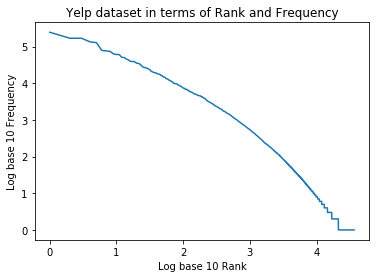

In [21]:
import math
import matplotlib.pyplot as plt

Rank_list=[]
frequency_list = []
Rank = 1
for word,frequency in frequency_distribution.most_common(unique_token_count):
    frequency_list.append(math.log10(frequency))
    Rank_list.append(math.log10(Rank))
    Rank+=1
    
plt.plot(Rank_list,frequency_list)
plt.title("Yelp dataset in terms of Rank and Frequency")
plt.xlabel("Log base 10 Rank")
plt.ylabel("Log base 10 Frequency")
plt.show()


What do you observe? Is this consistent with Zipf's law?

*From the above Graph we can see that Zipf's law is satisfied for our Yelp dataset, since the frequency of the unique words/tokens is inversely proportional to the rank of the word/token*

## Part 1.2: Feature Represenation (10 points)

In this part you will build feature vectors for each review. This will be input to our ML classifiers. You should call your parser from earlier, using all the same assumptions (e.g., casefolding, stemming). Each feature value should be the term count for that review.

In [22]:
# Populate the sparse matrix of dimensions 40,000 X 36000 i.e. All reviews X All unique tokens here. 
# Use the the list comprising of dictionaries we created for every review previously
import scipy.sparse as ss

print "Rows of Sparse Matrix",
print len(token_per_review_list)
print "Columns of Sparse Matrix ",
print len(unique_tokens_list)
dataset=ss.lil_matrix((len(token_per_review_list),len(unique_tokens_list)))

row=0
for review_dic in token_per_review_list:
    column =0
    for word in unique_tokens_list:
        if word in review_dic.keys():
            dataset[row,column]=review_dic[word]
        column+=1
    row+=1

Rows of Sparse Matrix 40000
Columns of Sparse Matrix  36618


In [4]:
#%store dataset
#%store -r dataset

## Part 1.3: Machine Learning Basics (30 points)

In this part you will evaluate a bunch of classifiers -- kNN, Decision tree, Naive Bayes, and SVM -- on the feature vectors generated in the previous task in two different settings. **You do not need to implement any classifier from scratch. You may use scikit-learn's built-in capabilities.**

### Setting 1: Splitting data into train-test 

In the first setting, you should treat the first 70% of your data as training. The remaining 30% should be for testing. 

### Setting 2: Using 5 fold cross-validation

In the second setting, use 5-folk cross-validation. 

### What to report


* Report the overall accuracy for both settings.
* For the class "Food-relevant", report the precision and recall for both settings.
* For the class "Food-irrelevant", report the precision and recall for both settings.

### kNN --- Couldn't simulate completely / Managed to run Setting 1 / Have run RandomForest instead

In [5]:
#Header files
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.model_selection import cross_val_predict
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn import svm
from sklearn.naive_bayes import MultinomialNB

In [6]:
#kNN -- Setting 1 -- Training
X=dataset
y=food_relevance_list
[X_train, X_test, y_train, y_test] = train_test_split(X, y, test_size=0.30)

#mlp=MLPClassifier()
#mlp.fit(X_train,y_train)

In [7]:
'''
knn= KNeighborsClassifier()
knn.fit(X_train,y_train)
# kNN Classifier -- Setting 1 -- Testing
knnpredict1 = knn.predict(X_test[:5000])
print "1 done"
#%store knnpredict1
%store -r knnpredict1
knnpredict2 = knn.predict(X_test[5000:10000])
print "2 done"
%store knnpredict2
#%store -r knnpredict2
knnpredict3 = knn.predict(X_test[10000:12000])
print "3 done"
%store knnpredict3
#%store -r knnpredict3
finalknn=[]

for sample in knnpredict1:
    finalknn.append(sample)
for sample in knnpredict2:
    finalknn.append(sample)
for sample in knnpredict3:
    finalknn.append(sample)
#print "all done"
print len(finalknn)
'''

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
           metric_params=None, n_jobs=1, n_neighbors=5, p=2,
           weights='uniform')

### Setting 1

In [67]:
#kNN Classifier -- Setting 1 -- Results
'''
print "Overall accuracy of Decision Tree :",
print accuracy_score(y_test, finalknn)
print "Precision for Food Relevant :",
print precision_score(y_pred=finalknn,y_true=y_test,pos_label=0)
print "Recall for Food Relevant :",
print recall_score(y_pred=finalknn,y_true=y_test,pos_label=0)
print "Precision for Food Irrelevant :",
print precision_score(y_pred=finalknn,y_true=y_test,pos_label=1)
print "Recall for Food Irrelevant :",
print recall_score(y_pred=finalknn,y_true=y_test,pos_label=1)
'''

Overall accuracy of Decision Tree : 0.741
Precision for Food Relevant : 0.7
Recall for Food Relevant : 0.853067282322
Precision for Food Irrelevant : 0.806724511931
Recall for Food Irrelevant : 0.626516172507


### Setting 2

In [40]:
'''
X_knn=dataset
y_knn=food_relevance_list
knnpredictioncross= cross_val_predict(knn, X_knn, y_knn, cv=5)

print "Overall accuracy of Decision Tree :",
print accuracy_score(y_knn,knnpredictioncross)
print "Precision for Food Relevant :",
print precision_score(y_pred=knnpredictioncross,y_true=y_knn,pos_label=0)
print "Recall for Food Relevant :",
print recall_score(y_pred=knnpredictioncross,y_true=y_knn,pos_label=0)
print "Precision for Food Irrelevant :",
print precision_score(y_pred=knnpredictioncross,y_true=y_knn,pos_label=1)
print "Recall for Food Irrelevant :",
print recall_score(y_pred=knnpredictioncross,y_true=y_knn,pos_label=1)
'''

'\nX_knn=dataset\ny_knn=food_relevance_list\nknnpredictioncross= cross_val_predict(knn, X_knn, y_knn, cv=5)\n\nprint "Overall accuracy of Decision Tree :",\nprint accuracy_score(y_knn,knnpredictioncross)\nprint "Precision for Food Relevant :",\nprint precision_score(y_pred=knnpredictioncross,y_true=y_knn,pos_label=0)\nprint "Recall for Food Relevant :",\nprint recall_score(y_pred=knnpredictioncross,y_true=y_knn,pos_label=0)\nprint "Precision for Food Irrelevant :",\nprint precision_score(y_pred=knnpredictioncross,y_true=y_knn,pos_label=1)\nprint "Recall for Food Irrelevant :",\nprint recall_score(y_pred=knnpredictioncross,y_true=y_knn,pos_label=1)\n'

### Decision Tree 

In [8]:
#Decision Tree -- Setting 1 -- Training
tree_d = DecisionTreeClassifier()
tree_d.fit(X_train,y_train)

DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=None,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=None,
            splitter='best')

In [9]:
#Decision Tree -- Setting 1 -- Testing

treepred = tree_d.predict(X_test)
print treepred

[0 1 0 ..., 1 0 0]


### Setting 1

In [10]:
#Decision Tree -- Setting 1 -- Results

print "Overall accuracy of Decision Tree :",
print accuracy_score(y_test, treepred)
print "Precision for Food Relevant :",
print precision_score(y_pred=treepred,y_true=y_test,pos_label=0)
print "Recall for Food Relevant :",
print recall_score(y_pred=treepred,y_true=y_test,pos_label=0)
print "Precision for Food Irrelevant :",
print precision_score(y_pred=treepred,y_true=y_test,pos_label=1)
print "Recall for Food Irrelevant :",
print recall_score(y_pred=treepred,y_true=y_test,pos_label=1)

Overall accuracy of Decision Tree : 0.885666666667
Precision for Food Relevant : 0.891489717439
Recall for Food Relevant : 0.880594549959
Precision for Food Irrelevant : 0.8798803788
Recall for Food Irrelevant : 0.890832632464


### Setting 2

In [11]:
X_tree=dataset
y_tree=food_relevance_list
treepredictioncross= cross_val_predict(tree_d, X_tree, y_tree, cv=5)

print "Overall accuracy of Decision Tree :",
print accuracy_score(y_tree,treepredictioncross)
print "Precision for Food Relevant :",
print precision_score(y_pred=treepredictioncross,y_true=y_tree,pos_label=0)
print "Recall for Food Relevant :",
print recall_score(y_pred=treepredictioncross,y_true=y_tree,pos_label=0)
print "Precision for Food Irrelevant :",
print precision_score(y_pred=treepredictioncross,y_true=y_tree,pos_label=1)
print "Recall for Food Irrelevant :",
print recall_score(y_pred=treepredictioncross,y_true=y_tree,pos_label=1)

Overall accuracy of Decision Tree : 0.86495
Precision for Food Relevant : 0.864658273381
Recall for Food Relevant : 0.86535
Precision for Food Irrelevant : 0.865242193755
Recall for Food Irrelevant : 0.86455


## Naive Bayes

In [12]:
#Naive Bayes -- Setting 1 -- Training
nb=MultinomialNB()
nb.fit(X_train,y_train)

MultinomialNB(alpha=1.0, class_prior=None, fit_prior=True)

In [13]:
#Naive Bayes -- Setting 1 -- Testing
nbpred= nb.predict(X_test)
print nbpred

[0 1 0 ..., 1 0 0]


### Setting 1

In [14]:
#Naive Bayes -- Setting 1 -- Results
print "Overall accuracy of Naive Bayes:",
print accuracy_score(y_test, nbpred)
print "Precision for Food Relevant :",
print precision_score(y_pred=nbpred,y_true=y_test,pos_label=0)
print "Recall for Food Relevant :",
print recall_score(y_pred=nbpred,y_true=y_test,pos_label=0)
print "Precision for Food Irrelevant :",
print precision_score(y_pred=nbpred,y_true=y_test,pos_label=1)
print "Recall for Food Irrelevant :",
print recall_score(y_pred=nbpred,y_true=y_test,pos_label=1)

Overall accuracy of Naive Bayes: 0.945416666667
Precision for Food Relevant : 0.945986124876
Recall for Food Relevant : 0.945829892651
Precision for Food Irrelevant : 0.944836865119
Recall for Food Irrelevant : 0.944995794786


### Setting 2

In [15]:
#Naive Bayes -- Setting 2 -- Cross validation

X_nb=dataset
y_nb=food_relevance_list
nbpredictioncross= cross_val_predict(nb, X_nb, y_nb, cv=5)
print "Overall accuracy of Naive Bayes :",
print accuracy_score(y_nb,nbpredictioncross)
print "Precision for Food Relevant :",
print precision_score(y_pred=nbpredictioncross,y_true=y_nb,pos_label=0)
print "Recall for Food Relevant :",
print recall_score(y_pred=nbpredictioncross,y_true=y_nb,pos_label=0)
print "Precision for Food Irrelevant :",
print precision_score(y_pred=nbpredictioncross,y_true=y_nb,pos_label=1)
print "Recall for Food Irrelevant :",
print recall_score(y_pred=nbpredictioncross,y_true=y_nb,pos_label=1)

Overall accuracy of Naive Bayes : 0.934075
Precision for Food Relevant : 0.927554789461
Recall for Food Relevant : 0.9417
Precision for Food Irrelevant : 0.940797156639
Recall for Food Irrelevant : 0.92645


### SVM

In [16]:
#SVM -- Setting 1 -- Training
svm1=svm.SVC()
svm1.fit(X_train,y_train)

SVC(C=1.0, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=3, gamma='auto', kernel='rbf',
  max_iter=-1, probability=False, random_state=None, shrinking=True,
  tol=0.001, verbose=False)

In [17]:
#SVM -- Setting 1 -- Testing
svmpred= svm1.predict(X_test)
print svmpred

[0 1 0 ..., 1 0 0]


### Setting 1

In [18]:
#SVM -- Setting 1 -- Results
print "Overall accuracy of SVM :",
print accuracy_score(y_test, svmpred)
print "Precision for Food Relevant :",
print precision_score(y_pred=svmpred,y_true=y_test,pos_label=0)
print "Recall for Food Relevant :",
print recall_score(y_pred=svmpred,y_true=y_test,pos_label=0)
print "Precision for Food Irrelevant :",
print precision_score(y_pred=svmpred,y_true=y_test,pos_label=1)
print "Recall for Food Irrelevant :",
print recall_score(y_pred=svmpred,y_true=y_test,pos_label=1)

Overall accuracy of SVM : 0.8595
Precision for Food Relevant : 0.917446971145
Recall for Food Relevant : 0.792898431049
Precision for Food Irrelevant : 0.81468893158
Recall for Food Irrelevant : 0.927333894029


### Setting 2

In [ ]:

X_svm=dataset
y_svm=food_relevance_list
svmpredictioncross= cross_val_predict(svm1, X_svm, y_svm, cv=5)
print "Overall accuracy of Naive Bayes :",
print accuracy_score(y_svm,svmpredictioncross)
print "Precision for Food Relevant :",
print precision_score(y_pred=svmpredictioncross,y_true=y_svm,pos_label=0)
print "Recall for Food Relevant :",
print recall_score(y_pred=svmpredictioncross,y_true=y_svm,pos_label=0)
print "Precision for Food Irrelevant :",
print precision_score(y_pred=svmpredictioncross,y_true=y_svm,pos_label=1)
print "Recall for Food Irrelevant :",
print recall_score(y_pred=svmpredictioncross,y_true=y_svm,pos_label=1)


### Random Forest Classifier

In [36]:
from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier()

rf.fit(X_train,y_train)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=10, n_jobs=1,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

In [37]:
rfpred= rf.predict(X_test)
print rfpred

[0 0 0 ..., 1 0 0]


### Setting 1

In [38]:
print "Overall accuracy of Random Forest :",
print accuracy_score(y_test, rfpred)
print "Precision for Food Relevant :",
print precision_score(y_pred=rfpred,y_true=y_test,pos_label=0)
print "Recall for Food Relevant :",
print recall_score(y_pred=rfpred,y_true=y_test,pos_label=0)
print "Precision for Food Irrelevant :",
print precision_score(y_pred=rfpred,y_true=y_test,pos_label=1)
print "Recall for Food Irrelevant :",
print recall_score(y_pred=rfpred,y_true=y_test,pos_label=1)

Overall accuracy of Random Forest : 0.897916666667
Precision for Food Relevant : 0.884064885496
Recall for Food Relevant : 0.918084227911
Precision for Food Irrelevant : 0.913165266106
Recall for Food Irrelevant : 0.877375946173


### Setting 2

In [49]:
X_rf=dataset
y_rf=food_relevance_list
rfpredictioncross= cross_val_predict(rf, X_rf, y_rf, cv=5)
print "Overall accuracy of Random Forest :",
print accuracy_score(y_rf,rfpredictioncross)
print "Precision for Food Relevant :",
print precision_score(y_pred=rfpredictioncross,y_true=y_rf,pos_label=0)
print "Recall for Food Relevant :",
print recall_score(y_pred=rfpredictioncross,y_true=y_rf,pos_label=0)
print "Precision for Food Irrelevant :",
print precision_score(y_pred=rfpredictioncross,y_true=y_rf,pos_label=1)
print "Recall for Food Irrelevant :",
print recall_score(y_pred=rfpredictioncross,y_true=y_rf,pos_label=1)

Overall accuracy of Random Forest : 0.8851
Precision for Food Relevant : 0.864816218264
Recall for Food Relevant : 0.9129
Precision for Food Irrelevant : 0.907772130453
Recall for Food Irrelevant : 0.8573


## Part 1.4: Analyzing your results (5 points) 

Out of the 5 classifiers, Naive Bayes performs the best with an overall accuracy of 93% and 94% in both settings. Random forest is the next best with 89-90% overall accuracy, Decision tree follows with an average of 88% accuracy. SVM has a 85% overall accuracy followed by kNN. 

Comparing Naive Bayes and Decision trees, it is found that Decision trees work well for classification and regression problems, especially for predicting a categorical value. However, decision trees are prone to over fitting in case of a large dataset. This is more pronounced in case of a large dataset.Perhaps this is why the performance of DT is lower compared to NB. NB on the other hand is a harder classifier to understand but it is a more mathematically sound classifier and therefore performs better.

Comparing Decision trees vs Random Forest, one realizes that RF is actually a collection of various decision trees. Therefore the problem of overfitting observed by a single decision tree is prevented by Random forest. RF does this by creating random subsets of the features and building smaller trees using the subsets and then it combines the subtrees. This is probably why the results of RF are more promising than DT. RF is also observed to be faster than DT.

Comparing kNN vs SVM. kNN seems to highly depend on the choice of the number of neighbours, apparently it tends to perform well with a lot of data points but it is very performance intensive, it also scales badly. Turns out kNN is also very sensitive to bad features, and in our dataset, we did have a lot of one line reviews without any food relevant words. SVM on the other hand is good with outliers, which is what these one line reviews could be categorized as. In general SVM is a better and faster classifier and seems to provide a more reliable detection. The problem we are solving is a simple classification problem and in such a secanrio SVM outranks kNN.

## Part 1.5: Improving your classifier (10 points)

I think we can do better! In this part, your job is to create new features that you can think can help improve your classifier. You may choose to use new weightings for your words, new derived features (e.g., count of 3-letter words), or whatever you like. You may also add in the extra features in the json: funny, useful, cool. You will need to experiment with different approaches ... once you finalize on your best approach, include the features here with a description (that is, tell us what the feature means). Then give us your classifier results!

### Approach 1 : Removing Stop Words

In [20]:
from sklearn.feature_extraction.text import CountVectorizer
stop_word_vectorizer = CountVectorizer(stop_words='english')
sw = stop_word_vectorizer.fit_transform(count_vectorize_list)
#print type(sw)
print sw

  (0, 6191)	1
  (0, 15263)	1
  (0, 10901)	1
  (0, 47132)	1
  (0, 48467)	1
  (0, 42755)	1
  (0, 38006)	2
  (0, 22321)	1
  (0, 44034)	1
  (0, 38400)	1
  (0, 45779)	1
  (0, 31622)	2
  (0, 22119)	1
  (0, 8630)	1
  (0, 24096)	1
  (0, 17513)	1
  (0, 34042)	1
  (0, 32414)	1
  (0, 23330)	1
  (0, 32213)	1
  (0, 2337)	1
  (0, 34282)	1
  (0, 41523)	1
  (0, 47399)	1
  (0, 34308)	1
  :	:
  (39999, 3575)	1
  (39999, 9523)	1
  (39999, 27771)	1
  (39999, 27212)	1
  (39999, 46740)	2
  (39999, 31783)	1
  (39999, 40451)	2
  (39999, 22423)	1
  (39999, 37442)	1
  (39999, 14867)	3
  (39999, 27530)	2
  (39999, 18151)	1
  (39999, 51954)	2
  (39999, 25180)	1
  (39999, 32665)	4
  (39999, 35027)	1
  (39999, 14842)	5
  (39999, 14846)	5
  (39999, 17481)	1
  (39999, 34280)	1
  (39999, 47132)	1
  (39999, 38006)	2
  (39999, 23330)	2
  (39999, 34282)	1
  (39999, 47399)	2


#### Naive Bayes Classifier

In [21]:
X_sw=sw
y_sw=food_relevance_list
[X_train_sw, X_test_sw, y_train_sw, y_test_sw] = train_test_split(X_sw, y_sw, test_size=0.30)

In [22]:
nb_sw=MultinomialNB()
nb_sw.fit(X_train_sw,y_train_sw)

nbpred_sw= nb_sw.predict(X_test_sw)
print nbpred_sw

print "Overall accuracy of Naive Bayes:",
print accuracy_score(y_test_sw, nbpred_sw)
print "Precision for Food Relevant :",
print precision_score(y_pred=nbpred_sw,y_true=y_test_sw,pos_label=0)
print "Recall for Food Relevant :",
print recall_score(y_pred=nbpred_sw,y_true=y_test_sw,pos_label=0)
print "Precision for Food Irrelevant :",
print precision_score(y_pred=nbpred_sw,y_true=y_test_sw,pos_label=1)
print "Recall for Food Irrelevant :",
print recall_score(y_pred=nbpred_sw,y_true=y_test_sw,pos_label=1)

[1 1 1 ..., 0 0 0]
Overall accuracy of Naive Bayes: 0.94675
Precision for Food Relevant : 0.945234943746
Recall for Food Relevant : 0.948845706693
Precision for Food Irrelevant : 0.948287441236
Recall for Food Irrelevant : 0.944639571835


#### Decision Tree Classifier

In [23]:
tree_d_sw = DecisionTreeClassifier()
tree_d_sw.fit(X_train_sw,y_train_sw)
treesw= tree_d_sw.predict(X_test_sw)
print treesw

print "Overall accuracy of Decision Tree :",
print accuracy_score(y_test_sw, treesw)
print "Precision for Food Relevant :",
print precision_score(y_pred=treesw,y_true=y_test_sw,pos_label=0)
print "Recall for Food Relevant :",
print recall_score(y_pred=treesw,y_true=y_test_sw,pos_label=0)
print "Precision for Food Irrelevant :",
print precision_score(y_pred=treesw,y_true=y_test_sw,pos_label=1)
print "Recall for Food Irrelevant :",
print recall_score(y_pred=treesw,y_true=y_test_sw,pos_label=1)

[1 0 1 ..., 0 0 0]
Overall accuracy of Decision Tree : 0.884666666667
Precision for Food Relevant : 0.879522016697
Recall for Food Relevant : 0.892376681614
Precision for Food Irrelevant : 0.890001697505
Recall for Food Irrelevant : 0.876902492056


#### Random Forest Classifier

In [41]:
rf = RandomForestClassifier()
rf.fit(X_train_sw,y_train_sw)
rfpredsw= rf.predict(X_test_sw)
print rfpredsw

print "Overall accuracy of Random Forest :",
print accuracy_score(y_test_sw, rfpredsw)
print "Precision for Food Relevant :",
print precision_score(y_pred=rfpredsw,y_true=y_test_sw,pos_label=0)
print "Recall for Food Relevant :",
print recall_score(y_pred=rfpredsw,y_true=y_test_sw,pos_label=0)
print "Precision for Food Irrelevant :",
print precision_score(y_pred=rfpredsw,y_true=y_test_sw,pos_label=1)
print "Recall for Food Irrelevant :",
print recall_score(y_pred=rfpredsw,y_true=y_test_sw,pos_label=1)

[1 1 1 ..., 0 0 1]
Overall accuracy of Random Forest : 0.908416666667
Precision for Food Relevant : 0.897448320413
Recall for Food Relevant : 0.922936389304
Precision for Food Irrelevant : 0.920110192837
Recall for Food Irrelevant : 0.893794948988


### Approach 2 : Bigrams

In [24]:
from sklearn.feature_extraction.text import CountVectorizer
bigram = CountVectorizer(ngram_range=(1, 2),token_pattern=r'\b\w+\b', min_df=1)
big = bigram.fit_transform(count_vectorize_list)
print big

  (0, 20663)	1
  (0, 277100)	1
  (0, 707633)	1
  (0, 519131)	1
  (0, 160801)	1
  (0, 419016)	1
  (0, 30796)	1
  (0, 404416)	1
  (0, 436124)	1
  (0, 211336)	1
  (0, 75317)	1
  (0, 597889)	1
  (0, 892756)	1
  (0, 910868)	1
  (0, 927723)	1
  (0, 416445)	1
  (0, 787105)	1
  (0, 519217)	1
  (0, 436392)	2
  (0, 574476)	1
  (0, 269197)	1
  (0, 554766)	1
  (0, 981115)	1
  (0, 708692)	1
  (0, 333482)	1
  :	:
  (39999, 415483)	1
  (39999, 268359)	7
  (39999, 980635)	3
  (39999, 707265)	2
  (39999, 332880)	2
  (39999, 762394)	3
  (39999, 170359)	3
  (39999, 1010171)	4
  (39999, 458088)	5
  (39999, 533425)	4
  (39999, 404353)	5
  (39999, 564387)	10
  (39999, 427042)	2
  (39999, 992271)	5
  (39999, 649650)	1
  (39999, 901428)	2
  (39999, 611577)	1
  (39999, 124937)	2
  (39999, 905038)	15
  (39999, 59439)	10
  (39999, 739196)	3
  (39999, 19998)	7
  (39999, 442280)	5
  (39999, 342788)	3
  (39999, 435215)	16


#### Naive Bayes Classifier

In [25]:
X_bi=big
y_bi=food_relevance_list
[X_train_bi, X_test_bi, y_train_bi, y_test_bi] = train_test_split(X_bi, y_bi, test_size=0.30)

In [26]:
nbbigram=MultinomialNB()
nbbigram.fit(X_train_bi,y_train_bi)

nbpredbigram= nbbigram.predict(X_test_bi)
print nbpredbigram

print "Overall accuracy of Naive Bayes:",
print accuracy_score(y_test_bi, nbpredbigram)
print "Precision for Food Relevant :",
print precision_score(y_pred=nbpredbigram,y_true=y_test_bi,pos_label=0)
print "Recall for Food Relevant :",
print recall_score(y_pred=nbpredbigram,y_true=y_test_bi,pos_label=0)
print "Precision for Food Irrelevant :",
print precision_score(y_pred=nbpredbigram,y_true=y_test_bi,pos_label=1)
print "Recall for Food Irrelevant :",
print recall_score(y_pred=nbpredbigram,y_true=y_test_bi,pos_label=1)

[0 0 0 ..., 1 1 0]
Overall accuracy of Naive Bayes: 0.951916666667
Precision for Food Relevant : 0.947187704382
Recall for Food Relevant : 0.957995700347
Precision for Food Irrelevant : 0.956832087016
Recall for Food Irrelevant : 0.945741642869


#### Decision Tree Classifier

In [27]:
tree_d_bi = DecisionTreeClassifier()
tree_d_bi.fit(X_train_bi,y_train_bi)
treebi= tree_d_bi.predict(X_test_bi)
print treebi

print "Overall accuracy of Decision Tree :",
print accuracy_score(y_test_bi, treebi)
print "Precision for Food Relevant :",
print precision_score(y_pred=treebi,y_true=y_test_bi,pos_label=0)
print "Recall for Food Relevant :",
print recall_score(y_pred=treebi,y_true=y_test_bi,pos_label=0)
print "Precision for Food Irrelevant :",
print precision_score(y_pred=treebi,y_true=y_test_bi,pos_label=1)
print "Recall for Food Irrelevant :",
print recall_score(y_pred=treebi,y_true=y_test_bi,pos_label=1)

[0 0 0 ..., 1 1 0]
Overall accuracy of Decision Tree : 0.883916666667
Precision for Food Relevant : 0.891618983507
Recall for Food Relevant : 0.876136927402
Precision for Food Irrelevant : 0.876361835589
Recall for Food Irrelevant : 0.891819250798


#### Random Forest Classifier

In [42]:
rfbi = RandomForestClassifier()
rfbi.fit(X_train_bi,y_train_bi)
rfpredbi= rfbi.predict(X_test_bi)
print rfpredbi

print "Overall accuracy of Random Forest :",
print accuracy_score(y_test_bi, rfpredbi)
print "Precision for Food Relevant :",
print precision_score(y_pred=rfpredbi,y_true=y_test_bi,pos_label=0)
print "Recall for Food Relevant :",
print recall_score(y_pred=rfpredbi,y_true=y_test_bi,pos_label=0)
print "Precision for Food Irrelevant :",
print precision_score(y_pred=rfpredbi,y_true=y_test_bi,pos_label=1)
print "Recall for Food Irrelevant :",
print recall_score(y_pred=rfpredbi,y_true=y_test_bi,pos_label=1)

[0 0 0 ..., 1 1 0]
Overall accuracy of Random Forest : 0.888
Precision for Food Relevant : 0.883667808778
Recall for Food Relevant : 0.895650735902
Precision for Food Irrelevant : 0.892522568557
Recall for Food Irrelevant : 0.880228456241


### Approach 3: TF-IDF

In [45]:
# your code here ... add as many cells as you need for features, results, and discussion.
from sklearn.feature_extraction.text import TfidfVectorizer
vec = TfidfVectorizer()
dvec=vec.fit_transform(count_vectorize_list)
print dvec

  (0, 15280)	0.106416907632
  (0, 21003)	0.21677711208
  (0, 32842)	0.128601370117
  (0, 17265)	0.079291155437
  (0, 28110)	0.0848188725461
  (0, 19245)	0.0323304492269
  (0, 24287)	0.10008211665
  (0, 20429)	0.125243264426
  (0, 36373)	0.194795116357
  (0, 22495)	0.208645795417
  (0, 32017)	0.0641591474912
  (0, 3161)	0.0762814350505
  (0, 15881)	0.0987018232871
  (0, 47803)	0.16902084104
  (0, 46519)	0.112314619546
  (0, 52098)	0.183272497015
  (0, 5585)	0.0797102349729
  (0, 34505)	0.197074753398
  (0, 2918)	0.0640961782461
  (0, 33030)	0.0399559752106
  (0, 47656)	0.0525063790521
  (0, 41728)	0.120835962256
  (0, 23041)	0.0837013642975
  (0, 34479)	0.147161368492
  (0, 2340)	0.200989048695
  :	:
  (39999, 23461)	0.0621665118546
  (39999, 10137)	0.0432176165868
  (39999, 29726)	0.205984238139
  (39999, 1824)	0.0500029742669
  (39999, 13601)	0.0594125479079
  (39999, 1892)	0.0508102842027
  (39999, 21439)	0.059607083487
  (39999, 19830)	0.0525887695089
  (39999, 49873)	0.051184822179

#### Naive Bayes Classifier

In [46]:
X_idf=dvec
y_idf=food_relevance_list
[X_train_idf, X_test_idf, y_train_idf, y_test_idf] = train_test_split(X_idf, y_idf, test_size=0.30)

In [12]:
nbvec=MultinomialNB()
nbvec.fit(X_train_idf,y_train_idf)

nbpredvec= nbvec.predict(X_test_idf)
print nbpredvec

print "Overall accuracy of Naive Bayes:",
print accuracy_score(y_test_idf, nbpredvec)
print "Precision for Food Relevant :",
print precision_score(y_pred=nbpredvec,y_true=y_test_idf,pos_label=0)
print "Recall for Food Relevant :",
print recall_score(y_pred=nbpredvec,y_true=y_test_idf,pos_label=0)
print "Precision for Food Irrelevant :",
print precision_score(y_pred=nbpredvec,y_true=y_test_idf,pos_label=1)
print "Recall for Food Irrelevant :",
print recall_score(y_pred=nbpredvec,y_true=y_test_idf,pos_label=1)

[0 0 1 ..., 0 0 1]
Overall accuracy of Naive Bayes: 0.948916666667
Precision for Food Relevant : 0.944003964321
Recall for Food Relevant : 0.954249457338
Precision for Food Irrelevant : 0.95391860074
Recall for Food Irrelevant : 0.943603393778


#### Decision Tree Classifier

In [13]:
tree_dvec = DecisionTreeClassifier()
tree_dvec.fit(X_train_idf,y_train_idf)
treevec= tree_dvec.predict(X_test_idf)
print treevec

print "Overall accuracy of Decision Tree :",
print accuracy_score(y_test_idf, treevec)
print "Precision for Food Relevant :",
print precision_score(y_pred=treevec,y_true=y_test_idf,pos_label=0)
print "Recall for Food Relevant :",
print recall_score(y_pred=treevec,y_true=y_test_idf,pos_label=0)
print "Precision for Food Irrelevant :",
print precision_score(y_pred=treevec,y_true=y_test_idf,pos_label=1)
print "Recall for Food Irrelevant :",
print recall_score(y_pred=treevec,y_true=y_test_idf,pos_label=1)

[1 0 1 ..., 0 0 1]
Overall accuracy of Decision Tree : 0.881833333333
Precision for Food Relevant : 0.878958713315
Recall for Food Relevant : 0.885122724996
Precision for Food Irrelevant : 0.884737812029
Recall for Food Irrelevant : 0.878555980702


#### Random Forest Classifier

In [47]:
rfidf = RandomForestClassifier()
rfidf.fit(X_train_idf,y_train_idf)
rfpredidf= rfidf.predict(X_test_idf)
print rfpredidf

print "Overall accuracy of Random Forest :",
print accuracy_score(y_test_idf, rfpredidf)
print "Precision for Food Relevant :",
print precision_score(y_pred=rfpredidf,y_true=y_test_idf,pos_label=0)
print "Recall for Food Relevant :",
print recall_score(y_pred=rfpredidf,y_true=y_test_idf,pos_label=0)
print "Precision for Food Irrelevant :",
print precision_score(y_pred=rfpredidf,y_true=y_test_idf,pos_label=1)
print "Recall for Food Irrelevant :",
print recall_score(y_pred=rfpredidf,y_true=y_test_idf,pos_label=1)

[0 0 0 ..., 0 1 0]
Overall accuracy of Random Forest : 0.892083333333
Precision for Food Relevant : 0.880122127591
Recall for Food Relevant : 0.908894789247
Precision for Food Irrelevant : 0.904967976458
Recall for Food Irrelevant : 0.875125544024


### Approach 4 : Give weights to specific words

In [31]:
cvw = CountVectorizer(min_df=1,stop_words="english")
tf_cvw = cvw.fit_transform(count_vectorize_list)

from sklearn.feature_extraction.text import TfidfTransformer

tfidf = TfidfTransformer(norm="l2")
tfidf.fit(tf_cvw)
tfidfm = tfidf.transform(tf_cvw)

position = cvw.vocabulary_['sauce']
tfidfm[:, position] *= 3.0

position = cvw.vocabulary_['tasty']
tfidfm[:, position] *= 2.0

position = cvw.vocabulary_['dinner']
tfidfm[:, position] *= 2.0

position = cvw.vocabulary_['shrimp']
tfidfm[:, position] *= 1.5

#### Naive Bayes Classifier

In [33]:
X_wt=tfidfm
y_wt=food_relevance_list
[X_train_wt, X_test_wt, y_train_wt, y_test_wt] = train_test_split(X_wt, y_wt, test_size=0.30)

In [34]:
nbwt=MultinomialNB()
nbwt.fit(X_train_wt,y_train_wt)

nbpredwt= nbwt.predict(X_test_wt)
print nbpredwt

print "Overall accuracy of Naive Bayes:",
print accuracy_score(y_test_wt, nbpredwt)
print "Precision for Food Relevant :",
print precision_score(y_pred=nbpredwt,y_true=y_test_wt,pos_label=0)
print "Recall for Food Relevant :",
print recall_score(y_pred=nbpredwt,y_true=y_test_wt,pos_label=0)
print "Precision for Food Irrelevant :",
print precision_score(y_pred=nbpredwt,y_true=y_test_wt,pos_label=1)
print "Recall for Food Irrelevant :",
print recall_score(y_pred=nbpredwt,y_true=y_test_wt,pos_label=1)

[0 0 0 ..., 0 0 1]
Overall accuracy of Naive Bayes: 0.9535
Precision for Food Relevant : 0.950541215654
Recall for Food Relevant : 0.956274082761
Precision for Food Irrelevant : 0.956463719766
Recall for Food Irrelevant : 0.950754435417


#### Decision Tree Classifier

In [35]:
tree_dwt = DecisionTreeClassifier()
tree_dwt.fit(X_train_wt,y_train_wt)
treewt= tree_dwt.predict(X_test_wt)
print treewt

print "Overall accuracy of Decision Tree :",
print accuracy_score(y_test_wt, treewt)
print "Precision for Food Relevant :",
print precision_score(y_pred=treewt,y_true=y_test_wt,pos_label=0)
print "Recall for Food Relevant :",
print recall_score(y_pred=treewt,y_true=y_test_wt,pos_label=0)
print "Precision for Food Irrelevant :",
print precision_score(y_pred=treewt,y_true=y_test_wt,pos_label=1)
print "Recall for Food Irrelevant :",
print recall_score(y_pred=treewt,y_true=y_test_wt,pos_label=1)

[0 0 0 ..., 0 0 1]
Overall accuracy of Decision Tree : 0.89625
Precision for Food Relevant : 0.889511873351
Recall for Food Relevant : 0.903668956274
Precision for Food Irrelevant : 0.903133423181
Recall for Food Irrelevant : 0.88890731222


### Random Forest Classifier

In [48]:
rfwt = RandomForestClassifier()
rfwt.fit(X_train_wt,y_train_wt)
rfpredwt= rfwt.predict(X_test_wt)
print rfpredwt

print "Overall accuracy of Random Forest :",
print accuracy_score(y_test_wt, rfpredwt)
print "Precision for Food Relevant :",
print precision_score(y_pred=rfpredwt,y_true=y_test_wt,pos_label=0)
print "Recall for Food Relevant :",
print recall_score(y_pred=rfpredwt,y_true=y_test_wt,pos_label=0)
print "Precision for Food Irrelevant :",
print precision_score(y_pred=rfpredwt,y_true=y_test_wt,pos_label=1)
print "Recall for Food Irrelevant :",
print recall_score(y_pred=rfpredwt,y_true=y_test_wt,pos_label=1)

[0 0 0 ..., 0 0 1]
Overall accuracy of Random Forest : 0.916833333333
Precision for Food Relevant : 0.899662325133
Recall for Food Relevant : 0.937342938516
Precision for Food Irrelevant : 0.9353053105
Recall for Food Irrelevant : 0.896534571381


### BONUS: What are the most informative features in distinguishing these two classes?

### Conclusions:
Giving specific weights to food oriented words (collected after scraping through the original dataset) provides the best accuracy across Naive Bayes, Decision Tree and Random forest classifier. This is insipte of the fact that only 5 to 6 words were provided weights, with a more careful scraping of the overall dataset, the accuracy could be improved further. Bigrams show the next best performance followed by tf-idf and finally removal of stop words. 

# Part 2: Learning to Rank (30 points)

For this part, we're going to play with some Microsoft LETOR data that has query-document relevance judgments. Let's see how learning to rank works in practice. 

First, you will need to download the MQ2008.zip file from the Resources tab on Piazza. This is data from the [Microsoft Research IR Group](https://www.microsoft.com/en-us/research/project/letor-learning-rank-information-retrieval/).

The data includes 15,211 rows. Each row is a query-document pair. The first column is a relevance label of this pair (0,1 or 2--> the higher value the more related), the second column is query id, the following columns are features, and the end of the row is comment about the pair, including id of the document. A query-document pair is represented by a 46-dimensional feature vector. Features are a numeric value describing a document and query such as TFIDF, BM25, Page Rank, .... You can find compelete description of features from [here](https://arxiv.org/ftp/arxiv/papers/1306/1306.2597.pdf).

The good news for you is the dataset is ready for analysis: It has already been split into 5 folds (see the five folders called Fold1, ..., Fold5).

For this assignment, we're going to leave our favorite scikit-learn and instead use [SVM-rank](https://www.cs.cornell.edu/people/tj/svm_light/svm_rank.html). This is the basic ranking SVM we talked about in class. You'll see that SVM-rank considers pairwise relevance between docs -- so based on the training data it will transform the data into pairs -- like D1 > D2 and then learn a separator.


## Part 2.1: Optimizing SVM-Rank (15 points)

First, you should explore how the different parameters affect the quality of the Ranking SVM. You'll see that you can vary the kernel function, the loss function and so forth. 

You should run SVM-Rank using the default options over each of the five folds. You should find the error on the test set (for example, depending on your settings, svm_rank_classify will give you the zero/one error statistics (that is, the number of correct pairs and the number of incorrect pairs). Report the average. 

Then try different parameters and report how they impact the quality of results. 

## Default SVM-rank

### Parameters : -c float, where float is 0.01
##### FOLD 1 :
------------------------------------

| Parameter                 | Value                                       |
| ------------------------- |:-------------------------------------------:|
| Average loss on test set  | 0.1433                                      |
| Zero/one-error on test set| 58.97% (64 correct, 92 incorrect, 156 total)|
| Total Num Swapped pairs   | 2542                                        |
| Avg Swapped pairs Percent | 14.33                                       |

##### FOLD 2:
------------------------------------
| Parameter                 | Value                                       |
| ------------------------- |:-------------------------------------------:|
| Average loss on test set  | 0.1631                                      |
| Zero/one-error on test set| 57.32% (67 correct, 90 incorrect, 157 total)|
| Total Num Swapped pairs   | 4300                                        |
| Avg Swapped pairs Percent | 16.31                                       |

##### FOLD 3:
------------------------------------
| Parameter                 | Value                                       |
| ------------------------- |:-------------------------------------------:|
| Average loss on test set  | 0.1545                                      |
| Zero/one-error on test set| 61.15% (61 correct, 96 incorrect, 157 total)|
| Total Num Swapped pairs   | 4093                                        |
| Avg Swapped pairs Percent | 15.45                                       |

##### FOLD 4:
------------------------------------
| Parameter                 | Value                                       |
| ------------------------- |:-------------------------------------------:|
| Average loss on test set  | 0.1709                                      |
| Zero/one-error on test set| 68.79% (49 correct, 108 incorrect, 157 total)|
| Total Num Swapped pairs   | 3001                                        |
| Avg Swapped pairs Percent | 17.09                                       |

##### FOLD 5:
------------------------------------
| Parameter                 | Value                                       |
| ------------------------- |:-------------------------------------------:|
| Average loss on test set  | 0.1672                                      |
| Zero/one-error on test set| 64.97% (55 correct, 102 incorrect, 157 total)|
| Total Num Swapped pairs   | 2861                                        |
| Avg Swapped pairs Percent | 16.72                                       |

##### Average Zero/one-error on test set
###### 62.24%

## Modified Parameters SVM-rank

### FOLD 1
------------------------------------
#### Parameters: With -c 10 -e 0.9

| Parameter                 | Value                                       |
| ------------------------- |:-------------------------------------------:|
| Average loss on test set  | 0.1497                                      |
| Zero/one-error on test set| 57.69% (66 correct, 90 incorrect, 156 total)|
| Total Num Swapped pairs   | 2784                                        |
| Avg Swapped pairs Percent | 14.97                                       |

#### Parameters: With -c 5.5,-p 1

| Parameter                 | Value                                       |
| ------------------------- |:-------------------------------------------:|
| Average loss on test set  | 0.1465                                      |
| Zero/one-error on test set| 60.26% (62 correct, 94 incorrect, 156 total)|
| Total Num Swapped pairs   | 2542                                        |
| Avg Swapped pairs Percent | 14.65                                       |


#### Parameters: With -c 25, -w 4

| Parameter                 | Value                                       |
| ------------------------- |:-------------------------------------------:|
| Average loss on test set  | 0.1469                                      |
| Zero/one-error on test set| 59.62% (63 correct, 93 incorrect, 156 total)|
| Total Num Swapped pairs   | 2499                                        |
| Avg Swapped pairs Percent | 14.69                                       |

### FOLD 2
------------------------------------
#### Parameters: With -c 15 -f 5
| Parameter                 | Value                                       |
| ------------------------- |:-------------------------------------------:|
| Average loss on test set  | 0.1608                                      |
| Zero/one-error on test set| 56.05% (69 correct, 88 incorrect, 157 total)|
| Total Num Swapped pairs   | 4165                                        |
| Avg Swapped pairs Percent | 16.08                                       |

#### Parameters: With -c 30 -b 90
| Parameter                 | Value                                       |
| ------------------------- |:-------------------------------------------:|
| Average loss on test set  | 0.1605                                      |
| Zero/one-error on test set| 57.32% (67 correct, 90 incorrect, 157 total)|
| Total Num Swapped pairs   | 4092                                        |
| Avg Swapped pairs Percent | 16.05                                       |

### FOLD 3
------------------------------------
#### Parameters: With -c 0 -k 34
| Parameter                 | Value                                       |
| ------------------------- |:-------------------------------------------:|
| Average loss on test set  | 0.7134                                      |
| Zero/one-error on test set| 71.34% (45 correct, 112 incorrect, 157 total)|
| Total Num Swapped pairs   | 16542                                        |
| Avg Swapped pairs Percent | 71.34                                       |

#### Parameters: With -c 10 -k 34
| Parameter                 | Value                                       |
| ------------------------- |:-------------------------------------------:|
| Average loss on test set  | 0.1570                                      |
| Zero/one-error on test set| 61.78% (60 correct, 97 incorrect, 157 total)|
| Total Num Swapped pairs   | 4129                                        |
| Avg Swapped pairs Percent | 15.70                                       |

### FOLD 4
------------------------------------
#### Parameters: With -c 7 -f 5
| Parameter                 | Value                                       |
| ------------------------- |:-------------------------------------------:|
| Average loss on test set  | 0.1728                                      |
| Zero/one-error on test set| 69.43% (48 correct, 109 incorrect, 157 total)|
| Total Num Swapped pairs   | 3036                                        |
| Avg Swapped pairs Percent | 17.28                                       |

#### Parameters: With -c 7 -f 5 -w 4 -b 90 -p 1 
| Parameter                 | Value                                       |
| ------------------------- |:-------------------------------------------:|
| Average loss on test set  | 0.1748                                      |
| Zero/one-error on test set| 69.43% (48 correct, 109 incorrect, 157 total)|
| Total Num Swapped pairs   | 3040                                        |
| Avg Swapped pairs Percent | 17.48                                       |

### FOLD 5
------------------------------------
#### Parameters: With -c 7 -e 5 -w 4 -b 20
| Parameter                 | Value                                       |
| ------------------------- |:-------------------------------------------:|
| Average loss on test set  | 0.7643                                      |
| Zero/one-error on test set| 76.43% (37 correct, 120 incorrect, 157 total)|
| Total Num Swapped pairs   | 14239                                        |
| Avg Swapped pairs Percent | 76.43                                       |


#### Conclusions
SVM rank provides a number of parameters. The default setting of SVM rank comprises of parameter c with a default value of 0.01. The best zero error rate we get in the default setting is 57%. On modifying various parameters across various folds, we still range with the zero-error rate between 55% to 67%. One observation is that lowering the value of c too much increases the incorrect classifications. Adding too many parameters seem to have a negative effect on the performance, the best performance we achieve by modifying parameters is 56% zero-error rate. 


## Part 2.1: Noise! (15 points)

Now we're going to investigate whether the ranking SVM is easily influenced by noisy features. For example, what if some of the features you have are in error? Or what if you downloaded only a portion of a page to calculate a feature? (so the count of inlinks would be wrong)? 

In this case, add some noise to the features. What happens to the results? You may choose to add random noise throughout, noise to a single feature, noise to multiple features, etc. The choices are up to you. We aim to see what kind of exploration you conduct and what you conclude.

## Results
#### FOLD 1:
-------------
##### With -c 10 , -e 3 and noise by elimination of features 5 and 11 / Replacing randomly selected lower features values with higher values
| Parameter                 | Value                                       |
| ------------------------- |:-------------------------------------------:|
| Average loss on test set  | 0.1456                                      |
| Zero/one-error on test set| 57.05% (67 correct, 89 incorrect, 156 total)|
| Total Num Swapped pairs   | 2542                                        |
| Avg Swapped pairs Percent | 14.56                                       |

#### FOLD 2 :
--------------
##### With -c 0.01 and noise by elimination of features 1, 18 through 28
| Parameter                 | Value                                       |
| ------------------------- |:-------------------------------------------:|
| Average loss on test set  | 0.1755                                      |
| Zero/one-error on test set| 56.05% (69 correct, 88 incorrect, 157 total)|
| Total Num Swapped pairs   | 5123                                        |
| Avg Swapped pairs Percent | 17.55                                       |

#### FOLD 3 :
--------------
##### With -c 20 -o 2 and noise by elimination of features 11 through 17
| Parameter                 | Value                                       |
| ------------------------- |:-------------------------------------------:|
| Average loss on test set  | 0.1556                                      |
| Zero/one-error on test set| 63.06% (58 correct, 99 incorrect, 157 total)|
| Total Num Swapped pairs   | 4107                                        |
| Avg Swapped pairs Percent | 15.56                                       |

#### FOLD 5 :
--------------
##### With -c 10 , -e 0.9 and noise by elimination of features 14,15 and 16
| Parameter                 | Value                                       |
| ------------------------- |:-------------------------------------------:|
| Average loss on test set  | 0.1928                                      |
| Zero/one-error on test set| 63.69% (57 correct, 100 incorrect, 157 total)|
| Total Num Swapped pairs   | 3388                                        |
| Avg Swapped pairs Percent | 19.28                                       |


#### Conclusion :
According to "Comparing machine learning classifiers in potential distribution modelling" 'SVMs have good generalization ability and also stand out for their robustness'. This is probably one of the reasons why no matter how much noise is being introduced, the error rate does not change much along any of the folds of the dataset. In conclusion, noise doesn't seem to be causing a lot of changes on the final classification results of the dataset. This stands to prove that SVM rank is highly robust classifier.

## Collaboration declarations

*If you collaborated with anyone (see Collaboration policy at the top of this homework), you can put your collaboration declarations here.*

Students Collaborated with : 
 1. Priydharsheni Balasubramanian 
 2. Shashwat Kumar 
 3. Mansi Sharma 
 4. Blake Willford 

Sites referred
<http://scikit-learn.org/stable/index.html>
<https://stackoverflow.com/questions/41458834/how-is-scikit-learn-cross-val-predict-accuracy-score-calculated>
*https://kevinzakka.github.io/2016/07/13/k-nearest-neighbor/*
*https://stackoverflow.com/questions/20577840/python-dictionary-sorting-in-descending-order-based-on-values*
*https://codereview.stackexchange.com/questions/80249/divide-all-elements-in-the-column-of-a-sparse-matrix*
*https://docs.scipy.org/doc/scipy-0.16.1/reference/generated/scipy.sparse.lil_matrix.html*